# Table of contents
[Libraries Used](#lib)

Part I: [Read data and EDA](#DataLoading)

Part II: [Feature selection and correlation](#featureselection)

Part III: [Model selection and data training](#modelselection)

Part IV: [Exploration-Exploitation](#exp-exp)






In [2]:
import numpy as np
from rdkit import Chem as CH
from rdkit.Chem import Descriptors
from rdkit.Chem.rdMolDescriptors import CalcMolFormula
from rdkit.Chem import AllChem
import pubchempy as pcp
from pymatgen.core.composition import Composition
from matminer.featurizers.composition import ElectronAffinity
from matminer.featurizers.composition import ElementFraction


import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt

#Own functions

import IC_calculator
import RDkit_Desc

# SKlearn libraries for learning.
from sklearn.model_selection import cross_val_score, cross_val_predict, KFold, RepeatedKFold
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import ShuffleSplit, cross_validate, train_test_split
from sklearn import linear_model 
from xgboost import XGBRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn import kernel_ridge
from sklearn.utils import resample
from sklearn.metrics import r2_score
import xgboost as xgb
import lightgbm as lgbm
from catboost import CatBoostRegressor as CBRegressor




# SKlearn libraries for evaluation.
from sklearn import metrics
from sklearn.metrics import r2_score, mean_squared_error,mean_absolute_error
from sklearn.feature_selection import SelectFromModel

hyperparam_opt=False

gen_planar_mol_feat=False

# Part I: Read data and EDA

<a id="DataLoading"></a>

### 1. Planar molecule dataset

In [3]:
if gen_planar_mol_feat == True:
    planar_mol = pd.read_csv('DataSource/filtered_planar_mol_by_fit.txt', index_col = None, delimiter = ',')
    smiles = planar_mol['SMILES']
    cid = planar_mol['CID']
    TPSA = []
    mol_weight = []
    aromatic_rings = []
    num_heavy_atoms = []
    LabuteASA = []
    SPAN = []
    GEDI = []

    #Getting gas-features from SMILES using rdkit
    for i in range(len(smiles)):
        m = CH.MolFromSmiles(smiles[i])
        mh = CH.AddHs(m)
        AllChem.EmbedMolecule(mh)
        TPSA.append(Descriptors.TPSA(m))
        mol_weight.append(Descriptors.MolWt(m))
        aromatic_rings.append(Descriptors.NumAromaticRings(m))
        num_heavy_atoms.append(Descriptors.HeavyAtomCount(m))
        LabuteASA.append(Descriptors.LabuteASA(m))
        SPAN.append(RDkit_Desc.get_SPAN(mh,None))
        GEDI.append(RDkit_Desc.get_GeDi(mh))

    planar_mol['TPSA'] = TPSA
    planar_mol['HeavyAtoms'] = num_heavy_atoms
    planar_mol['AromaticRings'] = aromatic_rings
    planar_mol['MolWt'] = mol_weight
    planar_mol['LabuteASA'] = LabuteASA
    planar_mol['SPAN'] = SPAN
    planar_mol['GeDi'] = GEDI
    planar_mol = planar_mol.astype({'CID' :'str'})
    planar_mol
    #planar_mol.to_csv('DataSource/filtered_planar_mol_by_fit_with_features.txt', index=False)

In [4]:
planar_mol = pd.read_csv('DataSource/filtered_planar_mol_by_fit_with_features', index_col = None, delimiter = ',')
planar_mol = planar_mol.astype({'CID' :'str'})
planar_mol

,CID,SMILES,TPSA,HeavyAtoms,AromaticRings,MolWt,LabuteASA,SPAN,GeDi
0,13,C1=CC(=C(C=C1Cl)Cl)Cl,0.00,9,1,181.449,68.341202,3.481711,6.260667
1,66,C1=CC(=C(C=C1Cl)O)Cl,20.23,9,1,163.003,62.832169,3.313690,6.323829
2,101,C1=CC(=CC(=C1)O)C=O,37.30,9,1,122.123,52.752101,3.360840,6.313907
3,240,C1=CC=C(C=C1)C=O,17.07,8,1,106.124,47.957867,3.345250,6.138852
4,241,C1=CC=CC=C1,0.00,6,1,78.114,37.431403,2.494200,4.970533
...,...,...,...,...,...,...,...,...,...
10113,5367417,C=CC=CC=C,0.00,6,0,80.130,38.495153,3.942085,7.841565
10114,137747,C=C=C=C,0.00,4,0,52.076,25.765268,2.701678,5.242299
10115,5463058,CC=CC=CC=C,0.00,7,0,94.157,44.860095,4.174226,8.014709
10116,139187,C=CC=C=C,0.00,5,0,66.103,32.130210,3.220374,6.013381


## 2. 2D materials dataset

In [5]:
TwoD_mat = pd.read_csv('DataSource/Bilayer-Bulk_TotalEnergy.txt', delimiter = ',')
SepBL = pd.read_csv('DataSource/SeparatedBilayerEnergy.txt', delimiter=',')
LC = pd.read_csv('DataSource/LC.txt', delimiter = ',')
SepE = []
HalfSet = int(len(TwoD_mat)/2)

BilayerEnergy = TwoD_mat.iloc[:HalfSet,:]

name = []
for i in BilayerEnergy['Material']:
    strip_text = str(i).strip('struc_Bilayer_')
    name.append(strip_text)
    
BilayerEnergy['Name'] = pd.DataFrame(name)   
SepBL = SepBL.merge(BilayerEnergy, on=["Name"], how="left")
SepBL['SeperationE'] = SepBL['IC'] - SepBL['E']
MaterialFeatures = SepBL.merge(LC, on=["Material"], how="left")

MaterialFeatures.drop(['IC', 'E', 'Material'], axis=1, inplace=True)
MaterialFeatures['a'] = MaterialFeatures['a']/3
MaterialFeatures['b'] = MaterialFeatures['b']/3
MaterialFeatures

MatFormula = []

for i in MaterialFeatures['Name']:
    i = i.replace("Mo", "Mo18")
    i = i.replace("W", "W18")
    i = i.replace("Hf", "Hf18")
    i = i.replace("Ti", "Ti18")
    i = i.replace("Cr", "Cr18")
    i = i.replace("Zr", "Zr18")
    i = i.replace("S2", "S36")
    i = i.replace("Se2", "Se36")
    i = i.replace("Te2", "Te36")
    i = i.replace("O2", "O36")
    MatFormula.append(i)
 
MaterialFeatures['MatFormula'] = pd.DataFrame(MatFormula)
#MaterialFeatures.to_csv('MaterialFeatures', index=False)
MaterialFeatures = MaterialFeatures[(MaterialFeatures.Name != 'ZrO2') & (MaterialFeatures.Name != 'HfO2') & (MaterialFeatures.Name != 'TiO2')]
MaterialFeatures

/Users/sriharik/miniconda3/envs/nano281/lib/python3.7/site-packages/ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,Name,SeperationE,a,b,c,SG,MatFormula
0,MoS2,1.766763,3.154333,3.154333,27.427,164.0,Mo18S36
1,MoSe2,2.056959,3.285000,3.285000,28.094,164.0,Mo18Se36
2,MoTe2,2.636494,3.493333,3.493333,28.999,164.0,Mo18Te36
3,MoO2,1.202318,2.828333,2.828333,25.010,164.0,Mo18O36
4,WS2,1.865270,3.162333,3.162333,27.460,164.0,W18S36
5,WSe2,2.142525,3.291667,3.291667,28.154,164.0,W18Se36
6,WTe2,2.694539,3.508333,3.508333,29.028,164.0,W18Te36
7,WO2,1.340843,2.832333,2.832333,25.022,164.0,W18O36
8,HfS2,1.844773,3.531667,3.531667,27.360,164.0,Hf18S36
9,HfSe2,2.075391,3.678000,3.678000,27.514,164.0,Hf18Se36


## 3. Intercalation Dataset

In [6]:
IC_1 = pd.read_csv('DataSource/IC_energy1.txt', delimiter =',')
IC_2 = pd.read_csv('DataSource/IC_energy2.txt', delimiter =',')
IC_3 = pd.read_csv('Results_Code_1/IC_THN_1.txt', delimiter =',')
IC_4 = pd.read_csv('Results_Code_1/IC_THU_1.txt', delimiter =',')
IC_5 = pd.read_csv('Results_Code_2/IC_THN_2.txt', delimiter =',')
IC_6 = pd.read_csv('Results_Code_2/IC_THU_2.txt', delimiter =',')

Gas = pd.read_csv('DataSource/Energy_gas.txt' , delimiter=',')
Gas_3 = pd.read_csv('Results_Code_1/Gas_THN_1.txt', delimiter =',')
Gas_4 = pd.read_csv('Results_Code_1/Gas_THU_1.txt', delimiter =',')
Gas_5 = pd.read_csv('Results_Code_2/Gas_THN_2.txt', delimiter =',')
Gas_6 = pd.read_csv('Results_Code_2/Gas_THU_2.txt', delimiter =',')
Bilayer = pd.read_csv('DataSource/BilayerEnergy.txt', delimiter=',')

IC1 = IC_calculator.IC_calculator(IC_1, Gas, Bilayer)
IC2 = IC_calculator.IC_calculator(IC_2, Gas, Bilayer)
IC3 = IC_calculator.IC_calculator(IC_3, Gas_3, Bilayer)
IC4 = IC_calculator.IC_calculator(IC_4, Gas_4, Bilayer)
IC5 = IC_calculator.IC_calculator(IC_5, Gas_5, Bilayer)
IC6 = IC_calculator.IC_calculator(IC_6, Gas_6, Bilayer)
IC = pd.concat([IC1, IC2, IC3, IC4, IC5, IC6], axis=0).drop_duplicates()
IC

,System,Name,CID,IC_ENERGY
0,12606301_CrS2_0,CrS2,12606301,0.134932
1,12606301_CrSe2_0,CrSe2,12606301,0.466738
2,12606301_CrTe2_0,CrTe2,12606301,1.030505
3,12606301_HfS2_0,HfS2,12606301,-0.796573
4,12606301_HfSe2_0,HfSe2,12606301,-0.156093
...,...,...,...,...
145,90791404_TiS2_0,TiS2,90791404,0.327950
146,90822693_TiS2_0,TiS2,90822693,0.606899
147,91486172_TiS2_0,TiS2,91486172,0.859571
148,91665935_TiS2_0,TiS2,91665935,0.463194


## 4. Merging the three datasets above

In [7]:
Merge_2_3 = IC.merge(MaterialFeatures, on=["Name"], how="right")
FinalSet = Merge_2_3.merge(planar_mol, on=["CID"], how="left").dropna()
#FinalSet = FinalSet[FinalSet.CID != '88957274']

## We want the fractional composition of constituent elements as features. 
## The following lines do that...

gas_formula = []
for i in FinalSet['SMILES']:
    m = CH.MolFromSmiles(i)
    gas_formula.append(CalcMolFormula(m))

FinalSet['Gas_Formula'] = gas_formula
FinalSet['CompoundFormula'] = FinalSet['MatFormula']+FinalSet['Gas_Formula']

Comp = []
for i in FinalSet['CompoundFormula']:
    Comp.append(Composition(i))
    
FinalSet['Composition'] = Comp
from matminer.featurizers.composition import ElementFraction
from matminer.featurizers.composition import Stoichiometry

FinalSet = ElementFraction().featurize_dataframe(FinalSet, 'Composition')

FinalSet = FinalSet.drop_duplicates(subset=['System'])
### Making a copy of Final Set with 'Name', 'SMILES', 'CID'. 
### This is for when we use Final Set and merge it with PredictionSet to make ExploitSet
MergeWithPredictionSet = FinalSet.drop(['b', 'SG', 'c', 'Composition','Gas_Formula', 'CompoundFormula', 'MatFormula', 'MolWt', 'LabuteASA', 'HeavyAtoms'], axis = 1)

### FinalSet for developing ML model
FinalSet = FinalSet.drop(['b', 'SMILES', 'SG', 'c', 'Composition', 'Name', 'CID','Gas_Formula', 'CompoundFormula', 'MatFormula','MolWt','LabuteASA', 'HeavyAtoms'], axis = 1)

## For plotting feature correlation
PlotSet = FinalSet.loc[:, (FinalSet != 0).any(axis=0)] 

FinalSet =FinalSet[FinalSet['IC_ENERGY'] < 10]
FinalSet =FinalSet[FinalSet['IC_ENERGY'] > -4]

ElementFraction:   0%|          | 0/802 [00:00<?, ?it/s]

In [8]:
FinalSet

,System,IC_ENERGY,SeperationE,a,TPSA,AromaticRings,SPAN,GeDi,H,He,...,Pu,Am,Cm,Bk,Cf,Es,Fm,Md,No,Lr
2,137161100_MoS2_0,0.435827,1.766763,3.154333,63.05,2.0,3.050890,5.910676,0.044118,0,...,0,0,0,0,0,0,0,0,0,0
6,154148619_MoS2_0,0.219380,1.766763,3.154333,45.75,2.0,4.867923,7.441902,0.044118,0,...,0,0,0,0,0,0,0,0,0,0
8,20197826_MoS2_0,0.523010,1.766763,3.154333,12.89,0.0,3.781485,5.781853,0.046154,0,...,0,0,0,0,0,0,0,0,0,0
9,20405740_MoS2_0,0.749361,1.766763,3.154333,51.81,2.0,3.281336,5.952812,0.045455,0,...,0,0,0,0,0,0,0,0,0,0
10,45080076_MoS2_0,0.280013,1.766763,3.154333,43.08,3.0,3.485019,6.566693,0.057971,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1004,45088201_ZrTe2_0,0.058415,2.625600,3.495000,17.29,0.0,3.366768,6.273502,0.058824,0,...,0,0,0,0,0,0,0,0,0,0
1005,52933224_ZrTe2_0,0.579860,2.625600,3.495000,30.19,2.0,4.062745,7.943668,0.044118,0,...,0,0,0,0,0,0,0,0,0,0
1008,69903064_ZrTe2_0,0.588294,2.625600,3.495000,87.96,0.0,2.789645,5.114125,0.015625,0,...,0,0,0,0,0,0,0,0,0,0
1009,83382722_ZrTe2_0,0.699055,2.625600,3.495000,30.19,2.0,3.977433,6.094852,0.058824,0,...,0,0,0,0,0,0,0,0,0,0


# Part II: Feature Selection and Correlation

<a id="featureselection"></a>

Text(0.5, 1.0, 'Features Correlating with IC energy')

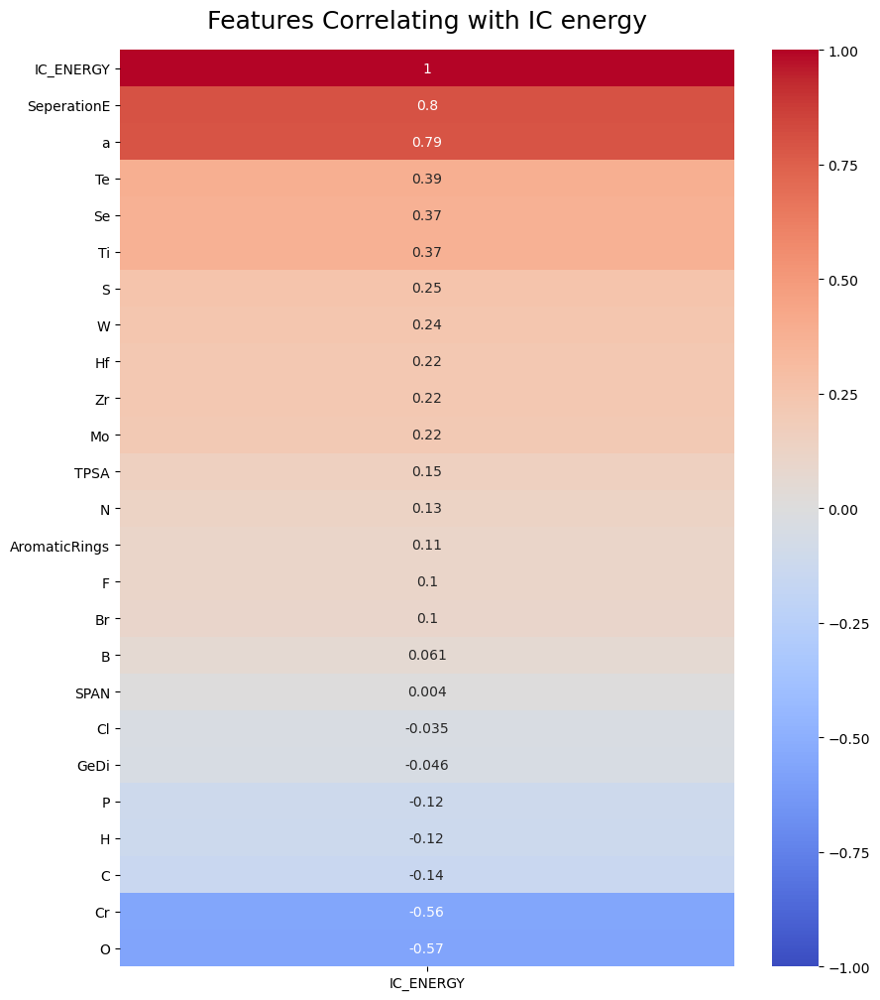

In [9]:
plt.figure(figsize=(10, 12))
matrix = (PlotSet.corr(method = 'spearman')).round(3)
matrix = matrix[~np.isnan(matrix)]


heatmap = sns.heatmap(matrix[['IC_ENERGY']].sort_values(by='IC_ENERGY', ascending=False), vmin=-1, vmax=1, annot=True, cmap='coolwarm')
heatmap.set_title('Features Correlating with IC energy', fontdict={'fontsize':18}, pad=16)

# Part III: Model Selection and Data Training

<a id="modelselection"></a>

In [10]:
exclude = ['IC_ENERGY', 'System']
features = [c for c in FinalSet.columns if c not in exclude]
X = FinalSet[features]
y = FinalSet["IC_ENERGY"]

## Evaluating performance of various models

In [11]:
#Lets use train/split ratio of 70/30 - Use ShuffleSplit
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)
#kfold = KFold(n_splits = 5, shuffle = True, random_state = 42 )

# Use some linear reg model and some with boosting capabilities

hyper_params_lgbm = {
    "objective" : "multiclass",
    'task': 'train',
    'boosting_type': 'gbdt',
    'objective': 'regression',
    'n_estimators': 500,
    "verbosity" : -1 
}

hyper_params_xgb = { 
    'objective': 'reg:squarederror',  # error evaluation for multiclass tasks
    'n_estimators': 500,
    'eval_metric': mean_absolute_error
    }

hyper_params_cb = {   
    'n_estimators': 500,
    'eval_metric': mean_absolute_error
    }

#Use ShuffleSplit for cross validation of dataset. Kfold also gives similar result
cv_split = ShuffleSplit(n_splits = 5, test_size = 0.30, random_state = 42)

# Initializing the Algorithms # I have tried a couple of them. Just showing a handful here
algorithm_list = {'LinearReg': linear_model.LinearRegression(), 
                  'BayeRidge':linear_model.BayesianRidge(),
                  'LassoLars': linear_model.LassoLars(alpha=0.01),
                  'LeastAngLars':linear_model.Lars(),
                  'XgbostReg': xgb.XGBRegressor(**hyper_params_xgb),
                  'LGBMReg': lgbm.LGBMRegressor(**hyper_params_lgbm),
                  'CatBoost' : CBRegressor(),
                  'KernelRidge' : kernel_ridge.KernelRidge(alpha=1,kernel='poly',gamma=None,degree=3,coef0=1,kernel_params=None)
                 }

test_R2 = []
train_R2 = []
ad_R2 = []
CV_R2 = []
CV_R2_std = []
mse = []
mae = []
std = []
mape = []
mod = []
mod_call_name = []
ModelMetrics = pd.DataFrame()
# Fit the various model
for key,model in algorithm_list.items():
    try:
        if key == 'XgbostReg' or key == 'LGBMReg' or key == 'CatBoost':
            model.fit(X_train, y_train,early_stopping_rounds=100,eval_set=[(X_test, y_test)])
        else:
            model.fit(X_train, y_train)
        # Cross-validate the result to avoid over fitting
        cv_results = cross_validate(model, X_train, y_train, cv  = cv_split)
#        cv_results = RepeatedKFold(n_splits = 5, n_repeats = 3, random_state = 42)
        adj_R2 = 1 - (1-model.score(X_train, y_train))*(len(y_train)-1)/(len(y_train)-X_train.shape[1]-1)
        y_pred = model.predict(X_test) 
        # Print model and test metrics
        print(f'Model - {key: <5} || Model Score: %.3f, Adj_R^2: %.3f, Test Score: %.3f, Cross Val Score: %.3f' 
              %(model.score(X_train, y_train),adj_R2, model.score(X_test, y_test), cv_results.get('test_score').mean()))
        mod.append(key)
        test_R2.append(model.score(X_test, y_test))
        train_R2.append(model.score(X_train, y_train))
        ad_R2.append(adj_R2)
        CV_R2.append(cv_results.get('test_score').mean())
        CV_R2_std.append(cv_results.get('test_score').std())
        
        print(f'Model - {key: <5} || MSE: %.3f, MAE: %.3f, STD: %.3f, MAPE: %.3f%%' 
              %(metrics.mean_squared_error(y_test, y_pred), metrics.mean_absolute_error(y_test, y_pred), 
                cv_results.get('test_score').std(), metrics.mean_absolute_percentage_error(y_test, y_pred)*100))
        mse.append(metrics.mean_squared_error(y_test, y_pred))
        mae.append(metrics.mean_absolute_error(y_test, y_pred))
        std.append(cv_results.get('test_score').std())
        mape.append(metrics.mean_absolute_percentage_error(y_test, y_pred)*100)
        mod_call_name.append(model)
        
        print(f'Model - {key: <5}  || Cross Validation Progress: \n')
        print(pd.DataFrame(cv_results))
        print('----------------------------------------------------------------------------------------------------------')
    except Exception as e:
        print(f"Exception occurred in {str(e)}")
        pass 



ModelMetrics['Model'] = mod
ModelMetrics['Train_R2'] = train_R2
ModelMetrics['Adjusted_R2'] = ad_R2
ModelMetrics['Test_R2'] = test_R2
ModelMetrics['CV_R2'] = CV_R2
ModelMetrics['Std_in_CV'] = CV_R2_std
ModelMetrics['MSE'] = mse
ModelMetrics['MAE'] = mae
ModelMetrics['STD'] = std
ModelMetrics['MAPE'] = mape

Model - LinearReg || Model Score: 0.766, Adj_R^2: 0.692, Test Score: 0.783, Cross Val Score: 0.691
Model - LinearReg || MSE: 0.111, MAE: 0.226, STD: 0.078, MAPE: 74.824%
Model - LinearReg  || Cross Validation Progress: 

   fit_time  score_time  test_score
0  0.015011    0.002737    0.712387
1  0.007914    0.002566    0.722389
2  0.012885    0.002577    0.754874
3  0.011109    0.002427    0.727417
4  0.011069    0.002491    0.537041
----------------------------------------------------------------------------------------------------------
Model - BayeRidge || Model Score: 0.734, Adj_R^2: 0.650, Test Score: 0.758, Cross Val Score: 0.654
Model - BayeRidge || MSE: 0.124, MAE: 0.240, STD: 0.071, MAPE: 78.422%
Model - BayeRidge  || Cross Validation Progress: 

   fit_time  score_time  test_score
0  0.006642    0.002191    0.637662
1  0.007155    0.002228    0.638299
2  0.006605    0.002186    0.719908
3  0.007367    0.002117    0.734844
4  0.012139    0.002105    0.537191
-------------------

/Users/sriharik/miniconda3/envs/nano281/lib/python3.7/site-packages/sklearn/linear_model/_base.py:138: FutureWarning: The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LassoLars())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)

Set parameter alpha to: original_alpha * np.sqrt(n_samples). 
  FutureWarning,
/Users/sriharik/miniconda3/envs/nano281/lib/python3.7/site-packages/sklearn/linear_model/_base.py:138: FutureWarning: The default of 'normalize' will be set to False in version 1.2 and deprecated in version 1.4.
If you wish to scale the dat

[19]	validation_0-rmse:0.33208
[20]	validation_0-rmse:0.33248
[21]	validation_0-rmse:0.33235
[22]	validation_0-rmse:0.32925
[23]	validation_0-rmse:0.32638
[24]	validation_0-rmse:0.32611
[25]	validation_0-rmse:0.32446
[26]	validation_0-rmse:0.32420
[27]	validation_0-rmse:0.32334
[28]	validation_0-rmse:0.32198
[29]	validation_0-rmse:0.32169
[30]	validation_0-rmse:0.32213
[31]	validation_0-rmse:0.32226
[32]	validation_0-rmse:0.32313
[33]	validation_0-rmse:0.32395
[34]	validation_0-rmse:0.32390
[35]	validation_0-rmse:0.32437
[36]	validation_0-rmse:0.32461
[37]	validation_0-rmse:0.32520
[38]	validation_0-rmse:0.32549
[39]	validation_0-rmse:0.32613
[40]	validation_0-rmse:0.32565
[41]	validation_0-rmse:0.32580
[42]	validation_0-rmse:0.32570
[43]	validation_0-rmse:0.32647
[44]	validation_0-rmse:0.32653
[45]	validation_0-rmse:0.32666
[46]	validation_0-rmse:0.32659
[47]	validation_0-rmse:0.32650
[48]	validation_0-rmse:0.32650
[49]	validation_0-rmse:0.32634
[50]	validation_0-rmse:0.32642
[51]	val

/Users/sriharik/miniconda3/envs/nano281/lib/python3.7/site-packages/lightgbm/sklearn.py:726: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "


Model - LGBMReg || Model Score: 0.938, Adj_R^2: 0.918, Test Score: 0.795, Cross Val Score: 0.708
Model - LGBMReg || MSE: 0.106, MAE: 0.207, STD: 0.105, MAPE: 57.852%
Model - LGBMReg  || Cross Validation Progress: 

   fit_time  score_time  test_score
0  0.105712    0.003675    0.727986
1  0.143430    0.002734    0.796445
2  0.077531    0.002693    0.787069
3  0.075957    0.002605    0.720100
4  0.077862    0.002631    0.506729
----------------------------------------------------------------------------------------------------------
Learning rate set to 0.044984
0:	learn: 0.7700840	test: 0.6973382	best: 0.6973382 (0)	total: 57ms	remaining: 57s
1:	learn: 0.7504821	test: 0.6775264	best: 0.6775264 (1)	total: 57.6ms	remaining: 28.8s
2:	learn: 0.7319414	test: 0.6589571	best: 0.6589571 (2)	total: 58.2ms	remaining: 19.3s
3:	learn: 0.7147758	test: 0.6416091	best: 0.6416091 (3)	total: 58.8ms	remaining: 14.6s
4:	learn: 0.6960863	test: 0.6239698	best: 0.6239698 (4)	total: 59.5ms	remaining: 11.8s
5

175:	learn: 0.2576814	test: 0.3225038	best: 0.3225038 (175)	total: 160ms	remaining: 747ms
176:	learn: 0.2573872	test: 0.3224609	best: 0.3224609 (176)	total: 160ms	remaining: 745ms
177:	learn: 0.2571119	test: 0.3223566	best: 0.3223566 (177)	total: 161ms	remaining: 743ms
178:	learn: 0.2567872	test: 0.3223471	best: 0.3223471 (178)	total: 162ms	remaining: 741ms
179:	learn: 0.2564996	test: 0.3222888	best: 0.3222888 (179)	total: 162ms	remaining: 739ms
180:	learn: 0.2553214	test: 0.3217454	best: 0.3217454 (180)	total: 163ms	remaining: 737ms
181:	learn: 0.2551104	test: 0.3217431	best: 0.3217431 (181)	total: 164ms	remaining: 736ms
182:	learn: 0.2549644	test: 0.3217581	best: 0.3217431 (181)	total: 164ms	remaining: 734ms
183:	learn: 0.2545646	test: 0.3217446	best: 0.3217431 (181)	total: 165ms	remaining: 734ms
184:	learn: 0.2543025	test: 0.3215920	best: 0.3215920 (184)	total: 166ms	remaining: 733ms
185:	learn: 0.2539127	test: 0.3211552	best: 0.3211552 (185)	total: 167ms	remaining: 732ms
186:	learn

443:	learn: 0.1444924	test: 0.2863025	best: 0.2862045 (435)	total: 337ms	remaining: 422ms
444:	learn: 0.1439537	test: 0.2860919	best: 0.2860919 (444)	total: 337ms	remaining: 421ms
445:	learn: 0.1438270	test: 0.2860534	best: 0.2860534 (445)	total: 338ms	remaining: 420ms
446:	learn: 0.1433708	test: 0.2861485	best: 0.2860534 (445)	total: 338ms	remaining: 419ms
447:	learn: 0.1430165	test: 0.2860967	best: 0.2860534 (445)	total: 339ms	remaining: 418ms
448:	learn: 0.1427016	test: 0.2860841	best: 0.2860534 (445)	total: 340ms	remaining: 417ms
449:	learn: 0.1423330	test: 0.2857801	best: 0.2857801 (449)	total: 340ms	remaining: 416ms
450:	learn: 0.1422053	test: 0.2857880	best: 0.2857801 (449)	total: 341ms	remaining: 415ms
451:	learn: 0.1418231	test: 0.2855315	best: 0.2855315 (451)	total: 342ms	remaining: 414ms
452:	learn: 0.1417824	test: 0.2855239	best: 0.2855239 (452)	total: 342ms	remaining: 413ms
453:	learn: 0.1415439	test: 0.2854372	best: 0.2854372 (453)	total: 343ms	remaining: 412ms
454:	learn

780:	learn: 0.0906134	test: 0.2812840	best: 0.2810501 (694)	total: 516ms	remaining: 145ms
781:	learn: 0.0902516	test: 0.2812943	best: 0.2810501 (694)	total: 517ms	remaining: 144ms
782:	learn: 0.0901359	test: 0.2813301	best: 0.2810501 (694)	total: 517ms	remaining: 143ms
783:	learn: 0.0899631	test: 0.2814226	best: 0.2810501 (694)	total: 518ms	remaining: 143ms
784:	learn: 0.0898922	test: 0.2813759	best: 0.2810501 (694)	total: 518ms	remaining: 142ms
785:	learn: 0.0898636	test: 0.2814299	best: 0.2810501 (694)	total: 519ms	remaining: 141ms
786:	learn: 0.0897403	test: 0.2813629	best: 0.2810501 (694)	total: 520ms	remaining: 141ms
787:	learn: 0.0896167	test: 0.2813548	best: 0.2810501 (694)	total: 520ms	remaining: 140ms
788:	learn: 0.0894569	test: 0.2812016	best: 0.2810501 (694)	total: 521ms	remaining: 139ms
789:	learn: 0.0893694	test: 0.2811950	best: 0.2810501 (694)	total: 521ms	remaining: 139ms
790:	learn: 0.0893632	test: 0.2811954	best: 0.2810501 (694)	total: 522ms	remaining: 138ms
791:	learn

260:	learn: 0.2121969	total: 123ms	remaining: 349ms
261:	learn: 0.2117807	total: 124ms	remaining: 350ms
262:	learn: 0.2116302	total: 125ms	remaining: 350ms
263:	learn: 0.2111159	total: 126ms	remaining: 351ms
264:	learn: 0.2109806	total: 127ms	remaining: 351ms
265:	learn: 0.2107049	total: 127ms	remaining: 351ms
266:	learn: 0.2105364	total: 128ms	remaining: 351ms
267:	learn: 0.2097522	total: 128ms	remaining: 351ms
268:	learn: 0.2093164	total: 129ms	remaining: 351ms
269:	learn: 0.2088110	total: 130ms	remaining: 351ms
270:	learn: 0.2084587	total: 130ms	remaining: 351ms
271:	learn: 0.2079941	total: 131ms	remaining: 350ms
272:	learn: 0.2073607	total: 132ms	remaining: 350ms
273:	learn: 0.2071638	total: 132ms	remaining: 350ms
274:	learn: 0.2067796	total: 133ms	remaining: 350ms
275:	learn: 0.2064288	total: 134ms	remaining: 350ms
276:	learn: 0.2055931	total: 134ms	remaining: 350ms
277:	learn: 0.2052997	total: 135ms	remaining: 350ms
278:	learn: 0.2049700	total: 136ms	remaining: 350ms
279:	learn: 

580:	learn: 0.1270519	total: 294ms	remaining: 212ms
581:	learn: 0.1267978	total: 295ms	remaining: 212ms
582:	learn: 0.1263923	total: 295ms	remaining: 211ms
583:	learn: 0.1260834	total: 296ms	remaining: 211ms
584:	learn: 0.1260188	total: 296ms	remaining: 210ms
585:	learn: 0.1258407	total: 297ms	remaining: 210ms
586:	learn: 0.1258041	total: 298ms	remaining: 209ms
587:	learn: 0.1257747	total: 298ms	remaining: 209ms
588:	learn: 0.1256405	total: 299ms	remaining: 208ms
589:	learn: 0.1254092	total: 299ms	remaining: 208ms
590:	learn: 0.1252587	total: 300ms	remaining: 208ms
591:	learn: 0.1249103	total: 300ms	remaining: 207ms
592:	learn: 0.1247917	total: 301ms	remaining: 207ms
593:	learn: 0.1245868	total: 301ms	remaining: 206ms
594:	learn: 0.1244908	total: 302ms	remaining: 206ms
595:	learn: 0.1243233	total: 303ms	remaining: 205ms
596:	learn: 0.1242022	total: 303ms	remaining: 205ms
597:	learn: 0.1241783	total: 304ms	remaining: 204ms
598:	learn: 0.1239878	total: 304ms	remaining: 204ms
599:	learn: 

962:	learn: 0.0798058	total: 473ms	remaining: 18.2ms
963:	learn: 0.0795953	total: 474ms	remaining: 17.7ms
964:	learn: 0.0795735	total: 474ms	remaining: 17.2ms
965:	learn: 0.0795013	total: 475ms	remaining: 16.7ms
966:	learn: 0.0793153	total: 476ms	remaining: 16.2ms
967:	learn: 0.0792182	total: 477ms	remaining: 15.8ms
968:	learn: 0.0791697	total: 478ms	remaining: 15.3ms
969:	learn: 0.0791613	total: 479ms	remaining: 14.8ms
970:	learn: 0.0790101	total: 480ms	remaining: 14.3ms
971:	learn: 0.0789267	total: 481ms	remaining: 13.9ms
972:	learn: 0.0788912	total: 482ms	remaining: 13.4ms
973:	learn: 0.0788217	total: 483ms	remaining: 12.9ms
974:	learn: 0.0787700	total: 483ms	remaining: 12.4ms
975:	learn: 0.0787604	total: 484ms	remaining: 11.9ms
976:	learn: 0.0785941	total: 485ms	remaining: 11.4ms
977:	learn: 0.0785028	total: 486ms	remaining: 10.9ms
978:	learn: 0.0784376	total: 487ms	remaining: 10.4ms
979:	learn: 0.0784278	total: 488ms	remaining: 9.96ms
980:	learn: 0.0783226	total: 489ms	remaining: 

218:	learn: 0.2579767	total: 114ms	remaining: 407ms
219:	learn: 0.2578611	total: 115ms	remaining: 408ms
220:	learn: 0.2571376	total: 116ms	remaining: 407ms
221:	learn: 0.2566124	total: 116ms	remaining: 407ms
222:	learn: 0.2560849	total: 117ms	remaining: 406ms
223:	learn: 0.2548234	total: 117ms	remaining: 406ms
224:	learn: 0.2539207	total: 118ms	remaining: 405ms
225:	learn: 0.2534041	total: 118ms	remaining: 405ms
226:	learn: 0.2532013	total: 119ms	remaining: 404ms
227:	learn: 0.2526865	total: 119ms	remaining: 403ms
228:	learn: 0.2517579	total: 120ms	remaining: 403ms
229:	learn: 0.2516455	total: 120ms	remaining: 402ms
230:	learn: 0.2512405	total: 121ms	remaining: 401ms
231:	learn: 0.2508077	total: 121ms	remaining: 400ms
232:	learn: 0.2505151	total: 122ms	remaining: 400ms
233:	learn: 0.2497011	total: 122ms	remaining: 400ms
234:	learn: 0.2494828	total: 123ms	remaining: 399ms
235:	learn: 0.2492439	total: 123ms	remaining: 398ms
236:	learn: 0.2482486	total: 124ms	remaining: 398ms
237:	learn: 

609:	learn: 0.1207424	total: 294ms	remaining: 188ms
610:	learn: 0.1206250	total: 295ms	remaining: 188ms
611:	learn: 0.1204197	total: 296ms	remaining: 187ms
612:	learn: 0.1203507	total: 296ms	remaining: 187ms
613:	learn: 0.1201230	total: 297ms	remaining: 187ms
614:	learn: 0.1199161	total: 297ms	remaining: 186ms
615:	learn: 0.1198317	total: 298ms	remaining: 186ms
616:	learn: 0.1197888	total: 298ms	remaining: 185ms
617:	learn: 0.1195320	total: 299ms	remaining: 185ms
618:	learn: 0.1193848	total: 299ms	remaining: 184ms
619:	learn: 0.1193124	total: 300ms	remaining: 184ms
620:	learn: 0.1190427	total: 300ms	remaining: 183ms
621:	learn: 0.1186130	total: 301ms	remaining: 183ms
622:	learn: 0.1184850	total: 301ms	remaining: 182ms
623:	learn: 0.1183402	total: 302ms	remaining: 182ms
624:	learn: 0.1181107	total: 302ms	remaining: 181ms
625:	learn: 0.1180395	total: 303ms	remaining: 181ms
626:	learn: 0.1179816	total: 303ms	remaining: 180ms
627:	learn: 0.1178505	total: 303ms	remaining: 180ms
628:	learn: 

Learning rate set to 0.034147
0:	learn: 0.7849318	total: 851us	remaining: 850ms
1:	learn: 0.7702077	total: 1.48ms	remaining: 738ms
2:	learn: 0.7565916	total: 1.89ms	remaining: 627ms
3:	learn: 0.7411246	total: 2.45ms	remaining: 611ms
4:	learn: 0.7288159	total: 3ms	remaining: 596ms
5:	learn: 0.7161633	total: 3.55ms	remaining: 588ms
6:	learn: 0.7017906	total: 4.05ms	remaining: 575ms
7:	learn: 0.6900429	total: 4.5ms	remaining: 559ms
8:	learn: 0.6790759	total: 5ms	remaining: 551ms
9:	learn: 0.6673776	total: 5.51ms	remaining: 545ms
10:	learn: 0.6568842	total: 6ms	remaining: 539ms
11:	learn: 0.6474529	total: 6.52ms	remaining: 537ms
12:	learn: 0.6359500	total: 7.01ms	remaining: 533ms
13:	learn: 0.6260033	total: 7.52ms	remaining: 530ms
14:	learn: 0.6157263	total: 8.01ms	remaining: 526ms
15:	learn: 0.6058874	total: 8.54ms	remaining: 525ms
16:	learn: 0.5966331	total: 9.18ms	remaining: 531ms
17:	learn: 0.5868064	total: 9.76ms	remaining: 532ms
18:	learn: 0.5788472	total: 10.3ms	remaining: 532ms
19:

316:	learn: 0.1965562	total: 161ms	remaining: 346ms
317:	learn: 0.1958927	total: 162ms	remaining: 347ms
318:	learn: 0.1958251	total: 162ms	remaining: 346ms
319:	learn: 0.1957574	total: 163ms	remaining: 346ms
320:	learn: 0.1950720	total: 163ms	remaining: 346ms
321:	learn: 0.1949777	total: 164ms	remaining: 345ms
322:	learn: 0.1949181	total: 164ms	remaining: 345ms
323:	learn: 0.1938854	total: 165ms	remaining: 344ms
324:	learn: 0.1938197	total: 166ms	remaining: 344ms
325:	learn: 0.1935876	total: 166ms	remaining: 343ms
326:	learn: 0.1935067	total: 167ms	remaining: 343ms
327:	learn: 0.1934392	total: 167ms	remaining: 342ms
328:	learn: 0.1933389	total: 168ms	remaining: 342ms
329:	learn: 0.1926071	total: 168ms	remaining: 342ms
330:	learn: 0.1920225	total: 169ms	remaining: 341ms
331:	learn: 0.1916692	total: 169ms	remaining: 341ms
332:	learn: 0.1911269	total: 170ms	remaining: 340ms
333:	learn: 0.1909867	total: 170ms	remaining: 340ms
334:	learn: 0.1909276	total: 171ms	remaining: 339ms
335:	learn: 

688:	learn: 0.1107844	total: 340ms	remaining: 153ms
689:	learn: 0.1106564	total: 340ms	remaining: 153ms
690:	learn: 0.1104848	total: 341ms	remaining: 152ms
691:	learn: 0.1103365	total: 341ms	remaining: 152ms
692:	learn: 0.1100283	total: 342ms	remaining: 151ms
693:	learn: 0.1097767	total: 342ms	remaining: 151ms
694:	learn: 0.1095827	total: 342ms	remaining: 150ms
695:	learn: 0.1094183	total: 343ms	remaining: 150ms
696:	learn: 0.1092079	total: 343ms	remaining: 149ms
697:	learn: 0.1090387	total: 344ms	remaining: 149ms
698:	learn: 0.1088414	total: 344ms	remaining: 148ms
699:	learn: 0.1087061	total: 345ms	remaining: 148ms
700:	learn: 0.1086204	total: 345ms	remaining: 147ms
701:	learn: 0.1083336	total: 346ms	remaining: 147ms
702:	learn: 0.1081432	total: 346ms	remaining: 146ms
703:	learn: 0.1079785	total: 347ms	remaining: 146ms
704:	learn: 0.1078343	total: 347ms	remaining: 145ms
705:	learn: 0.1075122	total: 348ms	remaining: 145ms
706:	learn: 0.1073142	total: 348ms	remaining: 144ms
707:	learn: 

986:	learn: 0.0778452	total: 501ms	remaining: 6.6ms
987:	learn: 0.0777747	total: 502ms	remaining: 6.1ms
988:	learn: 0.0777220	total: 503ms	remaining: 5.59ms
989:	learn: 0.0776150	total: 503ms	remaining: 5.08ms
990:	learn: 0.0775516	total: 504ms	remaining: 4.58ms
991:	learn: 0.0774941	total: 504ms	remaining: 4.07ms
992:	learn: 0.0774004	total: 505ms	remaining: 3.56ms
993:	learn: 0.0773008	total: 505ms	remaining: 3.05ms
994:	learn: 0.0772845	total: 506ms	remaining: 2.54ms
995:	learn: 0.0772490	total: 507ms	remaining: 2.03ms
996:	learn: 0.0771454	total: 507ms	remaining: 1.53ms
997:	learn: 0.0771368	total: 508ms	remaining: 1.02ms
998:	learn: 0.0770789	total: 508ms	remaining: 508us
999:	learn: 0.0769290	total: 509ms	remaining: 0us
Learning rate set to 0.034147
0:	learn: 0.7591337	total: 763us	remaining: 763ms
1:	learn: 0.7452784	total: 1.37ms	remaining: 682ms
2:	learn: 0.7305839	total: 1.93ms	remaining: 643ms
3:	learn: 0.7174011	total: 2.19ms	remaining: 544ms
4:	learn: 0.7027703	total: 2.76

223:	learn: 0.2318506	total: 128ms	remaining: 443ms
224:	learn: 0.2310334	total: 129ms	remaining: 444ms
225:	learn: 0.2308706	total: 130ms	remaining: 444ms
226:	learn: 0.2305034	total: 130ms	remaining: 444ms
227:	learn: 0.2299831	total: 131ms	remaining: 443ms
228:	learn: 0.2293443	total: 131ms	remaining: 443ms
229:	learn: 0.2286068	total: 132ms	remaining: 442ms
230:	learn: 0.2284182	total: 133ms	remaining: 442ms
231:	learn: 0.2283209	total: 133ms	remaining: 442ms
232:	learn: 0.2279932	total: 134ms	remaining: 442ms
233:	learn: 0.2265883	total: 135ms	remaining: 441ms
234:	learn: 0.2263758	total: 135ms	remaining: 440ms
235:	learn: 0.2257766	total: 136ms	remaining: 440ms
236:	learn: 0.2248314	total: 136ms	remaining: 439ms
237:	learn: 0.2247173	total: 137ms	remaining: 439ms
238:	learn: 0.2243320	total: 138ms	remaining: 439ms
239:	learn: 0.2240285	total: 138ms	remaining: 438ms
240:	learn: 0.2238600	total: 139ms	remaining: 438ms
241:	learn: 0.2235841	total: 140ms	remaining: 438ms
242:	learn: 

579:	learn: 0.1254199	total: 309ms	remaining: 224ms
580:	learn: 0.1251369	total: 309ms	remaining: 223ms
581:	learn: 0.1249134	total: 310ms	remaining: 223ms
582:	learn: 0.1247018	total: 310ms	remaining: 222ms
583:	learn: 0.1244672	total: 311ms	remaining: 222ms
584:	learn: 0.1239735	total: 311ms	remaining: 221ms
585:	learn: 0.1238690	total: 312ms	remaining: 220ms
586:	learn: 0.1235997	total: 312ms	remaining: 220ms
587:	learn: 0.1233125	total: 313ms	remaining: 219ms
588:	learn: 0.1231601	total: 313ms	remaining: 219ms
589:	learn: 0.1230250	total: 314ms	remaining: 218ms
590:	learn: 0.1228469	total: 314ms	remaining: 218ms
591:	learn: 0.1225482	total: 315ms	remaining: 217ms
592:	learn: 0.1225010	total: 315ms	remaining: 216ms
593:	learn: 0.1224674	total: 316ms	remaining: 216ms
594:	learn: 0.1223611	total: 316ms	remaining: 215ms
595:	learn: 0.1221433	total: 317ms	remaining: 215ms
596:	learn: 0.1221301	total: 317ms	remaining: 214ms
597:	learn: 0.1221084	total: 318ms	remaining: 214ms
598:	learn: 

951:	learn: 0.0790396	total: 489ms	remaining: 24.7ms
952:	learn: 0.0790243	total: 490ms	remaining: 24.2ms
953:	learn: 0.0789251	total: 491ms	remaining: 23.7ms
954:	learn: 0.0788362	total: 491ms	remaining: 23.1ms
955:	learn: 0.0787051	total: 492ms	remaining: 22.6ms
956:	learn: 0.0785542	total: 492ms	remaining: 22.1ms
957:	learn: 0.0784318	total: 493ms	remaining: 21.6ms
958:	learn: 0.0783553	total: 493ms	remaining: 21.1ms
959:	learn: 0.0782847	total: 494ms	remaining: 20.6ms
960:	learn: 0.0782803	total: 494ms	remaining: 20.1ms
961:	learn: 0.0781580	total: 495ms	remaining: 19.5ms
962:	learn: 0.0780790	total: 495ms	remaining: 19ms
963:	learn: 0.0779639	total: 496ms	remaining: 18.5ms
964:	learn: 0.0778573	total: 496ms	remaining: 18ms
965:	learn: 0.0778415	total: 496ms	remaining: 17.5ms
966:	learn: 0.0777867	total: 497ms	remaining: 17ms
967:	learn: 0.0776706	total: 498ms	remaining: 16.4ms
968:	learn: 0.0775976	total: 498ms	remaining: 15.9ms
969:	learn: 0.0774042	total: 499ms	remaining: 15.4ms

285:	learn: 0.1891531	total: 133ms	remaining: 332ms
286:	learn: 0.1887234	total: 134ms	remaining: 332ms
287:	learn: 0.1881759	total: 134ms	remaining: 332ms
288:	learn: 0.1876571	total: 135ms	remaining: 331ms
289:	learn: 0.1870843	total: 135ms	remaining: 331ms
290:	learn: 0.1864149	total: 136ms	remaining: 330ms
291:	learn: 0.1856480	total: 136ms	remaining: 330ms
292:	learn: 0.1850957	total: 137ms	remaining: 330ms
293:	learn: 0.1846223	total: 137ms	remaining: 329ms
294:	learn: 0.1843212	total: 138ms	remaining: 329ms
295:	learn: 0.1836808	total: 138ms	remaining: 329ms
296:	learn: 0.1830650	total: 139ms	remaining: 328ms
297:	learn: 0.1826104	total: 139ms	remaining: 328ms
298:	learn: 0.1822329	total: 140ms	remaining: 327ms
299:	learn: 0.1817458	total: 140ms	remaining: 327ms
300:	learn: 0.1812681	total: 141ms	remaining: 327ms
301:	learn: 0.1807529	total: 141ms	remaining: 326ms
302:	learn: 0.1802386	total: 142ms	remaining: 326ms
303:	learn: 0.1798672	total: 142ms	remaining: 325ms
304:	learn: 

582:	learn: 0.1174049	total: 279ms	remaining: 200ms
583:	learn: 0.1172674	total: 280ms	remaining: 199ms
584:	learn: 0.1171567	total: 280ms	remaining: 199ms
585:	learn: 0.1170162	total: 281ms	remaining: 198ms
586:	learn: 0.1169319	total: 281ms	remaining: 198ms
587:	learn: 0.1167621	total: 282ms	remaining: 197ms
588:	learn: 0.1167401	total: 282ms	remaining: 197ms
589:	learn: 0.1165010	total: 283ms	remaining: 196ms
590:	learn: 0.1164100	total: 283ms	remaining: 196ms
591:	learn: 0.1162125	total: 284ms	remaining: 195ms
592:	learn: 0.1160637	total: 284ms	remaining: 195ms
593:	learn: 0.1159676	total: 285ms	remaining: 194ms
594:	learn: 0.1157873	total: 285ms	remaining: 194ms
595:	learn: 0.1156609	total: 285ms	remaining: 194ms
596:	learn: 0.1155142	total: 286ms	remaining: 193ms
597:	learn: 0.1153726	total: 287ms	remaining: 193ms
598:	learn: 0.1152976	total: 287ms	remaining: 192ms
599:	learn: 0.1150761	total: 288ms	remaining: 192ms
600:	learn: 0.1149231	total: 288ms	remaining: 191ms
601:	learn: 

951:	learn: 0.0781325	total: 459ms	remaining: 23.2ms
952:	learn: 0.0780330	total: 460ms	remaining: 22.7ms
953:	learn: 0.0779648	total: 461ms	remaining: 22.2ms
954:	learn: 0.0778930	total: 462ms	remaining: 21.8ms
955:	learn: 0.0778588	total: 463ms	remaining: 21.3ms
956:	learn: 0.0777787	total: 463ms	remaining: 20.8ms
957:	learn: 0.0777001	total: 464ms	remaining: 20.3ms
958:	learn: 0.0775301	total: 465ms	remaining: 19.9ms
959:	learn: 0.0774252	total: 465ms	remaining: 19.4ms
960:	learn: 0.0773361	total: 466ms	remaining: 18.9ms
961:	learn: 0.0773291	total: 466ms	remaining: 18.4ms
962:	learn: 0.0772746	total: 467ms	remaining: 17.9ms
963:	learn: 0.0771810	total: 468ms	remaining: 17.5ms
964:	learn: 0.0770878	total: 468ms	remaining: 17ms
965:	learn: 0.0770465	total: 469ms	remaining: 16.5ms
966:	learn: 0.0769026	total: 469ms	remaining: 16ms
967:	learn: 0.0768949	total: 470ms	remaining: 15.5ms
968:	learn: 0.0768535	total: 470ms	remaining: 15ms
969:	learn: 0.0767652	total: 471ms	remaining: 14.6ms

In [12]:
ModelMetrics

,Model,Train_R2,Adjusted_R2,Test_R2,CV_R2,Std_in_CV,MSE,MAE,STD,MAPE
0,LinearReg,0.765755,0.691532,0.783203,6.908216e-01,7.816888e-02,0.111382,0.226436,7.816888e-02,74.824200
1,BayeRidge,0.734215,0.649999,0.757807,6.535808e-01,7.076221e-02,0.124430,0.240068,7.076221e-02,78.422496
2,LassoLars,0.548403,0.405310,0.601309,5.348810e-01,5.701982e-02,0.204832,0.325950,5.701982e-02,76.229834
3,LeastAngLars,0.270412,0.039235,-0.058618,-1.240819e+06,2.481299e+06,0.543878,0.555510,2.481299e+06,288.874024
4,XgbostReg,0.989409,0.986053,0.798574,7.210504e-01,1.140892e-01,0.103485,0.182679,1.140892e-01,61.373491
5,LGBMReg,0.937704,0.917965,0.794608,7.076659e-01,1.050044e-01,0.105522,0.207369,1.050044e-01,57.852452
6,CatBoost,0.983770,0.978628,0.846254,7.633709e-01,1.038549e-01,0.078989,0.162364,1.038549e-01,41.861815
7,KernelRidge,0.722210,0.634189,0.720055,6.503498e-01,7.616288e-02,0.143825,0.264301,7.616288e-02,87.899099


# Parity Plot of the Best Model

Learning rate set to 0.034885
0:	learn: 0.7714619	total: 560us	remaining: 560ms
1:	learn: 0.7559635	total: 1.18ms	remaining: 590ms
2:	learn: 0.7407205	total: 1.77ms	remaining: 589ms
3:	learn: 0.7263497	total: 2.43ms	remaining: 606ms
4:	learn: 0.7118586	total: 3.1ms	remaining: 618ms
5:	learn: 0.6983863	total: 3.74ms	remaining: 619ms
6:	learn: 0.6851680	total: 4.44ms	remaining: 630ms
7:	learn: 0.6729170	total: 5.11ms	remaining: 634ms
8:	learn: 0.6615416	total: 5.75ms	remaining: 633ms
9:	learn: 0.6501465	total: 6.35ms	remaining: 628ms
10:	learn: 0.6386558	total: 7.02ms	remaining: 631ms
11:	learn: 0.6285083	total: 7.6ms	remaining: 626ms
12:	learn: 0.6180947	total: 8.29ms	remaining: 629ms
13:	learn: 0.6081446	total: 8.92ms	remaining: 629ms
14:	learn: 0.5991605	total: 9.7ms	remaining: 637ms
15:	learn: 0.5895572	total: 10.5ms	remaining: 644ms
16:	learn: 0.5809880	total: 11.3ms	remaining: 656ms
17:	learn: 0.5724973	total: 12.2ms	remaining: 664ms
18:	learn: 0.5638680	total: 13.2ms	remaining: 68

222:	learn: 0.2545990	total: 137ms	remaining: 477ms
223:	learn: 0.2543327	total: 138ms	remaining: 479ms
224:	learn: 0.2541701	total: 139ms	remaining: 478ms
225:	learn: 0.2533432	total: 140ms	remaining: 478ms
226:	learn: 0.2530986	total: 140ms	remaining: 478ms
227:	learn: 0.2529330	total: 141ms	remaining: 476ms
228:	learn: 0.2523544	total: 141ms	remaining: 476ms
229:	learn: 0.2517903	total: 142ms	remaining: 475ms
230:	learn: 0.2515784	total: 143ms	remaining: 474ms
231:	learn: 0.2512053	total: 143ms	remaining: 474ms
232:	learn: 0.2503788	total: 144ms	remaining: 473ms
233:	learn: 0.2499857	total: 144ms	remaining: 472ms
234:	learn: 0.2493959	total: 145ms	remaining: 471ms
235:	learn: 0.2480707	total: 145ms	remaining: 471ms
236:	learn: 0.2468127	total: 146ms	remaining: 470ms
237:	learn: 0.2465442	total: 147ms	remaining: 469ms
238:	learn: 0.2460968	total: 147ms	remaining: 468ms
239:	learn: 0.2455840	total: 148ms	remaining: 468ms
240:	learn: 0.2446563	total: 148ms	remaining: 467ms
241:	learn: 

487:	learn: 0.1523088	total: 297ms	remaining: 312ms
488:	learn: 0.1522687	total: 298ms	remaining: 312ms
489:	learn: 0.1522215	total: 299ms	remaining: 311ms
490:	learn: 0.1521167	total: 300ms	remaining: 311ms
491:	learn: 0.1520797	total: 301ms	remaining: 310ms
492:	learn: 0.1518735	total: 301ms	remaining: 310ms
493:	learn: 0.1518349	total: 302ms	remaining: 309ms
494:	learn: 0.1515439	total: 302ms	remaining: 308ms
495:	learn: 0.1512611	total: 303ms	remaining: 308ms
496:	learn: 0.1512236	total: 303ms	remaining: 307ms
497:	learn: 0.1510648	total: 304ms	remaining: 306ms
498:	learn: 0.1510254	total: 304ms	remaining: 305ms
499:	learn: 0.1507280	total: 305ms	remaining: 305ms
500:	learn: 0.1505396	total: 305ms	remaining: 304ms
501:	learn: 0.1502577	total: 306ms	remaining: 303ms
502:	learn: 0.1500241	total: 306ms	remaining: 303ms
503:	learn: 0.1498169	total: 307ms	remaining: 302ms
504:	learn: 0.1496714	total: 307ms	remaining: 301ms
505:	learn: 0.1496290	total: 308ms	remaining: 301ms
506:	learn: 

768:	learn: 0.1080900	total: 460ms	remaining: 138ms
769:	learn: 0.1079212	total: 461ms	remaining: 138ms
770:	learn: 0.1078562	total: 461ms	remaining: 137ms
771:	learn: 0.1077351	total: 462ms	remaining: 136ms
772:	learn: 0.1074769	total: 462ms	remaining: 136ms
773:	learn: 0.1072368	total: 463ms	remaining: 135ms
774:	learn: 0.1070636	total: 463ms	remaining: 134ms
775:	learn: 0.1069563	total: 464ms	remaining: 134ms
776:	learn: 0.1068450	total: 464ms	remaining: 133ms
777:	learn: 0.1066079	total: 465ms	remaining: 133ms
778:	learn: 0.1064247	total: 465ms	remaining: 132ms
779:	learn: 0.1063367	total: 466ms	remaining: 131ms
780:	learn: 0.1062360	total: 466ms	remaining: 131ms
781:	learn: 0.1060935	total: 467ms	remaining: 130ms
782:	learn: 0.1060792	total: 467ms	remaining: 129ms
783:	learn: 0.1060305	total: 468ms	remaining: 129ms
784:	learn: 0.1058949	total: 468ms	remaining: 128ms
785:	learn: 0.1058830	total: 469ms	remaining: 128ms
786:	learn: 0.1057159	total: 469ms	remaining: 127ms
787:	learn: 

98:	learn: 0.3283350	total: 46.2ms	remaining: 420ms
99:	learn: 0.3274389	total: 46.9ms	remaining: 422ms
100:	learn: 0.3262879	total: 47.4ms	remaining: 422ms
101:	learn: 0.3251703	total: 47.9ms	remaining: 422ms
102:	learn: 0.3242664	total: 48.4ms	remaining: 422ms
103:	learn: 0.3237389	total: 49ms	remaining: 422ms
104:	learn: 0.3230458	total: 49.4ms	remaining: 421ms
105:	learn: 0.3217862	total: 49.9ms	remaining: 421ms
106:	learn: 0.3211659	total: 50.4ms	remaining: 421ms
107:	learn: 0.3197226	total: 50.9ms	remaining: 421ms
108:	learn: 0.3191397	total: 51.4ms	remaining: 420ms
109:	learn: 0.3182533	total: 51.9ms	remaining: 420ms
110:	learn: 0.3172646	total: 52.4ms	remaining: 419ms
111:	learn: 0.3162351	total: 52.9ms	remaining: 419ms
112:	learn: 0.3158233	total: 53.4ms	remaining: 419ms
113:	learn: 0.3152110	total: 53.9ms	remaining: 419ms
114:	learn: 0.3147348	total: 54.4ms	remaining: 419ms
115:	learn: 0.3140185	total: 54.9ms	remaining: 419ms
116:	learn: 0.3134724	total: 55.5ms	remaining: 419

357:	learn: 0.1805745	total: 194ms	remaining: 348ms
358:	learn: 0.1804975	total: 195ms	remaining: 347ms
359:	learn: 0.1804129	total: 195ms	remaining: 347ms
360:	learn: 0.1803448	total: 196ms	remaining: 346ms
361:	learn: 0.1799398	total: 196ms	remaining: 346ms
362:	learn: 0.1795103	total: 197ms	remaining: 345ms
363:	learn: 0.1789078	total: 197ms	remaining: 345ms
364:	learn: 0.1788223	total: 198ms	remaining: 344ms
365:	learn: 0.1786600	total: 198ms	remaining: 343ms
366:	learn: 0.1786048	total: 199ms	remaining: 343ms
367:	learn: 0.1785357	total: 199ms	remaining: 342ms
368:	learn: 0.1784696	total: 200ms	remaining: 341ms
369:	learn: 0.1779167	total: 200ms	remaining: 341ms
370:	learn: 0.1774001	total: 201ms	remaining: 340ms
371:	learn: 0.1769101	total: 201ms	remaining: 340ms
372:	learn: 0.1763720	total: 202ms	remaining: 339ms
373:	learn: 0.1756288	total: 202ms	remaining: 339ms
374:	learn: 0.1755428	total: 203ms	remaining: 338ms
375:	learn: 0.1749935	total: 203ms	remaining: 338ms
376:	learn: 

676:	learn: 0.1102469	total: 376ms	remaining: 180ms
677:	learn: 0.1100581	total: 377ms	remaining: 179ms
678:	learn: 0.1099152	total: 377ms	remaining: 178ms
679:	learn: 0.1097794	total: 378ms	remaining: 178ms
680:	learn: 0.1095571	total: 379ms	remaining: 177ms
681:	learn: 0.1094344	total: 379ms	remaining: 177ms
682:	learn: 0.1092770	total: 379ms	remaining: 176ms
683:	learn: 0.1092353	total: 380ms	remaining: 176ms
684:	learn: 0.1089904	total: 380ms	remaining: 175ms
685:	learn: 0.1088667	total: 381ms	remaining: 174ms
686:	learn: 0.1085909	total: 381ms	remaining: 174ms
687:	learn: 0.1082447	total: 382ms	remaining: 173ms
688:	learn: 0.1082026	total: 383ms	remaining: 173ms
689:	learn: 0.1081410	total: 383ms	remaining: 172ms
690:	learn: 0.1081234	total: 384ms	remaining: 172ms
691:	learn: 0.1079995	total: 384ms	remaining: 171ms
692:	learn: 0.1078844	total: 385ms	remaining: 170ms
693:	learn: 0.1078647	total: 385ms	remaining: 170ms
694:	learn: 0.1076890	total: 386ms	remaining: 169ms
695:	learn: 

944:	learn: 0.0807584	total: 554ms	remaining: 32.2ms
945:	learn: 0.0806308	total: 555ms	remaining: 31.7ms
946:	learn: 0.0805469	total: 555ms	remaining: 31.1ms
947:	learn: 0.0805375	total: 556ms	remaining: 30.5ms
948:	learn: 0.0804539	total: 556ms	remaining: 29.9ms
949:	learn: 0.0803862	total: 557ms	remaining: 29.3ms
950:	learn: 0.0803306	total: 558ms	remaining: 28.8ms
951:	learn: 0.0802644	total: 559ms	remaining: 28.2ms
952:	learn: 0.0802419	total: 559ms	remaining: 27.6ms
953:	learn: 0.0802236	total: 560ms	remaining: 27ms
954:	learn: 0.0802141	total: 561ms	remaining: 26.4ms
955:	learn: 0.0800323	total: 561ms	remaining: 25.8ms
956:	learn: 0.0800128	total: 562ms	remaining: 25.2ms
957:	learn: 0.0799547	total: 562ms	remaining: 24.7ms
958:	learn: 0.0798868	total: 563ms	remaining: 24.1ms
959:	learn: 0.0798144	total: 564ms	remaining: 23.5ms
960:	learn: 0.0797956	total: 564ms	remaining: 22.9ms
961:	learn: 0.0797887	total: 565ms	remaining: 22.3ms
962:	learn: 0.0797093	total: 566ms	remaining: 21

189:	learn: 0.2826201	total: 122ms	remaining: 520ms
190:	learn: 0.2820084	total: 123ms	remaining: 521ms
191:	learn: 0.2811648	total: 123ms	remaining: 519ms
192:	learn: 0.2805201	total: 124ms	remaining: 518ms
193:	learn: 0.2801677	total: 124ms	remaining: 517ms
194:	learn: 0.2798889	total: 125ms	remaining: 516ms
195:	learn: 0.2791007	total: 126ms	remaining: 515ms
196:	learn: 0.2788275	total: 126ms	remaining: 514ms
197:	learn: 0.2785155	total: 127ms	remaining: 513ms
198:	learn: 0.2782905	total: 127ms	remaining: 512ms
199:	learn: 0.2776483	total: 128ms	remaining: 511ms
200:	learn: 0.2757402	total: 128ms	remaining: 510ms
201:	learn: 0.2755077	total: 129ms	remaining: 508ms
202:	learn: 0.2750332	total: 129ms	remaining: 507ms
203:	learn: 0.2748072	total: 130ms	remaining: 506ms
204:	learn: 0.2746280	total: 130ms	remaining: 505ms
205:	learn: 0.2736840	total: 131ms	remaining: 504ms
206:	learn: 0.2733072	total: 131ms	remaining: 503ms
207:	learn: 0.2731213	total: 132ms	remaining: 502ms
208:	learn: 

537:	learn: 0.1506260	total: 303ms	remaining: 260ms
538:	learn: 0.1504931	total: 303ms	remaining: 259ms
539:	learn: 0.1502341	total: 304ms	remaining: 259ms
540:	learn: 0.1501626	total: 305ms	remaining: 259ms
541:	learn: 0.1499455	total: 306ms	remaining: 258ms
542:	learn: 0.1494495	total: 306ms	remaining: 258ms
543:	learn: 0.1494208	total: 307ms	remaining: 257ms
544:	learn: 0.1491692	total: 307ms	remaining: 257ms
545:	learn: 0.1489140	total: 308ms	remaining: 256ms
546:	learn: 0.1487763	total: 308ms	remaining: 255ms
547:	learn: 0.1486187	total: 309ms	remaining: 255ms
548:	learn: 0.1483054	total: 309ms	remaining: 254ms
549:	learn: 0.1480057	total: 310ms	remaining: 254ms
550:	learn: 0.1479467	total: 310ms	remaining: 253ms
551:	learn: 0.1475910	total: 311ms	remaining: 252ms
552:	learn: 0.1474683	total: 311ms	remaining: 252ms
553:	learn: 0.1473309	total: 312ms	remaining: 251ms
554:	learn: 0.1470187	total: 313ms	remaining: 251ms
555:	learn: 0.1468186	total: 313ms	remaining: 250ms
556:	learn: 

890:	learn: 0.0959788	total: 484ms	remaining: 59.3ms
891:	learn: 0.0957830	total: 485ms	remaining: 58.7ms
892:	learn: 0.0957400	total: 486ms	remaining: 58.2ms
893:	learn: 0.0956701	total: 486ms	remaining: 57.6ms
894:	learn: 0.0956241	total: 487ms	remaining: 57.1ms
895:	learn: 0.0953658	total: 487ms	remaining: 56.6ms
896:	learn: 0.0951821	total: 488ms	remaining: 56ms
897:	learn: 0.0950914	total: 488ms	remaining: 55.5ms
898:	learn: 0.0950725	total: 489ms	remaining: 54.9ms
899:	learn: 0.0950212	total: 489ms	remaining: 54.4ms
900:	learn: 0.0949603	total: 490ms	remaining: 53.8ms
901:	learn: 0.0947692	total: 490ms	remaining: 53.3ms
902:	learn: 0.0947118	total: 491ms	remaining: 52.7ms
903:	learn: 0.0947042	total: 491ms	remaining: 52.2ms
904:	learn: 0.0944985	total: 492ms	remaining: 51.6ms
905:	learn: 0.0943608	total: 492ms	remaining: 51.1ms
906:	learn: 0.0942124	total: 493ms	remaining: 50.5ms
907:	learn: 0.0941289	total: 493ms	remaining: 50ms
908:	learn: 0.0940754	total: 494ms	remaining: 49.4

126:	learn: 0.3007790	total: 95.1ms	remaining: 653ms
127:	learn: 0.3002164	total: 96.7ms	remaining: 659ms
128:	learn: 0.2998122	total: 98.5ms	remaining: 665ms
129:	learn: 0.2984299	total: 99.4ms	remaining: 665ms
130:	learn: 0.2980422	total: 100ms	remaining: 665ms
131:	learn: 0.2973099	total: 101ms	remaining: 664ms
132:	learn: 0.2966327	total: 102ms	remaining: 663ms
133:	learn: 0.2958538	total: 103ms	remaining: 664ms
134:	learn: 0.2954490	total: 104ms	remaining: 664ms
135:	learn: 0.2948973	total: 104ms	remaining: 663ms
136:	learn: 0.2941270	total: 105ms	remaining: 662ms
137:	learn: 0.2921246	total: 106ms	remaining: 661ms
138:	learn: 0.2916690	total: 107ms	remaining: 660ms
139:	learn: 0.2909911	total: 108ms	remaining: 661ms
140:	learn: 0.2905051	total: 108ms	remaining: 660ms
141:	learn: 0.2902644	total: 109ms	remaining: 659ms
142:	learn: 0.2898143	total: 110ms	remaining: 659ms
143:	learn: 0.2885885	total: 111ms	remaining: 658ms
144:	learn: 0.2883254	total: 111ms	remaining: 657ms
145:	lea

411:	learn: 0.1638983	total: 273ms	remaining: 389ms
412:	learn: 0.1637368	total: 273ms	remaining: 389ms
413:	learn: 0.1633963	total: 274ms	remaining: 388ms
414:	learn: 0.1630780	total: 275ms	remaining: 387ms
415:	learn: 0.1628174	total: 275ms	remaining: 386ms
416:	learn: 0.1624443	total: 276ms	remaining: 385ms
417:	learn: 0.1619971	total: 276ms	remaining: 384ms
418:	learn: 0.1615295	total: 277ms	remaining: 384ms
419:	learn: 0.1613100	total: 277ms	remaining: 383ms
420:	learn: 0.1611299	total: 278ms	remaining: 382ms
421:	learn: 0.1606775	total: 278ms	remaining: 381ms
422:	learn: 0.1603766	total: 279ms	remaining: 380ms
423:	learn: 0.1601287	total: 279ms	remaining: 379ms
424:	learn: 0.1598094	total: 280ms	remaining: 378ms
425:	learn: 0.1597589	total: 280ms	remaining: 377ms
426:	learn: 0.1596211	total: 281ms	remaining: 376ms
427:	learn: 0.1594013	total: 281ms	remaining: 376ms
428:	learn: 0.1592058	total: 282ms	remaining: 375ms
429:	learn: 0.1591587	total: 282ms	remaining: 374ms
430:	learn: 

784:	learn: 0.1013396	total: 455ms	remaining: 125ms
785:	learn: 0.1012578	total: 455ms	remaining: 124ms
786:	learn: 0.1011963	total: 456ms	remaining: 123ms
787:	learn: 0.1010392	total: 456ms	remaining: 123ms
788:	learn: 0.1010240	total: 457ms	remaining: 122ms
789:	learn: 0.1008727	total: 457ms	remaining: 122ms
790:	learn: 0.1008534	total: 458ms	remaining: 121ms
791:	learn: 0.1006537	total: 458ms	remaining: 120ms
792:	learn: 0.1004531	total: 459ms	remaining: 120ms
793:	learn: 0.1004410	total: 459ms	remaining: 119ms
794:	learn: 0.1003031	total: 460ms	remaining: 119ms
795:	learn: 0.1001696	total: 460ms	remaining: 118ms
796:	learn: 0.1000582	total: 461ms	remaining: 117ms
797:	learn: 0.1000043	total: 461ms	remaining: 117ms
798:	learn: 0.0998815	total: 462ms	remaining: 116ms
799:	learn: 0.0998685	total: 462ms	remaining: 116ms
800:	learn: 0.0998168	total: 463ms	remaining: 115ms
801:	learn: 0.0997554	total: 463ms	remaining: 114ms
802:	learn: 0.0997425	total: 464ms	remaining: 114ms
803:	learn: 

119:	learn: 0.3251089	total: 56.9ms	remaining: 417ms
120:	learn: 0.3248481	total: 57.5ms	remaining: 418ms
121:	learn: 0.3235743	total: 58ms	remaining: 418ms
122:	learn: 0.3225322	total: 58.5ms	remaining: 417ms
123:	learn: 0.3220857	total: 59.2ms	remaining: 418ms
124:	learn: 0.3205420	total: 59.6ms	remaining: 418ms
125:	learn: 0.3201226	total: 60.1ms	remaining: 417ms
126:	learn: 0.3182821	total: 60.7ms	remaining: 417ms
127:	learn: 0.3178171	total: 61.2ms	remaining: 417ms
128:	learn: 0.3174108	total: 61.7ms	remaining: 416ms
129:	learn: 0.3167639	total: 62.2ms	remaining: 416ms
130:	learn: 0.3164275	total: 62.7ms	remaining: 416ms
131:	learn: 0.3160636	total: 63.2ms	remaining: 415ms
132:	learn: 0.3151958	total: 63.7ms	remaining: 415ms
133:	learn: 0.3147718	total: 64.1ms	remaining: 414ms
134:	learn: 0.3140191	total: 64.6ms	remaining: 414ms
135:	learn: 0.3134990	total: 65.1ms	remaining: 414ms
136:	learn: 0.3128517	total: 65.6ms	remaining: 413ms
137:	learn: 0.3114435	total: 66.3ms	remaining: 4

476:	learn: 0.1726001	total: 237ms	remaining: 260ms
477:	learn: 0.1724645	total: 237ms	remaining: 259ms
478:	learn: 0.1723316	total: 238ms	remaining: 259ms
479:	learn: 0.1721847	total: 238ms	remaining: 258ms
480:	learn: 0.1717997	total: 239ms	remaining: 258ms
481:	learn: 0.1711638	total: 239ms	remaining: 257ms
482:	learn: 0.1707944	total: 240ms	remaining: 257ms
483:	learn: 0.1707654	total: 241ms	remaining: 256ms
484:	learn: 0.1707283	total: 241ms	remaining: 256ms
485:	learn: 0.1703569	total: 242ms	remaining: 256ms
486:	learn: 0.1699267	total: 242ms	remaining: 255ms
487:	learn: 0.1694726	total: 243ms	remaining: 255ms
488:	learn: 0.1691562	total: 243ms	remaining: 254ms
489:	learn: 0.1690598	total: 244ms	remaining: 254ms
490:	learn: 0.1685054	total: 244ms	remaining: 253ms
491:	learn: 0.1683912	total: 245ms	remaining: 253ms
492:	learn: 0.1677716	total: 245ms	remaining: 252ms
493:	learn: 0.1675349	total: 246ms	remaining: 252ms
494:	learn: 0.1674332	total: 246ms	remaining: 251ms
495:	learn: 

782:	learn: 0.1148205	total: 417ms	remaining: 116ms
783:	learn: 0.1146645	total: 418ms	remaining: 115ms
784:	learn: 0.1145725	total: 419ms	remaining: 115ms
785:	learn: 0.1144910	total: 419ms	remaining: 114ms
786:	learn: 0.1143273	total: 420ms	remaining: 114ms
787:	learn: 0.1142867	total: 420ms	remaining: 113ms
788:	learn: 0.1142413	total: 421ms	remaining: 113ms
789:	learn: 0.1139787	total: 421ms	remaining: 112ms
790:	learn: 0.1139503	total: 422ms	remaining: 111ms
791:	learn: 0.1139053	total: 423ms	remaining: 111ms
792:	learn: 0.1138225	total: 423ms	remaining: 110ms
793:	learn: 0.1136573	total: 424ms	remaining: 110ms
794:	learn: 0.1134868	total: 424ms	remaining: 109ms
795:	learn: 0.1133654	total: 425ms	remaining: 109ms
796:	learn: 0.1131562	total: 426ms	remaining: 108ms
797:	learn: 0.1129760	total: 426ms	remaining: 108ms
798:	learn: 0.1127660	total: 427ms	remaining: 107ms
799:	learn: 0.1126721	total: 427ms	remaining: 107ms
800:	learn: 0.1124410	total: 428ms	remaining: 106ms
801:	learn: 

78:	learn: 0.3450347	total: 38.3ms	remaining: 447ms
79:	learn: 0.3438605	total: 39ms	remaining: 448ms
80:	learn: 0.3423315	total: 39.4ms	remaining: 448ms
81:	learn: 0.3412170	total: 40ms	remaining: 447ms
82:	learn: 0.3395088	total: 40.5ms	remaining: 447ms
83:	learn: 0.3387688	total: 41ms	remaining: 447ms
84:	learn: 0.3376671	total: 41.5ms	remaining: 447ms
85:	learn: 0.3367164	total: 42ms	remaining: 447ms
86:	learn: 0.3355861	total: 42.6ms	remaining: 447ms
87:	learn: 0.3347409	total: 43.2ms	remaining: 447ms
88:	learn: 0.3331606	total: 43.7ms	remaining: 447ms
89:	learn: 0.3327245	total: 44.2ms	remaining: 447ms
90:	learn: 0.3322972	total: 44.7ms	remaining: 446ms
91:	learn: 0.3311759	total: 45.1ms	remaining: 445ms
92:	learn: 0.3302270	total: 45.6ms	remaining: 445ms
93:	learn: 0.3294063	total: 46.1ms	remaining: 444ms
94:	learn: 0.3282976	total: 46.6ms	remaining: 444ms
95:	learn: 0.3266069	total: 47.1ms	remaining: 443ms
96:	learn: 0.3259203	total: 47.6ms	remaining: 443ms
97:	learn: 0.3251502

430:	learn: 0.1665814	total: 217ms	remaining: 287ms
431:	learn: 0.1664871	total: 218ms	remaining: 287ms
432:	learn: 0.1664470	total: 219ms	remaining: 286ms
433:	learn: 0.1658180	total: 219ms	remaining: 286ms
434:	learn: 0.1657789	total: 220ms	remaining: 286ms
435:	learn: 0.1655789	total: 220ms	remaining: 285ms
436:	learn: 0.1647892	total: 221ms	remaining: 285ms
437:	learn: 0.1646907	total: 221ms	remaining: 284ms
438:	learn: 0.1646552	total: 222ms	remaining: 284ms
439:	learn: 0.1641998	total: 222ms	remaining: 283ms
440:	learn: 0.1639532	total: 223ms	remaining: 283ms
441:	learn: 0.1638614	total: 223ms	remaining: 282ms
442:	learn: 0.1638165	total: 224ms	remaining: 281ms
443:	learn: 0.1635784	total: 224ms	remaining: 281ms
444:	learn: 0.1629323	total: 225ms	remaining: 280ms
445:	learn: 0.1625432	total: 225ms	remaining: 280ms
446:	learn: 0.1623014	total: 226ms	remaining: 279ms
447:	learn: 0.1619779	total: 226ms	remaining: 279ms
448:	learn: 0.1616073	total: 227ms	remaining: 278ms
449:	learn: 

801:	learn: 0.1013358	total: 399ms	remaining: 98.6ms
802:	learn: 0.1012662	total: 400ms	remaining: 98.1ms
803:	learn: 0.1012269	total: 400ms	remaining: 97.6ms
804:	learn: 0.1011515	total: 401ms	remaining: 97.1ms
805:	learn: 0.1009850	total: 402ms	remaining: 96.7ms
806:	learn: 0.1008056	total: 402ms	remaining: 96.2ms
807:	learn: 0.1006512	total: 403ms	remaining: 95.7ms
808:	learn: 0.1005421	total: 403ms	remaining: 95.2ms
809:	learn: 0.1003979	total: 404ms	remaining: 94.7ms
810:	learn: 0.1002791	total: 404ms	remaining: 94.2ms
811:	learn: 0.1001769	total: 405ms	remaining: 93.7ms
812:	learn: 0.0999761	total: 405ms	remaining: 93.2ms
813:	learn: 0.0998350	total: 406ms	remaining: 92.7ms
814:	learn: 0.0998010	total: 406ms	remaining: 92.2ms
815:	learn: 0.0996427	total: 407ms	remaining: 91.7ms
816:	learn: 0.0995289	total: 407ms	remaining: 91.2ms
817:	learn: 0.0994655	total: 408ms	remaining: 90.7ms
818:	learn: 0.0994415	total: 408ms	remaining: 90.2ms
819:	learn: 0.0992606	total: 409ms	remaining: 

99:	learn: 0.3456899	total: 51.8ms	remaining: 466ms
100:	learn: 0.3451909	total: 52.4ms	remaining: 466ms
101:	learn: 0.3426146	total: 52.9ms	remaining: 466ms
102:	learn: 0.3422359	total: 53.5ms	remaining: 466ms
103:	learn: 0.3407907	total: 54ms	remaining: 465ms
104:	learn: 0.3400697	total: 54.6ms	remaining: 465ms
105:	learn: 0.3396934	total: 55.1ms	remaining: 465ms
106:	learn: 0.3370969	total: 55.7ms	remaining: 465ms
107:	learn: 0.3364177	total: 56.3ms	remaining: 465ms
108:	learn: 0.3357312	total: 56.8ms	remaining: 464ms
109:	learn: 0.3352146	total: 57.3ms	remaining: 463ms
110:	learn: 0.3347686	total: 57.8ms	remaining: 463ms
111:	learn: 0.3343153	total: 58.2ms	remaining: 462ms
112:	learn: 0.3333637	total: 58.7ms	remaining: 461ms
113:	learn: 0.3324527	total: 59.3ms	remaining: 461ms
114:	learn: 0.3321698	total: 59.5ms	remaining: 458ms
115:	learn: 0.3312972	total: 60ms	remaining: 457ms
116:	learn: 0.3306525	total: 60.6ms	remaining: 457ms
117:	learn: 0.3299233	total: 61.1ms	remaining: 457m

409:	learn: 0.1897240	total: 231ms	remaining: 332ms
410:	learn: 0.1895640	total: 231ms	remaining: 332ms
411:	learn: 0.1891538	total: 232ms	remaining: 332ms
412:	learn: 0.1887358	total: 233ms	remaining: 331ms
413:	learn: 0.1883685	total: 234ms	remaining: 331ms
414:	learn: 0.1879585	total: 235ms	remaining: 331ms
415:	learn: 0.1873492	total: 235ms	remaining: 330ms
416:	learn: 0.1869662	total: 236ms	remaining: 330ms
417:	learn: 0.1867856	total: 237ms	remaining: 329ms
418:	learn: 0.1865152	total: 237ms	remaining: 329ms
419:	learn: 0.1863350	total: 238ms	remaining: 328ms
420:	learn: 0.1857330	total: 238ms	remaining: 328ms
421:	learn: 0.1856485	total: 239ms	remaining: 327ms
422:	learn: 0.1850629	total: 240ms	remaining: 327ms
423:	learn: 0.1849402	total: 240ms	remaining: 327ms
424:	learn: 0.1845991	total: 241ms	remaining: 326ms
425:	learn: 0.1843914	total: 242ms	remaining: 326ms
426:	learn: 0.1842641	total: 242ms	remaining: 325ms
427:	learn: 0.1836677	total: 243ms	remaining: 324ms
428:	learn: 

733:	learn: 0.1135242	total: 411ms	remaining: 149ms
734:	learn: 0.1133470	total: 412ms	remaining: 149ms
735:	learn: 0.1131355	total: 413ms	remaining: 148ms
736:	learn: 0.1129187	total: 413ms	remaining: 147ms
737:	learn: 0.1126582	total: 414ms	remaining: 147ms
738:	learn: 0.1124541	total: 414ms	remaining: 146ms
739:	learn: 0.1123567	total: 415ms	remaining: 146ms
740:	learn: 0.1121688	total: 415ms	remaining: 145ms
741:	learn: 0.1120388	total: 416ms	remaining: 145ms
742:	learn: 0.1119594	total: 416ms	remaining: 144ms
743:	learn: 0.1119126	total: 417ms	remaining: 143ms
744:	learn: 0.1117874	total: 417ms	remaining: 143ms
745:	learn: 0.1115161	total: 418ms	remaining: 142ms
746:	learn: 0.1112911	total: 418ms	remaining: 142ms
747:	learn: 0.1109699	total: 419ms	remaining: 141ms
748:	learn: 0.1108441	total: 419ms	remaining: 141ms
749:	learn: 0.1107397	total: 420ms	remaining: 140ms
750:	learn: 0.1105806	total: 421ms	remaining: 139ms
751:	learn: 0.1104619	total: 421ms	remaining: 139ms
752:	learn: 

55:	learn: 0.3909663	total: 28ms	remaining: 473ms
56:	learn: 0.3884506	total: 28.8ms	remaining: 476ms
57:	learn: 0.3853956	total: 29.4ms	remaining: 477ms
58:	learn: 0.3830553	total: 29.9ms	remaining: 477ms
59:	learn: 0.3810120	total: 30.4ms	remaining: 477ms
60:	learn: 0.3791645	total: 31ms	remaining: 477ms
61:	learn: 0.3770831	total: 31.5ms	remaining: 477ms
62:	learn: 0.3753349	total: 32ms	remaining: 476ms
63:	learn: 0.3735793	total: 32.5ms	remaining: 475ms
64:	learn: 0.3711690	total: 33ms	remaining: 474ms
65:	learn: 0.3689306	total: 33.5ms	remaining: 474ms
66:	learn: 0.3671127	total: 34ms	remaining: 474ms
67:	learn: 0.3654616	total: 34.5ms	remaining: 473ms
68:	learn: 0.3640348	total: 35ms	remaining: 473ms
69:	learn: 0.3628749	total: 35.5ms	remaining: 472ms
70:	learn: 0.3616975	total: 36ms	remaining: 471ms
71:	learn: 0.3598883	total: 36.5ms	remaining: 471ms
72:	learn: 0.3582599	total: 37.1ms	remaining: 471ms
73:	learn: 0.3573194	total: 37.6ms	remaining: 471ms
74:	learn: 0.3565226	total

407:	learn: 0.1767015	total: 208ms	remaining: 302ms
408:	learn: 0.1766527	total: 209ms	remaining: 302ms
409:	learn: 0.1761563	total: 209ms	remaining: 301ms
410:	learn: 0.1759645	total: 210ms	remaining: 301ms
411:	learn: 0.1755459	total: 210ms	remaining: 300ms
412:	learn: 0.1751105	total: 211ms	remaining: 300ms
413:	learn: 0.1747722	total: 211ms	remaining: 299ms
414:	learn: 0.1742327	total: 212ms	remaining: 298ms
415:	learn: 0.1742031	total: 212ms	remaining: 298ms
416:	learn: 0.1738616	total: 213ms	remaining: 297ms
417:	learn: 0.1734323	total: 213ms	remaining: 297ms
418:	learn: 0.1730657	total: 214ms	remaining: 296ms
419:	learn: 0.1728317	total: 214ms	remaining: 296ms
420:	learn: 0.1724409	total: 215ms	remaining: 295ms
421:	learn: 0.1721641	total: 215ms	remaining: 295ms
422:	learn: 0.1716772	total: 216ms	remaining: 294ms
423:	learn: 0.1714366	total: 216ms	remaining: 294ms
424:	learn: 0.1712368	total: 217ms	remaining: 293ms
425:	learn: 0.1708497	total: 217ms	remaining: 293ms
426:	learn: 

768:	learn: 0.1074266	total: 389ms	remaining: 117ms
769:	learn: 0.1070683	total: 390ms	remaining: 116ms
770:	learn: 0.1067886	total: 390ms	remaining: 116ms
771:	learn: 0.1067694	total: 391ms	remaining: 115ms
772:	learn: 0.1066638	total: 391ms	remaining: 115ms
773:	learn: 0.1065443	total: 392ms	remaining: 114ms
774:	learn: 0.1064272	total: 392ms	remaining: 114ms
775:	learn: 0.1061395	total: 393ms	remaining: 113ms
776:	learn: 0.1058350	total: 393ms	remaining: 113ms
777:	learn: 0.1056456	total: 394ms	remaining: 112ms
778:	learn: 0.1055188	total: 395ms	remaining: 112ms
779:	learn: 0.1054313	total: 395ms	remaining: 111ms
780:	learn: 0.1051951	total: 395ms	remaining: 111ms
781:	learn: 0.1051063	total: 396ms	remaining: 110ms
782:	learn: 0.1049729	total: 396ms	remaining: 110ms
783:	learn: 0.1048641	total: 397ms	remaining: 109ms
784:	learn: 0.1047250	total: 398ms	remaining: 109ms
785:	learn: 0.1046509	total: 398ms	remaining: 108ms
786:	learn: 0.1045378	total: 398ms	remaining: 108ms
787:	learn: 

68:	learn: 0.3823459	total: 39ms	remaining: 527ms
69:	learn: 0.3802284	total: 39.7ms	remaining: 528ms
70:	learn: 0.3788372	total: 40.4ms	remaining: 528ms
71:	learn: 0.3760069	total: 41.1ms	remaining: 530ms
72:	learn: 0.3745423	total: 41.7ms	remaining: 529ms
73:	learn: 0.3732357	total: 42.3ms	remaining: 529ms
74:	learn: 0.3724512	total: 42.9ms	remaining: 529ms
75:	learn: 0.3713432	total: 43.5ms	remaining: 529ms
76:	learn: 0.3698099	total: 44.4ms	remaining: 532ms
77:	learn: 0.3676857	total: 45.1ms	remaining: 533ms
78:	learn: 0.3663285	total: 45.8ms	remaining: 534ms
79:	learn: 0.3639271	total: 46.6ms	remaining: 536ms
80:	learn: 0.3628790	total: 47.2ms	remaining: 535ms
81:	learn: 0.3617919	total: 47.7ms	remaining: 534ms
82:	learn: 0.3602349	total: 48.2ms	remaining: 532ms
83:	learn: 0.3595462	total: 48.8ms	remaining: 532ms
84:	learn: 0.3581722	total: 49.3ms	remaining: 530ms
85:	learn: 0.3574709	total: 49.9ms	remaining: 531ms
86:	learn: 0.3563033	total: 50.7ms	remaining: 532ms
87:	learn: 0.3

414:	learn: 0.1771683	total: 218ms	remaining: 307ms
415:	learn: 0.1762970	total: 219ms	remaining: 307ms
416:	learn: 0.1761148	total: 219ms	remaining: 306ms
417:	learn: 0.1756595	total: 220ms	remaining: 306ms
418:	learn: 0.1753978	total: 220ms	remaining: 305ms
419:	learn: 0.1752240	total: 221ms	remaining: 305ms
420:	learn: 0.1750897	total: 221ms	remaining: 304ms
421:	learn: 0.1750411	total: 222ms	remaining: 304ms
422:	learn: 0.1745237	total: 222ms	remaining: 303ms
423:	learn: 0.1739720	total: 223ms	remaining: 303ms
424:	learn: 0.1735991	total: 223ms	remaining: 302ms
425:	learn: 0.1730445	total: 224ms	remaining: 301ms
426:	learn: 0.1724726	total: 224ms	remaining: 301ms
427:	learn: 0.1724308	total: 225ms	remaining: 300ms
428:	learn: 0.1720366	total: 225ms	remaining: 300ms
429:	learn: 0.1715411	total: 226ms	remaining: 299ms
430:	learn: 0.1714957	total: 226ms	remaining: 299ms
431:	learn: 0.1708846	total: 227ms	remaining: 298ms
432:	learn: 0.1705565	total: 227ms	remaining: 298ms
433:	learn: 

789:	learn: 0.1036778	total: 400ms	remaining: 106ms
790:	learn: 0.1034258	total: 401ms	remaining: 106ms
791:	learn: 0.1034149	total: 401ms	remaining: 105ms
792:	learn: 0.1032498	total: 402ms	remaining: 105ms
793:	learn: 0.1032393	total: 402ms	remaining: 104ms
794:	learn: 0.1031158	total: 403ms	remaining: 104ms
795:	learn: 0.1030092	total: 403ms	remaining: 103ms
796:	learn: 0.1028564	total: 404ms	remaining: 103ms
797:	learn: 0.1027026	total: 404ms	remaining: 102ms
798:	learn: 0.1026098	total: 405ms	remaining: 102ms
799:	learn: 0.1024731	total: 405ms	remaining: 101ms
800:	learn: 0.1024000	total: 406ms	remaining: 101ms
801:	learn: 0.1022582	total: 406ms	remaining: 100ms
802:	learn: 0.1022422	total: 407ms	remaining: 99.8ms
803:	learn: 0.1022296	total: 407ms	remaining: 99.3ms
804:	learn: 0.1020924	total: 408ms	remaining: 98.8ms
805:	learn: 0.1020185	total: 408ms	remaining: 98.3ms
806:	learn: 0.1018382	total: 409ms	remaining: 97.8ms
807:	learn: 0.1018281	total: 409ms	remaining: 97.3ms
808:	l

105:	learn: 0.3116491	total: 47.4ms	remaining: 400ms
106:	learn: 0.3108745	total: 48ms	remaining: 401ms
107:	learn: 0.3098889	total: 48.5ms	remaining: 401ms
108:	learn: 0.3092697	total: 49ms	remaining: 401ms
109:	learn: 0.3083317	total: 49.5ms	remaining: 401ms
110:	learn: 0.3076256	total: 50ms	remaining: 400ms
111:	learn: 0.3071412	total: 50.4ms	remaining: 400ms
112:	learn: 0.3062101	total: 50.9ms	remaining: 400ms
113:	learn: 0.3056488	total: 51.3ms	remaining: 399ms
114:	learn: 0.3046015	total: 51.9ms	remaining: 399ms
115:	learn: 0.3038466	total: 52.3ms	remaining: 399ms
116:	learn: 0.3027787	total: 52.8ms	remaining: 398ms
117:	learn: 0.3021667	total: 53.3ms	remaining: 398ms
118:	learn: 0.3011078	total: 53.7ms	remaining: 398ms
119:	learn: 0.3004454	total: 54.2ms	remaining: 397ms
120:	learn: 0.2993250	total: 54.6ms	remaining: 397ms
121:	learn: 0.2978725	total: 55.1ms	remaining: 397ms
122:	learn: 0.2964285	total: 55.6ms	remaining: 396ms
123:	learn: 0.2947751	total: 56.1ms	remaining: 396ms

471:	learn: 0.1501381	total: 227ms	remaining: 253ms
472:	learn: 0.1500316	total: 227ms	remaining: 253ms
473:	learn: 0.1498521	total: 228ms	remaining: 253ms
474:	learn: 0.1498165	total: 228ms	remaining: 252ms
475:	learn: 0.1495570	total: 229ms	remaining: 252ms
476:	learn: 0.1492777	total: 229ms	remaining: 251ms
477:	learn: 0.1490128	total: 230ms	remaining: 251ms
478:	learn: 0.1489383	total: 230ms	remaining: 250ms
479:	learn: 0.1488387	total: 231ms	remaining: 250ms
480:	learn: 0.1485559	total: 231ms	remaining: 249ms
481:	learn: 0.1485183	total: 232ms	remaining: 249ms
482:	learn: 0.1480730	total: 232ms	remaining: 248ms
483:	learn: 0.1476336	total: 232ms	remaining: 248ms
484:	learn: 0.1474427	total: 233ms	remaining: 247ms
485:	learn: 0.1470878	total: 233ms	remaining: 247ms
486:	learn: 0.1466733	total: 234ms	remaining: 246ms
487:	learn: 0.1462990	total: 234ms	remaining: 246ms
488:	learn: 0.1460849	total: 235ms	remaining: 245ms
489:	learn: 0.1459194	total: 235ms	remaining: 245ms
490:	learn: 

799:	learn: 0.0969282	total: 406ms	remaining: 102ms
800:	learn: 0.0968230	total: 407ms	remaining: 101ms
801:	learn: 0.0967310	total: 408ms	remaining: 101ms
802:	learn: 0.0967112	total: 408ms	remaining: 100ms
803:	learn: 0.0966003	total: 409ms	remaining: 99.6ms
804:	learn: 0.0964918	total: 409ms	remaining: 99.1ms
805:	learn: 0.0963048	total: 410ms	remaining: 98.6ms
806:	learn: 0.0962193	total: 410ms	remaining: 98.1ms
807:	learn: 0.0961093	total: 411ms	remaining: 97.6ms
808:	learn: 0.0959214	total: 411ms	remaining: 97.1ms
809:	learn: 0.0956884	total: 412ms	remaining: 96.6ms
810:	learn: 0.0956442	total: 412ms	remaining: 96.1ms
811:	learn: 0.0954542	total: 413ms	remaining: 95.6ms
812:	learn: 0.0953431	total: 413ms	remaining: 95ms
813:	learn: 0.0951553	total: 414ms	remaining: 94.5ms
814:	learn: 0.0950782	total: 414ms	remaining: 94ms
815:	learn: 0.0950032	total: 415ms	remaining: 93.5ms
816:	learn: 0.0948847	total: 416ms	remaining: 93.1ms
817:	learn: 0.0948720	total: 416ms	remaining: 92.6ms
8

73:	learn: 0.3709166	total: 40.5ms	remaining: 507ms
74:	learn: 0.3695223	total: 41.1ms	remaining: 507ms
75:	learn: 0.3686077	total: 41.6ms	remaining: 506ms
76:	learn: 0.3670492	total: 42.1ms	remaining: 505ms
77:	learn: 0.3656963	total: 42.6ms	remaining: 504ms
78:	learn: 0.3642407	total: 43.1ms	remaining: 502ms
79:	learn: 0.3626905	total: 43.5ms	remaining: 500ms
80:	learn: 0.3610399	total: 44ms	remaining: 499ms
81:	learn: 0.3596011	total: 44.6ms	remaining: 499ms
82:	learn: 0.3572631	total: 45.1ms	remaining: 498ms
83:	learn: 0.3559205	total: 45.6ms	remaining: 497ms
84:	learn: 0.3549010	total: 46ms	remaining: 495ms
85:	learn: 0.3537178	total: 46.5ms	remaining: 494ms
86:	learn: 0.3525724	total: 47ms	remaining: 493ms
87:	learn: 0.3508962	total: 47.4ms	remaining: 491ms
88:	learn: 0.3498820	total: 47.8ms	remaining: 490ms
89:	learn: 0.3486277	total: 48.3ms	remaining: 489ms
90:	learn: 0.3468737	total: 48.8ms	remaining: 487ms
91:	learn: 0.3458779	total: 49.3ms	remaining: 486ms
92:	learn: 0.34509

447:	learn: 0.1671712	total: 219ms	remaining: 270ms
448:	learn: 0.1670498	total: 220ms	remaining: 270ms
449:	learn: 0.1668335	total: 220ms	remaining: 269ms
450:	learn: 0.1667806	total: 221ms	remaining: 269ms
451:	learn: 0.1667264	total: 221ms	remaining: 268ms
452:	learn: 0.1663544	total: 222ms	remaining: 268ms
453:	learn: 0.1659571	total: 222ms	remaining: 267ms
454:	learn: 0.1659220	total: 222ms	remaining: 266ms
455:	learn: 0.1658796	total: 223ms	remaining: 266ms
456:	learn: 0.1656128	total: 223ms	remaining: 265ms
457:	learn: 0.1653327	total: 224ms	remaining: 265ms
458:	learn: 0.1649936	total: 224ms	remaining: 265ms
459:	learn: 0.1645439	total: 225ms	remaining: 264ms
460:	learn: 0.1645024	total: 225ms	remaining: 264ms
461:	learn: 0.1644617	total: 226ms	remaining: 263ms
462:	learn: 0.1639823	total: 226ms	remaining: 262ms
463:	learn: 0.1639449	total: 227ms	remaining: 262ms
464:	learn: 0.1638948	total: 227ms	remaining: 261ms
465:	learn: 0.1638533	total: 228ms	remaining: 261ms
466:	learn: 

814:	learn: 0.1053571	total: 399ms	remaining: 90.6ms
815:	learn: 0.1052336	total: 400ms	remaining: 90.1ms
816:	learn: 0.1052202	total: 400ms	remaining: 89.6ms
817:	learn: 0.1051913	total: 401ms	remaining: 89.1ms
818:	learn: 0.1051114	total: 401ms	remaining: 88.6ms
819:	learn: 0.1049784	total: 402ms	remaining: 88.2ms
820:	learn: 0.1047843	total: 402ms	remaining: 87.7ms
821:	learn: 0.1046330	total: 403ms	remaining: 87.2ms
822:	learn: 0.1046202	total: 403ms	remaining: 86.7ms
823:	learn: 0.1044571	total: 404ms	remaining: 86.2ms
824:	learn: 0.1043679	total: 404ms	remaining: 85.7ms
825:	learn: 0.1043566	total: 404ms	remaining: 85.2ms
826:	learn: 0.1042398	total: 405ms	remaining: 84.7ms
827:	learn: 0.1040303	total: 405ms	remaining: 84.2ms
828:	learn: 0.1039096	total: 406ms	remaining: 83.7ms
829:	learn: 0.1038767	total: 406ms	remaining: 83.2ms
830:	learn: 0.1037687	total: 407ms	remaining: 82.7ms
831:	learn: 0.1036315	total: 407ms	remaining: 82.2ms
832:	learn: 0.1035589	total: 408ms	remaining: 

139:	learn: 0.2968939	total: 71.7ms	remaining: 441ms
140:	learn: 0.2962824	total: 72.4ms	remaining: 441ms
141:	learn: 0.2959391	total: 72.6ms	remaining: 438ms
142:	learn: 0.2946422	total: 73.1ms	remaining: 438ms
143:	learn: 0.2933617	total: 73.6ms	remaining: 438ms
144:	learn: 0.2921254	total: 74.2ms	remaining: 437ms
145:	learn: 0.2912656	total: 74.7ms	remaining: 437ms
146:	learn: 0.2899900	total: 75.1ms	remaining: 436ms
147:	learn: 0.2894010	total: 75.6ms	remaining: 435ms
148:	learn: 0.2885834	total: 76.1ms	remaining: 435ms
149:	learn: 0.2878162	total: 76.6ms	remaining: 434ms
150:	learn: 0.2869535	total: 77.3ms	remaining: 434ms
151:	learn: 0.2862774	total: 77.7ms	remaining: 434ms
152:	learn: 0.2852294	total: 78.2ms	remaining: 433ms
153:	learn: 0.2847523	total: 78.6ms	remaining: 432ms
154:	learn: 0.2837636	total: 79.1ms	remaining: 431ms
155:	learn: 0.2833585	total: 79.6ms	remaining: 430ms
156:	learn: 0.2828622	total: 80.3ms	remaining: 431ms
157:	learn: 0.2825486	total: 80.7ms	remaining:

471:	learn: 0.1515544	total: 251ms	remaining: 281ms
472:	learn: 0.1512980	total: 252ms	remaining: 280ms
473:	learn: 0.1512602	total: 252ms	remaining: 280ms
474:	learn: 0.1511539	total: 253ms	remaining: 280ms
475:	learn: 0.1510613	total: 254ms	remaining: 279ms
476:	learn: 0.1508923	total: 255ms	remaining: 279ms
477:	learn: 0.1507418	total: 255ms	remaining: 279ms
478:	learn: 0.1505036	total: 256ms	remaining: 278ms
479:	learn: 0.1503787	total: 257ms	remaining: 278ms
480:	learn: 0.1503541	total: 257ms	remaining: 277ms
481:	learn: 0.1501541	total: 258ms	remaining: 277ms
482:	learn: 0.1500276	total: 259ms	remaining: 277ms
483:	learn: 0.1495727	total: 260ms	remaining: 277ms
484:	learn: 0.1491065	total: 260ms	remaining: 277ms
485:	learn: 0.1490853	total: 261ms	remaining: 276ms
486:	learn: 0.1487640	total: 262ms	remaining: 276ms
487:	learn: 0.1485814	total: 262ms	remaining: 275ms
488:	learn: 0.1484898	total: 263ms	remaining: 275ms
489:	learn: 0.1484616	total: 263ms	remaining: 274ms
490:	learn: 

818:	learn: 0.0946119	total: 433ms	remaining: 95.6ms
819:	learn: 0.0945275	total: 433ms	remaining: 95.1ms
820:	learn: 0.0944820	total: 434ms	remaining: 94.5ms
821:	learn: 0.0943236	total: 434ms	remaining: 94ms
822:	learn: 0.0942784	total: 435ms	remaining: 93.5ms
823:	learn: 0.0941387	total: 435ms	remaining: 93ms
824:	learn: 0.0941045	total: 436ms	remaining: 92.4ms
825:	learn: 0.0940533	total: 436ms	remaining: 91.9ms
826:	learn: 0.0939525	total: 437ms	remaining: 91.4ms
827:	learn: 0.0938443	total: 437ms	remaining: 90.8ms
828:	learn: 0.0937714	total: 438ms	remaining: 90.3ms
829:	learn: 0.0936102	total: 438ms	remaining: 89.8ms
830:	learn: 0.0934563	total: 439ms	remaining: 89.2ms
831:	learn: 0.0934277	total: 439ms	remaining: 88.7ms
832:	learn: 0.0930951	total: 440ms	remaining: 88.2ms
833:	learn: 0.0929722	total: 440ms	remaining: 87.7ms
834:	learn: 0.0928250	total: 441ms	remaining: 87.1ms
835:	learn: 0.0926250	total: 441ms	remaining: 86.6ms
836:	learn: 0.0925510	total: 442ms	remaining: 86ms

91:	learn: 0.3468928	total: 51ms	remaining: 503ms
92:	learn: 0.3462809	total: 51.6ms	remaining: 504ms
93:	learn: 0.3455277	total: 52.1ms	remaining: 502ms
94:	learn: 0.3436121	total: 52.6ms	remaining: 501ms
95:	learn: 0.3424408	total: 53.2ms	remaining: 501ms
96:	learn: 0.3407289	total: 53.7ms	remaining: 500ms
97:	learn: 0.3401565	total: 54.2ms	remaining: 499ms
98:	learn: 0.3389561	total: 54.7ms	remaining: 498ms
99:	learn: 0.3377315	total: 55.2ms	remaining: 497ms
100:	learn: 0.3362741	total: 55.8ms	remaining: 497ms
101:	learn: 0.3354746	total: 56.3ms	remaining: 496ms
102:	learn: 0.3342428	total: 56.8ms	remaining: 495ms
103:	learn: 0.3334165	total: 57.4ms	remaining: 494ms
104:	learn: 0.3331454	total: 57.9ms	remaining: 493ms
105:	learn: 0.3328454	total: 58.3ms	remaining: 492ms
106:	learn: 0.3322776	total: 58.8ms	remaining: 491ms
107:	learn: 0.3310295	total: 59.3ms	remaining: 490ms
108:	learn: 0.3303681	total: 59.8ms	remaining: 489ms
109:	learn: 0.3288662	total: 60.3ms	remaining: 488ms
110:

455:	learn: 0.1724023	total: 231ms	remaining: 275ms
456:	learn: 0.1723744	total: 231ms	remaining: 275ms
457:	learn: 0.1719242	total: 232ms	remaining: 274ms
458:	learn: 0.1714729	total: 232ms	remaining: 274ms
459:	learn: 0.1714348	total: 233ms	remaining: 273ms
460:	learn: 0.1710665	total: 233ms	remaining: 273ms
461:	learn: 0.1707127	total: 234ms	remaining: 272ms
462:	learn: 0.1702654	total: 234ms	remaining: 272ms
463:	learn: 0.1699574	total: 235ms	remaining: 271ms
464:	learn: 0.1699227	total: 235ms	remaining: 271ms
465:	learn: 0.1695865	total: 236ms	remaining: 270ms
466:	learn: 0.1695577	total: 236ms	remaining: 270ms
467:	learn: 0.1691522	total: 237ms	remaining: 269ms
468:	learn: 0.1691049	total: 237ms	remaining: 269ms
469:	learn: 0.1687776	total: 238ms	remaining: 268ms
470:	learn: 0.1685016	total: 238ms	remaining: 268ms
471:	learn: 0.1683570	total: 239ms	remaining: 267ms
472:	learn: 0.1680022	total: 239ms	remaining: 267ms
473:	learn: 0.1676790	total: 240ms	remaining: 266ms
474:	learn: 

829:	learn: 0.1030834	total: 412ms	remaining: 84.4ms
830:	learn: 0.1028651	total: 413ms	remaining: 84ms
831:	learn: 0.1026359	total: 413ms	remaining: 83.5ms
832:	learn: 0.1024539	total: 414ms	remaining: 83ms
833:	learn: 0.1024291	total: 414ms	remaining: 82.5ms
834:	learn: 0.1022554	total: 415ms	remaining: 82ms
835:	learn: 0.1022436	total: 415ms	remaining: 81.5ms
836:	learn: 0.1019938	total: 416ms	remaining: 81ms
837:	learn: 0.1019848	total: 416ms	remaining: 80.5ms
838:	learn: 0.1019747	total: 417ms	remaining: 80ms
839:	learn: 0.1019618	total: 417ms	remaining: 79.5ms
840:	learn: 0.1018898	total: 418ms	remaining: 79ms
841:	learn: 0.1017531	total: 418ms	remaining: 78.5ms
842:	learn: 0.1016085	total: 419ms	remaining: 78ms
843:	learn: 0.1014468	total: 420ms	remaining: 77.5ms
844:	learn: 0.1014388	total: 420ms	remaining: 77.1ms
845:	learn: 0.1011315	total: 421ms	remaining: 76.6ms
846:	learn: 0.1010503	total: 421ms	remaining: 76.1ms
847:	learn: 0.1009236	total: 422ms	remaining: 75.6ms
848:	le

128:	learn: 0.2944194	total: 61.1ms	remaining: 413ms
129:	learn: 0.2939223	total: 61.7ms	remaining: 413ms
130:	learn: 0.2935984	total: 62.2ms	remaining: 413ms
131:	learn: 0.2925011	total: 62.8ms	remaining: 413ms
132:	learn: 0.2918281	total: 63.3ms	remaining: 413ms
133:	learn: 0.2910781	total: 63.8ms	remaining: 412ms
134:	learn: 0.2906463	total: 64.3ms	remaining: 412ms
135:	learn: 0.2900661	total: 64.8ms	remaining: 412ms
136:	learn: 0.2897624	total: 65.3ms	remaining: 411ms
137:	learn: 0.2890978	total: 65.8ms	remaining: 411ms
138:	learn: 0.2884454	total: 66.3ms	remaining: 411ms
139:	learn: 0.2877463	total: 66.8ms	remaining: 410ms
140:	learn: 0.2874112	total: 67.3ms	remaining: 410ms
141:	learn: 0.2869435	total: 67.8ms	remaining: 410ms
142:	learn: 0.2865722	total: 68.3ms	remaining: 409ms
143:	learn: 0.2861314	total: 68.8ms	remaining: 409ms
144:	learn: 0.2859180	total: 69ms	remaining: 407ms
145:	learn: 0.2851245	total: 69.6ms	remaining: 407ms
146:	learn: 0.2846632	total: 70.1ms	remaining: 4

483:	learn: 0.1434800	total: 241ms	remaining: 257ms
484:	learn: 0.1433026	total: 242ms	remaining: 257ms
485:	learn: 0.1431211	total: 242ms	remaining: 256ms
486:	learn: 0.1429386	total: 243ms	remaining: 256ms
487:	learn: 0.1428605	total: 243ms	remaining: 255ms
488:	learn: 0.1425125	total: 244ms	remaining: 255ms
489:	learn: 0.1421637	total: 244ms	remaining: 254ms
490:	learn: 0.1417419	total: 245ms	remaining: 254ms
491:	learn: 0.1415446	total: 245ms	remaining: 253ms
492:	learn: 0.1413743	total: 246ms	remaining: 253ms
493:	learn: 0.1412372	total: 246ms	remaining: 252ms
494:	learn: 0.1409490	total: 247ms	remaining: 252ms
495:	learn: 0.1409087	total: 248ms	remaining: 251ms
496:	learn: 0.1407764	total: 248ms	remaining: 251ms
497:	learn: 0.1406242	total: 249ms	remaining: 250ms
498:	learn: 0.1403489	total: 249ms	remaining: 250ms
499:	learn: 0.1399803	total: 250ms	remaining: 250ms
500:	learn: 0.1396730	total: 250ms	remaining: 249ms
501:	learn: 0.1393008	total: 251ms	remaining: 249ms
502:	learn: 

849:	learn: 0.0888175	total: 423ms	remaining: 74.7ms
850:	learn: 0.0887574	total: 424ms	remaining: 74.2ms
851:	learn: 0.0887435	total: 425ms	remaining: 73.7ms
852:	learn: 0.0886286	total: 425ms	remaining: 73.3ms
853:	learn: 0.0885445	total: 426ms	remaining: 72.8ms
854:	learn: 0.0884966	total: 426ms	remaining: 72.3ms
855:	learn: 0.0884171	total: 427ms	remaining: 71.8ms
856:	learn: 0.0883424	total: 427ms	remaining: 71.3ms
857:	learn: 0.0880836	total: 428ms	remaining: 70.8ms
858:	learn: 0.0880681	total: 428ms	remaining: 70.3ms
859:	learn: 0.0879996	total: 429ms	remaining: 69.8ms
860:	learn: 0.0879080	total: 430ms	remaining: 69.3ms
861:	learn: 0.0876015	total: 430ms	remaining: 68.8ms
862:	learn: 0.0875847	total: 431ms	remaining: 68.4ms
863:	learn: 0.0873912	total: 431ms	remaining: 67.9ms
864:	learn: 0.0871926	total: 432ms	remaining: 67.4ms
865:	learn: 0.0870986	total: 432ms	remaining: 66.9ms
866:	learn: 0.0870371	total: 433ms	remaining: 66.4ms
867:	learn: 0.0869488	total: 433ms	remaining: 

168:	learn: 0.2861818	total: 73.4ms	remaining: 361ms
169:	learn: 0.2852100	total: 74ms	remaining: 361ms
170:	learn: 0.2849424	total: 74.5ms	remaining: 361ms
171:	learn: 0.2846480	total: 75ms	remaining: 361ms
172:	learn: 0.2843978	total: 75.5ms	remaining: 361ms
173:	learn: 0.2840974	total: 76ms	remaining: 361ms
174:	learn: 0.2834159	total: 76.4ms	remaining: 360ms
175:	learn: 0.2826455	total: 76.9ms	remaining: 360ms
176:	learn: 0.2820485	total: 77.3ms	remaining: 360ms
177:	learn: 0.2817094	total: 77.8ms	remaining: 359ms
178:	learn: 0.2813752	total: 78.2ms	remaining: 359ms
179:	learn: 0.2811158	total: 78.7ms	remaining: 358ms
180:	learn: 0.2808162	total: 79.1ms	remaining: 358ms
181:	learn: 0.2805796	total: 79.6ms	remaining: 358ms
182:	learn: 0.2801177	total: 80ms	remaining: 357ms
183:	learn: 0.2798631	total: 80.4ms	remaining: 356ms
184:	learn: 0.2793631	total: 80.8ms	remaining: 356ms
185:	learn: 0.2789514	total: 81.3ms	remaining: 356ms
186:	learn: 0.2786262	total: 81.8ms	remaining: 356ms
1

515:	learn: 0.1597926	total: 253ms	remaining: 237ms
516:	learn: 0.1590331	total: 253ms	remaining: 237ms
517:	learn: 0.1586562	total: 254ms	remaining: 236ms
518:	learn: 0.1583620	total: 254ms	remaining: 236ms
519:	learn: 0.1579979	total: 255ms	remaining: 235ms
520:	learn: 0.1576133	total: 256ms	remaining: 235ms
521:	learn: 0.1573745	total: 256ms	remaining: 235ms
522:	learn: 0.1573171	total: 257ms	remaining: 234ms
523:	learn: 0.1568949	total: 257ms	remaining: 234ms
524:	learn: 0.1566310	total: 258ms	remaining: 233ms
525:	learn: 0.1562606	total: 258ms	remaining: 233ms
526:	learn: 0.1560133	total: 259ms	remaining: 232ms
527:	learn: 0.1559571	total: 259ms	remaining: 232ms
528:	learn: 0.1557595	total: 260ms	remaining: 231ms
529:	learn: 0.1554023	total: 260ms	remaining: 231ms
530:	learn: 0.1553654	total: 261ms	remaining: 231ms
531:	learn: 0.1551630	total: 262ms	remaining: 230ms
532:	learn: 0.1551270	total: 262ms	remaining: 230ms
533:	learn: 0.1548202	total: 263ms	remaining: 229ms
534:	learn: 

880:	learn: 0.0975091	total: 432ms	remaining: 58.4ms
881:	learn: 0.0973115	total: 433ms	remaining: 57.9ms
882:	learn: 0.0971706	total: 433ms	remaining: 57.4ms
883:	learn: 0.0971602	total: 434ms	remaining: 56.9ms
884:	learn: 0.0970519	total: 434ms	remaining: 56.4ms
885:	learn: 0.0970402	total: 435ms	remaining: 55.9ms
886:	learn: 0.0969539	total: 435ms	remaining: 55.4ms
887:	learn: 0.0968903	total: 436ms	remaining: 54.9ms
888:	learn: 0.0968435	total: 436ms	remaining: 54.4ms
889:	learn: 0.0967412	total: 437ms	remaining: 54ms
890:	learn: 0.0966102	total: 437ms	remaining: 53.5ms
891:	learn: 0.0965023	total: 437ms	remaining: 53ms
892:	learn: 0.0964059	total: 438ms	remaining: 52.5ms
893:	learn: 0.0962909	total: 438ms	remaining: 52ms
894:	learn: 0.0961087	total: 439ms	remaining: 51.5ms
895:	learn: 0.0960629	total: 439ms	remaining: 51ms
896:	learn: 0.0960436	total: 440ms	remaining: 50.5ms
897:	learn: 0.0958948	total: 440ms	remaining: 50ms
898:	learn: 0.0957735	total: 440ms	remaining: 49.5ms
899

166:	learn: 0.2844309	total: 87ms	remaining: 434ms
167:	learn: 0.2840847	total: 87.7ms	remaining: 434ms
168:	learn: 0.2837532	total: 88.2ms	remaining: 434ms
169:	learn: 0.2834433	total: 88.6ms	remaining: 432ms
170:	learn: 0.2830081	total: 89.1ms	remaining: 432ms
171:	learn: 0.2826970	total: 89.5ms	remaining: 431ms
172:	learn: 0.2818952	total: 90ms	remaining: 430ms
173:	learn: 0.2815427	total: 90.6ms	remaining: 430ms
174:	learn: 0.2810091	total: 91.1ms	remaining: 430ms
175:	learn: 0.2802672	total: 91.6ms	remaining: 429ms
176:	learn: 0.2797971	total: 92.3ms	remaining: 429ms
177:	learn: 0.2794349	total: 92.8ms	remaining: 429ms
178:	learn: 0.2787980	total: 93.3ms	remaining: 428ms
179:	learn: 0.2778992	total: 93.8ms	remaining: 427ms
180:	learn: 0.2774621	total: 94.3ms	remaining: 426ms
181:	learn: 0.2763987	total: 94.7ms	remaining: 426ms
182:	learn: 0.2758384	total: 95.2ms	remaining: 425ms
183:	learn: 0.2755803	total: 95.7ms	remaining: 425ms
184:	learn: 0.2744279	total: 96.2ms	remaining: 424

549:	learn: 0.1403779	total: 266ms	remaining: 218ms
550:	learn: 0.1401303	total: 267ms	remaining: 218ms
551:	learn: 0.1399063	total: 268ms	remaining: 217ms
552:	learn: 0.1396678	total: 268ms	remaining: 217ms
553:	learn: 0.1393647	total: 268ms	remaining: 216ms
554:	learn: 0.1393364	total: 269ms	remaining: 216ms
555:	learn: 0.1392223	total: 269ms	remaining: 215ms
556:	learn: 0.1384657	total: 270ms	remaining: 215ms
557:	learn: 0.1383115	total: 270ms	remaining: 214ms
558:	learn: 0.1382175	total: 271ms	remaining: 214ms
559:	learn: 0.1381052	total: 271ms	remaining: 213ms
560:	learn: 0.1378951	total: 272ms	remaining: 213ms
561:	learn: 0.1375301	total: 272ms	remaining: 212ms
562:	learn: 0.1375029	total: 273ms	remaining: 212ms
563:	learn: 0.1374720	total: 273ms	remaining: 211ms
564:	learn: 0.1374452	total: 274ms	remaining: 211ms
565:	learn: 0.1372515	total: 274ms	remaining: 210ms
566:	learn: 0.1369697	total: 275ms	remaining: 210ms
567:	learn: 0.1367490	total: 275ms	remaining: 209ms
568:	learn: 

930:	learn: 0.0907548	total: 446ms	remaining: 33.1ms
931:	learn: 0.0906007	total: 447ms	remaining: 32.6ms
932:	learn: 0.0904881	total: 447ms	remaining: 32.1ms
933:	learn: 0.0904142	total: 448ms	remaining: 31.6ms
934:	learn: 0.0903397	total: 448ms	remaining: 31.2ms
935:	learn: 0.0902369	total: 449ms	remaining: 30.7ms
936:	learn: 0.0902056	total: 449ms	remaining: 30.2ms
937:	learn: 0.0901610	total: 450ms	remaining: 29.7ms
938:	learn: 0.0900653	total: 450ms	remaining: 29.3ms
939:	learn: 0.0899856	total: 451ms	remaining: 28.8ms
940:	learn: 0.0899055	total: 451ms	remaining: 28.3ms
941:	learn: 0.0897323	total: 452ms	remaining: 27.8ms
942:	learn: 0.0896494	total: 452ms	remaining: 27.3ms
943:	learn: 0.0896345	total: 453ms	remaining: 26.9ms
944:	learn: 0.0894241	total: 453ms	remaining: 26.4ms
945:	learn: 0.0893981	total: 454ms	remaining: 25.9ms
946:	learn: 0.0893659	total: 454ms	remaining: 25.4ms
947:	learn: 0.0893590	total: 455ms	remaining: 24.9ms
948:	learn: 0.0892564	total: 455ms	remaining: 

214:	learn: 0.2450984	total: 127ms	remaining: 463ms
215:	learn: 0.2447308	total: 128ms	remaining: 464ms
216:	learn: 0.2442418	total: 128ms	remaining: 463ms
217:	learn: 0.2434944	total: 129ms	remaining: 462ms
218:	learn: 0.2430641	total: 129ms	remaining: 462ms
219:	learn: 0.2427452	total: 130ms	remaining: 461ms
220:	learn: 0.2420410	total: 130ms	remaining: 460ms
221:	learn: 0.2417928	total: 131ms	remaining: 459ms
222:	learn: 0.2416126	total: 131ms	remaining: 458ms
223:	learn: 0.2406429	total: 132ms	remaining: 457ms
224:	learn: 0.2396173	total: 132ms	remaining: 456ms
225:	learn: 0.2391059	total: 133ms	remaining: 455ms
226:	learn: 0.2387775	total: 133ms	remaining: 455ms
227:	learn: 0.2383886	total: 134ms	remaining: 454ms
228:	learn: 0.2379722	total: 134ms	remaining: 453ms
229:	learn: 0.2373284	total: 135ms	remaining: 452ms
230:	learn: 0.2369426	total: 136ms	remaining: 451ms
231:	learn: 0.2362579	total: 136ms	remaining: 451ms
232:	learn: 0.2358640	total: 137ms	remaining: 450ms
233:	learn: 

564:	learn: 0.1293699	total: 307ms	remaining: 236ms
565:	learn: 0.1290889	total: 307ms	remaining: 236ms
566:	learn: 0.1290010	total: 308ms	remaining: 235ms
567:	learn: 0.1289726	total: 308ms	remaining: 235ms
568:	learn: 0.1288807	total: 309ms	remaining: 234ms
569:	learn: 0.1283526	total: 309ms	remaining: 233ms
570:	learn: 0.1281690	total: 310ms	remaining: 233ms
571:	learn: 0.1279841	total: 310ms	remaining: 232ms
572:	learn: 0.1278025	total: 311ms	remaining: 232ms
573:	learn: 0.1276578	total: 311ms	remaining: 231ms
574:	learn: 0.1273677	total: 312ms	remaining: 231ms
575:	learn: 0.1272129	total: 312ms	remaining: 230ms
576:	learn: 0.1271592	total: 313ms	remaining: 229ms
577:	learn: 0.1269545	total: 313ms	remaining: 229ms
578:	learn: 0.1268728	total: 314ms	remaining: 228ms
579:	learn: 0.1268513	total: 314ms	remaining: 228ms
580:	learn: 0.1266649	total: 315ms	remaining: 227ms
581:	learn: 0.1264432	total: 316ms	remaining: 227ms
582:	learn: 0.1263624	total: 316ms	remaining: 226ms
583:	learn: 

903:	learn: 0.0842377	total: 489ms	remaining: 51.9ms
904:	learn: 0.0842259	total: 489ms	remaining: 51.4ms
905:	learn: 0.0841000	total: 490ms	remaining: 50.8ms
906:	learn: 0.0840757	total: 490ms	remaining: 50.3ms
907:	learn: 0.0839400	total: 491ms	remaining: 49.7ms
908:	learn: 0.0838438	total: 491ms	remaining: 49.2ms
909:	learn: 0.0837891	total: 492ms	remaining: 48.7ms
910:	learn: 0.0837423	total: 493ms	remaining: 48.1ms
911:	learn: 0.0836458	total: 493ms	remaining: 47.6ms
912:	learn: 0.0835341	total: 494ms	remaining: 47ms
913:	learn: 0.0834798	total: 494ms	remaining: 46.5ms
914:	learn: 0.0834198	total: 495ms	remaining: 45.9ms
915:	learn: 0.0832507	total: 495ms	remaining: 45.4ms
916:	learn: 0.0831928	total: 496ms	remaining: 44.9ms
917:	learn: 0.0830831	total: 496ms	remaining: 44.3ms
918:	learn: 0.0829739	total: 497ms	remaining: 43.8ms
919:	learn: 0.0829374	total: 497ms	remaining: 43.2ms
920:	learn: 0.0828760	total: 498ms	remaining: 42.7ms
921:	learn: 0.0827573	total: 498ms	remaining: 42

175:	learn: 0.2899108	total: 97ms	remaining: 454ms
176:	learn: 0.2894613	total: 97.7ms	remaining: 454ms
177:	learn: 0.2880062	total: 98.2ms	remaining: 453ms
178:	learn: 0.2877418	total: 98.7ms	remaining: 453ms
179:	learn: 0.2868299	total: 99.3ms	remaining: 452ms
180:	learn: 0.2864929	total: 99.8ms	remaining: 451ms
181:	learn: 0.2859492	total: 100ms	remaining: 451ms
182:	learn: 0.2854446	total: 101ms	remaining: 450ms
183:	learn: 0.2852660	total: 101ms	remaining: 449ms
184:	learn: 0.2850076	total: 102ms	remaining: 448ms
185:	learn: 0.2848354	total: 102ms	remaining: 448ms
186:	learn: 0.2838031	total: 103ms	remaining: 447ms
187:	learn: 0.2835349	total: 103ms	remaining: 446ms
188:	learn: 0.2827958	total: 104ms	remaining: 445ms
189:	learn: 0.2826201	total: 104ms	remaining: 445ms
190:	learn: 0.2820084	total: 105ms	remaining: 444ms
191:	learn: 0.2811648	total: 105ms	remaining: 444ms
192:	learn: 0.2805201	total: 106ms	remaining: 443ms
193:	learn: 0.2801677	total: 106ms	remaining: 442ms
194:	lea

335:	learn: 0.2111059	total: 177ms	remaining: 350ms
336:	learn: 0.2108896	total: 178ms	remaining: 350ms
337:	learn: 0.2100891	total: 178ms	remaining: 349ms
338:	learn: 0.2099103	total: 179ms	remaining: 349ms
339:	learn: 0.2090917	total: 179ms	remaining: 348ms
340:	learn: 0.2088257	total: 180ms	remaining: 348ms
341:	learn: 0.2080405	total: 180ms	remaining: 347ms
342:	learn: 0.2074040	total: 181ms	remaining: 347ms
343:	learn: 0.2067616	total: 182ms	remaining: 346ms
344:	learn: 0.2060871	total: 182ms	remaining: 346ms
345:	learn: 0.2058172	total: 182ms	remaining: 345ms
346:	learn: 0.2055978	total: 183ms	remaining: 344ms
347:	learn: 0.2053017	total: 183ms	remaining: 344ms
348:	learn: 0.2051095	total: 184ms	remaining: 343ms
349:	learn: 0.2050271	total: 184ms	remaining: 343ms
350:	learn: 0.2047547	total: 185ms	remaining: 342ms
351:	learn: 0.2045536	total: 185ms	remaining: 341ms
352:	learn: 0.2043097	total: 186ms	remaining: 341ms
353:	learn: 0.2040478	total: 187ms	remaining: 340ms
354:	learn: 

539:	learn: 0.1502341	total: 278ms	remaining: 236ms
540:	learn: 0.1501626	total: 279ms	remaining: 236ms
541:	learn: 0.1499455	total: 279ms	remaining: 236ms
542:	learn: 0.1494495	total: 280ms	remaining: 235ms
543:	learn: 0.1494208	total: 280ms	remaining: 235ms
544:	learn: 0.1491692	total: 281ms	remaining: 234ms
545:	learn: 0.1489140	total: 281ms	remaining: 234ms
546:	learn: 0.1487763	total: 282ms	remaining: 234ms
547:	learn: 0.1486187	total: 283ms	remaining: 233ms
548:	learn: 0.1483054	total: 283ms	remaining: 233ms
549:	learn: 0.1480057	total: 284ms	remaining: 232ms
550:	learn: 0.1479467	total: 284ms	remaining: 232ms
551:	learn: 0.1475910	total: 285ms	remaining: 231ms
552:	learn: 0.1474683	total: 285ms	remaining: 231ms
553:	learn: 0.1473309	total: 286ms	remaining: 230ms
554:	learn: 0.1470187	total: 287ms	remaining: 230ms
555:	learn: 0.1468186	total: 287ms	remaining: 229ms
556:	learn: 0.1465345	total: 288ms	remaining: 229ms
557:	learn: 0.1463694	total: 288ms	remaining: 228ms
558:	learn: 

816:	learn: 0.1046575	total: 456ms	remaining: 102ms
817:	learn: 0.1045328	total: 457ms	remaining: 102ms
818:	learn: 0.1045160	total: 458ms	remaining: 101ms
819:	learn: 0.1044025	total: 458ms	remaining: 101ms
820:	learn: 0.1042911	total: 459ms	remaining: 100ms
821:	learn: 0.1042324	total: 460ms	remaining: 99.5ms
822:	learn: 0.1040902	total: 460ms	remaining: 99ms
823:	learn: 0.1038507	total: 461ms	remaining: 98.4ms
824:	learn: 0.1037129	total: 461ms	remaining: 97.9ms
825:	learn: 0.1035991	total: 462ms	remaining: 97.3ms
826:	learn: 0.1034129	total: 463ms	remaining: 96.8ms
827:	learn: 0.1033771	total: 463ms	remaining: 96.2ms
828:	learn: 0.1033098	total: 464ms	remaining: 95.7ms
829:	learn: 0.1032322	total: 464ms	remaining: 95.1ms
830:	learn: 0.1031559	total: 465ms	remaining: 94.5ms
831:	learn: 0.1030627	total: 465ms	remaining: 94ms
832:	learn: 0.1030244	total: 466ms	remaining: 93.4ms
833:	learn: 0.1027487	total: 467ms	remaining: 92.9ms
834:	learn: 0.1025257	total: 467ms	remaining: 92.3ms
83

50:	learn: 0.3897423	total: 34.5ms	remaining: 642ms
51:	learn: 0.3872215	total: 35.5ms	remaining: 647ms
52:	learn: 0.3846797	total: 36.1ms	remaining: 645ms
53:	learn: 0.3820307	total: 36.7ms	remaining: 643ms
54:	learn: 0.3798289	total: 37.4ms	remaining: 642ms
55:	learn: 0.3779003	total: 38ms	remaining: 641ms
56:	learn: 0.3753601	total: 38.6ms	remaining: 638ms
57:	learn: 0.3733895	total: 39.2ms	remaining: 637ms
58:	learn: 0.3715186	total: 39.7ms	remaining: 634ms
59:	learn: 0.3700166	total: 40.3ms	remaining: 632ms
60:	learn: 0.3684108	total: 41ms	remaining: 631ms
61:	learn: 0.3672724	total: 41.6ms	remaining: 629ms
62:	learn: 0.3647102	total: 42.2ms	remaining: 628ms
63:	learn: 0.3634105	total: 42.8ms	remaining: 626ms
64:	learn: 0.3623497	total: 43.4ms	remaining: 625ms
65:	learn: 0.3601615	total: 44.1ms	remaining: 624ms
66:	learn: 0.3585297	total: 44.6ms	remaining: 622ms
67:	learn: 0.3575411	total: 45.3ms	remaining: 621ms
68:	learn: 0.3564132	total: 45.9ms	remaining: 620ms
69:	learn: 0.355

357:	learn: 0.1851146	total: 213ms	remaining: 381ms
358:	learn: 0.1845612	total: 214ms	remaining: 382ms
359:	learn: 0.1840982	total: 215ms	remaining: 382ms
360:	learn: 0.1833841	total: 216ms	remaining: 382ms
361:	learn: 0.1828010	total: 216ms	remaining: 382ms
362:	learn: 0.1823400	total: 217ms	remaining: 381ms
363:	learn: 0.1820657	total: 218ms	remaining: 381ms
364:	learn: 0.1816634	total: 219ms	remaining: 380ms
365:	learn: 0.1812228	total: 219ms	remaining: 380ms
366:	learn: 0.1810440	total: 220ms	remaining: 379ms
367:	learn: 0.1804559	total: 221ms	remaining: 379ms
368:	learn: 0.1798767	total: 221ms	remaining: 378ms
369:	learn: 0.1796102	total: 222ms	remaining: 378ms
370:	learn: 0.1789208	total: 223ms	remaining: 377ms
371:	learn: 0.1784353	total: 223ms	remaining: 377ms
372:	learn: 0.1780292	total: 224ms	remaining: 376ms
373:	learn: 0.1774867	total: 225ms	remaining: 376ms
374:	learn: 0.1769059	total: 225ms	remaining: 376ms
375:	learn: 0.1765404	total: 226ms	remaining: 375ms
376:	learn: 

662:	learn: 0.1148522	total: 391ms	remaining: 199ms
663:	learn: 0.1148337	total: 391ms	remaining: 198ms
664:	learn: 0.1148163	total: 392ms	remaining: 197ms
665:	learn: 0.1145503	total: 393ms	remaining: 197ms
666:	learn: 0.1144558	total: 393ms	remaining: 196ms
667:	learn: 0.1143141	total: 394ms	remaining: 196ms
668:	learn: 0.1141543	total: 394ms	remaining: 195ms
669:	learn: 0.1138678	total: 395ms	remaining: 194ms
670:	learn: 0.1138350	total: 395ms	remaining: 194ms
671:	learn: 0.1138147	total: 396ms	remaining: 193ms
672:	learn: 0.1136176	total: 396ms	remaining: 193ms
673:	learn: 0.1135988	total: 397ms	remaining: 192ms
674:	learn: 0.1134812	total: 398ms	remaining: 191ms
675:	learn: 0.1133611	total: 398ms	remaining: 191ms
676:	learn: 0.1132023	total: 399ms	remaining: 190ms
677:	learn: 0.1131804	total: 399ms	remaining: 190ms
678:	learn: 0.1131135	total: 400ms	remaining: 189ms
679:	learn: 0.1130968	total: 400ms	remaining: 188ms
680:	learn: 0.1128024	total: 401ms	remaining: 188ms
681:	learn: 

825:	learn: 0.0977063	total: 472ms	remaining: 99.4ms
826:	learn: 0.0976326	total: 472ms	remaining: 98.8ms
827:	learn: 0.0975224	total: 473ms	remaining: 98.2ms
828:	learn: 0.0972700	total: 473ms	remaining: 97.7ms
829:	learn: 0.0972197	total: 474ms	remaining: 97.1ms
830:	learn: 0.0971718	total: 474ms	remaining: 96.5ms
831:	learn: 0.0970192	total: 475ms	remaining: 95.9ms
832:	learn: 0.0970116	total: 475ms	remaining: 95.3ms
833:	learn: 0.0969297	total: 476ms	remaining: 94.7ms
834:	learn: 0.0969149	total: 476ms	remaining: 94.1ms
835:	learn: 0.0968017	total: 477ms	remaining: 93.6ms
836:	learn: 0.0966879	total: 477ms	remaining: 93ms
837:	learn: 0.0965652	total: 478ms	remaining: 92.4ms
838:	learn: 0.0964886	total: 478ms	remaining: 91.8ms
839:	learn: 0.0964001	total: 479ms	remaining: 91.2ms
840:	learn: 0.0962053	total: 480ms	remaining: 90.7ms
841:	learn: 0.0961385	total: 480ms	remaining: 90.1ms
842:	learn: 0.0960713	total: 481ms	remaining: 89.5ms
843:	learn: 0.0958277	total: 481ms	remaining: 88

996:	learn: 0.0822047	total: 571ms	remaining: 1.72ms
997:	learn: 0.0821358	total: 572ms	remaining: 1.15ms
998:	learn: 0.0820807	total: 573ms	remaining: 573us
999:	learn: 0.0820025	total: 574ms	remaining: 0us
Learning rate set to 0.034901
0:	learn: 0.7739473	total: 2.12ms	remaining: 2.11s
1:	learn: 0.7596381	total: 2.98ms	remaining: 1.49s
2:	learn: 0.7442696	total: 3.86ms	remaining: 1.28s
3:	learn: 0.7308470	total: 4.98ms	remaining: 1.24s
4:	learn: 0.7161915	total: 5.9ms	remaining: 1.17s
5:	learn: 0.7037561	total: 6.73ms	remaining: 1.11s
6:	learn: 0.6902894	total: 7.74ms	remaining: 1.1s
7:	learn: 0.6779509	total: 8.79ms	remaining: 1.09s
8:	learn: 0.6665707	total: 9.74ms	remaining: 1.07s
9:	learn: 0.6551369	total: 10.8ms	remaining: 1.07s
10:	learn: 0.6438659	total: 11.8ms	remaining: 1.06s
11:	learn: 0.6334194	total: 12.7ms	remaining: 1.05s
12:	learn: 0.6235930	total: 13.7ms	remaining: 1.04s
13:	learn: 0.6145752	total: 14.5ms	remaining: 1.02s
14:	learn: 0.6043753	total: 15.4ms	remaining: 

260:	learn: 0.2518037	total: 175ms	remaining: 496ms
261:	learn: 0.2508973	total: 176ms	remaining: 495ms
262:	learn: 0.2504534	total: 176ms	remaining: 494ms
263:	learn: 0.2503315	total: 177ms	remaining: 493ms
264:	learn: 0.2498747	total: 177ms	remaining: 492ms
265:	learn: 0.2493581	total: 178ms	remaining: 491ms
266:	learn: 0.2487769	total: 178ms	remaining: 490ms
267:	learn: 0.2486226	total: 179ms	remaining: 489ms
268:	learn: 0.2480020	total: 180ms	remaining: 488ms
269:	learn: 0.2478660	total: 180ms	remaining: 487ms
270:	learn: 0.2476478	total: 181ms	remaining: 486ms
271:	learn: 0.2475327	total: 181ms	remaining: 485ms
272:	learn: 0.2472004	total: 182ms	remaining: 484ms
273:	learn: 0.2470716	total: 182ms	remaining: 482ms
274:	learn: 0.2468644	total: 183ms	remaining: 481ms
275:	learn: 0.2466758	total: 183ms	remaining: 480ms
276:	learn: 0.2465533	total: 184ms	remaining: 479ms
277:	learn: 0.2464533	total: 184ms	remaining: 478ms
278:	learn: 0.2460349	total: 184ms	remaining: 477ms
279:	learn: 

426:	learn: 0.1845979	total: 260ms	remaining: 349ms
427:	learn: 0.1842214	total: 261ms	remaining: 349ms
428:	learn: 0.1839714	total: 262ms	remaining: 348ms
429:	learn: 0.1833743	total: 262ms	remaining: 347ms
430:	learn: 0.1833409	total: 263ms	remaining: 347ms
431:	learn: 0.1830860	total: 263ms	remaining: 346ms
432:	learn: 0.1827576	total: 264ms	remaining: 345ms
433:	learn: 0.1822300	total: 264ms	remaining: 345ms
434:	learn: 0.1821644	total: 265ms	remaining: 344ms
435:	learn: 0.1816946	total: 265ms	remaining: 343ms
436:	learn: 0.1814281	total: 266ms	remaining: 343ms
437:	learn: 0.1808759	total: 266ms	remaining: 342ms
438:	learn: 0.1808450	total: 267ms	remaining: 341ms
439:	learn: 0.1807047	total: 267ms	remaining: 340ms
440:	learn: 0.1804936	total: 268ms	remaining: 340ms
441:	learn: 0.1799489	total: 268ms	remaining: 339ms
442:	learn: 0.1797006	total: 269ms	remaining: 338ms
443:	learn: 0.1795604	total: 270ms	remaining: 337ms
444:	learn: 0.1793499	total: 270ms	remaining: 337ms
445:	learn: 

617:	learn: 0.1402894	total: 357ms	remaining: 221ms
618:	learn: 0.1400846	total: 357ms	remaining: 220ms
619:	learn: 0.1399657	total: 358ms	remaining: 219ms
620:	learn: 0.1399284	total: 358ms	remaining: 219ms
621:	learn: 0.1394178	total: 359ms	remaining: 218ms
622:	learn: 0.1393896	total: 360ms	remaining: 218ms
623:	learn: 0.1391375	total: 360ms	remaining: 217ms
624:	learn: 0.1387882	total: 361ms	remaining: 216ms
625:	learn: 0.1386909	total: 361ms	remaining: 216ms
626:	learn: 0.1386099	total: 362ms	remaining: 215ms
627:	learn: 0.1384482	total: 362ms	remaining: 215ms
628:	learn: 0.1382363	total: 363ms	remaining: 214ms
629:	learn: 0.1379903	total: 363ms	remaining: 213ms
630:	learn: 0.1379677	total: 364ms	remaining: 213ms
631:	learn: 0.1375716	total: 364ms	remaining: 212ms
632:	learn: 0.1375058	total: 365ms	remaining: 211ms
633:	learn: 0.1374259	total: 365ms	remaining: 211ms
634:	learn: 0.1373165	total: 366ms	remaining: 210ms
635:	learn: 0.1371285	total: 366ms	remaining: 210ms
636:	learn: 

791:	learn: 0.1139053	total: 443ms	remaining: 116ms
792:	learn: 0.1138225	total: 444ms	remaining: 116ms
793:	learn: 0.1136573	total: 444ms	remaining: 115ms
794:	learn: 0.1134868	total: 445ms	remaining: 115ms
795:	learn: 0.1133654	total: 445ms	remaining: 114ms
796:	learn: 0.1131562	total: 446ms	remaining: 114ms
797:	learn: 0.1129760	total: 446ms	remaining: 113ms
798:	learn: 0.1127660	total: 447ms	remaining: 112ms
799:	learn: 0.1126721	total: 447ms	remaining: 112ms
800:	learn: 0.1124410	total: 448ms	remaining: 111ms
801:	learn: 0.1122574	total: 448ms	remaining: 111ms
802:	learn: 0.1122131	total: 449ms	remaining: 110ms
803:	learn: 0.1120522	total: 449ms	remaining: 110ms
804:	learn: 0.1119285	total: 450ms	remaining: 109ms
805:	learn: 0.1116530	total: 450ms	remaining: 108ms
806:	learn: 0.1115312	total: 451ms	remaining: 108ms
807:	learn: 0.1113149	total: 452ms	remaining: 107ms
808:	learn: 0.1112332	total: 452ms	remaining: 107ms
809:	learn: 0.1110728	total: 453ms	remaining: 106ms
810:	learn: 

985:	learn: 0.0899990	total: 539ms	remaining: 7.65ms
986:	learn: 0.0899630	total: 539ms	remaining: 7.1ms
987:	learn: 0.0898773	total: 540ms	remaining: 6.56ms
988:	learn: 0.0898154	total: 540ms	remaining: 6.01ms
989:	learn: 0.0896769	total: 541ms	remaining: 5.46ms
990:	learn: 0.0895908	total: 542ms	remaining: 4.92ms
991:	learn: 0.0895621	total: 542ms	remaining: 4.37ms
992:	learn: 0.0895441	total: 543ms	remaining: 3.82ms
993:	learn: 0.0895029	total: 543ms	remaining: 3.28ms
994:	learn: 0.0894670	total: 544ms	remaining: 2.73ms
995:	learn: 0.0893555	total: 544ms	remaining: 2.19ms
996:	learn: 0.0892378	total: 545ms	remaining: 1.64ms
997:	learn: 0.0890630	total: 545ms	remaining: 1.09ms
998:	learn: 0.0889805	total: 546ms	remaining: 546us
999:	learn: 0.0889056	total: 546ms	remaining: 0us


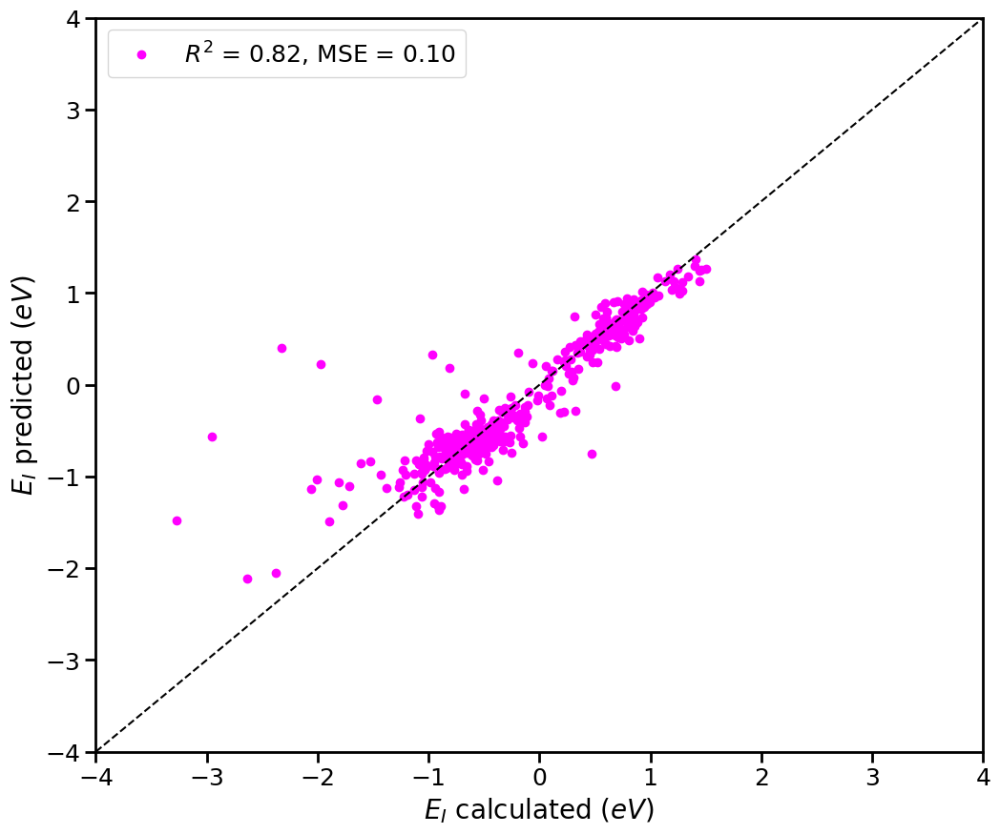

In [13]:
bestmodel = CBRegressor()

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.3, random_state=42)
kfold = KFold(n_splits = 5, shuffle = True, random_state = 42 )
### Cross validation scores
cv = RepeatedKFold(n_splits = 5, n_repeats = 3, random_state = 42)
scores = cross_val_score(bestmodel, X_train, y_train, cv = cv)
r2_mean = scores.mean()
print("%0.4f accuracy with a standard deviation of %0.4f" % (r2_mean, scores.std()))

### Cross validation predictions
yhat_bestmodel = cross_val_predict(bestmodel, X_train, y_train, cv = kfold)
Mean_sqr_error = metrics.mean_squared_error(y_train, yhat_bestmodel)
f, ax = plt.subplots(figsize=(12, 10))

# Increase axis font size
ax.tick_params(axis='both', labelsize=18)

# Increase axis linewidth
ax.spines['top'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['right'].set_linewidth(2)

# Increase tick mark thickness and length
ax.tick_params(which='both', width=2, length=8)

label_mlr = "$R^2$ = %.2f, MSE = %.2f" % (r2_mean, Mean_sqr_error)
plt.plot(y_train, yhat_bestmodel, 'o', label=label_mlr, color = "magenta")
plt.ylabel(r"$E_{I}$ predicted ($eV$)", fontsize=20)
plt.xlabel(r"$E_{I}$ calculated ($eV$)", fontsize=20)
plt.legend(fontsize=18)
plt.xlim([-4, 4])
plt.ylim([-4, 4])
plt.plot([-4, 4], [-4, 4], 'k--')
plt.show()

#f.savefig("Results_Code_3/ParityPlot", dpi = 300, transparent = False, facecolor = 'white')

## Sensitivity Analysis

Learning rate set to 0.036141
0:	learn: 0.7742802	total: 655us	remaining: 655ms
1:	learn: 0.7583453	total: 1.34ms	remaining: 667ms
2:	learn: 0.7431217	total: 2.02ms	remaining: 673ms
3:	learn: 0.7285651	total: 2.2ms	remaining: 548ms
4:	learn: 0.7129519	total: 2.74ms	remaining: 545ms
5:	learn: 0.6990903	total: 3.23ms	remaining: 536ms
6:	learn: 0.6851337	total: 3.87ms	remaining: 549ms
7:	learn: 0.6732041	total: 4.43ms	remaining: 550ms
8:	learn: 0.6611809	total: 4.88ms	remaining: 537ms
9:	learn: 0.6500614	total: 5.41ms	remaining: 536ms
10:	learn: 0.6376065	total: 6.08ms	remaining: 547ms
11:	learn: 0.6257244	total: 6.79ms	remaining: 559ms
12:	learn: 0.6141365	total: 7.37ms	remaining: 560ms
13:	learn: 0.6037296	total: 7.99ms	remaining: 562ms
14:	learn: 0.5931060	total: 8.66ms	remaining: 569ms
15:	learn: 0.5828942	total: 9.27ms	remaining: 570ms
16:	learn: 0.5741884	total: 9.89ms	remaining: 572ms
17:	learn: 0.5653370	total: 10.5ms	remaining: 575ms
18:	learn: 0.5576870	total: 11.2ms	remaining: 

257:	learn: 0.2424101	total: 161ms	remaining: 462ms
258:	learn: 0.2419613	total: 162ms	remaining: 462ms
259:	learn: 0.2418001	total: 162ms	remaining: 462ms
260:	learn: 0.2411751	total: 163ms	remaining: 462ms
261:	learn: 0.2407428	total: 164ms	remaining: 462ms
262:	learn: 0.2402833	total: 165ms	remaining: 461ms
263:	learn: 0.2394101	total: 165ms	remaining: 460ms
264:	learn: 0.2391224	total: 166ms	remaining: 460ms
265:	learn: 0.2383568	total: 167ms	remaining: 460ms
266:	learn: 0.2380350	total: 167ms	remaining: 459ms
267:	learn: 0.2379066	total: 168ms	remaining: 459ms
268:	learn: 0.2378009	total: 169ms	remaining: 458ms
269:	learn: 0.2371173	total: 169ms	remaining: 457ms
270:	learn: 0.2367272	total: 170ms	remaining: 457ms
271:	learn: 0.2359830	total: 170ms	remaining: 456ms
272:	learn: 0.2358680	total: 171ms	remaining: 456ms
273:	learn: 0.2355558	total: 172ms	remaining: 456ms
274:	learn: 0.2351861	total: 173ms	remaining: 455ms
275:	learn: 0.2350471	total: 173ms	remaining: 454ms
276:	learn: 

508:	learn: 0.1508643	total: 341ms	remaining: 329ms
509:	learn: 0.1508254	total: 342ms	remaining: 329ms
510:	learn: 0.1505111	total: 343ms	remaining: 328ms
511:	learn: 0.1503094	total: 343ms	remaining: 327ms
512:	learn: 0.1501569	total: 344ms	remaining: 327ms
513:	learn: 0.1497028	total: 345ms	remaining: 326ms
514:	learn: 0.1494815	total: 345ms	remaining: 325ms
515:	learn: 0.1491574	total: 346ms	remaining: 325ms
516:	learn: 0.1488480	total: 347ms	remaining: 324ms
517:	learn: 0.1484575	total: 348ms	remaining: 323ms
518:	learn: 0.1482861	total: 348ms	remaining: 323ms
519:	learn: 0.1479551	total: 349ms	remaining: 322ms
520:	learn: 0.1479105	total: 350ms	remaining: 322ms
521:	learn: 0.1478930	total: 350ms	remaining: 321ms
522:	learn: 0.1476817	total: 351ms	remaining: 320ms
523:	learn: 0.1473810	total: 352ms	remaining: 320ms
524:	learn: 0.1469813	total: 352ms	remaining: 319ms
525:	learn: 0.1468272	total: 353ms	remaining: 318ms
526:	learn: 0.1464887	total: 354ms	remaining: 317ms
527:	learn: 

847:	learn: 0.1007230	total: 522ms	remaining: 93.6ms
848:	learn: 0.1007010	total: 523ms	remaining: 93ms
849:	learn: 0.1006305	total: 523ms	remaining: 92.4ms
850:	learn: 0.1006233	total: 524ms	remaining: 91.7ms
851:	learn: 0.1006161	total: 524ms	remaining: 91.1ms
852:	learn: 0.1004863	total: 525ms	remaining: 90.5ms
853:	learn: 0.1003809	total: 526ms	remaining: 89.8ms
854:	learn: 0.1002480	total: 526ms	remaining: 89.2ms
855:	learn: 0.1001100	total: 527ms	remaining: 88.6ms
856:	learn: 0.1000642	total: 527ms	remaining: 88ms
857:	learn: 0.0999658	total: 528ms	remaining: 87.3ms
858:	learn: 0.0999039	total: 528ms	remaining: 86.7ms
859:	learn: 0.0997212	total: 529ms	remaining: 86.1ms
860:	learn: 0.0995708	total: 529ms	remaining: 85.5ms
861:	learn: 0.0993639	total: 530ms	remaining: 84.8ms
862:	learn: 0.0992217	total: 531ms	remaining: 84.2ms
863:	learn: 0.0991340	total: 531ms	remaining: 83.6ms
864:	learn: 0.0989885	total: 532ms	remaining: 83ms
865:	learn: 0.0989017	total: 532ms	remaining: 82.3ms

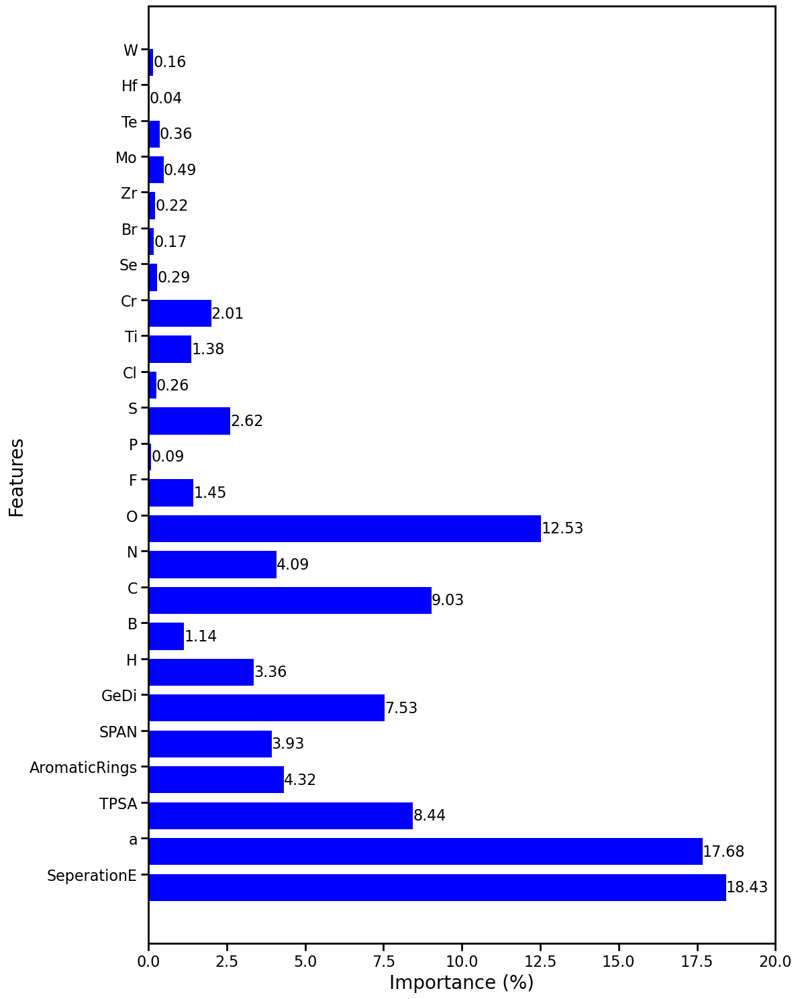

In [14]:
bestmodel.fit(X_train, y_train)
bestmodel_feature_importance = pd.DataFrame()
bestmodel_feature_importance['Feature'] = pd.DataFrame(X_test.columns)
bestmodel_feature_importance['Importance'] = pd.DataFrame(bestmodel.feature_importances_)
bestmodel_feature_importance = bestmodel_feature_importance[bestmodel_feature_importance.Importance > 0]

y = bestmodel_feature_importance.Importance
x = bestmodel_feature_importance.Feature

fig, ax = plt.subplots(figsize=(12,15)) 

# Increase axis font size
ax.tick_params(axis='both', labelsize=16)

# Increase axis linewidth
ax.spines['top'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['right'].set_linewidth(2)

# Increase tick mark thickness and length
ax.tick_params(which='both', width=2, length=8)

width = 0.75 # the width of the bars 
ind = np.arange(len(y))  # the x locations for the groups
ax.barh(ind, y, width, color="blue")
ax.set_yticks(ind+width/2)
ax.set_yticklabels(x, minor=False)
#plt.title('Distribution of Feature Importance')
plt.xlabel('Importance (%)', fontsize=20)
plt.ylabel('Features', fontsize=20)
plt.xlim([0, 20])

# Print the values on the barchart
ax.bar_label(ax.containers[0],label_type='edge',fmt='%.2f', fontsize = 16)

plt.tight_layout()  # Ensures that the figure fits within the specified dimensions

plt.show()

#fig.savefig("Results_Code_3/FeatImp", dpi=300, bbox_inches='tight', transparent=False, facecolor='white')

# Part IV: Exploration-Exploitation

<a id="exp-exp"></a>

In [15]:
## We combined our 2D materials and gas molecules datasets 
## to make all possible hybrid material combinations. 
## And, calculated necessary features for these combinations in an auxiliary code. 


PredictionSet = pd.read_csv('PredictionSet_3')
PredictionSet = PredictionSet.astype({'CID' :'str'})
PredictionSet




,CID,Name,SeperationE,a,SMILES,TPSA,AromaticRings,H,He,Li,...,Bk,Cf,Es,Fm,Md,No,Lr,SPAN,GeDi,System
0,13,MoS2,1.766763,3.154333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.509434,6.313619,13_MoS2_0
1,13,MoSe2,2.056959,3.285000,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.456396,6.211905,13_MoSe2_0
2,13,MoTe2,2.636494,3.493333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.451183,6.228006,13_MoTe2_0
3,13,MoO2,1.202318,2.828333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.469165,6.245761,13_MoO2_0
4,13,WS2,1.865270,3.162333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1,0.045455,0,0,...,0,0,0,0,0,0,0,3.457050,6.216698,13_WS2_0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,13593933,CrTe2,2.477311,3.407000,CC=C=C=C,0.0,0,0.092308,0,0,...,0,0,0,0,0,0,0,3.297814,6.552722,13593933_CrTe2_0
212474,13593933,CrO2,0.823892,2.622667,CC=C=C=C,0.0,0,0.092308,0,0,...,0,0,0,0,0,0,0,3.302684,6.319375,13593933_CrO2_0
212475,13593933,ZrS2,1.895850,3.567333,CC=C=C=C,0.0,0,0.092308,0,0,...,0,0,0,0,0,0,0,3.291805,6.497326,13593933_ZrS2_0
212476,13593933,ZrSe2,2.158777,3.706333,CC=C=C=C,0.0,0,0.092308,0,0,...,0,0,0,0,0,0,0,3.280770,6.377696,13593933_ZrSe2_0


In [16]:
FullSet = pd.concat([PredictionSet, MergeWithPredictionSet.drop(['IC_ENERGY'], axis = 1)], axis = 0).drop_duplicates(subset='System')
FullSet

,CID,Name,SeperationE,a,SMILES,TPSA,AromaticRings,H,He,Li,...,Bk,Cf,Es,Fm,Md,No,Lr,SPAN,GeDi,System
0,13,MoS2,1.766763,3.154333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.509434,6.313619,13_MoS2_0
1,13,MoSe2,2.056959,3.285000,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.456396,6.211905,13_MoSe2_0
2,13,MoTe2,2.636494,3.493333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.451183,6.228006,13_MoTe2_0
3,13,MoO2,1.202318,2.828333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.469165,6.245761,13_MoO2_0
4,13,WS2,1.865270,3.162333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,0,...,0,0,0,0,0,0,0,3.457050,6.216698,13_WS2_0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,13593933,CrTe2,2.477311,3.407000,CC=C=C=C,0.0,0.0,0.092308,0,0,...,0,0,0,0,0,0,0,3.297814,6.552722,13593933_CrTe2_0
212474,13593933,CrO2,0.823892,2.622667,CC=C=C=C,0.0,0.0,0.092308,0,0,...,0,0,0,0,0,0,0,3.302684,6.319375,13593933_CrO2_0
212475,13593933,ZrS2,1.895850,3.567333,CC=C=C=C,0.0,0.0,0.092308,0,0,...,0,0,0,0,0,0,0,3.291805,6.497326,13593933_ZrS2_0
212476,13593933,ZrSe2,2.158777,3.706333,CC=C=C=C,0.0,0.0,0.092308,0,0,...,0,0,0,0,0,0,0,3.280770,6.377696,13593933_ZrSe2_0


### Bootstrap begins here

In [17]:
n_bs = 200
train_r2 = []
test_r2 = []
pred_r2 = []
remove_from_features = ['Name', 'SMILES', 'CID', 'System']
features = [c for c in FullSet.columns if c not in remove_from_features]
X_pred = FullSet[features]

fullset_bootstrapped_yhats = pd.DataFrame()

for i in range(n_bs):
    # Making n_bs bootstrapped samples
    train = resample(FinalSet, replace=True, n_samples=len(FinalSet), random_state=i)
    test = FinalSet[~FinalSet.index.isin(train.index)]
    
    # Split bootstrapped samples into train and test sets
    X_train = train[features]
    y_train = train["IC_ENERGY"]
    X_test = test[features]
    y_test = test["IC_ENERGY"]
    
    # Fit model on train sets
    bestmodel.fit(X_train, y_train)
    
    # Model scores
    r2_train = bestmodel.score(X_train, y_train)
    r2_test = bestmodel.score(X_test, y_test)
    train_r2.append(r2_train)
    test_r2.append(r2_test)
    
    # Predict on PredictionSet
    
    y_hat = bestmodel.predict(X_pred)
    
    #temp_df = pd.DataFrame(y_hat, columns=[])
    fullset_bootstrapped_yhats['y_pred_bs_{}'.format(i)] = y_hat
    fullset_bootstrapped_yhats = fullset_bootstrapped_yhats.copy()
    #bootstrapped_yhats[i] = pd.DataFrame(y_hat)





Learning rate set to 0.03824
0:	learn: 0.7495691	total: 789us	remaining: 788ms
1:	learn: 0.7310464	total: 1.48ms	remaining: 739ms
2:	learn: 0.7126507	total: 2.24ms	remaining: 743ms
3:	learn: 0.6973622	total: 3ms	remaining: 748ms
4:	learn: 0.6822627	total: 3.8ms	remaining: 757ms
5:	learn: 0.6669285	total: 4.52ms	remaining: 748ms
6:	learn: 0.6527073	total: 5.17ms	remaining: 733ms
7:	learn: 0.6389730	total: 5.9ms	remaining: 731ms
8:	learn: 0.6260341	total: 6.58ms	remaining: 725ms
9:	learn: 0.6134593	total: 7.31ms	remaining: 724ms
10:	learn: 0.6017521	total: 8.09ms	remaining: 727ms
11:	learn: 0.5903395	total: 9.01ms	remaining: 742ms
12:	learn: 0.5798100	total: 9.91ms	remaining: 753ms
13:	learn: 0.5699376	total: 10.7ms	remaining: 754ms
14:	learn: 0.5595486	total: 11.5ms	remaining: 756ms
15:	learn: 0.5486221	total: 12.3ms	remaining: 757ms
16:	learn: 0.5389702	total: 13.2ms	remaining: 765ms
17:	learn: 0.5303358	total: 14.2ms	remaining: 774ms
18:	learn: 0.5218414	total: 15ms	remaining: 772ms
1

280:	learn: 0.1865769	total: 161ms	remaining: 412ms
281:	learn: 0.1862617	total: 162ms	remaining: 412ms
282:	learn: 0.1856686	total: 162ms	remaining: 411ms
283:	learn: 0.1849552	total: 163ms	remaining: 410ms
284:	learn: 0.1846654	total: 163ms	remaining: 410ms
285:	learn: 0.1845871	total: 164ms	remaining: 409ms
286:	learn: 0.1842254	total: 164ms	remaining: 409ms
287:	learn: 0.1836305	total: 165ms	remaining: 408ms
288:	learn: 0.1830002	total: 166ms	remaining: 407ms
289:	learn: 0.1827772	total: 166ms	remaining: 407ms
290:	learn: 0.1825310	total: 167ms	remaining: 406ms
291:	learn: 0.1815806	total: 167ms	remaining: 406ms
292:	learn: 0.1813710	total: 168ms	remaining: 405ms
293:	learn: 0.1812465	total: 168ms	remaining: 404ms
294:	learn: 0.1810381	total: 169ms	remaining: 403ms
295:	learn: 0.1806791	total: 169ms	remaining: 403ms
296:	learn: 0.1802451	total: 170ms	remaining: 402ms
297:	learn: 0.1798307	total: 170ms	remaining: 401ms
298:	learn: 0.1791977	total: 171ms	remaining: 401ms
299:	learn: 

563:	learn: 0.1106808	total: 340ms	remaining: 263ms
564:	learn: 0.1104861	total: 341ms	remaining: 262ms
565:	learn: 0.1102544	total: 342ms	remaining: 262ms
566:	learn: 0.1101837	total: 342ms	remaining: 262ms
567:	learn: 0.1100548	total: 343ms	remaining: 261ms
568:	learn: 0.1099591	total: 344ms	remaining: 261ms
569:	learn: 0.1098483	total: 345ms	remaining: 260ms
570:	learn: 0.1098026	total: 345ms	remaining: 260ms
571:	learn: 0.1097556	total: 346ms	remaining: 259ms
572:	learn: 0.1095667	total: 347ms	remaining: 259ms
573:	learn: 0.1090880	total: 348ms	remaining: 258ms
574:	learn: 0.1089803	total: 349ms	remaining: 258ms
575:	learn: 0.1088080	total: 349ms	remaining: 257ms
576:	learn: 0.1087211	total: 350ms	remaining: 257ms
577:	learn: 0.1085439	total: 351ms	remaining: 256ms
578:	learn: 0.1084356	total: 351ms	remaining: 256ms
579:	learn: 0.1083309	total: 352ms	remaining: 255ms
580:	learn: 0.1081659	total: 353ms	remaining: 254ms
581:	learn: 0.1080042	total: 353ms	remaining: 254ms
582:	learn: 

900:	learn: 0.0738358	total: 522ms	remaining: 57.4ms
901:	learn: 0.0737472	total: 523ms	remaining: 56.8ms
902:	learn: 0.0737125	total: 524ms	remaining: 56.2ms
903:	learn: 0.0736264	total: 524ms	remaining: 55.7ms
904:	learn: 0.0735091	total: 525ms	remaining: 55.1ms
905:	learn: 0.0735027	total: 525ms	remaining: 54.5ms
906:	learn: 0.0734966	total: 526ms	remaining: 53.9ms
907:	learn: 0.0734453	total: 526ms	remaining: 53.3ms
908:	learn: 0.0733699	total: 527ms	remaining: 52.7ms
909:	learn: 0.0732169	total: 527ms	remaining: 52.2ms
910:	learn: 0.0731064	total: 528ms	remaining: 51.6ms
911:	learn: 0.0730886	total: 528ms	remaining: 51ms
912:	learn: 0.0730084	total: 529ms	remaining: 50.4ms
913:	learn: 0.0729777	total: 530ms	remaining: 49.8ms
914:	learn: 0.0729711	total: 530ms	remaining: 49.3ms
915:	learn: 0.0728517	total: 531ms	remaining: 48.7ms
916:	learn: 0.0727338	total: 531ms	remaining: 48.1ms
917:	learn: 0.0725229	total: 532ms	remaining: 47.5ms
918:	learn: 0.0724410	total: 532ms	remaining: 46

86:	learn: 0.2954243	total: 48.8ms	remaining: 512ms
87:	learn: 0.2944565	total: 49.6ms	remaining: 514ms
88:	learn: 0.2941533	total: 50.2ms	remaining: 514ms
89:	learn: 0.2931133	total: 50.8ms	remaining: 514ms
90:	learn: 0.2911989	total: 51.4ms	remaining: 513ms
91:	learn: 0.2906720	total: 52ms	remaining: 513ms
92:	learn: 0.2894840	total: 52.7ms	remaining: 514ms
93:	learn: 0.2882320	total: 53.2ms	remaining: 513ms
94:	learn: 0.2877964	total: 53.8ms	remaining: 512ms
95:	learn: 0.2864066	total: 54.4ms	remaining: 513ms
96:	learn: 0.2853985	total: 55.3ms	remaining: 515ms
97:	learn: 0.2850668	total: 56.4ms	remaining: 519ms
98:	learn: 0.2841026	total: 57.5ms	remaining: 523ms
99:	learn: 0.2838306	total: 58.1ms	remaining: 523ms
100:	learn: 0.2828087	total: 58.9ms	remaining: 524ms
101:	learn: 0.2818757	total: 59.6ms	remaining: 525ms
102:	learn: 0.2815570	total: 60.4ms	remaining: 526ms
103:	learn: 0.2806631	total: 61.2ms	remaining: 528ms
104:	learn: 0.2796700	total: 62ms	remaining: 528ms
105:	learn:

361:	learn: 0.1616452	total: 195ms	remaining: 344ms
362:	learn: 0.1615776	total: 196ms	remaining: 344ms
363:	learn: 0.1610995	total: 196ms	remaining: 343ms
364:	learn: 0.1608585	total: 197ms	remaining: 343ms
365:	learn: 0.1606806	total: 197ms	remaining: 342ms
366:	learn: 0.1604122	total: 198ms	remaining: 342ms
367:	learn: 0.1601283	total: 199ms	remaining: 341ms
368:	learn: 0.1598893	total: 199ms	remaining: 340ms
369:	learn: 0.1597336	total: 200ms	remaining: 340ms
370:	learn: 0.1594166	total: 200ms	remaining: 340ms
371:	learn: 0.1589890	total: 201ms	remaining: 339ms
372:	learn: 0.1587622	total: 201ms	remaining: 339ms
373:	learn: 0.1585901	total: 202ms	remaining: 338ms
374:	learn: 0.1580888	total: 203ms	remaining: 338ms
375:	learn: 0.1577440	total: 203ms	remaining: 337ms
376:	learn: 0.1575937	total: 203ms	remaining: 336ms
377:	learn: 0.1571743	total: 204ms	remaining: 336ms
378:	learn: 0.1571359	total: 205ms	remaining: 335ms
379:	learn: 0.1569773	total: 205ms	remaining: 335ms
380:	learn: 

691:	learn: 0.1081310	total: 378ms	remaining: 168ms
692:	learn: 0.1080327	total: 379ms	remaining: 168ms
693:	learn: 0.1079437	total: 379ms	remaining: 167ms
694:	learn: 0.1077262	total: 380ms	remaining: 167ms
695:	learn: 0.1077212	total: 380ms	remaining: 166ms
696:	learn: 0.1076631	total: 381ms	remaining: 166ms
697:	learn: 0.1075883	total: 382ms	remaining: 165ms
698:	learn: 0.1075829	total: 382ms	remaining: 165ms
699:	learn: 0.1074043	total: 383ms	remaining: 164ms
700:	learn: 0.1072626	total: 384ms	remaining: 164ms
701:	learn: 0.1070612	total: 384ms	remaining: 163ms
702:	learn: 0.1068514	total: 385ms	remaining: 163ms
703:	learn: 0.1068459	total: 385ms	remaining: 162ms
704:	learn: 0.1067919	total: 386ms	remaining: 161ms
705:	learn: 0.1067844	total: 386ms	remaining: 161ms
706:	learn: 0.1066589	total: 387ms	remaining: 160ms
707:	learn: 0.1065806	total: 388ms	remaining: 160ms
708:	learn: 0.1064638	total: 388ms	remaining: 159ms
709:	learn: 0.1063502	total: 389ms	remaining: 159ms
710:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7463082	total: 1.16ms	remaining: 1.16s
1:	learn: 0.7284293	total: 2.38ms	remaining: 1.19s
2:	learn: 0.7120428	total: 3.39ms	remaining: 1.13s
3:	learn: 0.6964412	total: 4.04ms	remaining: 1.01s
4:	learn: 0.6810452	total: 4.77ms	remaining: 949ms
5:	learn: 0.6668150	total: 6.21ms	remaining: 1.03s
6:	learn: 0.6534645	total: 7.06ms	remaining: 1s
7:	learn: 0.6399471	total: 7.9ms	remaining: 980ms
8:	learn: 0.6274298	total: 8.72ms	remaining: 960ms
9:	learn: 0.6143728	total: 9.42ms	remaining: 932ms
10:	learn: 0.6028351	total: 10ms	remaining: 900ms
11:	learn: 0.5926683	total: 10.5ms	remaining: 862ms
12:	learn: 0.5806331	total: 11.4ms	remaining: 863ms
13:	learn: 0.5714045	total: 12.3ms	remaining: 867ms
14:	learn: 0.5614295	total: 13.1ms	remaining: 862ms
15:	learn: 0.5521171	total: 13.7ms	remaining: 842ms
16:	learn: 0.5430720	total: 14.5ms	remaining: 836ms
17:	learn: 0.5339451	total: 15.3ms	remaining: 833ms
18:	learn: 0.5248167	total: 15.9ms	remaining: 821ms

311:	learn: 0.1805681	total: 178ms	remaining: 393ms
312:	learn: 0.1803523	total: 179ms	remaining: 393ms
313:	learn: 0.1798627	total: 179ms	remaining: 392ms
314:	learn: 0.1796917	total: 180ms	remaining: 392ms
315:	learn: 0.1795015	total: 181ms	remaining: 392ms
316:	learn: 0.1788125	total: 182ms	remaining: 391ms
317:	learn: 0.1782990	total: 182ms	remaining: 391ms
318:	learn: 0.1778987	total: 183ms	remaining: 390ms
319:	learn: 0.1774737	total: 183ms	remaining: 389ms
320:	learn: 0.1774134	total: 184ms	remaining: 389ms
321:	learn: 0.1773525	total: 184ms	remaining: 388ms
322:	learn: 0.1771967	total: 185ms	remaining: 388ms
323:	learn: 0.1768976	total: 186ms	remaining: 387ms
324:	learn: 0.1768377	total: 186ms	remaining: 387ms
325:	learn: 0.1761718	total: 187ms	remaining: 386ms
326:	learn: 0.1754472	total: 187ms	remaining: 385ms
327:	learn: 0.1753122	total: 188ms	remaining: 385ms
328:	learn: 0.1751183	total: 188ms	remaining: 384ms
329:	learn: 0.1742860	total: 189ms	remaining: 383ms
330:	learn: 

662:	learn: 0.1034828	total: 360ms	remaining: 183ms
663:	learn: 0.1034099	total: 360ms	remaining: 182ms
664:	learn: 0.1033410	total: 361ms	remaining: 182ms
665:	learn: 0.1031022	total: 362ms	remaining: 181ms
666:	learn: 0.1029994	total: 362ms	remaining: 181ms
667:	learn: 0.1029191	total: 363ms	remaining: 180ms
668:	learn: 0.1028841	total: 363ms	remaining: 180ms
669:	learn: 0.1025052	total: 364ms	remaining: 179ms
670:	learn: 0.1024368	total: 364ms	remaining: 179ms
671:	learn: 0.1024139	total: 365ms	remaining: 178ms
672:	learn: 0.1023406	total: 366ms	remaining: 178ms
673:	learn: 0.1022463	total: 366ms	remaining: 177ms
674:	learn: 0.1022080	total: 367ms	remaining: 176ms
675:	learn: 0.1021265	total: 367ms	remaining: 176ms
676:	learn: 0.1020458	total: 368ms	remaining: 175ms
677:	learn: 0.1019372	total: 368ms	remaining: 175ms
678:	learn: 0.1018156	total: 369ms	remaining: 174ms
679:	learn: 0.1017110	total: 369ms	remaining: 174ms
680:	learn: 0.1014413	total: 370ms	remaining: 173ms
681:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7788796	total: 748us	remaining: 748ms
1:	learn: 0.7593349	total: 1.34ms	remaining: 670ms
2:	learn: 0.7404330	total: 1.81ms	remaining: 603ms
3:	learn: 0.7233791	total: 2.41ms	remaining: 600ms
4:	learn: 0.7056354	total: 3.01ms	remaining: 598ms
5:	learn: 0.6892042	total: 3.58ms	remaining: 594ms
6:	learn: 0.6740583	total: 4.17ms	remaining: 591ms
7:	learn: 0.6586830	total: 4.7ms	remaining: 583ms
8:	learn: 0.6450112	total: 5.25ms	remaining: 578ms
9:	learn: 0.6322222	total: 5.83ms	remaining: 577ms
10:	learn: 0.6192826	total: 6.41ms	remaining: 576ms
11:	learn: 0.6067582	total: 7ms	remaining: 577ms
12:	learn: 0.5949222	total: 7.6ms	remaining: 577ms
13:	learn: 0.5835575	total: 8.12ms	remaining: 572ms
14:	learn: 0.5724516	total: 8.71ms	remaining: 572ms
15:	learn: 0.5613307	total: 9.29ms	remaining: 572ms
16:	learn: 0.5514825	total: 9.92ms	remaining: 574ms
17:	learn: 0.5422476	total: 10.5ms	remaining: 575ms
18:	learn: 0.5326738	total: 11.1ms	remaining: 572ms

311:	learn: 0.1689510	total: 179ms	remaining: 395ms
312:	learn: 0.1688911	total: 180ms	remaining: 395ms
313:	learn: 0.1688265	total: 180ms	remaining: 394ms
314:	learn: 0.1686576	total: 181ms	remaining: 393ms
315:	learn: 0.1679751	total: 181ms	remaining: 393ms
316:	learn: 0.1675899	total: 182ms	remaining: 392ms
317:	learn: 0.1672383	total: 183ms	remaining: 392ms
318:	learn: 0.1669398	total: 183ms	remaining: 391ms
319:	learn: 0.1667920	total: 184ms	remaining: 390ms
320:	learn: 0.1665477	total: 184ms	remaining: 389ms
321:	learn: 0.1664849	total: 185ms	remaining: 389ms
322:	learn: 0.1663134	total: 185ms	remaining: 388ms
323:	learn: 0.1659489	total: 186ms	remaining: 388ms
324:	learn: 0.1656182	total: 186ms	remaining: 387ms
325:	learn: 0.1655663	total: 187ms	remaining: 387ms
326:	learn: 0.1653089	total: 188ms	remaining: 386ms
327:	learn: 0.1651641	total: 188ms	remaining: 385ms
328:	learn: 0.1643977	total: 189ms	remaining: 385ms
329:	learn: 0.1643290	total: 189ms	remaining: 384ms
330:	learn: 

649:	learn: 0.0967604	total: 361ms	remaining: 194ms
650:	learn: 0.0966521	total: 362ms	remaining: 194ms
651:	learn: 0.0963257	total: 362ms	remaining: 193ms
652:	learn: 0.0962173	total: 363ms	remaining: 193ms
653:	learn: 0.0962071	total: 363ms	remaining: 192ms
654:	learn: 0.0960509	total: 364ms	remaining: 192ms
655:	learn: 0.0959916	total: 365ms	remaining: 191ms
656:	learn: 0.0956592	total: 365ms	remaining: 191ms
657:	learn: 0.0955525	total: 366ms	remaining: 190ms
658:	learn: 0.0953831	total: 366ms	remaining: 190ms
659:	learn: 0.0951009	total: 367ms	remaining: 189ms
660:	learn: 0.0950192	total: 367ms	remaining: 188ms
661:	learn: 0.0949090	total: 368ms	remaining: 188ms
662:	learn: 0.0947504	total: 368ms	remaining: 187ms
663:	learn: 0.0944661	total: 369ms	remaining: 187ms
664:	learn: 0.0944352	total: 370ms	remaining: 186ms
665:	learn: 0.0943367	total: 370ms	remaining: 186ms
666:	learn: 0.0943257	total: 371ms	remaining: 185ms
667:	learn: 0.0942551	total: 371ms	remaining: 184ms
668:	learn: 

998:	learn: 0.0648733	total: 543ms	remaining: 543us
999:	learn: 0.0647519	total: 544ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7375712	total: 575us	remaining: 575ms
1:	learn: 0.7175423	total: 1.21ms	remaining: 605ms
2:	learn: 0.6991571	total: 1.86ms	remaining: 619ms
3:	learn: 0.6812724	total: 2.4ms	remaining: 598ms
4:	learn: 0.6647183	total: 2.94ms	remaining: 586ms
5:	learn: 0.6490085	total: 3.54ms	remaining: 587ms
6:	learn: 0.6338458	total: 4.08ms	remaining: 578ms
7:	learn: 0.6182294	total: 4.58ms	remaining: 568ms
8:	learn: 0.6038926	total: 5.18ms	remaining: 571ms
9:	learn: 0.5892301	total: 5.74ms	remaining: 569ms
10:	learn: 0.5759445	total: 6.31ms	remaining: 568ms
11:	learn: 0.5637319	total: 6.84ms	remaining: 564ms
12:	learn: 0.5515440	total: 7.4ms	remaining: 562ms
13:	learn: 0.5404288	total: 7.9ms	remaining: 557ms
14:	learn: 0.5297285	total: 8.32ms	remaining: 546ms
15:	learn: 0.5181143	total: 8.9ms	remaining: 547ms
16:	learn: 0.5075537	total: 9.44ms	remaining: 546ms


187:	learn: 0.1950870	total: 110ms	remaining: 473ms
188:	learn: 0.1946069	total: 111ms	remaining: 475ms
189:	learn: 0.1939866	total: 111ms	remaining: 475ms
190:	learn: 0.1935629	total: 112ms	remaining: 475ms
191:	learn: 0.1928235	total: 113ms	remaining: 475ms
192:	learn: 0.1922463	total: 113ms	remaining: 475ms
193:	learn: 0.1920169	total: 114ms	remaining: 474ms
194:	learn: 0.1909558	total: 115ms	remaining: 474ms
195:	learn: 0.1904184	total: 115ms	remaining: 473ms
196:	learn: 0.1901763	total: 116ms	remaining: 472ms
197:	learn: 0.1897535	total: 117ms	remaining: 473ms
198:	learn: 0.1893474	total: 117ms	remaining: 472ms
199:	learn: 0.1890925	total: 118ms	remaining: 472ms
200:	learn: 0.1886657	total: 119ms	remaining: 472ms
201:	learn: 0.1883326	total: 119ms	remaining: 471ms
202:	learn: 0.1879915	total: 120ms	remaining: 471ms
203:	learn: 0.1875579	total: 121ms	remaining: 471ms
204:	learn: 0.1872011	total: 121ms	remaining: 471ms
205:	learn: 0.1867968	total: 122ms	remaining: 471ms
206:	learn: 

486:	learn: 0.1098259	total: 291ms	remaining: 307ms
487:	learn: 0.1097917	total: 292ms	remaining: 306ms
488:	learn: 0.1097652	total: 292ms	remaining: 306ms
489:	learn: 0.1096839	total: 293ms	remaining: 305ms
490:	learn: 0.1094207	total: 294ms	remaining: 304ms
491:	learn: 0.1091608	total: 294ms	remaining: 304ms
492:	learn: 0.1089750	total: 295ms	remaining: 303ms
493:	learn: 0.1088949	total: 295ms	remaining: 303ms
494:	learn: 0.1087310	total: 296ms	remaining: 302ms
495:	learn: 0.1086002	total: 297ms	remaining: 301ms
496:	learn: 0.1084292	total: 297ms	remaining: 301ms
497:	learn: 0.1079531	total: 298ms	remaining: 300ms
498:	learn: 0.1078474	total: 298ms	remaining: 299ms
499:	learn: 0.1077476	total: 299ms	remaining: 299ms
500:	learn: 0.1076842	total: 299ms	remaining: 298ms
501:	learn: 0.1075746	total: 300ms	remaining: 298ms
502:	learn: 0.1074360	total: 301ms	remaining: 297ms
503:	learn: 0.1071896	total: 301ms	remaining: 297ms
504:	learn: 0.1071405	total: 302ms	remaining: 296ms
505:	learn: 

807:	learn: 0.0667790	total: 473ms	remaining: 112ms
808:	learn: 0.0666917	total: 474ms	remaining: 112ms
809:	learn: 0.0665965	total: 475ms	remaining: 111ms
810:	learn: 0.0665889	total: 475ms	remaining: 111ms
811:	learn: 0.0665353	total: 476ms	remaining: 110ms
812:	learn: 0.0664068	total: 477ms	remaining: 110ms
813:	learn: 0.0663439	total: 477ms	remaining: 109ms
814:	learn: 0.0662763	total: 478ms	remaining: 109ms
815:	learn: 0.0662262	total: 479ms	remaining: 108ms
816:	learn: 0.0661385	total: 479ms	remaining: 107ms
817:	learn: 0.0660688	total: 480ms	remaining: 107ms
818:	learn: 0.0660034	total: 480ms	remaining: 106ms
819:	learn: 0.0659881	total: 481ms	remaining: 106ms
820:	learn: 0.0658191	total: 482ms	remaining: 105ms
821:	learn: 0.0656898	total: 482ms	remaining: 104ms
822:	learn: 0.0655756	total: 483ms	remaining: 104ms
823:	learn: 0.0655667	total: 484ms	remaining: 103ms
824:	learn: 0.0654314	total: 485ms	remaining: 103ms
825:	learn: 0.0653169	total: 485ms	remaining: 102ms
826:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7494382	total: 712us	remaining: 712ms
1:	learn: 0.7312903	total: 1.38ms	remaining: 688ms
2:	learn: 0.7147787	total: 2.15ms	remaining: 714ms
3:	learn: 0.6985725	total: 2.88ms	remaining: 716ms
4:	learn: 0.6822916	total: 3.77ms	remaining: 750ms
5:	learn: 0.6675158	total: 4.41ms	remaining: 731ms
6:	learn: 0.6531983	total: 5.04ms	remaining: 715ms
7:	learn: 0.6397135	total: 5.78ms	remaining: 716ms
8:	learn: 0.6266785	total: 6.44ms	remaining: 709ms
9:	learn: 0.6145190	total: 7.11ms	remaining: 704ms
10:	learn: 0.6025753	total: 7.81ms	remaining: 703ms
11:	learn: 0.5909698	total: 8.54ms	remaining: 703ms
12:	learn: 0.5779039	total: 9.15ms	remaining: 695ms
13:	learn: 0.5677134	total: 9.79ms	remaining: 689ms
14:	learn: 0.5569531	total: 10.6ms	remaining: 695ms
15:	learn: 0.5480082	total: 11.1ms	remaining: 682ms
16:	learn: 0.5375753	total: 11.8ms	remaining: 681ms
17:	learn: 0.5292206	total: 12.4ms	remaining: 677ms
18:	learn: 0.5206045	total: 13ms	remaining: 67

306:	learn: 0.1712368	total: 162ms	remaining: 365ms
307:	learn: 0.1703992	total: 163ms	remaining: 365ms
308:	learn: 0.1699139	total: 163ms	remaining: 365ms
309:	learn: 0.1693554	total: 164ms	remaining: 365ms
310:	learn: 0.1688760	total: 164ms	remaining: 364ms
311:	learn: 0.1684485	total: 165ms	remaining: 364ms
312:	learn: 0.1679923	total: 166ms	remaining: 363ms
313:	learn: 0.1674377	total: 166ms	remaining: 363ms
314:	learn: 0.1670583	total: 167ms	remaining: 362ms
315:	learn: 0.1666066	total: 167ms	remaining: 362ms
316:	learn: 0.1657080	total: 168ms	remaining: 361ms
317:	learn: 0.1652147	total: 168ms	remaining: 361ms
318:	learn: 0.1649451	total: 169ms	remaining: 360ms
319:	learn: 0.1644603	total: 169ms	remaining: 360ms
320:	learn: 0.1641104	total: 170ms	remaining: 359ms
321:	learn: 0.1635764	total: 170ms	remaining: 359ms
322:	learn: 0.1631709	total: 171ms	remaining: 358ms
323:	learn: 0.1628505	total: 171ms	remaining: 358ms
324:	learn: 0.1623976	total: 172ms	remaining: 357ms
325:	learn: 

630:	learn: 0.1009131	total: 326ms	remaining: 191ms
631:	learn: 0.1008247	total: 327ms	remaining: 190ms
632:	learn: 0.1007241	total: 328ms	remaining: 190ms
633:	learn: 0.1005408	total: 328ms	remaining: 189ms
634:	learn: 0.1005062	total: 329ms	remaining: 189ms
635:	learn: 0.1004311	total: 330ms	remaining: 189ms
636:	learn: 0.1004159	total: 330ms	remaining: 188ms
637:	learn: 0.1002282	total: 331ms	remaining: 188ms
638:	learn: 0.1001420	total: 331ms	remaining: 187ms
639:	learn: 0.1000822	total: 332ms	remaining: 187ms
640:	learn: 0.1000426	total: 333ms	remaining: 186ms
641:	learn: 0.0998611	total: 333ms	remaining: 186ms
642:	learn: 0.0998130	total: 334ms	remaining: 185ms
643:	learn: 0.0996257	total: 334ms	remaining: 185ms
644:	learn: 0.0995657	total: 335ms	remaining: 184ms
645:	learn: 0.0994556	total: 335ms	remaining: 184ms
646:	learn: 0.0994226	total: 336ms	remaining: 183ms
647:	learn: 0.0994073	total: 336ms	remaining: 183ms
648:	learn: 0.0993914	total: 337ms	remaining: 182ms
649:	learn: 

944:	learn: 0.0720655	total: 493ms	remaining: 28.7ms
945:	learn: 0.0720592	total: 493ms	remaining: 28.2ms
946:	learn: 0.0719776	total: 494ms	remaining: 27.6ms
947:	learn: 0.0718020	total: 494ms	remaining: 27.1ms
948:	learn: 0.0717957	total: 495ms	remaining: 26.6ms
949:	learn: 0.0717168	total: 495ms	remaining: 26.1ms
950:	learn: 0.0717069	total: 496ms	remaining: 25.6ms
951:	learn: 0.0716098	total: 497ms	remaining: 25ms
952:	learn: 0.0715668	total: 497ms	remaining: 24.5ms
953:	learn: 0.0715277	total: 498ms	remaining: 24ms
954:	learn: 0.0714785	total: 498ms	remaining: 23.5ms
955:	learn: 0.0714295	total: 499ms	remaining: 22.9ms
956:	learn: 0.0714047	total: 499ms	remaining: 22.4ms
957:	learn: 0.0712999	total: 500ms	remaining: 21.9ms
958:	learn: 0.0712620	total: 500ms	remaining: 21.4ms
959:	learn: 0.0712401	total: 501ms	remaining: 20.9ms
960:	learn: 0.0711524	total: 501ms	remaining: 20.3ms
961:	learn: 0.0711471	total: 502ms	remaining: 19.8ms
962:	learn: 0.0711226	total: 502ms	remaining: 19.3

413:	learn: 0.1353866	total: 239ms	remaining: 339ms
414:	learn: 0.1351811	total: 240ms	remaining: 339ms
415:	learn: 0.1349884	total: 241ms	remaining: 338ms
416:	learn: 0.1348189	total: 241ms	remaining: 338ms
417:	learn: 0.1346616	total: 242ms	remaining: 337ms
418:	learn: 0.1345415	total: 243ms	remaining: 336ms
419:	learn: 0.1342830	total: 243ms	remaining: 336ms
420:	learn: 0.1338625	total: 244ms	remaining: 335ms
421:	learn: 0.1336275	total: 244ms	remaining: 334ms
422:	learn: 0.1333351	total: 245ms	remaining: 334ms
423:	learn: 0.1331263	total: 245ms	remaining: 333ms
424:	learn: 0.1330016	total: 246ms	remaining: 332ms
425:	learn: 0.1328077	total: 246ms	remaining: 332ms
426:	learn: 0.1325986	total: 247ms	remaining: 331ms
427:	learn: 0.1323877	total: 247ms	remaining: 331ms
428:	learn: 0.1320426	total: 248ms	remaining: 330ms
429:	learn: 0.1318804	total: 248ms	remaining: 329ms
430:	learn: 0.1316085	total: 249ms	remaining: 329ms
431:	learn: 0.1311025	total: 249ms	remaining: 328ms
432:	learn: 

671:	learn: 0.0911669	total: 386ms	remaining: 188ms
672:	learn: 0.0911477	total: 387ms	remaining: 188ms
673:	learn: 0.0909926	total: 387ms	remaining: 187ms
674:	learn: 0.0908558	total: 388ms	remaining: 187ms
675:	learn: 0.0907942	total: 388ms	remaining: 186ms
676:	learn: 0.0906436	total: 389ms	remaining: 185ms
677:	learn: 0.0904787	total: 389ms	remaining: 185ms
678:	learn: 0.0903336	total: 390ms	remaining: 184ms
679:	learn: 0.0902609	total: 390ms	remaining: 184ms
680:	learn: 0.0901658	total: 391ms	remaining: 183ms
681:	learn: 0.0900143	total: 391ms	remaining: 183ms
682:	learn: 0.0899619	total: 392ms	remaining: 182ms
683:	learn: 0.0897220	total: 393ms	remaining: 181ms
684:	learn: 0.0896042	total: 393ms	remaining: 181ms
685:	learn: 0.0895556	total: 394ms	remaining: 180ms
686:	learn: 0.0894634	total: 394ms	remaining: 180ms
687:	learn: 0.0893951	total: 395ms	remaining: 179ms
688:	learn: 0.0893330	total: 395ms	remaining: 178ms
689:	learn: 0.0891179	total: 396ms	remaining: 178ms
690:	learn: 

Learning rate set to 0.03824
0:	learn: 0.6954150	total: 719us	remaining: 719ms
1:	learn: 0.6775834	total: 1.35ms	remaining: 674ms
2:	learn: 0.6606846	total: 2.09ms	remaining: 696ms
3:	learn: 0.6457711	total: 2.9ms	remaining: 721ms
4:	learn: 0.6297230	total: 3.56ms	remaining: 708ms
5:	learn: 0.6148464	total: 4.23ms	remaining: 701ms
6:	learn: 0.6003767	total: 4.81ms	remaining: 682ms
7:	learn: 0.5867109	total: 5.43ms	remaining: 673ms
8:	learn: 0.5740658	total: 6.13ms	remaining: 675ms
9:	learn: 0.5616486	total: 6.86ms	remaining: 679ms
10:	learn: 0.5511528	total: 7.45ms	remaining: 670ms
11:	learn: 0.5397600	total: 8.09ms	remaining: 666ms
12:	learn: 0.5288393	total: 8.79ms	remaining: 668ms
13:	learn: 0.5191772	total: 9.43ms	remaining: 664ms
14:	learn: 0.5094866	total: 10.1ms	remaining: 663ms
15:	learn: 0.5003433	total: 10.7ms	remaining: 658ms
16:	learn: 0.4916197	total: 11.3ms	remaining: 652ms
17:	learn: 0.4827944	total: 11.9ms	remaining: 648ms
18:	learn: 0.4738190	total: 12.5ms	remaining: 6

316:	learn: 0.1731603	total: 179ms	remaining: 386ms
317:	learn: 0.1730933	total: 180ms	remaining: 386ms
318:	learn: 0.1727871	total: 181ms	remaining: 385ms
319:	learn: 0.1724533	total: 181ms	remaining: 385ms
320:	learn: 0.1722915	total: 182ms	remaining: 385ms
321:	learn: 0.1716601	total: 183ms	remaining: 384ms
322:	learn: 0.1710695	total: 183ms	remaining: 384ms
323:	learn: 0.1705614	total: 184ms	remaining: 383ms
324:	learn: 0.1701697	total: 184ms	remaining: 383ms
325:	learn: 0.1697809	total: 185ms	remaining: 382ms
326:	learn: 0.1692742	total: 186ms	remaining: 382ms
327:	learn: 0.1687814	total: 186ms	remaining: 381ms
328:	learn: 0.1685024	total: 187ms	remaining: 381ms
329:	learn: 0.1682922	total: 187ms	remaining: 380ms
330:	learn: 0.1680380	total: 188ms	remaining: 379ms
331:	learn: 0.1679978	total: 188ms	remaining: 379ms
332:	learn: 0.1677566	total: 189ms	remaining: 378ms
333:	learn: 0.1673552	total: 189ms	remaining: 377ms
334:	learn: 0.1673098	total: 190ms	remaining: 377ms
335:	learn: 

637:	learn: 0.1099959	total: 362ms	remaining: 205ms
638:	learn: 0.1098535	total: 362ms	remaining: 205ms
639:	learn: 0.1097817	total: 363ms	remaining: 204ms
640:	learn: 0.1096389	total: 364ms	remaining: 204ms
641:	learn: 0.1093643	total: 364ms	remaining: 203ms
642:	learn: 0.1093548	total: 365ms	remaining: 202ms
643:	learn: 0.1091668	total: 365ms	remaining: 202ms
644:	learn: 0.1091576	total: 366ms	remaining: 201ms
645:	learn: 0.1090026	total: 366ms	remaining: 201ms
646:	learn: 0.1087734	total: 367ms	remaining: 200ms
647:	learn: 0.1087644	total: 367ms	remaining: 200ms
648:	learn: 0.1084987	total: 368ms	remaining: 199ms
649:	learn: 0.1083355	total: 368ms	remaining: 198ms
650:	learn: 0.1082220	total: 369ms	remaining: 198ms
651:	learn: 0.1079923	total: 369ms	remaining: 197ms
652:	learn: 0.1078183	total: 370ms	remaining: 197ms
653:	learn: 0.1076446	total: 370ms	remaining: 196ms
654:	learn: 0.1075431	total: 371ms	remaining: 195ms
655:	learn: 0.1074360	total: 372ms	remaining: 195ms
656:	learn: 

987:	learn: 0.0739264	total: 544ms	remaining: 6.6ms
988:	learn: 0.0738481	total: 545ms	remaining: 6.06ms
989:	learn: 0.0737581	total: 545ms	remaining: 5.51ms
990:	learn: 0.0737105	total: 546ms	remaining: 4.96ms
991:	learn: 0.0736531	total: 546ms	remaining: 4.41ms
992:	learn: 0.0735610	total: 547ms	remaining: 3.86ms
993:	learn: 0.0735127	total: 548ms	remaining: 3.31ms
994:	learn: 0.0733168	total: 548ms	remaining: 2.75ms
995:	learn: 0.0731046	total: 549ms	remaining: 2.2ms
996:	learn: 0.0730998	total: 549ms	remaining: 1.65ms
997:	learn: 0.0729280	total: 550ms	remaining: 1.1ms
998:	learn: 0.0728256	total: 550ms	remaining: 550us
999:	learn: 0.0727901	total: 551ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7627847	total: 1.56ms	remaining: 1.56s
1:	learn: 0.7463097	total: 2.67ms	remaining: 1.33s
2:	learn: 0.7292417	total: 3.69ms	remaining: 1.23s
3:	learn: 0.7128180	total: 4.68ms	remaining: 1.16s
4:	learn: 0.6980691	total: 5.76ms	remaining: 1.15s
5:	learn: 0.6821773	total: 6.81ms	

377:	learn: 0.1796884	total: 229ms	remaining: 377ms
378:	learn: 0.1790385	total: 230ms	remaining: 377ms
379:	learn: 0.1787568	total: 230ms	remaining: 376ms
380:	learn: 0.1785186	total: 231ms	remaining: 376ms
381:	learn: 0.1782075	total: 232ms	remaining: 375ms
382:	learn: 0.1775184	total: 232ms	remaining: 374ms
383:	learn: 0.1773447	total: 233ms	remaining: 374ms
384:	learn: 0.1769106	total: 233ms	remaining: 373ms
385:	learn: 0.1766060	total: 234ms	remaining: 372ms
386:	learn: 0.1763287	total: 235ms	remaining: 372ms
387:	learn: 0.1761871	total: 235ms	remaining: 371ms
388:	learn: 0.1757938	total: 236ms	remaining: 370ms
389:	learn: 0.1756489	total: 236ms	remaining: 370ms
390:	learn: 0.1753145	total: 237ms	remaining: 369ms
391:	learn: 0.1750621	total: 237ms	remaining: 368ms
392:	learn: 0.1747991	total: 238ms	remaining: 368ms
393:	learn: 0.1740947	total: 239ms	remaining: 367ms
394:	learn: 0.1738871	total: 239ms	remaining: 366ms
395:	learn: 0.1732594	total: 240ms	remaining: 366ms
396:	learn: 

723:	learn: 0.1069194	total: 412ms	remaining: 157ms
724:	learn: 0.1067363	total: 413ms	remaining: 157ms
725:	learn: 0.1064565	total: 413ms	remaining: 156ms
726:	learn: 0.1063431	total: 414ms	remaining: 155ms
727:	learn: 0.1060899	total: 415ms	remaining: 155ms
728:	learn: 0.1059423	total: 415ms	remaining: 154ms
729:	learn: 0.1058175	total: 416ms	remaining: 154ms
730:	learn: 0.1057325	total: 416ms	remaining: 153ms
731:	learn: 0.1055939	total: 417ms	remaining: 153ms
732:	learn: 0.1052571	total: 417ms	remaining: 152ms
733:	learn: 0.1052336	total: 418ms	remaining: 151ms
734:	learn: 0.1051858	total: 418ms	remaining: 151ms
735:	learn: 0.1049622	total: 419ms	remaining: 150ms
736:	learn: 0.1048286	total: 419ms	remaining: 150ms
737:	learn: 0.1045904	total: 420ms	remaining: 149ms
738:	learn: 0.1045677	total: 421ms	remaining: 149ms
739:	learn: 0.1043877	total: 421ms	remaining: 148ms
740:	learn: 0.1042947	total: 422ms	remaining: 147ms
741:	learn: 0.1042388	total: 422ms	remaining: 147ms
742:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7754039	total: 989us	remaining: 989ms
1:	learn: 0.7572427	total: 2.09ms	remaining: 1.04s
2:	learn: 0.7378698	total: 3.1ms	remaining: 1.03s
3:	learn: 0.7200239	total: 4.26ms	remaining: 1.06s
4:	learn: 0.7029082	total: 5.3ms	remaining: 1.05s
5:	learn: 0.6855740	total: 6.43ms	remaining: 1.06s
6:	learn: 0.6705716	total: 7.39ms	remaining: 1.05s
7:	learn: 0.6556242	total: 8.1ms	remaining: 1s
8:	learn: 0.6408265	total: 9.02ms	remaining: 993ms
9:	learn: 0.6270693	total: 10ms	remaining: 993ms
10:	learn: 0.6132008	total: 10.9ms	remaining: 977ms
11:	learn: 0.6000366	total: 11.9ms	remaining: 976ms
12:	learn: 0.5878145	total: 12.5ms	remaining: 951ms
13:	learn: 0.5762786	total: 13.4ms	remaining: 945ms
14:	learn: 0.5647429	total: 14.1ms	remaining: 926ms
15:	learn: 0.5540125	total: 15.1ms	remaining: 927ms
16:	learn: 0.5444135	total: 16ms	remaining: 924ms
17:	learn: 0.5358644	total: 16.7ms	remaining: 913ms
18:	learn: 0.5257310	total: 17.5ms	remaining: 906ms
19:	

296:	learn: 0.1854339	total: 178ms	remaining: 422ms
297:	learn: 0.1847285	total: 179ms	remaining: 422ms
298:	learn: 0.1837548	total: 180ms	remaining: 421ms
299:	learn: 0.1833196	total: 180ms	remaining: 420ms
300:	learn: 0.1832406	total: 181ms	remaining: 420ms
301:	learn: 0.1825556	total: 181ms	remaining: 419ms
302:	learn: 0.1821040	total: 182ms	remaining: 418ms
303:	learn: 0.1815449	total: 182ms	remaining: 418ms
304:	learn: 0.1810446	total: 183ms	remaining: 417ms
305:	learn: 0.1807395	total: 184ms	remaining: 416ms
306:	learn: 0.1803539	total: 184ms	remaining: 416ms
307:	learn: 0.1797300	total: 185ms	remaining: 415ms
308:	learn: 0.1787730	total: 185ms	remaining: 414ms
309:	learn: 0.1781323	total: 186ms	remaining: 414ms
310:	learn: 0.1776248	total: 186ms	remaining: 413ms
311:	learn: 0.1771442	total: 187ms	remaining: 412ms
312:	learn: 0.1769206	total: 188ms	remaining: 412ms
313:	learn: 0.1767132	total: 188ms	remaining: 411ms
314:	learn: 0.1766368	total: 189ms	remaining: 410ms
315:	learn: 

651:	learn: 0.1032655	total: 360ms	remaining: 192ms
652:	learn: 0.1029180	total: 361ms	remaining: 192ms
653:	learn: 0.1027583	total: 362ms	remaining: 191ms
654:	learn: 0.1027191	total: 362ms	remaining: 191ms
655:	learn: 0.1025751	total: 363ms	remaining: 190ms
656:	learn: 0.1024625	total: 363ms	remaining: 190ms
657:	learn: 0.1021753	total: 364ms	remaining: 189ms
658:	learn: 0.1021033	total: 365ms	remaining: 189ms
659:	learn: 0.1018198	total: 365ms	remaining: 188ms
660:	learn: 0.1017508	total: 366ms	remaining: 188ms
661:	learn: 0.1015896	total: 366ms	remaining: 187ms
662:	learn: 0.1015445	total: 367ms	remaining: 186ms
663:	learn: 0.1011483	total: 367ms	remaining: 186ms
664:	learn: 0.1010117	total: 368ms	remaining: 185ms
665:	learn: 0.1009253	total: 368ms	remaining: 185ms
666:	learn: 0.1008479	total: 369ms	remaining: 184ms
667:	learn: 0.1007193	total: 369ms	remaining: 184ms
668:	learn: 0.1006940	total: 370ms	remaining: 183ms
669:	learn: 0.1003682	total: 371ms	remaining: 183ms
670:	learn: 

994:	learn: 0.0680107	total: 542ms	remaining: 2.73ms
995:	learn: 0.0679472	total: 543ms	remaining: 2.18ms
996:	learn: 0.0679429	total: 544ms	remaining: 1.64ms
997:	learn: 0.0677581	total: 544ms	remaining: 1.09ms
998:	learn: 0.0676867	total: 545ms	remaining: 545us
999:	learn: 0.0676624	total: 546ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7468454	total: 710us	remaining: 710ms
1:	learn: 0.7288013	total: 1.46ms	remaining: 726ms
2:	learn: 0.7111080	total: 2.1ms	remaining: 698ms
3:	learn: 0.6946394	total: 2.79ms	remaining: 694ms
4:	learn: 0.6781573	total: 3.46ms	remaining: 688ms
5:	learn: 0.6617776	total: 4.13ms	remaining: 685ms
6:	learn: 0.6461894	total: 4.84ms	remaining: 686ms
7:	learn: 0.6323783	total: 5.51ms	remaining: 684ms
8:	learn: 0.6186386	total: 6.15ms	remaining: 678ms
9:	learn: 0.6056755	total: 6.77ms	remaining: 671ms
10:	learn: 0.5918055	total: 7.41ms	remaining: 666ms
11:	learn: 0.5794225	total: 8.02ms	remaining: 660ms
12:	learn: 0.5672317	total: 8.58ms	remaining:

499:	learn: 0.1127627	total: 274ms	remaining: 274ms
500:	learn: 0.1125472	total: 275ms	remaining: 274ms
501:	learn: 0.1122774	total: 276ms	remaining: 273ms
502:	learn: 0.1120641	total: 276ms	remaining: 273ms
503:	learn: 0.1120497	total: 277ms	remaining: 272ms
504:	learn: 0.1118876	total: 277ms	remaining: 272ms
505:	learn: 0.1116855	total: 278ms	remaining: 272ms
506:	learn: 0.1115827	total: 279ms	remaining: 271ms
507:	learn: 0.1114372	total: 279ms	remaining: 271ms
508:	learn: 0.1112181	total: 280ms	remaining: 270ms
509:	learn: 0.1108735	total: 281ms	remaining: 270ms
510:	learn: 0.1105895	total: 281ms	remaining: 269ms
511:	learn: 0.1104230	total: 282ms	remaining: 268ms
512:	learn: 0.1104037	total: 282ms	remaining: 268ms
513:	learn: 0.1103730	total: 283ms	remaining: 267ms
514:	learn: 0.1101642	total: 283ms	remaining: 267ms
515:	learn: 0.1100234	total: 284ms	remaining: 266ms
516:	learn: 0.1100054	total: 284ms	remaining: 266ms
517:	learn: 0.1098183	total: 285ms	remaining: 265ms
518:	learn: 

842:	learn: 0.0735225	total: 456ms	remaining: 84.9ms
843:	learn: 0.0733419	total: 457ms	remaining: 84.4ms
844:	learn: 0.0732486	total: 457ms	remaining: 83.8ms
845:	learn: 0.0731645	total: 458ms	remaining: 83.3ms
846:	learn: 0.0730222	total: 458ms	remaining: 82.8ms
847:	learn: 0.0728873	total: 459ms	remaining: 82.2ms
848:	learn: 0.0727826	total: 459ms	remaining: 81.7ms
849:	learn: 0.0726828	total: 460ms	remaining: 81.2ms
850:	learn: 0.0726150	total: 460ms	remaining: 80.6ms
851:	learn: 0.0724965	total: 461ms	remaining: 80.1ms
852:	learn: 0.0724419	total: 462ms	remaining: 79.5ms
853:	learn: 0.0723881	total: 462ms	remaining: 79ms
854:	learn: 0.0723082	total: 463ms	remaining: 78.5ms
855:	learn: 0.0722490	total: 463ms	remaining: 77.9ms
856:	learn: 0.0721549	total: 464ms	remaining: 77.4ms
857:	learn: 0.0720567	total: 464ms	remaining: 76.8ms
858:	learn: 0.0720334	total: 465ms	remaining: 76.3ms
859:	learn: 0.0720293	total: 465ms	remaining: 75.8ms
860:	learn: 0.0720223	total: 466ms	remaining: 75

26:	learn: 0.4435629	total: 19ms	remaining: 684ms
27:	learn: 0.4363622	total: 20ms	remaining: 695ms
28:	learn: 0.4293439	total: 21ms	remaining: 703ms
29:	learn: 0.4228220	total: 22.1ms	remaining: 713ms
30:	learn: 0.4177236	total: 23ms	remaining: 718ms
31:	learn: 0.4125638	total: 23.8ms	remaining: 720ms
32:	learn: 0.4069222	total: 24.7ms	remaining: 723ms
33:	learn: 0.4013795	total: 25.7ms	remaining: 730ms
34:	learn: 0.3968934	total: 26.8ms	remaining: 738ms
35:	learn: 0.3914132	total: 27.9ms	remaining: 746ms
36:	learn: 0.3855520	total: 28.7ms	remaining: 748ms
37:	learn: 0.3809457	total: 29.9ms	remaining: 756ms
38:	learn: 0.3771962	total: 30.9ms	remaining: 762ms
39:	learn: 0.3734356	total: 31.9ms	remaining: 767ms
40:	learn: 0.3686760	total: 33ms	remaining: 771ms
41:	learn: 0.3651004	total: 33.9ms	remaining: 774ms
42:	learn: 0.3603523	total: 34.8ms	remaining: 775ms
43:	learn: 0.3566053	total: 35.7ms	remaining: 777ms
44:	learn: 0.3533331	total: 36.7ms	remaining: 779ms
45:	learn: 0.3499022	t

299:	learn: 0.1547195	total: 183ms	remaining: 428ms
300:	learn: 0.1542289	total: 184ms	remaining: 427ms
301:	learn: 0.1538866	total: 185ms	remaining: 427ms
302:	learn: 0.1534742	total: 185ms	remaining: 426ms
303:	learn: 0.1530710	total: 186ms	remaining: 426ms
304:	learn: 0.1527658	total: 187ms	remaining: 425ms
305:	learn: 0.1524240	total: 187ms	remaining: 424ms
306:	learn: 0.1521567	total: 188ms	remaining: 424ms
307:	learn: 0.1518018	total: 188ms	remaining: 423ms
308:	learn: 0.1513485	total: 189ms	remaining: 422ms
309:	learn: 0.1508623	total: 189ms	remaining: 422ms
310:	learn: 0.1505021	total: 190ms	remaining: 421ms
311:	learn: 0.1501286	total: 191ms	remaining: 420ms
312:	learn: 0.1497900	total: 191ms	remaining: 420ms
313:	learn: 0.1495500	total: 192ms	remaining: 419ms
314:	learn: 0.1492740	total: 192ms	remaining: 418ms
315:	learn: 0.1490558	total: 193ms	remaining: 418ms
316:	learn: 0.1484238	total: 193ms	remaining: 417ms
317:	learn: 0.1480524	total: 194ms	remaining: 416ms
318:	learn: 

619:	learn: 0.0907184	total: 348ms	remaining: 213ms
620:	learn: 0.0906363	total: 350ms	remaining: 214ms
621:	learn: 0.0904272	total: 351ms	remaining: 213ms
622:	learn: 0.0902719	total: 352ms	remaining: 213ms
623:	learn: 0.0901541	total: 353ms	remaining: 213ms
624:	learn: 0.0900839	total: 354ms	remaining: 212ms
625:	learn: 0.0899706	total: 355ms	remaining: 212ms
626:	learn: 0.0898571	total: 355ms	remaining: 211ms
627:	learn: 0.0897793	total: 356ms	remaining: 211ms
628:	learn: 0.0896642	total: 357ms	remaining: 211ms
629:	learn: 0.0896421	total: 358ms	remaining: 210ms
630:	learn: 0.0895683	total: 358ms	remaining: 210ms
631:	learn: 0.0894635	total: 359ms	remaining: 209ms
632:	learn: 0.0894218	total: 360ms	remaining: 209ms
633:	learn: 0.0894030	total: 361ms	remaining: 208ms
634:	learn: 0.0892246	total: 361ms	remaining: 208ms
635:	learn: 0.0891265	total: 362ms	remaining: 207ms
636:	learn: 0.0888402	total: 363ms	remaining: 207ms
637:	learn: 0.0887402	total: 363ms	remaining: 206ms
638:	learn: 

947:	learn: 0.0639327	total: 530ms	remaining: 29.1ms
948:	learn: 0.0638583	total: 531ms	remaining: 28.5ms
949:	learn: 0.0638007	total: 531ms	remaining: 27.9ms
950:	learn: 0.0637530	total: 532ms	remaining: 27.4ms
951:	learn: 0.0636291	total: 532ms	remaining: 26.8ms
952:	learn: 0.0635592	total: 533ms	remaining: 26.3ms
953:	learn: 0.0635015	total: 533ms	remaining: 25.7ms
954:	learn: 0.0634978	total: 534ms	remaining: 25.2ms
955:	learn: 0.0634276	total: 534ms	remaining: 24.6ms
956:	learn: 0.0633708	total: 535ms	remaining: 24ms
957:	learn: 0.0633282	total: 535ms	remaining: 23.5ms
958:	learn: 0.0632820	total: 536ms	remaining: 22.9ms
959:	learn: 0.0631657	total: 536ms	remaining: 22.4ms
960:	learn: 0.0631623	total: 537ms	remaining: 21.8ms
961:	learn: 0.0630399	total: 538ms	remaining: 21.2ms
962:	learn: 0.0629970	total: 538ms	remaining: 20.7ms
963:	learn: 0.0629521	total: 539ms	remaining: 20.1ms
964:	learn: 0.0628702	total: 539ms	remaining: 19.6ms
965:	learn: 0.0628508	total: 540ms	remaining: 19

362:	learn: 0.1620073	total: 215ms	remaining: 377ms
363:	learn: 0.1614046	total: 215ms	remaining: 376ms
364:	learn: 0.1612765	total: 216ms	remaining: 376ms
365:	learn: 0.1610531	total: 216ms	remaining: 375ms
366:	learn: 0.1608695	total: 217ms	remaining: 374ms
367:	learn: 0.1605799	total: 218ms	remaining: 374ms
368:	learn: 0.1605344	total: 218ms	remaining: 373ms
369:	learn: 0.1605081	total: 219ms	remaining: 372ms
370:	learn: 0.1601302	total: 219ms	remaining: 372ms
371:	learn: 0.1599633	total: 220ms	remaining: 371ms
372:	learn: 0.1599033	total: 220ms	remaining: 370ms
373:	learn: 0.1598765	total: 221ms	remaining: 370ms
374:	learn: 0.1595551	total: 221ms	remaining: 369ms
375:	learn: 0.1592576	total: 222ms	remaining: 368ms
376:	learn: 0.1590937	total: 223ms	remaining: 368ms
377:	learn: 0.1585639	total: 223ms	remaining: 367ms
378:	learn: 0.1580102	total: 224ms	remaining: 367ms
379:	learn: 0.1576456	total: 224ms	remaining: 366ms
380:	learn: 0.1572472	total: 225ms	remaining: 365ms
381:	learn: 

712:	learn: 0.0924940	total: 396ms	remaining: 160ms
713:	learn: 0.0923188	total: 398ms	remaining: 159ms
714:	learn: 0.0921830	total: 398ms	remaining: 159ms
715:	learn: 0.0918655	total: 399ms	remaining: 158ms
716:	learn: 0.0917175	total: 399ms	remaining: 158ms
717:	learn: 0.0916609	total: 400ms	remaining: 157ms
718:	learn: 0.0915882	total: 401ms	remaining: 157ms
719:	learn: 0.0913919	total: 401ms	remaining: 156ms
720:	learn: 0.0913082	total: 402ms	remaining: 155ms
721:	learn: 0.0911195	total: 402ms	remaining: 155ms
722:	learn: 0.0909793	total: 403ms	remaining: 154ms
723:	learn: 0.0908305	total: 403ms	remaining: 154ms
724:	learn: 0.0907302	total: 404ms	remaining: 153ms
725:	learn: 0.0904354	total: 404ms	remaining: 153ms
726:	learn: 0.0902831	total: 405ms	remaining: 152ms
727:	learn: 0.0901996	total: 406ms	remaining: 152ms
728:	learn: 0.0900931	total: 406ms	remaining: 151ms
729:	learn: 0.0900464	total: 407ms	remaining: 150ms
730:	learn: 0.0899938	total: 407ms	remaining: 150ms
731:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7360855	total: 979us	remaining: 979ms
1:	learn: 0.7174434	total: 2.14ms	remaining: 1.07s
2:	learn: 0.7015315	total: 3.75ms	remaining: 1.25s
3:	learn: 0.6848706	total: 4.79ms	remaining: 1.19s
4:	learn: 0.6682005	total: 5.77ms	remaining: 1.15s
5:	learn: 0.6543538	total: 6.65ms	remaining: 1.1s
6:	learn: 0.6399172	total: 7.31ms	remaining: 1.04s
7:	learn: 0.6263221	total: 8.26ms	remaining: 1.02s
8:	learn: 0.6139870	total: 9.23ms	remaining: 1.02s
9:	learn: 0.6014222	total: 10.3ms	remaining: 1.02s
10:	learn: 0.5900073	total: 10.9ms	remaining: 978ms
11:	learn: 0.5782781	total: 11.8ms	remaining: 969ms
12:	learn: 0.5672100	total: 12.6ms	remaining: 953ms
13:	learn: 0.5571464	total: 13.3ms	remaining: 939ms
14:	learn: 0.5462928	total: 13.9ms	remaining: 914ms
15:	learn: 0.5364858	total: 15.1ms	remaining: 926ms
16:	learn: 0.5261472	total: 16.2ms	remaining: 935ms
17:	learn: 0.5170361	total: 17.9ms	remaining: 977ms
18:	learn: 0.5072663	total: 18.9ms	remaining: 9

305:	learn: 0.1698004	total: 180ms	remaining: 408ms
306:	learn: 0.1693626	total: 181ms	remaining: 408ms
307:	learn: 0.1691435	total: 181ms	remaining: 408ms
308:	learn: 0.1690529	total: 182ms	remaining: 407ms
309:	learn: 0.1687249	total: 183ms	remaining: 406ms
310:	learn: 0.1686462	total: 183ms	remaining: 406ms
311:	learn: 0.1679616	total: 184ms	remaining: 405ms
312:	learn: 0.1676499	total: 184ms	remaining: 404ms
313:	learn: 0.1674546	total: 185ms	remaining: 404ms
314:	learn: 0.1671518	total: 185ms	remaining: 403ms
315:	learn: 0.1670898	total: 186ms	remaining: 402ms
316:	learn: 0.1669858	total: 186ms	remaining: 402ms
317:	learn: 0.1668347	total: 187ms	remaining: 401ms
318:	learn: 0.1667474	total: 188ms	remaining: 400ms
319:	learn: 0.1666768	total: 188ms	remaining: 400ms
320:	learn: 0.1666353	total: 189ms	remaining: 399ms
321:	learn: 0.1664926	total: 189ms	remaining: 399ms
322:	learn: 0.1659368	total: 190ms	remaining: 398ms
323:	learn: 0.1658693	total: 191ms	remaining: 398ms
324:	learn: 

647:	learn: 0.0977506	total: 362ms	remaining: 197ms
648:	learn: 0.0975853	total: 362ms	remaining: 196ms
649:	learn: 0.0974011	total: 363ms	remaining: 195ms
650:	learn: 0.0972259	total: 364ms	remaining: 195ms
651:	learn: 0.0971092	total: 364ms	remaining: 194ms
652:	learn: 0.0969139	total: 365ms	remaining: 194ms
653:	learn: 0.0969028	total: 365ms	remaining: 193ms
654:	learn: 0.0966793	total: 366ms	remaining: 193ms
655:	learn: 0.0964581	total: 366ms	remaining: 192ms
656:	learn: 0.0963368	total: 367ms	remaining: 192ms
657:	learn: 0.0962284	total: 367ms	remaining: 191ms
658:	learn: 0.0961989	total: 368ms	remaining: 190ms
659:	learn: 0.0961879	total: 368ms	remaining: 190ms
660:	learn: 0.0961537	total: 369ms	remaining: 189ms
661:	learn: 0.0959622	total: 370ms	remaining: 189ms
662:	learn: 0.0958392	total: 370ms	remaining: 188ms
663:	learn: 0.0957137	total: 371ms	remaining: 188ms
664:	learn: 0.0956016	total: 371ms	remaining: 187ms
665:	learn: 0.0954339	total: 372ms	remaining: 186ms
666:	learn: 

996:	learn: 0.0663585	total: 544ms	remaining: 1.64ms
997:	learn: 0.0663010	total: 545ms	remaining: 1.09ms
998:	learn: 0.0662469	total: 545ms	remaining: 545us
999:	learn: 0.0661745	total: 546ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7394034	total: 679us	remaining: 679ms
1:	learn: 0.7222067	total: 1.34ms	remaining: 670ms
2:	learn: 0.7048530	total: 1.93ms	remaining: 640ms
3:	learn: 0.6892707	total: 2.54ms	remaining: 633ms
4:	learn: 0.6725621	total: 3.23ms	remaining: 642ms
5:	learn: 0.6574471	total: 3.9ms	remaining: 646ms
6:	learn: 0.6423726	total: 4.48ms	remaining: 636ms
7:	learn: 0.6279689	total: 5.11ms	remaining: 633ms
8:	learn: 0.6151472	total: 5.76ms	remaining: 635ms
9:	learn: 0.6015242	total: 6.46ms	remaining: 639ms
10:	learn: 0.5896042	total: 7.11ms	remaining: 640ms
11:	learn: 0.5774898	total: 7.66ms	remaining: 631ms
12:	learn: 0.5661030	total: 8.26ms	remaining: 627ms
13:	learn: 0.5549138	total: 8.9ms	remaining: 627ms
14:	learn: 0.5442571	total: 9.57ms	remaining: 62

462:	learn: 0.1317796	total: 266ms	remaining: 309ms
463:	learn: 0.1316708	total: 268ms	remaining: 309ms
464:	learn: 0.1315522	total: 268ms	remaining: 309ms
465:	learn: 0.1312474	total: 269ms	remaining: 308ms
466:	learn: 0.1310248	total: 270ms	remaining: 308ms
467:	learn: 0.1308574	total: 271ms	remaining: 308ms
468:	learn: 0.1307912	total: 271ms	remaining: 307ms
469:	learn: 0.1305167	total: 272ms	remaining: 307ms
470:	learn: 0.1303397	total: 273ms	remaining: 307ms
471:	learn: 0.1303043	total: 274ms	remaining: 306ms
472:	learn: 0.1301030	total: 275ms	remaining: 306ms
473:	learn: 0.1298445	total: 276ms	remaining: 306ms
474:	learn: 0.1297382	total: 276ms	remaining: 306ms
475:	learn: 0.1297022	total: 277ms	remaining: 305ms
476:	learn: 0.1290508	total: 278ms	remaining: 305ms
477:	learn: 0.1286137	total: 279ms	remaining: 304ms
478:	learn: 0.1284222	total: 280ms	remaining: 304ms
479:	learn: 0.1282331	total: 281ms	remaining: 304ms
480:	learn: 0.1281999	total: 281ms	remaining: 303ms
481:	learn: 

783:	learn: 0.0816137	total: 448ms	remaining: 123ms
784:	learn: 0.0814784	total: 449ms	remaining: 123ms
785:	learn: 0.0813721	total: 449ms	remaining: 122ms
786:	learn: 0.0813243	total: 450ms	remaining: 122ms
787:	learn: 0.0811995	total: 451ms	remaining: 121ms
788:	learn: 0.0810525	total: 451ms	remaining: 121ms
789:	learn: 0.0809702	total: 452ms	remaining: 120ms
790:	learn: 0.0808843	total: 452ms	remaining: 120ms
791:	learn: 0.0808085	total: 453ms	remaining: 119ms
792:	learn: 0.0806587	total: 454ms	remaining: 118ms
793:	learn: 0.0806251	total: 454ms	remaining: 118ms
794:	learn: 0.0804720	total: 455ms	remaining: 117ms
795:	learn: 0.0803816	total: 455ms	remaining: 117ms
796:	learn: 0.0801618	total: 456ms	remaining: 116ms
797:	learn: 0.0801527	total: 457ms	remaining: 116ms
798:	learn: 0.0800171	total: 457ms	remaining: 115ms
799:	learn: 0.0798280	total: 458ms	remaining: 114ms
800:	learn: 0.0797441	total: 458ms	remaining: 114ms
801:	learn: 0.0796453	total: 459ms	remaining: 113ms
802:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7517724	total: 687us	remaining: 687ms
1:	learn: 0.7340591	total: 1.3ms	remaining: 650ms
2:	learn: 0.7163386	total: 1.93ms	remaining: 642ms
3:	learn: 0.7014276	total: 2.53ms	remaining: 630ms
4:	learn: 0.6867022	total: 3.17ms	remaining: 632ms
5:	learn: 0.6717421	total: 3.79ms	remaining: 628ms
6:	learn: 0.6579130	total: 4.38ms	remaining: 621ms
7:	learn: 0.6436847	total: 5.02ms	remaining: 622ms
8:	learn: 0.6307043	total: 5.59ms	remaining: 615ms
9:	learn: 0.6175937	total: 6.3ms	remaining: 624ms
10:	learn: 0.6052704	total: 7.03ms	remaining: 632ms
11:	learn: 0.5940349	total: 7.67ms	remaining: 632ms
12:	learn: 0.5827384	total: 8.35ms	remaining: 634ms
13:	learn: 0.5730977	total: 8.95ms	remaining: 630ms
14:	learn: 0.5636589	total: 9.61ms	remaining: 631ms
15:	learn: 0.5524576	total: 10.2ms	remaining: 629ms
16:	learn: 0.5420130	total: 10.9ms	remaining: 628ms
17:	learn: 0.5346611	total: 11.5ms	remaining: 627ms
18:	learn: 0.5258066	total: 12.1ms	remaining: 62

335:	learn: 0.1600388	total: 179ms	remaining: 353ms
336:	learn: 0.1597042	total: 180ms	remaining: 353ms
337:	learn: 0.1595957	total: 180ms	remaining: 353ms
338:	learn: 0.1591638	total: 181ms	remaining: 353ms
339:	learn: 0.1587974	total: 182ms	remaining: 353ms
340:	learn: 0.1583756	total: 182ms	remaining: 352ms
341:	learn: 0.1581373	total: 183ms	remaining: 352ms
342:	learn: 0.1580479	total: 183ms	remaining: 351ms
343:	learn: 0.1579529	total: 184ms	remaining: 351ms
344:	learn: 0.1573896	total: 185ms	remaining: 351ms
345:	learn: 0.1572959	total: 185ms	remaining: 350ms
346:	learn: 0.1567429	total: 186ms	remaining: 350ms
347:	learn: 0.1564086	total: 186ms	remaining: 349ms
348:	learn: 0.1562237	total: 187ms	remaining: 349ms
349:	learn: 0.1556978	total: 188ms	remaining: 349ms
350:	learn: 0.1555599	total: 188ms	remaining: 348ms
351:	learn: 0.1554971	total: 189ms	remaining: 348ms
352:	learn: 0.1552975	total: 190ms	remaining: 347ms
353:	learn: 0.1547339	total: 190ms	remaining: 347ms
354:	learn: 

650:	learn: 0.1005836	total: 343ms	remaining: 184ms
651:	learn: 0.1005102	total: 344ms	remaining: 184ms
652:	learn: 0.1003620	total: 344ms	remaining: 183ms
653:	learn: 0.1003338	total: 345ms	remaining: 183ms
654:	learn: 0.1002302	total: 346ms	remaining: 182ms
655:	learn: 0.1001121	total: 346ms	remaining: 182ms
656:	learn: 0.1000221	total: 347ms	remaining: 181ms
657:	learn: 0.0999133	total: 347ms	remaining: 180ms
658:	learn: 0.0996694	total: 348ms	remaining: 180ms
659:	learn: 0.0995220	total: 348ms	remaining: 179ms
660:	learn: 0.0994309	total: 349ms	remaining: 179ms
661:	learn: 0.0993334	total: 349ms	remaining: 178ms
662:	learn: 0.0992550	total: 350ms	remaining: 178ms
663:	learn: 0.0990932	total: 351ms	remaining: 177ms
664:	learn: 0.0989598	total: 351ms	remaining: 177ms
665:	learn: 0.0988919	total: 352ms	remaining: 176ms
666:	learn: 0.0987742	total: 352ms	remaining: 176ms
667:	learn: 0.0987644	total: 353ms	remaining: 175ms
668:	learn: 0.0984855	total: 353ms	remaining: 175ms
669:	learn: 

936:	learn: 0.0730799	total: 509ms	remaining: 34.2ms
937:	learn: 0.0730162	total: 510ms	remaining: 33.7ms
938:	learn: 0.0729676	total: 510ms	remaining: 33.2ms
939:	learn: 0.0729028	total: 511ms	remaining: 32.6ms
940:	learn: 0.0728833	total: 512ms	remaining: 32.1ms
941:	learn: 0.0727231	total: 513ms	remaining: 31.6ms
942:	learn: 0.0726562	total: 513ms	remaining: 31ms
943:	learn: 0.0725864	total: 514ms	remaining: 30.5ms
944:	learn: 0.0725447	total: 514ms	remaining: 29.9ms
945:	learn: 0.0724784	total: 515ms	remaining: 29.4ms
946:	learn: 0.0724059	total: 516ms	remaining: 28.9ms
947:	learn: 0.0723618	total: 516ms	remaining: 28.3ms
948:	learn: 0.0723152	total: 517ms	remaining: 27.8ms
949:	learn: 0.0722892	total: 518ms	remaining: 27.2ms
950:	learn: 0.0722100	total: 518ms	remaining: 26.7ms
951:	learn: 0.0720878	total: 519ms	remaining: 26.2ms
952:	learn: 0.0720110	total: 519ms	remaining: 25.6ms
953:	learn: 0.0718998	total: 520ms	remaining: 25.1ms
954:	learn: 0.0718377	total: 521ms	remaining: 24

428:	learn: 0.1396983	total: 227ms	remaining: 302ms
429:	learn: 0.1396522	total: 228ms	remaining: 302ms
430:	learn: 0.1394027	total: 229ms	remaining: 302ms
431:	learn: 0.1390643	total: 229ms	remaining: 302ms
432:	learn: 0.1390420	total: 230ms	remaining: 301ms
433:	learn: 0.1383526	total: 231ms	remaining: 301ms
434:	learn: 0.1380984	total: 231ms	remaining: 300ms
435:	learn: 0.1379600	total: 232ms	remaining: 300ms
436:	learn: 0.1376476	total: 232ms	remaining: 299ms
437:	learn: 0.1374162	total: 233ms	remaining: 299ms
438:	learn: 0.1372874	total: 233ms	remaining: 298ms
439:	learn: 0.1370782	total: 234ms	remaining: 298ms
440:	learn: 0.1369460	total: 234ms	remaining: 297ms
441:	learn: 0.1365669	total: 235ms	remaining: 297ms
442:	learn: 0.1361601	total: 236ms	remaining: 296ms
443:	learn: 0.1359042	total: 236ms	remaining: 296ms
444:	learn: 0.1356113	total: 237ms	remaining: 295ms
445:	learn: 0.1355958	total: 237ms	remaining: 295ms
446:	learn: 0.1353064	total: 238ms	remaining: 294ms
447:	learn: 

686:	learn: 0.0969079	total: 373ms	remaining: 170ms
687:	learn: 0.0966737	total: 374ms	remaining: 170ms
688:	learn: 0.0965865	total: 374ms	remaining: 169ms
689:	learn: 0.0964609	total: 375ms	remaining: 168ms
690:	learn: 0.0963934	total: 375ms	remaining: 168ms
691:	learn: 0.0963437	total: 376ms	remaining: 167ms
692:	learn: 0.0961784	total: 376ms	remaining: 167ms
693:	learn: 0.0960730	total: 377ms	remaining: 166ms
694:	learn: 0.0960377	total: 377ms	remaining: 166ms
695:	learn: 0.0959488	total: 378ms	remaining: 165ms
696:	learn: 0.0958201	total: 379ms	remaining: 165ms
697:	learn: 0.0956668	total: 379ms	remaining: 164ms
698:	learn: 0.0955184	total: 380ms	remaining: 163ms
699:	learn: 0.0953259	total: 380ms	remaining: 163ms
700:	learn: 0.0951359	total: 381ms	remaining: 162ms
701:	learn: 0.0950478	total: 381ms	remaining: 162ms
702:	learn: 0.0949316	total: 382ms	remaining: 161ms
703:	learn: 0.0948207	total: 382ms	remaining: 161ms
704:	learn: 0.0946999	total: 383ms	remaining: 160ms
705:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7657268	total: 872us	remaining: 872ms
1:	learn: 0.7469025	total: 1.66ms	remaining: 829ms
2:	learn: 0.7290662	total: 2.47ms	remaining: 821ms
3:	learn: 0.7122763	total: 3.37ms	remaining: 839ms
4:	learn: 0.6952982	total: 4.17ms	remaining: 830ms
5:	learn: 0.6803576	total: 5.03ms	remaining: 833ms
6:	learn: 0.6649249	total: 5.75ms	remaining: 816ms
7:	learn: 0.6500678	total: 6.65ms	remaining: 824ms
8:	learn: 0.6359594	total: 7.41ms	remaining: 816ms
9:	learn: 0.6223023	total: 8.18ms	remaining: 810ms
10:	learn: 0.6094202	total: 8.9ms	remaining: 800ms
11:	learn: 0.5975429	total: 9.54ms	remaining: 786ms
12:	learn: 0.5855291	total: 10.2ms	remaining: 772ms
13:	learn: 0.5759243	total: 10.9ms	remaining: 769ms
14:	learn: 0.5651843	total: 11.6ms	remaining: 765ms
15:	learn: 0.5533837	total: 12.3ms	remaining: 759ms
16:	learn: 0.5416153	total: 13ms	remaining: 753ms
17:	learn: 0.5310272	total: 13.8ms	remaining: 751ms
18:	learn: 0.5215166	total: 14.4ms	remaining: 744

295:	learn: 0.1680655	total: 160ms	remaining: 382ms
296:	learn: 0.1678196	total: 163ms	remaining: 385ms
297:	learn: 0.1676502	total: 164ms	remaining: 385ms
298:	learn: 0.1671562	total: 164ms	remaining: 386ms
299:	learn: 0.1670069	total: 165ms	remaining: 386ms
300:	learn: 0.1668843	total: 166ms	remaining: 386ms
301:	learn: 0.1667353	total: 167ms	remaining: 386ms
302:	learn: 0.1664802	total: 168ms	remaining: 386ms
303:	learn: 0.1663956	total: 168ms	remaining: 386ms
304:	learn: 0.1660144	total: 169ms	remaining: 385ms
305:	learn: 0.1656001	total: 170ms	remaining: 385ms
306:	learn: 0.1653016	total: 171ms	remaining: 385ms
307:	learn: 0.1649041	total: 171ms	remaining: 384ms
308:	learn: 0.1647164	total: 172ms	remaining: 384ms
309:	learn: 0.1646062	total: 172ms	remaining: 383ms
310:	learn: 0.1645348	total: 173ms	remaining: 383ms
311:	learn: 0.1636212	total: 173ms	remaining: 382ms
312:	learn: 0.1632251	total: 174ms	remaining: 382ms
313:	learn: 0.1630136	total: 175ms	remaining: 382ms
314:	learn: 

641:	learn: 0.0981284	total: 343ms	remaining: 191ms
642:	learn: 0.0977864	total: 344ms	remaining: 191ms
643:	learn: 0.0976483	total: 344ms	remaining: 190ms
644:	learn: 0.0975021	total: 345ms	remaining: 190ms
645:	learn: 0.0974325	total: 345ms	remaining: 189ms
646:	learn: 0.0973113	total: 346ms	remaining: 189ms
647:	learn: 0.0972934	total: 347ms	remaining: 188ms
648:	learn: 0.0972712	total: 347ms	remaining: 188ms
649:	learn: 0.0970636	total: 348ms	remaining: 187ms
650:	learn: 0.0969766	total: 348ms	remaining: 187ms
651:	learn: 0.0969653	total: 349ms	remaining: 186ms
652:	learn: 0.0968031	total: 349ms	remaining: 186ms
653:	learn: 0.0966361	total: 350ms	remaining: 185ms
654:	learn: 0.0964191	total: 350ms	remaining: 185ms
655:	learn: 0.0963432	total: 351ms	remaining: 184ms
656:	learn: 0.0961355	total: 351ms	remaining: 183ms
657:	learn: 0.0958433	total: 352ms	remaining: 183ms
658:	learn: 0.0957448	total: 353ms	remaining: 182ms
659:	learn: 0.0955323	total: 353ms	remaining: 182ms
660:	learn: 

964:	learn: 0.0657936	total: 508ms	remaining: 18.4ms
965:	learn: 0.0657211	total: 509ms	remaining: 17.9ms
966:	learn: 0.0656752	total: 509ms	remaining: 17.4ms
967:	learn: 0.0656626	total: 510ms	remaining: 16.8ms
968:	learn: 0.0655940	total: 510ms	remaining: 16.3ms
969:	learn: 0.0655370	total: 511ms	remaining: 15.8ms
970:	learn: 0.0654870	total: 511ms	remaining: 15.3ms
971:	learn: 0.0653532	total: 512ms	remaining: 14.7ms
972:	learn: 0.0652114	total: 512ms	remaining: 14.2ms
973:	learn: 0.0652001	total: 513ms	remaining: 13.7ms
974:	learn: 0.0651069	total: 513ms	remaining: 13.2ms
975:	learn: 0.0650535	total: 514ms	remaining: 12.6ms
976:	learn: 0.0649983	total: 515ms	remaining: 12.1ms
977:	learn: 0.0649596	total: 515ms	remaining: 11.6ms
978:	learn: 0.0649103	total: 516ms	remaining: 11.1ms
979:	learn: 0.0648733	total: 516ms	remaining: 10.5ms
980:	learn: 0.0648627	total: 517ms	remaining: 10ms
981:	learn: 0.0648373	total: 517ms	remaining: 9.47ms
982:	learn: 0.0647543	total: 517ms	remaining: 8.

342:	learn: 0.1733915	total: 206ms	remaining: 394ms
343:	learn: 0.1726876	total: 207ms	remaining: 394ms
344:	learn: 0.1725567	total: 207ms	remaining: 393ms
345:	learn: 0.1721826	total: 208ms	remaining: 393ms
346:	learn: 0.1721219	total: 209ms	remaining: 393ms
347:	learn: 0.1713534	total: 209ms	remaining: 392ms
348:	learn: 0.1710992	total: 210ms	remaining: 391ms
349:	learn: 0.1710571	total: 210ms	remaining: 391ms
350:	learn: 0.1709300	total: 211ms	remaining: 390ms
351:	learn: 0.1705475	total: 212ms	remaining: 389ms
352:	learn: 0.1703099	total: 212ms	remaining: 389ms
353:	learn: 0.1696730	total: 213ms	remaining: 388ms
354:	learn: 0.1696227	total: 213ms	remaining: 387ms
355:	learn: 0.1690317	total: 214ms	remaining: 387ms
356:	learn: 0.1685109	total: 214ms	remaining: 386ms
357:	learn: 0.1682212	total: 215ms	remaining: 386ms
358:	learn: 0.1681252	total: 216ms	remaining: 385ms
359:	learn: 0.1670409	total: 216ms	remaining: 384ms
360:	learn: 0.1659842	total: 217ms	remaining: 384ms
361:	learn: 

682:	learn: 0.0982362	total: 388ms	remaining: 180ms
683:	learn: 0.0979904	total: 389ms	remaining: 180ms
684:	learn: 0.0979227	total: 389ms	remaining: 179ms
685:	learn: 0.0979114	total: 390ms	remaining: 178ms
686:	learn: 0.0977957	total: 390ms	remaining: 178ms
687:	learn: 0.0977404	total: 391ms	remaining: 177ms
688:	learn: 0.0975323	total: 391ms	remaining: 177ms
689:	learn: 0.0974938	total: 392ms	remaining: 176ms
690:	learn: 0.0973303	total: 392ms	remaining: 175ms
691:	learn: 0.0972664	total: 393ms	remaining: 175ms
692:	learn: 0.0971862	total: 393ms	remaining: 174ms
693:	learn: 0.0971208	total: 394ms	remaining: 174ms
694:	learn: 0.0970503	total: 394ms	remaining: 173ms
695:	learn: 0.0969667	total: 395ms	remaining: 172ms
696:	learn: 0.0968644	total: 395ms	remaining: 172ms
697:	learn: 0.0968048	total: 396ms	remaining: 171ms
698:	learn: 0.0967480	total: 396ms	remaining: 171ms
699:	learn: 0.0966859	total: 397ms	remaining: 170ms
700:	learn: 0.0966331	total: 398ms	remaining: 170ms
701:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7638167	total: 1.09ms	remaining: 1.09s
1:	learn: 0.7451289	total: 2.18ms	remaining: 1.09s
2:	learn: 0.7267763	total: 3.08ms	remaining: 1.02s
3:	learn: 0.7101839	total: 3.87ms	remaining: 964ms
4:	learn: 0.6942695	total: 4.64ms	remaining: 924ms
5:	learn: 0.6787184	total: 5.4ms	remaining: 895ms
6:	learn: 0.6645515	total: 6.21ms	remaining: 882ms
7:	learn: 0.6500949	total: 7ms	remaining: 868ms
8:	learn: 0.6364810	total: 7.86ms	remaining: 865ms
9:	learn: 0.6235334	total: 8.64ms	remaining: 856ms
10:	learn: 0.6116433	total: 9.44ms	remaining: 849ms
11:	learn: 0.6004524	total: 10.2ms	remaining: 843ms
12:	learn: 0.5895148	total: 11.1ms	remaining: 846ms
13:	learn: 0.5803862	total: 11.8ms	remaining: 834ms
14:	learn: 0.5691644	total: 12.6ms	remaining: 825ms
15:	learn: 0.5581410	total: 13.3ms	remaining: 818ms
16:	learn: 0.5482601	total: 14ms	remaining: 812ms
17:	learn: 0.5395910	total: 14.9ms	remaining: 815ms
18:	learn: 0.5307085	total: 15.8ms	remaining: 816ms

319:	learn: 0.1703632	total: 177ms	remaining: 376ms
320:	learn: 0.1700123	total: 178ms	remaining: 376ms
321:	learn: 0.1696732	total: 178ms	remaining: 375ms
322:	learn: 0.1696133	total: 179ms	remaining: 375ms
323:	learn: 0.1692849	total: 179ms	remaining: 374ms
324:	learn: 0.1689052	total: 180ms	remaining: 374ms
325:	learn: 0.1685021	total: 180ms	remaining: 373ms
326:	learn: 0.1681788	total: 181ms	remaining: 372ms
327:	learn: 0.1676728	total: 182ms	remaining: 372ms
328:	learn: 0.1676172	total: 182ms	remaining: 371ms
329:	learn: 0.1674027	total: 183ms	remaining: 371ms
330:	learn: 0.1673273	total: 183ms	remaining: 370ms
331:	learn: 0.1668457	total: 184ms	remaining: 370ms
332:	learn: 0.1660767	total: 184ms	remaining: 369ms
333:	learn: 0.1658130	total: 185ms	remaining: 369ms
334:	learn: 0.1653002	total: 185ms	remaining: 368ms
335:	learn: 0.1650499	total: 186ms	remaining: 367ms
336:	learn: 0.1646980	total: 187ms	remaining: 367ms
337:	learn: 0.1646422	total: 187ms	remaining: 366ms
338:	learn: 

671:	learn: 0.0909439	total: 359ms	remaining: 175ms
672:	learn: 0.0907418	total: 360ms	remaining: 175ms
673:	learn: 0.0906548	total: 360ms	remaining: 174ms
674:	learn: 0.0904904	total: 361ms	remaining: 174ms
675:	learn: 0.0903988	total: 361ms	remaining: 173ms
676:	learn: 0.0903061	total: 362ms	remaining: 173ms
677:	learn: 0.0902278	total: 362ms	remaining: 172ms
678:	learn: 0.0900560	total: 363ms	remaining: 172ms
679:	learn: 0.0899722	total: 363ms	remaining: 171ms
680:	learn: 0.0899498	total: 364ms	remaining: 170ms
681:	learn: 0.0898145	total: 364ms	remaining: 170ms
682:	learn: 0.0897188	total: 365ms	remaining: 169ms
683:	learn: 0.0894018	total: 366ms	remaining: 169ms
684:	learn: 0.0891735	total: 366ms	remaining: 168ms
685:	learn: 0.0890610	total: 367ms	remaining: 168ms
686:	learn: 0.0889238	total: 367ms	remaining: 167ms
687:	learn: 0.0888041	total: 368ms	remaining: 167ms
688:	learn: 0.0887195	total: 369ms	remaining: 166ms
689:	learn: 0.0887018	total: 369ms	remaining: 166ms
690:	learn: 

996:	learn: 0.0617977	total: 542ms	remaining: 1.63ms
997:	learn: 0.0617756	total: 543ms	remaining: 1.09ms
998:	learn: 0.0617343	total: 544ms	remaining: 544us
999:	learn: 0.0616042	total: 545ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7202554	total: 1.11ms	remaining: 1.11s
1:	learn: 0.7017594	total: 2.25ms	remaining: 1.12s
2:	learn: 0.6836442	total: 3.14ms	remaining: 1.04s
3:	learn: 0.6678675	total: 4.09ms	remaining: 1.02s
4:	learn: 0.6521150	total: 5.18ms	remaining: 1.03s
5:	learn: 0.6375787	total: 5.97ms	remaining: 990ms
6:	learn: 0.6230884	total: 6.71ms	remaining: 952ms
7:	learn: 0.6088166	total: 7.5ms	remaining: 930ms
8:	learn: 0.5945550	total: 8.53ms	remaining: 939ms
9:	learn: 0.5813918	total: 9.29ms	remaining: 920ms
10:	learn: 0.5697175	total: 10ms	remaining: 901ms
11:	learn: 0.5586275	total: 10.8ms	remaining: 890ms
12:	learn: 0.5470546	total: 11.5ms	remaining: 875ms
13:	learn: 0.5371052	total: 12.3ms	remaining: 867ms
14:	learn: 0.5271634	total: 12.8ms	remaining: 84

405:	learn: 0.1237439	total: 231ms	remaining: 338ms
406:	learn: 0.1237150	total: 232ms	remaining: 338ms
407:	learn: 0.1234801	total: 232ms	remaining: 337ms
408:	learn: 0.1232006	total: 233ms	remaining: 337ms
409:	learn: 0.1230119	total: 233ms	remaining: 336ms
410:	learn: 0.1228914	total: 234ms	remaining: 335ms
411:	learn: 0.1226606	total: 235ms	remaining: 335ms
412:	learn: 0.1225340	total: 235ms	remaining: 334ms
413:	learn: 0.1223184	total: 236ms	remaining: 334ms
414:	learn: 0.1220723	total: 236ms	remaining: 333ms
415:	learn: 0.1218350	total: 237ms	remaining: 332ms
416:	learn: 0.1217739	total: 237ms	remaining: 332ms
417:	learn: 0.1215983	total: 238ms	remaining: 331ms
418:	learn: 0.1213784	total: 239ms	remaining: 331ms
419:	learn: 0.1213230	total: 239ms	remaining: 330ms
420:	learn: 0.1211648	total: 240ms	remaining: 330ms
421:	learn: 0.1211106	total: 240ms	remaining: 329ms
422:	learn: 0.1210834	total: 241ms	remaining: 328ms
423:	learn: 0.1209258	total: 241ms	remaining: 328ms
424:	learn: 

753:	learn: 0.0829899	total: 413ms	remaining: 135ms
754:	learn: 0.0828822	total: 414ms	remaining: 134ms
755:	learn: 0.0828265	total: 414ms	remaining: 134ms
756:	learn: 0.0825885	total: 415ms	remaining: 133ms
757:	learn: 0.0825851	total: 416ms	remaining: 133ms
758:	learn: 0.0825798	total: 416ms	remaining: 132ms
759:	learn: 0.0824500	total: 417ms	remaining: 132ms
760:	learn: 0.0821428	total: 417ms	remaining: 131ms
761:	learn: 0.0821056	total: 418ms	remaining: 130ms
762:	learn: 0.0819615	total: 418ms	remaining: 130ms
763:	learn: 0.0817800	total: 419ms	remaining: 129ms
764:	learn: 0.0816836	total: 419ms	remaining: 129ms
765:	learn: 0.0816291	total: 420ms	remaining: 128ms
766:	learn: 0.0816207	total: 420ms	remaining: 128ms
767:	learn: 0.0815395	total: 421ms	remaining: 127ms
768:	learn: 0.0814606	total: 421ms	remaining: 127ms
769:	learn: 0.0813840	total: 422ms	remaining: 126ms
770:	learn: 0.0813207	total: 422ms	remaining: 125ms
771:	learn: 0.0812442	total: 423ms	remaining: 125ms
772:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7342617	total: 845us	remaining: 845ms
1:	learn: 0.7158173	total: 1.69ms	remaining: 842ms
2:	learn: 0.6976531	total: 2.6ms	remaining: 865ms
3:	learn: 0.6817887	total: 3.38ms	remaining: 843ms
4:	learn: 0.6663195	total: 4.35ms	remaining: 866ms
5:	learn: 0.6516322	total: 5.23ms	remaining: 867ms
6:	learn: 0.6373557	total: 6.01ms	remaining: 853ms
7:	learn: 0.6233310	total: 6.72ms	remaining: 834ms
8:	learn: 0.6102890	total: 7.38ms	remaining: 813ms
9:	learn: 0.5971452	total: 8.14ms	remaining: 806ms
10:	learn: 0.5846836	total: 8.88ms	remaining: 798ms
11:	learn: 0.5732278	total: 9.55ms	remaining: 787ms
12:	learn: 0.5621859	total: 10.3ms	remaining: 779ms
13:	learn: 0.5521877	total: 11.1ms	remaining: 781ms
14:	learn: 0.5424863	total: 11.8ms	remaining: 778ms
15:	learn: 0.5328717	total: 12.5ms	remaining: 769ms
16:	learn: 0.5230788	total: 13.2ms	remaining: 764ms
17:	learn: 0.5146070	total: 13.9ms	remaining: 761ms
18:	learn: 0.5061971	total: 14.7ms	remaining: 7

287:	learn: 0.1929379	total: 161ms	remaining: 397ms
288:	learn: 0.1918596	total: 161ms	remaining: 397ms
289:	learn: 0.1913338	total: 162ms	remaining: 396ms
290:	learn: 0.1909229	total: 162ms	remaining: 396ms
291:	learn: 0.1905022	total: 163ms	remaining: 395ms
292:	learn: 0.1902033	total: 163ms	remaining: 395ms
293:	learn: 0.1897625	total: 164ms	remaining: 394ms
294:	learn: 0.1893873	total: 165ms	remaining: 394ms
295:	learn: 0.1884569	total: 165ms	remaining: 393ms
296:	learn: 0.1875387	total: 166ms	remaining: 393ms
297:	learn: 0.1866910	total: 166ms	remaining: 392ms
298:	learn: 0.1861056	total: 167ms	remaining: 391ms
299:	learn: 0.1856650	total: 167ms	remaining: 391ms
300:	learn: 0.1848824	total: 168ms	remaining: 390ms
301:	learn: 0.1844961	total: 169ms	remaining: 390ms
302:	learn: 0.1838452	total: 169ms	remaining: 389ms
303:	learn: 0.1835008	total: 170ms	remaining: 389ms
304:	learn: 0.1831759	total: 170ms	remaining: 388ms
305:	learn: 0.1825433	total: 171ms	remaining: 387ms
306:	learn: 

645:	learn: 0.1068683	total: 342ms	remaining: 188ms
646:	learn: 0.1066304	total: 343ms	remaining: 187ms
647:	learn: 0.1063590	total: 344ms	remaining: 187ms
648:	learn: 0.1062673	total: 344ms	remaining: 186ms
649:	learn: 0.1060760	total: 345ms	remaining: 186ms
650:	learn: 0.1060680	total: 345ms	remaining: 185ms
651:	learn: 0.1056945	total: 346ms	remaining: 185ms
652:	learn: 0.1053868	total: 347ms	remaining: 184ms
653:	learn: 0.1053800	total: 347ms	remaining: 184ms
654:	learn: 0.1051314	total: 348ms	remaining: 183ms
655:	learn: 0.1049991	total: 348ms	remaining: 183ms
656:	learn: 0.1049070	total: 349ms	remaining: 182ms
657:	learn: 0.1048204	total: 349ms	remaining: 181ms
658:	learn: 0.1047095	total: 350ms	remaining: 181ms
659:	learn: 0.1045171	total: 350ms	remaining: 180ms
660:	learn: 0.1044620	total: 351ms	remaining: 180ms
661:	learn: 0.1043788	total: 351ms	remaining: 179ms
662:	learn: 0.1043403	total: 352ms	remaining: 179ms
663:	learn: 0.1043149	total: 352ms	remaining: 178ms
664:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7647112	total: 1.86ms	remaining: 1.86s
1:	learn: 0.7462392	total: 3.49ms	remaining: 1.74s
2:	learn: 0.7274087	total: 4.84ms	remaining: 1.61s
3:	learn: 0.7113664	total: 6.16ms	remaining: 1.53s
4:	learn: 0.6954505	total: 7.29ms	remaining: 1.45s
5:	learn: 0.6796228	total: 8.28ms	remaining: 1.37s
6:	learn: 0.6633168	total: 9.22ms	remaining: 1.31s
7:	learn: 0.6484953	total: 10.2ms	remaining: 1.27s
8:	learn: 0.6345177	total: 11.3ms	remaining: 1.24s
9:	learn: 0.6199777	total: 12.3ms	remaining: 1.21s
10:	learn: 0.6066373	total: 13.3ms	remaining: 1.2s
11:	learn: 0.5944151	total: 14.3ms	remaining: 1.18s
12:	learn: 0.5822207	total: 15.3ms	remaining: 1.16s
13:	learn: 0.5715638	total: 16.5ms	remaining: 1.16s
14:	learn: 0.5606631	total: 17.6ms	remaining: 1.16s
15:	learn: 0.5509471	total: 18.6ms	remaining: 1.15s
16:	learn: 0.5415495	total: 19.7ms	remaining: 1.14s
17:	learn: 0.5305805	total: 20.9ms	remaining: 1.14s
18:	learn: 0.5209688	total: 21.9ms	remaining: 

310:	learn: 0.1477740	total: 177ms	remaining: 392ms
311:	learn: 0.1477277	total: 178ms	remaining: 392ms
312:	learn: 0.1474262	total: 178ms	remaining: 391ms
313:	learn: 0.1473238	total: 179ms	remaining: 390ms
314:	learn: 0.1469337	total: 179ms	remaining: 390ms
315:	learn: 0.1468180	total: 180ms	remaining: 389ms
316:	learn: 0.1463627	total: 180ms	remaining: 389ms
317:	learn: 0.1458646	total: 181ms	remaining: 388ms
318:	learn: 0.1454234	total: 182ms	remaining: 388ms
319:	learn: 0.1449821	total: 182ms	remaining: 387ms
320:	learn: 0.1446520	total: 183ms	remaining: 386ms
321:	learn: 0.1441463	total: 183ms	remaining: 386ms
322:	learn: 0.1438399	total: 184ms	remaining: 385ms
323:	learn: 0.1437839	total: 184ms	remaining: 385ms
324:	learn: 0.1433621	total: 185ms	remaining: 384ms
325:	learn: 0.1430611	total: 185ms	remaining: 383ms
326:	learn: 0.1428691	total: 186ms	remaining: 383ms
327:	learn: 0.1424705	total: 187ms	remaining: 382ms
328:	learn: 0.1424385	total: 187ms	remaining: 381ms
329:	learn: 

608:	learn: 0.0963366	total: 360ms	remaining: 231ms
609:	learn: 0.0962859	total: 361ms	remaining: 231ms
610:	learn: 0.0962617	total: 362ms	remaining: 230ms
611:	learn: 0.0961677	total: 363ms	remaining: 230ms
612:	learn: 0.0960194	total: 363ms	remaining: 229ms
613:	learn: 0.0958481	total: 364ms	remaining: 229ms
614:	learn: 0.0957631	total: 365ms	remaining: 228ms
615:	learn: 0.0957224	total: 366ms	remaining: 228ms
616:	learn: 0.0956760	total: 366ms	remaining: 227ms
617:	learn: 0.0956008	total: 367ms	remaining: 227ms
618:	learn: 0.0955394	total: 367ms	remaining: 226ms
619:	learn: 0.0954644	total: 368ms	remaining: 225ms
620:	learn: 0.0954237	total: 368ms	remaining: 225ms
621:	learn: 0.0952197	total: 369ms	remaining: 224ms
622:	learn: 0.0949795	total: 369ms	remaining: 223ms
623:	learn: 0.0949559	total: 370ms	remaining: 223ms
624:	learn: 0.0948826	total: 370ms	remaining: 222ms
625:	learn: 0.0947353	total: 371ms	remaining: 221ms
626:	learn: 0.0946397	total: 371ms	remaining: 221ms
627:	learn: 

931:	learn: 0.0680695	total: 542ms	remaining: 39.6ms
932:	learn: 0.0679970	total: 543ms	remaining: 39ms
933:	learn: 0.0679887	total: 544ms	remaining: 38.4ms
934:	learn: 0.0679501	total: 544ms	remaining: 37.8ms
935:	learn: 0.0678781	total: 545ms	remaining: 37.3ms
936:	learn: 0.0678504	total: 546ms	remaining: 36.7ms
937:	learn: 0.0677890	total: 546ms	remaining: 36.1ms
938:	learn: 0.0676816	total: 547ms	remaining: 35.5ms
939:	learn: 0.0676275	total: 547ms	remaining: 34.9ms
940:	learn: 0.0675726	total: 548ms	remaining: 34.3ms
941:	learn: 0.0675401	total: 548ms	remaining: 33.8ms
942:	learn: 0.0674703	total: 549ms	remaining: 33.2ms
943:	learn: 0.0673683	total: 549ms	remaining: 32.6ms
944:	learn: 0.0673290	total: 550ms	remaining: 32ms
945:	learn: 0.0672629	total: 551ms	remaining: 31.4ms
946:	learn: 0.0671799	total: 551ms	remaining: 30.9ms
947:	learn: 0.0671723	total: 552ms	remaining: 30.3ms
948:	learn: 0.0670873	total: 553ms	remaining: 29.7ms
949:	learn: 0.0669965	total: 553ms	remaining: 29.1

331:	learn: 0.1576421	total: 189ms	remaining: 381ms
332:	learn: 0.1575789	total: 190ms	remaining: 381ms
333:	learn: 0.1571254	total: 191ms	remaining: 380ms
334:	learn: 0.1570767	total: 191ms	remaining: 379ms
335:	learn: 0.1568177	total: 192ms	remaining: 379ms
336:	learn: 0.1564387	total: 192ms	remaining: 378ms
337:	learn: 0.1555925	total: 193ms	remaining: 378ms
338:	learn: 0.1554449	total: 193ms	remaining: 377ms
339:	learn: 0.1553952	total: 194ms	remaining: 376ms
340:	learn: 0.1553093	total: 194ms	remaining: 375ms
341:	learn: 0.1551933	total: 195ms	remaining: 375ms
342:	learn: 0.1543624	total: 195ms	remaining: 374ms
343:	learn: 0.1538231	total: 196ms	remaining: 373ms
344:	learn: 0.1530663	total: 196ms	remaining: 373ms
345:	learn: 0.1523501	total: 197ms	remaining: 372ms
346:	learn: 0.1519126	total: 198ms	remaining: 372ms
347:	learn: 0.1515468	total: 198ms	remaining: 371ms
348:	learn: 0.1514986	total: 199ms	remaining: 371ms
349:	learn: 0.1513877	total: 199ms	remaining: 370ms
350:	learn: 

680:	learn: 0.0881397	total: 371ms	remaining: 174ms
681:	learn: 0.0880270	total: 372ms	remaining: 173ms
682:	learn: 0.0878665	total: 373ms	remaining: 173ms
683:	learn: 0.0878054	total: 373ms	remaining: 172ms
684:	learn: 0.0876722	total: 374ms	remaining: 172ms
685:	learn: 0.0875194	total: 374ms	remaining: 171ms
686:	learn: 0.0874530	total: 375ms	remaining: 171ms
687:	learn: 0.0871268	total: 375ms	remaining: 170ms
688:	learn: 0.0869694	total: 376ms	remaining: 170ms
689:	learn: 0.0869080	total: 376ms	remaining: 169ms
690:	learn: 0.0867225	total: 377ms	remaining: 169ms
691:	learn: 0.0865867	total: 378ms	remaining: 168ms
692:	learn: 0.0865676	total: 378ms	remaining: 168ms
693:	learn: 0.0864028	total: 379ms	remaining: 167ms
694:	learn: 0.0863427	total: 380ms	remaining: 167ms
695:	learn: 0.0862284	total: 380ms	remaining: 166ms
696:	learn: 0.0861713	total: 381ms	remaining: 165ms
697:	learn: 0.0860636	total: 381ms	remaining: 165ms
698:	learn: 0.0859428	total: 382ms	remaining: 164ms
699:	learn: 

997:	learn: 0.0609278	total: 554ms	remaining: 1.11ms
998:	learn: 0.0608064	total: 555ms	remaining: 555us
999:	learn: 0.0608006	total: 555ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7310889	total: 1.22ms	remaining: 1.22s
1:	learn: 0.7109748	total: 2.1ms	remaining: 1.04s
2:	learn: 0.6929421	total: 3.01ms	remaining: 1s
3:	learn: 0.6759484	total: 3.84ms	remaining: 957ms
4:	learn: 0.6588718	total: 4.58ms	remaining: 911ms
5:	learn: 0.6426495	total: 5.33ms	remaining: 883ms
6:	learn: 0.6278669	total: 6.15ms	remaining: 872ms
7:	learn: 0.6131088	total: 6.96ms	remaining: 864ms
8:	learn: 0.5991710	total: 7.85ms	remaining: 865ms
9:	learn: 0.5862221	total: 8.61ms	remaining: 853ms
10:	learn: 0.5738489	total: 9.32ms	remaining: 838ms
11:	learn: 0.5623240	total: 10ms	remaining: 826ms
12:	learn: 0.5509610	total: 10.8ms	remaining: 820ms
13:	learn: 0.5403438	total: 11.5ms	remaining: 809ms
14:	learn: 0.5303267	total: 12.2ms	remaining: 802ms
15:	learn: 0.5202244	total: 12.8ms	remaining: 790ms


432:	learn: 0.1353043	total: 230ms	remaining: 302ms
433:	learn: 0.1350548	total: 231ms	remaining: 301ms
434:	learn: 0.1350334	total: 232ms	remaining: 301ms
435:	learn: 0.1349714	total: 232ms	remaining: 300ms
436:	learn: 0.1346559	total: 233ms	remaining: 300ms
437:	learn: 0.1344174	total: 233ms	remaining: 299ms
438:	learn: 0.1343428	total: 234ms	remaining: 299ms
439:	learn: 0.1340406	total: 234ms	remaining: 298ms
440:	learn: 0.1337813	total: 235ms	remaining: 298ms
441:	learn: 0.1336043	total: 235ms	remaining: 297ms
442:	learn: 0.1332548	total: 236ms	remaining: 297ms
443:	learn: 0.1331150	total: 236ms	remaining: 296ms
444:	learn: 0.1326616	total: 237ms	remaining: 296ms
445:	learn: 0.1325826	total: 238ms	remaining: 295ms
446:	learn: 0.1321976	total: 238ms	remaining: 294ms
447:	learn: 0.1320387	total: 239ms	remaining: 294ms
448:	learn: 0.1316904	total: 239ms	remaining: 293ms
449:	learn: 0.1313788	total: 240ms	remaining: 293ms
450:	learn: 0.1310913	total: 240ms	remaining: 292ms
451:	learn: 

772:	learn: 0.0836599	total: 412ms	remaining: 121ms
773:	learn: 0.0834536	total: 413ms	remaining: 121ms
774:	learn: 0.0834399	total: 414ms	remaining: 120ms
775:	learn: 0.0833166	total: 414ms	remaining: 120ms
776:	learn: 0.0831200	total: 415ms	remaining: 119ms
777:	learn: 0.0830416	total: 415ms	remaining: 119ms
778:	learn: 0.0830101	total: 416ms	remaining: 118ms
779:	learn: 0.0830015	total: 416ms	remaining: 117ms
780:	learn: 0.0829905	total: 417ms	remaining: 117ms
781:	learn: 0.0828022	total: 417ms	remaining: 116ms
782:	learn: 0.0826963	total: 418ms	remaining: 116ms
783:	learn: 0.0825586	total: 418ms	remaining: 115ms
784:	learn: 0.0824030	total: 419ms	remaining: 115ms
785:	learn: 0.0823913	total: 419ms	remaining: 114ms
786:	learn: 0.0823073	total: 420ms	remaining: 114ms
787:	learn: 0.0822889	total: 421ms	remaining: 113ms
788:	learn: 0.0822027	total: 421ms	remaining: 113ms
789:	learn: 0.0820785	total: 422ms	remaining: 112ms
790:	learn: 0.0819882	total: 422ms	remaining: 112ms
791:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7412975	total: 821us	remaining: 820ms
1:	learn: 0.7224589	total: 1.61ms	remaining: 803ms
2:	learn: 0.7048623	total: 2.46ms	remaining: 817ms
3:	learn: 0.6890310	total: 3.21ms	remaining: 800ms
4:	learn: 0.6725148	total: 3.92ms	remaining: 779ms
5:	learn: 0.6564965	total: 4.64ms	remaining: 768ms
6:	learn: 0.6421040	total: 5.35ms	remaining: 759ms
7:	learn: 0.6275960	total: 6.07ms	remaining: 752ms
8:	learn: 0.6147119	total: 6.93ms	remaining: 763ms
9:	learn: 0.6020980	total: 7.7ms	remaining: 763ms
10:	learn: 0.5894233	total: 8.44ms	remaining: 759ms
11:	learn: 0.5781146	total: 9.16ms	remaining: 754ms
12:	learn: 0.5669734	total: 9.88ms	remaining: 750ms
13:	learn: 0.5568865	total: 10.6ms	remaining: 749ms
14:	learn: 0.5470671	total: 11.4ms	remaining: 751ms
15:	learn: 0.5374542	total: 12.2ms	remaining: 752ms
16:	learn: 0.5283512	total: 12.9ms	remaining: 745ms
17:	learn: 0.5196962	total: 13.6ms	remaining: 745ms
18:	learn: 0.5108548	total: 14.4ms	remaining: 7

321:	learn: 0.1703296	total: 178ms	remaining: 375ms
322:	learn: 0.1693985	total: 179ms	remaining: 374ms
323:	learn: 0.1690846	total: 179ms	remaining: 374ms
324:	learn: 0.1686871	total: 180ms	remaining: 373ms
325:	learn: 0.1685051	total: 180ms	remaining: 372ms
326:	learn: 0.1682075	total: 181ms	remaining: 372ms
327:	learn: 0.1677179	total: 181ms	remaining: 371ms
328:	learn: 0.1670992	total: 182ms	remaining: 371ms
329:	learn: 0.1667353	total: 182ms	remaining: 370ms
330:	learn: 0.1666696	total: 183ms	remaining: 369ms
331:	learn: 0.1659449	total: 183ms	remaining: 369ms
332:	learn: 0.1652568	total: 184ms	remaining: 368ms
333:	learn: 0.1650314	total: 184ms	remaining: 368ms
334:	learn: 0.1648127	total: 185ms	remaining: 367ms
335:	learn: 0.1643669	total: 186ms	remaining: 367ms
336:	learn: 0.1639113	total: 186ms	remaining: 366ms
337:	learn: 0.1633348	total: 187ms	remaining: 366ms
338:	learn: 0.1632600	total: 187ms	remaining: 365ms
339:	learn: 0.1625681	total: 188ms	remaining: 365ms
340:	learn: 

671:	learn: 0.0944315	total: 361ms	remaining: 176ms
672:	learn: 0.0943137	total: 361ms	remaining: 176ms
673:	learn: 0.0943035	total: 362ms	remaining: 175ms
674:	learn: 0.0941947	total: 362ms	remaining: 175ms
675:	learn: 0.0940593	total: 363ms	remaining: 174ms
676:	learn: 0.0939208	total: 364ms	remaining: 173ms
677:	learn: 0.0938143	total: 364ms	remaining: 173ms
678:	learn: 0.0936649	total: 365ms	remaining: 172ms
679:	learn: 0.0933729	total: 365ms	remaining: 172ms
680:	learn: 0.0930816	total: 366ms	remaining: 171ms
681:	learn: 0.0930256	total: 367ms	remaining: 171ms
682:	learn: 0.0929256	total: 367ms	remaining: 170ms
683:	learn: 0.0928165	total: 368ms	remaining: 170ms
684:	learn: 0.0926954	total: 368ms	remaining: 169ms
685:	learn: 0.0925745	total: 369ms	remaining: 169ms
686:	learn: 0.0925019	total: 369ms	remaining: 168ms
687:	learn: 0.0924427	total: 370ms	remaining: 168ms
688:	learn: 0.0923244	total: 371ms	remaining: 167ms
689:	learn: 0.0921094	total: 371ms	remaining: 167ms
690:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7324109	total: 1.75ms	remaining: 1.75s
1:	learn: 0.7175444	total: 3.1ms	remaining: 1.55s
2:	learn: 0.7022912	total: 4.28ms	remaining: 1.42s
3:	learn: 0.6880362	total: 5.34ms	remaining: 1.33s
4:	learn: 0.6721393	total: 6.46ms	remaining: 1.29s
5:	learn: 0.6587862	total: 7.55ms	remaining: 1.25s
6:	learn: 0.6442507	total: 8.49ms	remaining: 1.2s
7:	learn: 0.6316509	total: 9.33ms	remaining: 1.16s
8:	learn: 0.6190682	total: 10.1ms	remaining: 1.11s
9:	learn: 0.6066303	total: 10.8ms	remaining: 1.07s
10:	learn: 0.5962031	total: 11.5ms	remaining: 1.03s
11:	learn: 0.5859231	total: 12.2ms	remaining: 1s
12:	learn: 0.5766298	total: 13.1ms	remaining: 993ms
13:	learn: 0.5673660	total: 13.8ms	remaining: 973ms
14:	learn: 0.5558439	total: 14.5ms	remaining: 952ms
15:	learn: 0.5449577	total: 15.1ms	remaining: 931ms
16:	learn: 0.5369485	total: 15.8ms	remaining: 915ms
17:	learn: 0.5285155	total: 16.6ms	remaining: 906ms
18:	learn: 0.5186017	total: 17.3ms	remaining: 894m

272:	learn: 0.1902799	total: 160ms	remaining: 426ms
273:	learn: 0.1900937	total: 161ms	remaining: 426ms
274:	learn: 0.1897993	total: 161ms	remaining: 425ms
275:	learn: 0.1889538	total: 162ms	remaining: 425ms
276:	learn: 0.1881372	total: 162ms	remaining: 424ms
277:	learn: 0.1878692	total: 163ms	remaining: 423ms
278:	learn: 0.1877466	total: 163ms	remaining: 422ms
279:	learn: 0.1873145	total: 164ms	remaining: 422ms
280:	learn: 0.1862662	total: 165ms	remaining: 421ms
281:	learn: 0.1860236	total: 165ms	remaining: 420ms
282:	learn: 0.1855172	total: 166ms	remaining: 420ms
283:	learn: 0.1845602	total: 166ms	remaining: 419ms
284:	learn: 0.1836330	total: 167ms	remaining: 418ms
285:	learn: 0.1828746	total: 167ms	remaining: 417ms
286:	learn: 0.1822483	total: 168ms	remaining: 417ms
287:	learn: 0.1813891	total: 168ms	remaining: 416ms
288:	learn: 0.1809277	total: 169ms	remaining: 415ms
289:	learn: 0.1807236	total: 169ms	remaining: 415ms
290:	learn: 0.1803767	total: 170ms	remaining: 414ms
291:	learn: 

563:	learn: 0.1097275	total: 326ms	remaining: 252ms
564:	learn: 0.1095414	total: 326ms	remaining: 251ms
565:	learn: 0.1094636	total: 327ms	remaining: 251ms
566:	learn: 0.1093734	total: 328ms	remaining: 250ms
567:	learn: 0.1092524	total: 328ms	remaining: 250ms
568:	learn: 0.1091159	total: 329ms	remaining: 249ms
569:	learn: 0.1089373	total: 329ms	remaining: 249ms
570:	learn: 0.1087304	total: 330ms	remaining: 248ms
571:	learn: 0.1085648	total: 331ms	remaining: 247ms
572:	learn: 0.1084909	total: 331ms	remaining: 247ms
573:	learn: 0.1083961	total: 332ms	remaining: 246ms
574:	learn: 0.1082287	total: 332ms	remaining: 246ms
575:	learn: 0.1081082	total: 333ms	remaining: 245ms
576:	learn: 0.1080282	total: 333ms	remaining: 244ms
577:	learn: 0.1079572	total: 334ms	remaining: 244ms
578:	learn: 0.1078308	total: 335ms	remaining: 244ms
579:	learn: 0.1076517	total: 336ms	remaining: 243ms
580:	learn: 0.1075929	total: 336ms	remaining: 243ms
581:	learn: 0.1075075	total: 337ms	remaining: 242ms
582:	learn: 

912:	learn: 0.0724824	total: 509ms	remaining: 48.5ms
913:	learn: 0.0723026	total: 509ms	remaining: 47.9ms
914:	learn: 0.0722285	total: 510ms	remaining: 47.4ms
915:	learn: 0.0720548	total: 510ms	remaining: 46.8ms
916:	learn: 0.0720505	total: 511ms	remaining: 46.3ms
917:	learn: 0.0719643	total: 512ms	remaining: 45.7ms
918:	learn: 0.0717971	total: 512ms	remaining: 45.2ms
919:	learn: 0.0717641	total: 513ms	remaining: 44.6ms
920:	learn: 0.0716833	total: 514ms	remaining: 44.1ms
921:	learn: 0.0714765	total: 514ms	remaining: 43.5ms
922:	learn: 0.0714153	total: 515ms	remaining: 43ms
923:	learn: 0.0712985	total: 515ms	remaining: 42.4ms
924:	learn: 0.0712471	total: 516ms	remaining: 41.8ms
925:	learn: 0.0712161	total: 517ms	remaining: 41.3ms
926:	learn: 0.0710809	total: 517ms	remaining: 40.7ms
927:	learn: 0.0710219	total: 518ms	remaining: 40.2ms
928:	learn: 0.0709898	total: 518ms	remaining: 39.6ms
929:	learn: 0.0709518	total: 519ms	remaining: 39.1ms
930:	learn: 0.0708643	total: 520ms	remaining: 38

320:	learn: 0.1741955	total: 177ms	remaining: 374ms
321:	learn: 0.1732272	total: 177ms	remaining: 374ms
322:	learn: 0.1730682	total: 178ms	remaining: 373ms
323:	learn: 0.1725581	total: 178ms	remaining: 372ms
324:	learn: 0.1719138	total: 179ms	remaining: 372ms
325:	learn: 0.1718577	total: 180ms	remaining: 371ms
326:	learn: 0.1716003	total: 180ms	remaining: 371ms
327:	learn: 0.1714166	total: 181ms	remaining: 370ms
328:	learn: 0.1713637	total: 181ms	remaining: 369ms
329:	learn: 0.1712059	total: 182ms	remaining: 369ms
330:	learn: 0.1710676	total: 182ms	remaining: 368ms
331:	learn: 0.1707355	total: 183ms	remaining: 367ms
332:	learn: 0.1704205	total: 183ms	remaining: 367ms
333:	learn: 0.1700856	total: 184ms	remaining: 366ms
334:	learn: 0.1696774	total: 184ms	remaining: 366ms
335:	learn: 0.1691892	total: 185ms	remaining: 365ms
336:	learn: 0.1688013	total: 185ms	remaining: 364ms
337:	learn: 0.1685043	total: 186ms	remaining: 364ms
338:	learn: 0.1680701	total: 186ms	remaining: 363ms
339:	learn: 

673:	learn: 0.0996264	total: 359ms	remaining: 173ms
674:	learn: 0.0994070	total: 359ms	remaining: 173ms
675:	learn: 0.0992486	total: 360ms	remaining: 172ms
676:	learn: 0.0989975	total: 360ms	remaining: 172ms
677:	learn: 0.0988975	total: 361ms	remaining: 171ms
678:	learn: 0.0987309	total: 362ms	remaining: 171ms
679:	learn: 0.0986588	total: 362ms	remaining: 170ms
680:	learn: 0.0983984	total: 363ms	remaining: 170ms
681:	learn: 0.0983859	total: 363ms	remaining: 169ms
682:	learn: 0.0982474	total: 364ms	remaining: 169ms
683:	learn: 0.0981470	total: 364ms	remaining: 168ms
684:	learn: 0.0981397	total: 365ms	remaining: 168ms
685:	learn: 0.0980600	total: 365ms	remaining: 167ms
686:	learn: 0.0978920	total: 366ms	remaining: 167ms
687:	learn: 0.0976871	total: 367ms	remaining: 166ms
688:	learn: 0.0974499	total: 367ms	remaining: 166ms
689:	learn: 0.0973148	total: 368ms	remaining: 165ms
690:	learn: 0.0972131	total: 368ms	remaining: 165ms
691:	learn: 0.0971297	total: 369ms	remaining: 164ms
692:	learn: 

991:	learn: 0.0700129	total: 541ms	remaining: 4.37ms
992:	learn: 0.0699160	total: 542ms	remaining: 3.82ms
993:	learn: 0.0698999	total: 543ms	remaining: 3.27ms
994:	learn: 0.0698952	total: 543ms	remaining: 2.73ms
995:	learn: 0.0697167	total: 544ms	remaining: 2.18ms
996:	learn: 0.0696213	total: 544ms	remaining: 1.64ms
997:	learn: 0.0695236	total: 545ms	remaining: 1.09ms
998:	learn: 0.0694716	total: 546ms	remaining: 546us
999:	learn: 0.0693994	total: 546ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7336878	total: 1.24ms	remaining: 1.24s
1:	learn: 0.7146308	total: 2.21ms	remaining: 1.1s
2:	learn: 0.6969254	total: 3.17ms	remaining: 1.05s
3:	learn: 0.6795745	total: 4.02ms	remaining: 1s
4:	learn: 0.6634022	total: 4.75ms	remaining: 945ms
5:	learn: 0.6484015	total: 5.44ms	remaining: 901ms
6:	learn: 0.6328358	total: 6.11ms	remaining: 867ms
7:	learn: 0.6181543	total: 6.94ms	remaining: 861ms
8:	learn: 0.6052551	total: 7.7ms	remaining: 847ms
9:	learn: 0.5922983	total: 8.38ms	remaining:

331:	learn: 0.1502363	total: 186ms	remaining: 374ms
332:	learn: 0.1496460	total: 187ms	remaining: 374ms
333:	learn: 0.1492823	total: 187ms	remaining: 373ms
334:	learn: 0.1488064	total: 188ms	remaining: 372ms
335:	learn: 0.1485338	total: 188ms	remaining: 372ms
336:	learn: 0.1483739	total: 189ms	remaining: 371ms
337:	learn: 0.1482086	total: 189ms	remaining: 371ms
338:	learn: 0.1478183	total: 190ms	remaining: 370ms
339:	learn: 0.1475895	total: 190ms	remaining: 370ms
340:	learn: 0.1473720	total: 191ms	remaining: 369ms
341:	learn: 0.1473400	total: 191ms	remaining: 368ms
342:	learn: 0.1469016	total: 192ms	remaining: 368ms
343:	learn: 0.1466241	total: 193ms	remaining: 367ms
344:	learn: 0.1465058	total: 193ms	remaining: 367ms
345:	learn: 0.1459695	total: 194ms	remaining: 366ms
346:	learn: 0.1456831	total: 194ms	remaining: 365ms
347:	learn: 0.1451542	total: 195ms	remaining: 365ms
348:	learn: 0.1445997	total: 195ms	remaining: 364ms
349:	learn: 0.1444073	total: 196ms	remaining: 364ms
350:	learn: 

644:	learn: 0.0943474	total: 351ms	remaining: 193ms
645:	learn: 0.0941687	total: 352ms	remaining: 193ms
646:	learn: 0.0940024	total: 353ms	remaining: 192ms
647:	learn: 0.0939225	total: 353ms	remaining: 192ms
648:	learn: 0.0937900	total: 354ms	remaining: 191ms
649:	learn: 0.0936154	total: 354ms	remaining: 191ms
650:	learn: 0.0935007	total: 355ms	remaining: 190ms
651:	learn: 0.0933339	total: 356ms	remaining: 190ms
652:	learn: 0.0931733	total: 356ms	remaining: 189ms
653:	learn: 0.0929792	total: 357ms	remaining: 189ms
654:	learn: 0.0928310	total: 357ms	remaining: 188ms
655:	learn: 0.0926811	total: 358ms	remaining: 188ms
656:	learn: 0.0926204	total: 359ms	remaining: 187ms
657:	learn: 0.0925450	total: 359ms	remaining: 187ms
658:	learn: 0.0924841	total: 359ms	remaining: 186ms
659:	learn: 0.0922266	total: 360ms	remaining: 186ms
660:	learn: 0.0920403	total: 361ms	remaining: 185ms
661:	learn: 0.0919529	total: 361ms	remaining: 184ms
662:	learn: 0.0917743	total: 362ms	remaining: 184ms
663:	learn: 

990:	learn: 0.0629698	total: 534ms	remaining: 4.85ms
991:	learn: 0.0629004	total: 535ms	remaining: 4.32ms
992:	learn: 0.0628481	total: 536ms	remaining: 3.78ms
993:	learn: 0.0627931	total: 536ms	remaining: 3.24ms
994:	learn: 0.0626980	total: 537ms	remaining: 2.7ms
995:	learn: 0.0626435	total: 537ms	remaining: 2.16ms
996:	learn: 0.0626342	total: 538ms	remaining: 1.62ms
997:	learn: 0.0626252	total: 538ms	remaining: 1.08ms
998:	learn: 0.0625607	total: 539ms	remaining: 539us
999:	learn: 0.0625246	total: 540ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7713887	total: 1.49ms	remaining: 1.49s
1:	learn: 0.7540758	total: 2.42ms	remaining: 1.21s
2:	learn: 0.7349456	total: 3.29ms	remaining: 1.09s
3:	learn: 0.7181890	total: 4.08ms	remaining: 1.02s
4:	learn: 0.7003344	total: 4.97ms	remaining: 989ms
5:	learn: 0.6831679	total: 5.69ms	remaining: 943ms
6:	learn: 0.6679389	total: 6.42ms	remaining: 911ms
7:	learn: 0.6519027	total: 7.22ms	remaining: 896ms
8:	learn: 0.6380271	total: 7.99ms	rema

340:	learn: 0.1551833	total: 190ms	remaining: 367ms
341:	learn: 0.1551331	total: 191ms	remaining: 367ms
342:	learn: 0.1548768	total: 192ms	remaining: 367ms
343:	learn: 0.1548276	total: 192ms	remaining: 367ms
344:	learn: 0.1545461	total: 193ms	remaining: 367ms
345:	learn: 0.1539009	total: 194ms	remaining: 367ms
346:	learn: 0.1533726	total: 195ms	remaining: 366ms
347:	learn: 0.1531588	total: 195ms	remaining: 366ms
348:	learn: 0.1531131	total: 196ms	remaining: 365ms
349:	learn: 0.1528568	total: 197ms	remaining: 365ms
350:	learn: 0.1525876	total: 197ms	remaining: 365ms
351:	learn: 0.1519675	total: 198ms	remaining: 364ms
352:	learn: 0.1519231	total: 198ms	remaining: 364ms
353:	learn: 0.1517203	total: 199ms	remaining: 363ms
354:	learn: 0.1515742	total: 200ms	remaining: 363ms
355:	learn: 0.1513369	total: 200ms	remaining: 363ms
356:	learn: 0.1512940	total: 201ms	remaining: 362ms
357:	learn: 0.1510835	total: 202ms	remaining: 362ms
358:	learn: 0.1510392	total: 202ms	remaining: 361ms
359:	learn: 

672:	learn: 0.0935245	total: 370ms	remaining: 180ms
673:	learn: 0.0934198	total: 371ms	remaining: 180ms
674:	learn: 0.0932322	total: 372ms	remaining: 179ms
675:	learn: 0.0931014	total: 373ms	remaining: 179ms
676:	learn: 0.0929752	total: 373ms	remaining: 178ms
677:	learn: 0.0928199	total: 374ms	remaining: 178ms
678:	learn: 0.0927005	total: 374ms	remaining: 177ms
679:	learn: 0.0926191	total: 375ms	remaining: 176ms
680:	learn: 0.0925326	total: 376ms	remaining: 176ms
681:	learn: 0.0923422	total: 376ms	remaining: 175ms
682:	learn: 0.0922472	total: 377ms	remaining: 175ms
683:	learn: 0.0921030	total: 377ms	remaining: 174ms
684:	learn: 0.0920215	total: 378ms	remaining: 174ms
685:	learn: 0.0919647	total: 379ms	remaining: 173ms
686:	learn: 0.0919553	total: 379ms	remaining: 173ms
687:	learn: 0.0918812	total: 380ms	remaining: 172ms
688:	learn: 0.0917634	total: 380ms	remaining: 172ms
689:	learn: 0.0916569	total: 381ms	remaining: 171ms
690:	learn: 0.0915145	total: 381ms	remaining: 171ms
691:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7733224	total: 1.05ms	remaining: 1.05s
1:	learn: 0.7567247	total: 2.04ms	remaining: 1.02s
2:	learn: 0.7390547	total: 2.99ms	remaining: 993ms
3:	learn: 0.7226008	total: 3.95ms	remaining: 985ms
4:	learn: 0.7059927	total: 4.86ms	remaining: 968ms
5:	learn: 0.6912025	total: 5.57ms	remaining: 923ms
6:	learn: 0.6764626	total: 6.36ms	remaining: 903ms
7:	learn: 0.6616160	total: 7.14ms	remaining: 886ms
8:	learn: 0.6480852	total: 8.04ms	remaining: 885ms
9:	learn: 0.6346188	total: 8.74ms	remaining: 866ms
10:	learn: 0.6211490	total: 9.35ms	remaining: 841ms
11:	learn: 0.6097799	total: 10.1ms	remaining: 828ms
12:	learn: 0.5996778	total: 10.7ms	remaining: 815ms
13:	learn: 0.5890110	total: 11.5ms	remaining: 812ms
14:	learn: 0.5791306	total: 12.3ms	remaining: 809ms
15:	learn: 0.5680351	total: 12.9ms	remaining: 796ms
16:	learn: 0.5580274	total: 13.7ms	remaining: 792ms
17:	learn: 0.5477095	total: 14.4ms	remaining: 784ms
18:	learn: 0.5385322	total: 15ms	remaining: 7

243:	learn: 0.1994570	total: 158ms	remaining: 489ms
244:	learn: 0.1993587	total: 159ms	remaining: 490ms
245:	learn: 0.1992472	total: 160ms	remaining: 489ms
246:	learn: 0.1984294	total: 160ms	remaining: 489ms
247:	learn: 0.1983076	total: 161ms	remaining: 488ms
248:	learn: 0.1980243	total: 162ms	remaining: 488ms
249:	learn: 0.1968010	total: 162ms	remaining: 487ms
250:	learn: 0.1959287	total: 163ms	remaining: 487ms
251:	learn: 0.1956256	total: 164ms	remaining: 486ms
252:	learn: 0.1950608	total: 164ms	remaining: 485ms
253:	learn: 0.1949416	total: 165ms	remaining: 484ms
254:	learn: 0.1946751	total: 166ms	remaining: 484ms
255:	learn: 0.1944266	total: 166ms	remaining: 483ms
256:	learn: 0.1942752	total: 167ms	remaining: 483ms
257:	learn: 0.1938434	total: 168ms	remaining: 482ms
258:	learn: 0.1936984	total: 168ms	remaining: 481ms
259:	learn: 0.1930895	total: 169ms	remaining: 481ms
260:	learn: 0.1919260	total: 170ms	remaining: 480ms
261:	learn: 0.1916655	total: 170ms	remaining: 479ms
262:	learn: 

566:	learn: 0.1043100	total: 340ms	remaining: 260ms
567:	learn: 0.1041422	total: 341ms	remaining: 259ms
568:	learn: 0.1040706	total: 342ms	remaining: 259ms
569:	learn: 0.1039300	total: 342ms	remaining: 258ms
570:	learn: 0.1039181	total: 343ms	remaining: 258ms
571:	learn: 0.1037325	total: 343ms	remaining: 257ms
572:	learn: 0.1034757	total: 344ms	remaining: 256ms
573:	learn: 0.1031177	total: 345ms	remaining: 256ms
574:	learn: 0.1030314	total: 345ms	remaining: 255ms
575:	learn: 0.1029035	total: 346ms	remaining: 255ms
576:	learn: 0.1026778	total: 346ms	remaining: 254ms
577:	learn: 0.1024279	total: 347ms	remaining: 253ms
578:	learn: 0.1022405	total: 348ms	remaining: 253ms
579:	learn: 0.1020487	total: 348ms	remaining: 252ms
580:	learn: 0.1018403	total: 349ms	remaining: 252ms
581:	learn: 0.1016494	total: 350ms	remaining: 251ms
582:	learn: 0.1016128	total: 350ms	remaining: 250ms
583:	learn: 0.1014628	total: 351ms	remaining: 250ms
584:	learn: 0.1012600	total: 351ms	remaining: 249ms
585:	learn: 

893:	learn: 0.0700578	total: 523ms	remaining: 62ms
894:	learn: 0.0700344	total: 523ms	remaining: 61.4ms
895:	learn: 0.0700083	total: 524ms	remaining: 60.8ms
896:	learn: 0.0699346	total: 525ms	remaining: 60.2ms
897:	learn: 0.0699102	total: 525ms	remaining: 59.6ms
898:	learn: 0.0697984	total: 526ms	remaining: 59.1ms
899:	learn: 0.0697648	total: 526ms	remaining: 58.5ms
900:	learn: 0.0697437	total: 527ms	remaining: 57.9ms
901:	learn: 0.0697248	total: 527ms	remaining: 57.3ms
902:	learn: 0.0695572	total: 528ms	remaining: 56.7ms
903:	learn: 0.0694922	total: 528ms	remaining: 56.1ms
904:	learn: 0.0694766	total: 529ms	remaining: 55.5ms
905:	learn: 0.0694293	total: 530ms	remaining: 55ms
906:	learn: 0.0692515	total: 530ms	remaining: 54.4ms
907:	learn: 0.0691800	total: 531ms	remaining: 53.8ms
908:	learn: 0.0691271	total: 531ms	remaining: 53.2ms
909:	learn: 0.0689405	total: 532ms	remaining: 52.6ms
910:	learn: 0.0689217	total: 533ms	remaining: 52ms
911:	learn: 0.0687957	total: 533ms	remaining: 51.4ms

251:	learn: 0.1987130	total: 161ms	remaining: 478ms
252:	learn: 0.1979283	total: 162ms	remaining: 478ms
253:	learn: 0.1973104	total: 163ms	remaining: 478ms
254:	learn: 0.1962287	total: 163ms	remaining: 478ms
255:	learn: 0.1953236	total: 164ms	remaining: 477ms
256:	learn: 0.1949697	total: 165ms	remaining: 477ms
257:	learn: 0.1946188	total: 166ms	remaining: 476ms
258:	learn: 0.1942810	total: 166ms	remaining: 476ms
259:	learn: 0.1934144	total: 167ms	remaining: 475ms
260:	learn: 0.1930996	total: 168ms	remaining: 475ms
261:	learn: 0.1925641	total: 169ms	remaining: 475ms
262:	learn: 0.1917232	total: 169ms	remaining: 474ms
263:	learn: 0.1913143	total: 170ms	remaining: 474ms
264:	learn: 0.1910657	total: 171ms	remaining: 474ms
265:	learn: 0.1908142	total: 171ms	remaining: 473ms
266:	learn: 0.1904805	total: 172ms	remaining: 473ms
267:	learn: 0.1899521	total: 173ms	remaining: 473ms
268:	learn: 0.1888252	total: 174ms	remaining: 473ms
269:	learn: 0.1879588	total: 175ms	remaining: 472ms
270:	learn: 

535:	learn: 0.1117028	total: 324ms	remaining: 281ms
536:	learn: 0.1116755	total: 325ms	remaining: 280ms
537:	learn: 0.1115802	total: 326ms	remaining: 280ms
538:	learn: 0.1115049	total: 326ms	remaining: 279ms
539:	learn: 0.1112227	total: 327ms	remaining: 278ms
540:	learn: 0.1109353	total: 327ms	remaining: 278ms
541:	learn: 0.1105445	total: 328ms	remaining: 277ms
542:	learn: 0.1104423	total: 328ms	remaining: 276ms
543:	learn: 0.1100209	total: 329ms	remaining: 276ms
544:	learn: 0.1098745	total: 329ms	remaining: 275ms
545:	learn: 0.1096901	total: 330ms	remaining: 274ms
546:	learn: 0.1095098	total: 330ms	remaining: 274ms
547:	learn: 0.1093379	total: 331ms	remaining: 273ms
548:	learn: 0.1092552	total: 331ms	remaining: 272ms
549:	learn: 0.1091600	total: 332ms	remaining: 272ms
550:	learn: 0.1090318	total: 332ms	remaining: 271ms
551:	learn: 0.1089147	total: 333ms	remaining: 270ms
552:	learn: 0.1086513	total: 334ms	remaining: 270ms
553:	learn: 0.1086172	total: 334ms	remaining: 269ms
554:	learn: 

875:	learn: 0.0759301	total: 507ms	remaining: 71.8ms
876:	learn: 0.0758377	total: 508ms	remaining: 71.2ms
877:	learn: 0.0757489	total: 509ms	remaining: 70.7ms
878:	learn: 0.0756904	total: 509ms	remaining: 70.1ms
879:	learn: 0.0756374	total: 510ms	remaining: 69.5ms
880:	learn: 0.0756308	total: 510ms	remaining: 69ms
881:	learn: 0.0755801	total: 511ms	remaining: 68.4ms
882:	learn: 0.0755158	total: 512ms	remaining: 67.8ms
883:	learn: 0.0754695	total: 512ms	remaining: 67.2ms
884:	learn: 0.0754385	total: 513ms	remaining: 66.6ms
885:	learn: 0.0753128	total: 513ms	remaining: 66.1ms
886:	learn: 0.0752309	total: 514ms	remaining: 65.5ms
887:	learn: 0.0751602	total: 515ms	remaining: 64.9ms
888:	learn: 0.0750474	total: 515ms	remaining: 64.3ms
889:	learn: 0.0749227	total: 516ms	remaining: 63.8ms
890:	learn: 0.0748655	total: 517ms	remaining: 63.2ms
891:	learn: 0.0748193	total: 517ms	remaining: 62.6ms
892:	learn: 0.0746441	total: 518ms	remaining: 62.1ms
893:	learn: 0.0745306	total: 519ms	remaining: 61

225:	learn: 0.2015464	total: 161ms	remaining: 552ms
226:	learn: 0.2010009	total: 162ms	remaining: 552ms
227:	learn: 0.2000910	total: 163ms	remaining: 551ms
228:	learn: 0.1995866	total: 163ms	remaining: 550ms
229:	learn: 0.1985942	total: 164ms	remaining: 549ms
230:	learn: 0.1982092	total: 165ms	remaining: 548ms
231:	learn: 0.1971153	total: 165ms	remaining: 547ms
232:	learn: 0.1969444	total: 166ms	remaining: 547ms
233:	learn: 0.1958738	total: 167ms	remaining: 546ms
234:	learn: 0.1953874	total: 168ms	remaining: 545ms
235:	learn: 0.1938823	total: 168ms	remaining: 544ms
236:	learn: 0.1926711	total: 169ms	remaining: 543ms
237:	learn: 0.1923743	total: 169ms	remaining: 542ms
238:	learn: 0.1917089	total: 170ms	remaining: 541ms
239:	learn: 0.1910927	total: 171ms	remaining: 540ms
240:	learn: 0.1905944	total: 171ms	remaining: 539ms
241:	learn: 0.1901571	total: 172ms	remaining: 537ms
242:	learn: 0.1897289	total: 172ms	remaining: 536ms
243:	learn: 0.1889562	total: 173ms	remaining: 534ms
244:	learn: 

502:	learn: 0.1149975	total: 325ms	remaining: 321ms
503:	learn: 0.1149307	total: 326ms	remaining: 321ms
504:	learn: 0.1147464	total: 327ms	remaining: 320ms
505:	learn: 0.1144109	total: 328ms	remaining: 320ms
506:	learn: 0.1141093	total: 328ms	remaining: 319ms
507:	learn: 0.1140619	total: 329ms	remaining: 318ms
508:	learn: 0.1138478	total: 329ms	remaining: 317ms
509:	learn: 0.1137865	total: 330ms	remaining: 317ms
510:	learn: 0.1136002	total: 330ms	remaining: 316ms
511:	learn: 0.1134023	total: 331ms	remaining: 315ms
512:	learn: 0.1132566	total: 331ms	remaining: 315ms
513:	learn: 0.1131677	total: 332ms	remaining: 314ms
514:	learn: 0.1130843	total: 333ms	remaining: 313ms
515:	learn: 0.1129275	total: 334ms	remaining: 313ms
516:	learn: 0.1127531	total: 334ms	remaining: 312ms
517:	learn: 0.1125967	total: 335ms	remaining: 311ms
518:	learn: 0.1124147	total: 335ms	remaining: 311ms
519:	learn: 0.1122858	total: 336ms	remaining: 310ms
520:	learn: 0.1122508	total: 336ms	remaining: 309ms
521:	learn: 

816:	learn: 0.0779775	total: 507ms	remaining: 113ms
817:	learn: 0.0779288	total: 507ms	remaining: 113ms
818:	learn: 0.0777921	total: 508ms	remaining: 112ms
819:	learn: 0.0777561	total: 509ms	remaining: 112ms
820:	learn: 0.0776663	total: 509ms	remaining: 111ms
821:	learn: 0.0776492	total: 510ms	remaining: 110ms
822:	learn: 0.0775843	total: 510ms	remaining: 110ms
823:	learn: 0.0774776	total: 511ms	remaining: 109ms
824:	learn: 0.0773938	total: 512ms	remaining: 109ms
825:	learn: 0.0773360	total: 512ms	remaining: 108ms
826:	learn: 0.0772821	total: 513ms	remaining: 107ms
827:	learn: 0.0772675	total: 513ms	remaining: 107ms
828:	learn: 0.0772458	total: 514ms	remaining: 106ms
829:	learn: 0.0771009	total: 514ms	remaining: 105ms
830:	learn: 0.0770621	total: 515ms	remaining: 105ms
831:	learn: 0.0770007	total: 515ms	remaining: 104ms
832:	learn: 0.0769228	total: 516ms	remaining: 103ms
833:	learn: 0.0768797	total: 517ms	remaining: 103ms
834:	learn: 0.0767722	total: 517ms	remaining: 102ms
835:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7621752	total: 1.01ms	remaining: 1.01s
1:	learn: 0.7434803	total: 1.85ms	remaining: 926ms
2:	learn: 0.7259056	total: 2.83ms	remaining: 942ms
3:	learn: 0.7097329	total: 3.94ms	remaining: 981ms
4:	learn: 0.6941606	total: 4.76ms	remaining: 948ms
5:	learn: 0.6787964	total: 5.74ms	remaining: 951ms
6:	learn: 0.6641418	total: 6.58ms	remaining: 934ms
7:	learn: 0.6496468	total: 7.48ms	remaining: 928ms
8:	learn: 0.6357364	total: 8.34ms	remaining: 918ms
9:	learn: 0.6224984	total: 9.11ms	remaining: 902ms
10:	learn: 0.6089501	total: 9.85ms	remaining: 886ms
11:	learn: 0.5967876	total: 10.6ms	remaining: 873ms
12:	learn: 0.5850965	total: 11.4ms	remaining: 868ms
13:	learn: 0.5743953	total: 12.2ms	remaining: 861ms
14:	learn: 0.5637500	total: 13.1ms	remaining: 858ms
15:	learn: 0.5531000	total: 14ms	remaining: 863ms
16:	learn: 0.5431770	total: 15ms	remaining: 866ms
17:	learn: 0.5337764	total: 15.9ms	remaining: 865ms
18:	learn: 0.5240611	total: 16.7ms	remaining: 863

271:	learn: 0.1875664	total: 161ms	remaining: 431ms
272:	learn: 0.1870220	total: 163ms	remaining: 434ms
273:	learn: 0.1864134	total: 164ms	remaining: 436ms
274:	learn: 0.1861268	total: 166ms	remaining: 437ms
275:	learn: 0.1856068	total: 167ms	remaining: 437ms
276:	learn: 0.1852669	total: 167ms	remaining: 437ms
277:	learn: 0.1847735	total: 168ms	remaining: 437ms
278:	learn: 0.1842125	total: 169ms	remaining: 436ms
279:	learn: 0.1838705	total: 170ms	remaining: 436ms
280:	learn: 0.1832339	total: 170ms	remaining: 436ms
281:	learn: 0.1826990	total: 171ms	remaining: 436ms
282:	learn: 0.1822980	total: 172ms	remaining: 435ms
283:	learn: 0.1820611	total: 172ms	remaining: 435ms
284:	learn: 0.1816391	total: 173ms	remaining: 435ms
285:	learn: 0.1814099	total: 174ms	remaining: 435ms
286:	learn: 0.1813252	total: 175ms	remaining: 434ms
287:	learn: 0.1806715	total: 175ms	remaining: 433ms
288:	learn: 0.1803169	total: 176ms	remaining: 433ms
289:	learn: 0.1796064	total: 177ms	remaining: 432ms
290:	learn: 

601:	learn: 0.1080675	total: 343ms	remaining: 227ms
602:	learn: 0.1080556	total: 344ms	remaining: 226ms
603:	learn: 0.1079884	total: 344ms	remaining: 226ms
604:	learn: 0.1079263	total: 345ms	remaining: 225ms
605:	learn: 0.1078360	total: 345ms	remaining: 224ms
606:	learn: 0.1078227	total: 346ms	remaining: 224ms
607:	learn: 0.1078148	total: 346ms	remaining: 223ms
608:	learn: 0.1073954	total: 347ms	remaining: 223ms
609:	learn: 0.1072783	total: 348ms	remaining: 222ms
610:	learn: 0.1071383	total: 348ms	remaining: 222ms
611:	learn: 0.1068664	total: 349ms	remaining: 221ms
612:	learn: 0.1068506	total: 350ms	remaining: 221ms
613:	learn: 0.1068407	total: 350ms	remaining: 220ms
614:	learn: 0.1065575	total: 351ms	remaining: 220ms
615:	learn: 0.1063003	total: 352ms	remaining: 219ms
616:	learn: 0.1059950	total: 352ms	remaining: 219ms
617:	learn: 0.1057252	total: 353ms	remaining: 218ms
618:	learn: 0.1057180	total: 353ms	remaining: 218ms
619:	learn: 0.1056723	total: 354ms	remaining: 217ms
620:	learn: 

884:	learn: 0.0791321	total: 509ms	remaining: 66.1ms
885:	learn: 0.0789848	total: 509ms	remaining: 65.6ms
886:	learn: 0.0788116	total: 510ms	remaining: 65ms
887:	learn: 0.0786862	total: 511ms	remaining: 64.5ms
888:	learn: 0.0786785	total: 512ms	remaining: 63.9ms
889:	learn: 0.0785091	total: 512ms	remaining: 63.3ms
890:	learn: 0.0783573	total: 513ms	remaining: 62.7ms
891:	learn: 0.0782945	total: 513ms	remaining: 62.2ms
892:	learn: 0.0781459	total: 514ms	remaining: 61.6ms
893:	learn: 0.0780234	total: 515ms	remaining: 61ms
894:	learn: 0.0778634	total: 515ms	remaining: 60.4ms
895:	learn: 0.0778474	total: 516ms	remaining: 59.9ms
896:	learn: 0.0778296	total: 516ms	remaining: 59.3ms
897:	learn: 0.0778181	total: 517ms	remaining: 58.7ms
898:	learn: 0.0778141	total: 517ms	remaining: 58.1ms
899:	learn: 0.0775843	total: 518ms	remaining: 57.5ms
900:	learn: 0.0774894	total: 518ms	remaining: 57ms
901:	learn: 0.0774648	total: 519ms	remaining: 56.4ms
902:	learn: 0.0773752	total: 520ms	remaining: 55.8ms

227:	learn: 0.2142503	total: 144ms	remaining: 487ms
228:	learn: 0.2138848	total: 144ms	remaining: 486ms
229:	learn: 0.2135751	total: 145ms	remaining: 485ms
230:	learn: 0.2133921	total: 146ms	remaining: 485ms
231:	learn: 0.2133492	total: 146ms	remaining: 485ms
232:	learn: 0.2131595	total: 147ms	remaining: 484ms
233:	learn: 0.2131072	total: 148ms	remaining: 483ms
234:	learn: 0.2126040	total: 148ms	remaining: 483ms
235:	learn: 0.2125524	total: 149ms	remaining: 482ms
236:	learn: 0.2124192	total: 150ms	remaining: 482ms
237:	learn: 0.2115082	total: 150ms	remaining: 481ms
238:	learn: 0.2112749	total: 151ms	remaining: 480ms
239:	learn: 0.2111981	total: 151ms	remaining: 479ms
240:	learn: 0.2111219	total: 152ms	remaining: 478ms
241:	learn: 0.2109028	total: 152ms	remaining: 477ms
242:	learn: 0.2107508	total: 153ms	remaining: 476ms
243:	learn: 0.2100898	total: 153ms	remaining: 475ms
244:	learn: 0.2094174	total: 154ms	remaining: 475ms
245:	learn: 0.2093433	total: 155ms	remaining: 474ms
246:	learn: 

561:	learn: 0.1157754	total: 325ms	remaining: 253ms
562:	learn: 0.1154080	total: 325ms	remaining: 252ms
563:	learn: 0.1153930	total: 326ms	remaining: 252ms
564:	learn: 0.1152806	total: 326ms	remaining: 251ms
565:	learn: 0.1151499	total: 327ms	remaining: 251ms
566:	learn: 0.1151163	total: 327ms	remaining: 250ms
567:	learn: 0.1148148	total: 328ms	remaining: 249ms
568:	learn: 0.1145778	total: 328ms	remaining: 249ms
569:	learn: 0.1142639	total: 329ms	remaining: 248ms
570:	learn: 0.1141828	total: 330ms	remaining: 248ms
571:	learn: 0.1139134	total: 330ms	remaining: 247ms
572:	learn: 0.1138409	total: 331ms	remaining: 246ms
573:	learn: 0.1138236	total: 331ms	remaining: 246ms
574:	learn: 0.1136983	total: 332ms	remaining: 245ms
575:	learn: 0.1134151	total: 332ms	remaining: 245ms
576:	learn: 0.1131459	total: 333ms	remaining: 244ms
577:	learn: 0.1131331	total: 333ms	remaining: 243ms
578:	learn: 0.1131043	total: 334ms	remaining: 243ms
579:	learn: 0.1130899	total: 335ms	remaining: 242ms
580:	learn: 

901:	learn: 0.0752433	total: 506ms	remaining: 55ms
902:	learn: 0.0751756	total: 507ms	remaining: 54.5ms
903:	learn: 0.0750712	total: 508ms	remaining: 53.9ms
904:	learn: 0.0750309	total: 508ms	remaining: 53.3ms
905:	learn: 0.0748156	total: 509ms	remaining: 52.8ms
906:	learn: 0.0747353	total: 509ms	remaining: 52.2ms
907:	learn: 0.0746560	total: 510ms	remaining: 51.7ms
908:	learn: 0.0745699	total: 511ms	remaining: 51.1ms
909:	learn: 0.0745318	total: 511ms	remaining: 50.6ms
910:	learn: 0.0744822	total: 512ms	remaining: 50ms
911:	learn: 0.0744452	total: 512ms	remaining: 49.5ms
912:	learn: 0.0744200	total: 513ms	remaining: 48.9ms
913:	learn: 0.0743210	total: 514ms	remaining: 48.3ms
914:	learn: 0.0742131	total: 514ms	remaining: 47.8ms
915:	learn: 0.0741452	total: 515ms	remaining: 47.2ms
916:	learn: 0.0740806	total: 516ms	remaining: 46.7ms
917:	learn: 0.0740256	total: 516ms	remaining: 46.1ms
918:	learn: 0.0739424	total: 517ms	remaining: 45.6ms
919:	learn: 0.0738893	total: 517ms	remaining: 45ms

324:	learn: 0.1530390	total: 169ms	remaining: 351ms
325:	learn: 0.1529048	total: 170ms	remaining: 352ms
326:	learn: 0.1524389	total: 171ms	remaining: 352ms
327:	learn: 0.1519531	total: 172ms	remaining: 352ms
328:	learn: 0.1516558	total: 173ms	remaining: 352ms
329:	learn: 0.1513527	total: 173ms	remaining: 352ms
330:	learn: 0.1511282	total: 174ms	remaining: 352ms
331:	learn: 0.1507783	total: 175ms	remaining: 351ms
332:	learn: 0.1501592	total: 175ms	remaining: 351ms
333:	learn: 0.1498801	total: 176ms	remaining: 351ms
334:	learn: 0.1497424	total: 176ms	remaining: 350ms
335:	learn: 0.1493491	total: 177ms	remaining: 350ms
336:	learn: 0.1491382	total: 178ms	remaining: 350ms
337:	learn: 0.1485354	total: 178ms	remaining: 349ms
338:	learn: 0.1479262	total: 179ms	remaining: 349ms
339:	learn: 0.1478148	total: 180ms	remaining: 349ms
340:	learn: 0.1472902	total: 180ms	remaining: 348ms
341:	learn: 0.1470529	total: 181ms	remaining: 348ms
342:	learn: 0.1468991	total: 181ms	remaining: 347ms
343:	learn: 

683:	learn: 0.0828199	total: 352ms	remaining: 162ms
684:	learn: 0.0827074	total: 352ms	remaining: 162ms
685:	learn: 0.0826347	total: 353ms	remaining: 161ms
686:	learn: 0.0824719	total: 353ms	remaining: 161ms
687:	learn: 0.0823956	total: 354ms	remaining: 160ms
688:	learn: 0.0823256	total: 355ms	remaining: 160ms
689:	learn: 0.0822898	total: 355ms	remaining: 160ms
690:	learn: 0.0822557	total: 356ms	remaining: 159ms
691:	learn: 0.0822413	total: 356ms	remaining: 159ms
692:	learn: 0.0820835	total: 357ms	remaining: 158ms
693:	learn: 0.0819765	total: 358ms	remaining: 158ms
694:	learn: 0.0819199	total: 358ms	remaining: 157ms
695:	learn: 0.0818848	total: 359ms	remaining: 157ms
696:	learn: 0.0818159	total: 359ms	remaining: 156ms
697:	learn: 0.0816983	total: 360ms	remaining: 156ms
698:	learn: 0.0815988	total: 361ms	remaining: 155ms
699:	learn: 0.0814097	total: 361ms	remaining: 155ms
700:	learn: 0.0813940	total: 362ms	remaining: 154ms
701:	learn: 0.0813392	total: 362ms	remaining: 154ms
702:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7488713	total: 1.19ms	remaining: 1.19s
1:	learn: 0.7287945	total: 2.11ms	remaining: 1.05s
2:	learn: 0.7110992	total: 3.43ms	remaining: 1.14s
3:	learn: 0.6927660	total: 4.46ms	remaining: 1.11s
4:	learn: 0.6768158	total: 5.7ms	remaining: 1.13s
5:	learn: 0.6611021	total: 6.7ms	remaining: 1.11s
6:	learn: 0.6458615	total: 7.99ms	remaining: 1.13s
7:	learn: 0.6309777	total: 9.26ms	remaining: 1.15s
8:	learn: 0.6177550	total: 10.7ms	remaining: 1.17s
9:	learn: 0.6040196	total: 11.7ms	remaining: 1.16s
10:	learn: 0.5900038	total: 12.8ms	remaining: 1.15s
11:	learn: 0.5782507	total: 14ms	remaining: 1.15s
12:	learn: 0.5657633	total: 15.1ms	remaining: 1.15s
13:	learn: 0.5554085	total: 16.4ms	remaining: 1.15s
14:	learn: 0.5436527	total: 17.1ms	remaining: 1.12s
15:	learn: 0.5334174	total: 18ms	remaining: 1.11s
16:	learn: 0.5233779	total: 18.9ms	remaining: 1.09s
17:	learn: 0.5124340	total: 19.6ms	remaining: 1.07s
18:	learn: 0.5028951	total: 20.3ms	remaining: 1.05s

210:	learn: 0.1812248	total: 143ms	remaining: 534ms
211:	learn: 0.1804828	total: 144ms	remaining: 534ms
212:	learn: 0.1801911	total: 144ms	remaining: 532ms
213:	learn: 0.1798816	total: 145ms	remaining: 531ms
214:	learn: 0.1793342	total: 145ms	remaining: 530ms
215:	learn: 0.1790880	total: 146ms	remaining: 529ms
216:	learn: 0.1787300	total: 146ms	remaining: 527ms
217:	learn: 0.1783599	total: 147ms	remaining: 526ms
218:	learn: 0.1775434	total: 147ms	remaining: 525ms
219:	learn: 0.1773299	total: 148ms	remaining: 524ms
220:	learn: 0.1766491	total: 148ms	remaining: 523ms
221:	learn: 0.1762092	total: 149ms	remaining: 521ms
222:	learn: 0.1760197	total: 149ms	remaining: 521ms
223:	learn: 0.1757618	total: 150ms	remaining: 519ms
224:	learn: 0.1754353	total: 150ms	remaining: 518ms
225:	learn: 0.1749185	total: 151ms	remaining: 517ms
226:	learn: 0.1745434	total: 151ms	remaining: 516ms
227:	learn: 0.1742570	total: 152ms	remaining: 514ms
228:	learn: 0.1738663	total: 152ms	remaining: 513ms
229:	learn: 

537:	learn: 0.1025179	total: 325ms	remaining: 279ms
538:	learn: 0.1024964	total: 325ms	remaining: 278ms
539:	learn: 0.1024135	total: 326ms	remaining: 278ms
540:	learn: 0.1022266	total: 326ms	remaining: 277ms
541:	learn: 0.1022152	total: 327ms	remaining: 276ms
542:	learn: 0.1021834	total: 328ms	remaining: 276ms
543:	learn: 0.1019519	total: 328ms	remaining: 275ms
544:	learn: 0.1015975	total: 329ms	remaining: 275ms
545:	learn: 0.1015110	total: 329ms	remaining: 274ms
546:	learn: 0.1014404	total: 330ms	remaining: 273ms
547:	learn: 0.1014200	total: 330ms	remaining: 273ms
548:	learn: 0.1014088	total: 331ms	remaining: 272ms
549:	learn: 0.1013878	total: 332ms	remaining: 271ms
550:	learn: 0.1013015	total: 332ms	remaining: 271ms
551:	learn: 0.1011692	total: 333ms	remaining: 270ms
552:	learn: 0.1011588	total: 333ms	remaining: 269ms
553:	learn: 0.1010454	total: 334ms	remaining: 269ms
554:	learn: 0.1008992	total: 335ms	remaining: 268ms
555:	learn: 0.1007574	total: 335ms	remaining: 268ms
556:	learn: 

855:	learn: 0.0716076	total: 505ms	remaining: 85ms
856:	learn: 0.0715544	total: 506ms	remaining: 84.4ms
857:	learn: 0.0713744	total: 507ms	remaining: 83.8ms
858:	learn: 0.0713438	total: 507ms	remaining: 83.2ms
859:	learn: 0.0713022	total: 507ms	remaining: 82.6ms
860:	learn: 0.0712198	total: 508ms	remaining: 82ms
861:	learn: 0.0712145	total: 508ms	remaining: 81.4ms
862:	learn: 0.0711894	total: 509ms	remaining: 80.8ms
863:	learn: 0.0711307	total: 509ms	remaining: 80.2ms
864:	learn: 0.0709583	total: 510ms	remaining: 79.6ms
865:	learn: 0.0708990	total: 511ms	remaining: 79ms
866:	learn: 0.0708577	total: 511ms	remaining: 78.5ms
867:	learn: 0.0707601	total: 512ms	remaining: 77.9ms
868:	learn: 0.0707550	total: 513ms	remaining: 77.3ms
869:	learn: 0.0706867	total: 514ms	remaining: 76.8ms
870:	learn: 0.0706749	total: 515ms	remaining: 76.2ms
871:	learn: 0.0706717	total: 515ms	remaining: 75.6ms
872:	learn: 0.0706173	total: 516ms	remaining: 75ms
873:	learn: 0.0705462	total: 516ms	remaining: 74.4ms
8

264:	learn: 0.1745921	total: 167ms	remaining: 463ms
265:	learn: 0.1742843	total: 168ms	remaining: 465ms
266:	learn: 0.1737005	total: 169ms	remaining: 465ms
267:	learn: 0.1733253	total: 170ms	remaining: 465ms
268:	learn: 0.1731827	total: 171ms	remaining: 465ms
269:	learn: 0.1728492	total: 172ms	remaining: 464ms
270:	learn: 0.1722736	total: 172ms	remaining: 464ms
271:	learn: 0.1718952	total: 173ms	remaining: 463ms
272:	learn: 0.1713977	total: 174ms	remaining: 462ms
273:	learn: 0.1707107	total: 174ms	remaining: 462ms
274:	learn: 0.1701974	total: 175ms	remaining: 461ms
275:	learn: 0.1701163	total: 176ms	remaining: 460ms
276:	learn: 0.1697627	total: 176ms	remaining: 460ms
277:	learn: 0.1694699	total: 177ms	remaining: 459ms
278:	learn: 0.1691054	total: 177ms	remaining: 459ms
279:	learn: 0.1690427	total: 178ms	remaining: 458ms
280:	learn: 0.1682201	total: 179ms	remaining: 458ms
281:	learn: 0.1681264	total: 180ms	remaining: 457ms
282:	learn: 0.1677927	total: 180ms	remaining: 457ms
283:	learn: 

594:	learn: 0.1083272	total: 349ms	remaining: 237ms
595:	learn: 0.1083165	total: 349ms	remaining: 237ms
596:	learn: 0.1082597	total: 350ms	remaining: 236ms
597:	learn: 0.1081077	total: 350ms	remaining: 235ms
598:	learn: 0.1080012	total: 351ms	remaining: 235ms
599:	learn: 0.1078861	total: 351ms	remaining: 234ms
600:	learn: 0.1078779	total: 352ms	remaining: 234ms
601:	learn: 0.1078709	total: 353ms	remaining: 233ms
602:	learn: 0.1077686	total: 353ms	remaining: 233ms
603:	learn: 0.1075330	total: 354ms	remaining: 232ms
604:	learn: 0.1074493	total: 355ms	remaining: 232ms
605:	learn: 0.1072821	total: 355ms	remaining: 231ms
606:	learn: 0.1071359	total: 356ms	remaining: 230ms
607:	learn: 0.1070036	total: 357ms	remaining: 230ms
608:	learn: 0.1069870	total: 357ms	remaining: 229ms
609:	learn: 0.1067825	total: 358ms	remaining: 229ms
610:	learn: 0.1065918	total: 358ms	remaining: 228ms
611:	learn: 0.1064739	total: 359ms	remaining: 228ms
612:	learn: 0.1062951	total: 360ms	remaining: 227ms
613:	learn: 

896:	learn: 0.0788291	total: 514ms	remaining: 59ms
897:	learn: 0.0787352	total: 515ms	remaining: 58.5ms
898:	learn: 0.0786920	total: 515ms	remaining: 57.9ms
899:	learn: 0.0786722	total: 516ms	remaining: 57.3ms
900:	learn: 0.0786674	total: 517ms	remaining: 56.8ms
901:	learn: 0.0785700	total: 517ms	remaining: 56.2ms
902:	learn: 0.0784940	total: 518ms	remaining: 55.6ms
903:	learn: 0.0784442	total: 519ms	remaining: 55.1ms
904:	learn: 0.0782907	total: 519ms	remaining: 54.5ms
905:	learn: 0.0782869	total: 520ms	remaining: 53.9ms
906:	learn: 0.0781945	total: 520ms	remaining: 53.4ms
907:	learn: 0.0781277	total: 521ms	remaining: 52.8ms
908:	learn: 0.0780574	total: 522ms	remaining: 52.2ms
909:	learn: 0.0780116	total: 522ms	remaining: 51.7ms
910:	learn: 0.0779136	total: 523ms	remaining: 51.1ms
911:	learn: 0.0778770	total: 524ms	remaining: 50.6ms
912:	learn: 0.0778696	total: 525ms	remaining: 50ms
913:	learn: 0.0777518	total: 525ms	remaining: 49.4ms
914:	learn: 0.0777274	total: 526ms	remaining: 48.9

237:	learn: 0.2120277	total: 162ms	remaining: 517ms
238:	learn: 0.2116608	total: 162ms	remaining: 517ms
239:	learn: 0.2113299	total: 163ms	remaining: 517ms
240:	learn: 0.2110795	total: 164ms	remaining: 516ms
241:	learn: 0.2108977	total: 164ms	remaining: 515ms
242:	learn: 0.2105099	total: 165ms	remaining: 515ms
243:	learn: 0.2102111	total: 166ms	remaining: 514ms
244:	learn: 0.2099423	total: 166ms	remaining: 513ms
245:	learn: 0.2096975	total: 167ms	remaining: 512ms
246:	learn: 0.2095766	total: 167ms	remaining: 510ms
247:	learn: 0.2089936	total: 168ms	remaining: 509ms
248:	learn: 0.2084713	total: 168ms	remaining: 508ms
249:	learn: 0.2081494	total: 169ms	remaining: 507ms
250:	learn: 0.2079259	total: 169ms	remaining: 506ms
251:	learn: 0.2076416	total: 170ms	remaining: 504ms
252:	learn: 0.2073776	total: 170ms	remaining: 503ms
253:	learn: 0.2071759	total: 171ms	remaining: 502ms
254:	learn: 0.2067718	total: 172ms	remaining: 501ms
255:	learn: 0.2065332	total: 172ms	remaining: 500ms
256:	learn: 

556:	learn: 0.1142600	total: 344ms	remaining: 274ms
557:	learn: 0.1139694	total: 345ms	remaining: 273ms
558:	learn: 0.1137913	total: 346ms	remaining: 273ms
559:	learn: 0.1136648	total: 346ms	remaining: 272ms
560:	learn: 0.1135609	total: 347ms	remaining: 271ms
561:	learn: 0.1133643	total: 348ms	remaining: 271ms
562:	learn: 0.1131253	total: 348ms	remaining: 270ms
563:	learn: 0.1129600	total: 349ms	remaining: 270ms
564:	learn: 0.1128240	total: 349ms	remaining: 269ms
565:	learn: 0.1127947	total: 350ms	remaining: 268ms
566:	learn: 0.1126318	total: 350ms	remaining: 268ms
567:	learn: 0.1125152	total: 351ms	remaining: 267ms
568:	learn: 0.1121735	total: 351ms	remaining: 266ms
569:	learn: 0.1121363	total: 352ms	remaining: 266ms
570:	learn: 0.1120073	total: 353ms	remaining: 265ms
571:	learn: 0.1116949	total: 353ms	remaining: 264ms
572:	learn: 0.1116713	total: 354ms	remaining: 264ms
573:	learn: 0.1115744	total: 354ms	remaining: 263ms
574:	learn: 0.1114431	total: 355ms	remaining: 262ms
575:	learn: 

855:	learn: 0.0824901	total: 526ms	remaining: 88.5ms
856:	learn: 0.0823772	total: 527ms	remaining: 87.9ms
857:	learn: 0.0822506	total: 527ms	remaining: 87.3ms
858:	learn: 0.0821561	total: 528ms	remaining: 86.6ms
859:	learn: 0.0819330	total: 528ms	remaining: 86ms
860:	learn: 0.0818390	total: 529ms	remaining: 85.4ms
861:	learn: 0.0816185	total: 530ms	remaining: 84.8ms
862:	learn: 0.0815215	total: 530ms	remaining: 84.2ms
863:	learn: 0.0814626	total: 531ms	remaining: 83.5ms
864:	learn: 0.0814077	total: 531ms	remaining: 82.9ms
865:	learn: 0.0812084	total: 532ms	remaining: 82.3ms
866:	learn: 0.0811317	total: 532ms	remaining: 81.7ms
867:	learn: 0.0811268	total: 533ms	remaining: 81.1ms
868:	learn: 0.0811180	total: 533ms	remaining: 80.4ms
869:	learn: 0.0810107	total: 534ms	remaining: 79.8ms
870:	learn: 0.0808469	total: 535ms	remaining: 79.2ms
871:	learn: 0.0807502	total: 535ms	remaining: 78.6ms
872:	learn: 0.0807457	total: 536ms	remaining: 78ms
873:	learn: 0.0807133	total: 537ms	remaining: 77.3

296:	learn: 0.1606115	total: 177ms	remaining: 418ms
297:	learn: 0.1602975	total: 177ms	remaining: 417ms
298:	learn: 0.1599850	total: 178ms	remaining: 417ms
299:	learn: 0.1593559	total: 178ms	remaining: 416ms
300:	learn: 0.1591123	total: 179ms	remaining: 415ms
301:	learn: 0.1588520	total: 179ms	remaining: 415ms
302:	learn: 0.1586277	total: 180ms	remaining: 414ms
303:	learn: 0.1583541	total: 181ms	remaining: 414ms
304:	learn: 0.1580956	total: 181ms	remaining: 413ms
305:	learn: 0.1578062	total: 183ms	remaining: 415ms
306:	learn: 0.1574070	total: 184ms	remaining: 416ms
307:	learn: 0.1568553	total: 185ms	remaining: 416ms
308:	learn: 0.1565945	total: 186ms	remaining: 416ms
309:	learn: 0.1563186	total: 187ms	remaining: 416ms
310:	learn: 0.1559752	total: 188ms	remaining: 416ms
311:	learn: 0.1558637	total: 188ms	remaining: 415ms
312:	learn: 0.1556086	total: 189ms	remaining: 415ms
313:	learn: 0.1553994	total: 190ms	remaining: 415ms
314:	learn: 0.1550183	total: 191ms	remaining: 414ms
315:	learn: 

560:	learn: 0.1073897	total: 342ms	remaining: 268ms
561:	learn: 0.1072628	total: 343ms	remaining: 267ms
562:	learn: 0.1071538	total: 344ms	remaining: 267ms
563:	learn: 0.1070445	total: 345ms	remaining: 266ms
564:	learn: 0.1069403	total: 345ms	remaining: 266ms
565:	learn: 0.1069302	total: 346ms	remaining: 265ms
566:	learn: 0.1066998	total: 347ms	remaining: 265ms
567:	learn: 0.1065685	total: 347ms	remaining: 264ms
568:	learn: 0.1064380	total: 348ms	remaining: 263ms
569:	learn: 0.1062850	total: 348ms	remaining: 263ms
570:	learn: 0.1061687	total: 349ms	remaining: 262ms
571:	learn: 0.1061623	total: 349ms	remaining: 261ms
572:	learn: 0.1060157	total: 350ms	remaining: 261ms
573:	learn: 0.1059202	total: 350ms	remaining: 260ms
574:	learn: 0.1057231	total: 351ms	remaining: 259ms
575:	learn: 0.1055663	total: 351ms	remaining: 259ms
576:	learn: 0.1054914	total: 352ms	remaining: 258ms
577:	learn: 0.1054402	total: 353ms	remaining: 257ms
578:	learn: 0.1051895	total: 353ms	remaining: 257ms
579:	learn: 

784:	learn: 0.0827280	total: 474ms	remaining: 130ms
785:	learn: 0.0825246	total: 475ms	remaining: 129ms
786:	learn: 0.0823631	total: 476ms	remaining: 129ms
787:	learn: 0.0822013	total: 477ms	remaining: 128ms
788:	learn: 0.0820670	total: 478ms	remaining: 128ms
789:	learn: 0.0819758	total: 479ms	remaining: 127ms
790:	learn: 0.0819178	total: 479ms	remaining: 127ms
791:	learn: 0.0818224	total: 480ms	remaining: 126ms
792:	learn: 0.0817239	total: 481ms	remaining: 125ms
793:	learn: 0.0816408	total: 482ms	remaining: 125ms
794:	learn: 0.0814936	total: 482ms	remaining: 124ms
795:	learn: 0.0813815	total: 483ms	remaining: 124ms
796:	learn: 0.0813532	total: 484ms	remaining: 123ms
797:	learn: 0.0811452	total: 485ms	remaining: 123ms
798:	learn: 0.0810779	total: 486ms	remaining: 122ms
799:	learn: 0.0810646	total: 487ms	remaining: 122ms
800:	learn: 0.0810098	total: 488ms	remaining: 121ms
801:	learn: 0.0808540	total: 488ms	remaining: 121ms
802:	learn: 0.0807533	total: 489ms	remaining: 120ms
803:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7521245	total: 986us	remaining: 985ms
1:	learn: 0.7333974	total: 1.94ms	remaining: 968ms
2:	learn: 0.7166357	total: 3.03ms	remaining: 1.01s
3:	learn: 0.6999593	total: 3.74ms	remaining: 930ms
4:	learn: 0.6818270	total: 4.48ms	remaining: 892ms
5:	learn: 0.6656744	total: 5.24ms	remaining: 869ms
6:	learn: 0.6512293	total: 6.07ms	remaining: 861ms
7:	learn: 0.6366063	total: 6.83ms	remaining: 847ms
8:	learn: 0.6230021	total: 7.68ms	remaining: 845ms
9:	learn: 0.6094609	total: 8.38ms	remaining: 829ms
10:	learn: 0.5977044	total: 9.08ms	remaining: 816ms
11:	learn: 0.5858436	total: 9.81ms	remaining: 808ms
12:	learn: 0.5727738	total: 10.6ms	remaining: 804ms
13:	learn: 0.5627833	total: 11.4ms	remaining: 800ms
14:	learn: 0.5530093	total: 12.1ms	remaining: 792ms
15:	learn: 0.5434539	total: 12.8ms	remaining: 787ms
16:	learn: 0.5339375	total: 13.5ms	remaining: 781ms
17:	learn: 0.5251406	total: 14.2ms	remaining: 777ms
18:	learn: 0.5153188	total: 15ms	remaining: 77

275:	learn: 0.2090497	total: 160ms	remaining: 419ms
276:	learn: 0.2089394	total: 161ms	remaining: 419ms
277:	learn: 0.2084834	total: 162ms	remaining: 421ms
278:	learn: 0.2077480	total: 164ms	remaining: 423ms
279:	learn: 0.2072824	total: 164ms	remaining: 423ms
280:	learn: 0.2066090	total: 165ms	remaining: 423ms
281:	learn: 0.2063678	total: 166ms	remaining: 424ms
282:	learn: 0.2057812	total: 167ms	remaining: 424ms
283:	learn: 0.2056326	total: 168ms	remaining: 423ms
284:	learn: 0.2053586	total: 169ms	remaining: 423ms
285:	learn: 0.2053093	total: 169ms	remaining: 423ms
286:	learn: 0.2048623	total: 170ms	remaining: 422ms
287:	learn: 0.2041061	total: 171ms	remaining: 422ms
288:	learn: 0.2036650	total: 171ms	remaining: 422ms
289:	learn: 0.2032685	total: 172ms	remaining: 421ms
290:	learn: 0.2030373	total: 173ms	remaining: 421ms
291:	learn: 0.2027209	total: 173ms	remaining: 421ms
292:	learn: 0.2024298	total: 174ms	remaining: 420ms
293:	learn: 0.2021901	total: 175ms	remaining: 420ms
294:	learn: 

555:	learn: 0.1235220	total: 325ms	remaining: 259ms
556:	learn: 0.1233160	total: 326ms	remaining: 259ms
557:	learn: 0.1231549	total: 327ms	remaining: 259ms
558:	learn: 0.1229608	total: 327ms	remaining: 258ms
559:	learn: 0.1229218	total: 328ms	remaining: 258ms
560:	learn: 0.1228705	total: 328ms	remaining: 257ms
561:	learn: 0.1225767	total: 329ms	remaining: 257ms
562:	learn: 0.1224355	total: 330ms	remaining: 256ms
563:	learn: 0.1222511	total: 331ms	remaining: 256ms
564:	learn: 0.1216102	total: 331ms	remaining: 255ms
565:	learn: 0.1213473	total: 332ms	remaining: 255ms
566:	learn: 0.1208847	total: 333ms	remaining: 254ms
567:	learn: 0.1206281	total: 333ms	remaining: 253ms
568:	learn: 0.1205940	total: 334ms	remaining: 253ms
569:	learn: 0.1203145	total: 334ms	remaining: 252ms
570:	learn: 0.1201567	total: 335ms	remaining: 252ms
571:	learn: 0.1199957	total: 336ms	remaining: 251ms
572:	learn: 0.1198695	total: 336ms	remaining: 251ms
573:	learn: 0.1197468	total: 337ms	remaining: 250ms
574:	learn: 

858:	learn: 0.0776339	total: 506ms	remaining: 83.1ms
859:	learn: 0.0774537	total: 507ms	remaining: 82.5ms
860:	learn: 0.0773733	total: 508ms	remaining: 81.9ms
861:	learn: 0.0773263	total: 508ms	remaining: 81.3ms
862:	learn: 0.0772496	total: 509ms	remaining: 80.8ms
863:	learn: 0.0771666	total: 509ms	remaining: 80.2ms
864:	learn: 0.0770678	total: 510ms	remaining: 79.6ms
865:	learn: 0.0768941	total: 510ms	remaining: 79ms
866:	learn: 0.0767677	total: 511ms	remaining: 78.3ms
867:	learn: 0.0765468	total: 511ms	remaining: 77.7ms
868:	learn: 0.0763625	total: 512ms	remaining: 77.1ms
869:	learn: 0.0762649	total: 512ms	remaining: 76.5ms
870:	learn: 0.0761900	total: 513ms	remaining: 75.9ms
871:	learn: 0.0760969	total: 513ms	remaining: 75.3ms
872:	learn: 0.0760409	total: 514ms	remaining: 74.7ms
873:	learn: 0.0759526	total: 514ms	remaining: 74.1ms
874:	learn: 0.0759128	total: 515ms	remaining: 73.6ms
875:	learn: 0.0758340	total: 515ms	remaining: 73ms
876:	learn: 0.0757925	total: 516ms	remaining: 72.4

263:	learn: 0.1955970	total: 160ms	remaining: 447ms
264:	learn: 0.1954270	total: 162ms	remaining: 450ms
265:	learn: 0.1945397	total: 164ms	remaining: 452ms
266:	learn: 0.1938672	total: 165ms	remaining: 453ms
267:	learn: 0.1935086	total: 166ms	remaining: 454ms
268:	learn: 0.1932096	total: 167ms	remaining: 454ms
269:	learn: 0.1924544	total: 168ms	remaining: 454ms
270:	learn: 0.1915782	total: 169ms	remaining: 454ms
271:	learn: 0.1905594	total: 169ms	remaining: 454ms
272:	learn: 0.1902320	total: 170ms	remaining: 453ms
273:	learn: 0.1901421	total: 171ms	remaining: 453ms
274:	learn: 0.1898325	total: 172ms	remaining: 452ms
275:	learn: 0.1893319	total: 172ms	remaining: 452ms
276:	learn: 0.1890822	total: 173ms	remaining: 452ms
277:	learn: 0.1880252	total: 174ms	remaining: 452ms
278:	learn: 0.1872386	total: 175ms	remaining: 451ms
279:	learn: 0.1871652	total: 175ms	remaining: 451ms
280:	learn: 0.1870386	total: 176ms	remaining: 450ms
281:	learn: 0.1864525	total: 177ms	remaining: 449ms
282:	learn: 

563:	learn: 0.1066452	total: 326ms	remaining: 252ms
564:	learn: 0.1065891	total: 327ms	remaining: 252ms
565:	learn: 0.1064486	total: 328ms	remaining: 251ms
566:	learn: 0.1061011	total: 328ms	remaining: 251ms
567:	learn: 0.1059897	total: 329ms	remaining: 250ms
568:	learn: 0.1054991	total: 330ms	remaining: 250ms
569:	learn: 0.1053682	total: 330ms	remaining: 249ms
570:	learn: 0.1052516	total: 331ms	remaining: 249ms
571:	learn: 0.1052409	total: 331ms	remaining: 248ms
572:	learn: 0.1048320	total: 332ms	remaining: 247ms
573:	learn: 0.1048187	total: 332ms	remaining: 247ms
574:	learn: 0.1047489	total: 333ms	remaining: 246ms
575:	learn: 0.1046431	total: 334ms	remaining: 246ms
576:	learn: 0.1043211	total: 334ms	remaining: 245ms
577:	learn: 0.1039104	total: 335ms	remaining: 244ms
578:	learn: 0.1035919	total: 335ms	remaining: 244ms
579:	learn: 0.1034239	total: 336ms	remaining: 243ms
580:	learn: 0.1027249	total: 336ms	remaining: 243ms
581:	learn: 0.1025721	total: 337ms	remaining: 242ms
582:	learn: 

895:	learn: 0.0678093	total: 507ms	remaining: 58.9ms
896:	learn: 0.0678021	total: 508ms	remaining: 58.4ms
897:	learn: 0.0677262	total: 509ms	remaining: 57.8ms
898:	learn: 0.0677028	total: 510ms	remaining: 57.3ms
899:	learn: 0.0676817	total: 510ms	remaining: 56.7ms
900:	learn: 0.0675641	total: 511ms	remaining: 56.2ms
901:	learn: 0.0675311	total: 512ms	remaining: 55.6ms
902:	learn: 0.0672537	total: 512ms	remaining: 55ms
903:	learn: 0.0671799	total: 513ms	remaining: 54.5ms
904:	learn: 0.0670631	total: 514ms	remaining: 53.9ms
905:	learn: 0.0670000	total: 514ms	remaining: 53.4ms
906:	learn: 0.0669278	total: 515ms	remaining: 52.8ms
907:	learn: 0.0668382	total: 516ms	remaining: 52.2ms
908:	learn: 0.0668089	total: 516ms	remaining: 51.7ms
909:	learn: 0.0665120	total: 517ms	remaining: 51.1ms
910:	learn: 0.0665041	total: 518ms	remaining: 50.6ms
911:	learn: 0.0664914	total: 518ms	remaining: 50ms
912:	learn: 0.0664050	total: 519ms	remaining: 49.5ms
913:	learn: 0.0663493	total: 520ms	remaining: 48.9

290:	learn: 0.1578822	total: 162ms	remaining: 394ms
291:	learn: 0.1577080	total: 163ms	remaining: 394ms
292:	learn: 0.1573748	total: 163ms	remaining: 394ms
293:	learn: 0.1569309	total: 164ms	remaining: 393ms
294:	learn: 0.1567697	total: 164ms	remaining: 392ms
295:	learn: 0.1564129	total: 165ms	remaining: 392ms
296:	learn: 0.1556190	total: 165ms	remaining: 391ms
297:	learn: 0.1550397	total: 166ms	remaining: 390ms
298:	learn: 0.1548780	total: 166ms	remaining: 390ms
299:	learn: 0.1537815	total: 167ms	remaining: 389ms
300:	learn: 0.1535979	total: 167ms	remaining: 388ms
301:	learn: 0.1531383	total: 168ms	remaining: 388ms
302:	learn: 0.1528926	total: 168ms	remaining: 387ms
303:	learn: 0.1524424	total: 169ms	remaining: 386ms
304:	learn: 0.1524110	total: 169ms	remaining: 385ms
305:	learn: 0.1521046	total: 170ms	remaining: 385ms
306:	learn: 0.1515283	total: 170ms	remaining: 384ms
307:	learn: 0.1509408	total: 171ms	remaining: 383ms
308:	learn: 0.1509017	total: 171ms	remaining: 383ms
309:	learn: 

597:	learn: 0.0884370	total: 326ms	remaining: 219ms
598:	learn: 0.0883118	total: 327ms	remaining: 219ms
599:	learn: 0.0881650	total: 328ms	remaining: 219ms
600:	learn: 0.0880129	total: 328ms	remaining: 218ms
601:	learn: 0.0878240	total: 329ms	remaining: 218ms
602:	learn: 0.0876619	total: 330ms	remaining: 217ms
603:	learn: 0.0875270	total: 330ms	remaining: 217ms
604:	learn: 0.0873126	total: 331ms	remaining: 216ms
605:	learn: 0.0871853	total: 331ms	remaining: 215ms
606:	learn: 0.0871660	total: 332ms	remaining: 215ms
607:	learn: 0.0869631	total: 333ms	remaining: 214ms
608:	learn: 0.0868990	total: 333ms	remaining: 214ms
609:	learn: 0.0867713	total: 334ms	remaining: 213ms
610:	learn: 0.0866937	total: 334ms	remaining: 213ms
611:	learn: 0.0865184	total: 335ms	remaining: 212ms
612:	learn: 0.0863554	total: 336ms	remaining: 212ms
613:	learn: 0.0862320	total: 336ms	remaining: 211ms
614:	learn: 0.0862121	total: 337ms	remaining: 211ms
615:	learn: 0.0860217	total: 337ms	remaining: 210ms
616:	learn: 

958:	learn: 0.0595324	total: 508ms	remaining: 21.7ms
959:	learn: 0.0594953	total: 509ms	remaining: 21.2ms
960:	learn: 0.0594400	total: 509ms	remaining: 20.7ms
961:	learn: 0.0594326	total: 510ms	remaining: 20.1ms
962:	learn: 0.0594199	total: 510ms	remaining: 19.6ms
963:	learn: 0.0593880	total: 511ms	remaining: 19.1ms
964:	learn: 0.0593806	total: 511ms	remaining: 18.5ms
965:	learn: 0.0593319	total: 512ms	remaining: 18ms
966:	learn: 0.0592900	total: 512ms	remaining: 17.5ms
967:	learn: 0.0592408	total: 513ms	remaining: 16.9ms
968:	learn: 0.0591941	total: 513ms	remaining: 16.4ms
969:	learn: 0.0590772	total: 514ms	remaining: 15.9ms
970:	learn: 0.0590115	total: 514ms	remaining: 15.4ms
971:	learn: 0.0589483	total: 515ms	remaining: 14.8ms
972:	learn: 0.0588984	total: 515ms	remaining: 14.3ms
973:	learn: 0.0588242	total: 516ms	remaining: 13.8ms
974:	learn: 0.0587746	total: 516ms	remaining: 13.2ms
975:	learn: 0.0587222	total: 517ms	remaining: 12.7ms
976:	learn: 0.0586863	total: 517ms	remaining: 12

235:	learn: 0.1832985	total: 145ms	remaining: 471ms
236:	learn: 0.1824357	total: 146ms	remaining: 471ms
237:	learn: 0.1821544	total: 147ms	remaining: 470ms
238:	learn: 0.1816923	total: 147ms	remaining: 469ms
239:	learn: 0.1812790	total: 148ms	remaining: 468ms
240:	learn: 0.1808323	total: 148ms	remaining: 467ms
241:	learn: 0.1802171	total: 149ms	remaining: 466ms
242:	learn: 0.1801346	total: 149ms	remaining: 465ms
243:	learn: 0.1795987	total: 150ms	remaining: 464ms
244:	learn: 0.1789991	total: 150ms	remaining: 463ms
245:	learn: 0.1789232	total: 151ms	remaining: 462ms
246:	learn: 0.1788431	total: 151ms	remaining: 461ms
247:	learn: 0.1783673	total: 152ms	remaining: 460ms
248:	learn: 0.1779365	total: 152ms	remaining: 458ms
249:	learn: 0.1778183	total: 152ms	remaining: 457ms
250:	learn: 0.1772201	total: 153ms	remaining: 456ms
251:	learn: 0.1764619	total: 153ms	remaining: 455ms
252:	learn: 0.1763475	total: 154ms	remaining: 454ms
253:	learn: 0.1761466	total: 154ms	remaining: 453ms
254:	learn: 

596:	learn: 0.0982875	total: 327ms	remaining: 221ms
597:	learn: 0.0981183	total: 327ms	remaining: 220ms
598:	learn: 0.0980134	total: 328ms	remaining: 220ms
599:	learn: 0.0978781	total: 329ms	remaining: 219ms
600:	learn: 0.0977384	total: 329ms	remaining: 219ms
601:	learn: 0.0976433	total: 330ms	remaining: 218ms
602:	learn: 0.0976317	total: 330ms	remaining: 217ms
603:	learn: 0.0976184	total: 331ms	remaining: 217ms
604:	learn: 0.0975635	total: 331ms	remaining: 216ms
605:	learn: 0.0975136	total: 332ms	remaining: 216ms
606:	learn: 0.0974927	total: 332ms	remaining: 215ms
607:	learn: 0.0973108	total: 333ms	remaining: 215ms
608:	learn: 0.0972214	total: 333ms	remaining: 214ms
609:	learn: 0.0971006	total: 334ms	remaining: 214ms
610:	learn: 0.0969671	total: 334ms	remaining: 213ms
611:	learn: 0.0967791	total: 335ms	remaining: 212ms
612:	learn: 0.0967670	total: 335ms	remaining: 212ms
613:	learn: 0.0965758	total: 336ms	remaining: 211ms
614:	learn: 0.0964711	total: 336ms	remaining: 211ms
615:	learn: 

926:	learn: 0.0680123	total: 507ms	remaining: 39.9ms
927:	learn: 0.0679626	total: 508ms	remaining: 39.4ms
928:	learn: 0.0679510	total: 508ms	remaining: 38.8ms
929:	learn: 0.0678787	total: 509ms	remaining: 38.3ms
930:	learn: 0.0678088	total: 509ms	remaining: 37.7ms
931:	learn: 0.0677437	total: 510ms	remaining: 37.2ms
932:	learn: 0.0676810	total: 510ms	remaining: 36.7ms
933:	learn: 0.0676399	total: 511ms	remaining: 36.1ms
934:	learn: 0.0675731	total: 512ms	remaining: 35.6ms
935:	learn: 0.0675014	total: 512ms	remaining: 35ms
936:	learn: 0.0674419	total: 513ms	remaining: 34.5ms
937:	learn: 0.0673435	total: 513ms	remaining: 33.9ms
938:	learn: 0.0672619	total: 514ms	remaining: 33.4ms
939:	learn: 0.0672154	total: 514ms	remaining: 32.8ms
940:	learn: 0.0672086	total: 515ms	remaining: 32.3ms
941:	learn: 0.0671672	total: 516ms	remaining: 31.7ms
942:	learn: 0.0670984	total: 516ms	remaining: 31.2ms
943:	learn: 0.0670356	total: 517ms	remaining: 30.6ms
944:	learn: 0.0669824	total: 517ms	remaining: 30

197:	learn: 0.2295735	total: 153ms	remaining: 621ms
198:	learn: 0.2289420	total: 154ms	remaining: 622ms
199:	learn: 0.2285599	total: 155ms	remaining: 621ms
200:	learn: 0.2280858	total: 156ms	remaining: 619ms
201:	learn: 0.2276370	total: 156ms	remaining: 618ms
202:	learn: 0.2269951	total: 157ms	remaining: 617ms
203:	learn: 0.2265387	total: 158ms	remaining: 616ms
204:	learn: 0.2262120	total: 159ms	remaining: 615ms
205:	learn: 0.2258398	total: 159ms	remaining: 614ms
206:	learn: 0.2251041	total: 160ms	remaining: 612ms
207:	learn: 0.2249281	total: 160ms	remaining: 610ms
208:	learn: 0.2245285	total: 161ms	remaining: 608ms
209:	learn: 0.2243233	total: 161ms	remaining: 607ms
210:	learn: 0.2235370	total: 162ms	remaining: 605ms
211:	learn: 0.2230341	total: 162ms	remaining: 603ms
212:	learn: 0.2227012	total: 163ms	remaining: 601ms
213:	learn: 0.2217587	total: 163ms	remaining: 599ms
214:	learn: 0.2211407	total: 164ms	remaining: 597ms
215:	learn: 0.2205931	total: 164ms	remaining: 595ms
216:	learn: 

499:	learn: 0.1298031	total: 317ms	remaining: 317ms
500:	learn: 0.1292553	total: 318ms	remaining: 316ms
501:	learn: 0.1289423	total: 318ms	remaining: 316ms
502:	learn: 0.1287794	total: 319ms	remaining: 315ms
503:	learn: 0.1286319	total: 319ms	remaining: 314ms
504:	learn: 0.1286095	total: 320ms	remaining: 314ms
505:	learn: 0.1284855	total: 321ms	remaining: 313ms
506:	learn: 0.1283272	total: 321ms	remaining: 312ms
507:	learn: 0.1281349	total: 322ms	remaining: 312ms
508:	learn: 0.1278951	total: 322ms	remaining: 311ms
509:	learn: 0.1275072	total: 323ms	remaining: 310ms
510:	learn: 0.1274807	total: 324ms	remaining: 310ms
511:	learn: 0.1271423	total: 324ms	remaining: 309ms
512:	learn: 0.1271208	total: 325ms	remaining: 308ms
513:	learn: 0.1267183	total: 325ms	remaining: 308ms
514:	learn: 0.1266874	total: 326ms	remaining: 307ms
515:	learn: 0.1265361	total: 326ms	remaining: 306ms
516:	learn: 0.1263663	total: 327ms	remaining: 305ms
517:	learn: 0.1262187	total: 327ms	remaining: 305ms
518:	learn: 

847:	learn: 0.0871671	total: 500ms	remaining: 89.6ms
848:	learn: 0.0871163	total: 500ms	remaining: 89ms
849:	learn: 0.0870446	total: 501ms	remaining: 88.4ms
850:	learn: 0.0869469	total: 501ms	remaining: 87.8ms
851:	learn: 0.0868580	total: 502ms	remaining: 87.2ms
852:	learn: 0.0868181	total: 502ms	remaining: 86.6ms
853:	learn: 0.0867505	total: 503ms	remaining: 86ms
854:	learn: 0.0866412	total: 503ms	remaining: 85.4ms
855:	learn: 0.0865865	total: 504ms	remaining: 84.8ms
856:	learn: 0.0864822	total: 505ms	remaining: 84.2ms
857:	learn: 0.0862264	total: 505ms	remaining: 83.6ms
858:	learn: 0.0861886	total: 506ms	remaining: 83.1ms
859:	learn: 0.0861849	total: 507ms	remaining: 82.5ms
860:	learn: 0.0861812	total: 507ms	remaining: 81.9ms
861:	learn: 0.0861065	total: 508ms	remaining: 81.3ms
862:	learn: 0.0860637	total: 508ms	remaining: 80.7ms
863:	learn: 0.0859992	total: 509ms	remaining: 80.1ms
864:	learn: 0.0858238	total: 509ms	remaining: 79.5ms
865:	learn: 0.0857220	total: 510ms	remaining: 78.9

315:	learn: 0.1585408	total: 175ms	remaining: 379ms
316:	learn: 0.1584038	total: 177ms	remaining: 381ms
317:	learn: 0.1580874	total: 178ms	remaining: 382ms
318:	learn: 0.1573644	total: 179ms	remaining: 382ms
319:	learn: 0.1571344	total: 180ms	remaining: 383ms
320:	learn: 0.1568566	total: 181ms	remaining: 383ms
321:	learn: 0.1564321	total: 182ms	remaining: 383ms
322:	learn: 0.1562545	total: 183ms	remaining: 383ms
323:	learn: 0.1560427	total: 183ms	remaining: 383ms
324:	learn: 0.1558038	total: 184ms	remaining: 382ms
325:	learn: 0.1553994	total: 185ms	remaining: 382ms
326:	learn: 0.1550311	total: 186ms	remaining: 382ms
327:	learn: 0.1547072	total: 186ms	remaining: 382ms
328:	learn: 0.1544875	total: 187ms	remaining: 382ms
329:	learn: 0.1542631	total: 188ms	remaining: 382ms
330:	learn: 0.1539095	total: 189ms	remaining: 382ms
331:	learn: 0.1535702	total: 190ms	remaining: 382ms
332:	learn: 0.1534648	total: 190ms	remaining: 381ms
333:	learn: 0.1533479	total: 191ms	remaining: 381ms
334:	learn: 

633:	learn: 0.0994800	total: 356ms	remaining: 206ms
634:	learn: 0.0994069	total: 357ms	remaining: 205ms
635:	learn: 0.0992891	total: 358ms	remaining: 205ms
636:	learn: 0.0992176	total: 358ms	remaining: 204ms
637:	learn: 0.0990244	total: 359ms	remaining: 204ms
638:	learn: 0.0988364	total: 359ms	remaining: 203ms
639:	learn: 0.0986081	total: 360ms	remaining: 203ms
640:	learn: 0.0984868	total: 361ms	remaining: 202ms
641:	learn: 0.0984720	total: 362ms	remaining: 202ms
642:	learn: 0.0982877	total: 362ms	remaining: 201ms
643:	learn: 0.0981647	total: 363ms	remaining: 201ms
644:	learn: 0.0981350	total: 364ms	remaining: 200ms
645:	learn: 0.0981044	total: 364ms	remaining: 200ms
646:	learn: 0.0980195	total: 365ms	remaining: 199ms
647:	learn: 0.0979134	total: 365ms	remaining: 199ms
648:	learn: 0.0978271	total: 366ms	remaining: 198ms
649:	learn: 0.0977237	total: 367ms	remaining: 197ms
650:	learn: 0.0976015	total: 367ms	remaining: 197ms
651:	learn: 0.0975906	total: 368ms	remaining: 196ms
652:	learn: 

954:	learn: 0.0695201	total: 523ms	remaining: 24.6ms
955:	learn: 0.0695039	total: 523ms	remaining: 24.1ms
956:	learn: 0.0694750	total: 524ms	remaining: 23.5ms
957:	learn: 0.0694331	total: 524ms	remaining: 23ms
958:	learn: 0.0693965	total: 525ms	remaining: 22.4ms
959:	learn: 0.0693484	total: 526ms	remaining: 21.9ms
960:	learn: 0.0693283	total: 526ms	remaining: 21.3ms
961:	learn: 0.0693008	total: 526ms	remaining: 20.8ms
962:	learn: 0.0692112	total: 527ms	remaining: 20.2ms
963:	learn: 0.0691679	total: 527ms	remaining: 19.7ms
964:	learn: 0.0691302	total: 528ms	remaining: 19.1ms
965:	learn: 0.0690366	total: 528ms	remaining: 18.6ms
966:	learn: 0.0689743	total: 529ms	remaining: 18ms
967:	learn: 0.0689242	total: 529ms	remaining: 17.5ms
968:	learn: 0.0688703	total: 530ms	remaining: 17ms
969:	learn: 0.0688222	total: 530ms	remaining: 16.4ms
970:	learn: 0.0687511	total: 531ms	remaining: 15.9ms
971:	learn: 0.0686808	total: 531ms	remaining: 15.3ms
972:	learn: 0.0685275	total: 532ms	remaining: 14.8ms

332:	learn: 0.1608105	total: 178ms	remaining: 356ms
333:	learn: 0.1604006	total: 179ms	remaining: 356ms
334:	learn: 0.1599098	total: 179ms	remaining: 356ms
335:	learn: 0.1598119	total: 180ms	remaining: 355ms
336:	learn: 0.1595755	total: 180ms	remaining: 355ms
337:	learn: 0.1595052	total: 181ms	remaining: 354ms
338:	learn: 0.1591548	total: 181ms	remaining: 353ms
339:	learn: 0.1587991	total: 182ms	remaining: 353ms
340:	learn: 0.1585507	total: 182ms	remaining: 352ms
341:	learn: 0.1582251	total: 183ms	remaining: 352ms
342:	learn: 0.1579198	total: 183ms	remaining: 351ms
343:	learn: 0.1575576	total: 184ms	remaining: 350ms
344:	learn: 0.1571263	total: 184ms	remaining: 350ms
345:	learn: 0.1569100	total: 185ms	remaining: 349ms
346:	learn: 0.1563947	total: 185ms	remaining: 348ms
347:	learn: 0.1559806	total: 186ms	remaining: 348ms
348:	learn: 0.1559026	total: 186ms	remaining: 347ms
349:	learn: 0.1554856	total: 187ms	remaining: 347ms
350:	learn: 0.1551216	total: 187ms	remaining: 346ms
351:	learn: 

576:	learn: 0.1057232	total: 324ms	remaining: 237ms
577:	learn: 0.1054647	total: 324ms	remaining: 237ms
578:	learn: 0.1053226	total: 325ms	remaining: 236ms
579:	learn: 0.1053090	total: 326ms	remaining: 236ms
580:	learn: 0.1052491	total: 327ms	remaining: 236ms
581:	learn: 0.1050059	total: 327ms	remaining: 235ms
582:	learn: 0.1049438	total: 328ms	remaining: 235ms
583:	learn: 0.1049249	total: 329ms	remaining: 234ms
584:	learn: 0.1046004	total: 330ms	remaining: 234ms
585:	learn: 0.1044286	total: 331ms	remaining: 234ms
586:	learn: 0.1042147	total: 331ms	remaining: 233ms
587:	learn: 0.1039488	total: 332ms	remaining: 233ms
588:	learn: 0.1039350	total: 333ms	remaining: 232ms
589:	learn: 0.1038575	total: 334ms	remaining: 232ms
590:	learn: 0.1036434	total: 335ms	remaining: 232ms
591:	learn: 0.1034640	total: 336ms	remaining: 231ms
592:	learn: 0.1032647	total: 336ms	remaining: 231ms
593:	learn: 0.1031347	total: 337ms	remaining: 231ms
594:	learn: 0.1030395	total: 338ms	remaining: 230ms
595:	learn: 

898:	learn: 0.0702754	total: 505ms	remaining: 56.8ms
899:	learn: 0.0702070	total: 506ms	remaining: 56.2ms
900:	learn: 0.0702031	total: 507ms	remaining: 55.7ms
901:	learn: 0.0701221	total: 507ms	remaining: 55.1ms
902:	learn: 0.0700744	total: 508ms	remaining: 54.5ms
903:	learn: 0.0700233	total: 508ms	remaining: 54ms
904:	learn: 0.0698698	total: 509ms	remaining: 53.4ms
905:	learn: 0.0698165	total: 509ms	remaining: 52.9ms
906:	learn: 0.0696731	total: 510ms	remaining: 52.3ms
907:	learn: 0.0695791	total: 511ms	remaining: 51.7ms
908:	learn: 0.0695240	total: 511ms	remaining: 51.2ms
909:	learn: 0.0693702	total: 512ms	remaining: 50.6ms
910:	learn: 0.0692672	total: 512ms	remaining: 50ms
911:	learn: 0.0691688	total: 513ms	remaining: 49.5ms
912:	learn: 0.0691082	total: 513ms	remaining: 48.9ms
913:	learn: 0.0690479	total: 514ms	remaining: 48.4ms
914:	learn: 0.0689484	total: 515ms	remaining: 47.8ms
915:	learn: 0.0687949	total: 515ms	remaining: 47.3ms
916:	learn: 0.0687625	total: 516ms	remaining: 46.7

317:	learn: 0.1802350	total: 169ms	remaining: 362ms
318:	learn: 0.1800119	total: 170ms	remaining: 363ms
319:	learn: 0.1792572	total: 171ms	remaining: 363ms
320:	learn: 0.1783018	total: 172ms	remaining: 363ms
321:	learn: 0.1782700	total: 172ms	remaining: 363ms
322:	learn: 0.1774734	total: 173ms	remaining: 363ms
323:	learn: 0.1774176	total: 174ms	remaining: 363ms
324:	learn: 0.1772294	total: 175ms	remaining: 363ms
325:	learn: 0.1767732	total: 175ms	remaining: 363ms
326:	learn: 0.1763210	total: 176ms	remaining: 362ms
327:	learn: 0.1761241	total: 177ms	remaining: 362ms
328:	learn: 0.1760919	total: 177ms	remaining: 362ms
329:	learn: 0.1760613	total: 178ms	remaining: 361ms
330:	learn: 0.1758401	total: 179ms	remaining: 361ms
331:	learn: 0.1756538	total: 179ms	remaining: 361ms
332:	learn: 0.1754113	total: 180ms	remaining: 360ms
333:	learn: 0.1753498	total: 180ms	remaining: 360ms
334:	learn: 0.1747986	total: 181ms	remaining: 359ms
335:	learn: 0.1747710	total: 182ms	remaining: 359ms
336:	learn: 

661:	learn: 0.1010739	total: 351ms	remaining: 179ms
662:	learn: 0.1010642	total: 352ms	remaining: 179ms
663:	learn: 0.1008607	total: 352ms	remaining: 178ms
664:	learn: 0.1006128	total: 353ms	remaining: 178ms
665:	learn: 0.1004288	total: 353ms	remaining: 177ms
666:	learn: 0.1003856	total: 354ms	remaining: 177ms
667:	learn: 0.1002897	total: 355ms	remaining: 176ms
668:	learn: 0.1002787	total: 355ms	remaining: 176ms
669:	learn: 0.1000656	total: 356ms	remaining: 175ms
670:	learn: 0.0999711	total: 357ms	remaining: 175ms
671:	learn: 0.0998042	total: 357ms	remaining: 174ms
672:	learn: 0.0996903	total: 358ms	remaining: 174ms
673:	learn: 0.0995670	total: 359ms	remaining: 173ms
674:	learn: 0.0994580	total: 359ms	remaining: 173ms
675:	learn: 0.0993011	total: 360ms	remaining: 172ms
676:	learn: 0.0991928	total: 361ms	remaining: 172ms
677:	learn: 0.0990841	total: 361ms	remaining: 172ms
678:	learn: 0.0989100	total: 362ms	remaining: 171ms
679:	learn: 0.0988059	total: 362ms	remaining: 171ms
680:	learn: 

951:	learn: 0.0720105	total: 516ms	remaining: 26ms
952:	learn: 0.0718449	total: 517ms	remaining: 25.5ms
953:	learn: 0.0717198	total: 518ms	remaining: 25ms
954:	learn: 0.0716733	total: 518ms	remaining: 24.4ms
955:	learn: 0.0716040	total: 519ms	remaining: 23.9ms
956:	learn: 0.0715361	total: 519ms	remaining: 23.3ms
957:	learn: 0.0715064	total: 520ms	remaining: 22.8ms
958:	learn: 0.0713963	total: 520ms	remaining: 22.2ms
959:	learn: 0.0713075	total: 521ms	remaining: 21.7ms
960:	learn: 0.0712596	total: 522ms	remaining: 21.2ms
961:	learn: 0.0712312	total: 522ms	remaining: 20.6ms
962:	learn: 0.0711957	total: 523ms	remaining: 20.1ms
963:	learn: 0.0711045	total: 524ms	remaining: 19.5ms
964:	learn: 0.0710346	total: 524ms	remaining: 19ms
965:	learn: 0.0708926	total: 525ms	remaining: 18.5ms
966:	learn: 0.0708284	total: 526ms	remaining: 17.9ms
967:	learn: 0.0706917	total: 526ms	remaining: 17.4ms
968:	learn: 0.0706381	total: 527ms	remaining: 16.9ms
969:	learn: 0.0705055	total: 527ms	remaining: 16.3ms

316:	learn: 0.1834324	total: 179ms	remaining: 386ms
317:	learn: 0.1825915	total: 180ms	remaining: 385ms
318:	learn: 0.1819834	total: 180ms	remaining: 385ms
319:	learn: 0.1809824	total: 181ms	remaining: 384ms
320:	learn: 0.1807759	total: 181ms	remaining: 383ms
321:	learn: 0.1803736	total: 182ms	remaining: 383ms
322:	learn: 0.1792856	total: 182ms	remaining: 382ms
323:	learn: 0.1791249	total: 183ms	remaining: 382ms
324:	learn: 0.1785219	total: 183ms	remaining: 381ms
325:	learn: 0.1782243	total: 184ms	remaining: 380ms
326:	learn: 0.1779874	total: 184ms	remaining: 380ms
327:	learn: 0.1771560	total: 185ms	remaining: 379ms
328:	learn: 0.1769716	total: 186ms	remaining: 378ms
329:	learn: 0.1764292	total: 186ms	remaining: 378ms
330:	learn: 0.1761903	total: 187ms	remaining: 377ms
331:	learn: 0.1757032	total: 187ms	remaining: 376ms
332:	learn: 0.1756618	total: 188ms	remaining: 376ms
333:	learn: 0.1755636	total: 188ms	remaining: 375ms
334:	learn: 0.1755279	total: 189ms	remaining: 374ms
335:	learn: 

599:	learn: 0.1107734	total: 329ms	remaining: 219ms
600:	learn: 0.1107359	total: 330ms	remaining: 219ms
601:	learn: 0.1106196	total: 332ms	remaining: 219ms
602:	learn: 0.1103662	total: 333ms	remaining: 219ms
603:	learn: 0.1103219	total: 334ms	remaining: 219ms
604:	learn: 0.1101096	total: 335ms	remaining: 219ms
605:	learn: 0.1099218	total: 336ms	remaining: 218ms
606:	learn: 0.1095838	total: 337ms	remaining: 218ms
607:	learn: 0.1094163	total: 337ms	remaining: 218ms
608:	learn: 0.1093596	total: 338ms	remaining: 217ms
609:	learn: 0.1092288	total: 339ms	remaining: 217ms
610:	learn: 0.1091516	total: 340ms	remaining: 216ms
611:	learn: 0.1089617	total: 341ms	remaining: 216ms
612:	learn: 0.1087149	total: 341ms	remaining: 215ms
613:	learn: 0.1086528	total: 342ms	remaining: 215ms
614:	learn: 0.1084638	total: 343ms	remaining: 215ms
615:	learn: 0.1082230	total: 344ms	remaining: 214ms
616:	learn: 0.1082102	total: 345ms	remaining: 214ms
617:	learn: 0.1081977	total: 345ms	remaining: 213ms
618:	learn: 

910:	learn: 0.0735054	total: 511ms	remaining: 49.9ms
911:	learn: 0.0734977	total: 511ms	remaining: 49.3ms
912:	learn: 0.0734294	total: 512ms	remaining: 48.8ms
913:	learn: 0.0733253	total: 513ms	remaining: 48.2ms
914:	learn: 0.0732308	total: 513ms	remaining: 47.7ms
915:	learn: 0.0730629	total: 514ms	remaining: 47.1ms
916:	learn: 0.0730154	total: 514ms	remaining: 46.5ms
917:	learn: 0.0729609	total: 515ms	remaining: 46ms
918:	learn: 0.0728105	total: 515ms	remaining: 45.4ms
919:	learn: 0.0727141	total: 516ms	remaining: 44.8ms
920:	learn: 0.0726501	total: 516ms	remaining: 44.3ms
921:	learn: 0.0726309	total: 517ms	remaining: 43.7ms
922:	learn: 0.0725605	total: 517ms	remaining: 43.2ms
923:	learn: 0.0724369	total: 518ms	remaining: 42.6ms
924:	learn: 0.0723870	total: 518ms	remaining: 42ms
925:	learn: 0.0722954	total: 519ms	remaining: 41.5ms
926:	learn: 0.0722205	total: 520ms	remaining: 40.9ms
927:	learn: 0.0721198	total: 520ms	remaining: 40.4ms
928:	learn: 0.0720897	total: 521ms	remaining: 39.8

321:	learn: 0.1825427	total: 170ms	remaining: 359ms
322:	learn: 0.1817057	total: 172ms	remaining: 361ms
323:	learn: 0.1816471	total: 173ms	remaining: 361ms
324:	learn: 0.1806665	total: 174ms	remaining: 362ms
325:	learn: 0.1797725	total: 175ms	remaining: 362ms
326:	learn: 0.1788347	total: 176ms	remaining: 362ms
327:	learn: 0.1782517	total: 177ms	remaining: 362ms
328:	learn: 0.1781763	total: 177ms	remaining: 362ms
329:	learn: 0.1781002	total: 178ms	remaining: 362ms
330:	learn: 0.1773309	total: 179ms	remaining: 361ms
331:	learn: 0.1765397	total: 179ms	remaining: 361ms
332:	learn: 0.1755431	total: 180ms	remaining: 361ms
333:	learn: 0.1744139	total: 181ms	remaining: 361ms
334:	learn: 0.1735831	total: 181ms	remaining: 360ms
335:	learn: 0.1734882	total: 182ms	remaining: 360ms
336:	learn: 0.1726062	total: 183ms	remaining: 359ms
337:	learn: 0.1724891	total: 183ms	remaining: 359ms
338:	learn: 0.1715796	total: 184ms	remaining: 359ms
339:	learn: 0.1715322	total: 184ms	remaining: 358ms
340:	learn: 

672:	learn: 0.1002234	total: 353ms	remaining: 172ms
673:	learn: 0.1000658	total: 354ms	remaining: 171ms
674:	learn: 0.0997934	total: 354ms	remaining: 171ms
675:	learn: 0.0997818	total: 355ms	remaining: 170ms
676:	learn: 0.0997021	total: 356ms	remaining: 170ms
677:	learn: 0.0995036	total: 357ms	remaining: 170ms
678:	learn: 0.0994796	total: 358ms	remaining: 169ms
679:	learn: 0.0992895	total: 359ms	remaining: 169ms
680:	learn: 0.0991641	total: 360ms	remaining: 169ms
681:	learn: 0.0990265	total: 361ms	remaining: 168ms
682:	learn: 0.0989468	total: 362ms	remaining: 168ms
683:	learn: 0.0987965	total: 363ms	remaining: 167ms
684:	learn: 0.0987826	total: 363ms	remaining: 167ms
685:	learn: 0.0987254	total: 364ms	remaining: 167ms
686:	learn: 0.0985789	total: 365ms	remaining: 166ms
687:	learn: 0.0984436	total: 365ms	remaining: 166ms
688:	learn: 0.0984208	total: 366ms	remaining: 165ms
689:	learn: 0.0983330	total: 367ms	remaining: 165ms
690:	learn: 0.0983100	total: 367ms	remaining: 164ms
691:	learn: 

973:	learn: 0.0747310	total: 517ms	remaining: 13.8ms
974:	learn: 0.0747283	total: 518ms	remaining: 13.3ms
975:	learn: 0.0745477	total: 518ms	remaining: 12.7ms
976:	learn: 0.0744763	total: 519ms	remaining: 12.2ms
977:	learn: 0.0743779	total: 520ms	remaining: 11.7ms
978:	learn: 0.0743244	total: 520ms	remaining: 11.2ms
979:	learn: 0.0740969	total: 521ms	remaining: 10.6ms
980:	learn: 0.0740106	total: 521ms	remaining: 10.1ms
981:	learn: 0.0739940	total: 522ms	remaining: 9.56ms
982:	learn: 0.0739798	total: 522ms	remaining: 9.03ms
983:	learn: 0.0739024	total: 523ms	remaining: 8.5ms
984:	learn: 0.0738704	total: 523ms	remaining: 7.97ms
985:	learn: 0.0737385	total: 524ms	remaining: 7.44ms
986:	learn: 0.0737314	total: 524ms	remaining: 6.91ms
987:	learn: 0.0737260	total: 525ms	remaining: 6.38ms
988:	learn: 0.0737223	total: 526ms	remaining: 5.85ms
989:	learn: 0.0736784	total: 526ms	remaining: 5.32ms
990:	learn: 0.0734641	total: 527ms	remaining: 4.79ms
991:	learn: 0.0733700	total: 528ms	remaining: 4

235:	learn: 0.1976651	total: 140ms	remaining: 454ms
236:	learn: 0.1974275	total: 141ms	remaining: 453ms
237:	learn: 0.1971450	total: 141ms	remaining: 452ms
238:	learn: 0.1966587	total: 142ms	remaining: 452ms
239:	learn: 0.1965814	total: 142ms	remaining: 451ms
240:	learn: 0.1965031	total: 143ms	remaining: 450ms
241:	learn: 0.1956099	total: 144ms	remaining: 450ms
242:	learn: 0.1955174	total: 144ms	remaining: 449ms
243:	learn: 0.1954615	total: 145ms	remaining: 448ms
244:	learn: 0.1953827	total: 145ms	remaining: 447ms
245:	learn: 0.1951183	total: 146ms	remaining: 446ms
246:	learn: 0.1949913	total: 146ms	remaining: 446ms
247:	learn: 0.1948765	total: 147ms	remaining: 445ms
248:	learn: 0.1944742	total: 147ms	remaining: 444ms
249:	learn: 0.1943601	total: 148ms	remaining: 443ms
250:	learn: 0.1942797	total: 148ms	remaining: 443ms
251:	learn: 0.1942187	total: 149ms	remaining: 442ms
252:	learn: 0.1940418	total: 149ms	remaining: 441ms
253:	learn: 0.1939970	total: 150ms	remaining: 440ms
254:	learn: 

575:	learn: 0.1113465	total: 321ms	remaining: 237ms
576:	learn: 0.1112092	total: 322ms	remaining: 236ms
577:	learn: 0.1110668	total: 323ms	remaining: 236ms
578:	learn: 0.1108134	total: 323ms	remaining: 235ms
579:	learn: 0.1107125	total: 324ms	remaining: 235ms
580:	learn: 0.1105983	total: 325ms	remaining: 234ms
581:	learn: 0.1105786	total: 325ms	remaining: 233ms
582:	learn: 0.1104488	total: 326ms	remaining: 233ms
583:	learn: 0.1103212	total: 326ms	remaining: 232ms
584:	learn: 0.1101923	total: 327ms	remaining: 232ms
585:	learn: 0.1100116	total: 328ms	remaining: 231ms
586:	learn: 0.1098346	total: 328ms	remaining: 231ms
587:	learn: 0.1096732	total: 329ms	remaining: 230ms
588:	learn: 0.1096057	total: 329ms	remaining: 230ms
589:	learn: 0.1095869	total: 330ms	remaining: 229ms
590:	learn: 0.1094742	total: 330ms	remaining: 229ms
591:	learn: 0.1090786	total: 331ms	remaining: 228ms
592:	learn: 0.1089476	total: 332ms	remaining: 228ms
593:	learn: 0.1088431	total: 332ms	remaining: 227ms
594:	learn: 

902:	learn: 0.0757501	total: 504ms	remaining: 54.1ms
903:	learn: 0.0756264	total: 505ms	remaining: 53.6ms
904:	learn: 0.0755116	total: 506ms	remaining: 53.1ms
905:	learn: 0.0754455	total: 506ms	remaining: 52.5ms
906:	learn: 0.0753742	total: 507ms	remaining: 52ms
907:	learn: 0.0752418	total: 508ms	remaining: 51.4ms
908:	learn: 0.0751447	total: 508ms	remaining: 50.9ms
909:	learn: 0.0750422	total: 509ms	remaining: 50.3ms
910:	learn: 0.0749143	total: 510ms	remaining: 49.8ms
911:	learn: 0.0748522	total: 511ms	remaining: 49.3ms
912:	learn: 0.0747702	total: 511ms	remaining: 48.7ms
913:	learn: 0.0746951	total: 512ms	remaining: 48.2ms
914:	learn: 0.0745303	total: 513ms	remaining: 47.6ms
915:	learn: 0.0744659	total: 513ms	remaining: 47.1ms
916:	learn: 0.0743805	total: 514ms	remaining: 46.5ms
917:	learn: 0.0742162	total: 515ms	remaining: 46ms
918:	learn: 0.0741663	total: 516ms	remaining: 45.4ms
919:	learn: 0.0740510	total: 516ms	remaining: 44.9ms
920:	learn: 0.0740100	total: 517ms	remaining: 44.3

299:	learn: 0.1796543	total: 172ms	remaining: 402ms
300:	learn: 0.1795806	total: 175ms	remaining: 406ms
301:	learn: 0.1790815	total: 176ms	remaining: 406ms
302:	learn: 0.1789884	total: 177ms	remaining: 406ms
303:	learn: 0.1786686	total: 178ms	remaining: 407ms
304:	learn: 0.1775730	total: 179ms	remaining: 408ms
305:	learn: 0.1772869	total: 180ms	remaining: 408ms
306:	learn: 0.1763795	total: 181ms	remaining: 408ms
307:	learn: 0.1760169	total: 181ms	remaining: 407ms
308:	learn: 0.1757412	total: 182ms	remaining: 407ms
309:	learn: 0.1748716	total: 182ms	remaining: 406ms
310:	learn: 0.1744715	total: 183ms	remaining: 405ms
311:	learn: 0.1743834	total: 184ms	remaining: 405ms
312:	learn: 0.1742745	total: 184ms	remaining: 404ms
313:	learn: 0.1737670	total: 185ms	remaining: 403ms
314:	learn: 0.1735336	total: 185ms	remaining: 403ms
315:	learn: 0.1726021	total: 186ms	remaining: 402ms
316:	learn: 0.1725256	total: 186ms	remaining: 401ms
317:	learn: 0.1724590	total: 187ms	remaining: 401ms
318:	learn: 

616:	learn: 0.1002131	total: 349ms	remaining: 217ms
617:	learn: 0.1001201	total: 350ms	remaining: 216ms
618:	learn: 0.1000499	total: 350ms	remaining: 216ms
619:	learn: 0.1000125	total: 351ms	remaining: 215ms
620:	learn: 0.0998667	total: 352ms	remaining: 215ms
621:	learn: 0.0998462	total: 354ms	remaining: 215ms
622:	learn: 0.0996170	total: 355ms	remaining: 215ms
623:	learn: 0.0995197	total: 356ms	remaining: 214ms
624:	learn: 0.0992890	total: 357ms	remaining: 214ms
625:	learn: 0.0990820	total: 358ms	remaining: 214ms
626:	learn: 0.0988825	total: 359ms	remaining: 213ms
627:	learn: 0.0987861	total: 359ms	remaining: 213ms
628:	learn: 0.0985760	total: 360ms	remaining: 212ms
629:	learn: 0.0983824	total: 361ms	remaining: 212ms
630:	learn: 0.0982517	total: 362ms	remaining: 211ms
631:	learn: 0.0981569	total: 362ms	remaining: 211ms
632:	learn: 0.0980818	total: 363ms	remaining: 210ms
633:	learn: 0.0978585	total: 364ms	remaining: 210ms
634:	learn: 0.0977645	total: 364ms	remaining: 209ms
635:	learn: 

902:	learn: 0.0705886	total: 512ms	remaining: 55ms
903:	learn: 0.0705314	total: 513ms	remaining: 54.5ms
904:	learn: 0.0704543	total: 514ms	remaining: 53.9ms
905:	learn: 0.0703192	total: 514ms	remaining: 53.4ms
906:	learn: 0.0702623	total: 515ms	remaining: 52.8ms
907:	learn: 0.0702058	total: 515ms	remaining: 52.2ms
908:	learn: 0.0701207	total: 516ms	remaining: 51.6ms
909:	learn: 0.0699772	total: 517ms	remaining: 51.1ms
910:	learn: 0.0698887	total: 517ms	remaining: 50.5ms
911:	learn: 0.0697988	total: 518ms	remaining: 50ms
912:	learn: 0.0697203	total: 518ms	remaining: 49.4ms
913:	learn: 0.0696785	total: 519ms	remaining: 48.8ms
914:	learn: 0.0696234	total: 519ms	remaining: 48.3ms
915:	learn: 0.0695795	total: 520ms	remaining: 47.7ms
916:	learn: 0.0695201	total: 521ms	remaining: 47.1ms
917:	learn: 0.0694658	total: 521ms	remaining: 46.6ms
918:	learn: 0.0694098	total: 522ms	remaining: 46ms
919:	learn: 0.0693458	total: 522ms	remaining: 45.4ms
920:	learn: 0.0692695	total: 523ms	remaining: 44.9ms

218:	learn: 0.1856712	total: 141ms	remaining: 502ms
219:	learn: 0.1853706	total: 142ms	remaining: 502ms
220:	learn: 0.1847298	total: 142ms	remaining: 501ms
221:	learn: 0.1844748	total: 143ms	remaining: 500ms
222:	learn: 0.1841845	total: 143ms	remaining: 499ms
223:	learn: 0.1839672	total: 144ms	remaining: 498ms
224:	learn: 0.1836227	total: 144ms	remaining: 498ms
225:	learn: 0.1830809	total: 145ms	remaining: 497ms
226:	learn: 0.1825127	total: 145ms	remaining: 495ms
227:	learn: 0.1822153	total: 146ms	remaining: 494ms
228:	learn: 0.1817087	total: 147ms	remaining: 493ms
229:	learn: 0.1811757	total: 147ms	remaining: 492ms
230:	learn: 0.1808117	total: 148ms	remaining: 491ms
231:	learn: 0.1803161	total: 148ms	remaining: 490ms
232:	learn: 0.1798738	total: 149ms	remaining: 489ms
233:	learn: 0.1793607	total: 149ms	remaining: 488ms
234:	learn: 0.1789019	total: 150ms	remaining: 487ms
235:	learn: 0.1783113	total: 150ms	remaining: 486ms
236:	learn: 0.1780260	total: 151ms	remaining: 485ms
237:	learn: 

557:	learn: 0.1015579	total: 322ms	remaining: 255ms
558:	learn: 0.1015351	total: 323ms	remaining: 255ms
559:	learn: 0.1015205	total: 324ms	remaining: 254ms
560:	learn: 0.1014053	total: 324ms	remaining: 254ms
561:	learn: 0.1013827	total: 325ms	remaining: 253ms
562:	learn: 0.1013519	total: 325ms	remaining: 252ms
563:	learn: 0.1011693	total: 326ms	remaining: 252ms
564:	learn: 0.1009730	total: 326ms	remaining: 251ms
565:	learn: 0.1008919	total: 327ms	remaining: 251ms
566:	learn: 0.1007843	total: 327ms	remaining: 250ms
567:	learn: 0.1006439	total: 328ms	remaining: 249ms
568:	learn: 0.1004297	total: 329ms	remaining: 249ms
569:	learn: 0.1003030	total: 329ms	remaining: 248ms
570:	learn: 0.1001971	total: 330ms	remaining: 248ms
571:	learn: 0.1001101	total: 330ms	remaining: 247ms
572:	learn: 0.0999633	total: 331ms	remaining: 247ms
573:	learn: 0.0998700	total: 331ms	remaining: 246ms
574:	learn: 0.0998486	total: 332ms	remaining: 245ms
575:	learn: 0.0997841	total: 333ms	remaining: 245ms
576:	learn: 

896:	learn: 0.0685229	total: 505ms	remaining: 57.9ms
897:	learn: 0.0683730	total: 505ms	remaining: 57.4ms
898:	learn: 0.0683209	total: 506ms	remaining: 56.9ms
899:	learn: 0.0683008	total: 507ms	remaining: 56.3ms
900:	learn: 0.0682087	total: 507ms	remaining: 55.7ms
901:	learn: 0.0681996	total: 508ms	remaining: 55.2ms
902:	learn: 0.0681370	total: 508ms	remaining: 54.6ms
903:	learn: 0.0681100	total: 509ms	remaining: 54.1ms
904:	learn: 0.0680138	total: 510ms	remaining: 53.5ms
905:	learn: 0.0678377	total: 510ms	remaining: 52.9ms
906:	learn: 0.0676848	total: 511ms	remaining: 52.4ms
907:	learn: 0.0675526	total: 512ms	remaining: 51.8ms
908:	learn: 0.0675301	total: 512ms	remaining: 51.3ms
909:	learn: 0.0674673	total: 513ms	remaining: 50.7ms
910:	learn: 0.0673715	total: 514ms	remaining: 50.2ms
911:	learn: 0.0673379	total: 514ms	remaining: 49.6ms
912:	learn: 0.0671799	total: 515ms	remaining: 49ms
913:	learn: 0.0670407	total: 515ms	remaining: 48.5ms
914:	learn: 0.0669942	total: 516ms	remaining: 47

271:	learn: 0.1728710	total: 163ms	remaining: 436ms
272:	learn: 0.1727717	total: 164ms	remaining: 435ms
273:	learn: 0.1722225	total: 164ms	remaining: 435ms
274:	learn: 0.1716987	total: 165ms	remaining: 434ms
275:	learn: 0.1716309	total: 165ms	remaining: 434ms
276:	learn: 0.1713068	total: 166ms	remaining: 433ms
277:	learn: 0.1709497	total: 166ms	remaining: 432ms
278:	learn: 0.1703810	total: 167ms	remaining: 432ms
279:	learn: 0.1701216	total: 168ms	remaining: 431ms
280:	learn: 0.1698751	total: 168ms	remaining: 430ms
281:	learn: 0.1693043	total: 169ms	remaining: 430ms
282:	learn: 0.1692598	total: 169ms	remaining: 429ms
283:	learn: 0.1689208	total: 170ms	remaining: 428ms
284:	learn: 0.1683811	total: 171ms	remaining: 428ms
285:	learn: 0.1678945	total: 171ms	remaining: 427ms
286:	learn: 0.1673948	total: 172ms	remaining: 427ms
287:	learn: 0.1670796	total: 172ms	remaining: 426ms
288:	learn: 0.1667609	total: 173ms	remaining: 426ms
289:	learn: 0.1662952	total: 174ms	remaining: 425ms
290:	learn: 

570:	learn: 0.1107564	total: 327ms	remaining: 246ms
571:	learn: 0.1106130	total: 328ms	remaining: 246ms
572:	learn: 0.1105222	total: 329ms	remaining: 245ms
573:	learn: 0.1103367	total: 330ms	remaining: 245ms
574:	learn: 0.1103261	total: 330ms	remaining: 244ms
575:	learn: 0.1102051	total: 331ms	remaining: 243ms
576:	learn: 0.1101091	total: 331ms	remaining: 243ms
577:	learn: 0.1098729	total: 332ms	remaining: 242ms
578:	learn: 0.1097229	total: 332ms	remaining: 242ms
579:	learn: 0.1095932	total: 333ms	remaining: 241ms
580:	learn: 0.1093932	total: 334ms	remaining: 241ms
581:	learn: 0.1092776	total: 334ms	remaining: 240ms
582:	learn: 0.1090870	total: 335ms	remaining: 239ms
583:	learn: 0.1088047	total: 335ms	remaining: 239ms
584:	learn: 0.1087003	total: 336ms	remaining: 238ms
585:	learn: 0.1084910	total: 336ms	remaining: 237ms
586:	learn: 0.1082943	total: 337ms	remaining: 237ms
587:	learn: 0.1081640	total: 337ms	remaining: 236ms
588:	learn: 0.1080557	total: 338ms	remaining: 236ms
589:	learn: 

918:	learn: 0.0737528	total: 509ms	remaining: 44.9ms
919:	learn: 0.0737047	total: 510ms	remaining: 44.4ms
920:	learn: 0.0736677	total: 511ms	remaining: 43.8ms
921:	learn: 0.0735708	total: 511ms	remaining: 43.2ms
922:	learn: 0.0734477	total: 512ms	remaining: 42.7ms
923:	learn: 0.0734430	total: 512ms	remaining: 42.1ms
924:	learn: 0.0734040	total: 513ms	remaining: 41.6ms
925:	learn: 0.0734000	total: 513ms	remaining: 41ms
926:	learn: 0.0733270	total: 514ms	remaining: 40.5ms
927:	learn: 0.0733068	total: 514ms	remaining: 39.9ms
928:	learn: 0.0731730	total: 515ms	remaining: 39.4ms
929:	learn: 0.0730702	total: 516ms	remaining: 38.8ms
930:	learn: 0.0730222	total: 516ms	remaining: 38.3ms
931:	learn: 0.0728517	total: 517ms	remaining: 37.7ms
932:	learn: 0.0727696	total: 517ms	remaining: 37.1ms
933:	learn: 0.0727123	total: 518ms	remaining: 36.6ms
934:	learn: 0.0726196	total: 518ms	remaining: 36ms
935:	learn: 0.0724608	total: 519ms	remaining: 35.5ms
936:	learn: 0.0723517	total: 520ms	remaining: 34.9

232:	learn: 0.1897696	total: 145ms	remaining: 477ms
233:	learn: 0.1896681	total: 146ms	remaining: 477ms
234:	learn: 0.1890576	total: 146ms	remaining: 476ms
235:	learn: 0.1884565	total: 147ms	remaining: 476ms
236:	learn: 0.1880439	total: 148ms	remaining: 475ms
237:	learn: 0.1877503	total: 148ms	remaining: 475ms
238:	learn: 0.1870500	total: 149ms	remaining: 474ms
239:	learn: 0.1865884	total: 150ms	remaining: 474ms
240:	learn: 0.1861439	total: 150ms	remaining: 473ms
241:	learn: 0.1858002	total: 151ms	remaining: 472ms
242:	learn: 0.1852893	total: 151ms	remaining: 471ms
243:	learn: 0.1849203	total: 152ms	remaining: 470ms
244:	learn: 0.1844292	total: 152ms	remaining: 469ms
245:	learn: 0.1837143	total: 153ms	remaining: 468ms
246:	learn: 0.1831127	total: 153ms	remaining: 467ms
247:	learn: 0.1824524	total: 154ms	remaining: 466ms
248:	learn: 0.1815560	total: 154ms	remaining: 465ms
249:	learn: 0.1812154	total: 155ms	remaining: 464ms
250:	learn: 0.1806314	total: 155ms	remaining: 463ms
251:	learn: 

584:	learn: 0.1054161	total: 327ms	remaining: 232ms
585:	learn: 0.1053277	total: 328ms	remaining: 232ms
586:	learn: 0.1052016	total: 328ms	remaining: 231ms
587:	learn: 0.1050836	total: 329ms	remaining: 230ms
588:	learn: 0.1049748	total: 329ms	remaining: 230ms
589:	learn: 0.1048840	total: 330ms	remaining: 229ms
590:	learn: 0.1046800	total: 331ms	remaining: 229ms
591:	learn: 0.1046224	total: 332ms	remaining: 228ms
592:	learn: 0.1045904	total: 332ms	remaining: 228ms
593:	learn: 0.1045008	total: 333ms	remaining: 227ms
594:	learn: 0.1042665	total: 333ms	remaining: 227ms
595:	learn: 0.1041010	total: 334ms	remaining: 226ms
596:	learn: 0.1040481	total: 334ms	remaining: 226ms
597:	learn: 0.1039439	total: 335ms	remaining: 225ms
598:	learn: 0.1037534	total: 335ms	remaining: 224ms
599:	learn: 0.1035168	total: 336ms	remaining: 224ms
600:	learn: 0.1033543	total: 336ms	remaining: 223ms
601:	learn: 0.1032916	total: 337ms	remaining: 223ms
602:	learn: 0.1032598	total: 337ms	remaining: 222ms
603:	learn: 

912:	learn: 0.0725824	total: 508ms	remaining: 48.4ms
913:	learn: 0.0725309	total: 509ms	remaining: 47.9ms
914:	learn: 0.0724649	total: 510ms	remaining: 47.4ms
915:	learn: 0.0724355	total: 511ms	remaining: 46.8ms
916:	learn: 0.0724304	total: 511ms	remaining: 46.3ms
917:	learn: 0.0722926	total: 512ms	remaining: 45.7ms
918:	learn: 0.0721203	total: 512ms	remaining: 45.2ms
919:	learn: 0.0720423	total: 513ms	remaining: 44.6ms
920:	learn: 0.0720067	total: 513ms	remaining: 44ms
921:	learn: 0.0718770	total: 514ms	remaining: 43.5ms
922:	learn: 0.0718327	total: 515ms	remaining: 42.9ms
923:	learn: 0.0717321	total: 515ms	remaining: 42.4ms
924:	learn: 0.0716951	total: 516ms	remaining: 41.8ms
925:	learn: 0.0716915	total: 516ms	remaining: 41.3ms
926:	learn: 0.0715476	total: 517ms	remaining: 40.7ms
927:	learn: 0.0713677	total: 517ms	remaining: 40.1ms
928:	learn: 0.0712343	total: 518ms	remaining: 39.6ms
929:	learn: 0.0711870	total: 518ms	remaining: 39ms
930:	learn: 0.0711530	total: 519ms	remaining: 38.5

288:	learn: 0.1768492	total: 162ms	remaining: 399ms
289:	learn: 0.1766264	total: 163ms	remaining: 399ms
290:	learn: 0.1759612	total: 163ms	remaining: 398ms
291:	learn: 0.1757414	total: 164ms	remaining: 398ms
292:	learn: 0.1753891	total: 165ms	remaining: 397ms
293:	learn: 0.1750406	total: 165ms	remaining: 397ms
294:	learn: 0.1742893	total: 166ms	remaining: 396ms
295:	learn: 0.1737143	total: 166ms	remaining: 395ms
296:	learn: 0.1735045	total: 167ms	remaining: 395ms
297:	learn: 0.1728952	total: 167ms	remaining: 394ms
298:	learn: 0.1726995	total: 168ms	remaining: 393ms
299:	learn: 0.1724416	total: 168ms	remaining: 392ms
300:	learn: 0.1721476	total: 169ms	remaining: 392ms
301:	learn: 0.1719897	total: 169ms	remaining: 391ms
302:	learn: 0.1714191	total: 170ms	remaining: 390ms
303:	learn: 0.1709488	total: 170ms	remaining: 389ms
304:	learn: 0.1704671	total: 171ms	remaining: 389ms
305:	learn: 0.1701335	total: 171ms	remaining: 388ms
306:	learn: 0.1697490	total: 172ms	remaining: 387ms
307:	learn: 

618:	learn: 0.1005852	total: 328ms	remaining: 202ms
619:	learn: 0.1004091	total: 329ms	remaining: 202ms
620:	learn: 0.1001512	total: 330ms	remaining: 201ms
621:	learn: 0.1000479	total: 331ms	remaining: 201ms
622:	learn: 0.0999407	total: 332ms	remaining: 201ms
623:	learn: 0.0997032	total: 333ms	remaining: 201ms
624:	learn: 0.0996905	total: 334ms	remaining: 200ms
625:	learn: 0.0995701	total: 334ms	remaining: 200ms
626:	learn: 0.0993977	total: 335ms	remaining: 199ms
627:	learn: 0.0993455	total: 336ms	remaining: 199ms
628:	learn: 0.0991435	total: 337ms	remaining: 199ms
629:	learn: 0.0989640	total: 337ms	remaining: 198ms
630:	learn: 0.0988037	total: 338ms	remaining: 198ms
631:	learn: 0.0987553	total: 339ms	remaining: 197ms
632:	learn: 0.0986924	total: 340ms	remaining: 197ms
633:	learn: 0.0984398	total: 340ms	remaining: 196ms
634:	learn: 0.0983045	total: 341ms	remaining: 196ms
635:	learn: 0.0981740	total: 342ms	remaining: 196ms
636:	learn: 0.0980536	total: 342ms	remaining: 195ms
637:	learn: 

956:	learn: 0.0648801	total: 510ms	remaining: 22.9ms
957:	learn: 0.0647969	total: 511ms	remaining: 22.4ms
958:	learn: 0.0647293	total: 512ms	remaining: 21.9ms
959:	learn: 0.0646239	total: 512ms	remaining: 21.3ms
960:	learn: 0.0645815	total: 513ms	remaining: 20.8ms
961:	learn: 0.0645505	total: 514ms	remaining: 20.3ms
962:	learn: 0.0644475	total: 514ms	remaining: 19.8ms
963:	learn: 0.0643823	total: 515ms	remaining: 19.2ms
964:	learn: 0.0642739	total: 515ms	remaining: 18.7ms
965:	learn: 0.0642332	total: 516ms	remaining: 18.2ms
966:	learn: 0.0642290	total: 516ms	remaining: 17.6ms
967:	learn: 0.0642224	total: 517ms	remaining: 17.1ms
968:	learn: 0.0640990	total: 517ms	remaining: 16.6ms
969:	learn: 0.0639838	total: 518ms	remaining: 16ms
970:	learn: 0.0639553	total: 518ms	remaining: 15.5ms
971:	learn: 0.0638458	total: 519ms	remaining: 14.9ms
972:	learn: 0.0636776	total: 519ms	remaining: 14.4ms
973:	learn: 0.0635895	total: 520ms	remaining: 13.9ms
974:	learn: 0.0634331	total: 520ms	remaining: 13

338:	learn: 0.1549021	total: 180ms	remaining: 351ms
339:	learn: 0.1548616	total: 181ms	remaining: 351ms
340:	learn: 0.1543453	total: 181ms	remaining: 350ms
341:	learn: 0.1533835	total: 182ms	remaining: 349ms
342:	learn: 0.1533118	total: 182ms	remaining: 349ms
343:	learn: 0.1523731	total: 183ms	remaining: 349ms
344:	learn: 0.1515625	total: 183ms	remaining: 348ms
345:	learn: 0.1512668	total: 184ms	remaining: 347ms
346:	learn: 0.1508151	total: 184ms	remaining: 347ms
347:	learn: 0.1504381	total: 185ms	remaining: 346ms
348:	learn: 0.1503167	total: 185ms	remaining: 345ms
349:	learn: 0.1501144	total: 186ms	remaining: 345ms
350:	learn: 0.1499716	total: 186ms	remaining: 344ms
351:	learn: 0.1497468	total: 187ms	remaining: 344ms
352:	learn: 0.1494696	total: 187ms	remaining: 343ms
353:	learn: 0.1490556	total: 188ms	remaining: 342ms
354:	learn: 0.1486576	total: 188ms	remaining: 342ms
355:	learn: 0.1484752	total: 189ms	remaining: 341ms
356:	learn: 0.1481811	total: 189ms	remaining: 341ms
357:	learn: 

601:	learn: 0.0959546	total: 327ms	remaining: 216ms
602:	learn: 0.0959420	total: 328ms	remaining: 216ms
603:	learn: 0.0958743	total: 329ms	remaining: 215ms
604:	learn: 0.0957571	total: 329ms	remaining: 215ms
605:	learn: 0.0957297	total: 330ms	remaining: 214ms
606:	learn: 0.0957121	total: 330ms	remaining: 214ms
607:	learn: 0.0956205	total: 331ms	remaining: 213ms
608:	learn: 0.0954984	total: 331ms	remaining: 213ms
609:	learn: 0.0952621	total: 332ms	remaining: 212ms
610:	learn: 0.0952511	total: 332ms	remaining: 212ms
611:	learn: 0.0951320	total: 333ms	remaining: 211ms
612:	learn: 0.0950270	total: 333ms	remaining: 210ms
613:	learn: 0.0950095	total: 334ms	remaining: 210ms
614:	learn: 0.0949769	total: 334ms	remaining: 209ms
615:	learn: 0.0949514	total: 335ms	remaining: 209ms
616:	learn: 0.0947155	total: 335ms	remaining: 208ms
617:	learn: 0.0946185	total: 336ms	remaining: 208ms
618:	learn: 0.0945991	total: 336ms	remaining: 207ms
619:	learn: 0.0944979	total: 337ms	remaining: 207ms
620:	learn: 

955:	learn: 0.0650277	total: 510ms	remaining: 23.5ms
956:	learn: 0.0648722	total: 510ms	remaining: 22.9ms
957:	learn: 0.0646794	total: 511ms	remaining: 22.4ms
958:	learn: 0.0646132	total: 512ms	remaining: 21.9ms
959:	learn: 0.0645663	total: 512ms	remaining: 21.3ms
960:	learn: 0.0644384	total: 513ms	remaining: 20.8ms
961:	learn: 0.0643702	total: 513ms	remaining: 20.3ms
962:	learn: 0.0643409	total: 514ms	remaining: 19.7ms
963:	learn: 0.0643161	total: 515ms	remaining: 19.2ms
964:	learn: 0.0641584	total: 515ms	remaining: 18.7ms
965:	learn: 0.0641186	total: 516ms	remaining: 18.2ms
966:	learn: 0.0640883	total: 516ms	remaining: 17.6ms
967:	learn: 0.0640583	total: 517ms	remaining: 17.1ms
968:	learn: 0.0640289	total: 518ms	remaining: 16.6ms
969:	learn: 0.0639905	total: 518ms	remaining: 16ms
970:	learn: 0.0638506	total: 519ms	remaining: 15.5ms
971:	learn: 0.0637274	total: 519ms	remaining: 15ms
972:	learn: 0.0636905	total: 520ms	remaining: 14.4ms
973:	learn: 0.0636714	total: 520ms	remaining: 13.9

301:	learn: 0.1849738	total: 163ms	remaining: 378ms
302:	learn: 0.1844265	total: 165ms	remaining: 379ms
303:	learn: 0.1838183	total: 166ms	remaining: 379ms
304:	learn: 0.1834034	total: 167ms	remaining: 380ms
305:	learn: 0.1828154	total: 167ms	remaining: 380ms
306:	learn: 0.1827340	total: 168ms	remaining: 379ms
307:	learn: 0.1825360	total: 169ms	remaining: 379ms
308:	learn: 0.1821534	total: 170ms	remaining: 379ms
309:	learn: 0.1815447	total: 170ms	remaining: 379ms
310:	learn: 0.1808724	total: 171ms	remaining: 379ms
311:	learn: 0.1804984	total: 172ms	remaining: 378ms
312:	learn: 0.1804336	total: 172ms	remaining: 378ms
313:	learn: 0.1802399	total: 173ms	remaining: 378ms
314:	learn: 0.1801782	total: 174ms	remaining: 378ms
315:	learn: 0.1799790	total: 174ms	remaining: 377ms
316:	learn: 0.1796142	total: 175ms	remaining: 377ms
317:	learn: 0.1790616	total: 176ms	remaining: 377ms
318:	learn: 0.1790187	total: 176ms	remaining: 376ms
319:	learn: 0.1785042	total: 177ms	remaining: 376ms
320:	learn: 

592:	learn: 0.1115039	total: 345ms	remaining: 237ms
593:	learn: 0.1109917	total: 346ms	remaining: 237ms
594:	learn: 0.1108634	total: 348ms	remaining: 237ms
595:	learn: 0.1106842	total: 349ms	remaining: 237ms
596:	learn: 0.1105998	total: 350ms	remaining: 237ms
597:	learn: 0.1103768	total: 351ms	remaining: 236ms
598:	learn: 0.1103665	total: 352ms	remaining: 236ms
599:	learn: 0.1100645	total: 354ms	remaining: 236ms
600:	learn: 0.1099784	total: 354ms	remaining: 235ms
601:	learn: 0.1097992	total: 355ms	remaining: 235ms
602:	learn: 0.1097612	total: 356ms	remaining: 234ms
603:	learn: 0.1096639	total: 357ms	remaining: 234ms
604:	learn: 0.1095746	total: 357ms	remaining: 233ms
605:	learn: 0.1094687	total: 358ms	remaining: 233ms
606:	learn: 0.1092990	total: 359ms	remaining: 232ms
607:	learn: 0.1092030	total: 360ms	remaining: 232ms
608:	learn: 0.1091528	total: 360ms	remaining: 231ms
609:	learn: 0.1089129	total: 361ms	remaining: 231ms
610:	learn: 0.1086540	total: 362ms	remaining: 230ms
611:	learn: 

869:	learn: 0.0781405	total: 510ms	remaining: 76.3ms
870:	learn: 0.0780553	total: 511ms	remaining: 75.7ms
871:	learn: 0.0779626	total: 512ms	remaining: 75.1ms
872:	learn: 0.0779161	total: 512ms	remaining: 74.5ms
873:	learn: 0.0778549	total: 513ms	remaining: 73.9ms
874:	learn: 0.0777745	total: 513ms	remaining: 73.3ms
875:	learn: 0.0777255	total: 514ms	remaining: 72.7ms
876:	learn: 0.0776492	total: 514ms	remaining: 72.1ms
877:	learn: 0.0776054	total: 515ms	remaining: 71.5ms
878:	learn: 0.0775337	total: 515ms	remaining: 70.9ms
879:	learn: 0.0774999	total: 516ms	remaining: 70.3ms
880:	learn: 0.0774339	total: 516ms	remaining: 69.7ms
881:	learn: 0.0772779	total: 517ms	remaining: 69.1ms
882:	learn: 0.0772465	total: 517ms	remaining: 68.5ms
883:	learn: 0.0771565	total: 518ms	remaining: 67.9ms
884:	learn: 0.0771210	total: 518ms	remaining: 67.3ms
885:	learn: 0.0770264	total: 519ms	remaining: 66.7ms
886:	learn: 0.0769240	total: 519ms	remaining: 66.2ms
887:	learn: 0.0768489	total: 520ms	remaining: 

245:	learn: 0.1979204	total: 162ms	remaining: 496ms
246:	learn: 0.1970284	total: 163ms	remaining: 498ms
247:	learn: 0.1966191	total: 164ms	remaining: 498ms
248:	learn: 0.1963287	total: 165ms	remaining: 499ms
249:	learn: 0.1955978	total: 166ms	remaining: 499ms
250:	learn: 0.1954934	total: 167ms	remaining: 498ms
251:	learn: 0.1950344	total: 168ms	remaining: 498ms
252:	learn: 0.1949276	total: 168ms	remaining: 497ms
253:	learn: 0.1945582	total: 169ms	remaining: 496ms
254:	learn: 0.1938542	total: 170ms	remaining: 496ms
255:	learn: 0.1929410	total: 170ms	remaining: 495ms
256:	learn: 0.1924735	total: 171ms	remaining: 495ms
257:	learn: 0.1922464	total: 172ms	remaining: 494ms
258:	learn: 0.1921936	total: 173ms	remaining: 494ms
259:	learn: 0.1917809	total: 173ms	remaining: 493ms
260:	learn: 0.1911271	total: 174ms	remaining: 492ms
261:	learn: 0.1902947	total: 174ms	remaining: 491ms
262:	learn: 0.1895803	total: 175ms	remaining: 490ms
263:	learn: 0.1891226	total: 176ms	remaining: 490ms
264:	learn: 

584:	learn: 0.1060323	total: 343ms	remaining: 244ms
585:	learn: 0.1055379	total: 344ms	remaining: 243ms
586:	learn: 0.1054476	total: 345ms	remaining: 242ms
587:	learn: 0.1052324	total: 345ms	remaining: 242ms
588:	learn: 0.1048573	total: 346ms	remaining: 241ms
589:	learn: 0.1045050	total: 346ms	remaining: 241ms
590:	learn: 0.1043199	total: 347ms	remaining: 240ms
591:	learn: 0.1041481	total: 348ms	remaining: 240ms
592:	learn: 0.1039792	total: 348ms	remaining: 239ms
593:	learn: 0.1038098	total: 349ms	remaining: 239ms
594:	learn: 0.1037081	total: 350ms	remaining: 238ms
595:	learn: 0.1036919	total: 350ms	remaining: 237ms
596:	learn: 0.1035810	total: 351ms	remaining: 237ms
597:	learn: 0.1034547	total: 351ms	remaining: 236ms
598:	learn: 0.1032318	total: 352ms	remaining: 236ms
599:	learn: 0.1028542	total: 353ms	remaining: 235ms
600:	learn: 0.1027311	total: 353ms	remaining: 235ms
601:	learn: 0.1024121	total: 354ms	remaining: 234ms
602:	learn: 0.1021379	total: 355ms	remaining: 233ms
603:	learn: 

862:	learn: 0.0728655	total: 508ms	remaining: 80.7ms
863:	learn: 0.0727379	total: 509ms	remaining: 80.1ms
864:	learn: 0.0726089	total: 510ms	remaining: 79.5ms
865:	learn: 0.0725351	total: 510ms	remaining: 78.9ms
866:	learn: 0.0723506	total: 511ms	remaining: 78.4ms
867:	learn: 0.0722491	total: 511ms	remaining: 77.8ms
868:	learn: 0.0722423	total: 512ms	remaining: 77.2ms
869:	learn: 0.0721520	total: 513ms	remaining: 76.6ms
870:	learn: 0.0721271	total: 513ms	remaining: 76ms
871:	learn: 0.0718419	total: 514ms	remaining: 75.4ms
872:	learn: 0.0717640	total: 514ms	remaining: 74.8ms
873:	learn: 0.0716658	total: 515ms	remaining: 74.2ms
874:	learn: 0.0716162	total: 515ms	remaining: 73.6ms
875:	learn: 0.0715044	total: 516ms	remaining: 73ms
876:	learn: 0.0714806	total: 516ms	remaining: 72.4ms
877:	learn: 0.0713550	total: 517ms	remaining: 71.8ms
878:	learn: 0.0713370	total: 517ms	remaining: 71.2ms
879:	learn: 0.0713311	total: 517ms	remaining: 70.6ms
880:	learn: 0.0713078	total: 518ms	remaining: 70ms

301:	learn: 0.1831245	total: 177ms	remaining: 409ms
302:	learn: 0.1825458	total: 178ms	remaining: 409ms
303:	learn: 0.1825177	total: 178ms	remaining: 408ms
304:	learn: 0.1822769	total: 179ms	remaining: 408ms
305:	learn: 0.1815244	total: 180ms	remaining: 407ms
306:	learn: 0.1812129	total: 180ms	remaining: 406ms
307:	learn: 0.1811811	total: 181ms	remaining: 406ms
308:	learn: 0.1807210	total: 181ms	remaining: 405ms
309:	learn: 0.1802091	total: 181ms	remaining: 404ms
310:	learn: 0.1799089	total: 182ms	remaining: 403ms
311:	learn: 0.1797191	total: 182ms	remaining: 402ms
312:	learn: 0.1791059	total: 183ms	remaining: 402ms
313:	learn: 0.1784260	total: 184ms	remaining: 401ms
314:	learn: 0.1782580	total: 184ms	remaining: 400ms
315:	learn: 0.1777903	total: 185ms	remaining: 400ms
316:	learn: 0.1767228	total: 185ms	remaining: 399ms
317:	learn: 0.1762375	total: 186ms	remaining: 398ms
318:	learn: 0.1757869	total: 186ms	remaining: 398ms
319:	learn: 0.1755186	total: 187ms	remaining: 397ms
320:	learn: 

652:	learn: 0.1045217	total: 358ms	remaining: 190ms
653:	learn: 0.1044661	total: 359ms	remaining: 190ms
654:	learn: 0.1043207	total: 360ms	remaining: 189ms
655:	learn: 0.1042090	total: 360ms	remaining: 189ms
656:	learn: 0.1040871	total: 361ms	remaining: 188ms
657:	learn: 0.1038105	total: 361ms	remaining: 188ms
658:	learn: 0.1038022	total: 362ms	remaining: 187ms
659:	learn: 0.1036984	total: 362ms	remaining: 187ms
660:	learn: 0.1033031	total: 363ms	remaining: 186ms
661:	learn: 0.1032957	total: 363ms	remaining: 185ms
662:	learn: 0.1032237	total: 364ms	remaining: 185ms
663:	learn: 0.1031281	total: 364ms	remaining: 184ms
664:	learn: 0.1030676	total: 365ms	remaining: 184ms
665:	learn: 0.1029751	total: 365ms	remaining: 183ms
666:	learn: 0.1028612	total: 366ms	remaining: 183ms
667:	learn: 0.1027591	total: 366ms	remaining: 182ms
668:	learn: 0.1026541	total: 367ms	remaining: 182ms
669:	learn: 0.1025641	total: 368ms	remaining: 181ms
670:	learn: 0.1025557	total: 368ms	remaining: 180ms
671:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7851747	total: 686us	remaining: 686ms
1:	learn: 0.7656691	total: 1.37ms	remaining: 682ms
2:	learn: 0.7473137	total: 2.08ms	remaining: 693ms
3:	learn: 0.7301486	total: 2.79ms	remaining: 694ms
4:	learn: 0.7120627	total: 3.5ms	remaining: 697ms
5:	learn: 0.6964561	total: 4.2ms	remaining: 697ms
6:	learn: 0.6810738	total: 4.89ms	remaining: 694ms
7:	learn: 0.6666791	total: 5.55ms	remaining: 689ms
8:	learn: 0.6524540	total: 6.16ms	remaining: 679ms
9:	learn: 0.6382064	total: 6.78ms	remaining: 672ms
10:	learn: 0.6257280	total: 7.44ms	remaining: 669ms
11:	learn: 0.6141543	total: 8.12ms	remaining: 669ms
12:	learn: 0.6036369	total: 8.81ms	remaining: 669ms
13:	learn: 0.5934596	total: 9.15ms	remaining: 645ms
14:	learn: 0.5828989	total: 9.75ms	remaining: 640ms
15:	learn: 0.5725979	total: 10.4ms	remaining: 637ms
16:	learn: 0.5624962	total: 10.9ms	remaining: 632ms
17:	learn: 0.5534839	total: 11.6ms	remaining: 630ms
18:	learn: 0.5438270	total: 12.1ms	remaining: 62

295:	learn: 0.1853959	total: 162ms	remaining: 386ms
296:	learn: 0.1853124	total: 163ms	remaining: 386ms
297:	learn: 0.1852568	total: 164ms	remaining: 385ms
298:	learn: 0.1847425	total: 164ms	remaining: 385ms
299:	learn: 0.1847067	total: 165ms	remaining: 384ms
300:	learn: 0.1846203	total: 165ms	remaining: 384ms
301:	learn: 0.1837055	total: 166ms	remaining: 383ms
302:	learn: 0.1831319	total: 166ms	remaining: 383ms
303:	learn: 0.1830000	total: 167ms	remaining: 382ms
304:	learn: 0.1828743	total: 167ms	remaining: 381ms
305:	learn: 0.1826003	total: 168ms	remaining: 381ms
306:	learn: 0.1818195	total: 168ms	remaining: 380ms
307:	learn: 0.1816420	total: 169ms	remaining: 379ms
308:	learn: 0.1816025	total: 169ms	remaining: 378ms
309:	learn: 0.1813528	total: 170ms	remaining: 378ms
310:	learn: 0.1813009	total: 170ms	remaining: 377ms
311:	learn: 0.1804097	total: 171ms	remaining: 376ms
312:	learn: 0.1795448	total: 171ms	remaining: 376ms
313:	learn: 0.1791625	total: 172ms	remaining: 375ms
314:	learn: 

596:	learn: 0.1126064	total: 326ms	remaining: 220ms
597:	learn: 0.1124686	total: 327ms	remaining: 220ms
598:	learn: 0.1123515	total: 328ms	remaining: 219ms
599:	learn: 0.1122280	total: 328ms	remaining: 219ms
600:	learn: 0.1119998	total: 329ms	remaining: 218ms
601:	learn: 0.1116308	total: 329ms	remaining: 218ms
602:	learn: 0.1115755	total: 330ms	remaining: 217ms
603:	learn: 0.1114502	total: 331ms	remaining: 217ms
604:	learn: 0.1112873	total: 331ms	remaining: 216ms
605:	learn: 0.1111269	total: 332ms	remaining: 216ms
606:	learn: 0.1109363	total: 332ms	remaining: 215ms
607:	learn: 0.1108185	total: 333ms	remaining: 215ms
608:	learn: 0.1108035	total: 333ms	remaining: 214ms
609:	learn: 0.1107501	total: 334ms	remaining: 213ms
610:	learn: 0.1106448	total: 334ms	remaining: 213ms
611:	learn: 0.1105295	total: 335ms	remaining: 212ms
612:	learn: 0.1104987	total: 336ms	remaining: 212ms
613:	learn: 0.1104810	total: 336ms	remaining: 211ms
614:	learn: 0.1102756	total: 337ms	remaining: 211ms
615:	learn: 

939:	learn: 0.0764053	total: 508ms	remaining: 32.4ms
940:	learn: 0.0763412	total: 509ms	remaining: 31.9ms
941:	learn: 0.0762806	total: 510ms	remaining: 31.4ms
942:	learn: 0.0761789	total: 510ms	remaining: 30.8ms
943:	learn: 0.0761587	total: 511ms	remaining: 30.3ms
944:	learn: 0.0760512	total: 511ms	remaining: 29.7ms
945:	learn: 0.0760026	total: 512ms	remaining: 29.2ms
946:	learn: 0.0759535	total: 512ms	remaining: 28.7ms
947:	learn: 0.0758720	total: 513ms	remaining: 28.1ms
948:	learn: 0.0758301	total: 513ms	remaining: 27.6ms
949:	learn: 0.0757582	total: 514ms	remaining: 27ms
950:	learn: 0.0757180	total: 514ms	remaining: 26.5ms
951:	learn: 0.0756073	total: 515ms	remaining: 26ms
952:	learn: 0.0754601	total: 515ms	remaining: 25.4ms
953:	learn: 0.0754007	total: 516ms	remaining: 24.9ms
954:	learn: 0.0753169	total: 517ms	remaining: 24.3ms
955:	learn: 0.0752592	total: 517ms	remaining: 23.8ms
956:	learn: 0.0752501	total: 518ms	remaining: 23.3ms
957:	learn: 0.0752138	total: 518ms	remaining: 22.7

262:	learn: 0.1831874	total: 145ms	remaining: 408ms
263:	learn: 0.1823639	total: 146ms	remaining: 408ms
264:	learn: 0.1822829	total: 147ms	remaining: 407ms
265:	learn: 0.1822032	total: 147ms	remaining: 407ms
266:	learn: 0.1816526	total: 148ms	remaining: 406ms
267:	learn: 0.1810513	total: 148ms	remaining: 405ms
268:	learn: 0.1808696	total: 149ms	remaining: 404ms
269:	learn: 0.1806137	total: 149ms	remaining: 404ms
270:	learn: 0.1803096	total: 150ms	remaining: 403ms
271:	learn: 0.1800269	total: 150ms	remaining: 402ms
272:	learn: 0.1797347	total: 151ms	remaining: 401ms
273:	learn: 0.1796592	total: 151ms	remaining: 401ms
274:	learn: 0.1794417	total: 152ms	remaining: 400ms
275:	learn: 0.1787095	total: 152ms	remaining: 399ms
276:	learn: 0.1782268	total: 153ms	remaining: 399ms
277:	learn: 0.1777198	total: 153ms	remaining: 398ms
278:	learn: 0.1774699	total: 154ms	remaining: 397ms
279:	learn: 0.1773993	total: 154ms	remaining: 397ms
280:	learn: 0.1767990	total: 155ms	remaining: 396ms
281:	learn: 

600:	learn: 0.1172047	total: 328ms	remaining: 217ms
601:	learn: 0.1169642	total: 329ms	remaining: 217ms
602:	learn: 0.1168446	total: 329ms	remaining: 217ms
603:	learn: 0.1167574	total: 330ms	remaining: 216ms
604:	learn: 0.1167139	total: 330ms	remaining: 216ms
605:	learn: 0.1166174	total: 331ms	remaining: 215ms
606:	learn: 0.1164741	total: 332ms	remaining: 215ms
607:	learn: 0.1163779	total: 333ms	remaining: 214ms
608:	learn: 0.1162785	total: 333ms	remaining: 214ms
609:	learn: 0.1161863	total: 334ms	remaining: 213ms
610:	learn: 0.1159710	total: 334ms	remaining: 213ms
611:	learn: 0.1159626	total: 335ms	remaining: 212ms
612:	learn: 0.1156900	total: 336ms	remaining: 212ms
613:	learn: 0.1156232	total: 336ms	remaining: 211ms
614:	learn: 0.1153180	total: 337ms	remaining: 211ms
615:	learn: 0.1152696	total: 338ms	remaining: 210ms
616:	learn: 0.1152627	total: 338ms	remaining: 210ms
617:	learn: 0.1149546	total: 339ms	remaining: 210ms
618:	learn: 0.1146047	total: 340ms	remaining: 209ms
619:	learn: 

917:	learn: 0.0834765	total: 511ms	remaining: 45.7ms
918:	learn: 0.0834385	total: 512ms	remaining: 45.1ms
919:	learn: 0.0833579	total: 512ms	remaining: 44.6ms
920:	learn: 0.0833419	total: 513ms	remaining: 44ms
921:	learn: 0.0832208	total: 514ms	remaining: 43.5ms
922:	learn: 0.0831259	total: 514ms	remaining: 42.9ms
923:	learn: 0.0830292	total: 515ms	remaining: 42.3ms
924:	learn: 0.0829537	total: 515ms	remaining: 41.8ms
925:	learn: 0.0829055	total: 516ms	remaining: 41.2ms
926:	learn: 0.0828224	total: 516ms	remaining: 40.7ms
927:	learn: 0.0827513	total: 517ms	remaining: 40.1ms
928:	learn: 0.0825763	total: 517ms	remaining: 39.5ms
929:	learn: 0.0825288	total: 518ms	remaining: 39ms
930:	learn: 0.0824827	total: 518ms	remaining: 38.4ms
931:	learn: 0.0824464	total: 519ms	remaining: 37.8ms
932:	learn: 0.0823127	total: 519ms	remaining: 37.3ms
933:	learn: 0.0822520	total: 520ms	remaining: 36.7ms
934:	learn: 0.0821699	total: 520ms	remaining: 36.2ms
935:	learn: 0.0820926	total: 521ms	remaining: 35.6

294:	learn: 0.1915314	total: 163ms	remaining: 388ms
295:	learn: 0.1909018	total: 163ms	remaining: 388ms
296:	learn: 0.1908327	total: 164ms	remaining: 388ms
297:	learn: 0.1907225	total: 164ms	remaining: 387ms
298:	learn: 0.1905765	total: 165ms	remaining: 387ms
299:	learn: 0.1892944	total: 165ms	remaining: 386ms
300:	learn: 0.1892258	total: 166ms	remaining: 385ms
301:	learn: 0.1888690	total: 166ms	remaining: 385ms
302:	learn: 0.1887753	total: 167ms	remaining: 384ms
303:	learn: 0.1883420	total: 167ms	remaining: 383ms
304:	learn: 0.1880522	total: 168ms	remaining: 383ms
305:	learn: 0.1877214	total: 168ms	remaining: 382ms
306:	learn: 0.1872471	total: 169ms	remaining: 381ms
307:	learn: 0.1863407	total: 169ms	remaining: 380ms
308:	learn: 0.1860322	total: 170ms	remaining: 380ms
309:	learn: 0.1857872	total: 170ms	remaining: 379ms
310:	learn: 0.1856384	total: 171ms	remaining: 378ms
311:	learn: 0.1855152	total: 171ms	remaining: 377ms
312:	learn: 0.1854277	total: 172ms	remaining: 377ms
313:	learn: 

614:	learn: 0.1108158	total: 327ms	remaining: 205ms
615:	learn: 0.1104152	total: 328ms	remaining: 204ms
616:	learn: 0.1101993	total: 328ms	remaining: 204ms
617:	learn: 0.1101628	total: 329ms	remaining: 203ms
618:	learn: 0.1099950	total: 330ms	remaining: 203ms
619:	learn: 0.1098341	total: 330ms	remaining: 202ms
620:	learn: 0.1096856	total: 331ms	remaining: 202ms
621:	learn: 0.1092039	total: 331ms	remaining: 201ms
622:	learn: 0.1089257	total: 332ms	remaining: 201ms
623:	learn: 0.1087164	total: 332ms	remaining: 200ms
624:	learn: 0.1087032	total: 333ms	remaining: 200ms
625:	learn: 0.1085941	total: 333ms	remaining: 199ms
626:	learn: 0.1084569	total: 334ms	remaining: 199ms
627:	learn: 0.1082924	total: 334ms	remaining: 198ms
628:	learn: 0.1081699	total: 335ms	remaining: 198ms
629:	learn: 0.1078129	total: 336ms	remaining: 197ms
630:	learn: 0.1075594	total: 336ms	remaining: 197ms
631:	learn: 0.1073239	total: 337ms	remaining: 196ms
632:	learn: 0.1072147	total: 337ms	remaining: 195ms
633:	learn: 

971:	learn: 0.0712905	total: 509ms	remaining: 14.7ms
972:	learn: 0.0712371	total: 510ms	remaining: 14.1ms
973:	learn: 0.0710193	total: 510ms	remaining: 13.6ms
974:	learn: 0.0708595	total: 511ms	remaining: 13.1ms
975:	learn: 0.0707191	total: 512ms	remaining: 12.6ms
976:	learn: 0.0705596	total: 512ms	remaining: 12.1ms
977:	learn: 0.0705465	total: 513ms	remaining: 11.5ms
978:	learn: 0.0704727	total: 513ms	remaining: 11ms
979:	learn: 0.0703448	total: 514ms	remaining: 10.5ms
980:	learn: 0.0701900	total: 514ms	remaining: 9.96ms
981:	learn: 0.0701755	total: 515ms	remaining: 9.44ms
982:	learn: 0.0701364	total: 515ms	remaining: 8.91ms
983:	learn: 0.0699581	total: 516ms	remaining: 8.39ms
984:	learn: 0.0697992	total: 516ms	remaining: 7.86ms
985:	learn: 0.0697196	total: 517ms	remaining: 7.34ms
986:	learn: 0.0696500	total: 517ms	remaining: 6.81ms
987:	learn: 0.0695873	total: 518ms	remaining: 6.29ms
988:	learn: 0.0695558	total: 518ms	remaining: 5.77ms
989:	learn: 0.0694800	total: 519ms	remaining: 5.

221:	learn: 0.2095221	total: 144ms	remaining: 505ms
222:	learn: 0.2084176	total: 145ms	remaining: 505ms
223:	learn: 0.2079019	total: 145ms	remaining: 504ms
224:	learn: 0.2077702	total: 146ms	remaining: 503ms
225:	learn: 0.2064682	total: 147ms	remaining: 502ms
226:	learn: 0.2063216	total: 147ms	remaining: 502ms
227:	learn: 0.2061438	total: 148ms	remaining: 501ms
228:	learn: 0.2059345	total: 149ms	remaining: 500ms
229:	learn: 0.2057923	total: 149ms	remaining: 500ms
230:	learn: 0.2054936	total: 150ms	remaining: 499ms
231:	learn: 0.2052144	total: 151ms	remaining: 498ms
232:	learn: 0.2049500	total: 151ms	remaining: 497ms
233:	learn: 0.2043441	total: 152ms	remaining: 497ms
234:	learn: 0.2040670	total: 152ms	remaining: 496ms
235:	learn: 0.2039578	total: 153ms	remaining: 495ms
236:	learn: 0.2034387	total: 153ms	remaining: 494ms
237:	learn: 0.2032528	total: 154ms	remaining: 493ms
238:	learn: 0.2029662	total: 154ms	remaining: 492ms
239:	learn: 0.2025993	total: 155ms	remaining: 491ms
240:	learn: 

572:	learn: 0.1122071	total: 326ms	remaining: 243ms
573:	learn: 0.1120152	total: 327ms	remaining: 243ms
574:	learn: 0.1119976	total: 327ms	remaining: 242ms
575:	learn: 0.1119004	total: 328ms	remaining: 241ms
576:	learn: 0.1118807	total: 329ms	remaining: 241ms
577:	learn: 0.1117767	total: 329ms	remaining: 240ms
578:	learn: 0.1115569	total: 330ms	remaining: 240ms
579:	learn: 0.1112684	total: 330ms	remaining: 239ms
580:	learn: 0.1110340	total: 331ms	remaining: 239ms
581:	learn: 0.1108067	total: 331ms	remaining: 238ms
582:	learn: 0.1105394	total: 332ms	remaining: 237ms
583:	learn: 0.1103082	total: 332ms	remaining: 237ms
584:	learn: 0.1100365	total: 333ms	remaining: 236ms
585:	learn: 0.1100135	total: 333ms	remaining: 236ms
586:	learn: 0.1099913	total: 334ms	remaining: 235ms
587:	learn: 0.1099758	total: 334ms	remaining: 234ms
588:	learn: 0.1099576	total: 335ms	remaining: 234ms
589:	learn: 0.1099052	total: 336ms	remaining: 233ms
590:	learn: 0.1098886	total: 336ms	remaining: 233ms
591:	learn: 

934:	learn: 0.0725458	total: 509ms	remaining: 35.4ms
935:	learn: 0.0725131	total: 509ms	remaining: 34.8ms
936:	learn: 0.0723794	total: 510ms	remaining: 34.3ms
937:	learn: 0.0722350	total: 510ms	remaining: 33.7ms
938:	learn: 0.0721777	total: 511ms	remaining: 33.2ms
939:	learn: 0.0719957	total: 511ms	remaining: 32.6ms
940:	learn: 0.0719605	total: 512ms	remaining: 32.1ms
941:	learn: 0.0719024	total: 513ms	remaining: 31.6ms
942:	learn: 0.0718909	total: 513ms	remaining: 31ms
943:	learn: 0.0718256	total: 514ms	remaining: 30.5ms
944:	learn: 0.0717343	total: 514ms	remaining: 29.9ms
945:	learn: 0.0716782	total: 515ms	remaining: 29.4ms
946:	learn: 0.0715733	total: 515ms	remaining: 28.8ms
947:	learn: 0.0714985	total: 516ms	remaining: 28.3ms
948:	learn: 0.0714564	total: 517ms	remaining: 27.8ms
949:	learn: 0.0713143	total: 517ms	remaining: 27.2ms
950:	learn: 0.0712007	total: 518ms	remaining: 26.7ms
951:	learn: 0.0711304	total: 519ms	remaining: 26.1ms
952:	learn: 0.0710459	total: 519ms	remaining: 25

284:	learn: 0.1956423	total: 163ms	remaining: 409ms
285:	learn: 0.1949669	total: 164ms	remaining: 409ms
286:	learn: 0.1947208	total: 164ms	remaining: 408ms
287:	learn: 0.1943566	total: 165ms	remaining: 408ms
288:	learn: 0.1933947	total: 165ms	remaining: 407ms
289:	learn: 0.1930970	total: 166ms	remaining: 406ms
290:	learn: 0.1924457	total: 166ms	remaining: 406ms
291:	learn: 0.1913716	total: 167ms	remaining: 405ms
292:	learn: 0.1909912	total: 167ms	remaining: 404ms
293:	learn: 0.1906745	total: 168ms	remaining: 403ms
294:	learn: 0.1897992	total: 168ms	remaining: 402ms
295:	learn: 0.1892665	total: 169ms	remaining: 402ms
296:	learn: 0.1886747	total: 169ms	remaining: 401ms
297:	learn: 0.1880169	total: 170ms	remaining: 400ms
298:	learn: 0.1876040	total: 171ms	remaining: 400ms
299:	learn: 0.1868665	total: 171ms	remaining: 399ms
300:	learn: 0.1863890	total: 172ms	remaining: 398ms
301:	learn: 0.1861817	total: 172ms	remaining: 397ms
302:	learn: 0.1858638	total: 173ms	remaining: 397ms
303:	learn: 

581:	learn: 0.1067440	total: 327ms	remaining: 235ms
582:	learn: 0.1064672	total: 328ms	remaining: 235ms
583:	learn: 0.1060865	total: 328ms	remaining: 234ms
584:	learn: 0.1058248	total: 329ms	remaining: 233ms
585:	learn: 0.1056676	total: 330ms	remaining: 233ms
586:	learn: 0.1055444	total: 330ms	remaining: 232ms
587:	learn: 0.1055284	total: 331ms	remaining: 232ms
588:	learn: 0.1053694	total: 331ms	remaining: 231ms
589:	learn: 0.1051592	total: 332ms	remaining: 231ms
590:	learn: 0.1050215	total: 333ms	remaining: 230ms
591:	learn: 0.1049243	total: 333ms	remaining: 230ms
592:	learn: 0.1047789	total: 334ms	remaining: 229ms
593:	learn: 0.1046648	total: 334ms	remaining: 228ms
594:	learn: 0.1046522	total: 335ms	remaining: 228ms
595:	learn: 0.1046371	total: 335ms	remaining: 227ms
596:	learn: 0.1044032	total: 336ms	remaining: 227ms
597:	learn: 0.1043914	total: 336ms	remaining: 226ms
598:	learn: 0.1042755	total: 337ms	remaining: 225ms
599:	learn: 0.1042454	total: 337ms	remaining: 225ms
600:	learn: 

926:	learn: 0.0704098	total: 509ms	remaining: 40.1ms
927:	learn: 0.0704059	total: 510ms	remaining: 39.6ms
928:	learn: 0.0702677	total: 510ms	remaining: 39ms
929:	learn: 0.0702293	total: 511ms	remaining: 38.5ms
930:	learn: 0.0701706	total: 512ms	remaining: 37.9ms
931:	learn: 0.0701671	total: 512ms	remaining: 37.4ms
932:	learn: 0.0701616	total: 513ms	remaining: 36.8ms
933:	learn: 0.0700695	total: 513ms	remaining: 36.3ms
934:	learn: 0.0698816	total: 514ms	remaining: 35.7ms
935:	learn: 0.0698761	total: 514ms	remaining: 35.2ms
936:	learn: 0.0698214	total: 515ms	remaining: 34.6ms
937:	learn: 0.0697939	total: 515ms	remaining: 34.1ms
938:	learn: 0.0697332	total: 516ms	remaining: 33.5ms
939:	learn: 0.0697068	total: 516ms	remaining: 33ms
940:	learn: 0.0695906	total: 517ms	remaining: 32.4ms
941:	learn: 0.0694993	total: 518ms	remaining: 31.9ms
942:	learn: 0.0694000	total: 518ms	remaining: 31.3ms
943:	learn: 0.0693181	total: 519ms	remaining: 30.8ms
944:	learn: 0.0692893	total: 519ms	remaining: 30.2

227:	learn: 0.1953273	total: 141ms	remaining: 477ms
228:	learn: 0.1951663	total: 142ms	remaining: 477ms
229:	learn: 0.1946608	total: 142ms	remaining: 476ms
230:	learn: 0.1944626	total: 143ms	remaining: 475ms
231:	learn: 0.1940812	total: 143ms	remaining: 475ms
232:	learn: 0.1937850	total: 144ms	remaining: 474ms
233:	learn: 0.1930780	total: 144ms	remaining: 473ms
234:	learn: 0.1927432	total: 145ms	remaining: 472ms
235:	learn: 0.1917886	total: 145ms	remaining: 471ms
236:	learn: 0.1913299	total: 146ms	remaining: 470ms
237:	learn: 0.1909543	total: 146ms	remaining: 469ms
238:	learn: 0.1902924	total: 147ms	remaining: 468ms
239:	learn: 0.1899041	total: 147ms	remaining: 467ms
240:	learn: 0.1895588	total: 148ms	remaining: 466ms
241:	learn: 0.1893207	total: 148ms	remaining: 465ms
242:	learn: 0.1890839	total: 149ms	remaining: 464ms
243:	learn: 0.1882587	total: 149ms	remaining: 463ms
244:	learn: 0.1879702	total: 150ms	remaining: 462ms
245:	learn: 0.1872349	total: 150ms	remaining: 461ms
246:	learn: 

581:	learn: 0.1043266	total: 322ms	remaining: 231ms
582:	learn: 0.1042154	total: 323ms	remaining: 231ms
583:	learn: 0.1041996	total: 323ms	remaining: 230ms
584:	learn: 0.1041526	total: 324ms	remaining: 230ms
585:	learn: 0.1041248	total: 325ms	remaining: 229ms
586:	learn: 0.1040810	total: 325ms	remaining: 229ms
587:	learn: 0.1040702	total: 326ms	remaining: 228ms
588:	learn: 0.1037048	total: 326ms	remaining: 228ms
589:	learn: 0.1036726	total: 327ms	remaining: 227ms
590:	learn: 0.1034782	total: 327ms	remaining: 227ms
591:	learn: 0.1033552	total: 328ms	remaining: 226ms
592:	learn: 0.1031353	total: 328ms	remaining: 225ms
593:	learn: 0.1031147	total: 329ms	remaining: 225ms
594:	learn: 0.1030309	total: 329ms	remaining: 224ms
595:	learn: 0.1026931	total: 330ms	remaining: 224ms
596:	learn: 0.1023881	total: 331ms	remaining: 223ms
597:	learn: 0.1023637	total: 331ms	remaining: 222ms
598:	learn: 0.1022178	total: 331ms	remaining: 222ms
599:	learn: 0.1021356	total: 332ms	remaining: 221ms
600:	learn: 

936:	learn: 0.0695272	total: 504ms	remaining: 33.9ms
937:	learn: 0.0694640	total: 505ms	remaining: 33.4ms
938:	learn: 0.0694038	total: 506ms	remaining: 32.9ms
939:	learn: 0.0693291	total: 506ms	remaining: 32.3ms
940:	learn: 0.0692700	total: 507ms	remaining: 31.8ms
941:	learn: 0.0692209	total: 507ms	remaining: 31.2ms
942:	learn: 0.0691025	total: 508ms	remaining: 30.7ms
943:	learn: 0.0690563	total: 509ms	remaining: 30.2ms
944:	learn: 0.0689843	total: 509ms	remaining: 29.6ms
945:	learn: 0.0689176	total: 510ms	remaining: 29.1ms
946:	learn: 0.0688487	total: 510ms	remaining: 28.5ms
947:	learn: 0.0687783	total: 511ms	remaining: 28ms
948:	learn: 0.0687704	total: 511ms	remaining: 27.5ms
949:	learn: 0.0687145	total: 512ms	remaining: 26.9ms
950:	learn: 0.0686739	total: 512ms	remaining: 26.4ms
951:	learn: 0.0686684	total: 513ms	remaining: 25.9ms
952:	learn: 0.0685387	total: 513ms	remaining: 25.3ms
953:	learn: 0.0684949	total: 514ms	remaining: 24.8ms
954:	learn: 0.0684804	total: 514ms	remaining: 24

242:	learn: 0.2029962	total: 162ms	remaining: 505ms
243:	learn: 0.2029013	total: 163ms	remaining: 504ms
244:	learn: 0.2024713	total: 164ms	remaining: 504ms
245:	learn: 0.2020664	total: 164ms	remaining: 504ms
246:	learn: 0.2013762	total: 165ms	remaining: 503ms
247:	learn: 0.2004421	total: 166ms	remaining: 502ms
248:	learn: 0.2003694	total: 166ms	remaining: 501ms
249:	learn: 0.1996961	total: 167ms	remaining: 500ms
250:	learn: 0.1995439	total: 167ms	remaining: 499ms
251:	learn: 0.1990062	total: 168ms	remaining: 498ms
252:	learn: 0.1984355	total: 168ms	remaining: 497ms
253:	learn: 0.1977307	total: 169ms	remaining: 496ms
254:	learn: 0.1972086	total: 170ms	remaining: 495ms
255:	learn: 0.1970591	total: 170ms	remaining: 494ms
256:	learn: 0.1969932	total: 171ms	remaining: 493ms
257:	learn: 0.1963650	total: 171ms	remaining: 492ms
258:	learn: 0.1960399	total: 172ms	remaining: 491ms
259:	learn: 0.1954295	total: 172ms	remaining: 491ms
260:	learn: 0.1953091	total: 173ms	remaining: 490ms
261:	learn: 

543:	learn: 0.1140779	total: 326ms	remaining: 273ms
544:	learn: 0.1137992	total: 327ms	remaining: 273ms
545:	learn: 0.1134415	total: 327ms	remaining: 272ms
546:	learn: 0.1132803	total: 328ms	remaining: 272ms
547:	learn: 0.1131631	total: 329ms	remaining: 271ms
548:	learn: 0.1131385	total: 329ms	remaining: 271ms
549:	learn: 0.1129401	total: 330ms	remaining: 270ms
550:	learn: 0.1129143	total: 331ms	remaining: 270ms
551:	learn: 0.1128091	total: 331ms	remaining: 269ms
552:	learn: 0.1125651	total: 332ms	remaining: 268ms
553:	learn: 0.1123275	total: 333ms	remaining: 268ms
554:	learn: 0.1123101	total: 333ms	remaining: 267ms
555:	learn: 0.1122676	total: 334ms	remaining: 267ms
556:	learn: 0.1122532	total: 335ms	remaining: 266ms
557:	learn: 0.1121225	total: 335ms	remaining: 266ms
558:	learn: 0.1120293	total: 336ms	remaining: 265ms
559:	learn: 0.1119820	total: 336ms	remaining: 264ms
560:	learn: 0.1119237	total: 337ms	remaining: 264ms
561:	learn: 0.1118445	total: 338ms	remaining: 263ms
562:	learn: 

896:	learn: 0.0752267	total: 508ms	remaining: 58.4ms
897:	learn: 0.0751778	total: 509ms	remaining: 57.8ms
898:	learn: 0.0751086	total: 510ms	remaining: 57.3ms
899:	learn: 0.0750036	total: 510ms	remaining: 56.7ms
900:	learn: 0.0748679	total: 511ms	remaining: 56.1ms
901:	learn: 0.0748093	total: 511ms	remaining: 55.6ms
902:	learn: 0.0747467	total: 512ms	remaining: 55ms
903:	learn: 0.0747406	total: 513ms	remaining: 54.4ms
904:	learn: 0.0746213	total: 513ms	remaining: 53.9ms
905:	learn: 0.0745704	total: 514ms	remaining: 53.3ms
906:	learn: 0.0744674	total: 515ms	remaining: 52.8ms
907:	learn: 0.0744271	total: 515ms	remaining: 52.2ms
908:	learn: 0.0744220	total: 516ms	remaining: 51.6ms
909:	learn: 0.0743078	total: 516ms	remaining: 51.1ms
910:	learn: 0.0741883	total: 517ms	remaining: 50.5ms
911:	learn: 0.0741341	total: 517ms	remaining: 49.9ms
912:	learn: 0.0740566	total: 518ms	remaining: 49.3ms
913:	learn: 0.0740512	total: 518ms	remaining: 48.8ms
914:	learn: 0.0739520	total: 519ms	remaining: 48

318:	learn: 0.1735008	total: 173ms	remaining: 370ms
319:	learn: 0.1732571	total: 175ms	remaining: 372ms
320:	learn: 0.1723744	total: 176ms	remaining: 373ms
321:	learn: 0.1719546	total: 177ms	remaining: 373ms
322:	learn: 0.1717845	total: 178ms	remaining: 374ms
323:	learn: 0.1715505	total: 179ms	remaining: 374ms
324:	learn: 0.1711712	total: 180ms	remaining: 374ms
325:	learn: 0.1705680	total: 181ms	remaining: 373ms
326:	learn: 0.1701552	total: 181ms	remaining: 373ms
327:	learn: 0.1698031	total: 182ms	remaining: 373ms
328:	learn: 0.1695494	total: 183ms	remaining: 374ms
329:	learn: 0.1690875	total: 184ms	remaining: 374ms
330:	learn: 0.1686825	total: 185ms	remaining: 373ms
331:	learn: 0.1682640	total: 186ms	remaining: 373ms
332:	learn: 0.1680295	total: 186ms	remaining: 373ms
333:	learn: 0.1675957	total: 187ms	remaining: 373ms
334:	learn: 0.1667578	total: 188ms	remaining: 373ms
335:	learn: 0.1665156	total: 188ms	remaining: 372ms
336:	learn: 0.1662891	total: 189ms	remaining: 372ms
337:	learn: 

623:	learn: 0.1070286	total: 357ms	remaining: 215ms
624:	learn: 0.1067900	total: 358ms	remaining: 215ms
625:	learn: 0.1066893	total: 358ms	remaining: 214ms
626:	learn: 0.1066000	total: 359ms	remaining: 213ms
627:	learn: 0.1064226	total: 360ms	remaining: 213ms
628:	learn: 0.1063093	total: 361ms	remaining: 213ms
629:	learn: 0.1059924	total: 361ms	remaining: 212ms
630:	learn: 0.1058368	total: 362ms	remaining: 212ms
631:	learn: 0.1056551	total: 363ms	remaining: 211ms
632:	learn: 0.1053470	total: 364ms	remaining: 211ms
633:	learn: 0.1051176	total: 364ms	remaining: 210ms
634:	learn: 0.1051109	total: 365ms	remaining: 210ms
635:	learn: 0.1050450	total: 366ms	remaining: 209ms
636:	learn: 0.1049724	total: 366ms	remaining: 209ms
637:	learn: 0.1048736	total: 367ms	remaining: 208ms
638:	learn: 0.1047988	total: 368ms	remaining: 208ms
639:	learn: 0.1045810	total: 368ms	remaining: 207ms
640:	learn: 0.1045181	total: 369ms	remaining: 207ms
641:	learn: 0.1043545	total: 369ms	remaining: 206ms
642:	learn: 

911:	learn: 0.0729053	total: 522ms	remaining: 50.4ms
912:	learn: 0.0728619	total: 523ms	remaining: 49.8ms
913:	learn: 0.0728138	total: 523ms	remaining: 49.2ms
914:	learn: 0.0727442	total: 524ms	remaining: 48.7ms
915:	learn: 0.0727119	total: 525ms	remaining: 48.1ms
916:	learn: 0.0726594	total: 525ms	remaining: 47.5ms
917:	learn: 0.0725414	total: 526ms	remaining: 46.9ms
918:	learn: 0.0722553	total: 526ms	remaining: 46.4ms
919:	learn: 0.0722448	total: 527ms	remaining: 45.8ms
920:	learn: 0.0721302	total: 527ms	remaining: 45.2ms
921:	learn: 0.0720512	total: 528ms	remaining: 44.6ms
922:	learn: 0.0719693	total: 528ms	remaining: 44.1ms
923:	learn: 0.0718177	total: 529ms	remaining: 43.5ms
924:	learn: 0.0717904	total: 529ms	remaining: 42.9ms
925:	learn: 0.0717466	total: 530ms	remaining: 42.3ms
926:	learn: 0.0717034	total: 530ms	remaining: 41.8ms
927:	learn: 0.0714887	total: 531ms	remaining: 41.2ms
928:	learn: 0.0713394	total: 531ms	remaining: 40.6ms
929:	learn: 0.0713139	total: 532ms	remaining: 

241:	learn: 0.2122685	total: 140ms	remaining: 438ms
242:	learn: 0.2119009	total: 140ms	remaining: 437ms
243:	learn: 0.2107863	total: 141ms	remaining: 436ms
244:	learn: 0.2105712	total: 141ms	remaining: 436ms
245:	learn: 0.2103615	total: 142ms	remaining: 435ms
246:	learn: 0.2098206	total: 143ms	remaining: 435ms
247:	learn: 0.2089142	total: 143ms	remaining: 434ms
248:	learn: 0.2087112	total: 144ms	remaining: 433ms
249:	learn: 0.2085949	total: 144ms	remaining: 432ms
250:	learn: 0.2079799	total: 145ms	remaining: 431ms
251:	learn: 0.2078579	total: 145ms	remaining: 431ms
252:	learn: 0.2073731	total: 146ms	remaining: 430ms
253:	learn: 0.2062291	total: 146ms	remaining: 429ms
254:	learn: 0.2060291	total: 147ms	remaining: 428ms
255:	learn: 0.2055895	total: 147ms	remaining: 428ms
256:	learn: 0.2054088	total: 148ms	remaining: 427ms
257:	learn: 0.2043151	total: 148ms	remaining: 426ms
258:	learn: 0.2038502	total: 149ms	remaining: 425ms
259:	learn: 0.2037649	total: 149ms	remaining: 424ms
260:	learn: 

583:	learn: 0.1195384	total: 321ms	remaining: 229ms
584:	learn: 0.1192970	total: 322ms	remaining: 228ms
585:	learn: 0.1191163	total: 322ms	remaining: 228ms
586:	learn: 0.1187810	total: 323ms	remaining: 227ms
587:	learn: 0.1185280	total: 323ms	remaining: 227ms
588:	learn: 0.1184479	total: 324ms	remaining: 226ms
589:	learn: 0.1182519	total: 324ms	remaining: 225ms
590:	learn: 0.1182454	total: 325ms	remaining: 225ms
591:	learn: 0.1179647	total: 326ms	remaining: 224ms
592:	learn: 0.1178568	total: 326ms	remaining: 224ms
593:	learn: 0.1176338	total: 327ms	remaining: 223ms
594:	learn: 0.1174921	total: 327ms	remaining: 223ms
595:	learn: 0.1171338	total: 328ms	remaining: 222ms
596:	learn: 0.1169665	total: 329ms	remaining: 222ms
597:	learn: 0.1167257	total: 329ms	remaining: 221ms
598:	learn: 0.1166759	total: 330ms	remaining: 221ms
599:	learn: 0.1165711	total: 330ms	remaining: 220ms
600:	learn: 0.1164733	total: 331ms	remaining: 219ms
601:	learn: 0.1163780	total: 331ms	remaining: 219ms
602:	learn: 

921:	learn: 0.0772907	total: 504ms	remaining: 42.6ms
922:	learn: 0.0772380	total: 504ms	remaining: 42.1ms
923:	learn: 0.0770924	total: 505ms	remaining: 41.5ms
924:	learn: 0.0769369	total: 505ms	remaining: 41ms
925:	learn: 0.0768320	total: 506ms	remaining: 40.4ms
926:	learn: 0.0767846	total: 507ms	remaining: 39.9ms
927:	learn: 0.0765041	total: 507ms	remaining: 39.4ms
928:	learn: 0.0764395	total: 508ms	remaining: 38.8ms
929:	learn: 0.0763083	total: 508ms	remaining: 38.3ms
930:	learn: 0.0761263	total: 509ms	remaining: 37.7ms
931:	learn: 0.0759617	total: 510ms	remaining: 37.2ms
932:	learn: 0.0759299	total: 510ms	remaining: 36.6ms
933:	learn: 0.0758517	total: 511ms	remaining: 36.1ms
934:	learn: 0.0757613	total: 511ms	remaining: 35.6ms
935:	learn: 0.0757021	total: 512ms	remaining: 35ms
936:	learn: 0.0756975	total: 513ms	remaining: 34.5ms
937:	learn: 0.0755812	total: 513ms	remaining: 33.9ms
938:	learn: 0.0755781	total: 514ms	remaining: 33.4ms
939:	learn: 0.0755034	total: 514ms	remaining: 32.8

286:	learn: 0.1767399	total: 163ms	remaining: 405ms
287:	learn: 0.1758613	total: 164ms	remaining: 405ms
288:	learn: 0.1754393	total: 164ms	remaining: 404ms
289:	learn: 0.1750998	total: 165ms	remaining: 404ms
290:	learn: 0.1747118	total: 166ms	remaining: 404ms
291:	learn: 0.1743915	total: 166ms	remaining: 403ms
292:	learn: 0.1739715	total: 167ms	remaining: 402ms
293:	learn: 0.1732345	total: 167ms	remaining: 402ms
294:	learn: 0.1728156	total: 168ms	remaining: 401ms
295:	learn: 0.1725994	total: 168ms	remaining: 400ms
296:	learn: 0.1722798	total: 169ms	remaining: 399ms
297:	learn: 0.1721640	total: 169ms	remaining: 399ms
298:	learn: 0.1715077	total: 170ms	remaining: 398ms
299:	learn: 0.1713727	total: 170ms	remaining: 397ms
300:	learn: 0.1709963	total: 171ms	remaining: 397ms
301:	learn: 0.1706060	total: 171ms	remaining: 396ms
302:	learn: 0.1702362	total: 172ms	remaining: 395ms
303:	learn: 0.1695567	total: 172ms	remaining: 394ms
304:	learn: 0.1692033	total: 173ms	remaining: 393ms
305:	learn: 

586:	learn: 0.1058423	total: 329ms	remaining: 232ms
587:	learn: 0.1057310	total: 330ms	remaining: 231ms
588:	learn: 0.1055840	total: 331ms	remaining: 231ms
589:	learn: 0.1054438	total: 331ms	remaining: 230ms
590:	learn: 0.1051830	total: 332ms	remaining: 230ms
591:	learn: 0.1051218	total: 333ms	remaining: 229ms
592:	learn: 0.1049322	total: 333ms	remaining: 229ms
593:	learn: 0.1048178	total: 334ms	remaining: 228ms
594:	learn: 0.1046622	total: 335ms	remaining: 228ms
595:	learn: 0.1045946	total: 335ms	remaining: 227ms
596:	learn: 0.1045196	total: 336ms	remaining: 227ms
597:	learn: 0.1043556	total: 336ms	remaining: 226ms
598:	learn: 0.1041939	total: 337ms	remaining: 226ms
599:	learn: 0.1041792	total: 338ms	remaining: 225ms
600:	learn: 0.1041621	total: 338ms	remaining: 225ms
601:	learn: 0.1039304	total: 339ms	remaining: 224ms
602:	learn: 0.1039170	total: 339ms	remaining: 223ms
603:	learn: 0.1038028	total: 340ms	remaining: 223ms
604:	learn: 0.1036603	total: 340ms	remaining: 222ms
605:	learn: 

933:	learn: 0.0693613	total: 512ms	remaining: 36.2ms
934:	learn: 0.0692314	total: 513ms	remaining: 35.6ms
935:	learn: 0.0691483	total: 513ms	remaining: 35.1ms
936:	learn: 0.0690674	total: 514ms	remaining: 34.6ms
937:	learn: 0.0690245	total: 515ms	remaining: 34ms
938:	learn: 0.0690178	total: 515ms	remaining: 33.5ms
939:	learn: 0.0689233	total: 516ms	remaining: 32.9ms
940:	learn: 0.0689100	total: 516ms	remaining: 32.4ms
941:	learn: 0.0688977	total: 517ms	remaining: 31.8ms
942:	learn: 0.0688243	total: 517ms	remaining: 31.3ms
943:	learn: 0.0687746	total: 518ms	remaining: 30.7ms
944:	learn: 0.0687216	total: 518ms	remaining: 30.2ms
945:	learn: 0.0686732	total: 519ms	remaining: 29.6ms
946:	learn: 0.0686270	total: 520ms	remaining: 29.1ms
947:	learn: 0.0684793	total: 520ms	remaining: 28.5ms
948:	learn: 0.0683967	total: 521ms	remaining: 28ms
949:	learn: 0.0683506	total: 521ms	remaining: 27.4ms
950:	learn: 0.0682865	total: 522ms	remaining: 26.9ms
951:	learn: 0.0682359	total: 522ms	remaining: 26.3

250:	learn: 0.2016104	total: 145ms	remaining: 432ms
251:	learn: 0.2004832	total: 145ms	remaining: 431ms
252:	learn: 0.2004082	total: 146ms	remaining: 431ms
253:	learn: 0.2003335	total: 146ms	remaining: 430ms
254:	learn: 0.1996103	total: 147ms	remaining: 429ms
255:	learn: 0.1993640	total: 147ms	remaining: 428ms
256:	learn: 0.1993138	total: 148ms	remaining: 427ms
257:	learn: 0.1989768	total: 148ms	remaining: 427ms
258:	learn: 0.1988233	total: 149ms	remaining: 426ms
259:	learn: 0.1987631	total: 149ms	remaining: 425ms
260:	learn: 0.1986680	total: 150ms	remaining: 424ms
261:	learn: 0.1983270	total: 150ms	remaining: 423ms
262:	learn: 0.1975189	total: 151ms	remaining: 422ms
263:	learn: 0.1970834	total: 151ms	remaining: 421ms
264:	learn: 0.1970227	total: 152ms	remaining: 421ms
265:	learn: 0.1965147	total: 152ms	remaining: 420ms
266:	learn: 0.1957240	total: 153ms	remaining: 419ms
267:	learn: 0.1956610	total: 153ms	remaining: 418ms
268:	learn: 0.1950177	total: 154ms	remaining: 417ms
269:	learn: 

592:	learn: 0.1222653	total: 327ms	remaining: 225ms
593:	learn: 0.1222496	total: 328ms	remaining: 224ms
594:	learn: 0.1221267	total: 329ms	remaining: 224ms
595:	learn: 0.1219688	total: 329ms	remaining: 223ms
596:	learn: 0.1218860	total: 330ms	remaining: 223ms
597:	learn: 0.1217000	total: 331ms	remaining: 222ms
598:	learn: 0.1213058	total: 331ms	remaining: 222ms
599:	learn: 0.1212927	total: 332ms	remaining: 221ms
600:	learn: 0.1212820	total: 332ms	remaining: 221ms
601:	learn: 0.1212109	total: 333ms	remaining: 220ms
602:	learn: 0.1211994	total: 333ms	remaining: 219ms
603:	learn: 0.1208815	total: 334ms	remaining: 219ms
604:	learn: 0.1205870	total: 334ms	remaining: 218ms
605:	learn: 0.1205182	total: 335ms	remaining: 218ms
606:	learn: 0.1203173	total: 335ms	remaining: 217ms
607:	learn: 0.1203042	total: 336ms	remaining: 217ms
608:	learn: 0.1201005	total: 337ms	remaining: 216ms
609:	learn: 0.1199446	total: 337ms	remaining: 216ms
610:	learn: 0.1198481	total: 338ms	remaining: 215ms
611:	learn: 

938:	learn: 0.0875826	total: 509ms	remaining: 33.1ms
939:	learn: 0.0874407	total: 510ms	remaining: 32.5ms
940:	learn: 0.0874375	total: 510ms	remaining: 32ms
941:	learn: 0.0874202	total: 511ms	remaining: 31.5ms
942:	learn: 0.0873187	total: 511ms	remaining: 30.9ms
943:	learn: 0.0872469	total: 512ms	remaining: 30.4ms
944:	learn: 0.0871350	total: 512ms	remaining: 29.8ms
945:	learn: 0.0870424	total: 513ms	remaining: 29.3ms
946:	learn: 0.0869869	total: 514ms	remaining: 28.7ms
947:	learn: 0.0869380	total: 514ms	remaining: 28.2ms
948:	learn: 0.0869339	total: 515ms	remaining: 27.7ms
949:	learn: 0.0868993	total: 515ms	remaining: 27.1ms
950:	learn: 0.0867938	total: 516ms	remaining: 26.6ms
951:	learn: 0.0867429	total: 516ms	remaining: 26ms
952:	learn: 0.0865821	total: 517ms	remaining: 25.5ms
953:	learn: 0.0865788	total: 517ms	remaining: 24.9ms
954:	learn: 0.0864090	total: 518ms	remaining: 24.4ms
955:	learn: 0.0863468	total: 518ms	remaining: 23.9ms
956:	learn: 0.0862959	total: 519ms	remaining: 23.3

285:	learn: 0.1984220	total: 161ms	remaining: 403ms
286:	learn: 0.1983608	total: 162ms	remaining: 404ms
287:	learn: 0.1980154	total: 163ms	remaining: 404ms
288:	learn: 0.1977566	total: 164ms	remaining: 404ms
289:	learn: 0.1976711	total: 165ms	remaining: 405ms
290:	learn: 0.1968235	total: 166ms	remaining: 404ms
291:	learn: 0.1966429	total: 167ms	remaining: 404ms
292:	learn: 0.1959042	total: 167ms	remaining: 404ms
293:	learn: 0.1955088	total: 168ms	remaining: 404ms
294:	learn: 0.1946691	total: 169ms	remaining: 403ms
295:	learn: 0.1946122	total: 169ms	remaining: 403ms
296:	learn: 0.1944611	total: 170ms	remaining: 403ms
297:	learn: 0.1944034	total: 171ms	remaining: 403ms
298:	learn: 0.1936369	total: 172ms	remaining: 402ms
299:	learn: 0.1926688	total: 172ms	remaining: 402ms
300:	learn: 0.1921967	total: 173ms	remaining: 402ms
301:	learn: 0.1920006	total: 174ms	remaining: 401ms
302:	learn: 0.1914446	total: 174ms	remaining: 401ms
303:	learn: 0.1907978	total: 175ms	remaining: 401ms
304:	learn: 

619:	learn: 0.1062121	total: 343ms	remaining: 210ms
620:	learn: 0.1060926	total: 344ms	remaining: 210ms
621:	learn: 0.1057815	total: 345ms	remaining: 210ms
622:	learn: 0.1055996	total: 346ms	remaining: 209ms
623:	learn: 0.1055164	total: 346ms	remaining: 209ms
624:	learn: 0.1055046	total: 347ms	remaining: 208ms
625:	learn: 0.1052262	total: 348ms	remaining: 208ms
626:	learn: 0.1051025	total: 348ms	remaining: 207ms
627:	learn: 0.1050604	total: 349ms	remaining: 207ms
628:	learn: 0.1049049	total: 350ms	remaining: 206ms
629:	learn: 0.1048944	total: 351ms	remaining: 206ms
630:	learn: 0.1046021	total: 352ms	remaining: 206ms
631:	learn: 0.1044200	total: 352ms	remaining: 205ms
632:	learn: 0.1043913	total: 353ms	remaining: 205ms
633:	learn: 0.1042022	total: 354ms	remaining: 204ms
634:	learn: 0.1041818	total: 354ms	remaining: 204ms
635:	learn: 0.1038567	total: 355ms	remaining: 203ms
636:	learn: 0.1035549	total: 355ms	remaining: 203ms
637:	learn: 0.1034244	total: 356ms	remaining: 202ms
638:	learn: 

907:	learn: 0.0747750	total: 508ms	remaining: 51.4ms
908:	learn: 0.0745836	total: 508ms	remaining: 50.9ms
909:	learn: 0.0745206	total: 509ms	remaining: 50.3ms
910:	learn: 0.0744101	total: 510ms	remaining: 49.8ms
911:	learn: 0.0743309	total: 510ms	remaining: 49.2ms
912:	learn: 0.0742154	total: 511ms	remaining: 48.7ms
913:	learn: 0.0741675	total: 511ms	remaining: 48.1ms
914:	learn: 0.0741189	total: 512ms	remaining: 47.6ms
915:	learn: 0.0740617	total: 513ms	remaining: 47ms
916:	learn: 0.0740293	total: 513ms	remaining: 46.5ms
917:	learn: 0.0739790	total: 514ms	remaining: 45.9ms
918:	learn: 0.0739096	total: 515ms	remaining: 45.4ms
919:	learn: 0.0738069	total: 515ms	remaining: 44.8ms
920:	learn: 0.0736871	total: 516ms	remaining: 44.3ms
921:	learn: 0.0735534	total: 517ms	remaining: 43.7ms
922:	learn: 0.0734369	total: 517ms	remaining: 43.2ms
923:	learn: 0.0733634	total: 518ms	remaining: 42.6ms
924:	learn: 0.0732901	total: 519ms	remaining: 42.1ms
925:	learn: 0.0731988	total: 520ms	remaining: 41

324:	learn: 0.1576515	total: 179ms	remaining: 371ms
325:	learn: 0.1569619	total: 180ms	remaining: 371ms
326:	learn: 0.1568844	total: 180ms	remaining: 371ms
327:	learn: 0.1566853	total: 181ms	remaining: 370ms
328:	learn: 0.1560208	total: 181ms	remaining: 370ms
329:	learn: 0.1558317	total: 182ms	remaining: 369ms
330:	learn: 0.1550080	total: 182ms	remaining: 369ms
331:	learn: 0.1547630	total: 183ms	remaining: 368ms
332:	learn: 0.1540547	total: 183ms	remaining: 367ms
333:	learn: 0.1532732	total: 184ms	remaining: 367ms
334:	learn: 0.1526292	total: 184ms	remaining: 366ms
335:	learn: 0.1524880	total: 185ms	remaining: 365ms
336:	learn: 0.1522631	total: 185ms	remaining: 365ms
337:	learn: 0.1515564	total: 186ms	remaining: 364ms
338:	learn: 0.1513934	total: 186ms	remaining: 364ms
339:	learn: 0.1513163	total: 187ms	remaining: 363ms
340:	learn: 0.1509649	total: 187ms	remaining: 362ms
341:	learn: 0.1507408	total: 188ms	remaining: 362ms
342:	learn: 0.1499786	total: 189ms	remaining: 361ms
343:	learn: 

586:	learn: 0.0929360	total: 326ms	remaining: 229ms
587:	learn: 0.0927502	total: 326ms	remaining: 229ms
588:	learn: 0.0926433	total: 327ms	remaining: 228ms
589:	learn: 0.0925251	total: 328ms	remaining: 228ms
590:	learn: 0.0924121	total: 328ms	remaining: 227ms
591:	learn: 0.0922409	total: 329ms	remaining: 227ms
592:	learn: 0.0920878	total: 329ms	remaining: 226ms
593:	learn: 0.0919324	total: 330ms	remaining: 225ms
594:	learn: 0.0918955	total: 330ms	remaining: 225ms
595:	learn: 0.0917069	total: 331ms	remaining: 224ms
596:	learn: 0.0914968	total: 332ms	remaining: 224ms
597:	learn: 0.0913741	total: 332ms	remaining: 223ms
598:	learn: 0.0911290	total: 333ms	remaining: 223ms
599:	learn: 0.0910624	total: 333ms	remaining: 222ms
600:	learn: 0.0910017	total: 334ms	remaining: 222ms
601:	learn: 0.0909794	total: 334ms	remaining: 221ms
602:	learn: 0.0908021	total: 335ms	remaining: 220ms
603:	learn: 0.0907798	total: 335ms	remaining: 220ms
604:	learn: 0.0907379	total: 336ms	remaining: 219ms
605:	learn: 

905:	learn: 0.0649288	total: 509ms	remaining: 52.8ms
906:	learn: 0.0648549	total: 510ms	remaining: 52.3ms
907:	learn: 0.0647768	total: 511ms	remaining: 51.7ms
908:	learn: 0.0647022	total: 511ms	remaining: 51.2ms
909:	learn: 0.0646636	total: 512ms	remaining: 50.6ms
910:	learn: 0.0646062	total: 512ms	remaining: 50ms
911:	learn: 0.0645302	total: 513ms	remaining: 49.5ms
912:	learn: 0.0645105	total: 514ms	remaining: 48.9ms
913:	learn: 0.0644364	total: 514ms	remaining: 48.4ms
914:	learn: 0.0643672	total: 515ms	remaining: 47.9ms
915:	learn: 0.0643092	total: 516ms	remaining: 47.3ms
916:	learn: 0.0642707	total: 516ms	remaining: 46.7ms
917:	learn: 0.0642291	total: 517ms	remaining: 46.2ms
918:	learn: 0.0641193	total: 518ms	remaining: 45.6ms
919:	learn: 0.0640414	total: 518ms	remaining: 45.1ms
920:	learn: 0.0639965	total: 519ms	remaining: 44.5ms
921:	learn: 0.0639760	total: 520ms	remaining: 44ms
922:	learn: 0.0639584	total: 521ms	remaining: 43.4ms
923:	learn: 0.0639006	total: 521ms	remaining: 42.9

227:	learn: 0.2267459	total: 145ms	remaining: 492ms
228:	learn: 0.2266831	total: 146ms	remaining: 492ms
229:	learn: 0.2264517	total: 147ms	remaining: 491ms
230:	learn: 0.2256209	total: 147ms	remaining: 490ms
231:	learn: 0.2248290	total: 148ms	remaining: 489ms
232:	learn: 0.2247175	total: 148ms	remaining: 488ms
233:	learn: 0.2241953	total: 149ms	remaining: 487ms
234:	learn: 0.2233804	total: 149ms	remaining: 486ms
235:	learn: 0.2230789	total: 150ms	remaining: 485ms
236:	learn: 0.2226535	total: 150ms	remaining: 483ms
237:	learn: 0.2217963	total: 151ms	remaining: 482ms
238:	learn: 0.2212805	total: 151ms	remaining: 481ms
239:	learn: 0.2205339	total: 152ms	remaining: 480ms
240:	learn: 0.2199159	total: 152ms	remaining: 480ms
241:	learn: 0.2194397	total: 153ms	remaining: 479ms
242:	learn: 0.2184115	total: 153ms	remaining: 478ms
243:	learn: 0.2176549	total: 154ms	remaining: 477ms
244:	learn: 0.2172502	total: 154ms	remaining: 476ms
245:	learn: 0.2167300	total: 155ms	remaining: 476ms
246:	learn: 

533:	learn: 0.1285187	total: 310ms	remaining: 271ms
534:	learn: 0.1283409	total: 311ms	remaining: 271ms
535:	learn: 0.1282207	total: 312ms	remaining: 270ms
536:	learn: 0.1278706	total: 312ms	remaining: 269ms
537:	learn: 0.1276255	total: 313ms	remaining: 269ms
538:	learn: 0.1275059	total: 314ms	remaining: 268ms
539:	learn: 0.1271366	total: 314ms	remaining: 268ms
540:	learn: 0.1269960	total: 315ms	remaining: 267ms
541:	learn: 0.1267018	total: 315ms	remaining: 266ms
542:	learn: 0.1262560	total: 316ms	remaining: 266ms
543:	learn: 0.1260556	total: 316ms	remaining: 265ms
544:	learn: 0.1256477	total: 317ms	remaining: 265ms
545:	learn: 0.1253903	total: 317ms	remaining: 264ms
546:	learn: 0.1253745	total: 318ms	remaining: 263ms
547:	learn: 0.1252455	total: 318ms	remaining: 263ms
548:	learn: 0.1251936	total: 319ms	remaining: 262ms
549:	learn: 0.1250885	total: 320ms	remaining: 261ms
550:	learn: 0.1248299	total: 320ms	remaining: 261ms
551:	learn: 0.1245224	total: 321ms	remaining: 260ms
552:	learn: 

883:	learn: 0.0770837	total: 493ms	remaining: 64.7ms
884:	learn: 0.0769303	total: 494ms	remaining: 64.1ms
885:	learn: 0.0768588	total: 494ms	remaining: 63.6ms
886:	learn: 0.0768448	total: 495ms	remaining: 63ms
887:	learn: 0.0768313	total: 496ms	remaining: 62.5ms
888:	learn: 0.0767059	total: 496ms	remaining: 61.9ms
889:	learn: 0.0766161	total: 497ms	remaining: 61.4ms
890:	learn: 0.0765643	total: 497ms	remaining: 60.8ms
891:	learn: 0.0764176	total: 498ms	remaining: 60.2ms
892:	learn: 0.0763381	total: 498ms	remaining: 59.7ms
893:	learn: 0.0762652	total: 499ms	remaining: 59.1ms
894:	learn: 0.0761414	total: 499ms	remaining: 58.6ms
895:	learn: 0.0760641	total: 500ms	remaining: 58ms
896:	learn: 0.0759784	total: 500ms	remaining: 57.4ms
897:	learn: 0.0759041	total: 501ms	remaining: 56.9ms
898:	learn: 0.0757802	total: 501ms	remaining: 56.3ms
899:	learn: 0.0757402	total: 502ms	remaining: 55.7ms
900:	learn: 0.0756358	total: 502ms	remaining: 55.2ms
901:	learn: 0.0754559	total: 503ms	remaining: 54.6

263:	learn: 0.1907944	total: 163ms	remaining: 453ms
264:	learn: 0.1907358	total: 163ms	remaining: 453ms
265:	learn: 0.1906537	total: 164ms	remaining: 453ms
266:	learn: 0.1899825	total: 165ms	remaining: 452ms
267:	learn: 0.1899000	total: 165ms	remaining: 451ms
268:	learn: 0.1898477	total: 166ms	remaining: 451ms
269:	learn: 0.1893111	total: 167ms	remaining: 451ms
270:	learn: 0.1880334	total: 167ms	remaining: 450ms
271:	learn: 0.1875714	total: 168ms	remaining: 450ms
272:	learn: 0.1875262	total: 169ms	remaining: 449ms
273:	learn: 0.1874436	total: 169ms	remaining: 449ms
274:	learn: 0.1869906	total: 170ms	remaining: 449ms
275:	learn: 0.1860496	total: 171ms	remaining: 448ms
276:	learn: 0.1859271	total: 171ms	remaining: 448ms
277:	learn: 0.1850415	total: 172ms	remaining: 447ms
278:	learn: 0.1847578	total: 173ms	remaining: 447ms
279:	learn: 0.1846214	total: 173ms	remaining: 446ms
280:	learn: 0.1845730	total: 174ms	remaining: 445ms
281:	learn: 0.1841457	total: 175ms	remaining: 445ms
282:	learn: 

530:	learn: 0.1133894	total: 327ms	remaining: 289ms
531:	learn: 0.1133780	total: 328ms	remaining: 288ms
532:	learn: 0.1130247	total: 328ms	remaining: 288ms
533:	learn: 0.1128854	total: 329ms	remaining: 287ms
534:	learn: 0.1125741	total: 330ms	remaining: 287ms
535:	learn: 0.1122417	total: 330ms	remaining: 286ms
536:	learn: 0.1121022	total: 331ms	remaining: 285ms
537:	learn: 0.1117207	total: 331ms	remaining: 285ms
538:	learn: 0.1117103	total: 332ms	remaining: 284ms
539:	learn: 0.1114865	total: 333ms	remaining: 283ms
540:	learn: 0.1110955	total: 333ms	remaining: 283ms
541:	learn: 0.1108367	total: 334ms	remaining: 282ms
542:	learn: 0.1106580	total: 334ms	remaining: 281ms
543:	learn: 0.1103909	total: 335ms	remaining: 281ms
544:	learn: 0.1099657	total: 336ms	remaining: 280ms
545:	learn: 0.1099556	total: 336ms	remaining: 280ms
546:	learn: 0.1096381	total: 337ms	remaining: 279ms
547:	learn: 0.1094090	total: 337ms	remaining: 278ms
548:	learn: 0.1093993	total: 338ms	remaining: 278ms
549:	learn: 

858:	learn: 0.0740483	total: 510ms	remaining: 83.7ms
859:	learn: 0.0740291	total: 510ms	remaining: 83.1ms
860:	learn: 0.0739777	total: 511ms	remaining: 82.5ms
861:	learn: 0.0739402	total: 512ms	remaining: 81.9ms
862:	learn: 0.0739281	total: 512ms	remaining: 81.3ms
863:	learn: 0.0738218	total: 513ms	remaining: 80.7ms
864:	learn: 0.0738089	total: 513ms	remaining: 80.1ms
865:	learn: 0.0737022	total: 514ms	remaining: 79.5ms
866:	learn: 0.0736988	total: 514ms	remaining: 78.9ms
867:	learn: 0.0736866	total: 515ms	remaining: 78.3ms
868:	learn: 0.0736808	total: 515ms	remaining: 77.7ms
869:	learn: 0.0736100	total: 516ms	remaining: 77.1ms
870:	learn: 0.0734896	total: 517ms	remaining: 76.5ms
871:	learn: 0.0734555	total: 517ms	remaining: 75.9ms
872:	learn: 0.0733176	total: 518ms	remaining: 75.3ms
873:	learn: 0.0731338	total: 518ms	remaining: 74.7ms
874:	learn: 0.0730649	total: 519ms	remaining: 74.1ms
875:	learn: 0.0729567	total: 519ms	remaining: 73.5ms
876:	learn: 0.0729531	total: 520ms	remaining: 

223:	learn: 0.2280840	total: 144ms	remaining: 500ms
224:	learn: 0.2278763	total: 145ms	remaining: 500ms
225:	learn: 0.2275650	total: 146ms	remaining: 499ms
226:	learn: 0.2273523	total: 146ms	remaining: 498ms
227:	learn: 0.2268113	total: 147ms	remaining: 497ms
228:	learn: 0.2253641	total: 147ms	remaining: 496ms
229:	learn: 0.2252624	total: 148ms	remaining: 495ms
230:	learn: 0.2241092	total: 148ms	remaining: 494ms
231:	learn: 0.2239418	total: 149ms	remaining: 493ms
232:	learn: 0.2238639	total: 150ms	remaining: 492ms
233:	learn: 0.2236962	total: 150ms	remaining: 491ms
234:	learn: 0.2235138	total: 151ms	remaining: 491ms
235:	learn: 0.2229322	total: 151ms	remaining: 490ms
236:	learn: 0.2227480	total: 152ms	remaining: 489ms
237:	learn: 0.2224703	total: 153ms	remaining: 488ms
238:	learn: 0.2219602	total: 153ms	remaining: 487ms
239:	learn: 0.2208296	total: 154ms	remaining: 487ms
240:	learn: 0.2207254	total: 154ms	remaining: 486ms
241:	learn: 0.2194957	total: 155ms	remaining: 485ms
242:	learn: 

553:	learn: 0.1150039	total: 327ms	remaining: 263ms
554:	learn: 0.1147317	total: 327ms	remaining: 262ms
555:	learn: 0.1145992	total: 328ms	remaining: 262ms
556:	learn: 0.1144856	total: 328ms	remaining: 261ms
557:	learn: 0.1143509	total: 329ms	remaining: 261ms
558:	learn: 0.1140939	total: 330ms	remaining: 260ms
559:	learn: 0.1140733	total: 331ms	remaining: 260ms
560:	learn: 0.1137557	total: 331ms	remaining: 259ms
561:	learn: 0.1135566	total: 332ms	remaining: 259ms
562:	learn: 0.1133471	total: 333ms	remaining: 258ms
563:	learn: 0.1132066	total: 333ms	remaining: 258ms
564:	learn: 0.1130190	total: 334ms	remaining: 257ms
565:	learn: 0.1130027	total: 334ms	remaining: 256ms
566:	learn: 0.1128446	total: 335ms	remaining: 256ms
567:	learn: 0.1126046	total: 336ms	remaining: 256ms
568:	learn: 0.1123872	total: 337ms	remaining: 255ms
569:	learn: 0.1121705	total: 337ms	remaining: 254ms
570:	learn: 0.1120258	total: 338ms	remaining: 254ms
571:	learn: 0.1118797	total: 338ms	remaining: 253ms
572:	learn: 

893:	learn: 0.0751658	total: 510ms	remaining: 60.4ms
894:	learn: 0.0751070	total: 510ms	remaining: 59.9ms
895:	learn: 0.0750414	total: 511ms	remaining: 59.3ms
896:	learn: 0.0749618	total: 511ms	remaining: 58.7ms
897:	learn: 0.0748648	total: 512ms	remaining: 58.1ms
898:	learn: 0.0748078	total: 512ms	remaining: 57.6ms
899:	learn: 0.0746636	total: 513ms	remaining: 57ms
900:	learn: 0.0745296	total: 514ms	remaining: 56.4ms
901:	learn: 0.0743974	total: 514ms	remaining: 55.9ms
902:	learn: 0.0743933	total: 515ms	remaining: 55.3ms
903:	learn: 0.0743540	total: 515ms	remaining: 54.7ms
904:	learn: 0.0742144	total: 516ms	remaining: 54.1ms
905:	learn: 0.0740525	total: 516ms	remaining: 53.6ms
906:	learn: 0.0740489	total: 517ms	remaining: 53ms
907:	learn: 0.0739574	total: 517ms	remaining: 52.4ms
908:	learn: 0.0738237	total: 518ms	remaining: 51.9ms
909:	learn: 0.0737840	total: 519ms	remaining: 51.3ms
910:	learn: 0.0736944	total: 519ms	remaining: 50.7ms
911:	learn: 0.0734918	total: 520ms	remaining: 50.1

221:	learn: 0.2146876	total: 164ms	remaining: 574ms
222:	learn: 0.2145579	total: 165ms	remaining: 574ms
223:	learn: 0.2143640	total: 165ms	remaining: 573ms
224:	learn: 0.2140658	total: 166ms	remaining: 571ms
225:	learn: 0.2140012	total: 166ms	remaining: 570ms
226:	learn: 0.2138758	total: 167ms	remaining: 569ms
227:	learn: 0.2126662	total: 168ms	remaining: 567ms
228:	learn: 0.2125450	total: 168ms	remaining: 566ms
229:	learn: 0.2117625	total: 169ms	remaining: 565ms
230:	learn: 0.2113529	total: 170ms	remaining: 564ms
231:	learn: 0.2111655	total: 170ms	remaining: 564ms
232:	learn: 0.2111042	total: 171ms	remaining: 562ms
233:	learn: 0.2110453	total: 171ms	remaining: 561ms
234:	learn: 0.2108589	total: 172ms	remaining: 560ms
235:	learn: 0.2100751	total: 173ms	remaining: 558ms
236:	learn: 0.2098297	total: 173ms	remaining: 557ms
237:	learn: 0.2096460	total: 174ms	remaining: 556ms
238:	learn: 0.2084743	total: 174ms	remaining: 555ms
239:	learn: 0.2081232	total: 175ms	remaining: 554ms
240:	learn: 

495:	learn: 0.1232405	total: 324ms	remaining: 329ms
496:	learn: 0.1230449	total: 325ms	remaining: 329ms
497:	learn: 0.1230239	total: 326ms	remaining: 328ms
498:	learn: 0.1230104	total: 326ms	remaining: 328ms
499:	learn: 0.1228777	total: 327ms	remaining: 327ms
500:	learn: 0.1227107	total: 327ms	remaining: 326ms
501:	learn: 0.1223753	total: 328ms	remaining: 325ms
502:	learn: 0.1219359	total: 328ms	remaining: 325ms
503:	learn: 0.1217477	total: 329ms	remaining: 324ms
504:	learn: 0.1215853	total: 330ms	remaining: 323ms
505:	learn: 0.1214069	total: 330ms	remaining: 322ms
506:	learn: 0.1211839	total: 331ms	remaining: 321ms
507:	learn: 0.1210358	total: 331ms	remaining: 321ms
508:	learn: 0.1206818	total: 332ms	remaining: 320ms
509:	learn: 0.1202169	total: 332ms	remaining: 319ms
510:	learn: 0.1199141	total: 333ms	remaining: 318ms
511:	learn: 0.1197878	total: 333ms	remaining: 318ms
512:	learn: 0.1195342	total: 334ms	remaining: 317ms
513:	learn: 0.1193773	total: 335ms	remaining: 316ms
514:	learn: 

842:	learn: 0.0794893	total: 506ms	remaining: 94.2ms
843:	learn: 0.0794456	total: 507ms	remaining: 93.7ms
844:	learn: 0.0793378	total: 507ms	remaining: 93.1ms
845:	learn: 0.0792459	total: 508ms	remaining: 92.4ms
846:	learn: 0.0790033	total: 508ms	remaining: 91.8ms
847:	learn: 0.0789972	total: 509ms	remaining: 91.2ms
848:	learn: 0.0789426	total: 510ms	remaining: 90.6ms
849:	learn: 0.0788656	total: 510ms	remaining: 90ms
850:	learn: 0.0787718	total: 511ms	remaining: 89.4ms
851:	learn: 0.0787339	total: 511ms	remaining: 88.8ms
852:	learn: 0.0786980	total: 512ms	remaining: 88.2ms
853:	learn: 0.0786437	total: 512ms	remaining: 87.6ms
854:	learn: 0.0785291	total: 513ms	remaining: 87ms
855:	learn: 0.0784174	total: 514ms	remaining: 86.4ms
856:	learn: 0.0783155	total: 514ms	remaining: 85.8ms
857:	learn: 0.0782173	total: 515ms	remaining: 85.2ms
858:	learn: 0.0781870	total: 515ms	remaining: 84.6ms
859:	learn: 0.0781286	total: 516ms	remaining: 84ms
860:	learn: 0.0780876	total: 517ms	remaining: 83.4ms

Learning rate set to 0.03824
0:	learn: 0.7687176	total: 769us	remaining: 769ms
1:	learn: 0.7493741	total: 1.51ms	remaining: 756ms
2:	learn: 0.7310343	total: 2.24ms	remaining: 745ms
3:	learn: 0.7135667	total: 2.94ms	remaining: 732ms
4:	learn: 0.6971396	total: 3.67ms	remaining: 731ms
5:	learn: 0.6814389	total: 4.42ms	remaining: 732ms
6:	learn: 0.6659409	total: 5.15ms	remaining: 730ms
7:	learn: 0.6505473	total: 5.92ms	remaining: 734ms
8:	learn: 0.6367195	total: 6.73ms	remaining: 741ms
9:	learn: 0.6232279	total: 7.51ms	remaining: 744ms
10:	learn: 0.6116402	total: 8.28ms	remaining: 744ms
11:	learn: 0.5992072	total: 9.1ms	remaining: 749ms
12:	learn: 0.5874558	total: 9.85ms	remaining: 748ms
13:	learn: 0.5763337	total: 10.6ms	remaining: 744ms
14:	learn: 0.5656917	total: 11.1ms	remaining: 729ms
15:	learn: 0.5545557	total: 11.9ms	remaining: 730ms
16:	learn: 0.5450482	total: 12.7ms	remaining: 735ms
17:	learn: 0.5361597	total: 13.5ms	remaining: 738ms
18:	learn: 0.5272102	total: 14.3ms	remaining: 7

228:	learn: 0.2223823	total: 146ms	remaining: 492ms
229:	learn: 0.2216111	total: 147ms	remaining: 491ms
230:	learn: 0.2207376	total: 147ms	remaining: 491ms
231:	learn: 0.2201433	total: 148ms	remaining: 490ms
232:	learn: 0.2189184	total: 149ms	remaining: 489ms
233:	learn: 0.2188574	total: 149ms	remaining: 488ms
234:	learn: 0.2187952	total: 150ms	remaining: 487ms
235:	learn: 0.2179913	total: 150ms	remaining: 486ms
236:	learn: 0.2178327	total: 151ms	remaining: 486ms
237:	learn: 0.2172296	total: 152ms	remaining: 485ms
238:	learn: 0.2169459	total: 152ms	remaining: 485ms
239:	learn: 0.2168812	total: 153ms	remaining: 484ms
240:	learn: 0.2161051	total: 153ms	remaining: 483ms
241:	learn: 0.2149784	total: 154ms	remaining: 482ms
242:	learn: 0.2148685	total: 154ms	remaining: 481ms
243:	learn: 0.2144480	total: 155ms	remaining: 480ms
244:	learn: 0.2140051	total: 156ms	remaining: 479ms
245:	learn: 0.2138802	total: 156ms	remaining: 478ms
246:	learn: 0.2129539	total: 157ms	remaining: 477ms
247:	learn: 

572:	learn: 0.1167696	total: 328ms	remaining: 244ms
573:	learn: 0.1165708	total: 328ms	remaining: 244ms
574:	learn: 0.1163191	total: 329ms	remaining: 243ms
575:	learn: 0.1161849	total: 329ms	remaining: 242ms
576:	learn: 0.1160548	total: 330ms	remaining: 242ms
577:	learn: 0.1160440	total: 331ms	remaining: 241ms
578:	learn: 0.1159392	total: 331ms	remaining: 241ms
579:	learn: 0.1157325	total: 332ms	remaining: 240ms
580:	learn: 0.1155006	total: 332ms	remaining: 240ms
581:	learn: 0.1153585	total: 333ms	remaining: 239ms
582:	learn: 0.1151659	total: 334ms	remaining: 239ms
583:	learn: 0.1150434	total: 334ms	remaining: 238ms
584:	learn: 0.1147275	total: 335ms	remaining: 237ms
585:	learn: 0.1147171	total: 335ms	remaining: 237ms
586:	learn: 0.1144831	total: 336ms	remaining: 236ms
587:	learn: 0.1144736	total: 336ms	remaining: 236ms
588:	learn: 0.1142568	total: 337ms	remaining: 235ms
589:	learn: 0.1141399	total: 337ms	remaining: 234ms
590:	learn: 0.1140628	total: 338ms	remaining: 234ms
591:	learn: 

920:	learn: 0.0779674	total: 510ms	remaining: 43.8ms
921:	learn: 0.0778381	total: 511ms	remaining: 43.2ms
922:	learn: 0.0776870	total: 511ms	remaining: 42.7ms
923:	learn: 0.0776280	total: 512ms	remaining: 42.1ms
924:	learn: 0.0775022	total: 513ms	remaining: 41.6ms
925:	learn: 0.0773873	total: 513ms	remaining: 41ms
926:	learn: 0.0772754	total: 514ms	remaining: 40.5ms
927:	learn: 0.0771900	total: 514ms	remaining: 39.9ms
928:	learn: 0.0771302	total: 515ms	remaining: 39.4ms
929:	learn: 0.0770185	total: 516ms	remaining: 38.8ms
930:	learn: 0.0769649	total: 516ms	remaining: 38.2ms
931:	learn: 0.0769078	total: 517ms	remaining: 37.7ms
932:	learn: 0.0768133	total: 517ms	remaining: 37.1ms
933:	learn: 0.0767793	total: 518ms	remaining: 36.6ms
934:	learn: 0.0767367	total: 518ms	remaining: 36ms
935:	learn: 0.0765192	total: 519ms	remaining: 35.5ms
936:	learn: 0.0764315	total: 520ms	remaining: 34.9ms
937:	learn: 0.0762987	total: 520ms	remaining: 34.4ms
938:	learn: 0.0762602	total: 521ms	remaining: 33.8

269:	learn: 0.1877625	total: 162ms	remaining: 437ms
270:	learn: 0.1876096	total: 162ms	remaining: 436ms
271:	learn: 0.1870376	total: 163ms	remaining: 436ms
272:	learn: 0.1867989	total: 163ms	remaining: 435ms
273:	learn: 0.1865235	total: 164ms	remaining: 434ms
274:	learn: 0.1860143	total: 164ms	remaining: 433ms
275:	learn: 0.1856167	total: 165ms	remaining: 433ms
276:	learn: 0.1853357	total: 165ms	remaining: 432ms
277:	learn: 0.1851463	total: 166ms	remaining: 431ms
278:	learn: 0.1847874	total: 166ms	remaining: 430ms
279:	learn: 0.1845653	total: 167ms	remaining: 429ms
280:	learn: 0.1839811	total: 168ms	remaining: 429ms
281:	learn: 0.1835349	total: 168ms	remaining: 428ms
282:	learn: 0.1830700	total: 169ms	remaining: 427ms
283:	learn: 0.1828269	total: 169ms	remaining: 427ms
284:	learn: 0.1826143	total: 170ms	remaining: 426ms
285:	learn: 0.1822943	total: 170ms	remaining: 425ms
286:	learn: 0.1819063	total: 171ms	remaining: 424ms
287:	learn: 0.1817731	total: 171ms	remaining: 424ms
288:	learn: 

577:	learn: 0.1148574	total: 327ms	remaining: 239ms
578:	learn: 0.1146268	total: 328ms	remaining: 238ms
579:	learn: 0.1144288	total: 329ms	remaining: 238ms
580:	learn: 0.1142699	total: 329ms	remaining: 237ms
581:	learn: 0.1141876	total: 330ms	remaining: 237ms
582:	learn: 0.1140714	total: 331ms	remaining: 236ms
583:	learn: 0.1138962	total: 331ms	remaining: 236ms
584:	learn: 0.1137804	total: 332ms	remaining: 235ms
585:	learn: 0.1137685	total: 333ms	remaining: 235ms
586:	learn: 0.1137069	total: 333ms	remaining: 235ms
587:	learn: 0.1135848	total: 334ms	remaining: 234ms
588:	learn: 0.1135765	total: 335ms	remaining: 233ms
589:	learn: 0.1134147	total: 335ms	remaining: 233ms
590:	learn: 0.1133261	total: 336ms	remaining: 233ms
591:	learn: 0.1132016	total: 337ms	remaining: 232ms
592:	learn: 0.1129361	total: 337ms	remaining: 232ms
593:	learn: 0.1128138	total: 338ms	remaining: 231ms
594:	learn: 0.1126963	total: 339ms	remaining: 231ms
595:	learn: 0.1126850	total: 339ms	remaining: 230ms
596:	learn: 

922:	learn: 0.0768406	total: 510ms	remaining: 42.5ms
923:	learn: 0.0768331	total: 510ms	remaining: 42ms
924:	learn: 0.0767951	total: 511ms	remaining: 41.4ms
925:	learn: 0.0767898	total: 511ms	remaining: 40.9ms
926:	learn: 0.0766904	total: 512ms	remaining: 40.3ms
927:	learn: 0.0766376	total: 513ms	remaining: 39.8ms
928:	learn: 0.0765414	total: 514ms	remaining: 39.3ms
929:	learn: 0.0764975	total: 515ms	remaining: 38.7ms
930:	learn: 0.0764346	total: 515ms	remaining: 38.2ms
931:	learn: 0.0763706	total: 516ms	remaining: 37.6ms
932:	learn: 0.0763540	total: 517ms	remaining: 37.1ms
933:	learn: 0.0761783	total: 517ms	remaining: 36.5ms
934:	learn: 0.0761452	total: 518ms	remaining: 36ms
935:	learn: 0.0761239	total: 518ms	remaining: 35.5ms
936:	learn: 0.0760769	total: 519ms	remaining: 34.9ms
937:	learn: 0.0759122	total: 520ms	remaining: 34.3ms
938:	learn: 0.0758302	total: 520ms	remaining: 33.8ms
939:	learn: 0.0758040	total: 521ms	remaining: 33.2ms
940:	learn: 0.0757989	total: 521ms	remaining: 32.7

210:	learn: 0.2369913	total: 162ms	remaining: 605ms
211:	learn: 0.2368004	total: 163ms	remaining: 604ms
212:	learn: 0.2360831	total: 163ms	remaining: 603ms
213:	learn: 0.2346557	total: 164ms	remaining: 601ms
214:	learn: 0.2345359	total: 164ms	remaining: 600ms
215:	learn: 0.2341364	total: 165ms	remaining: 598ms
216:	learn: 0.2335213	total: 165ms	remaining: 597ms
217:	learn: 0.2333168	total: 166ms	remaining: 596ms
218:	learn: 0.2331223	total: 167ms	remaining: 594ms
219:	learn: 0.2329927	total: 167ms	remaining: 593ms
220:	learn: 0.2326116	total: 168ms	remaining: 592ms
221:	learn: 0.2316656	total: 168ms	remaining: 590ms
222:	learn: 0.2314986	total: 169ms	remaining: 589ms
223:	learn: 0.2313502	total: 170ms	remaining: 587ms
224:	learn: 0.2311691	total: 170ms	remaining: 586ms
225:	learn: 0.2300485	total: 171ms	remaining: 585ms
226:	learn: 0.2293912	total: 171ms	remaining: 583ms
227:	learn: 0.2291657	total: 172ms	remaining: 581ms
228:	learn: 0.2283971	total: 172ms	remaining: 580ms
229:	learn: 

509:	learn: 0.1342541	total: 325ms	remaining: 313ms
510:	learn: 0.1341201	total: 326ms	remaining: 312ms
511:	learn: 0.1339824	total: 327ms	remaining: 311ms
512:	learn: 0.1337797	total: 327ms	remaining: 311ms
513:	learn: 0.1335946	total: 328ms	remaining: 310ms
514:	learn: 0.1334185	total: 329ms	remaining: 309ms
515:	learn: 0.1332476	total: 329ms	remaining: 309ms
516:	learn: 0.1330377	total: 330ms	remaining: 308ms
517:	learn: 0.1328056	total: 330ms	remaining: 307ms
518:	learn: 0.1322963	total: 331ms	remaining: 307ms
519:	learn: 0.1321129	total: 331ms	remaining: 306ms
520:	learn: 0.1319469	total: 332ms	remaining: 305ms
521:	learn: 0.1318075	total: 332ms	remaining: 304ms
522:	learn: 0.1315493	total: 333ms	remaining: 304ms
523:	learn: 0.1313433	total: 334ms	remaining: 303ms
524:	learn: 0.1310145	total: 334ms	remaining: 302ms
525:	learn: 0.1307603	total: 335ms	remaining: 301ms
526:	learn: 0.1305809	total: 335ms	remaining: 301ms
527:	learn: 0.1304681	total: 336ms	remaining: 300ms
528:	learn: 

864:	learn: 0.0871396	total: 508ms	remaining: 79.3ms
865:	learn: 0.0870741	total: 509ms	remaining: 78.7ms
866:	learn: 0.0870293	total: 509ms	remaining: 78.1ms
867:	learn: 0.0869179	total: 510ms	remaining: 77.5ms
868:	learn: 0.0869087	total: 510ms	remaining: 76.9ms
869:	learn: 0.0868429	total: 511ms	remaining: 76.3ms
870:	learn: 0.0867427	total: 511ms	remaining: 75.7ms
871:	learn: 0.0866785	total: 512ms	remaining: 75.1ms
872:	learn: 0.0866356	total: 512ms	remaining: 74.5ms
873:	learn: 0.0866266	total: 513ms	remaining: 73.9ms
874:	learn: 0.0865343	total: 513ms	remaining: 73.3ms
875:	learn: 0.0863974	total: 514ms	remaining: 72.7ms
876:	learn: 0.0863267	total: 514ms	remaining: 72.2ms
877:	learn: 0.0862162	total: 515ms	remaining: 71.6ms
878:	learn: 0.0861724	total: 515ms	remaining: 71ms
879:	learn: 0.0861636	total: 516ms	remaining: 70.4ms
880:	learn: 0.0859228	total: 517ms	remaining: 69.8ms
881:	learn: 0.0858943	total: 517ms	remaining: 69.2ms
882:	learn: 0.0856744	total: 518ms	remaining: 68

215:	learn: 0.2308465	total: 161ms	remaining: 585ms
216:	learn: 0.2290250	total: 162ms	remaining: 584ms
217:	learn: 0.2288230	total: 163ms	remaining: 583ms
218:	learn: 0.2278905	total: 163ms	remaining: 582ms
219:	learn: 0.2271491	total: 164ms	remaining: 581ms
220:	learn: 0.2256393	total: 165ms	remaining: 580ms
221:	learn: 0.2250584	total: 165ms	remaining: 580ms
222:	learn: 0.2241665	total: 166ms	remaining: 580ms
223:	learn: 0.2235786	total: 167ms	remaining: 578ms
224:	learn: 0.2227653	total: 168ms	remaining: 577ms
225:	learn: 0.2221921	total: 168ms	remaining: 576ms
226:	learn: 0.2216492	total: 169ms	remaining: 575ms
227:	learn: 0.2210628	total: 169ms	remaining: 574ms
228:	learn: 0.2198252	total: 170ms	remaining: 573ms
229:	learn: 0.2187593	total: 171ms	remaining: 571ms
230:	learn: 0.2164344	total: 172ms	remaining: 571ms
231:	learn: 0.2161571	total: 172ms	remaining: 571ms
232:	learn: 0.2155860	total: 173ms	remaining: 570ms
233:	learn: 0.2148895	total: 174ms	remaining: 570ms
234:	learn: 

505:	learn: 0.1128190	total: 326ms	remaining: 318ms
506:	learn: 0.1128025	total: 327ms	remaining: 318ms
507:	learn: 0.1127851	total: 327ms	remaining: 317ms
508:	learn: 0.1124219	total: 328ms	remaining: 316ms
509:	learn: 0.1121582	total: 328ms	remaining: 315ms
510:	learn: 0.1121341	total: 329ms	remaining: 315ms
511:	learn: 0.1120255	total: 329ms	remaining: 314ms
512:	learn: 0.1120110	total: 330ms	remaining: 313ms
513:	learn: 0.1119767	total: 330ms	remaining: 312ms
514:	learn: 0.1117362	total: 331ms	remaining: 312ms
515:	learn: 0.1117225	total: 331ms	remaining: 311ms
516:	learn: 0.1114398	total: 332ms	remaining: 310ms
517:	learn: 0.1112070	total: 333ms	remaining: 309ms
518:	learn: 0.1111849	total: 333ms	remaining: 309ms
519:	learn: 0.1111655	total: 334ms	remaining: 308ms
520:	learn: 0.1110757	total: 334ms	remaining: 307ms
521:	learn: 0.1108118	total: 335ms	remaining: 306ms
522:	learn: 0.1105248	total: 335ms	remaining: 306ms
523:	learn: 0.1104925	total: 336ms	remaining: 305ms
524:	learn: 

864:	learn: 0.0718424	total: 509ms	remaining: 79.4ms
865:	learn: 0.0717498	total: 509ms	remaining: 78.8ms
866:	learn: 0.0715298	total: 510ms	remaining: 78.2ms
867:	learn: 0.0714488	total: 510ms	remaining: 77.6ms
868:	learn: 0.0714330	total: 511ms	remaining: 77ms
869:	learn: 0.0714195	total: 512ms	remaining: 76.4ms
870:	learn: 0.0712829	total: 512ms	remaining: 75.8ms
871:	learn: 0.0712176	total: 513ms	remaining: 75.2ms
872:	learn: 0.0710849	total: 513ms	remaining: 74.6ms
873:	learn: 0.0709505	total: 514ms	remaining: 74ms
874:	learn: 0.0708449	total: 514ms	remaining: 73.4ms
875:	learn: 0.0708002	total: 515ms	remaining: 72.8ms
876:	learn: 0.0706295	total: 515ms	remaining: 72.3ms
877:	learn: 0.0705444	total: 516ms	remaining: 71.7ms
878:	learn: 0.0703906	total: 516ms	remaining: 71.1ms
879:	learn: 0.0702137	total: 517ms	remaining: 70.5ms
880:	learn: 0.0701320	total: 517ms	remaining: 69.9ms
881:	learn: 0.0699371	total: 518ms	remaining: 69.3ms
882:	learn: 0.0698561	total: 519ms	remaining: 68.7

252:	learn: 0.2064079	total: 162ms	remaining: 477ms
253:	learn: 0.2060066	total: 162ms	remaining: 477ms
254:	learn: 0.2058129	total: 163ms	remaining: 477ms
255:	learn: 0.2045661	total: 164ms	remaining: 477ms
256:	learn: 0.2039904	total: 165ms	remaining: 476ms
257:	learn: 0.2035389	total: 165ms	remaining: 476ms
258:	learn: 0.2028367	total: 166ms	remaining: 475ms
259:	learn: 0.2017742	total: 167ms	remaining: 474ms
260:	learn: 0.2015427	total: 167ms	remaining: 474ms
261:	learn: 0.2014054	total: 168ms	remaining: 473ms
262:	learn: 0.2009986	total: 169ms	remaining: 473ms
263:	learn: 0.2007804	total: 169ms	remaining: 473ms
264:	learn: 0.2006605	total: 170ms	remaining: 472ms
265:	learn: 0.2001143	total: 171ms	remaining: 471ms
266:	learn: 0.1992693	total: 172ms	remaining: 471ms
267:	learn: 0.1982770	total: 173ms	remaining: 471ms
268:	learn: 0.1980147	total: 173ms	remaining: 471ms
269:	learn: 0.1973695	total: 174ms	remaining: 471ms
270:	learn: 0.1968602	total: 175ms	remaining: 470ms
271:	learn: 

480:	learn: 0.1338995	total: 325ms	remaining: 350ms
481:	learn: 0.1338239	total: 325ms	remaining: 350ms
482:	learn: 0.1335599	total: 326ms	remaining: 349ms
483:	learn: 0.1331614	total: 327ms	remaining: 349ms
484:	learn: 0.1329037	total: 328ms	remaining: 348ms
485:	learn: 0.1328011	total: 328ms	remaining: 347ms
486:	learn: 0.1327760	total: 329ms	remaining: 347ms
487:	learn: 0.1327573	total: 330ms	remaining: 346ms
488:	learn: 0.1325723	total: 331ms	remaining: 346ms
489:	learn: 0.1325520	total: 332ms	remaining: 345ms
490:	learn: 0.1320800	total: 332ms	remaining: 344ms
491:	learn: 0.1316705	total: 333ms	remaining: 344ms
492:	learn: 0.1315686	total: 334ms	remaining: 343ms
493:	learn: 0.1312212	total: 334ms	remaining: 343ms
494:	learn: 0.1311693	total: 335ms	remaining: 342ms
495:	learn: 0.1310005	total: 336ms	remaining: 341ms
496:	learn: 0.1308808	total: 336ms	remaining: 340ms
497:	learn: 0.1306800	total: 337ms	remaining: 340ms
498:	learn: 0.1305499	total: 338ms	remaining: 339ms
499:	learn: 

788:	learn: 0.0882211	total: 503ms	remaining: 135ms
789:	learn: 0.0881923	total: 504ms	remaining: 134ms
790:	learn: 0.0880459	total: 505ms	remaining: 133ms
791:	learn: 0.0880156	total: 505ms	remaining: 133ms
792:	learn: 0.0877769	total: 506ms	remaining: 132ms
793:	learn: 0.0877085	total: 506ms	remaining: 131ms
794:	learn: 0.0876967	total: 507ms	remaining: 131ms
795:	learn: 0.0875716	total: 507ms	remaining: 130ms
796:	learn: 0.0875092	total: 508ms	remaining: 129ms
797:	learn: 0.0873827	total: 509ms	remaining: 129ms
798:	learn: 0.0872302	total: 509ms	remaining: 128ms
799:	learn: 0.0872151	total: 510ms	remaining: 127ms
800:	learn: 0.0870713	total: 510ms	remaining: 127ms
801:	learn: 0.0870613	total: 511ms	remaining: 126ms
802:	learn: 0.0869455	total: 511ms	remaining: 125ms
803:	learn: 0.0869310	total: 512ms	remaining: 125ms
804:	learn: 0.0867244	total: 512ms	remaining: 124ms
805:	learn: 0.0866014	total: 513ms	remaining: 123ms
806:	learn: 0.0864552	total: 513ms	remaining: 123ms
807:	learn: 

995:	learn: 0.0700467	total: 647ms	remaining: 2.6ms
996:	learn: 0.0699470	total: 648ms	remaining: 1.95ms
997:	learn: 0.0699126	total: 649ms	remaining: 1.3ms
998:	learn: 0.0696496	total: 650ms	remaining: 650us
999:	learn: 0.0695738	total: 651ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7340065	total: 1.13ms	remaining: 1.13s
1:	learn: 0.7161663	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6986684	total: 2.89ms	remaining: 962ms
3:	learn: 0.6814358	total: 3.72ms	remaining: 927ms
4:	learn: 0.6653818	total: 4.41ms	remaining: 878ms
5:	learn: 0.6492402	total: 5.11ms	remaining: 847ms
6:	learn: 0.6344887	total: 5.82ms	remaining: 826ms
7:	learn: 0.6204575	total: 6.45ms	remaining: 799ms
8:	learn: 0.6070603	total: 7.16ms	remaining: 788ms
9:	learn: 0.5926716	total: 7.89ms	remaining: 781ms
10:	learn: 0.5793557	total: 8.56ms	remaining: 770ms
11:	learn: 0.5671312	total: 9.22ms	remaining: 760ms
12:	learn: 0.5557049	total: 9.83ms	remaining: 747ms
13:	learn: 0.5444831	total: 10.5ms	remaining: 

310:	learn: 0.1583049	total: 178ms	remaining: 395ms
311:	learn: 0.1582188	total: 179ms	remaining: 395ms
312:	learn: 0.1578548	total: 180ms	remaining: 395ms
313:	learn: 0.1572349	total: 181ms	remaining: 395ms
314:	learn: 0.1571673	total: 182ms	remaining: 395ms
315:	learn: 0.1567568	total: 182ms	remaining: 395ms
316:	learn: 0.1564970	total: 183ms	remaining: 395ms
317:	learn: 0.1562180	total: 184ms	remaining: 395ms
318:	learn: 0.1561529	total: 185ms	remaining: 395ms
319:	learn: 0.1560899	total: 186ms	remaining: 395ms
320:	learn: 0.1560293	total: 187ms	remaining: 395ms
321:	learn: 0.1559547	total: 187ms	remaining: 395ms
322:	learn: 0.1559064	total: 188ms	remaining: 394ms
323:	learn: 0.1558683	total: 189ms	remaining: 394ms
324:	learn: 0.1557945	total: 190ms	remaining: 394ms
325:	learn: 0.1554301	total: 190ms	remaining: 394ms
326:	learn: 0.1551527	total: 191ms	remaining: 393ms
327:	learn: 0.1550378	total: 192ms	remaining: 393ms
328:	learn: 0.1549938	total: 193ms	remaining: 393ms
329:	learn: 

567:	learn: 0.1020293	total: 339ms	remaining: 258ms
568:	learn: 0.1017917	total: 339ms	remaining: 257ms
569:	learn: 0.1016231	total: 340ms	remaining: 256ms
570:	learn: 0.1015192	total: 340ms	remaining: 256ms
571:	learn: 0.1012358	total: 341ms	remaining: 255ms
572:	learn: 0.1012029	total: 341ms	remaining: 254ms
573:	learn: 0.1011684	total: 342ms	remaining: 254ms
574:	learn: 0.1011366	total: 343ms	remaining: 253ms
575:	learn: 0.1010879	total: 343ms	remaining: 253ms
576:	learn: 0.1010716	total: 344ms	remaining: 252ms
577:	learn: 0.1009289	total: 344ms	remaining: 251ms
578:	learn: 0.1008383	total: 345ms	remaining: 251ms
579:	learn: 0.1006841	total: 345ms	remaining: 250ms
580:	learn: 0.1006465	total: 346ms	remaining: 249ms
581:	learn: 0.1005215	total: 346ms	remaining: 249ms
582:	learn: 0.1002688	total: 347ms	remaining: 248ms
583:	learn: 0.0998481	total: 347ms	remaining: 248ms
584:	learn: 0.0997795	total: 348ms	remaining: 247ms
585:	learn: 0.0995744	total: 349ms	remaining: 246ms
586:	learn: 

925:	learn: 0.0645895	total: 521ms	remaining: 41.6ms
926:	learn: 0.0644731	total: 522ms	remaining: 41.1ms
927:	learn: 0.0644032	total: 522ms	remaining: 40.5ms
928:	learn: 0.0643592	total: 523ms	remaining: 40ms
929:	learn: 0.0642975	total: 523ms	remaining: 39.4ms
930:	learn: 0.0642892	total: 524ms	remaining: 38.8ms
931:	learn: 0.0642036	total: 524ms	remaining: 38.3ms
932:	learn: 0.0641499	total: 525ms	remaining: 37.7ms
933:	learn: 0.0641064	total: 526ms	remaining: 37.1ms
934:	learn: 0.0640594	total: 526ms	remaining: 36.6ms
935:	learn: 0.0640561	total: 527ms	remaining: 36ms
936:	learn: 0.0640233	total: 527ms	remaining: 35.4ms
937:	learn: 0.0639821	total: 528ms	remaining: 34.9ms
938:	learn: 0.0639785	total: 528ms	remaining: 34.3ms
939:	learn: 0.0639614	total: 529ms	remaining: 33.7ms
940:	learn: 0.0639247	total: 529ms	remaining: 33.2ms
941:	learn: 0.0639182	total: 530ms	remaining: 32.6ms
942:	learn: 0.0638712	total: 530ms	remaining: 32.1ms
943:	learn: 0.0638637	total: 531ms	remaining: 31.5

322:	learn: 0.1549093	total: 170ms	remaining: 356ms
323:	learn: 0.1547244	total: 171ms	remaining: 357ms
324:	learn: 0.1543491	total: 172ms	remaining: 357ms
325:	learn: 0.1542706	total: 172ms	remaining: 357ms
326:	learn: 0.1541610	total: 173ms	remaining: 356ms
327:	learn: 0.1536984	total: 174ms	remaining: 356ms
328:	learn: 0.1532765	total: 174ms	remaining: 356ms
329:	learn: 0.1529946	total: 175ms	remaining: 355ms
330:	learn: 0.1529533	total: 175ms	remaining: 355ms
331:	learn: 0.1523033	total: 176ms	remaining: 354ms
332:	learn: 0.1518285	total: 177ms	remaining: 354ms
333:	learn: 0.1512058	total: 177ms	remaining: 353ms
334:	learn: 0.1510902	total: 178ms	remaining: 353ms
335:	learn: 0.1510361	total: 178ms	remaining: 352ms
336:	learn: 0.1506642	total: 179ms	remaining: 352ms
337:	learn: 0.1504301	total: 180ms	remaining: 352ms
338:	learn: 0.1503953	total: 180ms	remaining: 351ms
339:	learn: 0.1501921	total: 181ms	remaining: 351ms
340:	learn: 0.1499523	total: 181ms	remaining: 350ms
341:	learn: 

672:	learn: 0.1004818	total: 351ms	remaining: 171ms
673:	learn: 0.1004195	total: 352ms	remaining: 170ms
674:	learn: 0.1004129	total: 352ms	remaining: 170ms
675:	learn: 0.1002424	total: 353ms	remaining: 169ms
676:	learn: 0.1002327	total: 353ms	remaining: 169ms
677:	learn: 0.1001458	total: 354ms	remaining: 168ms
678:	learn: 0.1001066	total: 354ms	remaining: 168ms
679:	learn: 0.1001009	total: 355ms	remaining: 167ms
680:	learn: 0.1000947	total: 355ms	remaining: 166ms
681:	learn: 0.1000200	total: 356ms	remaining: 166ms
682:	learn: 0.0999779	total: 356ms	remaining: 165ms
683:	learn: 0.0999451	total: 357ms	remaining: 165ms
684:	learn: 0.0998844	total: 357ms	remaining: 164ms
685:	learn: 0.0996627	total: 358ms	remaining: 164ms
686:	learn: 0.0996299	total: 358ms	remaining: 163ms
687:	learn: 0.0995034	total: 359ms	remaining: 163ms
688:	learn: 0.0994696	total: 360ms	remaining: 162ms
689:	learn: 0.0993164	total: 360ms	remaining: 162ms
690:	learn: 0.0992932	total: 361ms	remaining: 161ms
691:	learn: 

986:	learn: 0.0712891	total: 531ms	remaining: 7ms
987:	learn: 0.0712347	total: 532ms	remaining: 6.46ms
988:	learn: 0.0711409	total: 532ms	remaining: 5.92ms
989:	learn: 0.0710628	total: 533ms	remaining: 5.38ms
990:	learn: 0.0710186	total: 534ms	remaining: 4.84ms
991:	learn: 0.0709342	total: 534ms	remaining: 4.31ms
992:	learn: 0.0708908	total: 535ms	remaining: 3.77ms
993:	learn: 0.0708426	total: 535ms	remaining: 3.23ms
994:	learn: 0.0708193	total: 536ms	remaining: 2.69ms
995:	learn: 0.0707880	total: 536ms	remaining: 2.15ms
996:	learn: 0.0706684	total: 537ms	remaining: 1.61ms
997:	learn: 0.0705867	total: 537ms	remaining: 1.08ms
998:	learn: 0.0703463	total: 538ms	remaining: 538us
999:	learn: 0.0702162	total: 538ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7613651	total: 792us	remaining: 792ms
1:	learn: 0.7420064	total: 1.53ms	remaining: 763ms
2:	learn: 0.7244782	total: 2.25ms	remaining: 747ms
3:	learn: 0.7078584	total: 2.94ms	remaining: 732ms
4:	learn: 0.6901213	total: 3.58ms

278:	learn: 0.1694548	total: 163ms	remaining: 421ms
279:	learn: 0.1692405	total: 163ms	remaining: 420ms
280:	learn: 0.1686610	total: 164ms	remaining: 420ms
281:	learn: 0.1684170	total: 165ms	remaining: 419ms
282:	learn: 0.1678883	total: 166ms	remaining: 420ms
283:	learn: 0.1672826	total: 166ms	remaining: 420ms
284:	learn: 0.1671108	total: 167ms	remaining: 419ms
285:	learn: 0.1666611	total: 168ms	remaining: 418ms
286:	learn: 0.1664059	total: 168ms	remaining: 418ms
287:	learn: 0.1660903	total: 169ms	remaining: 417ms
288:	learn: 0.1655503	total: 169ms	remaining: 416ms
289:	learn: 0.1649880	total: 170ms	remaining: 416ms
290:	learn: 0.1644751	total: 171ms	remaining: 416ms
291:	learn: 0.1639838	total: 171ms	remaining: 415ms
292:	learn: 0.1637105	total: 172ms	remaining: 414ms
293:	learn: 0.1634495	total: 172ms	remaining: 414ms
294:	learn: 0.1630915	total: 173ms	remaining: 413ms
295:	learn: 0.1625165	total: 174ms	remaining: 413ms
296:	learn: 0.1621198	total: 174ms	remaining: 412ms
297:	learn: 

575:	learn: 0.1088999	total: 326ms	remaining: 240ms
576:	learn: 0.1088238	total: 327ms	remaining: 240ms
577:	learn: 0.1087455	total: 328ms	remaining: 239ms
578:	learn: 0.1087313	total: 328ms	remaining: 239ms
579:	learn: 0.1085080	total: 329ms	remaining: 238ms
580:	learn: 0.1084341	total: 329ms	remaining: 237ms
581:	learn: 0.1082317	total: 330ms	remaining: 237ms
582:	learn: 0.1080887	total: 330ms	remaining: 236ms
583:	learn: 0.1080279	total: 331ms	remaining: 236ms
584:	learn: 0.1079097	total: 331ms	remaining: 235ms
585:	learn: 0.1077630	total: 332ms	remaining: 234ms
586:	learn: 0.1075480	total: 332ms	remaining: 234ms
587:	learn: 0.1074484	total: 333ms	remaining: 233ms
588:	learn: 0.1073866	total: 334ms	remaining: 233ms
589:	learn: 0.1073009	total: 334ms	remaining: 232ms
590:	learn: 0.1070080	total: 335ms	remaining: 232ms
591:	learn: 0.1069702	total: 335ms	remaining: 231ms
592:	learn: 0.1067787	total: 336ms	remaining: 230ms
593:	learn: 0.1066831	total: 336ms	remaining: 230ms
594:	learn: 

929:	learn: 0.0717874	total: 508ms	remaining: 38.2ms
930:	learn: 0.0717493	total: 509ms	remaining: 37.7ms
931:	learn: 0.0717428	total: 509ms	remaining: 37.1ms
932:	learn: 0.0716894	total: 510ms	remaining: 36.6ms
933:	learn: 0.0716854	total: 510ms	remaining: 36.1ms
934:	learn: 0.0716413	total: 511ms	remaining: 35.5ms
935:	learn: 0.0715746	total: 511ms	remaining: 35ms
936:	learn: 0.0714800	total: 512ms	remaining: 34.4ms
937:	learn: 0.0714737	total: 513ms	remaining: 33.9ms
938:	learn: 0.0714042	total: 513ms	remaining: 33.3ms
939:	learn: 0.0712820	total: 514ms	remaining: 32.8ms
940:	learn: 0.0712426	total: 514ms	remaining: 32.2ms
941:	learn: 0.0711188	total: 515ms	remaining: 31.7ms
942:	learn: 0.0710162	total: 516ms	remaining: 31.2ms
943:	learn: 0.0709391	total: 516ms	remaining: 30.6ms
944:	learn: 0.0708181	total: 517ms	remaining: 30.1ms
945:	learn: 0.0707681	total: 517ms	remaining: 29.5ms
946:	learn: 0.0707624	total: 518ms	remaining: 29ms
947:	learn: 0.0706997	total: 519ms	remaining: 28.4

286:	learn: 0.1718435	total: 160ms	remaining: 398ms
287:	learn: 0.1717654	total: 161ms	remaining: 397ms
288:	learn: 0.1717084	total: 162ms	remaining: 398ms
289:	learn: 0.1716527	total: 162ms	remaining: 398ms
290:	learn: 0.1715832	total: 163ms	remaining: 397ms
291:	learn: 0.1715220	total: 164ms	remaining: 397ms
292:	learn: 0.1714660	total: 164ms	remaining: 397ms
293:	learn: 0.1714064	total: 165ms	remaining: 396ms
294:	learn: 0.1713267	total: 166ms	remaining: 396ms
295:	learn: 0.1712421	total: 166ms	remaining: 396ms
296:	learn: 0.1711941	total: 167ms	remaining: 395ms
297:	learn: 0.1711253	total: 168ms	remaining: 395ms
298:	learn: 0.1710770	total: 168ms	remaining: 395ms
299:	learn: 0.1710282	total: 169ms	remaining: 394ms
300:	learn: 0.1709422	total: 170ms	remaining: 394ms
301:	learn: 0.1708985	total: 170ms	remaining: 394ms
302:	learn: 0.1707684	total: 171ms	remaining: 393ms
303:	learn: 0.1701765	total: 172ms	remaining: 393ms
304:	learn: 0.1700878	total: 172ms	remaining: 392ms
305:	learn: 

627:	learn: 0.1018491	total: 342ms	remaining: 203ms
628:	learn: 0.1016839	total: 343ms	remaining: 202ms
629:	learn: 0.1016683	total: 343ms	remaining: 202ms
630:	learn: 0.1014158	total: 344ms	remaining: 201ms
631:	learn: 0.1012347	total: 344ms	remaining: 201ms
632:	learn: 0.1012107	total: 345ms	remaining: 200ms
633:	learn: 0.1011975	total: 345ms	remaining: 199ms
634:	learn: 0.1010909	total: 346ms	remaining: 199ms
635:	learn: 0.1008874	total: 347ms	remaining: 198ms
636:	learn: 0.1007928	total: 347ms	remaining: 198ms
637:	learn: 0.1006063	total: 348ms	remaining: 197ms
638:	learn: 0.1004690	total: 348ms	remaining: 197ms
639:	learn: 0.1001719	total: 349ms	remaining: 196ms
640:	learn: 0.1001382	total: 349ms	remaining: 196ms
641:	learn: 0.0999737	total: 350ms	remaining: 195ms
642:	learn: 0.0999282	total: 351ms	remaining: 195ms
643:	learn: 0.0998993	total: 351ms	remaining: 194ms
644:	learn: 0.0998376	total: 352ms	remaining: 194ms
645:	learn: 0.0998044	total: 352ms	remaining: 193ms
646:	learn: 

967:	learn: 0.0672033	total: 523ms	remaining: 17.3ms
968:	learn: 0.0671964	total: 524ms	remaining: 16.8ms
969:	learn: 0.0671881	total: 525ms	remaining: 16.2ms
970:	learn: 0.0670515	total: 525ms	remaining: 15.7ms
971:	learn: 0.0670311	total: 526ms	remaining: 15.1ms
972:	learn: 0.0669824	total: 526ms	remaining: 14.6ms
973:	learn: 0.0668864	total: 527ms	remaining: 14.1ms
974:	learn: 0.0667481	total: 528ms	remaining: 13.5ms
975:	learn: 0.0667139	total: 528ms	remaining: 13ms
976:	learn: 0.0666545	total: 529ms	remaining: 12.4ms
977:	learn: 0.0666479	total: 529ms	remaining: 11.9ms
978:	learn: 0.0665699	total: 530ms	remaining: 11.4ms
979:	learn: 0.0665562	total: 531ms	remaining: 10.8ms
980:	learn: 0.0665071	total: 531ms	remaining: 10.3ms
981:	learn: 0.0663960	total: 532ms	remaining: 9.75ms
982:	learn: 0.0663122	total: 532ms	remaining: 9.21ms
983:	learn: 0.0662585	total: 533ms	remaining: 8.66ms
984:	learn: 0.0661229	total: 534ms	remaining: 8.12ms
985:	learn: 0.0659479	total: 534ms	remaining: 7.

307:	learn: 0.1547097	total: 164ms	remaining: 368ms
308:	learn: 0.1542891	total: 165ms	remaining: 368ms
309:	learn: 0.1534993	total: 165ms	remaining: 367ms
310:	learn: 0.1532164	total: 166ms	remaining: 367ms
311:	learn: 0.1528226	total: 166ms	remaining: 366ms
312:	learn: 0.1525965	total: 167ms	remaining: 366ms
313:	learn: 0.1519868	total: 167ms	remaining: 365ms
314:	learn: 0.1515280	total: 168ms	remaining: 365ms
315:	learn: 0.1513269	total: 168ms	remaining: 364ms
316:	learn: 0.1511683	total: 169ms	remaining: 363ms
317:	learn: 0.1507790	total: 169ms	remaining: 363ms
318:	learn: 0.1506973	total: 170ms	remaining: 362ms
319:	learn: 0.1503304	total: 170ms	remaining: 362ms
320:	learn: 0.1499267	total: 171ms	remaining: 361ms
321:	learn: 0.1496133	total: 171ms	remaining: 361ms
322:	learn: 0.1492996	total: 172ms	remaining: 360ms
323:	learn: 0.1486238	total: 172ms	remaining: 360ms
324:	learn: 0.1482487	total: 173ms	remaining: 359ms
325:	learn: 0.1480351	total: 173ms	remaining: 358ms
326:	learn: 

612:	learn: 0.0928054	total: 329ms	remaining: 208ms
613:	learn: 0.0926083	total: 330ms	remaining: 207ms
614:	learn: 0.0923464	total: 330ms	remaining: 207ms
615:	learn: 0.0923130	total: 331ms	remaining: 206ms
616:	learn: 0.0922180	total: 331ms	remaining: 206ms
617:	learn: 0.0920741	total: 332ms	remaining: 205ms
618:	learn: 0.0920529	total: 332ms	remaining: 204ms
619:	learn: 0.0919977	total: 333ms	remaining: 204ms
620:	learn: 0.0919603	total: 333ms	remaining: 203ms
621:	learn: 0.0919200	total: 334ms	remaining: 203ms
622:	learn: 0.0918175	total: 334ms	remaining: 202ms
623:	learn: 0.0916315	total: 335ms	remaining: 202ms
624:	learn: 0.0915389	total: 335ms	remaining: 201ms
625:	learn: 0.0914998	total: 336ms	remaining: 201ms
626:	learn: 0.0914458	total: 337ms	remaining: 200ms
627:	learn: 0.0912399	total: 337ms	remaining: 200ms
628:	learn: 0.0911899	total: 338ms	remaining: 199ms
629:	learn: 0.0910892	total: 338ms	remaining: 199ms
630:	learn: 0.0910168	total: 339ms	remaining: 198ms
631:	learn: 

956:	learn: 0.0630788	total: 512ms	remaining: 23ms
957:	learn: 0.0630345	total: 512ms	remaining: 22.5ms
958:	learn: 0.0629416	total: 513ms	remaining: 21.9ms
959:	learn: 0.0629379	total: 514ms	remaining: 21.4ms
960:	learn: 0.0629300	total: 515ms	remaining: 20.9ms
961:	learn: 0.0628918	total: 515ms	remaining: 20.4ms
962:	learn: 0.0628666	total: 516ms	remaining: 19.8ms
963:	learn: 0.0628220	total: 517ms	remaining: 19.3ms
964:	learn: 0.0628155	total: 517ms	remaining: 18.8ms
965:	learn: 0.0626498	total: 518ms	remaining: 18.2ms
966:	learn: 0.0625614	total: 518ms	remaining: 17.7ms
967:	learn: 0.0625551	total: 519ms	remaining: 17.2ms
968:	learn: 0.0624822	total: 520ms	remaining: 16.6ms
969:	learn: 0.0624314	total: 520ms	remaining: 16.1ms
970:	learn: 0.0623390	total: 521ms	remaining: 15.6ms
971:	learn: 0.0622939	total: 521ms	remaining: 15ms
972:	learn: 0.0622721	total: 522ms	remaining: 14.5ms
973:	learn: 0.0622334	total: 523ms	remaining: 14ms
974:	learn: 0.0621933	total: 524ms	remaining: 13.4ms

283:	learn: 0.1724679	total: 161ms	remaining: 407ms
284:	learn: 0.1724172	total: 162ms	remaining: 406ms
285:	learn: 0.1722142	total: 162ms	remaining: 406ms
286:	learn: 0.1718162	total: 163ms	remaining: 405ms
287:	learn: 0.1711884	total: 164ms	remaining: 405ms
288:	learn: 0.1710014	total: 164ms	remaining: 404ms
289:	learn: 0.1706188	total: 165ms	remaining: 403ms
290:	learn: 0.1700811	total: 165ms	remaining: 402ms
291:	learn: 0.1698141	total: 166ms	remaining: 402ms
292:	learn: 0.1691021	total: 166ms	remaining: 401ms
293:	learn: 0.1687459	total: 167ms	remaining: 400ms
294:	learn: 0.1680822	total: 167ms	remaining: 400ms
295:	learn: 0.1677957	total: 168ms	remaining: 399ms
296:	learn: 0.1677440	total: 168ms	remaining: 398ms
297:	learn: 0.1676963	total: 169ms	remaining: 398ms
298:	learn: 0.1674380	total: 169ms	remaining: 397ms
299:	learn: 0.1672503	total: 170ms	remaining: 397ms
300:	learn: 0.1667329	total: 171ms	remaining: 396ms
301:	learn: 0.1660024	total: 171ms	remaining: 396ms
302:	learn: 

584:	learn: 0.1041780	total: 326ms	remaining: 231ms
585:	learn: 0.1039844	total: 327ms	remaining: 231ms
586:	learn: 0.1038587	total: 328ms	remaining: 230ms
587:	learn: 0.1038431	total: 328ms	remaining: 230ms
588:	learn: 0.1036794	total: 329ms	remaining: 229ms
589:	learn: 0.1034534	total: 329ms	remaining: 229ms
590:	learn: 0.1032994	total: 330ms	remaining: 228ms
591:	learn: 0.1032424	total: 330ms	remaining: 228ms
592:	learn: 0.1030407	total: 331ms	remaining: 227ms
593:	learn: 0.1028613	total: 331ms	remaining: 227ms
594:	learn: 0.1028402	total: 332ms	remaining: 226ms
595:	learn: 0.1026813	total: 332ms	remaining: 225ms
596:	learn: 0.1022285	total: 333ms	remaining: 225ms
597:	learn: 0.1021233	total: 334ms	remaining: 224ms
598:	learn: 0.1020320	total: 334ms	remaining: 224ms
599:	learn: 0.1019096	total: 335ms	remaining: 223ms
600:	learn: 0.1017027	total: 335ms	remaining: 222ms
601:	learn: 0.1015900	total: 336ms	remaining: 222ms
602:	learn: 0.1015622	total: 336ms	remaining: 221ms
603:	learn: 

918:	learn: 0.0697140	total: 509ms	remaining: 44.9ms
919:	learn: 0.0696443	total: 510ms	remaining: 44.3ms
920:	learn: 0.0696388	total: 511ms	remaining: 43.8ms
921:	learn: 0.0695845	total: 511ms	remaining: 43.3ms
922:	learn: 0.0695789	total: 512ms	remaining: 42.7ms
923:	learn: 0.0695388	total: 513ms	remaining: 42.2ms
924:	learn: 0.0693363	total: 513ms	remaining: 41.6ms
925:	learn: 0.0693001	total: 514ms	remaining: 41ms
926:	learn: 0.0691855	total: 514ms	remaining: 40.5ms
927:	learn: 0.0691072	total: 515ms	remaining: 39.9ms
928:	learn: 0.0690463	total: 515ms	remaining: 39.4ms
929:	learn: 0.0689880	total: 516ms	remaining: 38.8ms
930:	learn: 0.0689426	total: 516ms	remaining: 38.3ms
931:	learn: 0.0688233	total: 517ms	remaining: 37.7ms
932:	learn: 0.0687603	total: 517ms	remaining: 37.1ms
933:	learn: 0.0686505	total: 518ms	remaining: 36.6ms
934:	learn: 0.0685720	total: 518ms	remaining: 36ms
935:	learn: 0.0684362	total: 519ms	remaining: 35.5ms
936:	learn: 0.0683804	total: 519ms	remaining: 34.9

276:	learn: 0.1814546	total: 163ms	remaining: 426ms
277:	learn: 0.1805957	total: 164ms	remaining: 426ms
278:	learn: 0.1804314	total: 164ms	remaining: 425ms
279:	learn: 0.1800985	total: 165ms	remaining: 424ms
280:	learn: 0.1793616	total: 166ms	remaining: 424ms
281:	learn: 0.1788054	total: 166ms	remaining: 423ms
282:	learn: 0.1783946	total: 167ms	remaining: 422ms
283:	learn: 0.1781987	total: 167ms	remaining: 422ms
284:	learn: 0.1777596	total: 168ms	remaining: 421ms
285:	learn: 0.1769878	total: 168ms	remaining: 420ms
286:	learn: 0.1768389	total: 169ms	remaining: 420ms
287:	learn: 0.1766730	total: 170ms	remaining: 419ms
288:	learn: 0.1761428	total: 170ms	remaining: 419ms
289:	learn: 0.1757431	total: 171ms	remaining: 418ms
290:	learn: 0.1754050	total: 171ms	remaining: 418ms
291:	learn: 0.1752408	total: 172ms	remaining: 417ms
292:	learn: 0.1747768	total: 172ms	remaining: 416ms
293:	learn: 0.1742827	total: 173ms	remaining: 415ms
294:	learn: 0.1740622	total: 174ms	remaining: 415ms
295:	learn: 

575:	learn: 0.1028997	total: 327ms	remaining: 241ms
576:	learn: 0.1028502	total: 328ms	remaining: 240ms
577:	learn: 0.1026782	total: 329ms	remaining: 240ms
578:	learn: 0.1026111	total: 329ms	remaining: 239ms
579:	learn: 0.1023876	total: 330ms	remaining: 239ms
580:	learn: 0.1021533	total: 330ms	remaining: 238ms
581:	learn: 0.1019177	total: 331ms	remaining: 238ms
582:	learn: 0.1017060	total: 331ms	remaining: 237ms
583:	learn: 0.1015786	total: 332ms	remaining: 236ms
584:	learn: 0.1013673	total: 333ms	remaining: 236ms
585:	learn: 0.1012527	total: 333ms	remaining: 235ms
586:	learn: 0.1011412	total: 334ms	remaining: 235ms
587:	learn: 0.1009155	total: 334ms	remaining: 234ms
588:	learn: 0.1008178	total: 335ms	remaining: 234ms
589:	learn: 0.1008013	total: 335ms	remaining: 233ms
590:	learn: 0.1006561	total: 336ms	remaining: 232ms
591:	learn: 0.1005243	total: 336ms	remaining: 232ms
592:	learn: 0.1003765	total: 337ms	remaining: 231ms
593:	learn: 0.1002695	total: 338ms	remaining: 231ms
594:	learn: 

924:	learn: 0.0674428	total: 510ms	remaining: 41.3ms
925:	learn: 0.0674080	total: 511ms	remaining: 40.8ms
926:	learn: 0.0673692	total: 511ms	remaining: 40.3ms
927:	learn: 0.0672913	total: 512ms	remaining: 39.7ms
928:	learn: 0.0672442	total: 512ms	remaining: 39.2ms
929:	learn: 0.0671814	total: 513ms	remaining: 38.6ms
930:	learn: 0.0670758	total: 513ms	remaining: 38.1ms
931:	learn: 0.0670254	total: 514ms	remaining: 37.5ms
932:	learn: 0.0669201	total: 515ms	remaining: 37ms
933:	learn: 0.0668910	total: 515ms	remaining: 36.4ms
934:	learn: 0.0668217	total: 516ms	remaining: 35.9ms
935:	learn: 0.0667790	total: 516ms	remaining: 35.3ms
936:	learn: 0.0666767	total: 517ms	remaining: 34.8ms
937:	learn: 0.0666437	total: 517ms	remaining: 34.2ms
938:	learn: 0.0665767	total: 518ms	remaining: 33.6ms
939:	learn: 0.0664995	total: 519ms	remaining: 33.1ms
940:	learn: 0.0663639	total: 519ms	remaining: 32.5ms
941:	learn: 0.0663049	total: 520ms	remaining: 32ms
942:	learn: 0.0662600	total: 520ms	remaining: 31.4

256:	learn: 0.2289484	total: 162ms	remaining: 468ms
257:	learn: 0.2286274	total: 163ms	remaining: 468ms
258:	learn: 0.2285055	total: 163ms	remaining: 467ms
259:	learn: 0.2268293	total: 164ms	remaining: 466ms
260:	learn: 0.2267150	total: 164ms	remaining: 465ms
261:	learn: 0.2255649	total: 165ms	remaining: 464ms
262:	learn: 0.2254518	total: 165ms	remaining: 463ms
263:	learn: 0.2253318	total: 166ms	remaining: 462ms
264:	learn: 0.2251697	total: 166ms	remaining: 462ms
265:	learn: 0.2235836	total: 167ms	remaining: 461ms
266:	learn: 0.2234704	total: 167ms	remaining: 460ms
267:	learn: 0.2231076	total: 168ms	remaining: 459ms
268:	learn: 0.2229956	total: 168ms	remaining: 458ms
269:	learn: 0.2225728	total: 169ms	remaining: 457ms
270:	learn: 0.2215965	total: 170ms	remaining: 456ms
271:	learn: 0.2210785	total: 170ms	remaining: 455ms
272:	learn: 0.2209724	total: 171ms	remaining: 454ms
273:	learn: 0.2208913	total: 171ms	remaining: 453ms
274:	learn: 0.2197332	total: 172ms	remaining: 452ms
275:	learn: 

561:	learn: 0.1281684	total: 326ms	remaining: 254ms
562:	learn: 0.1281482	total: 326ms	remaining: 253ms
563:	learn: 0.1278703	total: 327ms	remaining: 253ms
564:	learn: 0.1277391	total: 328ms	remaining: 252ms
565:	learn: 0.1277054	total: 328ms	remaining: 252ms
566:	learn: 0.1273733	total: 329ms	remaining: 251ms
567:	learn: 0.1272125	total: 329ms	remaining: 250ms
568:	learn: 0.1270197	total: 330ms	remaining: 250ms
569:	learn: 0.1269795	total: 330ms	remaining: 249ms
570:	learn: 0.1269255	total: 331ms	remaining: 249ms
571:	learn: 0.1269097	total: 331ms	remaining: 248ms
572:	learn: 0.1266866	total: 332ms	remaining: 247ms
573:	learn: 0.1264090	total: 333ms	remaining: 247ms
574:	learn: 0.1263284	total: 333ms	remaining: 246ms
575:	learn: 0.1262963	total: 334ms	remaining: 246ms
576:	learn: 0.1260603	total: 334ms	remaining: 245ms
577:	learn: 0.1258094	total: 335ms	remaining: 244ms
578:	learn: 0.1254912	total: 335ms	remaining: 244ms
579:	learn: 0.1252802	total: 336ms	remaining: 243ms
580:	learn: 

917:	learn: 0.0817105	total: 508ms	remaining: 45.3ms
918:	learn: 0.0816547	total: 508ms	remaining: 44.8ms
919:	learn: 0.0814935	total: 509ms	remaining: 44.2ms
920:	learn: 0.0813556	total: 509ms	remaining: 43.7ms
921:	learn: 0.0813330	total: 510ms	remaining: 43.1ms
922:	learn: 0.0812872	total: 510ms	remaining: 42.6ms
923:	learn: 0.0811956	total: 511ms	remaining: 42ms
924:	learn: 0.0811886	total: 511ms	remaining: 41.5ms
925:	learn: 0.0811300	total: 512ms	remaining: 40.9ms
926:	learn: 0.0810608	total: 512ms	remaining: 40.4ms
927:	learn: 0.0809738	total: 513ms	remaining: 39.8ms
928:	learn: 0.0809127	total: 514ms	remaining: 39.3ms
929:	learn: 0.0808148	total: 514ms	remaining: 38.7ms
930:	learn: 0.0807492	total: 515ms	remaining: 38.1ms
931:	learn: 0.0807153	total: 515ms	remaining: 37.6ms
932:	learn: 0.0805404	total: 516ms	remaining: 37ms
933:	learn: 0.0804212	total: 516ms	remaining: 36.5ms
934:	learn: 0.0803890	total: 517ms	remaining: 35.9ms
935:	learn: 0.0801976	total: 517ms	remaining: 35.4

323:	learn: 0.1464922	total: 179ms	remaining: 374ms
324:	learn: 0.1462429	total: 180ms	remaining: 374ms
325:	learn: 0.1460528	total: 181ms	remaining: 373ms
326:	learn: 0.1458418	total: 181ms	remaining: 373ms
327:	learn: 0.1453910	total: 182ms	remaining: 372ms
328:	learn: 0.1450309	total: 182ms	remaining: 372ms
329:	learn: 0.1446683	total: 183ms	remaining: 371ms
330:	learn: 0.1444559	total: 183ms	remaining: 371ms
331:	learn: 0.1440093	total: 184ms	remaining: 370ms
332:	learn: 0.1438059	total: 184ms	remaining: 369ms
333:	learn: 0.1436825	total: 185ms	remaining: 369ms
334:	learn: 0.1433770	total: 186ms	remaining: 368ms
335:	learn: 0.1428556	total: 186ms	remaining: 368ms
336:	learn: 0.1426247	total: 187ms	remaining: 367ms
337:	learn: 0.1425486	total: 187ms	remaining: 366ms
338:	learn: 0.1424223	total: 188ms	remaining: 366ms
339:	learn: 0.1422229	total: 188ms	remaining: 365ms
340:	learn: 0.1420471	total: 189ms	remaining: 365ms
341:	learn: 0.1418265	total: 189ms	remaining: 364ms
342:	learn: 

664:	learn: 0.0890986	total: 361ms	remaining: 182ms
665:	learn: 0.0889847	total: 362ms	remaining: 182ms
666:	learn: 0.0888818	total: 363ms	remaining: 181ms
667:	learn: 0.0888021	total: 363ms	remaining: 180ms
668:	learn: 0.0887016	total: 364ms	remaining: 180ms
669:	learn: 0.0886162	total: 364ms	remaining: 179ms
670:	learn: 0.0885426	total: 365ms	remaining: 179ms
671:	learn: 0.0884754	total: 365ms	remaining: 178ms
672:	learn: 0.0883811	total: 366ms	remaining: 178ms
673:	learn: 0.0883240	total: 366ms	remaining: 177ms
674:	learn: 0.0882848	total: 367ms	remaining: 177ms
675:	learn: 0.0882151	total: 367ms	remaining: 176ms
676:	learn: 0.0881558	total: 368ms	remaining: 176ms
677:	learn: 0.0880662	total: 368ms	remaining: 175ms
678:	learn: 0.0878810	total: 369ms	remaining: 174ms
679:	learn: 0.0878602	total: 369ms	remaining: 174ms
680:	learn: 0.0876324	total: 370ms	remaining: 173ms
681:	learn: 0.0875397	total: 370ms	remaining: 173ms
682:	learn: 0.0873491	total: 371ms	remaining: 172ms
683:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7468729	total: 741us	remaining: 741ms
1:	learn: 0.7279432	total: 1.44ms	remaining: 717ms
2:	learn: 0.7098303	total: 2.11ms	remaining: 702ms
3:	learn: 0.6935895	total: 2.74ms	remaining: 682ms
4:	learn: 0.6787383	total: 3.46ms	remaining: 689ms
5:	learn: 0.6635149	total: 4.14ms	remaining: 686ms
6:	learn: 0.6496609	total: 4.8ms	remaining: 681ms
7:	learn: 0.6346041	total: 5.42ms	remaining: 672ms
8:	learn: 0.6198436	total: 6ms	remaining: 661ms
9:	learn: 0.6063276	total: 6.61ms	remaining: 654ms
10:	learn: 0.5936631	total: 7.32ms	remaining: 658ms
11:	learn: 0.5824607	total: 7.94ms	remaining: 653ms
12:	learn: 0.5695996	total: 8.58ms	remaining: 651ms
13:	learn: 0.5598924	total: 8.9ms	remaining: 627ms
14:	learn: 0.5508026	total: 9.54ms	remaining: 626ms
15:	learn: 0.5401504	total: 10.2ms	remaining: 625ms
16:	learn: 0.5294201	total: 10.8ms	remaining: 624ms
17:	learn: 0.5209247	total: 11.4ms	remaining: 621ms
18:	learn: 0.5104598	total: 12ms	remaining: 619ms
1

307:	learn: 0.1660818	total: 165ms	remaining: 370ms
308:	learn: 0.1655882	total: 166ms	remaining: 371ms
309:	learn: 0.1655043	total: 167ms	remaining: 371ms
310:	learn: 0.1653466	total: 167ms	remaining: 371ms
311:	learn: 0.1646623	total: 168ms	remaining: 371ms
312:	learn: 0.1642305	total: 169ms	remaining: 370ms
313:	learn: 0.1638824	total: 169ms	remaining: 370ms
314:	learn: 0.1634672	total: 170ms	remaining: 369ms
315:	learn: 0.1631069	total: 170ms	remaining: 369ms
316:	learn: 0.1624187	total: 171ms	remaining: 369ms
317:	learn: 0.1617545	total: 172ms	remaining: 368ms
318:	learn: 0.1612418	total: 172ms	remaining: 368ms
319:	learn: 0.1608214	total: 173ms	remaining: 368ms
320:	learn: 0.1601535	total: 174ms	remaining: 368ms
321:	learn: 0.1601094	total: 175ms	remaining: 368ms
322:	learn: 0.1596968	total: 175ms	remaining: 367ms
323:	learn: 0.1591538	total: 176ms	remaining: 367ms
324:	learn: 0.1584208	total: 177ms	remaining: 367ms
325:	learn: 0.1582121	total: 177ms	remaining: 366ms
326:	learn: 

627:	learn: 0.1010604	total: 347ms	remaining: 206ms
628:	learn: 0.1007712	total: 348ms	remaining: 205ms
629:	learn: 0.1006300	total: 349ms	remaining: 205ms
630:	learn: 0.1005076	total: 349ms	remaining: 204ms
631:	learn: 0.1003067	total: 350ms	remaining: 204ms
632:	learn: 0.1001762	total: 351ms	remaining: 203ms
633:	learn: 0.1000605	total: 351ms	remaining: 203ms
634:	learn: 0.0999381	total: 352ms	remaining: 202ms
635:	learn: 0.0997453	total: 352ms	remaining: 202ms
636:	learn: 0.0995990	total: 353ms	remaining: 201ms
637:	learn: 0.0993896	total: 354ms	remaining: 201ms
638:	learn: 0.0992105	total: 354ms	remaining: 200ms
639:	learn: 0.0991088	total: 355ms	remaining: 200ms
640:	learn: 0.0987315	total: 355ms	remaining: 199ms
641:	learn: 0.0986622	total: 356ms	remaining: 198ms
642:	learn: 0.0985235	total: 356ms	remaining: 198ms
643:	learn: 0.0984227	total: 357ms	remaining: 197ms
644:	learn: 0.0983006	total: 358ms	remaining: 197ms
645:	learn: 0.0982736	total: 358ms	remaining: 196ms
646:	learn: 

926:	learn: 0.0699165	total: 513ms	remaining: 40.4ms
927:	learn: 0.0699034	total: 513ms	remaining: 39.8ms
928:	learn: 0.0698490	total: 514ms	remaining: 39.3ms
929:	learn: 0.0698375	total: 515ms	remaining: 38.7ms
930:	learn: 0.0697729	total: 515ms	remaining: 38.2ms
931:	learn: 0.0697333	total: 516ms	remaining: 37.6ms
932:	learn: 0.0696563	total: 516ms	remaining: 37.1ms
933:	learn: 0.0695233	total: 517ms	remaining: 36.5ms
934:	learn: 0.0694488	total: 517ms	remaining: 36ms
935:	learn: 0.0693847	total: 518ms	remaining: 35.4ms
936:	learn: 0.0692877	total: 518ms	remaining: 34.9ms
937:	learn: 0.0692326	total: 519ms	remaining: 34.3ms
938:	learn: 0.0692246	total: 519ms	remaining: 33.7ms
939:	learn: 0.0691568	total: 520ms	remaining: 33.2ms
940:	learn: 0.0690973	total: 521ms	remaining: 32.6ms
941:	learn: 0.0689856	total: 521ms	remaining: 32.1ms
942:	learn: 0.0689599	total: 522ms	remaining: 31.5ms
943:	learn: 0.0688382	total: 522ms	remaining: 31ms
944:	learn: 0.0687380	total: 523ms	remaining: 30.4

273:	learn: 0.1880117	total: 162ms	remaining: 430ms
274:	learn: 0.1879584	total: 163ms	remaining: 430ms
275:	learn: 0.1874600	total: 164ms	remaining: 429ms
276:	learn: 0.1870953	total: 164ms	remaining: 429ms
277:	learn: 0.1866918	total: 165ms	remaining: 428ms
278:	learn: 0.1861507	total: 165ms	remaining: 427ms
279:	learn: 0.1856682	total: 166ms	remaining: 426ms
280:	learn: 0.1852089	total: 166ms	remaining: 426ms
281:	learn: 0.1850969	total: 167ms	remaining: 425ms
282:	learn: 0.1848667	total: 168ms	remaining: 425ms
283:	learn: 0.1840608	total: 168ms	remaining: 424ms
284:	learn: 0.1837289	total: 169ms	remaining: 423ms
285:	learn: 0.1829898	total: 169ms	remaining: 423ms
286:	learn: 0.1825543	total: 170ms	remaining: 422ms
287:	learn: 0.1822510	total: 170ms	remaining: 421ms
288:	learn: 0.1817266	total: 171ms	remaining: 421ms
289:	learn: 0.1810482	total: 172ms	remaining: 420ms
290:	learn: 0.1808519	total: 172ms	remaining: 419ms
291:	learn: 0.1807391	total: 173ms	remaining: 419ms
292:	learn: 

569:	learn: 0.1072978	total: 328ms	remaining: 247ms
570:	learn: 0.1071143	total: 328ms	remaining: 247ms
571:	learn: 0.1068086	total: 329ms	remaining: 246ms
572:	learn: 0.1065915	total: 330ms	remaining: 246ms
573:	learn: 0.1063232	total: 330ms	remaining: 245ms
574:	learn: 0.1061453	total: 331ms	remaining: 244ms
575:	learn: 0.1058781	total: 331ms	remaining: 244ms
576:	learn: 0.1057260	total: 332ms	remaining: 243ms
577:	learn: 0.1055769	total: 332ms	remaining: 243ms
578:	learn: 0.1052237	total: 333ms	remaining: 242ms
579:	learn: 0.1050227	total: 333ms	remaining: 241ms
580:	learn: 0.1048263	total: 334ms	remaining: 241ms
581:	learn: 0.1046927	total: 334ms	remaining: 240ms
582:	learn: 0.1045069	total: 335ms	remaining: 240ms
583:	learn: 0.1043234	total: 336ms	remaining: 239ms
584:	learn: 0.1041892	total: 336ms	remaining: 238ms
585:	learn: 0.1040130	total: 337ms	remaining: 238ms
586:	learn: 0.1038363	total: 337ms	remaining: 237ms
587:	learn: 0.1035787	total: 338ms	remaining: 237ms
588:	learn: 

925:	learn: 0.0678111	total: 510ms	remaining: 40.8ms
926:	learn: 0.0678048	total: 511ms	remaining: 40.2ms
927:	learn: 0.0677203	total: 511ms	remaining: 39.7ms
928:	learn: 0.0676668	total: 512ms	remaining: 39.1ms
929:	learn: 0.0676054	total: 512ms	remaining: 38.6ms
930:	learn: 0.0675354	total: 513ms	remaining: 38ms
931:	learn: 0.0674991	total: 514ms	remaining: 37.5ms
932:	learn: 0.0673745	total: 514ms	remaining: 36.9ms
933:	learn: 0.0672593	total: 515ms	remaining: 36.4ms
934:	learn: 0.0671907	total: 515ms	remaining: 35.8ms
935:	learn: 0.0671196	total: 516ms	remaining: 35.3ms
936:	learn: 0.0670797	total: 516ms	remaining: 34.7ms
937:	learn: 0.0670028	total: 517ms	remaining: 34.2ms
938:	learn: 0.0669269	total: 517ms	remaining: 33.6ms
939:	learn: 0.0668629	total: 518ms	remaining: 33ms
940:	learn: 0.0668072	total: 518ms	remaining: 32.5ms
941:	learn: 0.0667381	total: 519ms	remaining: 31.9ms
942:	learn: 0.0666227	total: 519ms	remaining: 31.4ms
943:	learn: 0.0665708	total: 520ms	remaining: 30.8

332:	learn: 0.1456406	total: 180ms	remaining: 360ms
333:	learn: 0.1453212	total: 181ms	remaining: 360ms
334:	learn: 0.1451400	total: 181ms	remaining: 360ms
335:	learn: 0.1448843	total: 182ms	remaining: 360ms
336:	learn: 0.1444767	total: 183ms	remaining: 359ms
337:	learn: 0.1442690	total: 183ms	remaining: 359ms
338:	learn: 0.1440443	total: 184ms	remaining: 358ms
339:	learn: 0.1438231	total: 184ms	remaining: 358ms
340:	learn: 0.1433395	total: 185ms	remaining: 358ms
341:	learn: 0.1429936	total: 186ms	remaining: 357ms
342:	learn: 0.1428039	total: 186ms	remaining: 357ms
343:	learn: 0.1425925	total: 187ms	remaining: 357ms
344:	learn: 0.1423806	total: 188ms	remaining: 356ms
345:	learn: 0.1418409	total: 188ms	remaining: 356ms
346:	learn: 0.1414770	total: 189ms	remaining: 355ms
347:	learn: 0.1411664	total: 189ms	remaining: 355ms
348:	learn: 0.1407046	total: 190ms	remaining: 354ms
349:	learn: 0.1402357	total: 190ms	remaining: 354ms
350:	learn: 0.1399947	total: 191ms	remaining: 353ms
351:	learn: 

664:	learn: 0.0866281	total: 363ms	remaining: 183ms
665:	learn: 0.0865783	total: 364ms	remaining: 182ms
666:	learn: 0.0864562	total: 364ms	remaining: 182ms
667:	learn: 0.0863896	total: 365ms	remaining: 181ms
668:	learn: 0.0863222	total: 365ms	remaining: 181ms
669:	learn: 0.0862851	total: 366ms	remaining: 180ms
670:	learn: 0.0859731	total: 366ms	remaining: 180ms
671:	learn: 0.0859056	total: 367ms	remaining: 179ms
672:	learn: 0.0858711	total: 367ms	remaining: 178ms
673:	learn: 0.0856899	total: 368ms	remaining: 178ms
674:	learn: 0.0856120	total: 368ms	remaining: 177ms
675:	learn: 0.0853266	total: 369ms	remaining: 177ms
676:	learn: 0.0852906	total: 369ms	remaining: 176ms
677:	learn: 0.0851003	total: 370ms	remaining: 176ms
678:	learn: 0.0850451	total: 370ms	remaining: 175ms
679:	learn: 0.0850045	total: 371ms	remaining: 175ms
680:	learn: 0.0849187	total: 372ms	remaining: 174ms
681:	learn: 0.0846489	total: 372ms	remaining: 174ms
682:	learn: 0.0846221	total: 373ms	remaining: 173ms
683:	learn: 

931:	learn: 0.0626755	total: 511ms	remaining: 37.3ms
932:	learn: 0.0626302	total: 512ms	remaining: 36.7ms
933:	learn: 0.0626241	total: 512ms	remaining: 36.2ms
934:	learn: 0.0626182	total: 513ms	remaining: 35.6ms
935:	learn: 0.0625808	total: 513ms	remaining: 35.1ms
936:	learn: 0.0625175	total: 514ms	remaining: 34.5ms
937:	learn: 0.0624581	total: 514ms	remaining: 34ms
938:	learn: 0.0624283	total: 515ms	remaining: 33.5ms
939:	learn: 0.0623553	total: 516ms	remaining: 32.9ms
940:	learn: 0.0622782	total: 516ms	remaining: 32.4ms
941:	learn: 0.0621784	total: 517ms	remaining: 31.8ms
942:	learn: 0.0621177	total: 517ms	remaining: 31.3ms
943:	learn: 0.0620888	total: 518ms	remaining: 30.7ms
944:	learn: 0.0620366	total: 518ms	remaining: 30.2ms
945:	learn: 0.0619835	total: 519ms	remaining: 29.6ms
946:	learn: 0.0619282	total: 519ms	remaining: 29.1ms
947:	learn: 0.0618829	total: 520ms	remaining: 28.5ms
948:	learn: 0.0617374	total: 521ms	remaining: 28ms
949:	learn: 0.0616723	total: 521ms	remaining: 27.4

298:	learn: 0.1714599	total: 162ms	remaining: 380ms
299:	learn: 0.1712971	total: 163ms	remaining: 380ms
300:	learn: 0.1710811	total: 163ms	remaining: 379ms
301:	learn: 0.1710248	total: 164ms	remaining: 378ms
302:	learn: 0.1704521	total: 164ms	remaining: 378ms
303:	learn: 0.1701165	total: 165ms	remaining: 378ms
304:	learn: 0.1693559	total: 166ms	remaining: 377ms
305:	learn: 0.1691974	total: 166ms	remaining: 377ms
306:	learn: 0.1688566	total: 167ms	remaining: 377ms
307:	learn: 0.1686796	total: 167ms	remaining: 376ms
308:	learn: 0.1684126	total: 168ms	remaining: 376ms
309:	learn: 0.1681998	total: 169ms	remaining: 375ms
310:	learn: 0.1679523	total: 169ms	remaining: 375ms
311:	learn: 0.1671038	total: 170ms	remaining: 374ms
312:	learn: 0.1667857	total: 170ms	remaining: 374ms
313:	learn: 0.1663898	total: 171ms	remaining: 374ms
314:	learn: 0.1662051	total: 172ms	remaining: 374ms
315:	learn: 0.1659678	total: 173ms	remaining: 374ms
316:	learn: 0.1657456	total: 174ms	remaining: 374ms
317:	learn: 

554:	learn: 0.1111618	total: 327ms	remaining: 262ms
555:	learn: 0.1108835	total: 328ms	remaining: 262ms
556:	learn: 0.1105035	total: 328ms	remaining: 261ms
557:	learn: 0.1104296	total: 329ms	remaining: 261ms
558:	learn: 0.1100637	total: 330ms	remaining: 260ms
559:	learn: 0.1098976	total: 330ms	remaining: 259ms
560:	learn: 0.1097053	total: 331ms	remaining: 259ms
561:	learn: 0.1095643	total: 331ms	remaining: 258ms
562:	learn: 0.1095061	total: 332ms	remaining: 257ms
563:	learn: 0.1092831	total: 332ms	remaining: 257ms
564:	learn: 0.1090732	total: 333ms	remaining: 256ms
565:	learn: 0.1090634	total: 333ms	remaining: 256ms
566:	learn: 0.1088924	total: 334ms	remaining: 255ms
567:	learn: 0.1088542	total: 334ms	remaining: 254ms
568:	learn: 0.1087473	total: 335ms	remaining: 254ms
569:	learn: 0.1085204	total: 335ms	remaining: 253ms
570:	learn: 0.1083896	total: 336ms	remaining: 252ms
571:	learn: 0.1082361	total: 337ms	remaining: 252ms
572:	learn: 0.1082222	total: 337ms	remaining: 251ms
573:	learn: 

908:	learn: 0.0747612	total: 509ms	remaining: 50.9ms
909:	learn: 0.0746465	total: 509ms	remaining: 50.4ms
910:	learn: 0.0745944	total: 510ms	remaining: 49.8ms
911:	learn: 0.0744793	total: 511ms	remaining: 49.3ms
912:	learn: 0.0744358	total: 511ms	remaining: 48.7ms
913:	learn: 0.0744320	total: 512ms	remaining: 48.2ms
914:	learn: 0.0743448	total: 512ms	remaining: 47.6ms
915:	learn: 0.0741992	total: 513ms	remaining: 47ms
916:	learn: 0.0741178	total: 513ms	remaining: 46.5ms
917:	learn: 0.0741117	total: 514ms	remaining: 45.9ms
918:	learn: 0.0740750	total: 515ms	remaining: 45.4ms
919:	learn: 0.0740506	total: 515ms	remaining: 44.8ms
920:	learn: 0.0739100	total: 516ms	remaining: 44.2ms
921:	learn: 0.0738059	total: 516ms	remaining: 43.7ms
922:	learn: 0.0737942	total: 518ms	remaining: 43.2ms
923:	learn: 0.0737312	total: 518ms	remaining: 42.6ms
924:	learn: 0.0736379	total: 519ms	remaining: 42.1ms
925:	learn: 0.0735069	total: 519ms	remaining: 41.5ms
926:	learn: 0.0734370	total: 520ms	remaining: 40

261:	learn: 0.1757803	total: 144ms	remaining: 407ms
262:	learn: 0.1753420	total: 145ms	remaining: 407ms
263:	learn: 0.1747787	total: 146ms	remaining: 407ms
264:	learn: 0.1742133	total: 146ms	remaining: 406ms
265:	learn: 0.1737784	total: 147ms	remaining: 406ms
266:	learn: 0.1733683	total: 148ms	remaining: 405ms
267:	learn: 0.1725019	total: 148ms	remaining: 405ms
268:	learn: 0.1721588	total: 149ms	remaining: 405ms
269:	learn: 0.1717977	total: 150ms	remaining: 405ms
270:	learn: 0.1713179	total: 150ms	remaining: 404ms
271:	learn: 0.1711745	total: 151ms	remaining: 404ms
272:	learn: 0.1709362	total: 152ms	remaining: 404ms
273:	learn: 0.1708375	total: 152ms	remaining: 403ms
274:	learn: 0.1704622	total: 153ms	remaining: 403ms
275:	learn: 0.1701235	total: 153ms	remaining: 402ms
276:	learn: 0.1696942	total: 154ms	remaining: 402ms
277:	learn: 0.1692686	total: 154ms	remaining: 401ms
278:	learn: 0.1688121	total: 155ms	remaining: 401ms
279:	learn: 0.1687125	total: 156ms	remaining: 400ms
280:	learn: 

588:	learn: 0.1033001	total: 327ms	remaining: 228ms
589:	learn: 0.1032115	total: 327ms	remaining: 227ms
590:	learn: 0.1030117	total: 328ms	remaining: 227ms
591:	learn: 0.1028623	total: 328ms	remaining: 226ms
592:	learn: 0.1027284	total: 329ms	remaining: 226ms
593:	learn: 0.1027198	total: 329ms	remaining: 225ms
594:	learn: 0.1026505	total: 330ms	remaining: 225ms
595:	learn: 0.1025210	total: 331ms	remaining: 224ms
596:	learn: 0.1022987	total: 331ms	remaining: 224ms
597:	learn: 0.1022603	total: 332ms	remaining: 223ms
598:	learn: 0.1020350	total: 332ms	remaining: 222ms
599:	learn: 0.1019569	total: 333ms	remaining: 222ms
600:	learn: 0.1019112	total: 333ms	remaining: 221ms
601:	learn: 0.1018859	total: 334ms	remaining: 221ms
602:	learn: 0.1016997	total: 335ms	remaining: 220ms
603:	learn: 0.1016889	total: 335ms	remaining: 220ms
604:	learn: 0.1016790	total: 336ms	remaining: 219ms
605:	learn: 0.1016029	total: 336ms	remaining: 219ms
606:	learn: 0.1015529	total: 337ms	remaining: 218ms
607:	learn: 

918:	learn: 0.0717760	total: 508ms	remaining: 44.8ms
919:	learn: 0.0717205	total: 509ms	remaining: 44.3ms
920:	learn: 0.0716476	total: 510ms	remaining: 43.7ms
921:	learn: 0.0715734	total: 510ms	remaining: 43.2ms
922:	learn: 0.0714208	total: 511ms	remaining: 42.6ms
923:	learn: 0.0712266	total: 511ms	remaining: 42.1ms
924:	learn: 0.0711782	total: 512ms	remaining: 41.5ms
925:	learn: 0.0711435	total: 513ms	remaining: 41ms
926:	learn: 0.0710909	total: 513ms	remaining: 40.4ms
927:	learn: 0.0710186	total: 514ms	remaining: 39.9ms
928:	learn: 0.0708951	total: 514ms	remaining: 39.3ms
929:	learn: 0.0708101	total: 515ms	remaining: 38.8ms
930:	learn: 0.0706328	total: 516ms	remaining: 38.2ms
931:	learn: 0.0705322	total: 516ms	remaining: 37.7ms
932:	learn: 0.0704469	total: 517ms	remaining: 37.1ms
933:	learn: 0.0704014	total: 517ms	remaining: 36.6ms
934:	learn: 0.0703245	total: 518ms	remaining: 36ms
935:	learn: 0.0702499	total: 519ms	remaining: 35.5ms
936:	learn: 0.0702120	total: 519ms	remaining: 34.9

307:	learn: 0.1846511	total: 169ms	remaining: 379ms
308:	learn: 0.1843201	total: 170ms	remaining: 380ms
309:	learn: 0.1840486	total: 171ms	remaining: 380ms
310:	learn: 0.1830473	total: 172ms	remaining: 381ms
311:	learn: 0.1826295	total: 173ms	remaining: 381ms
312:	learn: 0.1825585	total: 174ms	remaining: 381ms
313:	learn: 0.1823704	total: 174ms	remaining: 381ms
314:	learn: 0.1823062	total: 175ms	remaining: 381ms
315:	learn: 0.1820801	total: 176ms	remaining: 382ms
316:	learn: 0.1820228	total: 178ms	remaining: 382ms
317:	learn: 0.1817610	total: 179ms	remaining: 383ms
318:	learn: 0.1812692	total: 180ms	remaining: 384ms
319:	learn: 0.1805541	total: 181ms	remaining: 384ms
320:	learn: 0.1803540	total: 182ms	remaining: 384ms
321:	learn: 0.1794861	total: 183ms	remaining: 385ms
322:	learn: 0.1785452	total: 184ms	remaining: 385ms
323:	learn: 0.1780071	total: 185ms	remaining: 386ms
324:	learn: 0.1774263	total: 186ms	remaining: 387ms
325:	learn: 0.1766885	total: 187ms	remaining: 387ms
326:	learn: 

582:	learn: 0.1124054	total: 350ms	remaining: 250ms
583:	learn: 0.1121459	total: 351ms	remaining: 250ms
584:	learn: 0.1119236	total: 351ms	remaining: 249ms
585:	learn: 0.1116957	total: 352ms	remaining: 248ms
586:	learn: 0.1116787	total: 352ms	remaining: 248ms
587:	learn: 0.1114486	total: 353ms	remaining: 247ms
588:	learn: 0.1114336	total: 353ms	remaining: 247ms
589:	learn: 0.1112817	total: 354ms	remaining: 246ms
590:	learn: 0.1112561	total: 354ms	remaining: 245ms
591:	learn: 0.1112038	total: 355ms	remaining: 245ms
592:	learn: 0.1108121	total: 356ms	remaining: 244ms
593:	learn: 0.1106525	total: 356ms	remaining: 243ms
594:	learn: 0.1103869	total: 357ms	remaining: 243ms
595:	learn: 0.1101447	total: 357ms	remaining: 242ms
596:	learn: 0.1099852	total: 358ms	remaining: 241ms
597:	learn: 0.1098861	total: 358ms	remaining: 241ms
598:	learn: 0.1096857	total: 359ms	remaining: 240ms
599:	learn: 0.1095230	total: 359ms	remaining: 240ms
600:	learn: 0.1092837	total: 360ms	remaining: 239ms
601:	learn: 

921:	learn: 0.0767486	total: 533ms	remaining: 45.1ms
922:	learn: 0.0766012	total: 534ms	remaining: 44.5ms
923:	learn: 0.0765558	total: 534ms	remaining: 43.9ms
924:	learn: 0.0765459	total: 535ms	remaining: 43.4ms
925:	learn: 0.0763724	total: 535ms	remaining: 42.8ms
926:	learn: 0.0763212	total: 536ms	remaining: 42.2ms
927:	learn: 0.0762110	total: 536ms	remaining: 41.6ms
928:	learn: 0.0761513	total: 537ms	remaining: 41ms
929:	learn: 0.0760728	total: 538ms	remaining: 40.5ms
930:	learn: 0.0760109	total: 538ms	remaining: 39.9ms
931:	learn: 0.0758849	total: 539ms	remaining: 39.3ms
932:	learn: 0.0758314	total: 539ms	remaining: 38.7ms
933:	learn: 0.0756225	total: 540ms	remaining: 38.1ms
934:	learn: 0.0756112	total: 540ms	remaining: 37.6ms
935:	learn: 0.0755526	total: 541ms	remaining: 37ms
936:	learn: 0.0754967	total: 541ms	remaining: 36.4ms
937:	learn: 0.0754610	total: 542ms	remaining: 35.8ms
938:	learn: 0.0753742	total: 543ms	remaining: 35.2ms
939:	learn: 0.0753146	total: 543ms	remaining: 34.7

293:	learn: 0.1799629	total: 163ms	remaining: 392ms
294:	learn: 0.1794177	total: 164ms	remaining: 392ms
295:	learn: 0.1792851	total: 165ms	remaining: 392ms
296:	learn: 0.1786736	total: 165ms	remaining: 391ms
297:	learn: 0.1784535	total: 166ms	remaining: 391ms
298:	learn: 0.1779726	total: 167ms	remaining: 391ms
299:	learn: 0.1774581	total: 167ms	remaining: 390ms
300:	learn: 0.1769511	total: 168ms	remaining: 390ms
301:	learn: 0.1767721	total: 168ms	remaining: 389ms
302:	learn: 0.1765298	total: 169ms	remaining: 389ms
303:	learn: 0.1760957	total: 170ms	remaining: 388ms
304:	learn: 0.1760334	total: 170ms	remaining: 387ms
305:	learn: 0.1754176	total: 171ms	remaining: 387ms
306:	learn: 0.1750298	total: 171ms	remaining: 386ms
307:	learn: 0.1747957	total: 172ms	remaining: 386ms
308:	learn: 0.1745181	total: 172ms	remaining: 385ms
309:	learn: 0.1738896	total: 173ms	remaining: 385ms
310:	learn: 0.1733990	total: 174ms	remaining: 385ms
311:	learn: 0.1732706	total: 174ms	remaining: 384ms
312:	learn: 

587:	learn: 0.1125736	total: 329ms	remaining: 231ms
588:	learn: 0.1122644	total: 330ms	remaining: 230ms
589:	learn: 0.1120656	total: 331ms	remaining: 230ms
590:	learn: 0.1117558	total: 331ms	remaining: 229ms
591:	learn: 0.1116845	total: 332ms	remaining: 229ms
592:	learn: 0.1116470	total: 332ms	remaining: 228ms
593:	learn: 0.1114661	total: 334ms	remaining: 228ms
594:	learn: 0.1113654	total: 335ms	remaining: 228ms
595:	learn: 0.1112450	total: 335ms	remaining: 227ms
596:	learn: 0.1110550	total: 336ms	remaining: 227ms
597:	learn: 0.1108466	total: 336ms	remaining: 226ms
598:	learn: 0.1105716	total: 337ms	remaining: 225ms
599:	learn: 0.1102846	total: 337ms	remaining: 225ms
600:	learn: 0.1102627	total: 338ms	remaining: 224ms
601:	learn: 0.1101025	total: 339ms	remaining: 224ms
602:	learn: 0.1098077	total: 339ms	remaining: 223ms
603:	learn: 0.1097798	total: 340ms	remaining: 223ms
604:	learn: 0.1096907	total: 340ms	remaining: 222ms
605:	learn: 0.1094314	total: 341ms	remaining: 222ms
606:	learn: 

916:	learn: 0.0764186	total: 511ms	remaining: 46.3ms
917:	learn: 0.0763490	total: 512ms	remaining: 45.8ms
918:	learn: 0.0762718	total: 513ms	remaining: 45.2ms
919:	learn: 0.0761925	total: 513ms	remaining: 44.6ms
920:	learn: 0.0761766	total: 514ms	remaining: 44.1ms
921:	learn: 0.0761273	total: 515ms	remaining: 43.5ms
922:	learn: 0.0760667	total: 515ms	remaining: 43ms
923:	learn: 0.0760506	total: 516ms	remaining: 42.4ms
924:	learn: 0.0759493	total: 516ms	remaining: 41.9ms
925:	learn: 0.0759080	total: 517ms	remaining: 41.3ms
926:	learn: 0.0758918	total: 517ms	remaining: 40.7ms
927:	learn: 0.0757581	total: 518ms	remaining: 40.2ms
928:	learn: 0.0756156	total: 518ms	remaining: 39.6ms
929:	learn: 0.0755491	total: 519ms	remaining: 39.1ms
930:	learn: 0.0755326	total: 520ms	remaining: 38.5ms
931:	learn: 0.0755032	total: 520ms	remaining: 37.9ms
932:	learn: 0.0753413	total: 521ms	remaining: 37.4ms
933:	learn: 0.0753249	total: 521ms	remaining: 36.8ms
934:	learn: 0.0753025	total: 522ms	remaining: 36

299:	learn: 0.1840646	total: 162ms	remaining: 379ms
300:	learn: 0.1837784	total: 163ms	remaining: 379ms
301:	learn: 0.1832425	total: 164ms	remaining: 378ms
302:	learn: 0.1829965	total: 164ms	remaining: 377ms
303:	learn: 0.1827793	total: 165ms	remaining: 377ms
304:	learn: 0.1824024	total: 165ms	remaining: 376ms
305:	learn: 0.1819747	total: 166ms	remaining: 376ms
306:	learn: 0.1815489	total: 166ms	remaining: 375ms
307:	learn: 0.1808969	total: 167ms	remaining: 375ms
308:	learn: 0.1806936	total: 167ms	remaining: 374ms
309:	learn: 0.1801033	total: 168ms	remaining: 374ms
310:	learn: 0.1796916	total: 168ms	remaining: 373ms
311:	learn: 0.1794558	total: 169ms	remaining: 373ms
312:	learn: 0.1788574	total: 170ms	remaining: 372ms
313:	learn: 0.1787868	total: 170ms	remaining: 371ms
314:	learn: 0.1785860	total: 171ms	remaining: 371ms
315:	learn: 0.1783465	total: 171ms	remaining: 370ms
316:	learn: 0.1780423	total: 172ms	remaining: 370ms
317:	learn: 0.1775150	total: 172ms	remaining: 369ms
318:	learn: 

601:	learn: 0.1073099	total: 327ms	remaining: 216ms
602:	learn: 0.1071339	total: 328ms	remaining: 216ms
603:	learn: 0.1071165	total: 328ms	remaining: 215ms
604:	learn: 0.1067375	total: 329ms	remaining: 215ms
605:	learn: 0.1065527	total: 329ms	remaining: 214ms
606:	learn: 0.1062749	total: 330ms	remaining: 214ms
607:	learn: 0.1062580	total: 330ms	remaining: 213ms
608:	learn: 0.1062265	total: 331ms	remaining: 212ms
609:	learn: 0.1061088	total: 331ms	remaining: 212ms
610:	learn: 0.1060061	total: 332ms	remaining: 211ms
611:	learn: 0.1057037	total: 332ms	remaining: 211ms
612:	learn: 0.1056363	total: 333ms	remaining: 210ms
613:	learn: 0.1055729	total: 333ms	remaining: 210ms
614:	learn: 0.1053217	total: 334ms	remaining: 209ms
615:	learn: 0.1052680	total: 335ms	remaining: 209ms
616:	learn: 0.1051730	total: 335ms	remaining: 208ms
617:	learn: 0.1051135	total: 335ms	remaining: 207ms
618:	learn: 0.1049889	total: 336ms	remaining: 207ms
619:	learn: 0.1048177	total: 336ms	remaining: 206ms
620:	learn: 

965:	learn: 0.0702936	total: 508ms	remaining: 17.9ms
966:	learn: 0.0702339	total: 509ms	remaining: 17.4ms
967:	learn: 0.0700827	total: 510ms	remaining: 16.8ms
968:	learn: 0.0700531	total: 510ms	remaining: 16.3ms
969:	learn: 0.0699793	total: 511ms	remaining: 15.8ms
970:	learn: 0.0699240	total: 511ms	remaining: 15.3ms
971:	learn: 0.0698508	total: 512ms	remaining: 14.7ms
972:	learn: 0.0698153	total: 512ms	remaining: 14.2ms
973:	learn: 0.0696201	total: 513ms	remaining: 13.7ms
974:	learn: 0.0695649	total: 514ms	remaining: 13.2ms
975:	learn: 0.0694275	total: 514ms	remaining: 12.6ms
976:	learn: 0.0693383	total: 515ms	remaining: 12.1ms
977:	learn: 0.0692283	total: 515ms	remaining: 11.6ms
978:	learn: 0.0692246	total: 516ms	remaining: 11.1ms
979:	learn: 0.0691269	total: 516ms	remaining: 10.5ms
980:	learn: 0.0690741	total: 517ms	remaining: 10ms
981:	learn: 0.0689889	total: 517ms	remaining: 9.48ms
982:	learn: 0.0689362	total: 518ms	remaining: 8.96ms
983:	learn: 0.0688522	total: 518ms	remaining: 8.

294:	learn: 0.1608294	total: 163ms	remaining: 388ms
295:	learn: 0.1603067	total: 163ms	remaining: 388ms
296:	learn: 0.1598405	total: 164ms	remaining: 388ms
297:	learn: 0.1595154	total: 164ms	remaining: 387ms
298:	learn: 0.1588938	total: 165ms	remaining: 387ms
299:	learn: 0.1585213	total: 166ms	remaining: 386ms
300:	learn: 0.1582163	total: 166ms	remaining: 386ms
301:	learn: 0.1577939	total: 167ms	remaining: 385ms
302:	learn: 0.1574754	total: 167ms	remaining: 385ms
303:	learn: 0.1569875	total: 168ms	remaining: 384ms
304:	learn: 0.1566275	total: 168ms	remaining: 383ms
305:	learn: 0.1565966	total: 169ms	remaining: 383ms
306:	learn: 0.1561297	total: 169ms	remaining: 382ms
307:	learn: 0.1560992	total: 170ms	remaining: 381ms
308:	learn: 0.1555240	total: 170ms	remaining: 381ms
309:	learn: 0.1552652	total: 171ms	remaining: 380ms
310:	learn: 0.1548622	total: 171ms	remaining: 380ms
311:	learn: 0.1544154	total: 172ms	remaining: 379ms
312:	learn: 0.1540261	total: 172ms	remaining: 379ms
313:	learn: 

581:	learn: 0.0981609	total: 328ms	remaining: 235ms
582:	learn: 0.0979925	total: 328ms	remaining: 235ms
583:	learn: 0.0977503	total: 329ms	remaining: 234ms
584:	learn: 0.0977335	total: 329ms	remaining: 234ms
585:	learn: 0.0977172	total: 330ms	remaining: 233ms
586:	learn: 0.0977014	total: 331ms	remaining: 233ms
587:	learn: 0.0975377	total: 331ms	remaining: 232ms
588:	learn: 0.0972880	total: 332ms	remaining: 231ms
589:	learn: 0.0972144	total: 332ms	remaining: 231ms
590:	learn: 0.0970683	total: 333ms	remaining: 230ms
591:	learn: 0.0969749	total: 333ms	remaining: 230ms
592:	learn: 0.0967700	total: 334ms	remaining: 229ms
593:	learn: 0.0965667	total: 334ms	remaining: 229ms
594:	learn: 0.0963506	total: 335ms	remaining: 228ms
595:	learn: 0.0963347	total: 336ms	remaining: 227ms
596:	learn: 0.0962960	total: 336ms	remaining: 227ms
597:	learn: 0.0960988	total: 337ms	remaining: 226ms
598:	learn: 0.0959711	total: 337ms	remaining: 226ms
599:	learn: 0.0958645	total: 338ms	remaining: 225ms
600:	learn: 

943:	learn: 0.0623394	total: 511ms	remaining: 30.3ms
944:	learn: 0.0623330	total: 511ms	remaining: 29.8ms
945:	learn: 0.0622826	total: 512ms	remaining: 29.2ms
946:	learn: 0.0622379	total: 512ms	remaining: 28.7ms
947:	learn: 0.0621443	total: 513ms	remaining: 28.1ms
948:	learn: 0.0620672	total: 514ms	remaining: 27.6ms
949:	learn: 0.0620073	total: 514ms	remaining: 27.1ms
950:	learn: 0.0619167	total: 515ms	remaining: 26.5ms
951:	learn: 0.0618673	total: 515ms	remaining: 26ms
952:	learn: 0.0618168	total: 516ms	remaining: 25.4ms
953:	learn: 0.0617523	total: 516ms	remaining: 24.9ms
954:	learn: 0.0616944	total: 517ms	remaining: 24.3ms
955:	learn: 0.0616663	total: 517ms	remaining: 23.8ms
956:	learn: 0.0616043	total: 518ms	remaining: 23.3ms
957:	learn: 0.0615288	total: 518ms	remaining: 22.7ms
958:	learn: 0.0615140	total: 519ms	remaining: 22.2ms
959:	learn: 0.0614542	total: 519ms	remaining: 21.6ms
960:	learn: 0.0613675	total: 520ms	remaining: 21.1ms
961:	learn: 0.0613141	total: 521ms	remaining: 20

291:	learn: 0.1398931	total: 181ms	remaining: 438ms
292:	learn: 0.1396065	total: 182ms	remaining: 438ms
293:	learn: 0.1393607	total: 182ms	remaining: 438ms
294:	learn: 0.1390346	total: 183ms	remaining: 437ms
295:	learn: 0.1385815	total: 183ms	remaining: 436ms
296:	learn: 0.1383630	total: 184ms	remaining: 436ms
297:	learn: 0.1380075	total: 185ms	remaining: 435ms
298:	learn: 0.1378675	total: 185ms	remaining: 434ms
299:	learn: 0.1376279	total: 186ms	remaining: 434ms
300:	learn: 0.1374480	total: 186ms	remaining: 433ms
301:	learn: 0.1372520	total: 187ms	remaining: 432ms
302:	learn: 0.1371228	total: 187ms	remaining: 431ms
303:	learn: 0.1367958	total: 188ms	remaining: 431ms
304:	learn: 0.1366299	total: 189ms	remaining: 430ms
305:	learn: 0.1361813	total: 189ms	remaining: 429ms
306:	learn: 0.1361293	total: 190ms	remaining: 428ms
307:	learn: 0.1359965	total: 190ms	remaining: 428ms
308:	learn: 0.1355718	total: 191ms	remaining: 427ms
309:	learn: 0.1354436	total: 191ms	remaining: 426ms
310:	learn: 

623:	learn: 0.0876380	total: 361ms	remaining: 218ms
624:	learn: 0.0874905	total: 362ms	remaining: 217ms
625:	learn: 0.0873709	total: 363ms	remaining: 217ms
626:	learn: 0.0873106	total: 364ms	remaining: 216ms
627:	learn: 0.0872081	total: 364ms	remaining: 216ms
628:	learn: 0.0871097	total: 365ms	remaining: 215ms
629:	learn: 0.0870334	total: 365ms	remaining: 215ms
630:	learn: 0.0869685	total: 366ms	remaining: 214ms
631:	learn: 0.0868321	total: 367ms	remaining: 214ms
632:	learn: 0.0867949	total: 368ms	remaining: 213ms
633:	learn: 0.0866886	total: 368ms	remaining: 213ms
634:	learn: 0.0866455	total: 369ms	remaining: 212ms
635:	learn: 0.0865267	total: 370ms	remaining: 211ms
636:	learn: 0.0864697	total: 370ms	remaining: 211ms
637:	learn: 0.0863647	total: 371ms	remaining: 210ms
638:	learn: 0.0862613	total: 371ms	remaining: 210ms
639:	learn: 0.0861827	total: 372ms	remaining: 209ms
640:	learn: 0.0860425	total: 373ms	remaining: 209ms
641:	learn: 0.0859344	total: 374ms	remaining: 208ms
642:	learn: 

928:	learn: 0.0648634	total: 526ms	remaining: 40.2ms
929:	learn: 0.0648095	total: 526ms	remaining: 39.6ms
930:	learn: 0.0647640	total: 527ms	remaining: 39.1ms
931:	learn: 0.0647095	total: 528ms	remaining: 38.5ms
932:	learn: 0.0646777	total: 528ms	remaining: 37.9ms
933:	learn: 0.0646160	total: 529ms	remaining: 37.4ms
934:	learn: 0.0645408	total: 530ms	remaining: 36.8ms
935:	learn: 0.0645136	total: 530ms	remaining: 36.3ms
936:	learn: 0.0644386	total: 531ms	remaining: 35.7ms
937:	learn: 0.0643956	total: 531ms	remaining: 35.1ms
938:	learn: 0.0643873	total: 532ms	remaining: 34.6ms
939:	learn: 0.0643705	total: 533ms	remaining: 34ms
940:	learn: 0.0643382	total: 533ms	remaining: 33.4ms
941:	learn: 0.0643260	total: 534ms	remaining: 32.9ms
942:	learn: 0.0642233	total: 534ms	remaining: 32.3ms
943:	learn: 0.0641967	total: 535ms	remaining: 31.7ms
944:	learn: 0.0641622	total: 536ms	remaining: 31.2ms
945:	learn: 0.0641347	total: 536ms	remaining: 30.6ms
946:	learn: 0.0640585	total: 537ms	remaining: 30

291:	learn: 0.1641287	total: 160ms	remaining: 387ms
292:	learn: 0.1640173	total: 160ms	remaining: 387ms
293:	learn: 0.1635664	total: 161ms	remaining: 386ms
294:	learn: 0.1631368	total: 161ms	remaining: 386ms
295:	learn: 0.1630688	total: 162ms	remaining: 385ms
296:	learn: 0.1627369	total: 163ms	remaining: 385ms
297:	learn: 0.1625507	total: 163ms	remaining: 384ms
298:	learn: 0.1623400	total: 164ms	remaining: 384ms
299:	learn: 0.1619273	total: 164ms	remaining: 383ms
300:	learn: 0.1618637	total: 165ms	remaining: 382ms
301:	learn: 0.1617978	total: 165ms	remaining: 382ms
302:	learn: 0.1615064	total: 166ms	remaining: 381ms
303:	learn: 0.1614474	total: 166ms	remaining: 381ms
304:	learn: 0.1613927	total: 167ms	remaining: 380ms
305:	learn: 0.1613386	total: 167ms	remaining: 379ms
306:	learn: 0.1608618	total: 168ms	remaining: 379ms
307:	learn: 0.1607622	total: 168ms	remaining: 378ms
308:	learn: 0.1602703	total: 169ms	remaining: 378ms
309:	learn: 0.1598354	total: 169ms	remaining: 377ms
310:	learn: 

585:	learn: 0.0964710	total: 325ms	remaining: 229ms
586:	learn: 0.0962621	total: 325ms	remaining: 229ms
587:	learn: 0.0961431	total: 326ms	remaining: 228ms
588:	learn: 0.0960024	total: 326ms	remaining: 228ms
589:	learn: 0.0959762	total: 327ms	remaining: 227ms
590:	learn: 0.0957784	total: 327ms	remaining: 227ms
591:	learn: 0.0957103	total: 328ms	remaining: 226ms
592:	learn: 0.0956194	total: 329ms	remaining: 226ms
593:	learn: 0.0954784	total: 329ms	remaining: 225ms
594:	learn: 0.0952078	total: 330ms	remaining: 224ms
595:	learn: 0.0951925	total: 330ms	remaining: 224ms
596:	learn: 0.0951208	total: 331ms	remaining: 223ms
597:	learn: 0.0950217	total: 331ms	remaining: 223ms
598:	learn: 0.0949459	total: 332ms	remaining: 222ms
599:	learn: 0.0949295	total: 332ms	remaining: 221ms
600:	learn: 0.0946136	total: 333ms	remaining: 221ms
601:	learn: 0.0945208	total: 333ms	remaining: 220ms
602:	learn: 0.0943782	total: 334ms	remaining: 220ms
603:	learn: 0.0942137	total: 334ms	remaining: 219ms
604:	learn: 

941:	learn: 0.0662929	total: 507ms	remaining: 31.2ms
942:	learn: 0.0661876	total: 508ms	remaining: 30.7ms
943:	learn: 0.0660846	total: 508ms	remaining: 30.2ms
944:	learn: 0.0660176	total: 509ms	remaining: 29.6ms
945:	learn: 0.0658816	total: 509ms	remaining: 29.1ms
946:	learn: 0.0657809	total: 510ms	remaining: 28.5ms
947:	learn: 0.0657161	total: 511ms	remaining: 28ms
948:	learn: 0.0656498	total: 511ms	remaining: 27.5ms
949:	learn: 0.0656150	total: 512ms	remaining: 26.9ms
950:	learn: 0.0655604	total: 512ms	remaining: 26.4ms
951:	learn: 0.0654635	total: 513ms	remaining: 25.9ms
952:	learn: 0.0654214	total: 513ms	remaining: 25.3ms
953:	learn: 0.0653560	total: 514ms	remaining: 24.8ms
954:	learn: 0.0653068	total: 514ms	remaining: 24.2ms
955:	learn: 0.0652403	total: 515ms	remaining: 23.7ms
956:	learn: 0.0652012	total: 515ms	remaining: 23.2ms
957:	learn: 0.0651713	total: 516ms	remaining: 22.6ms
958:	learn: 0.0651066	total: 517ms	remaining: 22.1ms
959:	learn: 0.0650611	total: 517ms	remaining: 21

282:	learn: 0.1716564	total: 164ms	remaining: 415ms
283:	learn: 0.1714098	total: 165ms	remaining: 415ms
284:	learn: 0.1709980	total: 165ms	remaining: 414ms
285:	learn: 0.1705385	total: 166ms	remaining: 413ms
286:	learn: 0.1704046	total: 166ms	remaining: 413ms
287:	learn: 0.1698317	total: 167ms	remaining: 412ms
288:	learn: 0.1697238	total: 167ms	remaining: 411ms
289:	learn: 0.1689526	total: 168ms	remaining: 411ms
290:	learn: 0.1685050	total: 168ms	remaining: 410ms
291:	learn: 0.1684150	total: 169ms	remaining: 410ms
292:	learn: 0.1682069	total: 169ms	remaining: 409ms
293:	learn: 0.1677746	total: 170ms	remaining: 408ms
294:	learn: 0.1671162	total: 171ms	remaining: 407ms
295:	learn: 0.1670525	total: 171ms	remaining: 407ms
296:	learn: 0.1669872	total: 172ms	remaining: 406ms
297:	learn: 0.1664061	total: 172ms	remaining: 406ms
298:	learn: 0.1661988	total: 173ms	remaining: 405ms
299:	learn: 0.1660613	total: 173ms	remaining: 404ms
300:	learn: 0.1652099	total: 174ms	remaining: 403ms
301:	learn: 

608:	learn: 0.1045729	total: 346ms	remaining: 222ms
609:	learn: 0.1044872	total: 347ms	remaining: 222ms
610:	learn: 0.1044785	total: 347ms	remaining: 221ms
611:	learn: 0.1042891	total: 348ms	remaining: 221ms
612:	learn: 0.1042799	total: 349ms	remaining: 220ms
613:	learn: 0.1041305	total: 349ms	remaining: 219ms
614:	learn: 0.1040762	total: 350ms	remaining: 219ms
615:	learn: 0.1040674	total: 350ms	remaining: 218ms
616:	learn: 0.1039485	total: 351ms	remaining: 218ms
617:	learn: 0.1038513	total: 351ms	remaining: 217ms
618:	learn: 0.1038426	total: 352ms	remaining: 217ms
619:	learn: 0.1037349	total: 353ms	remaining: 216ms
620:	learn: 0.1034758	total: 353ms	remaining: 216ms
621:	learn: 0.1033667	total: 354ms	remaining: 215ms
622:	learn: 0.1033140	total: 355ms	remaining: 215ms
623:	learn: 0.1033066	total: 355ms	remaining: 214ms
624:	learn: 0.1032215	total: 356ms	remaining: 214ms
625:	learn: 0.1031067	total: 356ms	remaining: 213ms
626:	learn: 0.1029633	total: 357ms	remaining: 212ms
627:	learn: 

871:	learn: 0.0796460	total: 495ms	remaining: 72.6ms
872:	learn: 0.0796028	total: 496ms	remaining: 72.2ms
873:	learn: 0.0794318	total: 497ms	remaining: 71.7ms
874:	learn: 0.0794249	total: 498ms	remaining: 71.2ms
875:	learn: 0.0792266	total: 499ms	remaining: 70.7ms
876:	learn: 0.0790731	total: 500ms	remaining: 70.1ms
877:	learn: 0.0789637	total: 501ms	remaining: 69.6ms
878:	learn: 0.0789340	total: 502ms	remaining: 69.1ms
879:	learn: 0.0788237	total: 502ms	remaining: 68.5ms
880:	learn: 0.0787203	total: 503ms	remaining: 68ms
881:	learn: 0.0786468	total: 504ms	remaining: 67.5ms
882:	learn: 0.0785863	total: 505ms	remaining: 66.9ms
883:	learn: 0.0784792	total: 506ms	remaining: 66.4ms
884:	learn: 0.0784704	total: 507ms	remaining: 65.8ms
885:	learn: 0.0783506	total: 507ms	remaining: 65.3ms
886:	learn: 0.0782577	total: 508ms	remaining: 64.7ms
887:	learn: 0.0782257	total: 509ms	remaining: 64.2ms
888:	learn: 0.0780636	total: 510ms	remaining: 63.6ms
889:	learn: 0.0779732	total: 510ms	remaining: 63

280:	learn: 0.2072351	total: 163ms	remaining: 416ms
281:	learn: 0.2066569	total: 164ms	remaining: 416ms
282:	learn: 0.2059272	total: 164ms	remaining: 416ms
283:	learn: 0.2057064	total: 165ms	remaining: 416ms
284:	learn: 0.2050280	total: 166ms	remaining: 416ms
285:	learn: 0.2044857	total: 167ms	remaining: 416ms
286:	learn: 0.2041057	total: 168ms	remaining: 416ms
287:	learn: 0.2033226	total: 168ms	remaining: 416ms
288:	learn: 0.2029616	total: 169ms	remaining: 416ms
289:	learn: 0.2025561	total: 170ms	remaining: 416ms
290:	learn: 0.2018802	total: 171ms	remaining: 416ms
291:	learn: 0.2013079	total: 172ms	remaining: 416ms
292:	learn: 0.2009866	total: 172ms	remaining: 416ms
293:	learn: 0.2008666	total: 173ms	remaining: 416ms
294:	learn: 0.2004664	total: 174ms	remaining: 416ms
295:	learn: 0.2001017	total: 175ms	remaining: 415ms
296:	learn: 0.1997346	total: 175ms	remaining: 415ms
297:	learn: 0.1993533	total: 176ms	remaining: 415ms
298:	learn: 0.1990538	total: 177ms	remaining: 414ms
299:	learn: 

546:	learn: 0.1374078	total: 328ms	remaining: 272ms
547:	learn: 0.1371025	total: 329ms	remaining: 272ms
548:	learn: 0.1368331	total: 330ms	remaining: 271ms
549:	learn: 0.1368098	total: 330ms	remaining: 270ms
550:	learn: 0.1364509	total: 331ms	remaining: 270ms
551:	learn: 0.1362031	total: 331ms	remaining: 269ms
552:	learn: 0.1360326	total: 332ms	remaining: 268ms
553:	learn: 0.1358165	total: 333ms	remaining: 268ms
554:	learn: 0.1354333	total: 333ms	remaining: 267ms
555:	learn: 0.1354143	total: 334ms	remaining: 266ms
556:	learn: 0.1351747	total: 334ms	remaining: 266ms
557:	learn: 0.1351615	total: 335ms	remaining: 265ms
558:	learn: 0.1350610	total: 335ms	remaining: 265ms
559:	learn: 0.1349030	total: 336ms	remaining: 264ms
560:	learn: 0.1345356	total: 336ms	remaining: 263ms
561:	learn: 0.1343185	total: 337ms	remaining: 263ms
562:	learn: 0.1343074	total: 338ms	remaining: 262ms
563:	learn: 0.1340178	total: 338ms	remaining: 261ms
564:	learn: 0.1336739	total: 339ms	remaining: 261ms
565:	learn: 

889:	learn: 0.0881292	total: 511ms	remaining: 63.2ms
890:	learn: 0.0880443	total: 512ms	remaining: 62.6ms
891:	learn: 0.0878994	total: 512ms	remaining: 62ms
892:	learn: 0.0877787	total: 513ms	remaining: 61.4ms
893:	learn: 0.0877014	total: 513ms	remaining: 60.9ms
894:	learn: 0.0876600	total: 514ms	remaining: 60.3ms
895:	learn: 0.0875640	total: 515ms	remaining: 59.7ms
896:	learn: 0.0874495	total: 515ms	remaining: 59.1ms
897:	learn: 0.0873265	total: 516ms	remaining: 58.6ms
898:	learn: 0.0871712	total: 516ms	remaining: 58ms
899:	learn: 0.0870563	total: 517ms	remaining: 57.4ms
900:	learn: 0.0867675	total: 517ms	remaining: 56.8ms
901:	learn: 0.0866730	total: 518ms	remaining: 56.3ms
902:	learn: 0.0865588	total: 518ms	remaining: 55.7ms
903:	learn: 0.0864248	total: 519ms	remaining: 55.1ms
904:	learn: 0.0863317	total: 520ms	remaining: 54.5ms
905:	learn: 0.0862270	total: 520ms	remaining: 54ms
906:	learn: 0.0860624	total: 521ms	remaining: 53.4ms
907:	learn: 0.0859696	total: 522ms	remaining: 52.8ms

288:	learn: 0.1847643	total: 162ms	remaining: 398ms
289:	learn: 0.1845347	total: 163ms	remaining: 399ms
290:	learn: 0.1844894	total: 163ms	remaining: 398ms
291:	learn: 0.1840300	total: 164ms	remaining: 398ms
292:	learn: 0.1836176	total: 165ms	remaining: 398ms
293:	learn: 0.1832418	total: 166ms	remaining: 398ms
294:	learn: 0.1830747	total: 167ms	remaining: 398ms
295:	learn: 0.1827220	total: 167ms	remaining: 398ms
296:	learn: 0.1820068	total: 168ms	remaining: 398ms
297:	learn: 0.1817649	total: 169ms	remaining: 398ms
298:	learn: 0.1815750	total: 169ms	remaining: 397ms
299:	learn: 0.1807959	total: 170ms	remaining: 397ms
300:	learn: 0.1806222	total: 171ms	remaining: 397ms
301:	learn: 0.1803553	total: 172ms	remaining: 397ms
302:	learn: 0.1797728	total: 172ms	remaining: 396ms
303:	learn: 0.1797356	total: 173ms	remaining: 396ms
304:	learn: 0.1790171	total: 174ms	remaining: 396ms
305:	learn: 0.1789683	total: 174ms	remaining: 395ms
306:	learn: 0.1788897	total: 175ms	remaining: 395ms
307:	learn: 

588:	learn: 0.1119287	total: 327ms	remaining: 228ms
589:	learn: 0.1114273	total: 328ms	remaining: 228ms
590:	learn: 0.1114084	total: 328ms	remaining: 227ms
591:	learn: 0.1113901	total: 329ms	remaining: 227ms
592:	learn: 0.1112318	total: 330ms	remaining: 226ms
593:	learn: 0.1111252	total: 330ms	remaining: 226ms
594:	learn: 0.1110268	total: 331ms	remaining: 225ms
595:	learn: 0.1107771	total: 331ms	remaining: 225ms
596:	learn: 0.1106031	total: 332ms	remaining: 224ms
597:	learn: 0.1104357	total: 332ms	remaining: 223ms
598:	learn: 0.1103486	total: 333ms	remaining: 223ms
599:	learn: 0.1102327	total: 333ms	remaining: 222ms
600:	learn: 0.1098523	total: 334ms	remaining: 222ms
601:	learn: 0.1097352	total: 335ms	remaining: 221ms
602:	learn: 0.1095763	total: 335ms	remaining: 221ms
603:	learn: 0.1094352	total: 336ms	remaining: 220ms
604:	learn: 0.1093556	total: 336ms	remaining: 220ms
605:	learn: 0.1092069	total: 337ms	remaining: 219ms
606:	learn: 0.1088983	total: 338ms	remaining: 219ms
607:	learn: 

929:	learn: 0.0724839	total: 509ms	remaining: 38.3ms
930:	learn: 0.0724529	total: 510ms	remaining: 37.8ms
931:	learn: 0.0724109	total: 510ms	remaining: 37.2ms
932:	learn: 0.0722888	total: 511ms	remaining: 36.7ms
933:	learn: 0.0722109	total: 511ms	remaining: 36.1ms
934:	learn: 0.0721755	total: 512ms	remaining: 35.6ms
935:	learn: 0.0720267	total: 512ms	remaining: 35ms
936:	learn: 0.0719311	total: 513ms	remaining: 34.5ms
937:	learn: 0.0719083	total: 513ms	remaining: 33.9ms
938:	learn: 0.0718844	total: 514ms	remaining: 33.4ms
939:	learn: 0.0717890	total: 514ms	remaining: 32.8ms
940:	learn: 0.0717590	total: 515ms	remaining: 32.3ms
941:	learn: 0.0716930	total: 516ms	remaining: 31.7ms
942:	learn: 0.0716727	total: 516ms	remaining: 31.2ms
943:	learn: 0.0716496	total: 517ms	remaining: 30.6ms
944:	learn: 0.0716201	total: 517ms	remaining: 30.1ms
945:	learn: 0.0714555	total: 518ms	remaining: 29.5ms
946:	learn: 0.0714293	total: 518ms	remaining: 29ms
947:	learn: 0.0714093	total: 519ms	remaining: 28.4

274:	learn: 0.1862830	total: 163ms	remaining: 430ms
275:	learn: 0.1856868	total: 164ms	remaining: 430ms
276:	learn: 0.1849945	total: 165ms	remaining: 429ms
277:	learn: 0.1849236	total: 165ms	remaining: 429ms
278:	learn: 0.1844553	total: 166ms	remaining: 428ms
279:	learn: 0.1840582	total: 166ms	remaining: 427ms
280:	learn: 0.1835082	total: 167ms	remaining: 427ms
281:	learn: 0.1825936	total: 167ms	remaining: 426ms
282:	learn: 0.1819106	total: 168ms	remaining: 425ms
283:	learn: 0.1813250	total: 168ms	remaining: 425ms
284:	learn: 0.1807343	total: 169ms	remaining: 424ms
285:	learn: 0.1803011	total: 170ms	remaining: 423ms
286:	learn: 0.1795912	total: 170ms	remaining: 423ms
287:	learn: 0.1791963	total: 171ms	remaining: 422ms
288:	learn: 0.1788711	total: 171ms	remaining: 421ms
289:	learn: 0.1780231	total: 172ms	remaining: 420ms
290:	learn: 0.1779611	total: 172ms	remaining: 420ms
291:	learn: 0.1778943	total: 173ms	remaining: 419ms
292:	learn: 0.1770812	total: 173ms	remaining: 418ms
293:	learn: 

571:	learn: 0.1041487	total: 328ms	remaining: 245ms
572:	learn: 0.1041326	total: 328ms	remaining: 245ms
573:	learn: 0.1038132	total: 329ms	remaining: 244ms
574:	learn: 0.1035969	total: 329ms	remaining: 243ms
575:	learn: 0.1034547	total: 330ms	remaining: 243ms
576:	learn: 0.1034042	total: 330ms	remaining: 242ms
577:	learn: 0.1033782	total: 331ms	remaining: 242ms
578:	learn: 0.1032131	total: 331ms	remaining: 241ms
579:	learn: 0.1031483	total: 332ms	remaining: 240ms
580:	learn: 0.1029958	total: 333ms	remaining: 240ms
581:	learn: 0.1028936	total: 333ms	remaining: 239ms
582:	learn: 0.1027945	total: 334ms	remaining: 239ms
583:	learn: 0.1024850	total: 334ms	remaining: 238ms
584:	learn: 0.1022703	total: 335ms	remaining: 237ms
585:	learn: 0.1021964	total: 335ms	remaining: 237ms
586:	learn: 0.1019958	total: 336ms	remaining: 236ms
587:	learn: 0.1019144	total: 336ms	remaining: 236ms
588:	learn: 0.1017825	total: 337ms	remaining: 235ms
589:	learn: 0.1017112	total: 337ms	remaining: 234ms
590:	learn: 

920:	learn: 0.0706970	total: 510ms	remaining: 43.8ms
921:	learn: 0.0706452	total: 511ms	remaining: 43.2ms
922:	learn: 0.0705480	total: 511ms	remaining: 42.7ms
923:	learn: 0.0705000	total: 512ms	remaining: 42.1ms
924:	learn: 0.0704526	total: 513ms	remaining: 41.6ms
925:	learn: 0.0704124	total: 513ms	remaining: 41ms
926:	learn: 0.0704017	total: 514ms	remaining: 40.4ms
927:	learn: 0.0703476	total: 514ms	remaining: 39.9ms
928:	learn: 0.0703298	total: 515ms	remaining: 39.3ms
929:	learn: 0.0702820	total: 515ms	remaining: 38.8ms
930:	learn: 0.0702604	total: 516ms	remaining: 38.2ms
931:	learn: 0.0702078	total: 516ms	remaining: 37.7ms
932:	learn: 0.0700649	total: 517ms	remaining: 37.1ms
933:	learn: 0.0700544	total: 517ms	remaining: 36.6ms
934:	learn: 0.0700438	total: 518ms	remaining: 36ms
935:	learn: 0.0700334	total: 518ms	remaining: 35.4ms
936:	learn: 0.0700091	total: 519ms	remaining: 34.9ms
937:	learn: 0.0699699	total: 519ms	remaining: 34.3ms
938:	learn: 0.0699207	total: 520ms	remaining: 33.8

264:	learn: 0.2074705	total: 163ms	remaining: 451ms
265:	learn: 0.2073634	total: 164ms	remaining: 451ms
266:	learn: 0.2072977	total: 164ms	remaining: 451ms
267:	learn: 0.2067037	total: 165ms	remaining: 451ms
268:	learn: 0.2064985	total: 166ms	remaining: 451ms
269:	learn: 0.2059295	total: 166ms	remaining: 450ms
270:	learn: 0.2058321	total: 167ms	remaining: 450ms
271:	learn: 0.2053516	total: 168ms	remaining: 450ms
272:	learn: 0.2052906	total: 169ms	remaining: 450ms
273:	learn: 0.2049454	total: 170ms	remaining: 450ms
274:	learn: 0.2042358	total: 170ms	remaining: 449ms
275:	learn: 0.2034011	total: 171ms	remaining: 449ms
276:	learn: 0.2028231	total: 172ms	remaining: 448ms
277:	learn: 0.2023730	total: 172ms	remaining: 447ms
278:	learn: 0.2022807	total: 173ms	remaining: 447ms
279:	learn: 0.2015528	total: 174ms	remaining: 446ms
280:	learn: 0.2014505	total: 174ms	remaining: 446ms
281:	learn: 0.2010823	total: 175ms	remaining: 446ms
282:	learn: 0.2006584	total: 176ms	remaining: 445ms
283:	learn: 

539:	learn: 0.1341138	total: 328ms	remaining: 279ms
540:	learn: 0.1339497	total: 329ms	remaining: 279ms
541:	learn: 0.1337119	total: 329ms	remaining: 278ms
542:	learn: 0.1336337	total: 330ms	remaining: 277ms
543:	learn: 0.1335594	total: 330ms	remaining: 277ms
544:	learn: 0.1333650	total: 331ms	remaining: 276ms
545:	learn: 0.1332531	total: 331ms	remaining: 275ms
546:	learn: 0.1331657	total: 332ms	remaining: 275ms
547:	learn: 0.1328716	total: 332ms	remaining: 274ms
548:	learn: 0.1326859	total: 333ms	remaining: 274ms
549:	learn: 0.1326131	total: 334ms	remaining: 273ms
550:	learn: 0.1323123	total: 334ms	remaining: 272ms
551:	learn: 0.1321641	total: 335ms	remaining: 272ms
552:	learn: 0.1319703	total: 336ms	remaining: 271ms
553:	learn: 0.1318716	total: 336ms	remaining: 271ms
554:	learn: 0.1317861	total: 337ms	remaining: 270ms
555:	learn: 0.1316041	total: 337ms	remaining: 269ms
556:	learn: 0.1315042	total: 338ms	remaining: 269ms
557:	learn: 0.1312669	total: 338ms	remaining: 268ms
558:	learn: 

880:	learn: 0.0938387	total: 510ms	remaining: 68.9ms
881:	learn: 0.0936929	total: 511ms	remaining: 68.3ms
882:	learn: 0.0934915	total: 511ms	remaining: 67.8ms
883:	learn: 0.0934846	total: 512ms	remaining: 67.2ms
884:	learn: 0.0933924	total: 513ms	remaining: 66.6ms
885:	learn: 0.0933295	total: 513ms	remaining: 66ms
886:	learn: 0.0929430	total: 514ms	remaining: 65.5ms
887:	learn: 0.0927942	total: 514ms	remaining: 64.9ms
888:	learn: 0.0927172	total: 515ms	remaining: 64.3ms
889:	learn: 0.0926129	total: 516ms	remaining: 63.7ms
890:	learn: 0.0925849	total: 516ms	remaining: 63.1ms
891:	learn: 0.0925414	total: 517ms	remaining: 62.5ms
892:	learn: 0.0924718	total: 517ms	remaining: 62ms
893:	learn: 0.0924600	total: 518ms	remaining: 61.4ms
894:	learn: 0.0923221	total: 518ms	remaining: 60.8ms
895:	learn: 0.0920802	total: 519ms	remaining: 60.2ms
896:	learn: 0.0920351	total: 519ms	remaining: 59.6ms
897:	learn: 0.0920268	total: 520ms	remaining: 59.1ms
898:	learn: 0.0919992	total: 520ms	remaining: 58.5

290:	learn: 0.1851346	total: 163ms	remaining: 396ms
291:	learn: 0.1844706	total: 163ms	remaining: 396ms
292:	learn: 0.1842179	total: 164ms	remaining: 395ms
293:	learn: 0.1837814	total: 165ms	remaining: 395ms
294:	learn: 0.1833778	total: 165ms	remaining: 394ms
295:	learn: 0.1832047	total: 166ms	remaining: 394ms
296:	learn: 0.1830155	total: 166ms	remaining: 393ms
297:	learn: 0.1820023	total: 167ms	remaining: 393ms
298:	learn: 0.1815418	total: 167ms	remaining: 392ms
299:	learn: 0.1811402	total: 168ms	remaining: 391ms
300:	learn: 0.1799217	total: 168ms	remaining: 391ms
301:	learn: 0.1794700	total: 169ms	remaining: 390ms
302:	learn: 0.1786494	total: 169ms	remaining: 390ms
303:	learn: 0.1785812	total: 170ms	remaining: 389ms
304:	learn: 0.1780584	total: 171ms	remaining: 389ms
305:	learn: 0.1779928	total: 171ms	remaining: 388ms
306:	learn: 0.1773783	total: 172ms	remaining: 388ms
307:	learn: 0.1766726	total: 172ms	remaining: 387ms
308:	learn: 0.1760814	total: 173ms	remaining: 387ms
309:	learn: 

599:	learn: 0.1056383	total: 328ms	remaining: 219ms
600:	learn: 0.1055144	total: 329ms	remaining: 218ms
601:	learn: 0.1053496	total: 330ms	remaining: 218ms
602:	learn: 0.1052503	total: 330ms	remaining: 217ms
603:	learn: 0.1051032	total: 331ms	remaining: 217ms
604:	learn: 0.1048912	total: 331ms	remaining: 216ms
605:	learn: 0.1044613	total: 332ms	remaining: 216ms
606:	learn: 0.1041831	total: 332ms	remaining: 215ms
607:	learn: 0.1040269	total: 333ms	remaining: 215ms
608:	learn: 0.1038420	total: 333ms	remaining: 214ms
609:	learn: 0.1036799	total: 334ms	remaining: 213ms
610:	learn: 0.1036695	total: 334ms	remaining: 213ms
611:	learn: 0.1035557	total: 335ms	remaining: 212ms
612:	learn: 0.1033258	total: 335ms	remaining: 212ms
613:	learn: 0.1030902	total: 336ms	remaining: 211ms
614:	learn: 0.1029247	total: 336ms	remaining: 211ms
615:	learn: 0.1028158	total: 337ms	remaining: 210ms
616:	learn: 0.1024561	total: 337ms	remaining: 209ms
617:	learn: 0.1022493	total: 338ms	remaining: 209ms
618:	learn: 

945:	learn: 0.0655383	total: 510ms	remaining: 29.1ms
946:	learn: 0.0655022	total: 511ms	remaining: 28.6ms
947:	learn: 0.0653850	total: 511ms	remaining: 28ms
948:	learn: 0.0653475	total: 512ms	remaining: 27.5ms
949:	learn: 0.0652238	total: 512ms	remaining: 27ms
950:	learn: 0.0651415	total: 513ms	remaining: 26.4ms
951:	learn: 0.0650974	total: 513ms	remaining: 25.9ms
952:	learn: 0.0650555	total: 514ms	remaining: 25.3ms
953:	learn: 0.0650113	total: 514ms	remaining: 24.8ms
954:	learn: 0.0649503	total: 515ms	remaining: 24.3ms
955:	learn: 0.0648796	total: 515ms	remaining: 23.7ms
956:	learn: 0.0648369	total: 516ms	remaining: 23.2ms
957:	learn: 0.0647967	total: 517ms	remaining: 22.6ms
958:	learn: 0.0646514	total: 517ms	remaining: 22.1ms
959:	learn: 0.0646124	total: 518ms	remaining: 21.6ms
960:	learn: 0.0645715	total: 518ms	remaining: 21ms
961:	learn: 0.0645434	total: 519ms	remaining: 20.5ms
962:	learn: 0.0644487	total: 520ms	remaining: 20ms
963:	learn: 0.0644151	total: 520ms	remaining: 19.4ms
9

291:	learn: 0.1843968	total: 162ms	remaining: 392ms
292:	learn: 0.1842962	total: 163ms	remaining: 392ms
293:	learn: 0.1837439	total: 163ms	remaining: 392ms
294:	learn: 0.1832814	total: 164ms	remaining: 391ms
295:	learn: 0.1831254	total: 164ms	remaining: 391ms
296:	learn: 0.1827083	total: 165ms	remaining: 390ms
297:	learn: 0.1818131	total: 165ms	remaining: 390ms
298:	learn: 0.1812133	total: 166ms	remaining: 389ms
299:	learn: 0.1807290	total: 166ms	remaining: 388ms
300:	learn: 0.1800491	total: 167ms	remaining: 388ms
301:	learn: 0.1795997	total: 168ms	remaining: 387ms
302:	learn: 0.1792259	total: 168ms	remaining: 387ms
303:	learn: 0.1785317	total: 169ms	remaining: 386ms
304:	learn: 0.1782906	total: 169ms	remaining: 386ms
305:	learn: 0.1777677	total: 170ms	remaining: 385ms
306:	learn: 0.1773878	total: 170ms	remaining: 384ms
307:	learn: 0.1773563	total: 171ms	remaining: 384ms
308:	learn: 0.1771620	total: 171ms	remaining: 383ms
309:	learn: 0.1766644	total: 172ms	remaining: 383ms
310:	learn: 

593:	learn: 0.1122301	total: 327ms	remaining: 224ms
594:	learn: 0.1120725	total: 328ms	remaining: 223ms
595:	learn: 0.1119110	total: 328ms	remaining: 223ms
596:	learn: 0.1118244	total: 329ms	remaining: 222ms
597:	learn: 0.1117802	total: 330ms	remaining: 222ms
598:	learn: 0.1115988	total: 330ms	remaining: 221ms
599:	learn: 0.1114530	total: 331ms	remaining: 221ms
600:	learn: 0.1114001	total: 332ms	remaining: 220ms
601:	learn: 0.1112871	total: 332ms	remaining: 220ms
602:	learn: 0.1112027	total: 333ms	remaining: 219ms
603:	learn: 0.1109145	total: 333ms	remaining: 219ms
604:	learn: 0.1107809	total: 334ms	remaining: 218ms
605:	learn: 0.1106095	total: 334ms	remaining: 217ms
606:	learn: 0.1105834	total: 335ms	remaining: 217ms
607:	learn: 0.1103572	total: 336ms	remaining: 216ms
608:	learn: 0.1102465	total: 336ms	remaining: 216ms
609:	learn: 0.1100939	total: 337ms	remaining: 215ms
610:	learn: 0.1100391	total: 337ms	remaining: 215ms
611:	learn: 0.1097686	total: 338ms	remaining: 214ms
612:	learn: 

909:	learn: 0.0765401	total: 511ms	remaining: 50.5ms
910:	learn: 0.0764479	total: 511ms	remaining: 50ms
911:	learn: 0.0763815	total: 512ms	remaining: 49.4ms
912:	learn: 0.0763658	total: 513ms	remaining: 48.8ms
913:	learn: 0.0761912	total: 513ms	remaining: 48.3ms
914:	learn: 0.0761240	total: 514ms	remaining: 47.7ms
915:	learn: 0.0760838	total: 514ms	remaining: 47.2ms
916:	learn: 0.0760102	total: 515ms	remaining: 46.6ms
917:	learn: 0.0759353	total: 515ms	remaining: 46ms
918:	learn: 0.0759242	total: 516ms	remaining: 45.5ms
919:	learn: 0.0758411	total: 516ms	remaining: 44.9ms
920:	learn: 0.0757699	total: 517ms	remaining: 44.3ms
921:	learn: 0.0755884	total: 518ms	remaining: 43.8ms
922:	learn: 0.0755014	total: 518ms	remaining: 43.2ms
923:	learn: 0.0754058	total: 519ms	remaining: 42.7ms
924:	learn: 0.0753430	total: 519ms	remaining: 42.1ms
925:	learn: 0.0753052	total: 520ms	remaining: 41.5ms
926:	learn: 0.0752564	total: 520ms	remaining: 41ms
927:	learn: 0.0752184	total: 521ms	remaining: 40.4ms

291:	learn: 0.1972463	total: 163ms	remaining: 395ms
292:	learn: 0.1967221	total: 163ms	remaining: 394ms
293:	learn: 0.1958201	total: 164ms	remaining: 394ms
294:	learn: 0.1949947	total: 165ms	remaining: 393ms
295:	learn: 0.1945834	total: 165ms	remaining: 393ms
296:	learn: 0.1941882	total: 166ms	remaining: 392ms
297:	learn: 0.1936654	total: 166ms	remaining: 392ms
298:	learn: 0.1928773	total: 167ms	remaining: 391ms
299:	learn: 0.1919950	total: 167ms	remaining: 391ms
300:	learn: 0.1910203	total: 168ms	remaining: 390ms
301:	learn: 0.1909523	total: 168ms	remaining: 389ms
302:	learn: 0.1904539	total: 169ms	remaining: 389ms
303:	learn: 0.1897127	total: 170ms	remaining: 388ms
304:	learn: 0.1885678	total: 170ms	remaining: 388ms
305:	learn: 0.1877477	total: 171ms	remaining: 387ms
306:	learn: 0.1869194	total: 171ms	remaining: 386ms
307:	learn: 0.1864497	total: 172ms	remaining: 386ms
308:	learn: 0.1860627	total: 172ms	remaining: 385ms
309:	learn: 0.1849367	total: 173ms	remaining: 385ms
310:	learn: 

591:	learn: 0.1112772	total: 328ms	remaining: 226ms
592:	learn: 0.1110674	total: 328ms	remaining: 225ms
593:	learn: 0.1109563	total: 329ms	remaining: 225ms
594:	learn: 0.1108052	total: 329ms	remaining: 224ms
595:	learn: 0.1107449	total: 330ms	remaining: 224ms
596:	learn: 0.1107328	total: 331ms	remaining: 223ms
597:	learn: 0.1107222	total: 331ms	remaining: 223ms
598:	learn: 0.1105365	total: 332ms	remaining: 222ms
599:	learn: 0.1105249	total: 332ms	remaining: 221ms
600:	learn: 0.1102442	total: 333ms	remaining: 221ms
601:	learn: 0.1099701	total: 333ms	remaining: 220ms
602:	learn: 0.1098309	total: 334ms	remaining: 220ms
603:	learn: 0.1096449	total: 334ms	remaining: 219ms
604:	learn: 0.1094069	total: 335ms	remaining: 219ms
605:	learn: 0.1093520	total: 335ms	remaining: 218ms
606:	learn: 0.1090741	total: 336ms	remaining: 218ms
607:	learn: 0.1089086	total: 336ms	remaining: 217ms
608:	learn: 0.1088335	total: 337ms	remaining: 216ms
609:	learn: 0.1087156	total: 338ms	remaining: 216ms
610:	learn: 

945:	learn: 0.0698653	total: 510ms	remaining: 29.1ms
946:	learn: 0.0697192	total: 510ms	remaining: 28.6ms
947:	learn: 0.0696387	total: 511ms	remaining: 28ms
948:	learn: 0.0694494	total: 511ms	remaining: 27.5ms
949:	learn: 0.0693873	total: 512ms	remaining: 26.9ms
950:	learn: 0.0692344	total: 512ms	remaining: 26.4ms
951:	learn: 0.0690955	total: 513ms	remaining: 25.9ms
952:	learn: 0.0689847	total: 514ms	remaining: 25.3ms
953:	learn: 0.0687712	total: 514ms	remaining: 24.8ms
954:	learn: 0.0686979	total: 515ms	remaining: 24.3ms
955:	learn: 0.0686216	total: 515ms	remaining: 23.7ms
956:	learn: 0.0686098	total: 516ms	remaining: 23.2ms
957:	learn: 0.0685492	total: 516ms	remaining: 22.6ms
958:	learn: 0.0684313	total: 517ms	remaining: 22.1ms
959:	learn: 0.0683584	total: 517ms	remaining: 21.6ms
960:	learn: 0.0682173	total: 518ms	remaining: 21ms
961:	learn: 0.0681701	total: 518ms	remaining: 20.5ms
962:	learn: 0.0680631	total: 519ms	remaining: 19.9ms
963:	learn: 0.0680079	total: 520ms	remaining: 19.4

285:	learn: 0.1820224	total: 163ms	remaining: 406ms
286:	learn: 0.1814399	total: 163ms	remaining: 405ms
287:	learn: 0.1808785	total: 164ms	remaining: 405ms
288:	learn: 0.1805105	total: 164ms	remaining: 404ms
289:	learn: 0.1802563	total: 165ms	remaining: 404ms
290:	learn: 0.1798361	total: 165ms	remaining: 403ms
291:	learn: 0.1796944	total: 166ms	remaining: 402ms
292:	learn: 0.1794277	total: 166ms	remaining: 401ms
293:	learn: 0.1791012	total: 167ms	remaining: 401ms
294:	learn: 0.1787237	total: 167ms	remaining: 400ms
295:	learn: 0.1784053	total: 168ms	remaining: 399ms
296:	learn: 0.1778891	total: 168ms	remaining: 399ms
297:	learn: 0.1777803	total: 169ms	remaining: 398ms
298:	learn: 0.1773216	total: 169ms	remaining: 397ms
299:	learn: 0.1770717	total: 170ms	remaining: 397ms
300:	learn: 0.1767256	total: 171ms	remaining: 396ms
301:	learn: 0.1761813	total: 171ms	remaining: 395ms
302:	learn: 0.1761109	total: 172ms	remaining: 395ms
303:	learn: 0.1753788	total: 172ms	remaining: 394ms
304:	learn: 

584:	learn: 0.1041423	total: 327ms	remaining: 232ms
585:	learn: 0.1039959	total: 328ms	remaining: 232ms
586:	learn: 0.1038127	total: 328ms	remaining: 231ms
587:	learn: 0.1033498	total: 329ms	remaining: 230ms
588:	learn: 0.1032279	total: 329ms	remaining: 230ms
589:	learn: 0.1031000	total: 330ms	remaining: 229ms
590:	learn: 0.1029993	total: 331ms	remaining: 229ms
591:	learn: 0.1028776	total: 331ms	remaining: 228ms
592:	learn: 0.1027650	total: 332ms	remaining: 228ms
593:	learn: 0.1025124	total: 332ms	remaining: 227ms
594:	learn: 0.1024050	total: 333ms	remaining: 227ms
595:	learn: 0.1022175	total: 333ms	remaining: 226ms
596:	learn: 0.1019687	total: 334ms	remaining: 225ms
597:	learn: 0.1019130	total: 334ms	remaining: 225ms
598:	learn: 0.1017974	total: 335ms	remaining: 224ms
599:	learn: 0.1016083	total: 335ms	remaining: 224ms
600:	learn: 0.1014044	total: 336ms	remaining: 223ms
601:	learn: 0.1013515	total: 337ms	remaining: 223ms
602:	learn: 0.1012198	total: 337ms	remaining: 222ms
603:	learn: 

915:	learn: 0.0673609	total: 510ms	remaining: 46.7ms
916:	learn: 0.0673478	total: 511ms	remaining: 46.2ms
917:	learn: 0.0672910	total: 512ms	remaining: 45.7ms
918:	learn: 0.0671871	total: 513ms	remaining: 45.2ms
919:	learn: 0.0671306	total: 513ms	remaining: 44.6ms
920:	learn: 0.0669552	total: 514ms	remaining: 44.1ms
921:	learn: 0.0667984	total: 515ms	remaining: 43.6ms
922:	learn: 0.0666687	total: 516ms	remaining: 43ms
923:	learn: 0.0666665	total: 516ms	remaining: 42.5ms
924:	learn: 0.0666410	total: 517ms	remaining: 41.9ms
925:	learn: 0.0665382	total: 518ms	remaining: 41.4ms
926:	learn: 0.0663975	total: 519ms	remaining: 40.9ms
927:	learn: 0.0663944	total: 520ms	remaining: 40.3ms
928:	learn: 0.0662776	total: 520ms	remaining: 39.8ms
929:	learn: 0.0662466	total: 521ms	remaining: 39.2ms
930:	learn: 0.0661726	total: 523ms	remaining: 38.7ms
931:	learn: 0.0661307	total: 524ms	remaining: 38.2ms
932:	learn: 0.0661001	total: 525ms	remaining: 37.7ms
933:	learn: 0.0660807	total: 525ms	remaining: 37

289:	learn: 0.1826470	total: 164ms	remaining: 400ms
290:	learn: 0.1820360	total: 164ms	remaining: 400ms
291:	learn: 0.1815587	total: 165ms	remaining: 399ms
292:	learn: 0.1811615	total: 165ms	remaining: 399ms
293:	learn: 0.1805992	total: 166ms	remaining: 398ms
294:	learn: 0.1797392	total: 166ms	remaining: 398ms
295:	learn: 0.1791711	total: 167ms	remaining: 397ms
296:	learn: 0.1784054	total: 167ms	remaining: 396ms
297:	learn: 0.1781825	total: 168ms	remaining: 396ms
298:	learn: 0.1775668	total: 169ms	remaining: 395ms
299:	learn: 0.1771049	total: 169ms	remaining: 395ms
300:	learn: 0.1768814	total: 170ms	remaining: 394ms
301:	learn: 0.1767036	total: 170ms	remaining: 393ms
302:	learn: 0.1766260	total: 171ms	remaining: 393ms
303:	learn: 0.1760160	total: 171ms	remaining: 392ms
304:	learn: 0.1754563	total: 172ms	remaining: 392ms
305:	learn: 0.1752114	total: 172ms	remaining: 391ms
306:	learn: 0.1751384	total: 173ms	remaining: 391ms
307:	learn: 0.1749095	total: 174ms	remaining: 390ms
308:	learn: 

565:	learn: 0.1132783	total: 328ms	remaining: 252ms
566:	learn: 0.1131924	total: 329ms	remaining: 251ms
567:	learn: 0.1130898	total: 330ms	remaining: 251ms
568:	learn: 0.1130643	total: 330ms	remaining: 250ms
569:	learn: 0.1129892	total: 331ms	remaining: 250ms
570:	learn: 0.1128061	total: 332ms	remaining: 249ms
571:	learn: 0.1127352	total: 332ms	remaining: 249ms
572:	learn: 0.1124462	total: 333ms	remaining: 248ms
573:	learn: 0.1123257	total: 333ms	remaining: 247ms
574:	learn: 0.1123116	total: 334ms	remaining: 247ms
575:	learn: 0.1121998	total: 334ms	remaining: 246ms
576:	learn: 0.1121818	total: 335ms	remaining: 246ms
577:	learn: 0.1119350	total: 336ms	remaining: 245ms
578:	learn: 0.1117902	total: 336ms	remaining: 244ms
579:	learn: 0.1115585	total: 337ms	remaining: 244ms
580:	learn: 0.1114795	total: 337ms	remaining: 243ms
581:	learn: 0.1113878	total: 338ms	remaining: 243ms
582:	learn: 0.1112366	total: 339ms	remaining: 242ms
583:	learn: 0.1111038	total: 339ms	remaining: 242ms
584:	learn: 

860:	learn: 0.0800561	total: 513ms	remaining: 82.9ms
861:	learn: 0.0798896	total: 514ms	remaining: 82.3ms
862:	learn: 0.0798502	total: 515ms	remaining: 81.7ms
863:	learn: 0.0798398	total: 515ms	remaining: 81.1ms
864:	learn: 0.0797185	total: 516ms	remaining: 80.5ms
865:	learn: 0.0796773	total: 516ms	remaining: 79.9ms
866:	learn: 0.0795559	total: 517ms	remaining: 79.3ms
867:	learn: 0.0794925	total: 518ms	remaining: 78.7ms
868:	learn: 0.0794359	total: 518ms	remaining: 78.1ms
869:	learn: 0.0793762	total: 519ms	remaining: 77.5ms
870:	learn: 0.0792993	total: 519ms	remaining: 76.9ms
871:	learn: 0.0792338	total: 520ms	remaining: 76.3ms
872:	learn: 0.0791651	total: 521ms	remaining: 75.7ms
873:	learn: 0.0791417	total: 521ms	remaining: 75.1ms
874:	learn: 0.0790416	total: 522ms	remaining: 74.5ms
875:	learn: 0.0789702	total: 522ms	remaining: 73.9ms
876:	learn: 0.0789216	total: 523ms	remaining: 73.4ms
877:	learn: 0.0788425	total: 524ms	remaining: 72.8ms
878:	learn: 0.0788301	total: 524ms	remaining: 

319:	learn: 0.1628276	total: 176ms	remaining: 374ms
320:	learn: 0.1623127	total: 177ms	remaining: 374ms
321:	learn: 0.1616739	total: 177ms	remaining: 373ms
322:	learn: 0.1611077	total: 178ms	remaining: 373ms
323:	learn: 0.1608494	total: 179ms	remaining: 373ms
324:	learn: 0.1607413	total: 179ms	remaining: 373ms
325:	learn: 0.1603998	total: 180ms	remaining: 372ms
326:	learn: 0.1601148	total: 181ms	remaining: 372ms
327:	learn: 0.1599410	total: 181ms	remaining: 371ms
328:	learn: 0.1598329	total: 182ms	remaining: 371ms
329:	learn: 0.1591460	total: 182ms	remaining: 370ms
330:	learn: 0.1590653	total: 183ms	remaining: 370ms
331:	learn: 0.1587674	total: 184ms	remaining: 369ms
332:	learn: 0.1584136	total: 184ms	remaining: 369ms
333:	learn: 0.1579600	total: 185ms	remaining: 368ms
334:	learn: 0.1578680	total: 185ms	remaining: 368ms
335:	learn: 0.1573626	total: 186ms	remaining: 367ms
336:	learn: 0.1568004	total: 187ms	remaining: 367ms
337:	learn: 0.1562842	total: 187ms	remaining: 367ms
338:	learn: 

658:	learn: 0.0935832	total: 358ms	remaining: 185ms
659:	learn: 0.0934426	total: 359ms	remaining: 185ms
660:	learn: 0.0933408	total: 360ms	remaining: 185ms
661:	learn: 0.0932526	total: 361ms	remaining: 184ms
662:	learn: 0.0931291	total: 361ms	remaining: 184ms
663:	learn: 0.0930513	total: 362ms	remaining: 183ms
664:	learn: 0.0928963	total: 363ms	remaining: 183ms
665:	learn: 0.0927676	total: 363ms	remaining: 182ms
666:	learn: 0.0925166	total: 364ms	remaining: 182ms
667:	learn: 0.0924461	total: 364ms	remaining: 181ms
668:	learn: 0.0923038	total: 365ms	remaining: 181ms
669:	learn: 0.0920822	total: 366ms	remaining: 180ms
670:	learn: 0.0920324	total: 366ms	remaining: 180ms
671:	learn: 0.0920255	total: 367ms	remaining: 179ms
672:	learn: 0.0918866	total: 368ms	remaining: 179ms
673:	learn: 0.0916902	total: 368ms	remaining: 178ms
674:	learn: 0.0915668	total: 369ms	remaining: 178ms
675:	learn: 0.0915584	total: 369ms	remaining: 177ms
676:	learn: 0.0914812	total: 370ms	remaining: 177ms
677:	learn: 

966:	learn: 0.0643814	total: 539ms	remaining: 18.4ms
967:	learn: 0.0643458	total: 540ms	remaining: 17.8ms
968:	learn: 0.0643168	total: 540ms	remaining: 17.3ms
969:	learn: 0.0643004	total: 541ms	remaining: 16.7ms
970:	learn: 0.0642571	total: 541ms	remaining: 16.2ms
971:	learn: 0.0641968	total: 542ms	remaining: 15.6ms
972:	learn: 0.0641326	total: 542ms	remaining: 15.1ms
973:	learn: 0.0639381	total: 543ms	remaining: 14.5ms
974:	learn: 0.0638945	total: 544ms	remaining: 13.9ms
975:	learn: 0.0638381	total: 544ms	remaining: 13.4ms
976:	learn: 0.0638339	total: 545ms	remaining: 12.8ms
977:	learn: 0.0638301	total: 545ms	remaining: 12.3ms
978:	learn: 0.0637331	total: 546ms	remaining: 11.7ms
979:	learn: 0.0636837	total: 546ms	remaining: 11.1ms
980:	learn: 0.0636302	total: 547ms	remaining: 10.6ms
981:	learn: 0.0635423	total: 547ms	remaining: 10ms
982:	learn: 0.0634976	total: 548ms	remaining: 9.47ms
983:	learn: 0.0634816	total: 548ms	remaining: 8.92ms
984:	learn: 0.0634341	total: 549ms	remaining: 8.

294:	learn: 0.1587924	total: 169ms	remaining: 404ms
295:	learn: 0.1586339	total: 170ms	remaining: 405ms
296:	learn: 0.1584444	total: 171ms	remaining: 404ms
297:	learn: 0.1577940	total: 171ms	remaining: 404ms
298:	learn: 0.1573978	total: 172ms	remaining: 403ms
299:	learn: 0.1570313	total: 173ms	remaining: 403ms
300:	learn: 0.1567958	total: 173ms	remaining: 403ms
301:	learn: 0.1563987	total: 174ms	remaining: 402ms
302:	learn: 0.1562173	total: 175ms	remaining: 402ms
303:	learn: 0.1559880	total: 175ms	remaining: 401ms
304:	learn: 0.1558693	total: 176ms	remaining: 401ms
305:	learn: 0.1557697	total: 177ms	remaining: 401ms
306:	learn: 0.1555698	total: 177ms	remaining: 401ms
307:	learn: 0.1555500	total: 178ms	remaining: 400ms
308:	learn: 0.1552323	total: 179ms	remaining: 400ms
309:	learn: 0.1547930	total: 179ms	remaining: 399ms
310:	learn: 0.1547729	total: 180ms	remaining: 399ms
311:	learn: 0.1544833	total: 181ms	remaining: 398ms
312:	learn: 0.1541328	total: 181ms	remaining: 398ms
313:	learn: 

601:	learn: 0.0940148	total: 350ms	remaining: 232ms
602:	learn: 0.0938429	total: 351ms	remaining: 231ms
603:	learn: 0.0937881	total: 352ms	remaining: 231ms
604:	learn: 0.0937340	total: 352ms	remaining: 230ms
605:	learn: 0.0937146	total: 353ms	remaining: 230ms
606:	learn: 0.0936134	total: 354ms	remaining: 229ms
607:	learn: 0.0933711	total: 354ms	remaining: 228ms
608:	learn: 0.0931790	total: 355ms	remaining: 228ms
609:	learn: 0.0929473	total: 355ms	remaining: 227ms
610:	learn: 0.0928307	total: 356ms	remaining: 227ms
611:	learn: 0.0926397	total: 356ms	remaining: 226ms
612:	learn: 0.0925040	total: 357ms	remaining: 225ms
613:	learn: 0.0923410	total: 358ms	remaining: 225ms
614:	learn: 0.0922565	total: 358ms	remaining: 224ms
615:	learn: 0.0921097	total: 359ms	remaining: 224ms
616:	learn: 0.0919572	total: 359ms	remaining: 223ms
617:	learn: 0.0918953	total: 360ms	remaining: 222ms
618:	learn: 0.0918245	total: 360ms	remaining: 222ms
619:	learn: 0.0915695	total: 361ms	remaining: 221ms
620:	learn: 

894:	learn: 0.0667592	total: 533ms	remaining: 62.5ms
895:	learn: 0.0667222	total: 534ms	remaining: 62ms
896:	learn: 0.0666859	total: 534ms	remaining: 61.4ms
897:	learn: 0.0666318	total: 535ms	remaining: 60.8ms
898:	learn: 0.0664848	total: 536ms	remaining: 60.2ms
899:	learn: 0.0664267	total: 537ms	remaining: 59.6ms
900:	learn: 0.0663888	total: 537ms	remaining: 59ms
901:	learn: 0.0663511	total: 538ms	remaining: 58.4ms
902:	learn: 0.0663453	total: 539ms	remaining: 57.8ms
903:	learn: 0.0663293	total: 539ms	remaining: 57.3ms
904:	learn: 0.0663250	total: 540ms	remaining: 56.7ms
905:	learn: 0.0662784	total: 541ms	remaining: 56.2ms
906:	learn: 0.0662304	total: 542ms	remaining: 55.6ms
907:	learn: 0.0660574	total: 543ms	remaining: 55ms
908:	learn: 0.0660181	total: 544ms	remaining: 54.5ms
909:	learn: 0.0659368	total: 545ms	remaining: 53.9ms
910:	learn: 0.0659031	total: 546ms	remaining: 53.3ms
911:	learn: 0.0657823	total: 547ms	remaining: 52.7ms
912:	learn: 0.0657196	total: 547ms	remaining: 52.2ms

270:	learn: 0.1950651	total: 178ms	remaining: 480ms
271:	learn: 0.1948695	total: 179ms	remaining: 480ms
272:	learn: 0.1948216	total: 180ms	remaining: 479ms
273:	learn: 0.1947773	total: 181ms	remaining: 479ms
274:	learn: 0.1947418	total: 181ms	remaining: 478ms
275:	learn: 0.1940189	total: 182ms	remaining: 477ms
276:	learn: 0.1939803	total: 182ms	remaining: 476ms
277:	learn: 0.1936631	total: 183ms	remaining: 475ms
278:	learn: 0.1936302	total: 184ms	remaining: 474ms
279:	learn: 0.1933773	total: 184ms	remaining: 474ms
280:	learn: 0.1929635	total: 185ms	remaining: 473ms
281:	learn: 0.1923212	total: 185ms	remaining: 472ms
282:	learn: 0.1915137	total: 186ms	remaining: 471ms
283:	learn: 0.1905734	total: 187ms	remaining: 470ms
284:	learn: 0.1905430	total: 187ms	remaining: 470ms
285:	learn: 0.1903018	total: 188ms	remaining: 469ms
286:	learn: 0.1900285	total: 188ms	remaining: 468ms
287:	learn: 0.1897991	total: 189ms	remaining: 467ms
288:	learn: 0.1896166	total: 189ms	remaining: 466ms
289:	learn: 

535:	learn: 0.1249126	total: 344ms	remaining: 298ms
536:	learn: 0.1247612	total: 344ms	remaining: 297ms
537:	learn: 0.1246027	total: 345ms	remaining: 296ms
538:	learn: 0.1244236	total: 346ms	remaining: 296ms
539:	learn: 0.1242988	total: 346ms	remaining: 295ms
540:	learn: 0.1241515	total: 347ms	remaining: 294ms
541:	learn: 0.1240510	total: 348ms	remaining: 294ms
542:	learn: 0.1239038	total: 348ms	remaining: 293ms
543:	learn: 0.1237836	total: 349ms	remaining: 293ms
544:	learn: 0.1236234	total: 350ms	remaining: 292ms
545:	learn: 0.1234390	total: 351ms	remaining: 292ms
546:	learn: 0.1231915	total: 351ms	remaining: 291ms
547:	learn: 0.1229093	total: 352ms	remaining: 290ms
548:	learn: 0.1227899	total: 353ms	remaining: 290ms
549:	learn: 0.1226786	total: 353ms	remaining: 289ms
550:	learn: 0.1225113	total: 354ms	remaining: 288ms
551:	learn: 0.1224124	total: 354ms	remaining: 288ms
552:	learn: 0.1223218	total: 355ms	remaining: 287ms
553:	learn: 0.1220785	total: 356ms	remaining: 286ms
554:	learn: 

838:	learn: 0.0863597	total: 526ms	remaining: 101ms
839:	learn: 0.0863169	total: 527ms	remaining: 100ms
840:	learn: 0.0862290	total: 528ms	remaining: 99.7ms
841:	learn: 0.0861557	total: 528ms	remaining: 99.1ms
842:	learn: 0.0860845	total: 529ms	remaining: 98.5ms
843:	learn: 0.0860474	total: 529ms	remaining: 97.9ms
844:	learn: 0.0859951	total: 530ms	remaining: 97.2ms
845:	learn: 0.0859596	total: 531ms	remaining: 96.6ms
846:	learn: 0.0858404	total: 531ms	remaining: 95.9ms
847:	learn: 0.0858033	total: 532ms	remaining: 95.3ms
848:	learn: 0.0857699	total: 532ms	remaining: 94.6ms
849:	learn: 0.0857159	total: 533ms	remaining: 94ms
850:	learn: 0.0856123	total: 533ms	remaining: 93.4ms
851:	learn: 0.0855429	total: 534ms	remaining: 92.8ms
852:	learn: 0.0853535	total: 535ms	remaining: 92.1ms
853:	learn: 0.0852492	total: 535ms	remaining: 91.5ms
854:	learn: 0.0851559	total: 536ms	remaining: 90.9ms
855:	learn: 0.0850076	total: 536ms	remaining: 90.2ms
856:	learn: 0.0847068	total: 537ms	remaining: 89.6

Learning rate set to 0.03824
0:	learn: 0.7461042	total: 730us	remaining: 730ms
1:	learn: 0.7283824	total: 1.47ms	remaining: 734ms
2:	learn: 0.7112909	total: 2.15ms	remaining: 716ms
3:	learn: 0.6939241	total: 2.9ms	remaining: 723ms
4:	learn: 0.6790074	total: 3.55ms	remaining: 706ms
5:	learn: 0.6637366	total: 4.25ms	remaining: 703ms
6:	learn: 0.6490591	total: 4.92ms	remaining: 699ms
7:	learn: 0.6346970	total: 5.59ms	remaining: 694ms
8:	learn: 0.6223239	total: 6.23ms	remaining: 686ms
9:	learn: 0.6107212	total: 6.9ms	remaining: 683ms
10:	learn: 0.5995418	total: 7.49ms	remaining: 673ms
11:	learn: 0.5885828	total: 8.19ms	remaining: 674ms
12:	learn: 0.5779280	total: 8.91ms	remaining: 676ms
13:	learn: 0.5683275	total: 9.26ms	remaining: 652ms
14:	learn: 0.5598726	total: 9.95ms	remaining: 653ms
15:	learn: 0.5496570	total: 10.6ms	remaining: 651ms
16:	learn: 0.5395430	total: 11.2ms	remaining: 646ms
17:	learn: 0.5320437	total: 11.8ms	remaining: 645ms
18:	learn: 0.5226963	total: 12.5ms	remaining: 64

285:	learn: 0.2060274	total: 163ms	remaining: 407ms
286:	learn: 0.2054047	total: 164ms	remaining: 407ms
287:	learn: 0.2051551	total: 165ms	remaining: 407ms
288:	learn: 0.2048329	total: 165ms	remaining: 407ms
289:	learn: 0.2045577	total: 166ms	remaining: 406ms
290:	learn: 0.2045165	total: 167ms	remaining: 406ms
291:	learn: 0.2039620	total: 167ms	remaining: 405ms
292:	learn: 0.2035331	total: 168ms	remaining: 405ms
293:	learn: 0.2032451	total: 168ms	remaining: 404ms
294:	learn: 0.2027713	total: 169ms	remaining: 404ms
295:	learn: 0.2023960	total: 169ms	remaining: 403ms
296:	learn: 0.2019827	total: 170ms	remaining: 402ms
297:	learn: 0.2017544	total: 171ms	remaining: 402ms
298:	learn: 0.2011667	total: 171ms	remaining: 401ms
299:	learn: 0.2010818	total: 172ms	remaining: 400ms
300:	learn: 0.2008138	total: 172ms	remaining: 400ms
301:	learn: 0.2003699	total: 173ms	remaining: 399ms
302:	learn: 0.2001764	total: 173ms	remaining: 399ms
303:	learn: 0.1999488	total: 174ms	remaining: 398ms
304:	learn: 

613:	learn: 0.1269086	total: 344ms	remaining: 216ms
614:	learn: 0.1265304	total: 345ms	remaining: 216ms
615:	learn: 0.1263983	total: 346ms	remaining: 216ms
616:	learn: 0.1263561	total: 346ms	remaining: 215ms
617:	learn: 0.1263303	total: 347ms	remaining: 214ms
618:	learn: 0.1261800	total: 348ms	remaining: 214ms
619:	learn: 0.1257872	total: 348ms	remaining: 213ms
620:	learn: 0.1254186	total: 349ms	remaining: 213ms
621:	learn: 0.1253360	total: 349ms	remaining: 212ms
622:	learn: 0.1250010	total: 350ms	remaining: 212ms
623:	learn: 0.1247977	total: 350ms	remaining: 211ms
624:	learn: 0.1247835	total: 351ms	remaining: 211ms
625:	learn: 0.1246070	total: 352ms	remaining: 210ms
626:	learn: 0.1245856	total: 352ms	remaining: 210ms
627:	learn: 0.1244698	total: 353ms	remaining: 209ms
628:	learn: 0.1242653	total: 354ms	remaining: 209ms
629:	learn: 0.1241845	total: 354ms	remaining: 208ms
630:	learn: 0.1240807	total: 355ms	remaining: 207ms
631:	learn: 0.1240445	total: 355ms	remaining: 207ms
632:	learn: 

948:	learn: 0.0809437	total: 527ms	remaining: 28.3ms
949:	learn: 0.0808380	total: 527ms	remaining: 27.8ms
950:	learn: 0.0807573	total: 528ms	remaining: 27.2ms
951:	learn: 0.0805800	total: 529ms	remaining: 26.7ms
952:	learn: 0.0805259	total: 529ms	remaining: 26.1ms
953:	learn: 0.0804631	total: 530ms	remaining: 25.6ms
954:	learn: 0.0803902	total: 531ms	remaining: 25ms
955:	learn: 0.0802872	total: 531ms	remaining: 24.4ms
956:	learn: 0.0802801	total: 532ms	remaining: 23.9ms
957:	learn: 0.0802045	total: 533ms	remaining: 23.3ms
958:	learn: 0.0801980	total: 533ms	remaining: 22.8ms
959:	learn: 0.0801176	total: 534ms	remaining: 22.2ms
960:	learn: 0.0800772	total: 534ms	remaining: 21.7ms
961:	learn: 0.0799300	total: 535ms	remaining: 21.1ms
962:	learn: 0.0798274	total: 535ms	remaining: 20.6ms
963:	learn: 0.0796330	total: 536ms	remaining: 20ms
964:	learn: 0.0795857	total: 537ms	remaining: 19.5ms
965:	learn: 0.0794654	total: 537ms	remaining: 18.9ms
966:	learn: 0.0794100	total: 538ms	remaining: 18.4

287:	learn: 0.1752331	total: 175ms	remaining: 432ms
288:	learn: 0.1747858	total: 176ms	remaining: 432ms
289:	learn: 0.1746136	total: 176ms	remaining: 432ms
290:	learn: 0.1742892	total: 177ms	remaining: 431ms
291:	learn: 0.1732467	total: 177ms	remaining: 430ms
292:	learn: 0.1724610	total: 178ms	remaining: 430ms
293:	learn: 0.1722010	total: 179ms	remaining: 429ms
294:	learn: 0.1718470	total: 179ms	remaining: 428ms
295:	learn: 0.1715659	total: 180ms	remaining: 427ms
296:	learn: 0.1713124	total: 180ms	remaining: 427ms
297:	learn: 0.1708640	total: 181ms	remaining: 426ms
298:	learn: 0.1705472	total: 181ms	remaining: 425ms
299:	learn: 0.1701062	total: 182ms	remaining: 425ms
300:	learn: 0.1698271	total: 183ms	remaining: 425ms
301:	learn: 0.1695381	total: 183ms	remaining: 424ms
302:	learn: 0.1689994	total: 184ms	remaining: 423ms
303:	learn: 0.1688985	total: 185ms	remaining: 423ms
304:	learn: 0.1684837	total: 185ms	remaining: 422ms
305:	learn: 0.1679395	total: 186ms	remaining: 422ms
306:	learn: 

586:	learn: 0.0961675	total: 358ms	remaining: 252ms
587:	learn: 0.0960780	total: 359ms	remaining: 251ms
588:	learn: 0.0959659	total: 360ms	remaining: 251ms
589:	learn: 0.0956906	total: 361ms	remaining: 251ms
590:	learn: 0.0955080	total: 362ms	remaining: 250ms
591:	learn: 0.0953013	total: 362ms	remaining: 250ms
592:	learn: 0.0952011	total: 363ms	remaining: 249ms
593:	learn: 0.0951068	total: 364ms	remaining: 249ms
594:	learn: 0.0949546	total: 365ms	remaining: 249ms
595:	learn: 0.0948744	total: 367ms	remaining: 249ms
596:	learn: 0.0946968	total: 368ms	remaining: 249ms
597:	learn: 0.0946277	total: 369ms	remaining: 248ms
598:	learn: 0.0944953	total: 370ms	remaining: 248ms
599:	learn: 0.0943581	total: 371ms	remaining: 247ms
600:	learn: 0.0943443	total: 371ms	remaining: 247ms
601:	learn: 0.0942510	total: 372ms	remaining: 246ms
602:	learn: 0.0941402	total: 373ms	remaining: 245ms
603:	learn: 0.0941258	total: 373ms	remaining: 245ms
604:	learn: 0.0938625	total: 374ms	remaining: 244ms
605:	learn: 

906:	learn: 0.0645283	total: 541ms	remaining: 55.5ms
907:	learn: 0.0644196	total: 542ms	remaining: 54.9ms
908:	learn: 0.0644144	total: 542ms	remaining: 54.3ms
909:	learn: 0.0644106	total: 543ms	remaining: 53.7ms
910:	learn: 0.0641219	total: 543ms	remaining: 53.1ms
911:	learn: 0.0640259	total: 544ms	remaining: 52.5ms
912:	learn: 0.0639941	total: 545ms	remaining: 51.9ms
913:	learn: 0.0638959	total: 545ms	remaining: 51.3ms
914:	learn: 0.0638601	total: 546ms	remaining: 50.7ms
915:	learn: 0.0638384	total: 546ms	remaining: 50.1ms
916:	learn: 0.0637676	total: 547ms	remaining: 49.5ms
917:	learn: 0.0637642	total: 547ms	remaining: 48.9ms
918:	learn: 0.0637115	total: 548ms	remaining: 48.3ms
919:	learn: 0.0637050	total: 548ms	remaining: 47.7ms
920:	learn: 0.0635956	total: 549ms	remaining: 47.1ms
921:	learn: 0.0635736	total: 550ms	remaining: 46.5ms
922:	learn: 0.0635702	total: 550ms	remaining: 45.9ms
923:	learn: 0.0635642	total: 550ms	remaining: 45.3ms
924:	learn: 0.0634933	total: 551ms	remaining: 

282:	learn: 0.1928790	total: 164ms	remaining: 416ms
283:	learn: 0.1925153	total: 165ms	remaining: 415ms
284:	learn: 0.1919401	total: 165ms	remaining: 415ms
285:	learn: 0.1915748	total: 166ms	remaining: 414ms
286:	learn: 0.1908216	total: 166ms	remaining: 414ms
287:	learn: 0.1907454	total: 167ms	remaining: 413ms
288:	learn: 0.1899913	total: 168ms	remaining: 412ms
289:	learn: 0.1890883	total: 168ms	remaining: 412ms
290:	learn: 0.1885930	total: 169ms	remaining: 411ms
291:	learn: 0.1885234	total: 169ms	remaining: 410ms
292:	learn: 0.1881845	total: 170ms	remaining: 410ms
293:	learn: 0.1881253	total: 170ms	remaining: 409ms
294:	learn: 0.1875446	total: 171ms	remaining: 408ms
295:	learn: 0.1870335	total: 171ms	remaining: 408ms
296:	learn: 0.1864416	total: 172ms	remaining: 407ms
297:	learn: 0.1859854	total: 172ms	remaining: 406ms
298:	learn: 0.1854535	total: 173ms	remaining: 406ms
299:	learn: 0.1846964	total: 174ms	remaining: 405ms
300:	learn: 0.1841063	total: 174ms	remaining: 405ms
301:	learn: 

627:	learn: 0.1122148	total: 347ms	remaining: 205ms
628:	learn: 0.1121104	total: 348ms	remaining: 205ms
629:	learn: 0.1118496	total: 348ms	remaining: 205ms
630:	learn: 0.1115953	total: 349ms	remaining: 204ms
631:	learn: 0.1114862	total: 349ms	remaining: 203ms
632:	learn: 0.1113798	total: 350ms	remaining: 203ms
633:	learn: 0.1112632	total: 351ms	remaining: 202ms
634:	learn: 0.1110408	total: 351ms	remaining: 202ms
635:	learn: 0.1109156	total: 352ms	remaining: 201ms
636:	learn: 0.1108440	total: 352ms	remaining: 201ms
637:	learn: 0.1107765	total: 353ms	remaining: 200ms
638:	learn: 0.1106527	total: 354ms	remaining: 200ms
639:	learn: 0.1106349	total: 354ms	remaining: 199ms
640:	learn: 0.1106228	total: 355ms	remaining: 199ms
641:	learn: 0.1104221	total: 355ms	remaining: 198ms
642:	learn: 0.1103489	total: 356ms	remaining: 198ms
643:	learn: 0.1102847	total: 356ms	remaining: 197ms
644:	learn: 0.1101575	total: 357ms	remaining: 196ms
645:	learn: 0.1099500	total: 357ms	remaining: 196ms
646:	learn: 

970:	learn: 0.0778265	total: 529ms	remaining: 15.8ms
971:	learn: 0.0777654	total: 530ms	remaining: 15.3ms
972:	learn: 0.0777001	total: 530ms	remaining: 14.7ms
973:	learn: 0.0776106	total: 531ms	remaining: 14.2ms
974:	learn: 0.0775608	total: 532ms	remaining: 13.6ms
975:	learn: 0.0775489	total: 532ms	remaining: 13.1ms
976:	learn: 0.0775221	total: 533ms	remaining: 12.5ms
977:	learn: 0.0774265	total: 533ms	remaining: 12ms
978:	learn: 0.0773761	total: 534ms	remaining: 11.5ms
979:	learn: 0.0772549	total: 535ms	remaining: 10.9ms
980:	learn: 0.0771877	total: 535ms	remaining: 10.4ms
981:	learn: 0.0770871	total: 536ms	remaining: 9.82ms
982:	learn: 0.0770393	total: 536ms	remaining: 9.27ms
983:	learn: 0.0770305	total: 537ms	remaining: 8.73ms
984:	learn: 0.0770150	total: 537ms	remaining: 8.18ms
985:	learn: 0.0770057	total: 538ms	remaining: 7.64ms
986:	learn: 0.0768892	total: 539ms	remaining: 7.09ms
987:	learn: 0.0767417	total: 539ms	remaining: 6.55ms
988:	learn: 0.0767032	total: 540ms	remaining: 6m

273:	learn: 0.1807341	total: 163ms	remaining: 431ms
274:	learn: 0.1802340	total: 163ms	remaining: 431ms
275:	learn: 0.1798270	total: 164ms	remaining: 430ms
276:	learn: 0.1794276	total: 165ms	remaining: 430ms
277:	learn: 0.1786392	total: 165ms	remaining: 429ms
278:	learn: 0.1783280	total: 166ms	remaining: 428ms
279:	learn: 0.1780037	total: 166ms	remaining: 428ms
280:	learn: 0.1778991	total: 167ms	remaining: 427ms
281:	learn: 0.1772516	total: 167ms	remaining: 426ms
282:	learn: 0.1761098	total: 168ms	remaining: 425ms
283:	learn: 0.1759221	total: 168ms	remaining: 425ms
284:	learn: 0.1757598	total: 169ms	remaining: 424ms
285:	learn: 0.1751356	total: 170ms	remaining: 424ms
286:	learn: 0.1750352	total: 170ms	remaining: 423ms
287:	learn: 0.1749382	total: 171ms	remaining: 422ms
288:	learn: 0.1748546	total: 171ms	remaining: 422ms
289:	learn: 0.1745453	total: 172ms	remaining: 421ms
290:	learn: 0.1740400	total: 173ms	remaining: 420ms
291:	learn: 0.1734437	total: 173ms	remaining: 420ms
292:	learn: 

599:	learn: 0.1010317	total: 345ms	remaining: 230ms
600:	learn: 0.1008900	total: 345ms	remaining: 229ms
601:	learn: 0.1007531	total: 346ms	remaining: 229ms
602:	learn: 0.1006799	total: 346ms	remaining: 228ms
603:	learn: 0.1004621	total: 347ms	remaining: 227ms
604:	learn: 0.1002802	total: 348ms	remaining: 227ms
605:	learn: 0.1000476	total: 348ms	remaining: 226ms
606:	learn: 0.0999492	total: 349ms	remaining: 226ms
607:	learn: 0.0997174	total: 349ms	remaining: 225ms
608:	learn: 0.0997039	total: 350ms	remaining: 225ms
609:	learn: 0.0996917	total: 350ms	remaining: 224ms
610:	learn: 0.0995941	total: 351ms	remaining: 224ms
611:	learn: 0.0995388	total: 352ms	remaining: 223ms
612:	learn: 0.0995257	total: 352ms	remaining: 222ms
613:	learn: 0.0993825	total: 353ms	remaining: 222ms
614:	learn: 0.0993646	total: 353ms	remaining: 221ms
615:	learn: 0.0992547	total: 354ms	remaining: 221ms
616:	learn: 0.0990755	total: 354ms	remaining: 220ms
617:	learn: 0.0989240	total: 355ms	remaining: 219ms
618:	learn: 

923:	learn: 0.0675629	total: 526ms	remaining: 43.3ms
924:	learn: 0.0675009	total: 527ms	remaining: 42.7ms
925:	learn: 0.0674567	total: 527ms	remaining: 42.2ms
926:	learn: 0.0673521	total: 528ms	remaining: 41.6ms
927:	learn: 0.0672673	total: 529ms	remaining: 41ms
928:	learn: 0.0671246	total: 529ms	remaining: 40.4ms
929:	learn: 0.0669808	total: 530ms	remaining: 39.9ms
930:	learn: 0.0668771	total: 530ms	remaining: 39.3ms
931:	learn: 0.0668185	total: 531ms	remaining: 38.8ms
932:	learn: 0.0667717	total: 532ms	remaining: 38.2ms
933:	learn: 0.0667435	total: 532ms	remaining: 37.6ms
934:	learn: 0.0667181	total: 533ms	remaining: 37ms
935:	learn: 0.0666363	total: 533ms	remaining: 36.5ms
936:	learn: 0.0665749	total: 534ms	remaining: 35.9ms
937:	learn: 0.0665269	total: 535ms	remaining: 35.3ms
938:	learn: 0.0664169	total: 535ms	remaining: 34.8ms
939:	learn: 0.0663124	total: 536ms	remaining: 34.2ms
940:	learn: 0.0662715	total: 536ms	remaining: 33.6ms
941:	learn: 0.0661985	total: 537ms	remaining: 33.1

224:	learn: 0.1983693	total: 161ms	remaining: 556ms
225:	learn: 0.1982244	total: 162ms	remaining: 555ms
226:	learn: 0.1980245	total: 162ms	remaining: 553ms
227:	learn: 0.1979182	total: 163ms	remaining: 552ms
228:	learn: 0.1971063	total: 164ms	remaining: 551ms
229:	learn: 0.1969654	total: 164ms	remaining: 550ms
230:	learn: 0.1965272	total: 165ms	remaining: 548ms
231:	learn: 0.1964389	total: 165ms	remaining: 547ms
232:	learn: 0.1960769	total: 166ms	remaining: 546ms
233:	learn: 0.1959792	total: 166ms	remaining: 545ms
234:	learn: 0.1957560	total: 167ms	remaining: 544ms
235:	learn: 0.1955312	total: 168ms	remaining: 542ms
236:	learn: 0.1953576	total: 168ms	remaining: 541ms
237:	learn: 0.1950860	total: 169ms	remaining: 540ms
238:	learn: 0.1946421	total: 169ms	remaining: 539ms
239:	learn: 0.1945507	total: 170ms	remaining: 537ms
240:	learn: 0.1945031	total: 170ms	remaining: 536ms
241:	learn: 0.1941454	total: 171ms	remaining: 535ms
242:	learn: 0.1932112	total: 171ms	remaining: 534ms
243:	learn: 

569:	learn: 0.1032341	total: 343ms	remaining: 259ms
570:	learn: 0.1031964	total: 343ms	remaining: 258ms
571:	learn: 0.1030169	total: 344ms	remaining: 257ms
572:	learn: 0.1028514	total: 345ms	remaining: 257ms
573:	learn: 0.1027858	total: 345ms	remaining: 256ms
574:	learn: 0.1026675	total: 346ms	remaining: 256ms
575:	learn: 0.1025183	total: 346ms	remaining: 255ms
576:	learn: 0.1023807	total: 347ms	remaining: 254ms
577:	learn: 0.1023328	total: 347ms	remaining: 254ms
578:	learn: 0.1023011	total: 348ms	remaining: 253ms
579:	learn: 0.1021550	total: 349ms	remaining: 252ms
580:	learn: 0.1020881	total: 349ms	remaining: 252ms
581:	learn: 0.1019674	total: 350ms	remaining: 251ms
582:	learn: 0.1018110	total: 351ms	remaining: 251ms
583:	learn: 0.1017929	total: 351ms	remaining: 250ms
584:	learn: 0.1016727	total: 352ms	remaining: 250ms
585:	learn: 0.1015789	total: 353ms	remaining: 249ms
586:	learn: 0.1014406	total: 353ms	remaining: 249ms
587:	learn: 0.1013332	total: 354ms	remaining: 248ms
588:	learn: 

886:	learn: 0.0691302	total: 524ms	remaining: 66.8ms
887:	learn: 0.0690667	total: 525ms	remaining: 66.3ms
888:	learn: 0.0690145	total: 526ms	remaining: 65.7ms
889:	learn: 0.0688820	total: 526ms	remaining: 65.1ms
890:	learn: 0.0688249	total: 527ms	remaining: 64.5ms
891:	learn: 0.0687753	total: 528ms	remaining: 63.9ms
892:	learn: 0.0687448	total: 528ms	remaining: 63.3ms
893:	learn: 0.0685644	total: 529ms	remaining: 62.7ms
894:	learn: 0.0685000	total: 529ms	remaining: 62.1ms
895:	learn: 0.0684556	total: 530ms	remaining: 61.5ms
896:	learn: 0.0682522	total: 531ms	remaining: 60.9ms
897:	learn: 0.0681923	total: 531ms	remaining: 60.3ms
898:	learn: 0.0681066	total: 532ms	remaining: 59.7ms
899:	learn: 0.0680828	total: 532ms	remaining: 59.1ms
900:	learn: 0.0680513	total: 533ms	remaining: 58.5ms
901:	learn: 0.0679554	total: 533ms	remaining: 57.9ms
902:	learn: 0.0678488	total: 534ms	remaining: 57.4ms
903:	learn: 0.0677276	total: 534ms	remaining: 56.8ms
904:	learn: 0.0676641	total: 535ms	remaining: 

287:	learn: 0.2019303	total: 162ms	remaining: 400ms
288:	learn: 0.2018367	total: 163ms	remaining: 401ms
289:	learn: 0.2013960	total: 163ms	remaining: 400ms
290:	learn: 0.2013100	total: 164ms	remaining: 399ms
291:	learn: 0.2012314	total: 165ms	remaining: 399ms
292:	learn: 0.2006453	total: 165ms	remaining: 398ms
293:	learn: 0.2000427	total: 166ms	remaining: 398ms
294:	learn: 0.1994139	total: 166ms	remaining: 397ms
295:	learn: 0.1985729	total: 167ms	remaining: 397ms
296:	learn: 0.1981291	total: 167ms	remaining: 396ms
297:	learn: 0.1973066	total: 168ms	remaining: 395ms
298:	learn: 0.1968917	total: 168ms	remaining: 395ms
299:	learn: 0.1967662	total: 169ms	remaining: 394ms
300:	learn: 0.1959935	total: 169ms	remaining: 393ms
301:	learn: 0.1957104	total: 170ms	remaining: 393ms
302:	learn: 0.1952333	total: 171ms	remaining: 392ms
303:	learn: 0.1947455	total: 171ms	remaining: 392ms
304:	learn: 0.1942495	total: 172ms	remaining: 391ms
305:	learn: 0.1935550	total: 172ms	remaining: 391ms
306:	learn: 

568:	learn: 0.1204669	total: 328ms	remaining: 248ms
569:	learn: 0.1202731	total: 329ms	remaining: 248ms
570:	learn: 0.1200285	total: 330ms	remaining: 248ms
571:	learn: 0.1198163	total: 330ms	remaining: 247ms
572:	learn: 0.1196109	total: 331ms	remaining: 247ms
573:	learn: 0.1193357	total: 332ms	remaining: 246ms
574:	learn: 0.1192631	total: 332ms	remaining: 246ms
575:	learn: 0.1190970	total: 333ms	remaining: 245ms
576:	learn: 0.1190649	total: 334ms	remaining: 245ms
577:	learn: 0.1190342	total: 334ms	remaining: 244ms
578:	learn: 0.1187338	total: 335ms	remaining: 244ms
579:	learn: 0.1186380	total: 336ms	remaining: 243ms
580:	learn: 0.1184111	total: 336ms	remaining: 243ms
581:	learn: 0.1182869	total: 337ms	remaining: 242ms
582:	learn: 0.1181085	total: 338ms	remaining: 241ms
583:	learn: 0.1179457	total: 338ms	remaining: 241ms
584:	learn: 0.1177640	total: 339ms	remaining: 240ms
585:	learn: 0.1176047	total: 340ms	remaining: 240ms
586:	learn: 0.1173239	total: 340ms	remaining: 239ms
587:	learn: 

905:	learn: 0.0834522	total: 510ms	remaining: 52.9ms
906:	learn: 0.0833585	total: 510ms	remaining: 52.3ms
907:	learn: 0.0833364	total: 511ms	remaining: 51.8ms
908:	learn: 0.0833274	total: 511ms	remaining: 51.2ms
909:	learn: 0.0831697	total: 512ms	remaining: 50.6ms
910:	learn: 0.0829099	total: 512ms	remaining: 50.1ms
911:	learn: 0.0828113	total: 513ms	remaining: 49.5ms
912:	learn: 0.0828030	total: 514ms	remaining: 48.9ms
913:	learn: 0.0827262	total: 514ms	remaining: 48.4ms
914:	learn: 0.0827227	total: 515ms	remaining: 47.8ms
915:	learn: 0.0826474	total: 515ms	remaining: 47.2ms
916:	learn: 0.0826002	total: 516ms	remaining: 46.7ms
917:	learn: 0.0825257	total: 516ms	remaining: 46.1ms
918:	learn: 0.0825175	total: 517ms	remaining: 45.6ms
919:	learn: 0.0824622	total: 517ms	remaining: 45ms
920:	learn: 0.0823684	total: 518ms	remaining: 44.4ms
921:	learn: 0.0823559	total: 518ms	remaining: 43.8ms
922:	learn: 0.0822957	total: 519ms	remaining: 43.3ms
923:	learn: 0.0822299	total: 519ms	remaining: 42

310:	learn: 0.1741344	total: 180ms	remaining: 398ms
311:	learn: 0.1740723	total: 181ms	remaining: 399ms
312:	learn: 0.1735865	total: 182ms	remaining: 399ms
313:	learn: 0.1735034	total: 183ms	remaining: 399ms
314:	learn: 0.1734337	total: 184ms	remaining: 399ms
315:	learn: 0.1728272	total: 185ms	remaining: 400ms
316:	learn: 0.1727566	total: 185ms	remaining: 399ms
317:	learn: 0.1719553	total: 186ms	remaining: 399ms
318:	learn: 0.1717483	total: 187ms	remaining: 400ms
319:	learn: 0.1714833	total: 188ms	remaining: 400ms
320:	learn: 0.1713687	total: 189ms	remaining: 400ms
321:	learn: 0.1707815	total: 190ms	remaining: 400ms
322:	learn: 0.1700903	total: 191ms	remaining: 401ms
323:	learn: 0.1695823	total: 192ms	remaining: 400ms
324:	learn: 0.1688441	total: 193ms	remaining: 401ms
325:	learn: 0.1685845	total: 194ms	remaining: 401ms
326:	learn: 0.1681396	total: 195ms	remaining: 401ms
327:	learn: 0.1676044	total: 196ms	remaining: 402ms
328:	learn: 0.1670972	total: 197ms	remaining: 402ms
329:	learn: 

599:	learn: 0.1032947	total: 345ms	remaining: 230ms
600:	learn: 0.1032895	total: 346ms	remaining: 230ms
601:	learn: 0.1031114	total: 346ms	remaining: 229ms
602:	learn: 0.1027680	total: 347ms	remaining: 228ms
603:	learn: 0.1027629	total: 348ms	remaining: 228ms
604:	learn: 0.1025059	total: 348ms	remaining: 227ms
605:	learn: 0.1024479	total: 349ms	remaining: 227ms
606:	learn: 0.1023439	total: 349ms	remaining: 226ms
607:	learn: 0.1022354	total: 350ms	remaining: 226ms
608:	learn: 0.1020800	total: 350ms	remaining: 225ms
609:	learn: 0.1014706	total: 351ms	remaining: 224ms
610:	learn: 0.1012760	total: 351ms	remaining: 224ms
611:	learn: 0.1012248	total: 352ms	remaining: 223ms
612:	learn: 0.1012197	total: 353ms	remaining: 223ms
613:	learn: 0.1011252	total: 353ms	remaining: 222ms
614:	learn: 0.1009961	total: 354ms	remaining: 221ms
615:	learn: 0.1009423	total: 354ms	remaining: 221ms
616:	learn: 0.1009318	total: 355ms	remaining: 220ms
617:	learn: 0.1005173	total: 355ms	remaining: 220ms
618:	learn: 

930:	learn: 0.0704196	total: 527ms	remaining: 39.1ms
931:	learn: 0.0703261	total: 528ms	remaining: 38.5ms
932:	learn: 0.0703194	total: 529ms	remaining: 38ms
933:	learn: 0.0702216	total: 529ms	remaining: 37.4ms
934:	learn: 0.0702096	total: 530ms	remaining: 36.8ms
935:	learn: 0.0702036	total: 530ms	remaining: 36.3ms
936:	learn: 0.0701074	total: 531ms	remaining: 35.7ms
937:	learn: 0.0700827	total: 532ms	remaining: 35.1ms
938:	learn: 0.0700803	total: 532ms	remaining: 34.6ms
939:	learn: 0.0700168	total: 533ms	remaining: 34ms
940:	learn: 0.0699762	total: 533ms	remaining: 33.4ms
941:	learn: 0.0698920	total: 534ms	remaining: 32.9ms
942:	learn: 0.0698823	total: 535ms	remaining: 32.3ms
943:	learn: 0.0696818	total: 535ms	remaining: 31.7ms
944:	learn: 0.0696373	total: 536ms	remaining: 31.2ms
945:	learn: 0.0695154	total: 536ms	remaining: 30.6ms
946:	learn: 0.0694294	total: 537ms	remaining: 30.1ms
947:	learn: 0.0693634	total: 538ms	remaining: 29.5ms
948:	learn: 0.0692970	total: 538ms	remaining: 28.9

284:	learn: 0.1961462	total: 164ms	remaining: 410ms
285:	learn: 0.1959422	total: 164ms	remaining: 410ms
286:	learn: 0.1957081	total: 165ms	remaining: 409ms
287:	learn: 0.1949318	total: 165ms	remaining: 409ms
288:	learn: 0.1948335	total: 166ms	remaining: 408ms
289:	learn: 0.1946138	total: 166ms	remaining: 408ms
290:	learn: 0.1945478	total: 167ms	remaining: 407ms
291:	learn: 0.1944747	total: 168ms	remaining: 407ms
292:	learn: 0.1930405	total: 168ms	remaining: 406ms
293:	learn: 0.1929781	total: 169ms	remaining: 406ms
294:	learn: 0.1927319	total: 170ms	remaining: 405ms
295:	learn: 0.1915474	total: 170ms	remaining: 405ms
296:	learn: 0.1902916	total: 171ms	remaining: 404ms
297:	learn: 0.1892956	total: 171ms	remaining: 403ms
298:	learn: 0.1884037	total: 172ms	remaining: 403ms
299:	learn: 0.1874069	total: 172ms	remaining: 402ms
300:	learn: 0.1872479	total: 173ms	remaining: 402ms
301:	learn: 0.1869251	total: 173ms	remaining: 401ms
302:	learn: 0.1858870	total: 174ms	remaining: 400ms
303:	learn: 

573:	learn: 0.1056127	total: 329ms	remaining: 244ms
574:	learn: 0.1052753	total: 329ms	remaining: 244ms
575:	learn: 0.1050814	total: 330ms	remaining: 243ms
576:	learn: 0.1049765	total: 331ms	remaining: 243ms
577:	learn: 0.1048046	total: 332ms	remaining: 242ms
578:	learn: 0.1045899	total: 332ms	remaining: 242ms
579:	learn: 0.1044466	total: 333ms	remaining: 241ms
580:	learn: 0.1041931	total: 333ms	remaining: 240ms
581:	learn: 0.1039726	total: 334ms	remaining: 240ms
582:	learn: 0.1037012	total: 335ms	remaining: 240ms
583:	learn: 0.1034296	total: 336ms	remaining: 239ms
584:	learn: 0.1033617	total: 336ms	remaining: 239ms
585:	learn: 0.1032093	total: 337ms	remaining: 238ms
586:	learn: 0.1030585	total: 338ms	remaining: 238ms
587:	learn: 0.1029337	total: 338ms	remaining: 237ms
588:	learn: 0.1028600	total: 339ms	remaining: 237ms
589:	learn: 0.1026710	total: 340ms	remaining: 236ms
590:	learn: 0.1025275	total: 341ms	remaining: 236ms
591:	learn: 0.1024665	total: 342ms	remaining: 235ms
592:	learn: 

873:	learn: 0.0719917	total: 511ms	remaining: 73.7ms
874:	learn: 0.0719293	total: 512ms	remaining: 73.2ms
875:	learn: 0.0719157	total: 513ms	remaining: 72.6ms
876:	learn: 0.0718499	total: 513ms	remaining: 72ms
877:	learn: 0.0717781	total: 514ms	remaining: 71.4ms
878:	learn: 0.0717653	total: 515ms	remaining: 70.8ms
879:	learn: 0.0716992	total: 515ms	remaining: 70.3ms
880:	learn: 0.0716558	total: 516ms	remaining: 69.7ms
881:	learn: 0.0715207	total: 516ms	remaining: 69.1ms
882:	learn: 0.0714124	total: 517ms	remaining: 68.5ms
883:	learn: 0.0713123	total: 518ms	remaining: 67.9ms
884:	learn: 0.0711939	total: 518ms	remaining: 67.3ms
885:	learn: 0.0711256	total: 519ms	remaining: 66.7ms
886:	learn: 0.0709815	total: 519ms	remaining: 66.2ms
887:	learn: 0.0709714	total: 520ms	remaining: 65.6ms
888:	learn: 0.0708400	total: 521ms	remaining: 65ms
889:	learn: 0.0707403	total: 521ms	remaining: 64.4ms
890:	learn: 0.0706760	total: 522ms	remaining: 63.9ms
891:	learn: 0.0705472	total: 523ms	remaining: 63.3

337:	learn: 0.1572102	total: 180ms	remaining: 352ms
338:	learn: 0.1571767	total: 181ms	remaining: 352ms
339:	learn: 0.1571300	total: 181ms	remaining: 352ms
340:	learn: 0.1570829	total: 182ms	remaining: 351ms
341:	learn: 0.1570388	total: 182ms	remaining: 351ms
342:	learn: 0.1569935	total: 183ms	remaining: 351ms
343:	learn: 0.1568090	total: 184ms	remaining: 350ms
344:	learn: 0.1566617	total: 184ms	remaining: 349ms
345:	learn: 0.1563427	total: 185ms	remaining: 349ms
346:	learn: 0.1559263	total: 185ms	remaining: 349ms
347:	learn: 0.1553549	total: 186ms	remaining: 348ms
348:	learn: 0.1551500	total: 186ms	remaining: 348ms
349:	learn: 0.1549767	total: 187ms	remaining: 347ms
350:	learn: 0.1549359	total: 188ms	remaining: 347ms
351:	learn: 0.1543508	total: 188ms	remaining: 346ms
352:	learn: 0.1537159	total: 189ms	remaining: 346ms
353:	learn: 0.1536860	total: 189ms	remaining: 345ms
354:	learn: 0.1536469	total: 190ms	remaining: 345ms
355:	learn: 0.1530604	total: 190ms	remaining: 344ms
356:	learn: 

655:	learn: 0.0862495	total: 345ms	remaining: 181ms
656:	learn: 0.0861061	total: 346ms	remaining: 181ms
657:	learn: 0.0859357	total: 346ms	remaining: 180ms
658:	learn: 0.0857986	total: 347ms	remaining: 180ms
659:	learn: 0.0857390	total: 347ms	remaining: 179ms
660:	learn: 0.0854165	total: 348ms	remaining: 178ms
661:	learn: 0.0852766	total: 349ms	remaining: 178ms
662:	learn: 0.0851259	total: 349ms	remaining: 177ms
663:	learn: 0.0850013	total: 350ms	remaining: 177ms
664:	learn: 0.0849343	total: 350ms	remaining: 176ms
665:	learn: 0.0847657	total: 351ms	remaining: 176ms
666:	learn: 0.0845907	total: 351ms	remaining: 175ms
667:	learn: 0.0844659	total: 352ms	remaining: 175ms
668:	learn: 0.0843769	total: 352ms	remaining: 174ms
669:	learn: 0.0842894	total: 353ms	remaining: 174ms
670:	learn: 0.0841337	total: 353ms	remaining: 173ms
671:	learn: 0.0838824	total: 354ms	remaining: 173ms
672:	learn: 0.0838178	total: 354ms	remaining: 172ms
673:	learn: 0.0836952	total: 355ms	remaining: 172ms
674:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7283751	total: 846us	remaining: 846ms
1:	learn: 0.7098131	total: 1.6ms	remaining: 799ms
2:	learn: 0.6921800	total: 2.29ms	remaining: 761ms
3:	learn: 0.6763704	total: 3.05ms	remaining: 759ms
4:	learn: 0.6615545	total: 3.79ms	remaining: 754ms
5:	learn: 0.6463725	total: 4.59ms	remaining: 760ms
6:	learn: 0.6318051	total: 5.32ms	remaining: 755ms
7:	learn: 0.6179611	total: 6.21ms	remaining: 770ms
8:	learn: 0.6053271	total: 6.96ms	remaining: 767ms
9:	learn: 0.5919451	total: 8.4ms	remaining: 832ms
10:	learn: 0.5796843	total: 9.53ms	remaining: 857ms
11:	learn: 0.5682636	total: 10.6ms	remaining: 869ms
12:	learn: 0.5560730	total: 11.4ms	remaining: 863ms
13:	learn: 0.5466891	total: 11.8ms	remaining: 834ms
14:	learn: 0.5365623	total: 12.6ms	remaining: 830ms
15:	learn: 0.5266893	total: 13.5ms	remaining: 829ms
16:	learn: 0.5176001	total: 14.2ms	remaining: 820ms
17:	learn: 0.5089742	total: 15ms	remaining: 818ms
18:	learn: 0.4999001	total: 15.8ms	remaining: 815m

276:	learn: 0.1776943	total: 161ms	remaining: 421ms
277:	learn: 0.1774018	total: 162ms	remaining: 421ms
278:	learn: 0.1771540	total: 163ms	remaining: 420ms
279:	learn: 0.1768402	total: 163ms	remaining: 419ms
280:	learn: 0.1763513	total: 164ms	remaining: 419ms
281:	learn: 0.1761825	total: 164ms	remaining: 418ms
282:	learn: 0.1761233	total: 165ms	remaining: 417ms
283:	learn: 0.1756846	total: 165ms	remaining: 417ms
284:	learn: 0.1751232	total: 166ms	remaining: 416ms
285:	learn: 0.1749561	total: 166ms	remaining: 415ms
286:	learn: 0.1746743	total: 167ms	remaining: 415ms
287:	learn: 0.1741272	total: 168ms	remaining: 414ms
288:	learn: 0.1736031	total: 168ms	remaining: 414ms
289:	learn: 0.1734510	total: 169ms	remaining: 413ms
290:	learn: 0.1733714	total: 169ms	remaining: 412ms
291:	learn: 0.1730298	total: 170ms	remaining: 412ms
292:	learn: 0.1727597	total: 170ms	remaining: 411ms
293:	learn: 0.1718046	total: 171ms	remaining: 410ms
294:	learn: 0.1717262	total: 171ms	remaining: 410ms
295:	learn: 

593:	learn: 0.1071522	total: 326ms	remaining: 223ms
594:	learn: 0.1070115	total: 327ms	remaining: 222ms
595:	learn: 0.1068910	total: 327ms	remaining: 222ms
596:	learn: 0.1068771	total: 328ms	remaining: 221ms
597:	learn: 0.1068694	total: 328ms	remaining: 221ms
598:	learn: 0.1067576	total: 329ms	remaining: 220ms
599:	learn: 0.1065826	total: 329ms	remaining: 219ms
600:	learn: 0.1063010	total: 330ms	remaining: 219ms
601:	learn: 0.1062948	total: 330ms	remaining: 218ms
602:	learn: 0.1062369	total: 331ms	remaining: 218ms
603:	learn: 0.1060014	total: 331ms	remaining: 217ms
604:	learn: 0.1059935	total: 332ms	remaining: 217ms
605:	learn: 0.1057490	total: 333ms	remaining: 216ms
606:	learn: 0.1054046	total: 333ms	remaining: 216ms
607:	learn: 0.1053247	total: 334ms	remaining: 215ms
608:	learn: 0.1050991	total: 334ms	remaining: 214ms
609:	learn: 0.1049637	total: 335ms	remaining: 214ms
610:	learn: 0.1048573	total: 335ms	remaining: 213ms
611:	learn: 0.1047410	total: 336ms	remaining: 213ms
612:	learn: 

944:	learn: 0.0692332	total: 508ms	remaining: 29.5ms
945:	learn: 0.0691965	total: 508ms	remaining: 29ms
946:	learn: 0.0690326	total: 509ms	remaining: 28.5ms
947:	learn: 0.0690283	total: 510ms	remaining: 28ms
948:	learn: 0.0689755	total: 510ms	remaining: 27.4ms
949:	learn: 0.0689326	total: 511ms	remaining: 26.9ms
950:	learn: 0.0688713	total: 511ms	remaining: 26.4ms
951:	learn: 0.0687973	total: 512ms	remaining: 25.8ms
952:	learn: 0.0687592	total: 513ms	remaining: 25.3ms
953:	learn: 0.0687542	total: 513ms	remaining: 24.7ms
954:	learn: 0.0686051	total: 514ms	remaining: 24.2ms
955:	learn: 0.0685514	total: 514ms	remaining: 23.7ms
956:	learn: 0.0684896	total: 515ms	remaining: 23.1ms
957:	learn: 0.0684273	total: 515ms	remaining: 22.6ms
958:	learn: 0.0684211	total: 516ms	remaining: 22ms
959:	learn: 0.0683827	total: 516ms	remaining: 21.5ms
960:	learn: 0.0683783	total: 517ms	remaining: 21ms
961:	learn: 0.0682700	total: 517ms	remaining: 20.4ms
962:	learn: 0.0682142	total: 518ms	remaining: 19.9ms
9

342:	learn: 0.1489622	total: 179ms	remaining: 343ms
343:	learn: 0.1489105	total: 180ms	remaining: 344ms
344:	learn: 0.1485083	total: 181ms	remaining: 343ms
345:	learn: 0.1481321	total: 181ms	remaining: 343ms
346:	learn: 0.1479657	total: 182ms	remaining: 342ms
347:	learn: 0.1475502	total: 182ms	remaining: 342ms
348:	learn: 0.1471920	total: 183ms	remaining: 341ms
349:	learn: 0.1471400	total: 183ms	remaining: 341ms
350:	learn: 0.1470688	total: 184ms	remaining: 340ms
351:	learn: 0.1468133	total: 185ms	remaining: 340ms
352:	learn: 0.1467635	total: 185ms	remaining: 339ms
353:	learn: 0.1464267	total: 185ms	remaining: 338ms
354:	learn: 0.1461700	total: 186ms	remaining: 338ms
355:	learn: 0.1457687	total: 186ms	remaining: 337ms
356:	learn: 0.1453147	total: 187ms	remaining: 337ms
357:	learn: 0.1450833	total: 188ms	remaining: 337ms
358:	learn: 0.1446648	total: 188ms	remaining: 336ms
359:	learn: 0.1442336	total: 189ms	remaining: 336ms
360:	learn: 0.1441876	total: 189ms	remaining: 335ms
361:	learn: 

662:	learn: 0.0908484	total: 344ms	remaining: 175ms
663:	learn: 0.0907829	total: 345ms	remaining: 175ms
664:	learn: 0.0905596	total: 346ms	remaining: 174ms
665:	learn: 0.0903118	total: 346ms	remaining: 174ms
666:	learn: 0.0902060	total: 347ms	remaining: 173ms
667:	learn: 0.0900302	total: 347ms	remaining: 173ms
668:	learn: 0.0900234	total: 348ms	remaining: 172ms
669:	learn: 0.0898429	total: 349ms	remaining: 172ms
670:	learn: 0.0897656	total: 349ms	remaining: 171ms
671:	learn: 0.0896034	total: 350ms	remaining: 171ms
672:	learn: 0.0895868	total: 350ms	remaining: 170ms
673:	learn: 0.0895178	total: 351ms	remaining: 170ms
674:	learn: 0.0894098	total: 351ms	remaining: 169ms
675:	learn: 0.0892836	total: 352ms	remaining: 169ms
676:	learn: 0.0892537	total: 352ms	remaining: 168ms
677:	learn: 0.0890405	total: 353ms	remaining: 168ms
678:	learn: 0.0889439	total: 354ms	remaining: 167ms
679:	learn: 0.0888792	total: 354ms	remaining: 167ms
680:	learn: 0.0888071	total: 354ms	remaining: 166ms
681:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7559818	total: 873us	remaining: 872ms
1:	learn: 0.7382387	total: 1.74ms	remaining: 866ms
2:	learn: 0.7203987	total: 2.56ms	remaining: 852ms
3:	learn: 0.7050376	total: 3.33ms	remaining: 830ms
4:	learn: 0.6904404	total: 4.19ms	remaining: 834ms
5:	learn: 0.6754972	total: 5ms	remaining: 829ms
6:	learn: 0.6605676	total: 5.75ms	remaining: 815ms
7:	learn: 0.6464754	total: 6.43ms	remaining: 797ms
8:	learn: 0.6320540	total: 7.2ms	remaining: 793ms
9:	learn: 0.6175336	total: 8.04ms	remaining: 796ms
10:	learn: 0.6058745	total: 8.71ms	remaining: 783ms
11:	learn: 0.5950748	total: 9.43ms	remaining: 777ms
12:	learn: 0.5848427	total: 10.2ms	remaining: 772ms
13:	learn: 0.5750124	total: 10.9ms	remaining: 764ms
14:	learn: 0.5660109	total: 11.6ms	remaining: 761ms
15:	learn: 0.5571559	total: 12.3ms	remaining: 755ms
16:	learn: 0.5484496	total: 13ms	remaining: 749ms
17:	learn: 0.5377613	total: 13.7ms	remaining: 745ms
18:	learn: 0.5291035	total: 14.4ms	remaining: 743ms


281:	learn: 0.1785827	total: 163ms	remaining: 414ms
282:	learn: 0.1781978	total: 163ms	remaining: 414ms
283:	learn: 0.1780750	total: 164ms	remaining: 414ms
284:	learn: 0.1774929	total: 165ms	remaining: 413ms
285:	learn: 0.1768193	total: 165ms	remaining: 412ms
286:	learn: 0.1765950	total: 166ms	remaining: 412ms
287:	learn: 0.1759016	total: 166ms	remaining: 411ms
288:	learn: 0.1751528	total: 167ms	remaining: 411ms
289:	learn: 0.1747807	total: 167ms	remaining: 410ms
290:	learn: 0.1745458	total: 168ms	remaining: 409ms
291:	learn: 0.1741497	total: 168ms	remaining: 408ms
292:	learn: 0.1740223	total: 169ms	remaining: 408ms
293:	learn: 0.1730976	total: 169ms	remaining: 407ms
294:	learn: 0.1728372	total: 170ms	remaining: 406ms
295:	learn: 0.1725910	total: 170ms	remaining: 405ms
296:	learn: 0.1724083	total: 171ms	remaining: 405ms
297:	learn: 0.1718275	total: 172ms	remaining: 404ms
298:	learn: 0.1716097	total: 172ms	remaining: 403ms
299:	learn: 0.1712672	total: 173ms	remaining: 403ms
300:	learn: 

638:	learn: 0.1028833	total: 345ms	remaining: 195ms
639:	learn: 0.1028106	total: 346ms	remaining: 195ms
640:	learn: 0.1025975	total: 346ms	remaining: 194ms
641:	learn: 0.1025454	total: 347ms	remaining: 194ms
642:	learn: 0.1023996	total: 348ms	remaining: 193ms
643:	learn: 0.1022618	total: 348ms	remaining: 192ms
644:	learn: 0.1021661	total: 349ms	remaining: 192ms
645:	learn: 0.1019673	total: 349ms	remaining: 191ms
646:	learn: 0.1018423	total: 350ms	remaining: 191ms
647:	learn: 0.1016691	total: 350ms	remaining: 190ms
648:	learn: 0.1015092	total: 351ms	remaining: 190ms
649:	learn: 0.1014159	total: 351ms	remaining: 189ms
650:	learn: 0.1013058	total: 352ms	remaining: 189ms
651:	learn: 0.1010540	total: 352ms	remaining: 188ms
652:	learn: 0.1010337	total: 353ms	remaining: 187ms
653:	learn: 0.1009039	total: 353ms	remaining: 187ms
654:	learn: 0.1007380	total: 354ms	remaining: 186ms
655:	learn: 0.1004657	total: 355ms	remaining: 186ms
656:	learn: 0.1003695	total: 355ms	remaining: 185ms
657:	learn: 

980:	learn: 0.0694439	total: 527ms	remaining: 10.2ms
981:	learn: 0.0694081	total: 527ms	remaining: 9.67ms
982:	learn: 0.0693180	total: 528ms	remaining: 9.13ms
983:	learn: 0.0692503	total: 529ms	remaining: 8.59ms
984:	learn: 0.0691749	total: 529ms	remaining: 8.06ms
985:	learn: 0.0690701	total: 530ms	remaining: 7.52ms
986:	learn: 0.0690487	total: 530ms	remaining: 6.98ms
987:	learn: 0.0689144	total: 531ms	remaining: 6.45ms
988:	learn: 0.0687885	total: 531ms	remaining: 5.91ms
989:	learn: 0.0687218	total: 532ms	remaining: 5.37ms
990:	learn: 0.0686614	total: 532ms	remaining: 4.83ms
991:	learn: 0.0685165	total: 533ms	remaining: 4.3ms
992:	learn: 0.0684844	total: 533ms	remaining: 3.76ms
993:	learn: 0.0684046	total: 534ms	remaining: 3.22ms
994:	learn: 0.0683975	total: 535ms	remaining: 2.69ms
995:	learn: 0.0683095	total: 535ms	remaining: 2.15ms
996:	learn: 0.0682685	total: 536ms	remaining: 1.61ms
997:	learn: 0.0681278	total: 536ms	remaining: 1.07ms
998:	learn: 0.0679761	total: 537ms	remaining: 5

275:	learn: 0.2114030	total: 163ms	remaining: 428ms
276:	learn: 0.2105961	total: 164ms	remaining: 428ms
277:	learn: 0.2102873	total: 165ms	remaining: 427ms
278:	learn: 0.2102349	total: 165ms	remaining: 428ms
279:	learn: 0.2092731	total: 166ms	remaining: 427ms
280:	learn: 0.2091252	total: 167ms	remaining: 426ms
281:	learn: 0.2090161	total: 167ms	remaining: 426ms
282:	learn: 0.2086522	total: 168ms	remaining: 425ms
283:	learn: 0.2081714	total: 168ms	remaining: 424ms
284:	learn: 0.2078311	total: 169ms	remaining: 424ms
285:	learn: 0.2077248	total: 170ms	remaining: 423ms
286:	learn: 0.2070324	total: 170ms	remaining: 423ms
287:	learn: 0.2063641	total: 171ms	remaining: 423ms
288:	learn: 0.2057462	total: 172ms	remaining: 422ms
289:	learn: 0.2048867	total: 172ms	remaining: 422ms
290:	learn: 0.2048017	total: 173ms	remaining: 422ms
291:	learn: 0.2039318	total: 174ms	remaining: 421ms
292:	learn: 0.2036390	total: 175ms	remaining: 421ms
293:	learn: 0.2035521	total: 175ms	remaining: 421ms
294:	learn: 

580:	learn: 0.1223163	total: 347ms	remaining: 250ms
581:	learn: 0.1219815	total: 347ms	remaining: 250ms
582:	learn: 0.1217831	total: 348ms	remaining: 249ms
583:	learn: 0.1216215	total: 349ms	remaining: 248ms
584:	learn: 0.1212867	total: 349ms	remaining: 248ms
585:	learn: 0.1210472	total: 350ms	remaining: 247ms
586:	learn: 0.1208967	total: 350ms	remaining: 246ms
587:	learn: 0.1208503	total: 351ms	remaining: 246ms
588:	learn: 0.1207125	total: 351ms	remaining: 245ms
589:	learn: 0.1205579	total: 352ms	remaining: 244ms
590:	learn: 0.1203763	total: 352ms	remaining: 244ms
591:	learn: 0.1202133	total: 353ms	remaining: 243ms
592:	learn: 0.1201968	total: 353ms	remaining: 243ms
593:	learn: 0.1199904	total: 354ms	remaining: 242ms
594:	learn: 0.1196625	total: 354ms	remaining: 241ms
595:	learn: 0.1193455	total: 355ms	remaining: 241ms
596:	learn: 0.1190970	total: 356ms	remaining: 240ms
597:	learn: 0.1188236	total: 356ms	remaining: 239ms
598:	learn: 0.1187687	total: 357ms	remaining: 239ms
599:	learn: 

923:	learn: 0.0810632	total: 529ms	remaining: 43.5ms
924:	learn: 0.0810546	total: 530ms	remaining: 42.9ms
925:	learn: 0.0810378	total: 530ms	remaining: 42.4ms
926:	learn: 0.0809574	total: 531ms	remaining: 41.8ms
927:	learn: 0.0808904	total: 531ms	remaining: 41.2ms
928:	learn: 0.0808523	total: 532ms	remaining: 40.6ms
929:	learn: 0.0807847	total: 532ms	remaining: 40.1ms
930:	learn: 0.0806500	total: 533ms	remaining: 39.5ms
931:	learn: 0.0805257	total: 533ms	remaining: 38.9ms
932:	learn: 0.0803523	total: 534ms	remaining: 38.3ms
933:	learn: 0.0802672	total: 535ms	remaining: 37.8ms
934:	learn: 0.0802156	total: 535ms	remaining: 37.2ms
935:	learn: 0.0801834	total: 536ms	remaining: 36.6ms
936:	learn: 0.0801115	total: 536ms	remaining: 36ms
937:	learn: 0.0800188	total: 537ms	remaining: 35.5ms
938:	learn: 0.0799894	total: 537ms	remaining: 34.9ms
939:	learn: 0.0799790	total: 538ms	remaining: 34.3ms
940:	learn: 0.0797961	total: 538ms	remaining: 33.7ms
941:	learn: 0.0797553	total: 539ms	remaining: 33

307:	learn: 0.1810399	total: 178ms	remaining: 399ms
308:	learn: 0.1799940	total: 178ms	remaining: 399ms
309:	learn: 0.1792766	total: 179ms	remaining: 398ms
310:	learn: 0.1791068	total: 179ms	remaining: 397ms
311:	learn: 0.1785345	total: 180ms	remaining: 397ms
312:	learn: 0.1783545	total: 181ms	remaining: 397ms
313:	learn: 0.1776072	total: 181ms	remaining: 396ms
314:	learn: 0.1774080	total: 182ms	remaining: 396ms
315:	learn: 0.1772361	total: 183ms	remaining: 395ms
316:	learn: 0.1769113	total: 183ms	remaining: 395ms
317:	learn: 0.1763495	total: 184ms	remaining: 394ms
318:	learn: 0.1756132	total: 184ms	remaining: 394ms
319:	learn: 0.1750925	total: 185ms	remaining: 393ms
320:	learn: 0.1745775	total: 186ms	remaining: 393ms
321:	learn: 0.1740813	total: 186ms	remaining: 392ms
322:	learn: 0.1733280	total: 187ms	remaining: 391ms
323:	learn: 0.1728464	total: 187ms	remaining: 391ms
324:	learn: 0.1723678	total: 188ms	remaining: 390ms
325:	learn: 0.1717632	total: 188ms	remaining: 389ms
326:	learn: 

614:	learn: 0.1019696	total: 342ms	remaining: 214ms
615:	learn: 0.1017833	total: 343ms	remaining: 214ms
616:	learn: 0.1017534	total: 344ms	remaining: 213ms
617:	learn: 0.1016000	total: 344ms	remaining: 213ms
618:	learn: 0.1014749	total: 345ms	remaining: 212ms
619:	learn: 0.1014446	total: 345ms	remaining: 212ms
620:	learn: 0.1012952	total: 346ms	remaining: 211ms
621:	learn: 0.1011756	total: 346ms	remaining: 210ms
622:	learn: 0.1011001	total: 347ms	remaining: 210ms
623:	learn: 0.1007217	total: 347ms	remaining: 209ms
624:	learn: 0.1004720	total: 348ms	remaining: 209ms
625:	learn: 0.1004424	total: 348ms	remaining: 208ms
626:	learn: 0.1003921	total: 349ms	remaining: 208ms
627:	learn: 0.1002713	total: 350ms	remaining: 207ms
628:	learn: 0.1001011	total: 350ms	remaining: 207ms
629:	learn: 0.0999966	total: 351ms	remaining: 206ms
630:	learn: 0.0997821	total: 351ms	remaining: 205ms
631:	learn: 0.0997531	total: 352ms	remaining: 205ms
632:	learn: 0.0995163	total: 352ms	remaining: 204ms
633:	learn: 

951:	learn: 0.0696616	total: 524ms	remaining: 26.4ms
952:	learn: 0.0696377	total: 525ms	remaining: 25.9ms
953:	learn: 0.0696344	total: 525ms	remaining: 25.3ms
954:	learn: 0.0695695	total: 526ms	remaining: 24.8ms
955:	learn: 0.0695646	total: 526ms	remaining: 24.2ms
956:	learn: 0.0695512	total: 527ms	remaining: 23.7ms
957:	learn: 0.0694792	total: 528ms	remaining: 23.1ms
958:	learn: 0.0694163	total: 528ms	remaining: 22.6ms
959:	learn: 0.0693756	total: 529ms	remaining: 22ms
960:	learn: 0.0693564	total: 529ms	remaining: 21.5ms
961:	learn: 0.0693082	total: 530ms	remaining: 20.9ms
962:	learn: 0.0692307	total: 531ms	remaining: 20.4ms
963:	learn: 0.0691646	total: 531ms	remaining: 19.8ms
964:	learn: 0.0691404	total: 532ms	remaining: 19.3ms
965:	learn: 0.0690884	total: 532ms	remaining: 18.7ms
966:	learn: 0.0690167	total: 533ms	remaining: 18.2ms
967:	learn: 0.0688960	total: 533ms	remaining: 17.6ms
968:	learn: 0.0688567	total: 534ms	remaining: 17.1ms
969:	learn: 0.0688424	total: 535ms	remaining: 16

247:	learn: 0.1840946	total: 143ms	remaining: 432ms
248:	learn: 0.1835467	total: 143ms	remaining: 433ms
249:	learn: 0.1828651	total: 144ms	remaining: 432ms
250:	learn: 0.1824955	total: 145ms	remaining: 432ms
251:	learn: 0.1821327	total: 145ms	remaining: 431ms
252:	learn: 0.1816956	total: 146ms	remaining: 431ms
253:	learn: 0.1815139	total: 146ms	remaining: 430ms
254:	learn: 0.1808122	total: 147ms	remaining: 429ms
255:	learn: 0.1804442	total: 147ms	remaining: 429ms
256:	learn: 0.1797352	total: 148ms	remaining: 428ms
257:	learn: 0.1792404	total: 149ms	remaining: 427ms
258:	learn: 0.1785131	total: 149ms	remaining: 427ms
259:	learn: 0.1782359	total: 150ms	remaining: 426ms
260:	learn: 0.1777867	total: 150ms	remaining: 426ms
261:	learn: 0.1771608	total: 151ms	remaining: 425ms
262:	learn: 0.1769708	total: 151ms	remaining: 424ms
263:	learn: 0.1764669	total: 152ms	remaining: 424ms
264:	learn: 0.1762181	total: 153ms	remaining: 423ms
265:	learn: 0.1756507	total: 153ms	remaining: 422ms
266:	learn: 

596:	learn: 0.1020524	total: 324ms	remaining: 219ms
597:	learn: 0.1018692	total: 325ms	remaining: 218ms
598:	learn: 0.1017932	total: 325ms	remaining: 218ms
599:	learn: 0.1016710	total: 326ms	remaining: 217ms
600:	learn: 0.1015676	total: 327ms	remaining: 217ms
601:	learn: 0.1013730	total: 327ms	remaining: 216ms
602:	learn: 0.1012173	total: 328ms	remaining: 216ms
603:	learn: 0.1011128	total: 328ms	remaining: 215ms
604:	learn: 0.1009079	total: 329ms	remaining: 215ms
605:	learn: 0.1008917	total: 329ms	remaining: 214ms
606:	learn: 0.1007904	total: 330ms	remaining: 214ms
607:	learn: 0.1006619	total: 330ms	remaining: 213ms
608:	learn: 0.1003728	total: 331ms	remaining: 212ms
609:	learn: 0.1002370	total: 331ms	remaining: 212ms
610:	learn: 0.1000803	total: 332ms	remaining: 211ms
611:	learn: 0.0999310	total: 332ms	remaining: 211ms
612:	learn: 0.0997491	total: 333ms	remaining: 210ms
613:	learn: 0.0995487	total: 333ms	remaining: 210ms
614:	learn: 0.0994539	total: 334ms	remaining: 209ms
615:	learn: 

932:	learn: 0.0692126	total: 506ms	remaining: 36.3ms
933:	learn: 0.0692077	total: 507ms	remaining: 35.8ms
934:	learn: 0.0690824	total: 507ms	remaining: 35.3ms
935:	learn: 0.0689605	total: 508ms	remaining: 34.7ms
936:	learn: 0.0688800	total: 508ms	remaining: 34.2ms
937:	learn: 0.0687573	total: 509ms	remaining: 33.6ms
938:	learn: 0.0686744	total: 509ms	remaining: 33.1ms
939:	learn: 0.0686082	total: 510ms	remaining: 32.5ms
940:	learn: 0.0685376	total: 510ms	remaining: 32ms
941:	learn: 0.0684357	total: 511ms	remaining: 31.5ms
942:	learn: 0.0683620	total: 512ms	remaining: 30.9ms
943:	learn: 0.0682628	total: 512ms	remaining: 30.4ms
944:	learn: 0.0681811	total: 513ms	remaining: 29.8ms
945:	learn: 0.0680853	total: 513ms	remaining: 29.3ms
946:	learn: 0.0680016	total: 514ms	remaining: 28.8ms
947:	learn: 0.0679796	total: 514ms	remaining: 28.2ms
948:	learn: 0.0678984	total: 515ms	remaining: 27.7ms
949:	learn: 0.0678496	total: 516ms	remaining: 27.1ms
950:	learn: 0.0678056	total: 516ms	remaining: 26

281:	learn: 0.2028027	total: 163ms	remaining: 415ms
282:	learn: 0.2015184	total: 164ms	remaining: 415ms
283:	learn: 0.2006572	total: 164ms	remaining: 414ms
284:	learn: 0.2003646	total: 165ms	remaining: 414ms
285:	learn: 0.2003137	total: 166ms	remaining: 414ms
286:	learn: 0.1999057	total: 166ms	remaining: 413ms
287:	learn: 0.1996901	total: 167ms	remaining: 412ms
288:	learn: 0.1987392	total: 168ms	remaining: 412ms
289:	learn: 0.1984287	total: 168ms	remaining: 412ms
290:	learn: 0.1980608	total: 169ms	remaining: 411ms
291:	learn: 0.1977631	total: 169ms	remaining: 411ms
292:	learn: 0.1976395	total: 170ms	remaining: 410ms
293:	learn: 0.1974989	total: 170ms	remaining: 409ms
294:	learn: 0.1969616	total: 171ms	remaining: 408ms
295:	learn: 0.1968060	total: 171ms	remaining: 408ms
296:	learn: 0.1965556	total: 172ms	remaining: 407ms
297:	learn: 0.1964928	total: 172ms	remaining: 406ms
298:	learn: 0.1964255	total: 173ms	remaining: 406ms
299:	learn: 0.1962875	total: 174ms	remaining: 405ms
300:	learn: 

621:	learn: 0.1134825	total: 346ms	remaining: 210ms
622:	learn: 0.1133506	total: 347ms	remaining: 210ms
623:	learn: 0.1131104	total: 347ms	remaining: 209ms
624:	learn: 0.1130225	total: 348ms	remaining: 209ms
625:	learn: 0.1128868	total: 348ms	remaining: 208ms
626:	learn: 0.1125796	total: 349ms	remaining: 208ms
627:	learn: 0.1124705	total: 350ms	remaining: 207ms
628:	learn: 0.1122582	total: 350ms	remaining: 207ms
629:	learn: 0.1121041	total: 351ms	remaining: 206ms
630:	learn: 0.1118916	total: 351ms	remaining: 205ms
631:	learn: 0.1117568	total: 352ms	remaining: 205ms
632:	learn: 0.1116417	total: 353ms	remaining: 204ms
633:	learn: 0.1114959	total: 353ms	remaining: 204ms
634:	learn: 0.1114204	total: 354ms	remaining: 203ms
635:	learn: 0.1111132	total: 354ms	remaining: 203ms
636:	learn: 0.1110192	total: 355ms	remaining: 202ms
637:	learn: 0.1108873	total: 355ms	remaining: 202ms
638:	learn: 0.1107849	total: 356ms	remaining: 201ms
639:	learn: 0.1106789	total: 357ms	remaining: 201ms
640:	learn: 

945:	learn: 0.0772831	total: 528ms	remaining: 30.2ms
946:	learn: 0.0772737	total: 529ms	remaining: 29.6ms
947:	learn: 0.0771895	total: 530ms	remaining: 29ms
948:	learn: 0.0771766	total: 530ms	remaining: 28.5ms
949:	learn: 0.0771535	total: 531ms	remaining: 27.9ms
950:	learn: 0.0771162	total: 531ms	remaining: 27.4ms
951:	learn: 0.0769964	total: 532ms	remaining: 26.8ms
952:	learn: 0.0769504	total: 532ms	remaining: 26.2ms
953:	learn: 0.0768307	total: 533ms	remaining: 25.7ms
954:	learn: 0.0767935	total: 533ms	remaining: 25.1ms
955:	learn: 0.0767832	total: 534ms	remaining: 24.6ms
956:	learn: 0.0767743	total: 534ms	remaining: 24ms
957:	learn: 0.0766761	total: 535ms	remaining: 23.5ms
958:	learn: 0.0766054	total: 536ms	remaining: 22.9ms
959:	learn: 0.0765947	total: 536ms	remaining: 22.3ms
960:	learn: 0.0765464	total: 537ms	remaining: 21.8ms
961:	learn: 0.0765100	total: 537ms	remaining: 21.2ms
962:	learn: 0.0764842	total: 538ms	remaining: 20.7ms
963:	learn: 0.0763869	total: 539ms	remaining: 20.1

301:	learn: 0.1453919	total: 163ms	remaining: 376ms
302:	learn: 0.1451619	total: 163ms	remaining: 376ms
303:	learn: 0.1448928	total: 164ms	remaining: 375ms
304:	learn: 0.1445708	total: 165ms	remaining: 375ms
305:	learn: 0.1444277	total: 165ms	remaining: 375ms
306:	learn: 0.1444002	total: 166ms	remaining: 374ms
307:	learn: 0.1438201	total: 166ms	remaining: 373ms
308:	learn: 0.1435033	total: 167ms	remaining: 373ms
309:	learn: 0.1432456	total: 167ms	remaining: 372ms
310:	learn: 0.1431931	total: 168ms	remaining: 372ms
311:	learn: 0.1428551	total: 168ms	remaining: 371ms
312:	learn: 0.1426462	total: 169ms	remaining: 371ms
313:	learn: 0.1421240	total: 169ms	remaining: 370ms
314:	learn: 0.1420769	total: 170ms	remaining: 370ms
315:	learn: 0.1419696	total: 171ms	remaining: 369ms
316:	learn: 0.1415225	total: 171ms	remaining: 369ms
317:	learn: 0.1410997	total: 172ms	remaining: 368ms
318:	learn: 0.1410758	total: 172ms	remaining: 367ms
319:	learn: 0.1408839	total: 173ms	remaining: 367ms
320:	learn: 

652:	learn: 0.0861854	total: 345ms	remaining: 183ms
653:	learn: 0.0861716	total: 346ms	remaining: 183ms
654:	learn: 0.0860422	total: 346ms	remaining: 182ms
655:	learn: 0.0859893	total: 347ms	remaining: 182ms
656:	learn: 0.0859025	total: 347ms	remaining: 181ms
657:	learn: 0.0858327	total: 348ms	remaining: 181ms
658:	learn: 0.0856892	total: 348ms	remaining: 180ms
659:	learn: 0.0856834	total: 349ms	remaining: 180ms
660:	learn: 0.0855530	total: 349ms	remaining: 179ms
661:	learn: 0.0854627	total: 350ms	remaining: 179ms
662:	learn: 0.0853860	total: 350ms	remaining: 178ms
663:	learn: 0.0853572	total: 351ms	remaining: 178ms
664:	learn: 0.0852433	total: 351ms	remaining: 177ms
665:	learn: 0.0852311	total: 352ms	remaining: 176ms
666:	learn: 0.0851774	total: 352ms	remaining: 176ms
667:	learn: 0.0850128	total: 353ms	remaining: 175ms
668:	learn: 0.0849346	total: 353ms	remaining: 175ms
669:	learn: 0.0849218	total: 354ms	remaining: 174ms
670:	learn: 0.0847955	total: 354ms	remaining: 174ms
671:	learn: 

896:	learn: 0.0681216	total: 492ms	remaining: 56.5ms
897:	learn: 0.0680336	total: 492ms	remaining: 55.9ms
898:	learn: 0.0679395	total: 493ms	remaining: 55.4ms
899:	learn: 0.0679198	total: 494ms	remaining: 54.8ms
900:	learn: 0.0678821	total: 494ms	remaining: 54.3ms
901:	learn: 0.0678065	total: 495ms	remaining: 53.7ms
902:	learn: 0.0677444	total: 495ms	remaining: 53.2ms
903:	learn: 0.0677134	total: 496ms	remaining: 52.6ms
904:	learn: 0.0676210	total: 496ms	remaining: 52.1ms
905:	learn: 0.0675471	total: 497ms	remaining: 51.5ms
906:	learn: 0.0675300	total: 497ms	remaining: 51ms
907:	learn: 0.0674264	total: 498ms	remaining: 50.4ms
908:	learn: 0.0672939	total: 498ms	remaining: 49.9ms
909:	learn: 0.0672249	total: 499ms	remaining: 49.3ms
910:	learn: 0.0671968	total: 499ms	remaining: 48.8ms
911:	learn: 0.0671788	total: 500ms	remaining: 48.2ms
912:	learn: 0.0671387	total: 500ms	remaining: 47.7ms
913:	learn: 0.0671298	total: 501ms	remaining: 47.1ms
914:	learn: 0.0671211	total: 502ms	remaining: 46

341:	learn: 0.1501014	total: 178ms	remaining: 343ms
342:	learn: 0.1496646	total: 179ms	remaining: 342ms
343:	learn: 0.1490248	total: 179ms	remaining: 342ms
344:	learn: 0.1486259	total: 180ms	remaining: 341ms
345:	learn: 0.1485782	total: 180ms	remaining: 341ms
346:	learn: 0.1480883	total: 181ms	remaining: 340ms
347:	learn: 0.1476925	total: 181ms	remaining: 340ms
348:	learn: 0.1476667	total: 182ms	remaining: 339ms
349:	learn: 0.1473166	total: 182ms	remaining: 339ms
350:	learn: 0.1471516	total: 183ms	remaining: 338ms
351:	learn: 0.1471240	total: 183ms	remaining: 338ms
352:	learn: 0.1466071	total: 184ms	remaining: 337ms
353:	learn: 0.1463505	total: 185ms	remaining: 337ms
354:	learn: 0.1457242	total: 185ms	remaining: 336ms
355:	learn: 0.1451528	total: 186ms	remaining: 336ms
356:	learn: 0.1448112	total: 186ms	remaining: 335ms
357:	learn: 0.1444296	total: 187ms	remaining: 335ms
358:	learn: 0.1442364	total: 187ms	remaining: 334ms
359:	learn: 0.1440361	total: 188ms	remaining: 334ms
360:	learn: 

664:	learn: 0.0873898	total: 343ms	remaining: 173ms
665:	learn: 0.0872871	total: 344ms	remaining: 172ms
666:	learn: 0.0870415	total: 344ms	remaining: 172ms
667:	learn: 0.0869310	total: 345ms	remaining: 171ms
668:	learn: 0.0869223	total: 345ms	remaining: 171ms
669:	learn: 0.0867625	total: 346ms	remaining: 170ms
670:	learn: 0.0866768	total: 346ms	remaining: 170ms
671:	learn: 0.0865108	total: 347ms	remaining: 169ms
672:	learn: 0.0864476	total: 347ms	remaining: 169ms
673:	learn: 0.0864306	total: 348ms	remaining: 168ms
674:	learn: 0.0862730	total: 348ms	remaining: 168ms
675:	learn: 0.0862626	total: 349ms	remaining: 167ms
676:	learn: 0.0860484	total: 349ms	remaining: 167ms
677:	learn: 0.0859026	total: 350ms	remaining: 166ms
678:	learn: 0.0857713	total: 351ms	remaining: 166ms
679:	learn: 0.0856633	total: 351ms	remaining: 165ms
680:	learn: 0.0855727	total: 352ms	remaining: 165ms
681:	learn: 0.0854435	total: 352ms	remaining: 164ms
682:	learn: 0.0854337	total: 352ms	remaining: 164ms
683:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7561563	total: 1.33ms	remaining: 1.33s
1:	learn: 0.7389223	total: 2.31ms	remaining: 1.15s
2:	learn: 0.7228085	total: 3.21ms	remaining: 1.07s
3:	learn: 0.7079530	total: 4.09ms	remaining: 1.02s
4:	learn: 0.6915502	total: 5.07ms	remaining: 1.01s
5:	learn: 0.6762877	total: 5.86ms	remaining: 972ms
6:	learn: 0.6610557	total: 6.58ms	remaining: 934ms
7:	learn: 0.6473269	total: 7.24ms	remaining: 898ms
8:	learn: 0.6354447	total: 7.96ms	remaining: 876ms
9:	learn: 0.6228025	total: 8.7ms	remaining: 861ms
10:	learn: 0.6114224	total: 9.4ms	remaining: 845ms
11:	learn: 0.6007187	total: 10.1ms	remaining: 831ms
12:	learn: 0.5901689	total: 10.8ms	remaining: 820ms
13:	learn: 0.5810132	total: 11.1ms	remaining: 784ms
14:	learn: 0.5725634	total: 11.8ms	remaining: 773ms
15:	learn: 0.5615323	total: 12.4ms	remaining: 763ms
16:	learn: 0.5515084	total: 13.1ms	remaining: 758ms
17:	learn: 0.5422210	total: 13.7ms	remaining: 748ms
18:	learn: 0.5327323	total: 14.3ms	remaining: 7

298:	learn: 0.1834222	total: 162ms	remaining: 379ms
299:	learn: 0.1833607	total: 162ms	remaining: 379ms
300:	learn: 0.1830364	total: 163ms	remaining: 378ms
301:	learn: 0.1823664	total: 163ms	remaining: 378ms
302:	learn: 0.1819290	total: 164ms	remaining: 377ms
303:	learn: 0.1816193	total: 165ms	remaining: 377ms
304:	learn: 0.1813947	total: 165ms	remaining: 376ms
305:	learn: 0.1807061	total: 166ms	remaining: 376ms
306:	learn: 0.1806540	total: 166ms	remaining: 375ms
307:	learn: 0.1801795	total: 167ms	remaining: 375ms
308:	learn: 0.1797838	total: 167ms	remaining: 374ms
309:	learn: 0.1794544	total: 168ms	remaining: 374ms
310:	learn: 0.1790804	total: 168ms	remaining: 373ms
311:	learn: 0.1784197	total: 169ms	remaining: 373ms
312:	learn: 0.1783650	total: 170ms	remaining: 372ms
313:	learn: 0.1780029	total: 170ms	remaining: 372ms
314:	learn: 0.1779347	total: 171ms	remaining: 371ms
315:	learn: 0.1777404	total: 171ms	remaining: 371ms
316:	learn: 0.1776971	total: 172ms	remaining: 370ms
317:	learn: 

589:	learn: 0.1177243	total: 328ms	remaining: 228ms
590:	learn: 0.1175781	total: 328ms	remaining: 227ms
591:	learn: 0.1175656	total: 329ms	remaining: 227ms
592:	learn: 0.1174402	total: 329ms	remaining: 226ms
593:	learn: 0.1172412	total: 330ms	remaining: 225ms
594:	learn: 0.1170995	total: 330ms	remaining: 225ms
595:	learn: 0.1168555	total: 331ms	remaining: 224ms
596:	learn: 0.1166839	total: 331ms	remaining: 224ms
597:	learn: 0.1166717	total: 332ms	remaining: 223ms
598:	learn: 0.1165403	total: 333ms	remaining: 223ms
599:	learn: 0.1163229	total: 333ms	remaining: 222ms
600:	learn: 0.1162025	total: 334ms	remaining: 222ms
601:	learn: 0.1161441	total: 334ms	remaining: 221ms
602:	learn: 0.1158649	total: 335ms	remaining: 220ms
603:	learn: 0.1158543	total: 335ms	remaining: 220ms
604:	learn: 0.1156904	total: 336ms	remaining: 219ms
605:	learn: 0.1155091	total: 337ms	remaining: 219ms
606:	learn: 0.1153686	total: 337ms	remaining: 218ms
607:	learn: 0.1151503	total: 338ms	remaining: 218ms
608:	learn: 

935:	learn: 0.0806969	total: 511ms	remaining: 34.9ms
936:	learn: 0.0806414	total: 511ms	remaining: 34.4ms
937:	learn: 0.0805363	total: 512ms	remaining: 33.8ms
938:	learn: 0.0804776	total: 512ms	remaining: 33.3ms
939:	learn: 0.0803909	total: 513ms	remaining: 32.7ms
940:	learn: 0.0803690	total: 514ms	remaining: 32.2ms
941:	learn: 0.0802005	total: 514ms	remaining: 31.7ms
942:	learn: 0.0801604	total: 515ms	remaining: 31.1ms
943:	learn: 0.0800718	total: 515ms	remaining: 30.6ms
944:	learn: 0.0799716	total: 516ms	remaining: 30ms
945:	learn: 0.0798730	total: 516ms	remaining: 29.5ms
946:	learn: 0.0797627	total: 517ms	remaining: 28.9ms
947:	learn: 0.0796881	total: 517ms	remaining: 28.4ms
948:	learn: 0.0796374	total: 518ms	remaining: 27.8ms
949:	learn: 0.0795836	total: 519ms	remaining: 27.3ms
950:	learn: 0.0794232	total: 519ms	remaining: 26.8ms
951:	learn: 0.0793803	total: 520ms	remaining: 26.2ms
952:	learn: 0.0792698	total: 520ms	remaining: 25.7ms
953:	learn: 0.0791331	total: 521ms	remaining: 25

292:	learn: 0.1610808	total: 162ms	remaining: 392ms
293:	learn: 0.1607177	total: 163ms	remaining: 392ms
294:	learn: 0.1603281	total: 164ms	remaining: 392ms
295:	learn: 0.1599517	total: 165ms	remaining: 391ms
296:	learn: 0.1598190	total: 165ms	remaining: 391ms
297:	learn: 0.1597599	total: 166ms	remaining: 390ms
298:	learn: 0.1593335	total: 166ms	remaining: 390ms
299:	learn: 0.1589460	total: 167ms	remaining: 389ms
300:	learn: 0.1586451	total: 167ms	remaining: 389ms
301:	learn: 0.1580012	total: 168ms	remaining: 388ms
302:	learn: 0.1578501	total: 169ms	remaining: 388ms
303:	learn: 0.1575554	total: 169ms	remaining: 387ms
304:	learn: 0.1572276	total: 170ms	remaining: 387ms
305:	learn: 0.1569159	total: 170ms	remaining: 386ms
306:	learn: 0.1568281	total: 171ms	remaining: 386ms
307:	learn: 0.1567360	total: 171ms	remaining: 385ms
308:	learn: 0.1562006	total: 172ms	remaining: 385ms
309:	learn: 0.1559262	total: 173ms	remaining: 384ms
310:	learn: 0.1558767	total: 173ms	remaining: 384ms
311:	learn: 

583:	learn: 0.0978150	total: 328ms	remaining: 234ms
584:	learn: 0.0977175	total: 329ms	remaining: 233ms
585:	learn: 0.0976188	total: 330ms	remaining: 233ms
586:	learn: 0.0975076	total: 330ms	remaining: 232ms
587:	learn: 0.0974104	total: 331ms	remaining: 232ms
588:	learn: 0.0973870	total: 331ms	remaining: 231ms
589:	learn: 0.0973606	total: 332ms	remaining: 230ms
590:	learn: 0.0973070	total: 332ms	remaining: 230ms
591:	learn: 0.0972029	total: 333ms	remaining: 229ms
592:	learn: 0.0971602	total: 333ms	remaining: 229ms
593:	learn: 0.0968919	total: 334ms	remaining: 228ms
594:	learn: 0.0968122	total: 334ms	remaining: 228ms
595:	learn: 0.0966510	total: 335ms	remaining: 227ms
596:	learn: 0.0966267	total: 335ms	remaining: 226ms
597:	learn: 0.0965346	total: 336ms	remaining: 226ms
598:	learn: 0.0964416	total: 336ms	remaining: 225ms
599:	learn: 0.0962461	total: 337ms	remaining: 225ms
600:	learn: 0.0961335	total: 338ms	remaining: 224ms
601:	learn: 0.0960793	total: 338ms	remaining: 224ms
602:	learn: 

938:	learn: 0.0649231	total: 511ms	remaining: 33.2ms
939:	learn: 0.0648904	total: 511ms	remaining: 32.6ms
940:	learn: 0.0648249	total: 512ms	remaining: 32.1ms
941:	learn: 0.0647647	total: 512ms	remaining: 31.5ms
942:	learn: 0.0646741	total: 513ms	remaining: 31ms
943:	learn: 0.0645892	total: 513ms	remaining: 30.4ms
944:	learn: 0.0645237	total: 514ms	remaining: 29.9ms
945:	learn: 0.0644822	total: 514ms	remaining: 29.4ms
946:	learn: 0.0644215	total: 515ms	remaining: 28.8ms
947:	learn: 0.0643616	total: 515ms	remaining: 28.3ms
948:	learn: 0.0642945	total: 516ms	remaining: 27.7ms
949:	learn: 0.0641584	total: 517ms	remaining: 27.2ms
950:	learn: 0.0641302	total: 517ms	remaining: 26.6ms
951:	learn: 0.0640906	total: 518ms	remaining: 26.1ms
952:	learn: 0.0640845	total: 518ms	remaining: 25.5ms
953:	learn: 0.0640236	total: 519ms	remaining: 25ms
954:	learn: 0.0639589	total: 519ms	remaining: 24.5ms
955:	learn: 0.0639288	total: 520ms	remaining: 23.9ms
956:	learn: 0.0638612	total: 520ms	remaining: 23.4

268:	learn: 0.1643462	total: 161ms	remaining: 438ms
269:	learn: 0.1642063	total: 162ms	remaining: 437ms
270:	learn: 0.1637345	total: 162ms	remaining: 437ms
271:	learn: 0.1636173	total: 163ms	remaining: 437ms
272:	learn: 0.1632944	total: 164ms	remaining: 437ms
273:	learn: 0.1630522	total: 165ms	remaining: 437ms
274:	learn: 0.1625614	total: 166ms	remaining: 437ms
275:	learn: 0.1622757	total: 166ms	remaining: 436ms
276:	learn: 0.1621349	total: 167ms	remaining: 436ms
277:	learn: 0.1620272	total: 168ms	remaining: 435ms
278:	learn: 0.1616943	total: 168ms	remaining: 435ms
279:	learn: 0.1615220	total: 169ms	remaining: 434ms
280:	learn: 0.1611518	total: 170ms	remaining: 434ms
281:	learn: 0.1604776	total: 170ms	remaining: 433ms
282:	learn: 0.1602475	total: 171ms	remaining: 433ms
283:	learn: 0.1598267	total: 171ms	remaining: 432ms
284:	learn: 0.1594113	total: 172ms	remaining: 432ms
285:	learn: 0.1589895	total: 173ms	remaining: 431ms
286:	learn: 0.1588750	total: 173ms	remaining: 431ms
287:	learn: 

589:	learn: 0.0973023	total: 343ms	remaining: 238ms
590:	learn: 0.0971623	total: 343ms	remaining: 238ms
591:	learn: 0.0970613	total: 344ms	remaining: 237ms
592:	learn: 0.0968584	total: 344ms	remaining: 236ms
593:	learn: 0.0968438	total: 345ms	remaining: 236ms
594:	learn: 0.0967477	total: 345ms	remaining: 235ms
595:	learn: 0.0967318	total: 346ms	remaining: 235ms
596:	learn: 0.0967152	total: 346ms	remaining: 234ms
597:	learn: 0.0967004	total: 347ms	remaining: 233ms
598:	learn: 0.0966821	total: 348ms	remaining: 233ms
599:	learn: 0.0965739	total: 348ms	remaining: 232ms
600:	learn: 0.0965493	total: 349ms	remaining: 231ms
601:	learn: 0.0964963	total: 349ms	remaining: 231ms
602:	learn: 0.0963417	total: 350ms	remaining: 230ms
603:	learn: 0.0961554	total: 350ms	remaining: 230ms
604:	learn: 0.0961459	total: 351ms	remaining: 229ms
605:	learn: 0.0960140	total: 351ms	remaining: 228ms
606:	learn: 0.0960043	total: 352ms	remaining: 228ms
607:	learn: 0.0959246	total: 353ms	remaining: 227ms
608:	learn: 

910:	learn: 0.0675791	total: 510ms	remaining: 49.8ms
911:	learn: 0.0674596	total: 511ms	remaining: 49.3ms
912:	learn: 0.0674202	total: 512ms	remaining: 48.8ms
913:	learn: 0.0673301	total: 512ms	remaining: 48.2ms
914:	learn: 0.0672496	total: 513ms	remaining: 47.6ms
915:	learn: 0.0671352	total: 514ms	remaining: 47.1ms
916:	learn: 0.0671167	total: 514ms	remaining: 46.5ms
917:	learn: 0.0669233	total: 515ms	remaining: 46ms
918:	learn: 0.0668683	total: 515ms	remaining: 45.4ms
919:	learn: 0.0668238	total: 516ms	remaining: 44.9ms
920:	learn: 0.0667013	total: 517ms	remaining: 44.3ms
921:	learn: 0.0666528	total: 517ms	remaining: 43.8ms
922:	learn: 0.0666237	total: 518ms	remaining: 43.2ms
923:	learn: 0.0665417	total: 519ms	remaining: 42.6ms
924:	learn: 0.0663430	total: 519ms	remaining: 42.1ms
925:	learn: 0.0662220	total: 520ms	remaining: 41.5ms
926:	learn: 0.0661384	total: 520ms	remaining: 41ms
927:	learn: 0.0660205	total: 521ms	remaining: 40.4ms
928:	learn: 0.0660149	total: 522ms	remaining: 39.9

287:	learn: 0.1869034	total: 180ms	remaining: 445ms
288:	learn: 0.1861014	total: 181ms	remaining: 445ms
289:	learn: 0.1855983	total: 181ms	remaining: 444ms
290:	learn: 0.1851633	total: 182ms	remaining: 444ms
291:	learn: 0.1847460	total: 183ms	remaining: 443ms
292:	learn: 0.1845028	total: 183ms	remaining: 442ms
293:	learn: 0.1841029	total: 184ms	remaining: 442ms
294:	learn: 0.1839031	total: 185ms	remaining: 442ms
295:	learn: 0.1837187	total: 185ms	remaining: 441ms
296:	learn: 0.1834875	total: 186ms	remaining: 441ms
297:	learn: 0.1829003	total: 187ms	remaining: 440ms
298:	learn: 0.1821661	total: 187ms	remaining: 439ms
299:	learn: 0.1815955	total: 188ms	remaining: 439ms
300:	learn: 0.1813809	total: 189ms	remaining: 439ms
301:	learn: 0.1811339	total: 190ms	remaining: 438ms
302:	learn: 0.1805484	total: 190ms	remaining: 438ms
303:	learn: 0.1802074	total: 191ms	remaining: 437ms
304:	learn: 0.1797082	total: 192ms	remaining: 436ms
305:	learn: 0.1793612	total: 192ms	remaining: 436ms
306:	learn: 

552:	learn: 0.1159908	total: 345ms	remaining: 279ms
553:	learn: 0.1158584	total: 345ms	remaining: 278ms
554:	learn: 0.1157629	total: 346ms	remaining: 277ms
555:	learn: 0.1155593	total: 346ms	remaining: 277ms
556:	learn: 0.1154273	total: 347ms	remaining: 276ms
557:	learn: 0.1153377	total: 348ms	remaining: 275ms
558:	learn: 0.1151861	total: 348ms	remaining: 275ms
559:	learn: 0.1149759	total: 349ms	remaining: 274ms
560:	learn: 0.1147211	total: 349ms	remaining: 273ms
561:	learn: 0.1146376	total: 350ms	remaining: 273ms
562:	learn: 0.1145474	total: 350ms	remaining: 272ms
563:	learn: 0.1144465	total: 351ms	remaining: 271ms
564:	learn: 0.1143046	total: 351ms	remaining: 271ms
565:	learn: 0.1138228	total: 352ms	remaining: 270ms
566:	learn: 0.1137109	total: 353ms	remaining: 269ms
567:	learn: 0.1135037	total: 353ms	remaining: 269ms
568:	learn: 0.1134396	total: 354ms	remaining: 268ms
569:	learn: 0.1133413	total: 354ms	remaining: 267ms
570:	learn: 0.1132404	total: 355ms	remaining: 267ms
571:	learn: 

873:	learn: 0.0776194	total: 522ms	remaining: 75.3ms
874:	learn: 0.0775971	total: 523ms	remaining: 74.7ms
875:	learn: 0.0775924	total: 524ms	remaining: 74.1ms
876:	learn: 0.0774801	total: 524ms	remaining: 73.5ms
877:	learn: 0.0774594	total: 525ms	remaining: 73ms
878:	learn: 0.0774196	total: 526ms	remaining: 72.4ms
879:	learn: 0.0772959	total: 526ms	remaining: 71.8ms
880:	learn: 0.0771706	total: 527ms	remaining: 71.2ms
881:	learn: 0.0771663	total: 528ms	remaining: 70.6ms
882:	learn: 0.0770808	total: 529ms	remaining: 70.1ms
883:	learn: 0.0769945	total: 529ms	remaining: 69.5ms
884:	learn: 0.0769073	total: 530ms	remaining: 68.9ms
885:	learn: 0.0768137	total: 531ms	remaining: 68.3ms
886:	learn: 0.0767545	total: 532ms	remaining: 67.7ms
887:	learn: 0.0766874	total: 532ms	remaining: 67.1ms
888:	learn: 0.0765571	total: 533ms	remaining: 66.6ms
889:	learn: 0.0764415	total: 534ms	remaining: 66ms
890:	learn: 0.0764331	total: 534ms	remaining: 65.4ms
891:	learn: 0.0764092	total: 535ms	remaining: 64.8

304:	learn: 0.1623703	total: 176ms	remaining: 402ms
305:	learn: 0.1620422	total: 177ms	remaining: 401ms
306:	learn: 0.1618312	total: 178ms	remaining: 401ms
307:	learn: 0.1615492	total: 178ms	remaining: 400ms
308:	learn: 0.1613298	total: 179ms	remaining: 400ms
309:	learn: 0.1610501	total: 179ms	remaining: 399ms
310:	learn: 0.1609057	total: 180ms	remaining: 399ms
311:	learn: 0.1607287	total: 180ms	remaining: 398ms
312:	learn: 0.1604914	total: 181ms	remaining: 397ms
313:	learn: 0.1603244	total: 182ms	remaining: 397ms
314:	learn: 0.1601480	total: 182ms	remaining: 396ms
315:	learn: 0.1596609	total: 183ms	remaining: 395ms
316:	learn: 0.1596243	total: 183ms	remaining: 394ms
317:	learn: 0.1591704	total: 184ms	remaining: 394ms
318:	learn: 0.1588849	total: 184ms	remaining: 393ms
319:	learn: 0.1584786	total: 185ms	remaining: 392ms
320:	learn: 0.1582318	total: 185ms	remaining: 392ms
321:	learn: 0.1577798	total: 186ms	remaining: 391ms
322:	learn: 0.1575745	total: 186ms	remaining: 390ms
323:	learn: 

620:	learn: 0.1074490	total: 342ms	remaining: 208ms
621:	learn: 0.1071852	total: 343ms	remaining: 208ms
622:	learn: 0.1071492	total: 343ms	remaining: 208ms
623:	learn: 0.1070371	total: 344ms	remaining: 207ms
624:	learn: 0.1069180	total: 345ms	remaining: 207ms
625:	learn: 0.1066569	total: 345ms	remaining: 206ms
626:	learn: 0.1066110	total: 346ms	remaining: 206ms
627:	learn: 0.1065071	total: 346ms	remaining: 205ms
628:	learn: 0.1064276	total: 347ms	remaining: 205ms
629:	learn: 0.1064183	total: 347ms	remaining: 204ms
630:	learn: 0.1063180	total: 348ms	remaining: 203ms
631:	learn: 0.1062642	total: 348ms	remaining: 203ms
632:	learn: 0.1062188	total: 349ms	remaining: 202ms
633:	learn: 0.1062078	total: 350ms	remaining: 202ms
634:	learn: 0.1061016	total: 350ms	remaining: 201ms
635:	learn: 0.1059923	total: 351ms	remaining: 201ms
636:	learn: 0.1059270	total: 351ms	remaining: 200ms
637:	learn: 0.1058475	total: 352ms	remaining: 200ms
638:	learn: 0.1057578	total: 353ms	remaining: 199ms
639:	learn: 

946:	learn: 0.0796774	total: 524ms	remaining: 29.3ms
947:	learn: 0.0795876	total: 525ms	remaining: 28.8ms
948:	learn: 0.0795070	total: 525ms	remaining: 28.2ms
949:	learn: 0.0792971	total: 526ms	remaining: 27.7ms
950:	learn: 0.0792918	total: 526ms	remaining: 27.1ms
951:	learn: 0.0792359	total: 527ms	remaining: 26.6ms
952:	learn: 0.0791674	total: 527ms	remaining: 26ms
953:	learn: 0.0790522	total: 528ms	remaining: 25.5ms
954:	learn: 0.0790116	total: 528ms	remaining: 24.9ms
955:	learn: 0.0789609	total: 529ms	remaining: 24.3ms
956:	learn: 0.0789396	total: 529ms	remaining: 23.8ms
957:	learn: 0.0788710	total: 530ms	remaining: 23.2ms
958:	learn: 0.0787316	total: 531ms	remaining: 22.7ms
959:	learn: 0.0786341	total: 531ms	remaining: 22.1ms
960:	learn: 0.0785396	total: 532ms	remaining: 21.6ms
961:	learn: 0.0785195	total: 532ms	remaining: 21ms
962:	learn: 0.0784820	total: 533ms	remaining: 20.5ms
963:	learn: 0.0784111	total: 533ms	remaining: 19.9ms
964:	learn: 0.0783821	total: 534ms	remaining: 19.4

223:	learn: 0.1762249	total: 147ms	remaining: 509ms
224:	learn: 0.1759548	total: 147ms	remaining: 508ms
225:	learn: 0.1757108	total: 148ms	remaining: 507ms
226:	learn: 0.1755860	total: 149ms	remaining: 506ms
227:	learn: 0.1749229	total: 149ms	remaining: 505ms
228:	learn: 0.1744110	total: 150ms	remaining: 504ms
229:	learn: 0.1737401	total: 150ms	remaining: 503ms
230:	learn: 0.1732835	total: 151ms	remaining: 502ms
231:	learn: 0.1726176	total: 151ms	remaining: 501ms
232:	learn: 0.1722961	total: 152ms	remaining: 500ms
233:	learn: 0.1713526	total: 152ms	remaining: 499ms
234:	learn: 0.1710731	total: 153ms	remaining: 498ms
235:	learn: 0.1708209	total: 153ms	remaining: 496ms
236:	learn: 0.1701333	total: 154ms	remaining: 495ms
237:	learn: 0.1699554	total: 154ms	remaining: 494ms
238:	learn: 0.1698290	total: 155ms	remaining: 493ms
239:	learn: 0.1693168	total: 155ms	remaining: 492ms
240:	learn: 0.1690309	total: 156ms	remaining: 491ms
241:	learn: 0.1687108	total: 157ms	remaining: 490ms
242:	learn: 

554:	learn: 0.0977609	total: 328ms	remaining: 263ms
555:	learn: 0.0976901	total: 329ms	remaining: 263ms
556:	learn: 0.0975524	total: 330ms	remaining: 262ms
557:	learn: 0.0974067	total: 330ms	remaining: 261ms
558:	learn: 0.0970887	total: 331ms	remaining: 261ms
559:	learn: 0.0969902	total: 331ms	remaining: 260ms
560:	learn: 0.0968006	total: 332ms	remaining: 260ms
561:	learn: 0.0967818	total: 333ms	remaining: 259ms
562:	learn: 0.0966445	total: 333ms	remaining: 259ms
563:	learn: 0.0966272	total: 334ms	remaining: 258ms
564:	learn: 0.0964954	total: 334ms	remaining: 257ms
565:	learn: 0.0963174	total: 335ms	remaining: 257ms
566:	learn: 0.0961458	total: 335ms	remaining: 256ms
567:	learn: 0.0961281	total: 336ms	remaining: 256ms
568:	learn: 0.0959528	total: 337ms	remaining: 255ms
569:	learn: 0.0958909	total: 337ms	remaining: 254ms
570:	learn: 0.0958753	total: 338ms	remaining: 254ms
571:	learn: 0.0957050	total: 338ms	remaining: 253ms
572:	learn: 0.0956911	total: 339ms	remaining: 253ms
573:	learn: 

901:	learn: 0.0675913	total: 511ms	remaining: 55.5ms
902:	learn: 0.0675039	total: 512ms	remaining: 55ms
903:	learn: 0.0674801	total: 512ms	remaining: 54.4ms
904:	learn: 0.0674371	total: 513ms	remaining: 53.8ms
905:	learn: 0.0673608	total: 513ms	remaining: 53.3ms
906:	learn: 0.0672309	total: 514ms	remaining: 52.7ms
907:	learn: 0.0671975	total: 515ms	remaining: 52.1ms
908:	learn: 0.0671187	total: 515ms	remaining: 51.6ms
909:	learn: 0.0670814	total: 516ms	remaining: 51ms
910:	learn: 0.0669888	total: 516ms	remaining: 50.4ms
911:	learn: 0.0669385	total: 517ms	remaining: 49.9ms
912:	learn: 0.0668660	total: 517ms	remaining: 49.3ms
913:	learn: 0.0668195	total: 518ms	remaining: 48.7ms
914:	learn: 0.0667479	total: 518ms	remaining: 48.1ms
915:	learn: 0.0666225	total: 519ms	remaining: 47.6ms
916:	learn: 0.0665445	total: 519ms	remaining: 47ms
917:	learn: 0.0665069	total: 520ms	remaining: 46.4ms
918:	learn: 0.0664896	total: 521ms	remaining: 45.9ms
919:	learn: 0.0663337	total: 521ms	remaining: 45.3ms

286:	learn: 0.1989902	total: 170ms	remaining: 423ms
287:	learn: 0.1984713	total: 172ms	remaining: 424ms
288:	learn: 0.1983701	total: 173ms	remaining: 425ms
289:	learn: 0.1981999	total: 174ms	remaining: 425ms
290:	learn: 0.1979796	total: 175ms	remaining: 425ms
291:	learn: 0.1977761	total: 175ms	remaining: 425ms
292:	learn: 0.1973861	total: 176ms	remaining: 426ms
293:	learn: 0.1963997	total: 177ms	remaining: 426ms
294:	learn: 0.1956828	total: 178ms	remaining: 426ms
295:	learn: 0.1949072	total: 179ms	remaining: 426ms
296:	learn: 0.1945365	total: 180ms	remaining: 426ms
297:	learn: 0.1942281	total: 181ms	remaining: 426ms
298:	learn: 0.1935987	total: 182ms	remaining: 426ms
299:	learn: 0.1934788	total: 183ms	remaining: 426ms
300:	learn: 0.1927384	total: 183ms	remaining: 426ms
301:	learn: 0.1924690	total: 184ms	remaining: 426ms
302:	learn: 0.1919603	total: 185ms	remaining: 425ms
303:	learn: 0.1913811	total: 186ms	remaining: 425ms
304:	learn: 0.1910317	total: 186ms	remaining: 424ms
305:	learn: 

607:	learn: 0.1106766	total: 351ms	remaining: 227ms
608:	learn: 0.1106500	total: 352ms	remaining: 226ms
609:	learn: 0.1105190	total: 353ms	remaining: 225ms
610:	learn: 0.1103819	total: 353ms	remaining: 225ms
611:	learn: 0.1102060	total: 354ms	remaining: 224ms
612:	learn: 0.1101804	total: 354ms	remaining: 224ms
613:	learn: 0.1100463	total: 355ms	remaining: 223ms
614:	learn: 0.1099019	total: 355ms	remaining: 222ms
615:	learn: 0.1097104	total: 356ms	remaining: 222ms
616:	learn: 0.1096845	total: 356ms	remaining: 221ms
617:	learn: 0.1094990	total: 357ms	remaining: 221ms
618:	learn: 0.1091725	total: 358ms	remaining: 220ms
619:	learn: 0.1090478	total: 358ms	remaining: 219ms
620:	learn: 0.1090080	total: 359ms	remaining: 219ms
621:	learn: 0.1089979	total: 359ms	remaining: 218ms
622:	learn: 0.1089031	total: 360ms	remaining: 218ms
623:	learn: 0.1087721	total: 360ms	remaining: 217ms
624:	learn: 0.1084242	total: 361ms	remaining: 217ms
625:	learn: 0.1081876	total: 361ms	remaining: 216ms
626:	learn: 

940:	learn: 0.0778602	total: 534ms	remaining: 33.5ms
941:	learn: 0.0777601	total: 534ms	remaining: 32.9ms
942:	learn: 0.0776719	total: 535ms	remaining: 32.3ms
943:	learn: 0.0776171	total: 536ms	remaining: 31.8ms
944:	learn: 0.0775836	total: 536ms	remaining: 31.2ms
945:	learn: 0.0774708	total: 537ms	remaining: 30.6ms
946:	learn: 0.0774315	total: 537ms	remaining: 30.1ms
947:	learn: 0.0772191	total: 538ms	remaining: 29.5ms
948:	learn: 0.0771743	total: 538ms	remaining: 28.9ms
949:	learn: 0.0770692	total: 539ms	remaining: 28.4ms
950:	learn: 0.0770364	total: 539ms	remaining: 27.8ms
951:	learn: 0.0769295	total: 540ms	remaining: 27.2ms
952:	learn: 0.0769256	total: 540ms	remaining: 26.6ms
953:	learn: 0.0769224	total: 541ms	remaining: 26.1ms
954:	learn: 0.0768999	total: 541ms	remaining: 25.5ms
955:	learn: 0.0768771	total: 542ms	remaining: 24.9ms
956:	learn: 0.0768574	total: 542ms	remaining: 24.4ms
957:	learn: 0.0768221	total: 543ms	remaining: 23.8ms
958:	learn: 0.0767478	total: 544ms	remaining: 

261:	learn: 0.1980212	total: 162ms	remaining: 455ms
262:	learn: 0.1975555	total: 163ms	remaining: 456ms
263:	learn: 0.1973507	total: 163ms	remaining: 455ms
264:	learn: 0.1969919	total: 164ms	remaining: 454ms
265:	learn: 0.1961499	total: 164ms	remaining: 453ms
266:	learn: 0.1948545	total: 165ms	remaining: 452ms
267:	learn: 0.1942511	total: 165ms	remaining: 452ms
268:	learn: 0.1939603	total: 166ms	remaining: 451ms
269:	learn: 0.1935451	total: 166ms	remaining: 450ms
270:	learn: 0.1930351	total: 167ms	remaining: 449ms
271:	learn: 0.1926105	total: 168ms	remaining: 448ms
272:	learn: 0.1919233	total: 168ms	remaining: 448ms
273:	learn: 0.1915390	total: 169ms	remaining: 447ms
274:	learn: 0.1914514	total: 169ms	remaining: 446ms
275:	learn: 0.1908629	total: 170ms	remaining: 445ms
276:	learn: 0.1903274	total: 170ms	remaining: 445ms
277:	learn: 0.1899845	total: 171ms	remaining: 444ms
278:	learn: 0.1894852	total: 171ms	remaining: 443ms
279:	learn: 0.1892133	total: 172ms	remaining: 442ms
280:	learn: 

558:	learn: 0.1178731	total: 326ms	remaining: 257ms
559:	learn: 0.1176506	total: 326ms	remaining: 256ms
560:	learn: 0.1175313	total: 327ms	remaining: 256ms
561:	learn: 0.1172039	total: 327ms	remaining: 255ms
562:	learn: 0.1170575	total: 328ms	remaining: 254ms
563:	learn: 0.1169372	total: 328ms	remaining: 254ms
564:	learn: 0.1165665	total: 329ms	remaining: 253ms
565:	learn: 0.1164014	total: 329ms	remaining: 253ms
566:	learn: 0.1161833	total: 330ms	remaining: 252ms
567:	learn: 0.1161707	total: 331ms	remaining: 251ms
568:	learn: 0.1159507	total: 331ms	remaining: 251ms
569:	learn: 0.1159360	total: 332ms	remaining: 250ms
570:	learn: 0.1157343	total: 332ms	remaining: 250ms
571:	learn: 0.1156499	total: 333ms	remaining: 249ms
572:	learn: 0.1156379	total: 333ms	remaining: 248ms
573:	learn: 0.1154611	total: 334ms	remaining: 248ms
574:	learn: 0.1154496	total: 334ms	remaining: 247ms
575:	learn: 0.1153411	total: 335ms	remaining: 246ms
576:	learn: 0.1152761	total: 335ms	remaining: 246ms
577:	learn: 

915:	learn: 0.0747891	total: 508ms	remaining: 46.6ms
916:	learn: 0.0746567	total: 509ms	remaining: 46ms
917:	learn: 0.0746135	total: 509ms	remaining: 45.5ms
918:	learn: 0.0745765	total: 510ms	remaining: 44.9ms
919:	learn: 0.0744680	total: 510ms	remaining: 44.4ms
920:	learn: 0.0743052	total: 511ms	remaining: 43.8ms
921:	learn: 0.0742405	total: 511ms	remaining: 43.3ms
922:	learn: 0.0741363	total: 512ms	remaining: 42.7ms
923:	learn: 0.0740678	total: 513ms	remaining: 42.2ms
924:	learn: 0.0740543	total: 513ms	remaining: 41.6ms
925:	learn: 0.0740275	total: 514ms	remaining: 41ms
926:	learn: 0.0740029	total: 514ms	remaining: 40.5ms
927:	learn: 0.0739175	total: 515ms	remaining: 39.9ms
928:	learn: 0.0738216	total: 515ms	remaining: 39.4ms
929:	learn: 0.0736264	total: 516ms	remaining: 38.8ms
930:	learn: 0.0735868	total: 516ms	remaining: 38.3ms
931:	learn: 0.0734432	total: 517ms	remaining: 37.7ms
932:	learn: 0.0733873	total: 517ms	remaining: 37.2ms
933:	learn: 0.0732624	total: 518ms	remaining: 36.6

286:	learn: 0.1697517	total: 164ms	remaining: 407ms
287:	learn: 0.1692910	total: 165ms	remaining: 407ms
288:	learn: 0.1691684	total: 165ms	remaining: 406ms
289:	learn: 0.1691041	total: 166ms	remaining: 406ms
290:	learn: 0.1688827	total: 166ms	remaining: 405ms
291:	learn: 0.1685975	total: 167ms	remaining: 404ms
292:	learn: 0.1682107	total: 167ms	remaining: 404ms
293:	learn: 0.1676681	total: 168ms	remaining: 403ms
294:	learn: 0.1670217	total: 168ms	remaining: 402ms
295:	learn: 0.1668217	total: 169ms	remaining: 402ms
296:	learn: 0.1667608	total: 169ms	remaining: 401ms
297:	learn: 0.1662225	total: 170ms	remaining: 401ms
298:	learn: 0.1653535	total: 171ms	remaining: 400ms
299:	learn: 0.1647204	total: 171ms	remaining: 399ms
300:	learn: 0.1641875	total: 172ms	remaining: 399ms
301:	learn: 0.1641290	total: 172ms	remaining: 398ms
302:	learn: 0.1639975	total: 173ms	remaining: 397ms
303:	learn: 0.1637823	total: 173ms	remaining: 397ms
304:	learn: 0.1637176	total: 174ms	remaining: 396ms
305:	learn: 

589:	learn: 0.1052876	total: 328ms	remaining: 228ms
590:	learn: 0.1049707	total: 329ms	remaining: 228ms
591:	learn: 0.1048312	total: 330ms	remaining: 227ms
592:	learn: 0.1046802	total: 330ms	remaining: 227ms
593:	learn: 0.1045223	total: 331ms	remaining: 226ms
594:	learn: 0.1044505	total: 331ms	remaining: 225ms
595:	learn: 0.1042497	total: 332ms	remaining: 225ms
596:	learn: 0.1039662	total: 332ms	remaining: 224ms
597:	learn: 0.1038436	total: 333ms	remaining: 224ms
598:	learn: 0.1037890	total: 333ms	remaining: 223ms
599:	learn: 0.1036180	total: 334ms	remaining: 223ms
600:	learn: 0.1034407	total: 334ms	remaining: 222ms
601:	learn: 0.1031378	total: 335ms	remaining: 221ms
602:	learn: 0.1029743	total: 336ms	remaining: 221ms
603:	learn: 0.1027510	total: 336ms	remaining: 220ms
604:	learn: 0.1023909	total: 337ms	remaining: 220ms
605:	learn: 0.1022323	total: 337ms	remaining: 219ms
606:	learn: 0.1021114	total: 338ms	remaining: 219ms
607:	learn: 0.1019446	total: 338ms	remaining: 218ms
608:	learn: 

940:	learn: 0.0718315	total: 510ms	remaining: 32ms
941:	learn: 0.0717359	total: 511ms	remaining: 31.5ms
942:	learn: 0.0716644	total: 512ms	remaining: 30.9ms
943:	learn: 0.0716038	total: 513ms	remaining: 30.4ms
944:	learn: 0.0715650	total: 513ms	remaining: 29.9ms
945:	learn: 0.0715340	total: 514ms	remaining: 29.3ms
946:	learn: 0.0714794	total: 514ms	remaining: 28.8ms
947:	learn: 0.0714746	total: 515ms	remaining: 28.2ms
948:	learn: 0.0714080	total: 515ms	remaining: 27.7ms
949:	learn: 0.0713284	total: 516ms	remaining: 27.2ms
950:	learn: 0.0712664	total: 517ms	remaining: 26.6ms
951:	learn: 0.0711867	total: 517ms	remaining: 26.1ms
952:	learn: 0.0711161	total: 518ms	remaining: 25.5ms
953:	learn: 0.0710148	total: 518ms	remaining: 25ms
954:	learn: 0.0709435	total: 519ms	remaining: 24.4ms
955:	learn: 0.0709391	total: 519ms	remaining: 23.9ms
956:	learn: 0.0708807	total: 520ms	remaining: 23.4ms
957:	learn: 0.0708165	total: 520ms	remaining: 22.8ms
958:	learn: 0.0707640	total: 521ms	remaining: 22.3

324:	learn: 0.1520477	total: 179ms	remaining: 372ms
325:	learn: 0.1516279	total: 180ms	remaining: 372ms
326:	learn: 0.1511242	total: 180ms	remaining: 371ms
327:	learn: 0.1509081	total: 181ms	remaining: 371ms
328:	learn: 0.1503887	total: 182ms	remaining: 370ms
329:	learn: 0.1500240	total: 182ms	remaining: 370ms
330:	learn: 0.1499384	total: 183ms	remaining: 369ms
331:	learn: 0.1496908	total: 183ms	remaining: 368ms
332:	learn: 0.1493437	total: 184ms	remaining: 368ms
333:	learn: 0.1489226	total: 184ms	remaining: 367ms
334:	learn: 0.1488505	total: 185ms	remaining: 367ms
335:	learn: 0.1484932	total: 186ms	remaining: 367ms
336:	learn: 0.1483385	total: 186ms	remaining: 366ms
337:	learn: 0.1480592	total: 187ms	remaining: 366ms
338:	learn: 0.1477962	total: 187ms	remaining: 365ms
339:	learn: 0.1477143	total: 188ms	remaining: 365ms
340:	learn: 0.1472242	total: 189ms	remaining: 364ms
341:	learn: 0.1470494	total: 189ms	remaining: 364ms
342:	learn: 0.1466519	total: 190ms	remaining: 363ms
343:	learn: 

644:	learn: 0.0911206	total: 345ms	remaining: 190ms
645:	learn: 0.0910908	total: 346ms	remaining: 190ms
646:	learn: 0.0909759	total: 347ms	remaining: 189ms
647:	learn: 0.0908237	total: 347ms	remaining: 189ms
648:	learn: 0.0908044	total: 348ms	remaining: 188ms
649:	learn: 0.0905806	total: 348ms	remaining: 187ms
650:	learn: 0.0903916	total: 349ms	remaining: 187ms
651:	learn: 0.0902342	total: 349ms	remaining: 186ms
652:	learn: 0.0900898	total: 350ms	remaining: 186ms
653:	learn: 0.0899533	total: 350ms	remaining: 185ms
654:	learn: 0.0898242	total: 351ms	remaining: 185ms
655:	learn: 0.0897206	total: 351ms	remaining: 184ms
656:	learn: 0.0896042	total: 352ms	remaining: 184ms
657:	learn: 0.0895056	total: 353ms	remaining: 183ms
658:	learn: 0.0893456	total: 353ms	remaining: 183ms
659:	learn: 0.0892322	total: 354ms	remaining: 182ms
660:	learn: 0.0890825	total: 354ms	remaining: 182ms
661:	learn: 0.0887118	total: 355ms	remaining: 181ms
662:	learn: 0.0885610	total: 355ms	remaining: 181ms
663:	learn: 

981:	learn: 0.0612176	total: 528ms	remaining: 9.68ms
982:	learn: 0.0610976	total: 529ms	remaining: 9.15ms
983:	learn: 0.0610629	total: 530ms	remaining: 8.61ms
984:	learn: 0.0610300	total: 530ms	remaining: 8.08ms
985:	learn: 0.0609330	total: 531ms	remaining: 7.54ms
986:	learn: 0.0608796	total: 531ms	remaining: 7ms
987:	learn: 0.0608727	total: 532ms	remaining: 6.46ms
988:	learn: 0.0608097	total: 533ms	remaining: 5.92ms
989:	learn: 0.0607128	total: 533ms	remaining: 5.38ms
990:	learn: 0.0606686	total: 534ms	remaining: 4.85ms
991:	learn: 0.0606211	total: 534ms	remaining: 4.31ms
992:	learn: 0.0605229	total: 535ms	remaining: 3.77ms
993:	learn: 0.0603895	total: 535ms	remaining: 3.23ms
994:	learn: 0.0603871	total: 536ms	remaining: 2.69ms
995:	learn: 0.0603021	total: 536ms	remaining: 2.15ms
996:	learn: 0.0602536	total: 537ms	remaining: 1.61ms
997:	learn: 0.0601896	total: 537ms	remaining: 1.08ms
998:	learn: 0.0600773	total: 538ms	remaining: 538us
999:	learn: 0.0600409	total: 539ms	remaining: 0us


269:	learn: 0.1924459	total: 164ms	remaining: 443ms
270:	learn: 0.1920654	total: 165ms	remaining: 443ms
271:	learn: 0.1913007	total: 165ms	remaining: 443ms
272:	learn: 0.1905578	total: 166ms	remaining: 443ms
273:	learn: 0.1903942	total: 167ms	remaining: 442ms
274:	learn: 0.1902559	total: 168ms	remaining: 442ms
275:	learn: 0.1900333	total: 168ms	remaining: 442ms
276:	learn: 0.1893355	total: 169ms	remaining: 441ms
277:	learn: 0.1890651	total: 170ms	remaining: 441ms
278:	learn: 0.1884514	total: 170ms	remaining: 440ms
279:	learn: 0.1882408	total: 171ms	remaining: 440ms
280:	learn: 0.1878178	total: 172ms	remaining: 439ms
281:	learn: 0.1873809	total: 172ms	remaining: 439ms
282:	learn: 0.1869124	total: 173ms	remaining: 438ms
283:	learn: 0.1865613	total: 173ms	remaining: 437ms
284:	learn: 0.1855877	total: 174ms	remaining: 437ms
285:	learn: 0.1852893	total: 175ms	remaining: 437ms
286:	learn: 0.1849019	total: 176ms	remaining: 436ms
287:	learn: 0.1844406	total: 176ms	remaining: 436ms
288:	learn: 

596:	learn: 0.1067777	total: 348ms	remaining: 235ms
597:	learn: 0.1066696	total: 348ms	remaining: 234ms
598:	learn: 0.1064607	total: 349ms	remaining: 234ms
599:	learn: 0.1063851	total: 350ms	remaining: 233ms
600:	learn: 0.1062626	total: 350ms	remaining: 232ms
601:	learn: 0.1061404	total: 351ms	remaining: 232ms
602:	learn: 0.1060370	total: 351ms	remaining: 231ms
603:	learn: 0.1059745	total: 352ms	remaining: 231ms
604:	learn: 0.1056511	total: 353ms	remaining: 230ms
605:	learn: 0.1056364	total: 353ms	remaining: 230ms
606:	learn: 0.1052791	total: 354ms	remaining: 229ms
607:	learn: 0.1051749	total: 354ms	remaining: 228ms
608:	learn: 0.1050022	total: 355ms	remaining: 228ms
609:	learn: 0.1048749	total: 355ms	remaining: 227ms
610:	learn: 0.1048255	total: 356ms	remaining: 227ms
611:	learn: 0.1045690	total: 357ms	remaining: 226ms
612:	learn: 0.1043816	total: 357ms	remaining: 226ms
613:	learn: 0.1043246	total: 358ms	remaining: 225ms
614:	learn: 0.1040815	total: 359ms	remaining: 224ms
615:	learn: 

909:	learn: 0.0739492	total: 530ms	remaining: 52.4ms
910:	learn: 0.0739225	total: 530ms	remaining: 51.8ms
911:	learn: 0.0738667	total: 531ms	remaining: 51.2ms
912:	learn: 0.0737758	total: 531ms	remaining: 50.6ms
913:	learn: 0.0737332	total: 532ms	remaining: 50ms
914:	learn: 0.0737152	total: 533ms	remaining: 49.5ms
915:	learn: 0.0736419	total: 533ms	remaining: 48.9ms
916:	learn: 0.0736151	total: 534ms	remaining: 48.3ms
917:	learn: 0.0736059	total: 534ms	remaining: 47.7ms
918:	learn: 0.0735413	total: 535ms	remaining: 47.1ms
919:	learn: 0.0735183	total: 535ms	remaining: 46.6ms
920:	learn: 0.0733937	total: 536ms	remaining: 46ms
921:	learn: 0.0732747	total: 537ms	remaining: 45.4ms
922:	learn: 0.0731825	total: 537ms	remaining: 44.8ms
923:	learn: 0.0731680	total: 538ms	remaining: 44.2ms
924:	learn: 0.0731438	total: 538ms	remaining: 43.6ms
925:	learn: 0.0729878	total: 539ms	remaining: 43.1ms
926:	learn: 0.0728338	total: 539ms	remaining: 42.5ms
927:	learn: 0.0728001	total: 540ms	remaining: 41.9

296:	learn: 0.1664938	total: 163ms	remaining: 385ms
297:	learn: 0.1661125	total: 163ms	remaining: 385ms
298:	learn: 0.1652951	total: 164ms	remaining: 385ms
299:	learn: 0.1647455	total: 165ms	remaining: 384ms
300:	learn: 0.1642386	total: 165ms	remaining: 383ms
301:	learn: 0.1639959	total: 166ms	remaining: 383ms
302:	learn: 0.1633672	total: 166ms	remaining: 382ms
303:	learn: 0.1631105	total: 167ms	remaining: 382ms
304:	learn: 0.1624365	total: 167ms	remaining: 381ms
305:	learn: 0.1620280	total: 168ms	remaining: 381ms
306:	learn: 0.1614176	total: 168ms	remaining: 380ms
307:	learn: 0.1611276	total: 169ms	remaining: 380ms
308:	learn: 0.1609764	total: 169ms	remaining: 379ms
309:	learn: 0.1601651	total: 170ms	remaining: 378ms
310:	learn: 0.1595098	total: 171ms	remaining: 378ms
311:	learn: 0.1591014	total: 171ms	remaining: 377ms
312:	learn: 0.1590016	total: 172ms	remaining: 377ms
313:	learn: 0.1585242	total: 172ms	remaining: 376ms
314:	learn: 0.1580605	total: 173ms	remaining: 375ms
315:	learn: 

646:	learn: 0.0918894	total: 345ms	remaining: 188ms
647:	learn: 0.0917247	total: 346ms	remaining: 188ms
648:	learn: 0.0916463	total: 346ms	remaining: 187ms
649:	learn: 0.0915441	total: 347ms	remaining: 187ms
650:	learn: 0.0914520	total: 348ms	remaining: 186ms
651:	learn: 0.0913676	total: 348ms	remaining: 186ms
652:	learn: 0.0911671	total: 349ms	remaining: 185ms
653:	learn: 0.0910655	total: 350ms	remaining: 185ms
654:	learn: 0.0909452	total: 350ms	remaining: 184ms
655:	learn: 0.0907943	total: 351ms	remaining: 184ms
656:	learn: 0.0907858	total: 351ms	remaining: 183ms
657:	learn: 0.0906658	total: 352ms	remaining: 183ms
658:	learn: 0.0904115	total: 353ms	remaining: 182ms
659:	learn: 0.0902639	total: 353ms	remaining: 182ms
660:	learn: 0.0901986	total: 354ms	remaining: 182ms
661:	learn: 0.0901188	total: 355ms	remaining: 181ms
662:	learn: 0.0900951	total: 355ms	remaining: 181ms
663:	learn: 0.0898748	total: 356ms	remaining: 180ms
664:	learn: 0.0897779	total: 357ms	remaining: 180ms
665:	learn: 

982:	learn: 0.0634935	total: 527ms	remaining: 9.11ms
983:	learn: 0.0634801	total: 527ms	remaining: 8.58ms
984:	learn: 0.0634104	total: 528ms	remaining: 8.04ms
985:	learn: 0.0633500	total: 529ms	remaining: 7.5ms
986:	learn: 0.0633303	total: 529ms	remaining: 6.97ms
987:	learn: 0.0632907	total: 530ms	remaining: 6.43ms
988:	learn: 0.0631857	total: 530ms	remaining: 5.9ms
989:	learn: 0.0630844	total: 531ms	remaining: 5.36ms
990:	learn: 0.0629425	total: 531ms	remaining: 4.82ms
991:	learn: 0.0629036	total: 532ms	remaining: 4.29ms
992:	learn: 0.0627993	total: 532ms	remaining: 3.75ms
993:	learn: 0.0626978	total: 533ms	remaining: 3.22ms
994:	learn: 0.0626494	total: 533ms	remaining: 2.68ms
995:	learn: 0.0625575	total: 534ms	remaining: 2.14ms
996:	learn: 0.0624707	total: 534ms	remaining: 1.61ms
997:	learn: 0.0624409	total: 535ms	remaining: 1.07ms
998:	learn: 0.0623503	total: 536ms	remaining: 536us
999:	learn: 0.0623440	total: 536ms	remaining: 0us
Learning rate set to 0.03824
0:	learn: 0.7887330	tot

286:	learn: 0.1783556	total: 164ms	remaining: 407ms
287:	learn: 0.1779758	total: 164ms	remaining: 407ms
288:	learn: 0.1774181	total: 165ms	remaining: 406ms
289:	learn: 0.1771969	total: 165ms	remaining: 405ms
290:	learn: 0.1765346	total: 166ms	remaining: 405ms
291:	learn: 0.1761350	total: 167ms	remaining: 404ms
292:	learn: 0.1755443	total: 167ms	remaining: 403ms
293:	learn: 0.1751138	total: 168ms	remaining: 403ms
294:	learn: 0.1748586	total: 168ms	remaining: 402ms
295:	learn: 0.1743398	total: 169ms	remaining: 401ms
296:	learn: 0.1739325	total: 169ms	remaining: 401ms
297:	learn: 0.1737110	total: 170ms	remaining: 400ms
298:	learn: 0.1734151	total: 170ms	remaining: 399ms
299:	learn: 0.1728987	total: 171ms	remaining: 399ms
300:	learn: 0.1722916	total: 171ms	remaining: 398ms
301:	learn: 0.1720183	total: 172ms	remaining: 397ms
302:	learn: 0.1716211	total: 172ms	remaining: 397ms
303:	learn: 0.1712148	total: 173ms	remaining: 396ms
304:	learn: 0.1708660	total: 174ms	remaining: 395ms
305:	learn: 

627:	learn: 0.1053064	total: 345ms	remaining: 205ms
628:	learn: 0.1052623	total: 346ms	remaining: 204ms
629:	learn: 0.1051390	total: 347ms	remaining: 204ms
630:	learn: 0.1049961	total: 347ms	remaining: 203ms
631:	learn: 0.1048819	total: 348ms	remaining: 202ms
632:	learn: 0.1048570	total: 348ms	remaining: 202ms
633:	learn: 0.1046067	total: 349ms	remaining: 201ms
634:	learn: 0.1045187	total: 349ms	remaining: 201ms
635:	learn: 0.1044238	total: 350ms	remaining: 200ms
636:	learn: 0.1044166	total: 350ms	remaining: 200ms
637:	learn: 0.1042855	total: 351ms	remaining: 199ms
638:	learn: 0.1041427	total: 351ms	remaining: 198ms
639:	learn: 0.1039192	total: 352ms	remaining: 198ms
640:	learn: 0.1038029	total: 352ms	remaining: 197ms
641:	learn: 0.1036542	total: 353ms	remaining: 197ms
642:	learn: 0.1035710	total: 353ms	remaining: 196ms
643:	learn: 0.1034451	total: 354ms	remaining: 196ms
644:	learn: 0.1034366	total: 354ms	remaining: 195ms
645:	learn: 0.1033235	total: 355ms	remaining: 194ms
646:	learn: 

923:	learn: 0.0748451	total: 499ms	remaining: 41ms
924:	learn: 0.0747524	total: 500ms	remaining: 40.5ms
925:	learn: 0.0747082	total: 501ms	remaining: 40ms
926:	learn: 0.0745498	total: 502ms	remaining: 39.5ms
927:	learn: 0.0743936	total: 503ms	remaining: 39ms
928:	learn: 0.0743440	total: 503ms	remaining: 38.5ms
929:	learn: 0.0742054	total: 504ms	remaining: 38ms
930:	learn: 0.0741316	total: 505ms	remaining: 37.4ms
931:	learn: 0.0740148	total: 506ms	remaining: 36.9ms
932:	learn: 0.0739804	total: 507ms	remaining: 36.4ms
933:	learn: 0.0739479	total: 507ms	remaining: 35.8ms
934:	learn: 0.0738747	total: 508ms	remaining: 35.3ms
935:	learn: 0.0737883	total: 509ms	remaining: 34.8ms
936:	learn: 0.0737762	total: 509ms	remaining: 34.2ms
937:	learn: 0.0736599	total: 510ms	remaining: 33.7ms
938:	learn: 0.0735496	total: 511ms	remaining: 33.2ms
939:	learn: 0.0734864	total: 511ms	remaining: 32.6ms
940:	learn: 0.0734394	total: 512ms	remaining: 32.1ms
941:	learn: 0.0733879	total: 513ms	remaining: 31.6ms
9

276:	learn: 0.1860278	total: 162ms	remaining: 423ms
277:	learn: 0.1855702	total: 163ms	remaining: 422ms
278:	learn: 0.1853326	total: 163ms	remaining: 422ms
279:	learn: 0.1851090	total: 164ms	remaining: 421ms
280:	learn: 0.1847033	total: 164ms	remaining: 420ms
281:	learn: 0.1841911	total: 165ms	remaining: 420ms
282:	learn: 0.1836805	total: 165ms	remaining: 419ms
283:	learn: 0.1833095	total: 166ms	remaining: 418ms
284:	learn: 0.1828809	total: 166ms	remaining: 418ms
285:	learn: 0.1825419	total: 167ms	remaining: 417ms
286:	learn: 0.1822775	total: 167ms	remaining: 416ms
287:	learn: 0.1820203	total: 168ms	remaining: 415ms
288:	learn: 0.1818143	total: 169ms	remaining: 415ms
289:	learn: 0.1815673	total: 169ms	remaining: 414ms
290:	learn: 0.1811664	total: 170ms	remaining: 413ms
291:	learn: 0.1808499	total: 170ms	remaining: 413ms
292:	learn: 0.1804546	total: 171ms	remaining: 412ms
293:	learn: 0.1800185	total: 171ms	remaining: 412ms
294:	learn: 0.1798233	total: 172ms	remaining: 411ms
295:	learn: 

577:	learn: 0.1189528	total: 343ms	remaining: 250ms
578:	learn: 0.1188583	total: 344ms	remaining: 250ms
579:	learn: 0.1186108	total: 344ms	remaining: 249ms
580:	learn: 0.1184633	total: 345ms	remaining: 249ms
581:	learn: 0.1182842	total: 346ms	remaining: 248ms
582:	learn: 0.1182104	total: 346ms	remaining: 248ms
583:	learn: 0.1180679	total: 347ms	remaining: 247ms
584:	learn: 0.1178449	total: 347ms	remaining: 246ms
585:	learn: 0.1178343	total: 348ms	remaining: 246ms
586:	learn: 0.1177366	total: 348ms	remaining: 245ms
587:	learn: 0.1176423	total: 349ms	remaining: 245ms
588:	learn: 0.1174009	total: 350ms	remaining: 244ms
589:	learn: 0.1172384	total: 350ms	remaining: 243ms
590:	learn: 0.1170681	total: 351ms	remaining: 243ms
591:	learn: 0.1168865	total: 352ms	remaining: 242ms
592:	learn: 0.1167879	total: 352ms	remaining: 242ms
593:	learn: 0.1165966	total: 353ms	remaining: 241ms
594:	learn: 0.1163653	total: 353ms	remaining: 240ms
595:	learn: 0.1162740	total: 354ms	remaining: 240ms
596:	learn: 

862:	learn: 0.0837441	total: 505ms	remaining: 80.1ms
863:	learn: 0.0835197	total: 505ms	remaining: 79.6ms
864:	learn: 0.0834910	total: 506ms	remaining: 79ms
865:	learn: 0.0834375	total: 507ms	remaining: 78.4ms
866:	learn: 0.0834311	total: 508ms	remaining: 77.9ms
867:	learn: 0.0833836	total: 508ms	remaining: 77.3ms
868:	learn: 0.0833783	total: 509ms	remaining: 76.7ms
869:	learn: 0.0833086	total: 510ms	remaining: 76.2ms
870:	learn: 0.0830559	total: 510ms	remaining: 75.6ms
871:	learn: 0.0830108	total: 511ms	remaining: 75ms
872:	learn: 0.0829185	total: 512ms	remaining: 74.5ms
873:	learn: 0.0828175	total: 513ms	remaining: 73.9ms
874:	learn: 0.0827122	total: 514ms	remaining: 73.4ms
875:	learn: 0.0826851	total: 514ms	remaining: 72.8ms
876:	learn: 0.0825792	total: 515ms	remaining: 72.2ms
877:	learn: 0.0825035	total: 516ms	remaining: 71.6ms
878:	learn: 0.0824772	total: 516ms	remaining: 71.1ms
879:	learn: 0.0824060	total: 517ms	remaining: 70.5ms
880:	learn: 0.0822926	total: 518ms	remaining: 69.9

280:	learn: 0.1792380	total: 162ms	remaining: 415ms
281:	learn: 0.1791889	total: 163ms	remaining: 415ms
282:	learn: 0.1784595	total: 164ms	remaining: 415ms
283:	learn: 0.1779918	total: 164ms	remaining: 414ms
284:	learn: 0.1772557	total: 165ms	remaining: 414ms
285:	learn: 0.1771898	total: 166ms	remaining: 414ms
286:	learn: 0.1771392	total: 166ms	remaining: 413ms
287:	learn: 0.1767256	total: 167ms	remaining: 413ms
288:	learn: 0.1766607	total: 167ms	remaining: 412ms
289:	learn: 0.1765664	total: 168ms	remaining: 412ms
290:	learn: 0.1765159	total: 169ms	remaining: 411ms
291:	learn: 0.1764635	total: 169ms	remaining: 411ms
292:	learn: 0.1763852	total: 170ms	remaining: 410ms
293:	learn: 0.1763346	total: 171ms	remaining: 410ms
294:	learn: 0.1758471	total: 171ms	remaining: 409ms
295:	learn: 0.1755230	total: 172ms	remaining: 409ms
296:	learn: 0.1754402	total: 172ms	remaining: 408ms
297:	learn: 0.1750150	total: 173ms	remaining: 408ms
298:	learn: 0.1749217	total: 174ms	remaining: 407ms
299:	learn: 

624:	learn: 0.0994920	total: 344ms	remaining: 206ms
625:	learn: 0.0992390	total: 344ms	remaining: 206ms
626:	learn: 0.0990815	total: 345ms	remaining: 205ms
627:	learn: 0.0988912	total: 345ms	remaining: 205ms
628:	learn: 0.0987195	total: 346ms	remaining: 204ms
629:	learn: 0.0986332	total: 346ms	remaining: 203ms
630:	learn: 0.0984357	total: 347ms	remaining: 203ms
631:	learn: 0.0983565	total: 348ms	remaining: 202ms
632:	learn: 0.0982452	total: 348ms	remaining: 202ms
633:	learn: 0.0980701	total: 349ms	remaining: 201ms
634:	learn: 0.0979305	total: 349ms	remaining: 201ms
635:	learn: 0.0977812	total: 350ms	remaining: 200ms
636:	learn: 0.0974445	total: 350ms	remaining: 200ms
637:	learn: 0.0971353	total: 351ms	remaining: 199ms
638:	learn: 0.0969777	total: 351ms	remaining: 199ms
639:	learn: 0.0967252	total: 352ms	remaining: 198ms
640:	learn: 0.0965532	total: 353ms	remaining: 197ms
641:	learn: 0.0963936	total: 353ms	remaining: 197ms
642:	learn: 0.0963075	total: 354ms	remaining: 196ms
643:	learn: 

889:	learn: 0.0717782	total: 493ms	remaining: 60.9ms
890:	learn: 0.0717266	total: 494ms	remaining: 60.4ms
891:	learn: 0.0716352	total: 495ms	remaining: 59.9ms
892:	learn: 0.0715600	total: 496ms	remaining: 59.4ms
893:	learn: 0.0715291	total: 497ms	remaining: 58.9ms
894:	learn: 0.0714893	total: 498ms	remaining: 58.4ms
895:	learn: 0.0713969	total: 499ms	remaining: 57.9ms
896:	learn: 0.0712410	total: 499ms	remaining: 57.3ms
897:	learn: 0.0711394	total: 500ms	remaining: 56.8ms
898:	learn: 0.0711190	total: 501ms	remaining: 56.3ms
899:	learn: 0.0710837	total: 502ms	remaining: 55.8ms
900:	learn: 0.0709948	total: 503ms	remaining: 55.2ms
901:	learn: 0.0708515	total: 503ms	remaining: 54.7ms
902:	learn: 0.0707138	total: 504ms	remaining: 54.2ms
903:	learn: 0.0706278	total: 505ms	remaining: 53.6ms
904:	learn: 0.0705158	total: 506ms	remaining: 53.1ms
905:	learn: 0.0704330	total: 506ms	remaining: 52.5ms
906:	learn: 0.0703445	total: 507ms	remaining: 52ms
907:	learn: 0.0702158	total: 508ms	remaining: 51

276:	learn: 0.1798154	total: 163ms	remaining: 425ms
277:	learn: 0.1795112	total: 164ms	remaining: 425ms
278:	learn: 0.1792097	total: 164ms	remaining: 424ms
279:	learn: 0.1788326	total: 165ms	remaining: 424ms
280:	learn: 0.1785979	total: 165ms	remaining: 423ms
281:	learn: 0.1782800	total: 166ms	remaining: 423ms
282:	learn: 0.1780040	total: 167ms	remaining: 422ms
283:	learn: 0.1776009	total: 167ms	remaining: 421ms
284:	learn: 0.1774695	total: 168ms	remaining: 420ms
285:	learn: 0.1770387	total: 168ms	remaining: 420ms
286:	learn: 0.1767232	total: 169ms	remaining: 419ms
287:	learn: 0.1766456	total: 169ms	remaining: 418ms
288:	learn: 0.1765973	total: 170ms	remaining: 418ms
289:	learn: 0.1765353	total: 170ms	remaining: 417ms
290:	learn: 0.1759382	total: 171ms	remaining: 417ms
291:	learn: 0.1756966	total: 172ms	remaining: 416ms
292:	learn: 0.1750010	total: 172ms	remaining: 415ms
293:	learn: 0.1747898	total: 173ms	remaining: 415ms
294:	learn: 0.1746502	total: 173ms	remaining: 414ms
295:	learn: 

616:	learn: 0.1098041	total: 345ms	remaining: 214ms
617:	learn: 0.1096296	total: 345ms	remaining: 213ms
618:	learn: 0.1095602	total: 346ms	remaining: 213ms
619:	learn: 0.1093895	total: 346ms	remaining: 212ms
620:	learn: 0.1092896	total: 347ms	remaining: 212ms
621:	learn: 0.1090328	total: 347ms	remaining: 211ms
622:	learn: 0.1089429	total: 348ms	remaining: 211ms
623:	learn: 0.1088197	total: 348ms	remaining: 210ms
624:	learn: 0.1087347	total: 349ms	remaining: 209ms
625:	learn: 0.1086116	total: 349ms	remaining: 209ms
626:	learn: 0.1084337	total: 350ms	remaining: 208ms
627:	learn: 0.1081761	total: 351ms	remaining: 208ms
628:	learn: 0.1080356	total: 351ms	remaining: 207ms
629:	learn: 0.1077855	total: 352ms	remaining: 206ms
630:	learn: 0.1076656	total: 352ms	remaining: 206ms
631:	learn: 0.1074729	total: 353ms	remaining: 205ms
632:	learn: 0.1074084	total: 353ms	remaining: 205ms
633:	learn: 0.1073096	total: 354ms	remaining: 204ms
634:	learn: 0.1072303	total: 354ms	remaining: 204ms
635:	learn: 

956:	learn: 0.0777278	total: 527ms	remaining: 23.7ms
957:	learn: 0.0776758	total: 528ms	remaining: 23.1ms
958:	learn: 0.0776710	total: 528ms	remaining: 22.6ms
959:	learn: 0.0776630	total: 529ms	remaining: 22ms
960:	learn: 0.0776192	total: 529ms	remaining: 21.5ms
961:	learn: 0.0775183	total: 530ms	remaining: 20.9ms
962:	learn: 0.0774308	total: 530ms	remaining: 20.4ms
963:	learn: 0.0773380	total: 531ms	remaining: 19.8ms
964:	learn: 0.0772856	total: 531ms	remaining: 19.3ms
965:	learn: 0.0772256	total: 532ms	remaining: 18.7ms
966:	learn: 0.0771996	total: 532ms	remaining: 18.2ms
967:	learn: 0.0771266	total: 533ms	remaining: 17.6ms
968:	learn: 0.0770668	total: 533ms	remaining: 17.1ms
969:	learn: 0.0769785	total: 534ms	remaining: 16.5ms
970:	learn: 0.0769142	total: 534ms	remaining: 16ms
971:	learn: 0.0768784	total: 535ms	remaining: 15.4ms
972:	learn: 0.0768501	total: 536ms	remaining: 14.9ms
973:	learn: 0.0767646	total: 536ms	remaining: 14.3ms
974:	learn: 0.0767144	total: 537ms	remaining: 13.8

292:	learn: 0.1607086	total: 162ms	remaining: 391ms
293:	learn: 0.1603048	total: 163ms	remaining: 391ms
294:	learn: 0.1601465	total: 163ms	remaining: 391ms
295:	learn: 0.1596560	total: 164ms	remaining: 390ms
296:	learn: 0.1594506	total: 164ms	remaining: 389ms
297:	learn: 0.1592658	total: 165ms	remaining: 389ms
298:	learn: 0.1588088	total: 166ms	remaining: 388ms
299:	learn: 0.1585101	total: 166ms	remaining: 388ms
300:	learn: 0.1580135	total: 167ms	remaining: 387ms
301:	learn: 0.1577621	total: 167ms	remaining: 386ms
302:	learn: 0.1574149	total: 168ms	remaining: 386ms
303:	learn: 0.1570743	total: 168ms	remaining: 385ms
304:	learn: 0.1567492	total: 169ms	remaining: 384ms
305:	learn: 0.1566207	total: 169ms	remaining: 384ms
306:	learn: 0.1562848	total: 170ms	remaining: 383ms
307:	learn: 0.1560715	total: 170ms	remaining: 383ms
308:	learn: 0.1559198	total: 171ms	remaining: 382ms
309:	learn: 0.1556533	total: 171ms	remaining: 382ms
310:	learn: 0.1553264	total: 172ms	remaining: 381ms
311:	learn: 

649:	learn: 0.0932642	total: 344ms	remaining: 185ms
650:	learn: 0.0931631	total: 345ms	remaining: 185ms
651:	learn: 0.0930473	total: 345ms	remaining: 184ms
652:	learn: 0.0928679	total: 346ms	remaining: 184ms
653:	learn: 0.0927472	total: 347ms	remaining: 183ms
654:	learn: 0.0926732	total: 347ms	remaining: 183ms
655:	learn: 0.0925416	total: 348ms	remaining: 182ms
656:	learn: 0.0923874	total: 348ms	remaining: 182ms
657:	learn: 0.0923135	total: 349ms	remaining: 181ms
658:	learn: 0.0922406	total: 349ms	remaining: 181ms
659:	learn: 0.0921626	total: 350ms	remaining: 180ms
660:	learn: 0.0920122	total: 350ms	remaining: 180ms
661:	learn: 0.0917912	total: 351ms	remaining: 179ms
662:	learn: 0.0916388	total: 351ms	remaining: 179ms
663:	learn: 0.0914590	total: 352ms	remaining: 178ms
664:	learn: 0.0912996	total: 352ms	remaining: 178ms
665:	learn: 0.0912368	total: 353ms	remaining: 177ms
666:	learn: 0.0911299	total: 354ms	remaining: 176ms
667:	learn: 0.0908201	total: 354ms	remaining: 176ms
668:	learn: 

909:	learn: 0.0657048	total: 492ms	remaining: 48.6ms
910:	learn: 0.0656490	total: 493ms	remaining: 48.1ms
911:	learn: 0.0655867	total: 493ms	remaining: 47.6ms
912:	learn: 0.0655310	total: 494ms	remaining: 47.1ms
913:	learn: 0.0654794	total: 495ms	remaining: 46.5ms
914:	learn: 0.0653735	total: 495ms	remaining: 46ms
915:	learn: 0.0653463	total: 496ms	remaining: 45.5ms
916:	learn: 0.0652947	total: 496ms	remaining: 44.9ms
917:	learn: 0.0651628	total: 497ms	remaining: 44.4ms
918:	learn: 0.0651134	total: 498ms	remaining: 43.9ms
919:	learn: 0.0650686	total: 498ms	remaining: 43.3ms
920:	learn: 0.0649768	total: 499ms	remaining: 42.8ms
921:	learn: 0.0648522	total: 500ms	remaining: 42.3ms
922:	learn: 0.0647934	total: 500ms	remaining: 41.7ms
923:	learn: 0.0646612	total: 501ms	remaining: 41.2ms
924:	learn: 0.0645763	total: 501ms	remaining: 40.6ms
925:	learn: 0.0645074	total: 502ms	remaining: 40.1ms
926:	learn: 0.0643647	total: 502ms	remaining: 39.6ms
927:	learn: 0.0642444	total: 503ms	remaining: 39

290:	learn: 0.1860834	total: 162ms	remaining: 395ms
291:	learn: 0.1860215	total: 163ms	remaining: 394ms
292:	learn: 0.1848137	total: 163ms	remaining: 394ms
293:	learn: 0.1844040	total: 164ms	remaining: 393ms
294:	learn: 0.1840665	total: 164ms	remaining: 393ms
295:	learn: 0.1838860	total: 165ms	remaining: 392ms
296:	learn: 0.1838064	total: 165ms	remaining: 392ms
297:	learn: 0.1837160	total: 166ms	remaining: 391ms
298:	learn: 0.1832307	total: 167ms	remaining: 391ms
299:	learn: 0.1827424	total: 167ms	remaining: 390ms
300:	learn: 0.1826680	total: 168ms	remaining: 389ms
301:	learn: 0.1825924	total: 168ms	remaining: 389ms
302:	learn: 0.1817296	total: 169ms	remaining: 388ms
303:	learn: 0.1814483	total: 169ms	remaining: 387ms
304:	learn: 0.1813895	total: 170ms	remaining: 387ms
305:	learn: 0.1809015	total: 170ms	remaining: 386ms
306:	learn: 0.1804698	total: 171ms	remaining: 385ms
307:	learn: 0.1799133	total: 171ms	remaining: 385ms
308:	learn: 0.1798432	total: 172ms	remaining: 384ms
309:	learn: 

641:	learn: 0.1091631	total: 344ms	remaining: 192ms
642:	learn: 0.1090110	total: 345ms	remaining: 192ms
643:	learn: 0.1088755	total: 345ms	remaining: 191ms
644:	learn: 0.1087279	total: 346ms	remaining: 190ms
645:	learn: 0.1086591	total: 347ms	remaining: 190ms
646:	learn: 0.1086182	total: 347ms	remaining: 189ms
647:	learn: 0.1084456	total: 348ms	remaining: 189ms
648:	learn: 0.1083241	total: 348ms	remaining: 188ms
649:	learn: 0.1081282	total: 349ms	remaining: 188ms
650:	learn: 0.1080658	total: 350ms	remaining: 187ms
651:	learn: 0.1078229	total: 350ms	remaining: 187ms
652:	learn: 0.1077034	total: 351ms	remaining: 186ms
653:	learn: 0.1076543	total: 351ms	remaining: 186ms
654:	learn: 0.1075767	total: 352ms	remaining: 185ms
655:	learn: 0.1075413	total: 352ms	remaining: 185ms
656:	learn: 0.1074329	total: 353ms	remaining: 184ms
657:	learn: 0.1073222	total: 353ms	remaining: 184ms
658:	learn: 0.1071972	total: 354ms	remaining: 183ms
659:	learn: 0.1071835	total: 354ms	remaining: 183ms
660:	learn: 

893:	learn: 0.0826244	total: 493ms	remaining: 58.4ms
894:	learn: 0.0825371	total: 494ms	remaining: 57.9ms
895:	learn: 0.0824952	total: 494ms	remaining: 57.4ms
896:	learn: 0.0824418	total: 495ms	remaining: 56.9ms
897:	learn: 0.0823311	total: 496ms	remaining: 56.3ms
898:	learn: 0.0822950	total: 496ms	remaining: 55.8ms
899:	learn: 0.0822026	total: 497ms	remaining: 55.2ms
900:	learn: 0.0821570	total: 498ms	remaining: 54.7ms
901:	learn: 0.0820010	total: 498ms	remaining: 54.1ms
902:	learn: 0.0819466	total: 499ms	remaining: 53.6ms
903:	learn: 0.0818591	total: 500ms	remaining: 53.1ms
904:	learn: 0.0817542	total: 500ms	remaining: 52.5ms
905:	learn: 0.0817489	total: 501ms	remaining: 52ms
906:	learn: 0.0816739	total: 502ms	remaining: 51.4ms
907:	learn: 0.0815676	total: 502ms	remaining: 50.9ms
908:	learn: 0.0815181	total: 503ms	remaining: 50.3ms
909:	learn: 0.0814169	total: 504ms	remaining: 49.8ms
910:	learn: 0.0813345	total: 504ms	remaining: 49.2ms
911:	learn: 0.0812756	total: 505ms	remaining: 48

276:	learn: 0.1897059	total: 161ms	remaining: 420ms
277:	learn: 0.1892532	total: 161ms	remaining: 419ms
278:	learn: 0.1886037	total: 162ms	remaining: 419ms
279:	learn: 0.1881579	total: 163ms	remaining: 418ms
280:	learn: 0.1879593	total: 163ms	remaining: 418ms
281:	learn: 0.1872197	total: 164ms	remaining: 417ms
282:	learn: 0.1866764	total: 164ms	remaining: 416ms
283:	learn: 0.1864624	total: 165ms	remaining: 415ms
284:	learn: 0.1857796	total: 165ms	remaining: 415ms
285:	learn: 0.1852721	total: 166ms	remaining: 414ms
286:	learn: 0.1851045	total: 166ms	remaining: 413ms
287:	learn: 0.1850046	total: 167ms	remaining: 412ms
288:	learn: 0.1847492	total: 167ms	remaining: 412ms
289:	learn: 0.1841111	total: 168ms	remaining: 411ms
290:	learn: 0.1833198	total: 168ms	remaining: 410ms
291:	learn: 0.1827719	total: 169ms	remaining: 410ms
292:	learn: 0.1822153	total: 169ms	remaining: 409ms
293:	learn: 0.1816358	total: 170ms	remaining: 408ms
294:	learn: 0.1811116	total: 170ms	remaining: 407ms
295:	learn: 

625:	learn: 0.1030235	total: 342ms	remaining: 205ms
626:	learn: 0.1028941	total: 343ms	remaining: 204ms
627:	learn: 0.1026619	total: 343ms	remaining: 203ms
628:	learn: 0.1025665	total: 344ms	remaining: 203ms
629:	learn: 0.1023519	total: 345ms	remaining: 202ms
630:	learn: 0.1021515	total: 345ms	remaining: 202ms
631:	learn: 0.1020294	total: 346ms	remaining: 201ms
632:	learn: 0.1020212	total: 346ms	remaining: 201ms
633:	learn: 0.1019364	total: 347ms	remaining: 200ms
634:	learn: 0.1018524	total: 347ms	remaining: 200ms
635:	learn: 0.1017888	total: 348ms	remaining: 199ms
636:	learn: 0.1016509	total: 348ms	remaining: 199ms
637:	learn: 0.1015805	total: 349ms	remaining: 198ms
638:	learn: 0.1015378	total: 349ms	remaining: 197ms
639:	learn: 0.1014017	total: 350ms	remaining: 197ms
640:	learn: 0.1012889	total: 351ms	remaining: 196ms
641:	learn: 0.1010496	total: 351ms	remaining: 196ms
642:	learn: 0.1010424	total: 352ms	remaining: 195ms
643:	learn: 0.1007563	total: 352ms	remaining: 195ms
644:	learn: 

967:	learn: 0.0682064	total: 524ms	remaining: 17.3ms
968:	learn: 0.0681994	total: 525ms	remaining: 16.8ms
969:	learn: 0.0680867	total: 525ms	remaining: 16.2ms
970:	learn: 0.0680188	total: 526ms	remaining: 15.7ms
971:	learn: 0.0679677	total: 526ms	remaining: 15.2ms
972:	learn: 0.0678805	total: 527ms	remaining: 14.6ms
973:	learn: 0.0677444	total: 527ms	remaining: 14.1ms
974:	learn: 0.0677309	total: 528ms	remaining: 13.5ms
975:	learn: 0.0675907	total: 528ms	remaining: 13ms
976:	learn: 0.0674846	total: 529ms	remaining: 12.4ms
977:	learn: 0.0672168	total: 529ms	remaining: 11.9ms
978:	learn: 0.0672105	total: 530ms	remaining: 11.4ms
979:	learn: 0.0671217	total: 530ms	remaining: 10.8ms
980:	learn: 0.0670004	total: 531ms	remaining: 10.3ms
981:	learn: 0.0669923	total: 531ms	remaining: 9.74ms
982:	learn: 0.0669881	total: 532ms	remaining: 9.2ms
983:	learn: 0.0669370	total: 532ms	remaining: 8.66ms
984:	learn: 0.0668695	total: 533ms	remaining: 8.12ms
985:	learn: 0.0668466	total: 533ms	remaining: 7.5

298:	learn: 0.1781740	total: 163ms	remaining: 381ms
299:	learn: 0.1777381	total: 163ms	remaining: 381ms
300:	learn: 0.1776496	total: 164ms	remaining: 380ms
301:	learn: 0.1771858	total: 164ms	remaining: 380ms
302:	learn: 0.1764818	total: 165ms	remaining: 379ms
303:	learn: 0.1763529	total: 165ms	remaining: 379ms
304:	learn: 0.1758250	total: 166ms	remaining: 378ms
305:	learn: 0.1748676	total: 167ms	remaining: 378ms
306:	learn: 0.1744106	total: 167ms	remaining: 377ms
307:	learn: 0.1738450	total: 168ms	remaining: 377ms
308:	learn: 0.1734291	total: 168ms	remaining: 376ms
309:	learn: 0.1732287	total: 169ms	remaining: 376ms
310:	learn: 0.1729256	total: 169ms	remaining: 375ms
311:	learn: 0.1724123	total: 170ms	remaining: 374ms
312:	learn: 0.1716609	total: 170ms	remaining: 374ms
313:	learn: 0.1714549	total: 171ms	remaining: 373ms
314:	learn: 0.1708461	total: 171ms	remaining: 373ms
315:	learn: 0.1703737	total: 172ms	remaining: 372ms
316:	learn: 0.1699984	total: 172ms	remaining: 371ms
317:	learn: 

656:	learn: 0.0956194	total: 344ms	remaining: 180ms
657:	learn: 0.0955207	total: 345ms	remaining: 179ms
658:	learn: 0.0954586	total: 346ms	remaining: 179ms
659:	learn: 0.0953749	total: 346ms	remaining: 178ms
660:	learn: 0.0952012	total: 347ms	remaining: 178ms
661:	learn: 0.0950978	total: 348ms	remaining: 178ms
662:	learn: 0.0949585	total: 348ms	remaining: 177ms
663:	learn: 0.0947660	total: 349ms	remaining: 176ms
664:	learn: 0.0946886	total: 349ms	remaining: 176ms
665:	learn: 0.0945880	total: 350ms	remaining: 175ms
666:	learn: 0.0945732	total: 351ms	remaining: 175ms
667:	learn: 0.0944437	total: 351ms	remaining: 175ms
668:	learn: 0.0943151	total: 352ms	remaining: 174ms
669:	learn: 0.0941514	total: 353ms	remaining: 174ms
670:	learn: 0.0941371	total: 353ms	remaining: 173ms
671:	learn: 0.0941231	total: 354ms	remaining: 173ms
672:	learn: 0.0940313	total: 354ms	remaining: 172ms
673:	learn: 0.0939418	total: 355ms	remaining: 172ms
674:	learn: 0.0938463	total: 356ms	remaining: 171ms
675:	learn: 

904:	learn: 0.0712959	total: 491ms	remaining: 51.5ms
905:	learn: 0.0712368	total: 492ms	remaining: 51ms
906:	learn: 0.0712277	total: 492ms	remaining: 50.5ms
907:	learn: 0.0710611	total: 493ms	remaining: 49.9ms
908:	learn: 0.0710152	total: 493ms	remaining: 49.4ms
909:	learn: 0.0709503	total: 494ms	remaining: 48.8ms
910:	learn: 0.0707269	total: 494ms	remaining: 48.3ms
911:	learn: 0.0706898	total: 495ms	remaining: 47.7ms
912:	learn: 0.0706302	total: 495ms	remaining: 47.2ms
913:	learn: 0.0704711	total: 496ms	remaining: 46.6ms
914:	learn: 0.0702898	total: 496ms	remaining: 46.1ms
915:	learn: 0.0702382	total: 497ms	remaining: 45.6ms
916:	learn: 0.0701470	total: 497ms	remaining: 45ms
917:	learn: 0.0701203	total: 498ms	remaining: 44.5ms
918:	learn: 0.0701026	total: 498ms	remaining: 43.9ms
919:	learn: 0.0700430	total: 499ms	remaining: 43.4ms
920:	learn: 0.0699934	total: 499ms	remaining: 42.8ms
921:	learn: 0.0699847	total: 500ms	remaining: 42.3ms
922:	learn: 0.0698448	total: 501ms	remaining: 41.8

294:	learn: 0.1907083	total: 161ms	remaining: 385ms
295:	learn: 0.1906587	total: 162ms	remaining: 385ms
296:	learn: 0.1903739	total: 162ms	remaining: 384ms
297:	learn: 0.1900135	total: 163ms	remaining: 383ms
298:	learn: 0.1895799	total: 163ms	remaining: 383ms
299:	learn: 0.1886343	total: 164ms	remaining: 382ms
300:	learn: 0.1884196	total: 164ms	remaining: 382ms
301:	learn: 0.1876984	total: 165ms	remaining: 381ms
302:	learn: 0.1870656	total: 165ms	remaining: 380ms
303:	learn: 0.1867792	total: 166ms	remaining: 380ms
304:	learn: 0.1864956	total: 166ms	remaining: 379ms
305:	learn: 0.1863506	total: 167ms	remaining: 378ms
306:	learn: 0.1862230	total: 167ms	remaining: 378ms
307:	learn: 0.1855660	total: 168ms	remaining: 377ms
308:	learn: 0.1853498	total: 169ms	remaining: 377ms
309:	learn: 0.1849465	total: 169ms	remaining: 376ms
310:	learn: 0.1843485	total: 170ms	remaining: 376ms
311:	learn: 0.1839888	total: 170ms	remaining: 375ms
312:	learn: 0.1834680	total: 171ms	remaining: 375ms
313:	learn: 

627:	learn: 0.1078652	total: 343ms	remaining: 203ms
628:	learn: 0.1077017	total: 344ms	remaining: 203ms
629:	learn: 0.1075564	total: 345ms	remaining: 202ms
630:	learn: 0.1073860	total: 345ms	remaining: 202ms
631:	learn: 0.1073727	total: 346ms	remaining: 201ms
632:	learn: 0.1072435	total: 346ms	remaining: 201ms
633:	learn: 0.1070961	total: 347ms	remaining: 200ms
634:	learn: 0.1070027	total: 347ms	remaining: 200ms
635:	learn: 0.1067849	total: 348ms	remaining: 199ms
636:	learn: 0.1067108	total: 348ms	remaining: 198ms
637:	learn: 0.1065479	total: 349ms	remaining: 198ms
638:	learn: 0.1065244	total: 349ms	remaining: 197ms
639:	learn: 0.1064899	total: 350ms	remaining: 197ms
640:	learn: 0.1064251	total: 350ms	remaining: 196ms
641:	learn: 0.1064099	total: 351ms	remaining: 196ms
642:	learn: 0.1060775	total: 352ms	remaining: 195ms
643:	learn: 0.1059145	total: 352ms	remaining: 195ms
644:	learn: 0.1056972	total: 353ms	remaining: 194ms
645:	learn: 0.1054876	total: 354ms	remaining: 194ms
646:	learn: 

880:	learn: 0.0797358	total: 491ms	remaining: 66.3ms
881:	learn: 0.0797241	total: 492ms	remaining: 65.8ms
882:	learn: 0.0796684	total: 492ms	remaining: 65.2ms
883:	learn: 0.0795240	total: 493ms	remaining: 64.6ms
884:	learn: 0.0793974	total: 493ms	remaining: 64.1ms
885:	learn: 0.0792698	total: 494ms	remaining: 63.5ms
886:	learn: 0.0792121	total: 494ms	remaining: 63ms
887:	learn: 0.0791610	total: 495ms	remaining: 62.4ms
888:	learn: 0.0790259	total: 495ms	remaining: 61.9ms
889:	learn: 0.0789142	total: 496ms	remaining: 61.3ms
890:	learn: 0.0788655	total: 497ms	remaining: 60.7ms
891:	learn: 0.0787455	total: 497ms	remaining: 60.2ms
892:	learn: 0.0786348	total: 498ms	remaining: 59.6ms
893:	learn: 0.0785363	total: 498ms	remaining: 59.1ms
894:	learn: 0.0784913	total: 499ms	remaining: 58.5ms
895:	learn: 0.0784105	total: 499ms	remaining: 57.9ms
896:	learn: 0.0783878	total: 500ms	remaining: 57.4ms
897:	learn: 0.0783831	total: 500ms	remaining: 56.8ms
898:	learn: 0.0783101	total: 501ms	remaining: 56

278:	learn: 0.2028032	total: 161ms	remaining: 416ms
279:	learn: 0.2024587	total: 162ms	remaining: 417ms
280:	learn: 0.2016901	total: 163ms	remaining: 416ms
281:	learn: 0.2010363	total: 163ms	remaining: 415ms
282:	learn: 0.2007510	total: 164ms	remaining: 415ms
283:	learn: 0.2006167	total: 164ms	remaining: 414ms
284:	learn: 0.1996187	total: 165ms	remaining: 413ms
285:	learn: 0.1990678	total: 165ms	remaining: 413ms
286:	learn: 0.1988387	total: 166ms	remaining: 412ms
287:	learn: 0.1983588	total: 166ms	remaining: 411ms
288:	learn: 0.1974085	total: 167ms	remaining: 411ms
289:	learn: 0.1964068	total: 168ms	remaining: 410ms
290:	learn: 0.1961378	total: 168ms	remaining: 409ms
291:	learn: 0.1959727	total: 169ms	remaining: 409ms
292:	learn: 0.1957758	total: 169ms	remaining: 408ms
293:	learn: 0.1949635	total: 170ms	remaining: 408ms
294:	learn: 0.1942553	total: 170ms	remaining: 407ms
295:	learn: 0.1940567	total: 171ms	remaining: 406ms
296:	learn: 0.1938296	total: 171ms	remaining: 406ms
297:	learn: 

625:	learn: 0.1048682	total: 343ms	remaining: 205ms
626:	learn: 0.1046195	total: 344ms	remaining: 205ms
627:	learn: 0.1045375	total: 345ms	remaining: 204ms
628:	learn: 0.1043583	total: 345ms	remaining: 204ms
629:	learn: 0.1040910	total: 346ms	remaining: 203ms
630:	learn: 0.1039561	total: 346ms	remaining: 202ms
631:	learn: 0.1037803	total: 347ms	remaining: 202ms
632:	learn: 0.1037601	total: 347ms	remaining: 201ms
633:	learn: 0.1037379	total: 348ms	remaining: 201ms
634:	learn: 0.1036828	total: 348ms	remaining: 200ms
635:	learn: 0.1034910	total: 349ms	remaining: 200ms
636:	learn: 0.1032976	total: 349ms	remaining: 199ms
637:	learn: 0.1032449	total: 350ms	remaining: 199ms
638:	learn: 0.1031960	total: 351ms	remaining: 198ms
639:	learn: 0.1029449	total: 351ms	remaining: 198ms
640:	learn: 0.1028811	total: 352ms	remaining: 197ms
641:	learn: 0.1027113	total: 352ms	remaining: 197ms
642:	learn: 0.1025050	total: 353ms	remaining: 196ms
643:	learn: 0.1021920	total: 354ms	remaining: 195ms
644:	learn: 

957:	learn: 0.0732685	total: 524ms	remaining: 23ms
958:	learn: 0.0732383	total: 525ms	remaining: 22.4ms
959:	learn: 0.0732335	total: 525ms	remaining: 21.9ms
960:	learn: 0.0731867	total: 526ms	remaining: 21.3ms
961:	learn: 0.0731153	total: 526ms	remaining: 20.8ms
962:	learn: 0.0730564	total: 527ms	remaining: 20.2ms
963:	learn: 0.0729460	total: 527ms	remaining: 19.7ms
964:	learn: 0.0728849	total: 528ms	remaining: 19.1ms
965:	learn: 0.0728248	total: 528ms	remaining: 18.6ms
966:	learn: 0.0727664	total: 529ms	remaining: 18ms
967:	learn: 0.0726646	total: 529ms	remaining: 17.5ms
968:	learn: 0.0725359	total: 530ms	remaining: 17ms
969:	learn: 0.0724884	total: 530ms	remaining: 16.4ms
970:	learn: 0.0723967	total: 531ms	remaining: 15.9ms
971:	learn: 0.0723536	total: 531ms	remaining: 15.3ms
972:	learn: 0.0722977	total: 532ms	remaining: 14.8ms
973:	learn: 0.0722507	total: 533ms	remaining: 14.2ms
974:	learn: 0.0722460	total: 533ms	remaining: 13.7ms
975:	learn: 0.0721447	total: 534ms	remaining: 13.1ms

264:	learn: 0.1960398	total: 162ms	remaining: 450ms
265:	learn: 0.1950705	total: 163ms	remaining: 450ms
266:	learn: 0.1938913	total: 164ms	remaining: 449ms
267:	learn: 0.1930311	total: 164ms	remaining: 448ms
268:	learn: 0.1926028	total: 165ms	remaining: 448ms
269:	learn: 0.1921358	total: 165ms	remaining: 447ms
270:	learn: 0.1916155	total: 166ms	remaining: 446ms
271:	learn: 0.1913192	total: 167ms	remaining: 446ms
272:	learn: 0.1911267	total: 167ms	remaining: 445ms
273:	learn: 0.1909279	total: 168ms	remaining: 444ms
274:	learn: 0.1907766	total: 168ms	remaining: 443ms
275:	learn: 0.1906294	total: 169ms	remaining: 442ms
276:	learn: 0.1904478	total: 169ms	remaining: 442ms
277:	learn: 0.1901678	total: 170ms	remaining: 441ms
278:	learn: 0.1893169	total: 170ms	remaining: 440ms
279:	learn: 0.1884903	total: 171ms	remaining: 439ms
280:	learn: 0.1877305	total: 171ms	remaining: 438ms
281:	learn: 0.1871247	total: 172ms	remaining: 437ms
282:	learn: 0.1864937	total: 172ms	remaining: 437ms
283:	learn: 

606:	learn: 0.1067090	total: 344ms	remaining: 223ms
607:	learn: 0.1066334	total: 344ms	remaining: 222ms
608:	learn: 0.1064770	total: 345ms	remaining: 222ms
609:	learn: 0.1063939	total: 346ms	remaining: 221ms
610:	learn: 0.1062937	total: 346ms	remaining: 220ms
611:	learn: 0.1061893	total: 347ms	remaining: 220ms
612:	learn: 0.1061157	total: 347ms	remaining: 219ms
613:	learn: 0.1060734	total: 348ms	remaining: 219ms
614:	learn: 0.1059994	total: 349ms	remaining: 218ms
615:	learn: 0.1059119	total: 349ms	remaining: 218ms
616:	learn: 0.1058586	total: 350ms	remaining: 217ms
617:	learn: 0.1057103	total: 350ms	remaining: 216ms
618:	learn: 0.1056601	total: 351ms	remaining: 216ms
619:	learn: 0.1056163	total: 351ms	remaining: 215ms
620:	learn: 0.1055448	total: 352ms	remaining: 215ms
621:	learn: 0.1053019	total: 352ms	remaining: 214ms
622:	learn: 0.1050674	total: 353ms	remaining: 214ms
623:	learn: 0.1048561	total: 353ms	remaining: 213ms
624:	learn: 0.1048405	total: 354ms	remaining: 212ms
625:	learn: 

951:	learn: 0.0752760	total: 527ms	remaining: 26.5ms
952:	learn: 0.0752348	total: 527ms	remaining: 26ms
953:	learn: 0.0751642	total: 528ms	remaining: 25.4ms
954:	learn: 0.0751321	total: 528ms	remaining: 24.9ms
955:	learn: 0.0750452	total: 529ms	remaining: 24.3ms
956:	learn: 0.0750120	total: 529ms	remaining: 23.8ms
957:	learn: 0.0749769	total: 530ms	remaining: 23.2ms
958:	learn: 0.0749164	total: 531ms	remaining: 22.7ms
959:	learn: 0.0748789	total: 531ms	remaining: 22.1ms
960:	learn: 0.0748132	total: 532ms	remaining: 21.6ms
961:	learn: 0.0747339	total: 532ms	remaining: 21ms
962:	learn: 0.0747135	total: 533ms	remaining: 20.5ms
963:	learn: 0.0746193	total: 533ms	remaining: 19.9ms
964:	learn: 0.0746154	total: 534ms	remaining: 19.4ms
965:	learn: 0.0745820	total: 534ms	remaining: 18.8ms
966:	learn: 0.0744994	total: 535ms	remaining: 18.3ms
967:	learn: 0.0744424	total: 535ms	remaining: 17.7ms
968:	learn: 0.0744112	total: 536ms	remaining: 17.1ms
969:	learn: 0.0743278	total: 536ms	remaining: 16.6

297:	learn: 0.1706048	total: 162ms	remaining: 383ms
298:	learn: 0.1700967	total: 163ms	remaining: 383ms
299:	learn: 0.1696443	total: 164ms	remaining: 383ms
300:	learn: 0.1693012	total: 165ms	remaining: 383ms
301:	learn: 0.1692607	total: 166ms	remaining: 383ms
302:	learn: 0.1685759	total: 166ms	remaining: 382ms
303:	learn: 0.1679913	total: 167ms	remaining: 382ms
304:	learn: 0.1675261	total: 168ms	remaining: 382ms
305:	learn: 0.1674778	total: 168ms	remaining: 381ms
306:	learn: 0.1668302	total: 169ms	remaining: 381ms
307:	learn: 0.1662210	total: 169ms	remaining: 381ms
308:	learn: 0.1653563	total: 170ms	remaining: 381ms
309:	learn: 0.1648779	total: 171ms	remaining: 380ms
310:	learn: 0.1646128	total: 171ms	remaining: 380ms
311:	learn: 0.1639393	total: 172ms	remaining: 379ms
312:	learn: 0.1631170	total: 173ms	remaining: 379ms
313:	learn: 0.1624776	total: 173ms	remaining: 378ms
314:	learn: 0.1619726	total: 174ms	remaining: 378ms
315:	learn: 0.1616122	total: 174ms	remaining: 377ms
316:	learn: 

637:	learn: 0.0935720	total: 345ms	remaining: 196ms
638:	learn: 0.0933479	total: 346ms	remaining: 195ms
639:	learn: 0.0932343	total: 346ms	remaining: 195ms
640:	learn: 0.0931232	total: 347ms	remaining: 194ms
641:	learn: 0.0930176	total: 347ms	remaining: 194ms
642:	learn: 0.0927477	total: 348ms	remaining: 193ms
643:	learn: 0.0926445	total: 348ms	remaining: 193ms
644:	learn: 0.0925568	total: 349ms	remaining: 192ms
645:	learn: 0.0924741	total: 349ms	remaining: 191ms
646:	learn: 0.0924337	total: 350ms	remaining: 191ms
647:	learn: 0.0923804	total: 351ms	remaining: 190ms
648:	learn: 0.0923007	total: 351ms	remaining: 190ms
649:	learn: 0.0920521	total: 352ms	remaining: 189ms
650:	learn: 0.0920172	total: 352ms	remaining: 189ms
651:	learn: 0.0918602	total: 353ms	remaining: 188ms
652:	learn: 0.0918178	total: 353ms	remaining: 188ms
653:	learn: 0.0917356	total: 354ms	remaining: 187ms
654:	learn: 0.0916572	total: 355ms	remaining: 187ms
655:	learn: 0.0916423	total: 355ms	remaining: 186ms
656:	learn: 

882:	learn: 0.0739411	total: 490ms	remaining: 65ms
883:	learn: 0.0738610	total: 491ms	remaining: 64.5ms
884:	learn: 0.0738584	total: 492ms	remaining: 63.9ms
885:	learn: 0.0738558	total: 493ms	remaining: 63.4ms
886:	learn: 0.0737809	total: 494ms	remaining: 62.9ms
887:	learn: 0.0736107	total: 494ms	remaining: 62.3ms
888:	learn: 0.0736082	total: 495ms	remaining: 61.8ms
889:	learn: 0.0735548	total: 496ms	remaining: 61.3ms
890:	learn: 0.0734805	total: 497ms	remaining: 60.8ms
891:	learn: 0.0733637	total: 497ms	remaining: 60.2ms
892:	learn: 0.0732978	total: 498ms	remaining: 59.7ms
893:	learn: 0.0730367	total: 499ms	remaining: 59.1ms
894:	learn: 0.0729625	total: 500ms	remaining: 58.6ms
895:	learn: 0.0729165	total: 500ms	remaining: 58.1ms
896:	learn: 0.0728577	total: 501ms	remaining: 57.5ms
897:	learn: 0.0728139	total: 501ms	remaining: 57ms
898:	learn: 0.0727453	total: 502ms	remaining: 56.4ms
899:	learn: 0.0726867	total: 503ms	remaining: 55.8ms
900:	learn: 0.0725664	total: 503ms	remaining: 55.3

237:	learn: 0.1981081	total: 163ms	remaining: 522ms
238:	learn: 0.1979237	total: 164ms	remaining: 521ms
239:	learn: 0.1976174	total: 164ms	remaining: 520ms
240:	learn: 0.1973078	total: 165ms	remaining: 519ms
241:	learn: 0.1968030	total: 166ms	remaining: 521ms
242:	learn: 0.1964349	total: 167ms	remaining: 520ms
243:	learn: 0.1962515	total: 168ms	remaining: 521ms
244:	learn: 0.1956196	total: 169ms	remaining: 520ms
245:	learn: 0.1947640	total: 169ms	remaining: 519ms
246:	learn: 0.1946018	total: 170ms	remaining: 518ms
247:	learn: 0.1940410	total: 171ms	remaining: 518ms
248:	learn: 0.1939213	total: 171ms	remaining: 517ms
249:	learn: 0.1937776	total: 172ms	remaining: 516ms
250:	learn: 0.1929942	total: 173ms	remaining: 515ms
251:	learn: 0.1927668	total: 173ms	remaining: 514ms
252:	learn: 0.1922974	total: 174ms	remaining: 513ms
253:	learn: 0.1916304	total: 174ms	remaining: 512ms
254:	learn: 0.1914051	total: 175ms	remaining: 512ms
255:	learn: 0.1910692	total: 176ms	remaining: 511ms
256:	learn: 

507:	learn: 0.1168670	total: 328ms	remaining: 318ms
508:	learn: 0.1168255	total: 329ms	remaining: 318ms
509:	learn: 0.1166845	total: 330ms	remaining: 317ms
510:	learn: 0.1165035	total: 331ms	remaining: 317ms
511:	learn: 0.1164643	total: 332ms	remaining: 316ms
512:	learn: 0.1162590	total: 333ms	remaining: 316ms
513:	learn: 0.1162203	total: 334ms	remaining: 315ms
514:	learn: 0.1160443	total: 334ms	remaining: 315ms
515:	learn: 0.1158350	total: 335ms	remaining: 314ms
516:	learn: 0.1156768	total: 336ms	remaining: 314ms
517:	learn: 0.1154651	total: 337ms	remaining: 313ms
518:	learn: 0.1153816	total: 337ms	remaining: 313ms
519:	learn: 0.1153449	total: 338ms	remaining: 312ms
520:	learn: 0.1150779	total: 339ms	remaining: 311ms
521:	learn: 0.1149844	total: 339ms	remaining: 311ms
522:	learn: 0.1147917	total: 340ms	remaining: 310ms
523:	learn: 0.1147053	total: 340ms	remaining: 309ms
524:	learn: 0.1145534	total: 341ms	remaining: 308ms
525:	learn: 0.1144234	total: 341ms	remaining: 308ms
526:	learn: 

723:	learn: 0.0873154	total: 460ms	remaining: 175ms
724:	learn: 0.0871513	total: 461ms	remaining: 175ms
725:	learn: 0.0867974	total: 461ms	remaining: 174ms
726:	learn: 0.0867373	total: 462ms	remaining: 173ms
727:	learn: 0.0865555	total: 462ms	remaining: 173ms
728:	learn: 0.0864293	total: 463ms	remaining: 172ms
729:	learn: 0.0862342	total: 463ms	remaining: 171ms
730:	learn: 0.0862233	total: 464ms	remaining: 171ms
731:	learn: 0.0859417	total: 465ms	remaining: 170ms
732:	learn: 0.0859316	total: 465ms	remaining: 169ms
733:	learn: 0.0859174	total: 465ms	remaining: 169ms
734:	learn: 0.0857810	total: 466ms	remaining: 168ms
735:	learn: 0.0856497	total: 467ms	remaining: 167ms
736:	learn: 0.0855208	total: 467ms	remaining: 167ms
737:	learn: 0.0853378	total: 468ms	remaining: 166ms
738:	learn: 0.0851764	total: 468ms	remaining: 165ms
739:	learn: 0.0851654	total: 469ms	remaining: 165ms
740:	learn: 0.0850112	total: 469ms	remaining: 164ms
741:	learn: 0.0850023	total: 470ms	remaining: 163ms
742:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7579271	total: 801us	remaining: 801ms
1:	learn: 0.7408417	total: 1.57ms	remaining: 786ms
2:	learn: 0.7249630	total: 2.45ms	remaining: 814ms
3:	learn: 0.7111163	total: 3.24ms	remaining: 807ms
4:	learn: 0.6976927	total: 4.75ms	remaining: 946ms
5:	learn: 0.6840517	total: 6.28ms	remaining: 1.04s
6:	learn: 0.6717447	total: 7.64ms	remaining: 1.08s
7:	learn: 0.6588797	total: 8.63ms	remaining: 1.07s
8:	learn: 0.6462088	total: 9.51ms	remaining: 1.05s
9:	learn: 0.6341335	total: 10.4ms	remaining: 1.02s
10:	learn: 0.6233889	total: 11.2ms	remaining: 1s
11:	learn: 0.6131653	total: 12ms	remaining: 990ms
12:	learn: 0.6030136	total: 13.1ms	remaining: 992ms
13:	learn: 0.5938929	total: 13.8ms	remaining: 975ms
14:	learn: 0.5846294	total: 14.8ms	remaining: 975ms
15:	learn: 0.5756113	total: 15.7ms	remaining: 969ms
16:	learn: 0.5669923	total: 16.8ms	remaining: 969ms
17:	learn: 0.5582002	total: 17.6ms	remaining: 958ms
18:	learn: 0.5480826	total: 18.7ms	remaining: 965ms

189:	learn: 0.2446719	total: 146ms	remaining: 621ms
190:	learn: 0.2442799	total: 147ms	remaining: 621ms
191:	learn: 0.2438900	total: 147ms	remaining: 619ms
192:	learn: 0.2433836	total: 148ms	remaining: 618ms
193:	learn: 0.2426512	total: 148ms	remaining: 616ms
194:	learn: 0.2423423	total: 149ms	remaining: 615ms
195:	learn: 0.2413092	total: 150ms	remaining: 613ms
196:	learn: 0.2409147	total: 150ms	remaining: 612ms
197:	learn: 0.2402843	total: 151ms	remaining: 610ms
198:	learn: 0.2399632	total: 151ms	remaining: 609ms
199:	learn: 0.2393573	total: 152ms	remaining: 607ms
200:	learn: 0.2379544	total: 152ms	remaining: 606ms
201:	learn: 0.2363682	total: 153ms	remaining: 605ms
202:	learn: 0.2362175	total: 154ms	remaining: 604ms
203:	learn: 0.2350173	total: 154ms	remaining: 602ms
204:	learn: 0.2342044	total: 155ms	remaining: 601ms
205:	learn: 0.2337403	total: 156ms	remaining: 600ms
206:	learn: 0.2325365	total: 156ms	remaining: 598ms
207:	learn: 0.2322315	total: 157ms	remaining: 597ms
208:	learn: 

467:	learn: 0.1217535	total: 311ms	remaining: 353ms
468:	learn: 0.1215409	total: 311ms	remaining: 352ms
469:	learn: 0.1213575	total: 312ms	remaining: 352ms
470:	learn: 0.1208922	total: 313ms	remaining: 351ms
471:	learn: 0.1206519	total: 313ms	remaining: 350ms
472:	learn: 0.1203809	total: 314ms	remaining: 350ms
473:	learn: 0.1202583	total: 315ms	remaining: 349ms
474:	learn: 0.1200675	total: 315ms	remaining: 348ms
475:	learn: 0.1199460	total: 316ms	remaining: 348ms
476:	learn: 0.1198312	total: 317ms	remaining: 347ms
477:	learn: 0.1193329	total: 317ms	remaining: 346ms
478:	learn: 0.1191385	total: 318ms	remaining: 346ms
479:	learn: 0.1189411	total: 318ms	remaining: 345ms
480:	learn: 0.1186655	total: 319ms	remaining: 344ms
481:	learn: 0.1185550	total: 319ms	remaining: 343ms
482:	learn: 0.1184767	total: 320ms	remaining: 342ms
483:	learn: 0.1183958	total: 320ms	remaining: 342ms
484:	learn: 0.1182899	total: 321ms	remaining: 341ms
485:	learn: 0.1181757	total: 321ms	remaining: 340ms
486:	learn: 

749:	learn: 0.0834144	total: 477ms	remaining: 159ms
750:	learn: 0.0833485	total: 478ms	remaining: 158ms
751:	learn: 0.0832082	total: 478ms	remaining: 158ms
752:	learn: 0.0831265	total: 479ms	remaining: 157ms
753:	learn: 0.0830747	total: 480ms	remaining: 156ms
754:	learn: 0.0829939	total: 480ms	remaining: 156ms
755:	learn: 0.0828531	total: 481ms	remaining: 155ms
756:	learn: 0.0828215	total: 481ms	remaining: 154ms
757:	learn: 0.0827548	total: 482ms	remaining: 154ms
758:	learn: 0.0826934	total: 482ms	remaining: 153ms
759:	learn: 0.0826383	total: 483ms	remaining: 153ms
760:	learn: 0.0825479	total: 483ms	remaining: 152ms
761:	learn: 0.0824146	total: 484ms	remaining: 151ms
762:	learn: 0.0824043	total: 484ms	remaining: 150ms
763:	learn: 0.0823598	total: 485ms	remaining: 150ms
764:	learn: 0.0822217	total: 486ms	remaining: 149ms
765:	learn: 0.0821298	total: 486ms	remaining: 148ms
766:	learn: 0.0820532	total: 487ms	remaining: 148ms
767:	learn: 0.0819945	total: 487ms	remaining: 147ms
768:	learn: 

958:	learn: 0.0665788	total: 607ms	remaining: 26ms
959:	learn: 0.0665005	total: 608ms	remaining: 25.3ms
960:	learn: 0.0663919	total: 609ms	remaining: 24.7ms
961:	learn: 0.0663357	total: 609ms	remaining: 24.1ms
962:	learn: 0.0662752	total: 610ms	remaining: 23.4ms
963:	learn: 0.0661776	total: 610ms	remaining: 22.8ms
964:	learn: 0.0660985	total: 611ms	remaining: 22.2ms
965:	learn: 0.0660455	total: 612ms	remaining: 21.5ms
966:	learn: 0.0658905	total: 612ms	remaining: 20.9ms
967:	learn: 0.0658321	total: 613ms	remaining: 20.3ms
968:	learn: 0.0658075	total: 613ms	remaining: 19.6ms
969:	learn: 0.0657503	total: 614ms	remaining: 19ms
970:	learn: 0.0656638	total: 614ms	remaining: 18.3ms
971:	learn: 0.0656088	total: 615ms	remaining: 17.7ms
972:	learn: 0.0655414	total: 615ms	remaining: 17.1ms
973:	learn: 0.0653871	total: 616ms	remaining: 16.4ms
974:	learn: 0.0652816	total: 616ms	remaining: 15.8ms
975:	learn: 0.0652427	total: 617ms	remaining: 15.2ms
976:	learn: 0.0652148	total: 617ms	remaining: 14.5

274:	learn: 0.1832977	total: 163ms	remaining: 431ms
275:	learn: 0.1829033	total: 164ms	remaining: 430ms
276:	learn: 0.1824440	total: 165ms	remaining: 430ms
277:	learn: 0.1822163	total: 165ms	remaining: 429ms
278:	learn: 0.1819175	total: 166ms	remaining: 428ms
279:	learn: 0.1816349	total: 166ms	remaining: 428ms
280:	learn: 0.1810017	total: 167ms	remaining: 427ms
281:	learn: 0.1807904	total: 167ms	remaining: 426ms
282:	learn: 0.1806738	total: 168ms	remaining: 426ms
283:	learn: 0.1803978	total: 169ms	remaining: 425ms
284:	learn: 0.1801310	total: 169ms	remaining: 425ms
285:	learn: 0.1792472	total: 170ms	remaining: 424ms
286:	learn: 0.1786823	total: 170ms	remaining: 423ms
287:	learn: 0.1781857	total: 171ms	remaining: 423ms
288:	learn: 0.1778304	total: 172ms	remaining: 423ms
289:	learn: 0.1776073	total: 173ms	remaining: 423ms
290:	learn: 0.1769310	total: 174ms	remaining: 424ms
291:	learn: 0.1765594	total: 175ms	remaining: 424ms
292:	learn: 0.1760008	total: 175ms	remaining: 423ms
293:	learn: 

530:	learn: 0.1184688	total: 329ms	remaining: 290ms
531:	learn: 0.1183435	total: 330ms	remaining: 290ms
532:	learn: 0.1182706	total: 330ms	remaining: 289ms
533:	learn: 0.1182470	total: 331ms	remaining: 289ms
534:	learn: 0.1178475	total: 331ms	remaining: 288ms
535:	learn: 0.1174982	total: 332ms	remaining: 287ms
536:	learn: 0.1173232	total: 333ms	remaining: 287ms
537:	learn: 0.1167653	total: 333ms	remaining: 286ms
538:	learn: 0.1164688	total: 334ms	remaining: 285ms
539:	learn: 0.1162857	total: 334ms	remaining: 285ms
540:	learn: 0.1159688	total: 335ms	remaining: 284ms
541:	learn: 0.1157395	total: 335ms	remaining: 283ms
542:	learn: 0.1154229	total: 336ms	remaining: 283ms
543:	learn: 0.1152371	total: 336ms	remaining: 282ms
544:	learn: 0.1149218	total: 337ms	remaining: 281ms
545:	learn: 0.1147523	total: 338ms	remaining: 281ms
546:	learn: 0.1145198	total: 338ms	remaining: 280ms
547:	learn: 0.1144478	total: 339ms	remaining: 279ms
548:	learn: 0.1143294	total: 339ms	remaining: 279ms
549:	learn: 

861:	learn: 0.0772295	total: 511ms	remaining: 81.8ms
862:	learn: 0.0771279	total: 512ms	remaining: 81.3ms
863:	learn: 0.0770525	total: 513ms	remaining: 80.7ms
864:	learn: 0.0769295	total: 513ms	remaining: 80.1ms
865:	learn: 0.0767784	total: 514ms	remaining: 79.5ms
866:	learn: 0.0766515	total: 514ms	remaining: 78.9ms
867:	learn: 0.0766409	total: 515ms	remaining: 78.3ms
868:	learn: 0.0765712	total: 515ms	remaining: 77.7ms
869:	learn: 0.0765119	total: 516ms	remaining: 77.1ms
870:	learn: 0.0764214	total: 516ms	remaining: 76.5ms
871:	learn: 0.0764140	total: 517ms	remaining: 75.9ms
872:	learn: 0.0763680	total: 517ms	remaining: 75.3ms
873:	learn: 0.0762982	total: 518ms	remaining: 74.7ms
874:	learn: 0.0762538	total: 519ms	remaining: 74.1ms
875:	learn: 0.0761447	total: 519ms	remaining: 73.5ms
876:	learn: 0.0761101	total: 520ms	remaining: 72.9ms
877:	learn: 0.0759845	total: 520ms	remaining: 72.3ms
878:	learn: 0.0759285	total: 521ms	remaining: 71.7ms
879:	learn: 0.0758312	total: 521ms	remaining: 

228:	learn: 0.1917246	total: 145ms	remaining: 488ms
229:	learn: 0.1912644	total: 146ms	remaining: 488ms
230:	learn: 0.1908675	total: 146ms	remaining: 487ms
231:	learn: 0.1904422	total: 147ms	remaining: 488ms
232:	learn: 0.1902959	total: 148ms	remaining: 487ms
233:	learn: 0.1897928	total: 149ms	remaining: 487ms
234:	learn: 0.1896879	total: 149ms	remaining: 486ms
235:	learn: 0.1895976	total: 150ms	remaining: 485ms
236:	learn: 0.1889741	total: 151ms	remaining: 485ms
237:	learn: 0.1888645	total: 151ms	remaining: 484ms
238:	learn: 0.1887343	total: 152ms	remaining: 484ms
239:	learn: 0.1884440	total: 152ms	remaining: 483ms
240:	learn: 0.1880470	total: 153ms	remaining: 482ms
241:	learn: 0.1875236	total: 154ms	remaining: 482ms
242:	learn: 0.1871526	total: 154ms	remaining: 481ms
243:	learn: 0.1868041	total: 155ms	remaining: 480ms
244:	learn: 0.1861281	total: 156ms	remaining: 480ms
245:	learn: 0.1855608	total: 156ms	remaining: 479ms
246:	learn: 0.1853174	total: 157ms	remaining: 479ms
247:	learn: 

544:	learn: 0.1054144	total: 326ms	remaining: 272ms
545:	learn: 0.1051535	total: 327ms	remaining: 272ms
546:	learn: 0.1050871	total: 328ms	remaining: 271ms
547:	learn: 0.1048992	total: 328ms	remaining: 271ms
548:	learn: 0.1045505	total: 329ms	remaining: 270ms
549:	learn: 0.1043806	total: 329ms	remaining: 269ms
550:	learn: 0.1042238	total: 330ms	remaining: 269ms
551:	learn: 0.1041582	total: 330ms	remaining: 268ms
552:	learn: 0.1040559	total: 331ms	remaining: 267ms
553:	learn: 0.1040158	total: 331ms	remaining: 267ms
554:	learn: 0.1038786	total: 332ms	remaining: 266ms
555:	learn: 0.1037163	total: 332ms	remaining: 265ms
556:	learn: 0.1036447	total: 333ms	remaining: 265ms
557:	learn: 0.1034558	total: 334ms	remaining: 264ms
558:	learn: 0.1032862	total: 334ms	remaining: 264ms
559:	learn: 0.1030414	total: 335ms	remaining: 263ms
560:	learn: 0.1029507	total: 335ms	remaining: 262ms
561:	learn: 0.1026917	total: 336ms	remaining: 262ms
562:	learn: 0.1025905	total: 336ms	remaining: 261ms
563:	learn: 

879:	learn: 0.0709036	total: 509ms	remaining: 69.4ms
880:	learn: 0.0708159	total: 509ms	remaining: 68.8ms
881:	learn: 0.0707522	total: 510ms	remaining: 68.2ms
882:	learn: 0.0707471	total: 511ms	remaining: 67.6ms
883:	learn: 0.0705766	total: 511ms	remaining: 67.1ms
884:	learn: 0.0705145	total: 512ms	remaining: 66.5ms
885:	learn: 0.0704532	total: 512ms	remaining: 65.9ms
886:	learn: 0.0702923	total: 513ms	remaining: 65.3ms
887:	learn: 0.0701936	total: 513ms	remaining: 64.8ms
888:	learn: 0.0701609	total: 514ms	remaining: 64.2ms
889:	learn: 0.0701163	total: 514ms	remaining: 63.6ms
890:	learn: 0.0700785	total: 515ms	remaining: 63ms
891:	learn: 0.0699584	total: 515ms	remaining: 62.4ms
892:	learn: 0.0699084	total: 516ms	remaining: 61.8ms
893:	learn: 0.0696936	total: 517ms	remaining: 61.3ms
894:	learn: 0.0696356	total: 517ms	remaining: 60.7ms
895:	learn: 0.0695429	total: 518ms	remaining: 60.1ms
896:	learn: 0.0694685	total: 518ms	remaining: 59.5ms
897:	learn: 0.0693241	total: 519ms	remaining: 58

294:	learn: 0.2116105	total: 161ms	remaining: 386ms
295:	learn: 0.2109807	total: 162ms	remaining: 385ms
296:	learn: 0.2103098	total: 163ms	remaining: 385ms
297:	learn: 0.2099042	total: 163ms	remaining: 384ms
298:	learn: 0.2091014	total: 164ms	remaining: 383ms
299:	learn: 0.2084525	total: 164ms	remaining: 383ms
300:	learn: 0.2081369	total: 165ms	remaining: 382ms
301:	learn: 0.2072744	total: 165ms	remaining: 382ms
302:	learn: 0.2065503	total: 166ms	remaining: 381ms
303:	learn: 0.2064233	total: 166ms	remaining: 380ms
304:	learn: 0.2063421	total: 167ms	remaining: 380ms
305:	learn: 0.2056225	total: 167ms	remaining: 379ms
306:	learn: 0.2055429	total: 168ms	remaining: 379ms
307:	learn: 0.2054695	total: 168ms	remaining: 378ms
308:	learn: 0.2048083	total: 169ms	remaining: 377ms
309:	learn: 0.2045582	total: 169ms	remaining: 377ms
310:	learn: 0.2040272	total: 170ms	remaining: 377ms
311:	learn: 0.2038691	total: 171ms	remaining: 376ms
312:	learn: 0.2031751	total: 171ms	remaining: 376ms
313:	learn: 

642:	learn: 0.1178561	total: 343ms	remaining: 190ms
643:	learn: 0.1176329	total: 343ms	remaining: 190ms
644:	learn: 0.1174560	total: 344ms	remaining: 189ms
645:	learn: 0.1174426	total: 345ms	remaining: 189ms
646:	learn: 0.1172531	total: 345ms	remaining: 188ms
647:	learn: 0.1169363	total: 346ms	remaining: 188ms
648:	learn: 0.1168769	total: 346ms	remaining: 187ms
649:	learn: 0.1166265	total: 347ms	remaining: 187ms
650:	learn: 0.1164636	total: 347ms	remaining: 186ms
651:	learn: 0.1163162	total: 348ms	remaining: 186ms
652:	learn: 0.1163031	total: 348ms	remaining: 185ms
653:	learn: 0.1161975	total: 349ms	remaining: 185ms
654:	learn: 0.1159056	total: 349ms	remaining: 184ms
655:	learn: 0.1158161	total: 350ms	remaining: 183ms
656:	learn: 0.1156838	total: 350ms	remaining: 183ms
657:	learn: 0.1155204	total: 351ms	remaining: 182ms
658:	learn: 0.1153001	total: 351ms	remaining: 182ms
659:	learn: 0.1151099	total: 352ms	remaining: 181ms
660:	learn: 0.1150946	total: 353ms	remaining: 181ms
661:	learn: 

904:	learn: 0.0812883	total: 492ms	remaining: 51.6ms
905:	learn: 0.0812659	total: 493ms	remaining: 51.1ms
906:	learn: 0.0811768	total: 493ms	remaining: 50.6ms
907:	learn: 0.0810014	total: 494ms	remaining: 50ms
908:	learn: 0.0809163	total: 495ms	remaining: 49.5ms
909:	learn: 0.0807401	total: 495ms	remaining: 49ms
910:	learn: 0.0806711	total: 496ms	remaining: 48.5ms
911:	learn: 0.0805996	total: 497ms	remaining: 47.9ms
912:	learn: 0.0804886	total: 497ms	remaining: 47.4ms
913:	learn: 0.0804623	total: 498ms	remaining: 46.8ms
914:	learn: 0.0804245	total: 499ms	remaining: 46.3ms
915:	learn: 0.0802566	total: 499ms	remaining: 45.8ms
916:	learn: 0.0802103	total: 500ms	remaining: 45.2ms
917:	learn: 0.0800832	total: 501ms	remaining: 44.7ms
918:	learn: 0.0800059	total: 501ms	remaining: 44.2ms
919:	learn: 0.0798576	total: 502ms	remaining: 43.6ms
920:	learn: 0.0798046	total: 502ms	remaining: 43.1ms
921:	learn: 0.0797355	total: 503ms	remaining: 42.6ms
922:	learn: 0.0797058	total: 504ms	remaining: 42ms

172:	learn: 0.2646364	total: 126ms	remaining: 600ms
173:	learn: 0.2639048	total: 127ms	remaining: 601ms
174:	learn: 0.2621533	total: 127ms	remaining: 601ms
175:	learn: 0.2608239	total: 128ms	remaining: 601ms
176:	learn: 0.2600841	total: 129ms	remaining: 602ms
177:	learn: 0.2593809	total: 130ms	remaining: 602ms
178:	learn: 0.2590972	total: 131ms	remaining: 602ms
179:	learn: 0.2584962	total: 132ms	remaining: 601ms
180:	learn: 0.2580171	total: 133ms	remaining: 604ms
181:	learn: 0.2577035	total: 134ms	remaining: 603ms
182:	learn: 0.2574292	total: 135ms	remaining: 603ms
183:	learn: 0.2561259	total: 136ms	remaining: 602ms
184:	learn: 0.2554459	total: 137ms	remaining: 602ms
185:	learn: 0.2548577	total: 137ms	remaining: 601ms
186:	learn: 0.2546157	total: 138ms	remaining: 600ms
187:	learn: 0.2533172	total: 139ms	remaining: 599ms
188:	learn: 0.2530423	total: 139ms	remaining: 598ms
189:	learn: 0.2522135	total: 140ms	remaining: 598ms
190:	learn: 0.2518736	total: 141ms	remaining: 597ms
191:	learn: 

491:	learn: 0.1454021	total: 307ms	remaining: 317ms
492:	learn: 0.1450081	total: 307ms	remaining: 316ms
493:	learn: 0.1448377	total: 308ms	remaining: 315ms
494:	learn: 0.1446996	total: 308ms	remaining: 315ms
495:	learn: 0.1446650	total: 309ms	remaining: 314ms
496:	learn: 0.1443468	total: 310ms	remaining: 313ms
497:	learn: 0.1443229	total: 310ms	remaining: 313ms
498:	learn: 0.1438583	total: 311ms	remaining: 312ms
499:	learn: 0.1434059	total: 311ms	remaining: 311ms
500:	learn: 0.1433368	total: 312ms	remaining: 310ms
501:	learn: 0.1431983	total: 312ms	remaining: 310ms
502:	learn: 0.1431811	total: 313ms	remaining: 309ms
503:	learn: 0.1430855	total: 313ms	remaining: 308ms
504:	learn: 0.1429078	total: 314ms	remaining: 308ms
505:	learn: 0.1427397	total: 314ms	remaining: 307ms
506:	learn: 0.1425447	total: 315ms	remaining: 306ms
507:	learn: 0.1421651	total: 315ms	remaining: 306ms
508:	learn: 0.1421234	total: 316ms	remaining: 305ms
509:	learn: 0.1419597	total: 316ms	remaining: 304ms
510:	learn: 

796:	learn: 0.0982785	total: 471ms	remaining: 120ms
797:	learn: 0.0981354	total: 472ms	remaining: 119ms
798:	learn: 0.0981274	total: 472ms	remaining: 119ms
799:	learn: 0.0981126	total: 473ms	remaining: 118ms
800:	learn: 0.0979813	total: 474ms	remaining: 118ms
801:	learn: 0.0979378	total: 475ms	remaining: 117ms
802:	learn: 0.0978121	total: 476ms	remaining: 117ms
803:	learn: 0.0977493	total: 476ms	remaining: 116ms
804:	learn: 0.0976956	total: 477ms	remaining: 116ms
805:	learn: 0.0976756	total: 478ms	remaining: 115ms
806:	learn: 0.0975099	total: 478ms	remaining: 114ms
807:	learn: 0.0974352	total: 479ms	remaining: 114ms
808:	learn: 0.0974197	total: 480ms	remaining: 113ms
809:	learn: 0.0973785	total: 481ms	remaining: 113ms
810:	learn: 0.0973103	total: 481ms	remaining: 112ms
811:	learn: 0.0972728	total: 482ms	remaining: 112ms
812:	learn: 0.0971730	total: 483ms	remaining: 111ms
813:	learn: 0.0971313	total: 483ms	remaining: 110ms
814:	learn: 0.0970923	total: 484ms	remaining: 110ms
815:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7190474	total: 762us	remaining: 762ms
1:	learn: 0.7021113	total: 1.46ms	remaining: 726ms
2:	learn: 0.6856224	total: 2.18ms	remaining: 724ms
3:	learn: 0.6705775	total: 2.91ms	remaining: 725ms
4:	learn: 0.6554584	total: 3.61ms	remaining: 719ms
5:	learn: 0.6428838	total: 4.25ms	remaining: 704ms
6:	learn: 0.6304585	total: 4.87ms	remaining: 691ms
7:	learn: 0.6174360	total: 5.49ms	remaining: 681ms
8:	learn: 0.6054917	total: 6.12ms	remaining: 674ms
9:	learn: 0.5930573	total: 6.76ms	remaining: 669ms
10:	learn: 0.5830842	total: 7.36ms	remaining: 662ms
11:	learn: 0.5725480	total: 8.02ms	remaining: 660ms
12:	learn: 0.5626373	total: 8.76ms	remaining: 665ms
13:	learn: 0.5532214	total: 9.39ms	remaining: 662ms
14:	learn: 0.5442519	total: 10.1ms	remaining: 660ms
15:	learn: 0.5346900	total: 10.7ms	remaining: 660ms
16:	learn: 0.5254380	total: 11.4ms	remaining: 659ms
17:	learn: 0.5165056	total: 12ms	remaining: 656ms
18:	learn: 0.5088531	total: 12.7ms	remaining: 65

267:	learn: 0.1941249	total: 161ms	remaining: 439ms
268:	learn: 0.1935254	total: 162ms	remaining: 439ms
269:	learn: 0.1926507	total: 162ms	remaining: 438ms
270:	learn: 0.1924609	total: 163ms	remaining: 437ms
271:	learn: 0.1923175	total: 163ms	remaining: 437ms
272:	learn: 0.1916590	total: 164ms	remaining: 436ms
273:	learn: 0.1911736	total: 164ms	remaining: 435ms
274:	learn: 0.1902561	total: 165ms	remaining: 435ms
275:	learn: 0.1896005	total: 165ms	remaining: 434ms
276:	learn: 0.1891677	total: 166ms	remaining: 433ms
277:	learn: 0.1881538	total: 167ms	remaining: 433ms
278:	learn: 0.1876933	total: 167ms	remaining: 432ms
279:	learn: 0.1872412	total: 168ms	remaining: 431ms
280:	learn: 0.1862920	total: 168ms	remaining: 430ms
281:	learn: 0.1861633	total: 169ms	remaining: 430ms
282:	learn: 0.1859095	total: 169ms	remaining: 429ms
283:	learn: 0.1855779	total: 170ms	remaining: 428ms
284:	learn: 0.1850977	total: 170ms	remaining: 427ms
285:	learn: 0.1848397	total: 171ms	remaining: 427ms
286:	learn: 

595:	learn: 0.1068680	total: 343ms	remaining: 233ms
596:	learn: 0.1065957	total: 344ms	remaining: 232ms
597:	learn: 0.1064549	total: 344ms	remaining: 232ms
598:	learn: 0.1063879	total: 345ms	remaining: 231ms
599:	learn: 0.1060945	total: 346ms	remaining: 230ms
600:	learn: 0.1060781	total: 346ms	remaining: 230ms
601:	learn: 0.1059548	total: 347ms	remaining: 229ms
602:	learn: 0.1058685	total: 347ms	remaining: 229ms
603:	learn: 0.1056040	total: 348ms	remaining: 228ms
604:	learn: 0.1055227	total: 348ms	remaining: 227ms
605:	learn: 0.1054260	total: 349ms	remaining: 227ms
606:	learn: 0.1053997	total: 349ms	remaining: 226ms
607:	learn: 0.1052188	total: 350ms	remaining: 226ms
608:	learn: 0.1051614	total: 351ms	remaining: 225ms
609:	learn: 0.1050103	total: 351ms	remaining: 224ms
610:	learn: 0.1049495	total: 352ms	remaining: 224ms
611:	learn: 0.1048629	total: 352ms	remaining: 223ms
612:	learn: 0.1047222	total: 353ms	remaining: 223ms
613:	learn: 0.1044161	total: 353ms	remaining: 222ms
614:	learn: 

873:	learn: 0.0766756	total: 492ms	remaining: 71ms
874:	learn: 0.0766136	total: 494ms	remaining: 70.5ms
875:	learn: 0.0765440	total: 495ms	remaining: 70ms
876:	learn: 0.0764722	total: 496ms	remaining: 69.5ms
877:	learn: 0.0762947	total: 497ms	remaining: 69ms
878:	learn: 0.0761793	total: 498ms	remaining: 68.5ms
879:	learn: 0.0760726	total: 498ms	remaining: 68ms
880:	learn: 0.0759666	total: 499ms	remaining: 67.4ms
881:	learn: 0.0758928	total: 500ms	remaining: 66.9ms
882:	learn: 0.0758420	total: 501ms	remaining: 66.4ms
883:	learn: 0.0758128	total: 502ms	remaining: 65.8ms
884:	learn: 0.0757015	total: 502ms	remaining: 65.3ms
885:	learn: 0.0755665	total: 503ms	remaining: 64.8ms
886:	learn: 0.0755315	total: 504ms	remaining: 64.2ms
887:	learn: 0.0754879	total: 505ms	remaining: 63.7ms
888:	learn: 0.0754599	total: 505ms	remaining: 63.1ms
889:	learn: 0.0753464	total: 506ms	remaining: 62.6ms
890:	learn: 0.0753407	total: 507ms	remaining: 62ms
891:	learn: 0.0752630	total: 508ms	remaining: 61.5ms
892

265:	learn: 0.1801197	total: 160ms	remaining: 441ms
266:	learn: 0.1798185	total: 161ms	remaining: 441ms
267:	learn: 0.1795076	total: 161ms	remaining: 440ms
268:	learn: 0.1792065	total: 162ms	remaining: 440ms
269:	learn: 0.1788007	total: 162ms	remaining: 439ms
270:	learn: 0.1784077	total: 163ms	remaining: 439ms
271:	learn: 0.1776199	total: 164ms	remaining: 438ms
272:	learn: 0.1773880	total: 164ms	remaining: 437ms
273:	learn: 0.1771557	total: 165ms	remaining: 436ms
274:	learn: 0.1766559	total: 165ms	remaining: 436ms
275:	learn: 0.1764587	total: 166ms	remaining: 435ms
276:	learn: 0.1759414	total: 166ms	remaining: 434ms
277:	learn: 0.1757097	total: 167ms	remaining: 433ms
278:	learn: 0.1755718	total: 168ms	remaining: 433ms
279:	learn: 0.1751419	total: 168ms	remaining: 432ms
280:	learn: 0.1744480	total: 169ms	remaining: 431ms
281:	learn: 0.1742088	total: 169ms	remaining: 431ms
282:	learn: 0.1740623	total: 170ms	remaining: 430ms
283:	learn: 0.1735185	total: 170ms	remaining: 429ms
284:	learn: 

622:	learn: 0.1005721	total: 341ms	remaining: 207ms
623:	learn: 0.1003868	total: 342ms	remaining: 206ms
624:	learn: 0.1000114	total: 343ms	remaining: 206ms
625:	learn: 0.0999866	total: 343ms	remaining: 205ms
626:	learn: 0.0999699	total: 344ms	remaining: 204ms
627:	learn: 0.0999219	total: 344ms	remaining: 204ms
628:	learn: 0.0998871	total: 344ms	remaining: 203ms
629:	learn: 0.0997542	total: 345ms	remaining: 203ms
630:	learn: 0.0996305	total: 345ms	remaining: 202ms
631:	learn: 0.0994591	total: 346ms	remaining: 201ms
632:	learn: 0.0994105	total: 347ms	remaining: 201ms
633:	learn: 0.0990466	total: 347ms	remaining: 200ms
634:	learn: 0.0989966	total: 348ms	remaining: 200ms
635:	learn: 0.0988748	total: 348ms	remaining: 199ms
636:	learn: 0.0987263	total: 349ms	remaining: 199ms
637:	learn: 0.0984270	total: 349ms	remaining: 198ms
638:	learn: 0.0983681	total: 350ms	remaining: 198ms
639:	learn: 0.0982172	total: 350ms	remaining: 197ms
640:	learn: 0.0979684	total: 351ms	remaining: 196ms
641:	learn: 

980:	learn: 0.0661148	total: 523ms	remaining: 10.1ms
981:	learn: 0.0660250	total: 524ms	remaining: 9.6ms
982:	learn: 0.0660175	total: 524ms	remaining: 9.06ms
983:	learn: 0.0659652	total: 525ms	remaining: 8.53ms
984:	learn: 0.0658887	total: 525ms	remaining: 8ms
985:	learn: 0.0657706	total: 526ms	remaining: 7.46ms
986:	learn: 0.0657281	total: 526ms	remaining: 6.93ms
987:	learn: 0.0656552	total: 527ms	remaining: 6.4ms
988:	learn: 0.0656184	total: 527ms	remaining: 5.86ms
989:	learn: 0.0655763	total: 528ms	remaining: 5.33ms
990:	learn: 0.0654923	total: 528ms	remaining: 4.8ms
991:	learn: 0.0654168	total: 529ms	remaining: 4.27ms
992:	learn: 0.0653609	total: 529ms	remaining: 3.73ms
993:	learn: 0.0653121	total: 530ms	remaining: 3.2ms
994:	learn: 0.0651980	total: 530ms	remaining: 2.67ms
995:	learn: 0.0650501	total: 531ms	remaining: 2.13ms
996:	learn: 0.0649631	total: 532ms	remaining: 1.6ms
997:	learn: 0.0649390	total: 532ms	remaining: 1.07ms
998:	learn: 0.0648541	total: 533ms	remaining: 533us
99

256:	learn: 0.1708135	total: 162ms	remaining: 467ms
257:	learn: 0.1702531	total: 162ms	remaining: 467ms
258:	learn: 0.1695679	total: 163ms	remaining: 466ms
259:	learn: 0.1689155	total: 164ms	remaining: 465ms
260:	learn: 0.1683271	total: 164ms	remaining: 465ms
261:	learn: 0.1680192	total: 165ms	remaining: 464ms
262:	learn: 0.1679547	total: 166ms	remaining: 464ms
263:	learn: 0.1670337	total: 166ms	remaining: 463ms
264:	learn: 0.1665259	total: 167ms	remaining: 463ms
265:	learn: 0.1662215	total: 168ms	remaining: 463ms
266:	learn: 0.1652293	total: 168ms	remaining: 462ms
267:	learn: 0.1648252	total: 169ms	remaining: 461ms
268:	learn: 0.1639100	total: 169ms	remaining: 460ms
269:	learn: 0.1633631	total: 170ms	remaining: 460ms
270:	learn: 0.1628978	total: 171ms	remaining: 459ms
271:	learn: 0.1624754	total: 172ms	remaining: 459ms
272:	learn: 0.1621730	total: 172ms	remaining: 459ms
273:	learn: 0.1612553	total: 173ms	remaining: 459ms
274:	learn: 0.1609336	total: 174ms	remaining: 458ms
275:	learn: 

572:	learn: 0.0935997	total: 343ms	remaining: 256ms
573:	learn: 0.0934953	total: 344ms	remaining: 255ms
574:	learn: 0.0933505	total: 345ms	remaining: 255ms
575:	learn: 0.0932544	total: 345ms	remaining: 254ms
576:	learn: 0.0930953	total: 346ms	remaining: 253ms
577:	learn: 0.0929406	total: 346ms	remaining: 253ms
578:	learn: 0.0927554	total: 347ms	remaining: 252ms
579:	learn: 0.0924903	total: 347ms	remaining: 251ms
580:	learn: 0.0923681	total: 348ms	remaining: 251ms
581:	learn: 0.0923564	total: 348ms	remaining: 250ms
582:	learn: 0.0922603	total: 349ms	remaining: 249ms
583:	learn: 0.0920945	total: 349ms	remaining: 249ms
584:	learn: 0.0918396	total: 350ms	remaining: 248ms
585:	learn: 0.0917284	total: 350ms	remaining: 248ms
586:	learn: 0.0916178	total: 351ms	remaining: 247ms
587:	learn: 0.0914772	total: 351ms	remaining: 246ms
588:	learn: 0.0913234	total: 352ms	remaining: 246ms
589:	learn: 0.0911616	total: 352ms	remaining: 245ms
590:	learn: 0.0910442	total: 353ms	remaining: 244ms
591:	learn: 

837:	learn: 0.0683682	total: 492ms	remaining: 95.1ms
838:	learn: 0.0682055	total: 493ms	remaining: 94.6ms
839:	learn: 0.0680862	total: 494ms	remaining: 94.1ms
840:	learn: 0.0680423	total: 495ms	remaining: 93.5ms
841:	learn: 0.0679638	total: 495ms	remaining: 93ms
842:	learn: 0.0677640	total: 496ms	remaining: 92.4ms
843:	learn: 0.0676733	total: 497ms	remaining: 91.9ms
844:	learn: 0.0675639	total: 498ms	remaining: 91.3ms
845:	learn: 0.0675213	total: 498ms	remaining: 90.7ms
846:	learn: 0.0673673	total: 499ms	remaining: 90.1ms
847:	learn: 0.0673484	total: 500ms	remaining: 89.5ms
848:	learn: 0.0672183	total: 500ms	remaining: 89ms
849:	learn: 0.0671194	total: 501ms	remaining: 88.4ms
850:	learn: 0.0670191	total: 501ms	remaining: 87.8ms
851:	learn: 0.0669968	total: 502ms	remaining: 87.3ms
852:	learn: 0.0669342	total: 503ms	remaining: 86.7ms
853:	learn: 0.0668682	total: 504ms	remaining: 86.1ms
854:	learn: 0.0667692	total: 504ms	remaining: 85.5ms
855:	learn: 0.0667499	total: 505ms	remaining: 85ms

Learning rate set to 0.03824
0:	learn: 0.7499992	total: 766us	remaining: 765ms
1:	learn: 0.7321523	total: 1.41ms	remaining: 704ms
2:	learn: 0.7160682	total: 2.06ms	remaining: 683ms
3:	learn: 0.7008227	total: 2.77ms	remaining: 689ms
4:	learn: 0.6857878	total: 3.45ms	remaining: 686ms
5:	learn: 0.6716257	total: 4.08ms	remaining: 676ms
6:	learn: 0.6584693	total: 4.7ms	remaining: 667ms
7:	learn: 0.6451737	total: 5.29ms	remaining: 655ms
8:	learn: 0.6329811	total: 5.91ms	remaining: 651ms
9:	learn: 0.6210273	total: 6.54ms	remaining: 648ms
10:	learn: 0.6102743	total: 7.18ms	remaining: 645ms
11:	learn: 0.5994114	total: 7.83ms	remaining: 644ms
12:	learn: 0.5894014	total: 8.62ms	remaining: 655ms
13:	learn: 0.5807400	total: 9.21ms	remaining: 649ms
14:	learn: 0.5717869	total: 9.83ms	remaining: 645ms
15:	learn: 0.5630801	total: 10.5ms	remaining: 643ms
16:	learn: 0.5542067	total: 11ms	remaining: 637ms
17:	learn: 0.5466478	total: 11.6ms	remaining: 632ms
18:	learn: 0.5388548	total: 12.2ms	remaining: 629

300:	learn: 0.1752342	total: 163ms	remaining: 379ms
301:	learn: 0.1743351	total: 164ms	remaining: 378ms
302:	learn: 0.1738452	total: 164ms	remaining: 378ms
303:	learn: 0.1735960	total: 165ms	remaining: 377ms
304:	learn: 0.1728118	total: 165ms	remaining: 377ms
305:	learn: 0.1724068	total: 166ms	remaining: 376ms
306:	learn: 0.1720348	total: 166ms	remaining: 376ms
307:	learn: 0.1717908	total: 167ms	remaining: 375ms
308:	learn: 0.1715538	total: 167ms	remaining: 375ms
309:	learn: 0.1704208	total: 168ms	remaining: 374ms
310:	learn: 0.1701471	total: 169ms	remaining: 373ms
311:	learn: 0.1695256	total: 169ms	remaining: 373ms
312:	learn: 0.1692862	total: 170ms	remaining: 372ms
313:	learn: 0.1689526	total: 170ms	remaining: 372ms
314:	learn: 0.1681663	total: 171ms	remaining: 371ms
315:	learn: 0.1674894	total: 171ms	remaining: 370ms
316:	learn: 0.1671303	total: 172ms	remaining: 370ms
317:	learn: 0.1665452	total: 172ms	remaining: 369ms
318:	learn: 0.1659353	total: 173ms	remaining: 369ms
319:	learn: 

651:	learn: 0.0960477	total: 346ms	remaining: 184ms
652:	learn: 0.0959484	total: 346ms	remaining: 184ms
653:	learn: 0.0957661	total: 347ms	remaining: 183ms
654:	learn: 0.0956958	total: 347ms	remaining: 183ms
655:	learn: 0.0956292	total: 348ms	remaining: 182ms
656:	learn: 0.0955583	total: 349ms	remaining: 182ms
657:	learn: 0.0953462	total: 349ms	remaining: 181ms
658:	learn: 0.0951635	total: 350ms	remaining: 181ms
659:	learn: 0.0951529	total: 350ms	remaining: 180ms
660:	learn: 0.0950403	total: 351ms	remaining: 180ms
661:	learn: 0.0950299	total: 351ms	remaining: 179ms
662:	learn: 0.0948889	total: 352ms	remaining: 179ms
663:	learn: 0.0948474	total: 352ms	remaining: 178ms
664:	learn: 0.0946835	total: 353ms	remaining: 178ms
665:	learn: 0.0945131	total: 353ms	remaining: 177ms
666:	learn: 0.0943368	total: 354ms	remaining: 177ms
667:	learn: 0.0942181	total: 354ms	remaining: 176ms
668:	learn: 0.0939492	total: 355ms	remaining: 176ms
669:	learn: 0.0938517	total: 356ms	remaining: 175ms
670:	learn: 

912:	learn: 0.0705668	total: 493ms	remaining: 47ms
913:	learn: 0.0703890	total: 493ms	remaining: 46.4ms
914:	learn: 0.0703495	total: 494ms	remaining: 45.9ms
915:	learn: 0.0702932	total: 495ms	remaining: 45.3ms
916:	learn: 0.0702851	total: 495ms	remaining: 44.8ms
917:	learn: 0.0702802	total: 496ms	remaining: 44.3ms
918:	learn: 0.0701618	total: 496ms	remaining: 43.7ms
919:	learn: 0.0700925	total: 497ms	remaining: 43.2ms
920:	learn: 0.0700861	total: 497ms	remaining: 42.7ms
921:	learn: 0.0700088	total: 498ms	remaining: 42.1ms
922:	learn: 0.0698622	total: 498ms	remaining: 41.6ms
923:	learn: 0.0697945	total: 499ms	remaining: 41ms
924:	learn: 0.0697191	total: 499ms	remaining: 40.5ms
925:	learn: 0.0696811	total: 500ms	remaining: 40ms
926:	learn: 0.0695247	total: 500ms	remaining: 39.4ms
927:	learn: 0.0694496	total: 501ms	remaining: 38.9ms
928:	learn: 0.0693787	total: 502ms	remaining: 38.3ms
929:	learn: 0.0693111	total: 502ms	remaining: 37.8ms
930:	learn: 0.0692101	total: 503ms	remaining: 37.3ms

288:	learn: 0.1795104	total: 162ms	remaining: 398ms
289:	learn: 0.1788407	total: 163ms	remaining: 398ms
290:	learn: 0.1787824	total: 163ms	remaining: 397ms
291:	learn: 0.1782585	total: 164ms	remaining: 397ms
292:	learn: 0.1780132	total: 164ms	remaining: 396ms
293:	learn: 0.1779293	total: 165ms	remaining: 395ms
294:	learn: 0.1776892	total: 165ms	remaining: 395ms
295:	learn: 0.1776357	total: 166ms	remaining: 394ms
296:	learn: 0.1775904	total: 166ms	remaining: 394ms
297:	learn: 0.1768273	total: 167ms	remaining: 393ms
298:	learn: 0.1765666	total: 167ms	remaining: 392ms
299:	learn: 0.1764952	total: 168ms	remaining: 392ms
300:	learn: 0.1764523	total: 168ms	remaining: 391ms
301:	learn: 0.1759684	total: 169ms	remaining: 391ms
302:	learn: 0.1754781	total: 170ms	remaining: 390ms
303:	learn: 0.1749353	total: 170ms	remaining: 390ms
304:	learn: 0.1744069	total: 171ms	remaining: 389ms
305:	learn: 0.1741823	total: 171ms	remaining: 388ms
306:	learn: 0.1741431	total: 172ms	remaining: 388ms
307:	learn: 

627:	learn: 0.1098437	total: 344ms	remaining: 203ms
628:	learn: 0.1096186	total: 344ms	remaining: 203ms
629:	learn: 0.1095079	total: 345ms	remaining: 202ms
630:	learn: 0.1095015	total: 345ms	remaining: 202ms
631:	learn: 0.1093243	total: 346ms	remaining: 201ms
632:	learn: 0.1093168	total: 346ms	remaining: 201ms
633:	learn: 0.1091042	total: 347ms	remaining: 200ms
634:	learn: 0.1089608	total: 347ms	remaining: 200ms
635:	learn: 0.1089107	total: 348ms	remaining: 199ms
636:	learn: 0.1085766	total: 348ms	remaining: 199ms
637:	learn: 0.1084183	total: 349ms	remaining: 198ms
638:	learn: 0.1082406	total: 350ms	remaining: 198ms
639:	learn: 0.1080948	total: 350ms	remaining: 197ms
640:	learn: 0.1080445	total: 351ms	remaining: 196ms
641:	learn: 0.1078689	total: 351ms	remaining: 196ms
642:	learn: 0.1078583	total: 352ms	remaining: 195ms
643:	learn: 0.1077805	total: 352ms	remaining: 195ms
644:	learn: 0.1077325	total: 353ms	remaining: 194ms
645:	learn: 0.1074877	total: 353ms	remaining: 194ms
646:	learn: 

946:	learn: 0.0746729	total: 525ms	remaining: 29.4ms
947:	learn: 0.0746098	total: 526ms	remaining: 28.9ms
948:	learn: 0.0744775	total: 527ms	remaining: 28.3ms
949:	learn: 0.0744617	total: 527ms	remaining: 27.7ms
950:	learn: 0.0743837	total: 528ms	remaining: 27.2ms
951:	learn: 0.0742611	total: 528ms	remaining: 26.6ms
952:	learn: 0.0742164	total: 529ms	remaining: 26.1ms
953:	learn: 0.0741664	total: 529ms	remaining: 25.5ms
954:	learn: 0.0740969	total: 530ms	remaining: 25ms
955:	learn: 0.0740444	total: 530ms	remaining: 24.4ms
956:	learn: 0.0738537	total: 531ms	remaining: 23.9ms
957:	learn: 0.0737725	total: 531ms	remaining: 23.3ms
958:	learn: 0.0737366	total: 532ms	remaining: 22.7ms
959:	learn: 0.0736973	total: 532ms	remaining: 22.2ms
960:	learn: 0.0736130	total: 533ms	remaining: 21.6ms
961:	learn: 0.0733792	total: 534ms	remaining: 21.1ms
962:	learn: 0.0733101	total: 534ms	remaining: 20.5ms
963:	learn: 0.0732475	total: 535ms	remaining: 20ms
964:	learn: 0.0731978	total: 535ms	remaining: 19.4

303:	learn: 0.1763859	total: 162ms	remaining: 371ms
304:	learn: 0.1759950	total: 163ms	remaining: 371ms
305:	learn: 0.1759239	total: 163ms	remaining: 370ms
306:	learn: 0.1757012	total: 164ms	remaining: 370ms
307:	learn: 0.1752236	total: 164ms	remaining: 369ms
308:	learn: 0.1749815	total: 165ms	remaining: 369ms
309:	learn: 0.1747550	total: 165ms	remaining: 368ms
310:	learn: 0.1746679	total: 166ms	remaining: 368ms
311:	learn: 0.1744663	total: 166ms	remaining: 367ms
312:	learn: 0.1741040	total: 167ms	remaining: 366ms
313:	learn: 0.1738945	total: 168ms	remaining: 366ms
314:	learn: 0.1737047	total: 168ms	remaining: 366ms
315:	learn: 0.1736051	total: 169ms	remaining: 365ms
316:	learn: 0.1733416	total: 169ms	remaining: 364ms
317:	learn: 0.1731003	total: 170ms	remaining: 364ms
318:	learn: 0.1730186	total: 170ms	remaining: 363ms
319:	learn: 0.1724281	total: 171ms	remaining: 363ms
320:	learn: 0.1723616	total: 171ms	remaining: 362ms
321:	learn: 0.1719219	total: 172ms	remaining: 362ms
322:	learn: 

649:	learn: 0.1118170	total: 345ms	remaining: 186ms
650:	learn: 0.1117505	total: 346ms	remaining: 185ms
651:	learn: 0.1116046	total: 346ms	remaining: 185ms
652:	learn: 0.1113087	total: 347ms	remaining: 184ms
653:	learn: 0.1111718	total: 348ms	remaining: 184ms
654:	learn: 0.1111192	total: 348ms	remaining: 183ms
655:	learn: 0.1110229	total: 349ms	remaining: 183ms
656:	learn: 0.1109176	total: 349ms	remaining: 182ms
657:	learn: 0.1108171	total: 350ms	remaining: 182ms
658:	learn: 0.1106496	total: 350ms	remaining: 181ms
659:	learn: 0.1104467	total: 351ms	remaining: 181ms
660:	learn: 0.1103066	total: 351ms	remaining: 180ms
661:	learn: 0.1101271	total: 352ms	remaining: 180ms
662:	learn: 0.1099689	total: 352ms	remaining: 179ms
663:	learn: 0.1099396	total: 353ms	remaining: 179ms
664:	learn: 0.1097573	total: 353ms	remaining: 178ms
665:	learn: 0.1096033	total: 354ms	remaining: 178ms
666:	learn: 0.1094393	total: 355ms	remaining: 177ms
667:	learn: 0.1093897	total: 355ms	remaining: 177ms
668:	learn: 

949:	learn: 0.0800215	total: 500ms	remaining: 26.3ms
950:	learn: 0.0799542	total: 501ms	remaining: 25.8ms
951:	learn: 0.0797696	total: 502ms	remaining: 25.3ms
952:	learn: 0.0797027	total: 503ms	remaining: 24.8ms
953:	learn: 0.0796328	total: 504ms	remaining: 24.3ms
954:	learn: 0.0795139	total: 504ms	remaining: 23.8ms
955:	learn: 0.0794830	total: 505ms	remaining: 23.2ms
956:	learn: 0.0794473	total: 506ms	remaining: 22.7ms
957:	learn: 0.0792783	total: 506ms	remaining: 22.2ms
958:	learn: 0.0791906	total: 507ms	remaining: 21.7ms
959:	learn: 0.0790709	total: 508ms	remaining: 21.2ms
960:	learn: 0.0790651	total: 509ms	remaining: 20.6ms
961:	learn: 0.0789341	total: 509ms	remaining: 20.1ms
962:	learn: 0.0788512	total: 510ms	remaining: 19.6ms
963:	learn: 0.0787957	total: 511ms	remaining: 19.1ms
964:	learn: 0.0786790	total: 511ms	remaining: 18.5ms
965:	learn: 0.0785734	total: 512ms	remaining: 18ms
966:	learn: 0.0784320	total: 513ms	remaining: 17.5ms
967:	learn: 0.0783561	total: 513ms	remaining: 17

290:	learn: 0.1898828	total: 161ms	remaining: 393ms
291:	learn: 0.1890241	total: 162ms	remaining: 393ms
292:	learn: 0.1884336	total: 163ms	remaining: 392ms
293:	learn: 0.1880433	total: 163ms	remaining: 392ms
294:	learn: 0.1874550	total: 164ms	remaining: 391ms
295:	learn: 0.1867850	total: 164ms	remaining: 390ms
296:	learn: 0.1862592	total: 165ms	remaining: 390ms
297:	learn: 0.1859853	total: 165ms	remaining: 389ms
298:	learn: 0.1857159	total: 166ms	remaining: 389ms
299:	learn: 0.1854579	total: 166ms	remaining: 388ms
300:	learn: 0.1846185	total: 167ms	remaining: 388ms
301:	learn: 0.1839074	total: 168ms	remaining: 387ms
302:	learn: 0.1836425	total: 168ms	remaining: 387ms
303:	learn: 0.1828095	total: 169ms	remaining: 386ms
304:	learn: 0.1825703	total: 169ms	remaining: 386ms
305:	learn: 0.1823500	total: 170ms	remaining: 385ms
306:	learn: 0.1822976	total: 171ms	remaining: 385ms
307:	learn: 0.1816169	total: 171ms	remaining: 385ms
308:	learn: 0.1815452	total: 172ms	remaining: 384ms
309:	learn: 

611:	learn: 0.1106833	total: 343ms	remaining: 217ms
612:	learn: 0.1105921	total: 343ms	remaining: 217ms
613:	learn: 0.1105173	total: 344ms	remaining: 216ms
614:	learn: 0.1104474	total: 345ms	remaining: 216ms
615:	learn: 0.1102195	total: 345ms	remaining: 215ms
616:	learn: 0.1101167	total: 346ms	remaining: 215ms
617:	learn: 0.1097380	total: 346ms	remaining: 214ms
618:	learn: 0.1096197	total: 347ms	remaining: 213ms
619:	learn: 0.1095454	total: 347ms	remaining: 213ms
620:	learn: 0.1094409	total: 348ms	remaining: 212ms
621:	learn: 0.1092204	total: 349ms	remaining: 212ms
622:	learn: 0.1090214	total: 349ms	remaining: 211ms
623:	learn: 0.1088280	total: 350ms	remaining: 211ms
624:	learn: 0.1085897	total: 350ms	remaining: 210ms
625:	learn: 0.1082626	total: 351ms	remaining: 210ms
626:	learn: 0.1080634	total: 351ms	remaining: 209ms
627:	learn: 0.1077153	total: 352ms	remaining: 208ms
628:	learn: 0.1076403	total: 352ms	remaining: 208ms
629:	learn: 0.1075481	total: 353ms	remaining: 207ms
630:	learn: 

942:	learn: 0.0706071	total: 525ms	remaining: 31.8ms
943:	learn: 0.0704670	total: 526ms	remaining: 31.2ms
944:	learn: 0.0704310	total: 526ms	remaining: 30.6ms
945:	learn: 0.0704003	total: 527ms	remaining: 30.1ms
946:	learn: 0.0703293	total: 528ms	remaining: 29.5ms
947:	learn: 0.0702944	total: 528ms	remaining: 29ms
948:	learn: 0.0702730	total: 529ms	remaining: 28.4ms
949:	learn: 0.0702688	total: 529ms	remaining: 27.9ms
950:	learn: 0.0701307	total: 530ms	remaining: 27.3ms
951:	learn: 0.0699774	total: 531ms	remaining: 26.8ms
952:	learn: 0.0698455	total: 531ms	remaining: 26.2ms
953:	learn: 0.0697240	total: 532ms	remaining: 25.6ms
954:	learn: 0.0696270	total: 532ms	remaining: 25.1ms
955:	learn: 0.0695528	total: 533ms	remaining: 24.5ms
956:	learn: 0.0695494	total: 533ms	remaining: 24ms
957:	learn: 0.0695141	total: 534ms	remaining: 23.4ms
958:	learn: 0.0693660	total: 535ms	remaining: 22.9ms
959:	learn: 0.0693041	total: 535ms	remaining: 22.3ms
960:	learn: 0.0691869	total: 536ms	remaining: 21.7

316:	learn: 0.1677475	total: 180ms	remaining: 388ms
317:	learn: 0.1672711	total: 181ms	remaining: 387ms
318:	learn: 0.1668957	total: 181ms	remaining: 387ms
319:	learn: 0.1666446	total: 182ms	remaining: 386ms
320:	learn: 0.1665904	total: 182ms	remaining: 386ms
321:	learn: 0.1663004	total: 183ms	remaining: 385ms
322:	learn: 0.1657633	total: 183ms	remaining: 384ms
323:	learn: 0.1653393	total: 184ms	remaining: 384ms
324:	learn: 0.1649352	total: 185ms	remaining: 383ms
325:	learn: 0.1648411	total: 185ms	remaining: 383ms
326:	learn: 0.1647545	total: 186ms	remaining: 382ms
327:	learn: 0.1645475	total: 186ms	remaining: 382ms
328:	learn: 0.1645071	total: 187ms	remaining: 381ms
329:	learn: 0.1643052	total: 187ms	remaining: 380ms
330:	learn: 0.1641801	total: 188ms	remaining: 380ms
331:	learn: 0.1640939	total: 188ms	remaining: 379ms
332:	learn: 0.1634701	total: 189ms	remaining: 379ms
333:	learn: 0.1629942	total: 189ms	remaining: 378ms
334:	learn: 0.1629583	total: 190ms	remaining: 377ms
335:	learn: 

662:	learn: 0.0942216	total: 362ms	remaining: 184ms
663:	learn: 0.0940723	total: 363ms	remaining: 184ms
664:	learn: 0.0938899	total: 363ms	remaining: 183ms
665:	learn: 0.0937402	total: 364ms	remaining: 183ms
666:	learn: 0.0936061	total: 365ms	remaining: 182ms
667:	learn: 0.0935964	total: 365ms	remaining: 182ms
668:	learn: 0.0934007	total: 366ms	remaining: 181ms
669:	learn: 0.0932911	total: 366ms	remaining: 180ms
670:	learn: 0.0932688	total: 367ms	remaining: 180ms
671:	learn: 0.0931149	total: 368ms	remaining: 179ms
672:	learn: 0.0927972	total: 368ms	remaining: 179ms
673:	learn: 0.0926568	total: 369ms	remaining: 178ms
674:	learn: 0.0925395	total: 369ms	remaining: 178ms
675:	learn: 0.0925100	total: 370ms	remaining: 177ms
676:	learn: 0.0923999	total: 370ms	remaining: 177ms
677:	learn: 0.0921583	total: 371ms	remaining: 176ms
678:	learn: 0.0919032	total: 371ms	remaining: 176ms
679:	learn: 0.0917403	total: 372ms	remaining: 175ms
680:	learn: 0.0917083	total: 373ms	remaining: 174ms
681:	learn: 

901:	learn: 0.0711066	total: 510ms	remaining: 55.4ms
902:	learn: 0.0710913	total: 511ms	remaining: 54.9ms
903:	learn: 0.0710065	total: 512ms	remaining: 54.3ms
904:	learn: 0.0709499	total: 512ms	remaining: 53.8ms
905:	learn: 0.0708035	total: 513ms	remaining: 53.2ms
906:	learn: 0.0707869	total: 513ms	remaining: 52.6ms
907:	learn: 0.0706913	total: 514ms	remaining: 52.1ms
908:	learn: 0.0706339	total: 514ms	remaining: 51.5ms
909:	learn: 0.0705440	total: 515ms	remaining: 50.9ms
910:	learn: 0.0704764	total: 515ms	remaining: 50.4ms
911:	learn: 0.0704199	total: 516ms	remaining: 49.8ms
912:	learn: 0.0703302	total: 517ms	remaining: 49.2ms
913:	learn: 0.0703179	total: 517ms	remaining: 48.6ms
914:	learn: 0.0701264	total: 518ms	remaining: 48.1ms
915:	learn: 0.0700806	total: 518ms	remaining: 47.5ms
916:	learn: 0.0699613	total: 519ms	remaining: 46.9ms
917:	learn: 0.0698863	total: 519ms	remaining: 46.4ms
918:	learn: 0.0698808	total: 520ms	remaining: 45.8ms
919:	learn: 0.0698657	total: 520ms	remaining: 

329:	learn: 0.1914070	total: 178ms	remaining: 362ms
330:	learn: 0.1913701	total: 179ms	remaining: 362ms
331:	learn: 0.1913297	total: 180ms	remaining: 361ms
332:	learn: 0.1911139	total: 180ms	remaining: 361ms
333:	learn: 0.1910746	total: 181ms	remaining: 360ms
334:	learn: 0.1906278	total: 181ms	remaining: 360ms
335:	learn: 0.1905932	total: 182ms	remaining: 359ms
336:	learn: 0.1903609	total: 182ms	remaining: 359ms
337:	learn: 0.1900538	total: 183ms	remaining: 358ms
338:	learn: 0.1892962	total: 184ms	remaining: 358ms
339:	learn: 0.1888342	total: 184ms	remaining: 357ms
340:	learn: 0.1887973	total: 185ms	remaining: 357ms
341:	learn: 0.1882107	total: 185ms	remaining: 356ms
342:	learn: 0.1878112	total: 186ms	remaining: 356ms
343:	learn: 0.1871754	total: 186ms	remaining: 355ms
344:	learn: 0.1869227	total: 187ms	remaining: 355ms
345:	learn: 0.1866783	total: 187ms	remaining: 354ms
346:	learn: 0.1859398	total: 188ms	remaining: 354ms
347:	learn: 0.1858067	total: 189ms	remaining: 353ms
348:	learn: 

672:	learn: 0.1089982	total: 360ms	remaining: 175ms
673:	learn: 0.1089231	total: 361ms	remaining: 174ms
674:	learn: 0.1089157	total: 361ms	remaining: 174ms
675:	learn: 0.1089081	total: 362ms	remaining: 173ms
676:	learn: 0.1088114	total: 362ms	remaining: 173ms
677:	learn: 0.1087563	total: 363ms	remaining: 172ms
678:	learn: 0.1087476	total: 364ms	remaining: 172ms
679:	learn: 0.1087405	total: 364ms	remaining: 171ms
680:	learn: 0.1087222	total: 365ms	remaining: 171ms
681:	learn: 0.1085503	total: 365ms	remaining: 170ms
682:	learn: 0.1085410	total: 366ms	remaining: 170ms
683:	learn: 0.1085331	total: 366ms	remaining: 169ms
684:	learn: 0.1084125	total: 367ms	remaining: 169ms
685:	learn: 0.1083469	total: 367ms	remaining: 168ms
686:	learn: 0.1081455	total: 368ms	remaining: 168ms
687:	learn: 0.1080487	total: 368ms	remaining: 167ms
688:	learn: 0.1079888	total: 369ms	remaining: 166ms
689:	learn: 0.1079085	total: 369ms	remaining: 166ms
690:	learn: 0.1077613	total: 370ms	remaining: 165ms
691:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7438500	total: 769us	remaining: 768ms
1:	learn: 0.7258997	total: 1.5ms	remaining: 751ms
2:	learn: 0.7097548	total: 2.24ms	remaining: 745ms
3:	learn: 0.6933349	total: 2.92ms	remaining: 728ms
4:	learn: 0.6767778	total: 3.59ms	remaining: 714ms
5:	learn: 0.6622372	total: 4.22ms	remaining: 700ms
6:	learn: 0.6490183	total: 4.9ms	remaining: 695ms
7:	learn: 0.6352691	total: 5.57ms	remaining: 691ms
8:	learn: 0.6224909	total: 6.2ms	remaining: 683ms
9:	learn: 0.6094253	total: 6.8ms	remaining: 673ms
10:	learn: 0.5976194	total: 7.41ms	remaining: 666ms
11:	learn: 0.5870687	total: 8.01ms	remaining: 659ms
12:	learn: 0.5763946	total: 8.63ms	remaining: 655ms
13:	learn: 0.5666640	total: 8.94ms	remaining: 630ms
14:	learn: 0.5565594	total: 9.54ms	remaining: 627ms
15:	learn: 0.5485014	total: 9.87ms	remaining: 607ms
16:	learn: 0.5393320	total: 10.4ms	remaining: 604ms
17:	learn: 0.5306871	total: 11ms	remaining: 602ms
18:	learn: 0.5221395	total: 11.7ms	remaining: 603ms


288:	learn: 0.1701005	total: 162ms	remaining: 399ms
289:	learn: 0.1697029	total: 163ms	remaining: 398ms
290:	learn: 0.1692584	total: 163ms	remaining: 398ms
291:	learn: 0.1690917	total: 164ms	remaining: 397ms
292:	learn: 0.1690322	total: 164ms	remaining: 396ms
293:	learn: 0.1687107	total: 165ms	remaining: 396ms
294:	learn: 0.1684646	total: 165ms	remaining: 395ms
295:	learn: 0.1684202	total: 166ms	remaining: 395ms
296:	learn: 0.1678948	total: 167ms	remaining: 394ms
297:	learn: 0.1671275	total: 167ms	remaining: 394ms
298:	learn: 0.1665252	total: 168ms	remaining: 393ms
299:	learn: 0.1660696	total: 168ms	remaining: 393ms
300:	learn: 0.1655892	total: 169ms	remaining: 392ms
301:	learn: 0.1651871	total: 169ms	remaining: 391ms
302:	learn: 0.1651129	total: 170ms	remaining: 391ms
303:	learn: 0.1649951	total: 170ms	remaining: 390ms
304:	learn: 0.1642526	total: 171ms	remaining: 390ms
305:	learn: 0.1641975	total: 172ms	remaining: 389ms
306:	learn: 0.1641442	total: 172ms	remaining: 388ms
307:	learn: 

637:	learn: 0.1033940	total: 345ms	remaining: 196ms
638:	learn: 0.1033188	total: 345ms	remaining: 195ms
639:	learn: 0.1031851	total: 346ms	remaining: 195ms
640:	learn: 0.1031636	total: 346ms	remaining: 194ms
641:	learn: 0.1031466	total: 347ms	remaining: 193ms
642:	learn: 0.1028814	total: 348ms	remaining: 193ms
643:	learn: 0.1028539	total: 348ms	remaining: 192ms
644:	learn: 0.1027429	total: 349ms	remaining: 192ms
645:	learn: 0.1025210	total: 349ms	remaining: 191ms
646:	learn: 0.1025125	total: 350ms	remaining: 191ms
647:	learn: 0.1024002	total: 350ms	remaining: 190ms
648:	learn: 0.1023574	total: 351ms	remaining: 190ms
649:	learn: 0.1023506	total: 351ms	remaining: 189ms
650:	learn: 0.1023278	total: 352ms	remaining: 189ms
651:	learn: 0.1021723	total: 352ms	remaining: 188ms
652:	learn: 0.1020335	total: 353ms	remaining: 188ms
653:	learn: 0.1019778	total: 353ms	remaining: 187ms
654:	learn: 0.1019590	total: 354ms	remaining: 186ms
655:	learn: 0.1017751	total: 355ms	remaining: 186ms
656:	learn: 

898:	learn: 0.0810073	total: 492ms	remaining: 55.3ms
899:	learn: 0.0809624	total: 493ms	remaining: 54.8ms
900:	learn: 0.0808368	total: 494ms	remaining: 54.2ms
901:	learn: 0.0806715	total: 494ms	remaining: 53.7ms
902:	learn: 0.0805849	total: 495ms	remaining: 53.2ms
903:	learn: 0.0805027	total: 496ms	remaining: 52.6ms
904:	learn: 0.0804472	total: 497ms	remaining: 52.1ms
905:	learn: 0.0804436	total: 497ms	remaining: 51.6ms
906:	learn: 0.0803578	total: 498ms	remaining: 51.1ms
907:	learn: 0.0803539	total: 499ms	remaining: 50.5ms
908:	learn: 0.0801630	total: 499ms	remaining: 50ms
909:	learn: 0.0801065	total: 500ms	remaining: 49.4ms
910:	learn: 0.0800581	total: 501ms	remaining: 48.9ms
911:	learn: 0.0800440	total: 501ms	remaining: 48.4ms
912:	learn: 0.0799583	total: 502ms	remaining: 47.8ms
913:	learn: 0.0798887	total: 503ms	remaining: 47.3ms
914:	learn: 0.0797752	total: 503ms	remaining: 46.7ms
915:	learn: 0.0797264	total: 504ms	remaining: 46.2ms
916:	learn: 0.0796463	total: 504ms	remaining: 45

289:	learn: 0.1809225	total: 161ms	remaining: 394ms
290:	learn: 0.1803674	total: 162ms	remaining: 394ms
291:	learn: 0.1799125	total: 162ms	remaining: 393ms
292:	learn: 0.1798081	total: 163ms	remaining: 393ms
293:	learn: 0.1792603	total: 163ms	remaining: 392ms
294:	learn: 0.1791148	total: 164ms	remaining: 391ms
295:	learn: 0.1785878	total: 164ms	remaining: 391ms
296:	learn: 0.1780955	total: 165ms	remaining: 390ms
297:	learn: 0.1776185	total: 165ms	remaining: 389ms
298:	learn: 0.1772467	total: 166ms	remaining: 389ms
299:	learn: 0.1767588	total: 166ms	remaining: 388ms
300:	learn: 0.1760748	total: 167ms	remaining: 388ms
301:	learn: 0.1760275	total: 167ms	remaining: 387ms
302:	learn: 0.1755017	total: 168ms	remaining: 386ms
303:	learn: 0.1750368	total: 168ms	remaining: 386ms
304:	learn: 0.1744235	total: 169ms	remaining: 385ms
305:	learn: 0.1740017	total: 170ms	remaining: 385ms
306:	learn: 0.1739355	total: 170ms	remaining: 384ms
307:	learn: 0.1732356	total: 171ms	remaining: 383ms
308:	learn: 

595:	learn: 0.1106062	total: 343ms	remaining: 232ms
596:	learn: 0.1104277	total: 344ms	remaining: 232ms
597:	learn: 0.1103835	total: 344ms	remaining: 231ms
598:	learn: 0.1101269	total: 345ms	remaining: 231ms
599:	learn: 0.1098667	total: 345ms	remaining: 230ms
600:	learn: 0.1095971	total: 346ms	remaining: 230ms
601:	learn: 0.1093735	total: 346ms	remaining: 229ms
602:	learn: 0.1093594	total: 347ms	remaining: 228ms
603:	learn: 0.1091618	total: 348ms	remaining: 228ms
604:	learn: 0.1090665	total: 348ms	remaining: 227ms
605:	learn: 0.1090476	total: 349ms	remaining: 227ms
606:	learn: 0.1089459	total: 349ms	remaining: 226ms
607:	learn: 0.1088601	total: 350ms	remaining: 225ms
608:	learn: 0.1085537	total: 350ms	remaining: 225ms
609:	learn: 0.1085408	total: 351ms	remaining: 224ms
610:	learn: 0.1082542	total: 351ms	remaining: 224ms
611:	learn: 0.1082176	total: 352ms	remaining: 223ms
612:	learn: 0.1079396	total: 352ms	remaining: 222ms
613:	learn: 0.1077468	total: 353ms	remaining: 222ms
614:	learn: 

905:	learn: 0.0743496	total: 525ms	remaining: 54.4ms
906:	learn: 0.0743193	total: 525ms	remaining: 53.9ms
907:	learn: 0.0742045	total: 526ms	remaining: 53.3ms
908:	learn: 0.0741938	total: 527ms	remaining: 52.7ms
909:	learn: 0.0741839	total: 527ms	remaining: 52.1ms
910:	learn: 0.0740591	total: 528ms	remaining: 51.6ms
911:	learn: 0.0740031	total: 528ms	remaining: 51ms
912:	learn: 0.0739986	total: 529ms	remaining: 50.4ms
913:	learn: 0.0739446	total: 529ms	remaining: 49.8ms
914:	learn: 0.0738356	total: 530ms	remaining: 49.2ms
915:	learn: 0.0738259	total: 530ms	remaining: 48.6ms
916:	learn: 0.0736740	total: 531ms	remaining: 48.1ms
917:	learn: 0.0734871	total: 531ms	remaining: 47.5ms
918:	learn: 0.0733483	total: 532ms	remaining: 46.9ms
919:	learn: 0.0732331	total: 532ms	remaining: 46.3ms
920:	learn: 0.0731906	total: 533ms	remaining: 45.7ms
921:	learn: 0.0730756	total: 533ms	remaining: 45.1ms
922:	learn: 0.0729375	total: 534ms	remaining: 44.5ms
923:	learn: 0.0728952	total: 535ms	remaining: 44

293:	learn: 0.1783611	total: 161ms	remaining: 387ms
294:	learn: 0.1779564	total: 162ms	remaining: 387ms
295:	learn: 0.1775375	total: 162ms	remaining: 386ms
296:	learn: 0.1771294	total: 163ms	remaining: 386ms
297:	learn: 0.1766938	total: 164ms	remaining: 385ms
298:	learn: 0.1761353	total: 164ms	remaining: 385ms
299:	learn: 0.1757380	total: 165ms	remaining: 384ms
300:	learn: 0.1753635	total: 165ms	remaining: 384ms
301:	learn: 0.1745689	total: 166ms	remaining: 383ms
302:	learn: 0.1743303	total: 166ms	remaining: 383ms
303:	learn: 0.1739621	total: 167ms	remaining: 382ms
304:	learn: 0.1735468	total: 168ms	remaining: 382ms
305:	learn: 0.1727452	total: 168ms	remaining: 381ms
306:	learn: 0.1723040	total: 169ms	remaining: 381ms
307:	learn: 0.1716564	total: 169ms	remaining: 381ms
308:	learn: 0.1713425	total: 170ms	remaining: 380ms
309:	learn: 0.1711114	total: 171ms	remaining: 380ms
310:	learn: 0.1707869	total: 171ms	remaining: 379ms
311:	learn: 0.1705044	total: 172ms	remaining: 378ms
312:	learn: 

607:	learn: 0.1014754	total: 342ms	remaining: 221ms
608:	learn: 0.1012736	total: 343ms	remaining: 220ms
609:	learn: 0.1010556	total: 343ms	remaining: 220ms
610:	learn: 0.1009530	total: 344ms	remaining: 219ms
611:	learn: 0.1005873	total: 345ms	remaining: 219ms
612:	learn: 0.1004826	total: 346ms	remaining: 218ms
613:	learn: 0.1003703	total: 346ms	remaining: 218ms
614:	learn: 0.1000052	total: 347ms	remaining: 217ms
615:	learn: 0.0999126	total: 347ms	remaining: 217ms
616:	learn: 0.0997281	total: 348ms	remaining: 216ms
617:	learn: 0.0995932	total: 349ms	remaining: 216ms
618:	learn: 0.0994718	total: 349ms	remaining: 215ms
619:	learn: 0.0993205	total: 350ms	remaining: 215ms
620:	learn: 0.0992456	total: 351ms	remaining: 214ms
621:	learn: 0.0989910	total: 351ms	remaining: 214ms
622:	learn: 0.0989461	total: 352ms	remaining: 213ms
623:	learn: 0.0988141	total: 353ms	remaining: 212ms
624:	learn: 0.0987133	total: 353ms	remaining: 212ms
625:	learn: 0.0985322	total: 354ms	remaining: 211ms
626:	learn: 

854:	learn: 0.0757083	total: 489ms	remaining: 83ms
855:	learn: 0.0756478	total: 490ms	remaining: 82.5ms
856:	learn: 0.0755845	total: 491ms	remaining: 81.9ms
857:	learn: 0.0754950	total: 491ms	remaining: 81.3ms
858:	learn: 0.0753939	total: 492ms	remaining: 80.7ms
859:	learn: 0.0753067	total: 492ms	remaining: 80.2ms
860:	learn: 0.0752479	total: 493ms	remaining: 79.6ms
861:	learn: 0.0750825	total: 493ms	remaining: 79ms
862:	learn: 0.0750352	total: 494ms	remaining: 78.4ms
863:	learn: 0.0749777	total: 495ms	remaining: 77.8ms
864:	learn: 0.0749208	total: 495ms	remaining: 77.3ms
865:	learn: 0.0747450	total: 496ms	remaining: 76.7ms
866:	learn: 0.0746471	total: 496ms	remaining: 76.1ms
867:	learn: 0.0745691	total: 497ms	remaining: 75.5ms
868:	learn: 0.0744549	total: 497ms	remaining: 75ms
869:	learn: 0.0744142	total: 498ms	remaining: 74.4ms
870:	learn: 0.0743555	total: 498ms	remaining: 73.8ms
871:	learn: 0.0742701	total: 499ms	remaining: 73.2ms
872:	learn: 0.0741602	total: 499ms	remaining: 72.6ms

273:	learn: 0.1779718	total: 163ms	remaining: 431ms
274:	learn: 0.1776848	total: 164ms	remaining: 431ms
275:	learn: 0.1771400	total: 164ms	remaining: 431ms
276:	learn: 0.1766799	total: 165ms	remaining: 431ms
277:	learn: 0.1757170	total: 166ms	remaining: 430ms
278:	learn: 0.1752363	total: 166ms	remaining: 430ms
279:	learn: 0.1746245	total: 168ms	remaining: 431ms
280:	learn: 0.1742294	total: 168ms	remaining: 431ms
281:	learn: 0.1734721	total: 169ms	remaining: 431ms
282:	learn: 0.1728782	total: 170ms	remaining: 430ms
283:	learn: 0.1722602	total: 171ms	remaining: 430ms
284:	learn: 0.1718390	total: 171ms	remaining: 430ms
285:	learn: 0.1709464	total: 172ms	remaining: 429ms
286:	learn: 0.1705944	total: 173ms	remaining: 429ms
287:	learn: 0.1696442	total: 174ms	remaining: 429ms
288:	learn: 0.1692644	total: 174ms	remaining: 428ms
289:	learn: 0.1684781	total: 175ms	remaining: 428ms
290:	learn: 0.1675730	total: 176ms	remaining: 428ms
291:	learn: 0.1669722	total: 176ms	remaining: 428ms
292:	learn: 

605:	learn: 0.0908413	total: 344ms	remaining: 224ms
606:	learn: 0.0908213	total: 345ms	remaining: 223ms
607:	learn: 0.0907252	total: 346ms	remaining: 223ms
608:	learn: 0.0904881	total: 346ms	remaining: 222ms
609:	learn: 0.0904622	total: 347ms	remaining: 222ms
610:	learn: 0.0903392	total: 348ms	remaining: 221ms
611:	learn: 0.0901394	total: 348ms	remaining: 221ms
612:	learn: 0.0900423	total: 349ms	remaining: 220ms
613:	learn: 0.0897741	total: 349ms	remaining: 219ms
614:	learn: 0.0896374	total: 349ms	remaining: 219ms
615:	learn: 0.0895501	total: 350ms	remaining: 218ms
616:	learn: 0.0894502	total: 351ms	remaining: 218ms
617:	learn: 0.0894268	total: 351ms	remaining: 217ms
618:	learn: 0.0892410	total: 352ms	remaining: 217ms
619:	learn: 0.0891343	total: 353ms	remaining: 216ms
620:	learn: 0.0890655	total: 353ms	remaining: 215ms
621:	learn: 0.0889258	total: 354ms	remaining: 215ms
622:	learn: 0.0887565	total: 354ms	remaining: 214ms
623:	learn: 0.0887363	total: 355ms	remaining: 214ms
624:	learn: 

880:	learn: 0.0641225	total: 495ms	remaining: 66.8ms
881:	learn: 0.0640478	total: 496ms	remaining: 66.4ms
882:	learn: 0.0639683	total: 497ms	remaining: 65.9ms
883:	learn: 0.0638565	total: 498ms	remaining: 65.4ms
884:	learn: 0.0637800	total: 499ms	remaining: 64.9ms
885:	learn: 0.0636814	total: 500ms	remaining: 64.4ms
886:	learn: 0.0636164	total: 501ms	remaining: 63.9ms
887:	learn: 0.0635961	total: 502ms	remaining: 63.3ms
888:	learn: 0.0635822	total: 503ms	remaining: 62.8ms
889:	learn: 0.0635319	total: 504ms	remaining: 62.3ms
890:	learn: 0.0633904	total: 505ms	remaining: 61.8ms
891:	learn: 0.0633815	total: 506ms	remaining: 61.3ms
892:	learn: 0.0633297	total: 507ms	remaining: 60.7ms
893:	learn: 0.0633088	total: 508ms	remaining: 60.2ms
894:	learn: 0.0632527	total: 509ms	remaining: 59.7ms
895:	learn: 0.0631988	total: 509ms	remaining: 59.1ms
896:	learn: 0.0631031	total: 510ms	remaining: 58.6ms
897:	learn: 0.0630399	total: 511ms	remaining: 58ms
898:	learn: 0.0629922	total: 512ms	remaining: 57

281:	learn: 0.1864292	total: 163ms	remaining: 414ms
282:	learn: 0.1863426	total: 163ms	remaining: 414ms
283:	learn: 0.1859860	total: 164ms	remaining: 414ms
284:	learn: 0.1848809	total: 165ms	remaining: 413ms
285:	learn: 0.1847058	total: 166ms	remaining: 413ms
286:	learn: 0.1846587	total: 166ms	remaining: 413ms
287:	learn: 0.1845415	total: 167ms	remaining: 413ms
288:	learn: 0.1840572	total: 168ms	remaining: 413ms
289:	learn: 0.1834686	total: 168ms	remaining: 412ms
290:	learn: 0.1831876	total: 169ms	remaining: 412ms
291:	learn: 0.1822127	total: 170ms	remaining: 411ms
292:	learn: 0.1818099	total: 170ms	remaining: 411ms
293:	learn: 0.1817688	total: 171ms	remaining: 410ms
294:	learn: 0.1817271	total: 171ms	remaining: 410ms
295:	learn: 0.1815261	total: 172ms	remaining: 410ms
296:	learn: 0.1810403	total: 173ms	remaining: 409ms
297:	learn: 0.1807854	total: 174ms	remaining: 409ms
298:	learn: 0.1803877	total: 174ms	remaining: 409ms
299:	learn: 0.1803445	total: 175ms	remaining: 409ms
300:	learn: 

612:	learn: 0.1113233	total: 345ms	remaining: 218ms
613:	learn: 0.1111037	total: 346ms	remaining: 218ms
614:	learn: 0.1110491	total: 347ms	remaining: 217ms
615:	learn: 0.1109554	total: 347ms	remaining: 216ms
616:	learn: 0.1108636	total: 348ms	remaining: 216ms
617:	learn: 0.1108335	total: 348ms	remaining: 215ms
618:	learn: 0.1105182	total: 349ms	remaining: 215ms
619:	learn: 0.1103926	total: 349ms	remaining: 214ms
620:	learn: 0.1102959	total: 350ms	remaining: 213ms
621:	learn: 0.1102673	total: 350ms	remaining: 213ms
622:	learn: 0.1102501	total: 351ms	remaining: 212ms
623:	learn: 0.1099701	total: 351ms	remaining: 212ms
624:	learn: 0.1096550	total: 352ms	remaining: 211ms
625:	learn: 0.1096332	total: 352ms	remaining: 210ms
626:	learn: 0.1093865	total: 353ms	remaining: 210ms
627:	learn: 0.1092790	total: 353ms	remaining: 209ms
628:	learn: 0.1090697	total: 354ms	remaining: 209ms
629:	learn: 0.1089654	total: 354ms	remaining: 208ms
630:	learn: 0.1087774	total: 355ms	remaining: 208ms
631:	learn: 

965:	learn: 0.0739853	total: 529ms	remaining: 18.6ms
966:	learn: 0.0738795	total: 529ms	remaining: 18.1ms
967:	learn: 0.0738048	total: 530ms	remaining: 17.5ms
968:	learn: 0.0737712	total: 531ms	remaining: 17ms
969:	learn: 0.0737634	total: 531ms	remaining: 16.4ms
970:	learn: 0.0736403	total: 532ms	remaining: 15.9ms
971:	learn: 0.0736220	total: 532ms	remaining: 15.3ms
972:	learn: 0.0735686	total: 533ms	remaining: 14.8ms
973:	learn: 0.0734743	total: 533ms	remaining: 14.2ms
974:	learn: 0.0733020	total: 534ms	remaining: 13.7ms
975:	learn: 0.0731858	total: 534ms	remaining: 13.1ms
976:	learn: 0.0731220	total: 535ms	remaining: 12.6ms
977:	learn: 0.0731185	total: 535ms	remaining: 12ms
978:	learn: 0.0731152	total: 536ms	remaining: 11.5ms
979:	learn: 0.0730519	total: 536ms	remaining: 10.9ms
980:	learn: 0.0728291	total: 537ms	remaining: 10.4ms
981:	learn: 0.0727324	total: 538ms	remaining: 9.85ms
982:	learn: 0.0727247	total: 538ms	remaining: 9.3ms
983:	learn: 0.0725972	total: 539ms	remaining: 8.76m

298:	learn: 0.1789668	total: 162ms	remaining: 379ms
299:	learn: 0.1788981	total: 163ms	remaining: 380ms
300:	learn: 0.1787851	total: 164ms	remaining: 380ms
301:	learn: 0.1787237	total: 164ms	remaining: 380ms
302:	learn: 0.1786641	total: 165ms	remaining: 379ms
303:	learn: 0.1780574	total: 166ms	remaining: 379ms
304:	learn: 0.1779930	total: 166ms	remaining: 379ms
305:	learn: 0.1779306	total: 167ms	remaining: 379ms
306:	learn: 0.1778423	total: 168ms	remaining: 378ms
307:	learn: 0.1777676	total: 168ms	remaining: 378ms
308:	learn: 0.1774488	total: 169ms	remaining: 377ms
309:	learn: 0.1773947	total: 169ms	remaining: 377ms
310:	learn: 0.1772911	total: 170ms	remaining: 377ms
311:	learn: 0.1770640	total: 171ms	remaining: 376ms
312:	learn: 0.1769772	total: 171ms	remaining: 376ms
313:	learn: 0.1765351	total: 172ms	remaining: 376ms
314:	learn: 0.1755919	total: 173ms	remaining: 375ms
315:	learn: 0.1751288	total: 173ms	remaining: 375ms
316:	learn: 0.1746979	total: 174ms	remaining: 374ms
317:	learn: 

648:	learn: 0.1089630	total: 344ms	remaining: 186ms
649:	learn: 0.1088769	total: 345ms	remaining: 186ms
650:	learn: 0.1086391	total: 345ms	remaining: 185ms
651:	learn: 0.1084440	total: 346ms	remaining: 185ms
652:	learn: 0.1084185	total: 346ms	remaining: 184ms
653:	learn: 0.1080048	total: 347ms	remaining: 183ms
654:	learn: 0.1079663	total: 347ms	remaining: 183ms
655:	learn: 0.1078940	total: 348ms	remaining: 182ms
656:	learn: 0.1076633	total: 348ms	remaining: 182ms
657:	learn: 0.1073023	total: 349ms	remaining: 181ms
658:	learn: 0.1070705	total: 349ms	remaining: 181ms
659:	learn: 0.1070107	total: 350ms	remaining: 180ms
660:	learn: 0.1067691	total: 350ms	remaining: 180ms
661:	learn: 0.1065214	total: 351ms	remaining: 179ms
662:	learn: 0.1064950	total: 351ms	remaining: 179ms
663:	learn: 0.1063417	total: 352ms	remaining: 178ms
664:	learn: 0.1063161	total: 352ms	remaining: 178ms
665:	learn: 0.1061550	total: 353ms	remaining: 177ms
666:	learn: 0.1061024	total: 354ms	remaining: 177ms
667:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7783021	total: 727us	remaining: 727ms
1:	learn: 0.7599927	total: 1.41ms	remaining: 704ms
2:	learn: 0.7417387	total: 2.14ms	remaining: 711ms
3:	learn: 0.7255077	total: 2.82ms	remaining: 702ms
4:	learn: 0.7091405	total: 3.46ms	remaining: 689ms
5:	learn: 0.6948213	total: 4.1ms	remaining: 680ms
6:	learn: 0.6817704	total: 4.67ms	remaining: 662ms
7:	learn: 0.6671191	total: 5.24ms	remaining: 649ms
8:	learn: 0.6538620	total: 5.85ms	remaining: 644ms
9:	learn: 0.6412228	total: 6.48ms	remaining: 641ms
10:	learn: 0.6290014	total: 7.1ms	remaining: 638ms
11:	learn: 0.6175988	total: 7.71ms	remaining: 634ms
12:	learn: 0.6060573	total: 8.29ms	remaining: 629ms
13:	learn: 0.5967249	total: 8.58ms	remaining: 604ms
14:	learn: 0.5874114	total: 9.17ms	remaining: 602ms
15:	learn: 0.5780171	total: 9.73ms	remaining: 599ms
16:	learn: 0.5675159	total: 10.3ms	remaining: 597ms
17:	learn: 0.5596052	total: 10.9ms	remaining: 596ms
18:	learn: 0.5498545	total: 11.5ms	remaining: 59

282:	learn: 0.2151889	total: 163ms	remaining: 412ms
283:	learn: 0.2143246	total: 163ms	remaining: 412ms
284:	learn: 0.2140832	total: 164ms	remaining: 412ms
285:	learn: 0.2136923	total: 165ms	remaining: 411ms
286:	learn: 0.2136219	total: 165ms	remaining: 411ms
287:	learn: 0.2127902	total: 166ms	remaining: 411ms
288:	learn: 0.2126165	total: 167ms	remaining: 410ms
289:	learn: 0.2124239	total: 167ms	remaining: 409ms
290:	learn: 0.2115221	total: 168ms	remaining: 409ms
291:	learn: 0.2114355	total: 168ms	remaining: 408ms
292:	learn: 0.2105412	total: 169ms	remaining: 408ms
293:	learn: 0.2104776	total: 170ms	remaining: 408ms
294:	learn: 0.2102098	total: 170ms	remaining: 407ms
295:	learn: 0.2100161	total: 171ms	remaining: 406ms
296:	learn: 0.2097512	total: 172ms	remaining: 406ms
297:	learn: 0.2096327	total: 172ms	remaining: 406ms
298:	learn: 0.2087450	total: 173ms	remaining: 405ms
299:	learn: 0.2077380	total: 174ms	remaining: 405ms
300:	learn: 0.2075731	total: 174ms	remaining: 405ms
301:	learn: 

576:	learn: 0.1252686	total: 328ms	remaining: 240ms
577:	learn: 0.1249751	total: 328ms	remaining: 240ms
578:	learn: 0.1248181	total: 329ms	remaining: 239ms
579:	learn: 0.1247168	total: 329ms	remaining: 238ms
580:	learn: 0.1244547	total: 330ms	remaining: 238ms
581:	learn: 0.1242165	total: 330ms	remaining: 237ms
582:	learn: 0.1240073	total: 331ms	remaining: 237ms
583:	learn: 0.1238607	total: 331ms	remaining: 236ms
584:	learn: 0.1237324	total: 332ms	remaining: 235ms
585:	learn: 0.1235671	total: 332ms	remaining: 235ms
586:	learn: 0.1233821	total: 333ms	remaining: 234ms
587:	learn: 0.1232805	total: 333ms	remaining: 234ms
588:	learn: 0.1231168	total: 334ms	remaining: 233ms
589:	learn: 0.1227824	total: 334ms	remaining: 232ms
590:	learn: 0.1225047	total: 335ms	remaining: 232ms
591:	learn: 0.1224082	total: 335ms	remaining: 231ms
592:	learn: 0.1221543	total: 336ms	remaining: 231ms
593:	learn: 0.1219062	total: 337ms	remaining: 230ms
594:	learn: 0.1217824	total: 337ms	remaining: 229ms
595:	learn: 

921:	learn: 0.0801181	total: 509ms	remaining: 43.1ms
922:	learn: 0.0800506	total: 510ms	remaining: 42.6ms
923:	learn: 0.0799938	total: 511ms	remaining: 42ms
924:	learn: 0.0799869	total: 511ms	remaining: 41.4ms
925:	learn: 0.0799068	total: 512ms	remaining: 40.9ms
926:	learn: 0.0798313	total: 512ms	remaining: 40.3ms
927:	learn: 0.0796830	total: 513ms	remaining: 39.8ms
928:	learn: 0.0796755	total: 513ms	remaining: 39.2ms
929:	learn: 0.0794784	total: 514ms	remaining: 38.7ms
930:	learn: 0.0793884	total: 514ms	remaining: 38.1ms
931:	learn: 0.0793818	total: 515ms	remaining: 37.6ms
932:	learn: 0.0792666	total: 515ms	remaining: 37ms
933:	learn: 0.0792603	total: 516ms	remaining: 36.5ms
934:	learn: 0.0791413	total: 516ms	remaining: 35.9ms
935:	learn: 0.0790565	total: 517ms	remaining: 35.3ms
936:	learn: 0.0789380	total: 518ms	remaining: 34.8ms
937:	learn: 0.0787482	total: 518ms	remaining: 34.2ms
938:	learn: 0.0786770	total: 519ms	remaining: 33.7ms
939:	learn: 0.0784876	total: 519ms	remaining: 33.1

255:	learn: 0.1787922	total: 163ms	remaining: 473ms
256:	learn: 0.1785563	total: 163ms	remaining: 472ms
257:	learn: 0.1777856	total: 164ms	remaining: 471ms
258:	learn: 0.1775709	total: 164ms	remaining: 470ms
259:	learn: 0.1771435	total: 165ms	remaining: 470ms
260:	learn: 0.1765734	total: 165ms	remaining: 469ms
261:	learn: 0.1761699	total: 166ms	remaining: 468ms
262:	learn: 0.1757748	total: 166ms	remaining: 467ms
263:	learn: 0.1753764	total: 167ms	remaining: 466ms
264:	learn: 0.1746328	total: 168ms	remaining: 465ms
265:	learn: 0.1742502	total: 168ms	remaining: 464ms
266:	learn: 0.1735451	total: 169ms	remaining: 463ms
267:	learn: 0.1733352	total: 169ms	remaining: 462ms
268:	learn: 0.1726284	total: 170ms	remaining: 461ms
269:	learn: 0.1725306	total: 170ms	remaining: 460ms
270:	learn: 0.1722219	total: 171ms	remaining: 459ms
271:	learn: 0.1719887	total: 171ms	remaining: 458ms
272:	learn: 0.1716330	total: 172ms	remaining: 457ms
273:	learn: 0.1712667	total: 172ms	remaining: 456ms
274:	learn: 

590:	learn: 0.1014197	total: 345ms	remaining: 238ms
591:	learn: 0.1012665	total: 345ms	remaining: 238ms
592:	learn: 0.1011601	total: 346ms	remaining: 237ms
593:	learn: 0.1009726	total: 346ms	remaining: 237ms
594:	learn: 0.1008934	total: 347ms	remaining: 236ms
595:	learn: 0.1007034	total: 347ms	remaining: 236ms
596:	learn: 0.1005537	total: 348ms	remaining: 235ms
597:	learn: 0.1004035	total: 349ms	remaining: 234ms
598:	learn: 0.1002655	total: 349ms	remaining: 234ms
599:	learn: 0.1001957	total: 350ms	remaining: 233ms
600:	learn: 0.1000745	total: 350ms	remaining: 232ms
601:	learn: 0.1000633	total: 351ms	remaining: 232ms
602:	learn: 0.1000512	total: 351ms	remaining: 231ms
603:	learn: 0.0999261	total: 352ms	remaining: 231ms
604:	learn: 0.0998482	total: 352ms	remaining: 230ms
605:	learn: 0.0996775	total: 353ms	remaining: 229ms
606:	learn: 0.0995351	total: 353ms	remaining: 229ms
607:	learn: 0.0994281	total: 354ms	remaining: 228ms
608:	learn: 0.0993617	total: 354ms	remaining: 228ms
609:	learn: 

857:	learn: 0.0723318	total: 493ms	remaining: 81.5ms
858:	learn: 0.0722040	total: 493ms	remaining: 81ms
859:	learn: 0.0721825	total: 494ms	remaining: 80.4ms
860:	learn: 0.0721302	total: 494ms	remaining: 79.8ms
861:	learn: 0.0720823	total: 495ms	remaining: 79.2ms
862:	learn: 0.0719642	total: 496ms	remaining: 78.7ms
863:	learn: 0.0719299	total: 496ms	remaining: 78.1ms
864:	learn: 0.0719087	total: 497ms	remaining: 77.5ms
865:	learn: 0.0718542	total: 497ms	remaining: 76.9ms
866:	learn: 0.0716971	total: 498ms	remaining: 76.3ms
867:	learn: 0.0716032	total: 498ms	remaining: 75.7ms
868:	learn: 0.0715218	total: 499ms	remaining: 75.2ms
869:	learn: 0.0714680	total: 499ms	remaining: 74.6ms
870:	learn: 0.0714321	total: 500ms	remaining: 74ms
871:	learn: 0.0712895	total: 500ms	remaining: 73.4ms
872:	learn: 0.0712446	total: 501ms	remaining: 72.8ms
873:	learn: 0.0710965	total: 501ms	remaining: 72.3ms
874:	learn: 0.0709668	total: 502ms	remaining: 71.7ms
875:	learn: 0.0709071	total: 502ms	remaining: 71.1

285:	learn: 0.1823204	total: 161ms	remaining: 402ms
286:	learn: 0.1821086	total: 162ms	remaining: 402ms
287:	learn: 0.1816762	total: 162ms	remaining: 401ms
288:	learn: 0.1814667	total: 163ms	remaining: 401ms
289:	learn: 0.1813710	total: 163ms	remaining: 400ms
290:	learn: 0.1812382	total: 164ms	remaining: 399ms
291:	learn: 0.1808681	total: 164ms	remaining: 399ms
292:	learn: 0.1804693	total: 165ms	remaining: 398ms
293:	learn: 0.1801347	total: 165ms	remaining: 397ms
294:	learn: 0.1795450	total: 166ms	remaining: 397ms
295:	learn: 0.1787918	total: 166ms	remaining: 396ms
296:	learn: 0.1786685	total: 167ms	remaining: 395ms
297:	learn: 0.1785951	total: 168ms	remaining: 395ms
298:	learn: 0.1783847	total: 168ms	remaining: 394ms
299:	learn: 0.1780461	total: 169ms	remaining: 393ms
300:	learn: 0.1777975	total: 169ms	remaining: 393ms
301:	learn: 0.1773577	total: 170ms	remaining: 392ms
302:	learn: 0.1770861	total: 170ms	remaining: 392ms
303:	learn: 0.1768519	total: 171ms	remaining: 392ms
304:	learn: 

629:	learn: 0.1043747	total: 343ms	remaining: 202ms
630:	learn: 0.1039840	total: 344ms	remaining: 201ms
631:	learn: 0.1037785	total: 344ms	remaining: 201ms
632:	learn: 0.1035789	total: 345ms	remaining: 200ms
633:	learn: 0.1033266	total: 346ms	remaining: 199ms
634:	learn: 0.1031473	total: 346ms	remaining: 199ms
635:	learn: 0.1031022	total: 347ms	remaining: 198ms
636:	learn: 0.1027570	total: 347ms	remaining: 198ms
637:	learn: 0.1026610	total: 348ms	remaining: 197ms
638:	learn: 0.1024583	total: 348ms	remaining: 197ms
639:	learn: 0.1022670	total: 349ms	remaining: 196ms
640:	learn: 0.1021774	total: 349ms	remaining: 196ms
641:	learn: 0.1020793	total: 350ms	remaining: 195ms
642:	learn: 0.1019481	total: 350ms	remaining: 195ms
643:	learn: 0.1018316	total: 351ms	remaining: 194ms
644:	learn: 0.1016468	total: 351ms	remaining: 193ms
645:	learn: 0.1016051	total: 352ms	remaining: 193ms
646:	learn: 0.1014582	total: 353ms	remaining: 192ms
647:	learn: 0.1013654	total: 353ms	remaining: 192ms
648:	learn: 

920:	learn: 0.0726060	total: 498ms	remaining: 42.7ms
921:	learn: 0.0724079	total: 499ms	remaining: 42.2ms
922:	learn: 0.0723948	total: 500ms	remaining: 41.7ms
923:	learn: 0.0723422	total: 501ms	remaining: 41.2ms
924:	learn: 0.0723337	total: 501ms	remaining: 40.7ms
925:	learn: 0.0722682	total: 502ms	remaining: 40.1ms
926:	learn: 0.0719906	total: 503ms	remaining: 39.6ms
927:	learn: 0.0719813	total: 504ms	remaining: 39.1ms
928:	learn: 0.0719518	total: 505ms	remaining: 38.6ms
929:	learn: 0.0717656	total: 506ms	remaining: 38.1ms
930:	learn: 0.0714781	total: 507ms	remaining: 37.5ms
931:	learn: 0.0714085	total: 507ms	remaining: 37ms
932:	learn: 0.0713342	total: 508ms	remaining: 36.5ms
933:	learn: 0.0712402	total: 509ms	remaining: 36ms
934:	learn: 0.0711085	total: 510ms	remaining: 35.4ms
935:	learn: 0.0710928	total: 510ms	remaining: 34.9ms
936:	learn: 0.0709675	total: 511ms	remaining: 34.4ms
937:	learn: 0.0709112	total: 512ms	remaining: 33.8ms
938:	learn: 0.0708728	total: 513ms	remaining: 33.3

284:	learn: 0.1861143	total: 163ms	remaining: 410ms
285:	learn: 0.1858535	total: 164ms	remaining: 410ms
286:	learn: 0.1855761	total: 165ms	remaining: 409ms
287:	learn: 0.1852194	total: 165ms	remaining: 409ms
288:	learn: 0.1848769	total: 166ms	remaining: 408ms
289:	learn: 0.1847008	total: 166ms	remaining: 407ms
290:	learn: 0.1845214	total: 167ms	remaining: 407ms
291:	learn: 0.1842797	total: 167ms	remaining: 406ms
292:	learn: 0.1836658	total: 168ms	remaining: 405ms
293:	learn: 0.1834340	total: 169ms	remaining: 405ms
294:	learn: 0.1831844	total: 169ms	remaining: 404ms
295:	learn: 0.1830361	total: 170ms	remaining: 404ms
296:	learn: 0.1829144	total: 170ms	remaining: 403ms
297:	learn: 0.1826361	total: 171ms	remaining: 402ms
298:	learn: 0.1823545	total: 171ms	remaining: 401ms
299:	learn: 0.1821390	total: 172ms	remaining: 401ms
300:	learn: 0.1819010	total: 172ms	remaining: 400ms
301:	learn: 0.1816591	total: 173ms	remaining: 399ms
302:	learn: 0.1810225	total: 173ms	remaining: 399ms
303:	learn: 

620:	learn: 0.1083831	total: 345ms	remaining: 211ms
621:	learn: 0.1083241	total: 346ms	remaining: 210ms
622:	learn: 0.1081701	total: 347ms	remaining: 210ms
623:	learn: 0.1079499	total: 348ms	remaining: 209ms
624:	learn: 0.1078564	total: 348ms	remaining: 209ms
625:	learn: 0.1077636	total: 349ms	remaining: 208ms
626:	learn: 0.1076843	total: 349ms	remaining: 208ms
627:	learn: 0.1075774	total: 350ms	remaining: 207ms
628:	learn: 0.1075498	total: 351ms	remaining: 207ms
629:	learn: 0.1072281	total: 352ms	remaining: 206ms
630:	learn: 0.1071213	total: 353ms	remaining: 206ms
631:	learn: 0.1068639	total: 353ms	remaining: 206ms
632:	learn: 0.1066730	total: 354ms	remaining: 205ms
633:	learn: 0.1065549	total: 355ms	remaining: 205ms
634:	learn: 0.1065427	total: 355ms	remaining: 204ms
635:	learn: 0.1064572	total: 356ms	remaining: 204ms
636:	learn: 0.1062270	total: 357ms	remaining: 203ms
637:	learn: 0.1062138	total: 358ms	remaining: 203ms
638:	learn: 0.1061893	total: 358ms	remaining: 203ms
639:	learn: 

827:	learn: 0.0837321	total: 494ms	remaining: 103ms
828:	learn: 0.0835237	total: 495ms	remaining: 102ms
829:	learn: 0.0834372	total: 495ms	remaining: 101ms
830:	learn: 0.0833790	total: 496ms	remaining: 101ms
831:	learn: 0.0833078	total: 497ms	remaining: 100ms
832:	learn: 0.0832137	total: 497ms	remaining: 99.7ms
833:	learn: 0.0830195	total: 498ms	remaining: 99.1ms
834:	learn: 0.0830117	total: 498ms	remaining: 98.5ms
835:	learn: 0.0829152	total: 499ms	remaining: 97.9ms
836:	learn: 0.0827993	total: 500ms	remaining: 97.3ms
837:	learn: 0.0827073	total: 500ms	remaining: 96.7ms
838:	learn: 0.0825675	total: 501ms	remaining: 96.1ms
839:	learn: 0.0824550	total: 501ms	remaining: 95.5ms
840:	learn: 0.0823799	total: 502ms	remaining: 94.9ms
841:	learn: 0.0823416	total: 503ms	remaining: 94.3ms
842:	learn: 0.0822262	total: 503ms	remaining: 93.7ms
843:	learn: 0.0820980	total: 504ms	remaining: 93.1ms
844:	learn: 0.0818167	total: 504ms	remaining: 92.5ms
845:	learn: 0.0817056	total: 505ms	remaining: 91.9m

Learning rate set to 0.03824
0:	learn: 0.7420587	total: 786us	remaining: 786ms
1:	learn: 0.7231360	total: 1.61ms	remaining: 804ms
2:	learn: 0.7060875	total: 2.33ms	remaining: 776ms
3:	learn: 0.6884840	total: 3.04ms	remaining: 758ms
4:	learn: 0.6713577	total: 3.7ms	remaining: 737ms
5:	learn: 0.6564836	total: 4.33ms	remaining: 717ms
6:	learn: 0.6420693	total: 5.05ms	remaining: 717ms
7:	learn: 0.6279455	total: 5.79ms	remaining: 718ms
8:	learn: 0.6145590	total: 6.45ms	remaining: 711ms
9:	learn: 0.6018618	total: 7.03ms	remaining: 696ms
10:	learn: 0.5897627	total: 7.62ms	remaining: 685ms
11:	learn: 0.5784078	total: 8.38ms	remaining: 690ms
12:	learn: 0.5664641	total: 9.02ms	remaining: 684ms
13:	learn: 0.5558792	total: 9.65ms	remaining: 680ms
14:	learn: 0.5454688	total: 10.4ms	remaining: 680ms
15:	learn: 0.5345951	total: 11ms	remaining: 679ms
16:	learn: 0.5258893	total: 11.7ms	remaining: 678ms
17:	learn: 0.5166707	total: 12.4ms	remaining: 675ms
18:	learn: 0.5068682	total: 13.1ms	remaining: 676

337:	learn: 0.1878871	total: 179ms	remaining: 350ms
338:	learn: 0.1877284	total: 179ms	remaining: 350ms
339:	learn: 0.1874973	total: 180ms	remaining: 349ms
340:	learn: 0.1872155	total: 180ms	remaining: 349ms
341:	learn: 0.1867907	total: 181ms	remaining: 348ms
342:	learn: 0.1867054	total: 182ms	remaining: 348ms
343:	learn: 0.1866275	total: 182ms	remaining: 347ms
344:	learn: 0.1859073	total: 183ms	remaining: 347ms
345:	learn: 0.1858860	total: 183ms	remaining: 347ms
346:	learn: 0.1854278	total: 184ms	remaining: 346ms
347:	learn: 0.1845830	total: 184ms	remaining: 346ms
348:	learn: 0.1843059	total: 185ms	remaining: 345ms
349:	learn: 0.1835517	total: 185ms	remaining: 344ms
350:	learn: 0.1835291	total: 186ms	remaining: 344ms
351:	learn: 0.1835048	total: 187ms	remaining: 343ms
352:	learn: 0.1834759	total: 187ms	remaining: 343ms
353:	learn: 0.1830627	total: 188ms	remaining: 342ms
354:	learn: 0.1828470	total: 188ms	remaining: 342ms
355:	learn: 0.1822796	total: 189ms	remaining: 341ms
356:	learn: 

685:	learn: 0.1112164	total: 361ms	remaining: 165ms
686:	learn: 0.1112062	total: 362ms	remaining: 165ms
687:	learn: 0.1111996	total: 362ms	remaining: 164ms
688:	learn: 0.1111810	total: 363ms	remaining: 164ms
689:	learn: 0.1109428	total: 364ms	remaining: 163ms
690:	learn: 0.1108476	total: 364ms	remaining: 163ms
691:	learn: 0.1107242	total: 365ms	remaining: 162ms
692:	learn: 0.1103646	total: 365ms	remaining: 162ms
693:	learn: 0.1102184	total: 366ms	remaining: 161ms
694:	learn: 0.1100402	total: 366ms	remaining: 161ms
695:	learn: 0.1099491	total: 367ms	remaining: 160ms
696:	learn: 0.1097538	total: 367ms	remaining: 160ms
697:	learn: 0.1096062	total: 368ms	remaining: 159ms
698:	learn: 0.1094156	total: 369ms	remaining: 159ms
699:	learn: 0.1091523	total: 369ms	remaining: 158ms
700:	learn: 0.1089931	total: 370ms	remaining: 158ms
701:	learn: 0.1088436	total: 370ms	remaining: 157ms
702:	learn: 0.1086932	total: 371ms	remaining: 157ms
703:	learn: 0.1085879	total: 371ms	remaining: 156ms
704:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7370475	total: 1.2ms	remaining: 1.2s
1:	learn: 0.7192844	total: 2.27ms	remaining: 1.13s
2:	learn: 0.7015077	total: 3.22ms	remaining: 1.07s
3:	learn: 0.6856457	total: 4.22ms	remaining: 1.05s
4:	learn: 0.6696160	total: 5.02ms	remaining: 999ms
5:	learn: 0.6541442	total: 5.78ms	remaining: 958ms
6:	learn: 0.6396145	total: 6.53ms	remaining: 927ms
7:	learn: 0.6261053	total: 7.31ms	remaining: 907ms
8:	learn: 0.6122819	total: 8.09ms	remaining: 891ms
9:	learn: 0.5995046	total: 8.82ms	remaining: 873ms
10:	learn: 0.5881720	total: 9.54ms	remaining: 858ms
11:	learn: 0.5771441	total: 10.2ms	remaining: 843ms
12:	learn: 0.5656461	total: 11ms	remaining: 835ms
13:	learn: 0.5549908	total: 11.7ms	remaining: 827ms
14:	learn: 0.5451273	total: 12.3ms	remaining: 805ms
15:	learn: 0.5350769	total: 12.9ms	remaining: 794ms
16:	learn: 0.5255118	total: 13.5ms	remaining: 783ms
17:	learn: 0.5171381	total: 14.1ms	remaining: 771ms
18:	learn: 0.5089795	total: 14.8ms	remaining: 765

317:	learn: 0.1865971	total: 179ms	remaining: 383ms
318:	learn: 0.1858198	total: 179ms	remaining: 383ms
319:	learn: 0.1854757	total: 180ms	remaining: 382ms
320:	learn: 0.1849691	total: 180ms	remaining: 382ms
321:	learn: 0.1841353	total: 181ms	remaining: 381ms
322:	learn: 0.1838631	total: 182ms	remaining: 381ms
323:	learn: 0.1836487	total: 182ms	remaining: 381ms
324:	learn: 0.1833222	total: 183ms	remaining: 380ms
325:	learn: 0.1830123	total: 184ms	remaining: 380ms
326:	learn: 0.1824302	total: 184ms	remaining: 379ms
327:	learn: 0.1823881	total: 185ms	remaining: 378ms
328:	learn: 0.1821582	total: 185ms	remaining: 378ms
329:	learn: 0.1815987	total: 186ms	remaining: 377ms
330:	learn: 0.1813153	total: 186ms	remaining: 377ms
331:	learn: 0.1810991	total: 187ms	remaining: 376ms
332:	learn: 0.1807130	total: 187ms	remaining: 375ms
333:	learn: 0.1803440	total: 188ms	remaining: 375ms
334:	learn: 0.1797892	total: 189ms	remaining: 374ms
335:	learn: 0.1793836	total: 189ms	remaining: 374ms
336:	learn: 

661:	learn: 0.1078112	total: 360ms	remaining: 184ms
662:	learn: 0.1076390	total: 361ms	remaining: 183ms
663:	learn: 0.1074743	total: 362ms	remaining: 183ms
664:	learn: 0.1072534	total: 362ms	remaining: 182ms
665:	learn: 0.1072163	total: 363ms	remaining: 182ms
666:	learn: 0.1070393	total: 363ms	remaining: 181ms
667:	learn: 0.1070095	total: 364ms	remaining: 181ms
668:	learn: 0.1067349	total: 365ms	remaining: 180ms
669:	learn: 0.1065337	total: 365ms	remaining: 180ms
670:	learn: 0.1063546	total: 366ms	remaining: 179ms
671:	learn: 0.1062232	total: 366ms	remaining: 179ms
672:	learn: 0.1060108	total: 367ms	remaining: 178ms
673:	learn: 0.1058789	total: 367ms	remaining: 178ms
674:	learn: 0.1057055	total: 368ms	remaining: 177ms
675:	learn: 0.1056810	total: 368ms	remaining: 177ms
676:	learn: 0.1056197	total: 369ms	remaining: 176ms
677:	learn: 0.1054593	total: 370ms	remaining: 176ms
678:	learn: 0.1052855	total: 370ms	remaining: 175ms
679:	learn: 0.1050513	total: 371ms	remaining: 175ms
680:	learn: 

950:	learn: 0.0748183	total: 543ms	remaining: 28ms
951:	learn: 0.0747050	total: 544ms	remaining: 27.4ms
952:	learn: 0.0746642	total: 545ms	remaining: 26.9ms
953:	learn: 0.0746318	total: 545ms	remaining: 26.3ms
954:	learn: 0.0744245	total: 546ms	remaining: 25.7ms
955:	learn: 0.0743130	total: 546ms	remaining: 25.1ms
956:	learn: 0.0742619	total: 547ms	remaining: 24.6ms
957:	learn: 0.0742039	total: 547ms	remaining: 24ms
958:	learn: 0.0741727	total: 548ms	remaining: 23.4ms
959:	learn: 0.0741495	total: 548ms	remaining: 22.9ms
960:	learn: 0.0741177	total: 549ms	remaining: 22.3ms
961:	learn: 0.0740423	total: 550ms	remaining: 21.7ms
962:	learn: 0.0738623	total: 550ms	remaining: 21.1ms
963:	learn: 0.0737683	total: 551ms	remaining: 20.6ms
964:	learn: 0.0737521	total: 551ms	remaining: 20ms
965:	learn: 0.0736689	total: 552ms	remaining: 19.4ms
966:	learn: 0.0735799	total: 552ms	remaining: 18.8ms
967:	learn: 0.0735275	total: 553ms	remaining: 18.3ms
968:	learn: 0.0732987	total: 553ms	remaining: 17.7ms

289:	learn: 0.1842715	total: 161ms	remaining: 395ms
290:	learn: 0.1838124	total: 162ms	remaining: 395ms
291:	learn: 0.1827969	total: 163ms	remaining: 395ms
292:	learn: 0.1824600	total: 163ms	remaining: 394ms
293:	learn: 0.1814887	total: 164ms	remaining: 393ms
294:	learn: 0.1813151	total: 164ms	remaining: 393ms
295:	learn: 0.1806770	total: 165ms	remaining: 392ms
296:	learn: 0.1803401	total: 165ms	remaining: 391ms
297:	learn: 0.1794574	total: 166ms	remaining: 391ms
298:	learn: 0.1785646	total: 166ms	remaining: 390ms
299:	learn: 0.1785275	total: 167ms	remaining: 390ms
300:	learn: 0.1775706	total: 167ms	remaining: 389ms
301:	learn: 0.1773985	total: 168ms	remaining: 388ms
302:	learn: 0.1771848	total: 169ms	remaining: 388ms
303:	learn: 0.1771149	total: 169ms	remaining: 387ms
304:	learn: 0.1770215	total: 170ms	remaining: 386ms
305:	learn: 0.1768773	total: 170ms	remaining: 386ms
306:	learn: 0.1765258	total: 171ms	remaining: 385ms
307:	learn: 0.1764920	total: 171ms	remaining: 385ms
308:	learn: 

562:	learn: 0.1099740	total: 309ms	remaining: 240ms
563:	learn: 0.1099025	total: 311ms	remaining: 240ms
564:	learn: 0.1098059	total: 312ms	remaining: 240ms
565:	learn: 0.1097511	total: 313ms	remaining: 240ms
566:	learn: 0.1095897	total: 314ms	remaining: 240ms
567:	learn: 0.1093453	total: 315ms	remaining: 240ms
568:	learn: 0.1091230	total: 316ms	remaining: 240ms
569:	learn: 0.1090469	total: 317ms	remaining: 239ms
570:	learn: 0.1088854	total: 318ms	remaining: 239ms
571:	learn: 0.1088255	total: 319ms	remaining: 238ms
572:	learn: 0.1086522	total: 319ms	remaining: 238ms
573:	learn: 0.1084134	total: 320ms	remaining: 238ms
574:	learn: 0.1083545	total: 321ms	remaining: 237ms
575:	learn: 0.1081623	total: 322ms	remaining: 237ms
576:	learn: 0.1081170	total: 323ms	remaining: 237ms
577:	learn: 0.1080919	total: 323ms	remaining: 236ms
578:	learn: 0.1078619	total: 324ms	remaining: 236ms
579:	learn: 0.1077976	total: 325ms	remaining: 235ms
580:	learn: 0.1075911	total: 326ms	remaining: 235ms
581:	learn: 

898:	learn: 0.0759119	total: 490ms	remaining: 55ms
899:	learn: 0.0757717	total: 490ms	remaining: 54.5ms
900:	learn: 0.0755491	total: 491ms	remaining: 53.9ms
901:	learn: 0.0754608	total: 491ms	remaining: 53.4ms
902:	learn: 0.0754391	total: 492ms	remaining: 52.9ms
903:	learn: 0.0753613	total: 493ms	remaining: 52.3ms
904:	learn: 0.0752792	total: 493ms	remaining: 51.8ms
905:	learn: 0.0751956	total: 494ms	remaining: 51.2ms
906:	learn: 0.0751623	total: 494ms	remaining: 50.7ms
907:	learn: 0.0751594	total: 495ms	remaining: 50.1ms
908:	learn: 0.0748939	total: 495ms	remaining: 49.6ms
909:	learn: 0.0748745	total: 496ms	remaining: 49ms
910:	learn: 0.0747674	total: 496ms	remaining: 48.5ms
911:	learn: 0.0746122	total: 497ms	remaining: 47.9ms
912:	learn: 0.0746101	total: 497ms	remaining: 47.4ms
913:	learn: 0.0745417	total: 498ms	remaining: 46.8ms
914:	learn: 0.0744344	total: 498ms	remaining: 46.3ms
915:	learn: 0.0743331	total: 499ms	remaining: 45.8ms
916:	learn: 0.0742752	total: 499ms	remaining: 45.2

316:	learn: 0.1580301	total: 179ms	remaining: 386ms
317:	learn: 0.1579607	total: 180ms	remaining: 386ms
318:	learn: 0.1575517	total: 181ms	remaining: 386ms
319:	learn: 0.1569916	total: 182ms	remaining: 386ms
320:	learn: 0.1567936	total: 182ms	remaining: 386ms
321:	learn: 0.1564873	total: 183ms	remaining: 385ms
322:	learn: 0.1560205	total: 184ms	remaining: 385ms
323:	learn: 0.1556109	total: 184ms	remaining: 384ms
324:	learn: 0.1553848	total: 185ms	remaining: 384ms
325:	learn: 0.1550699	total: 185ms	remaining: 383ms
326:	learn: 0.1548210	total: 186ms	remaining: 383ms
327:	learn: 0.1542925	total: 187ms	remaining: 382ms
328:	learn: 0.1540087	total: 187ms	remaining: 382ms
329:	learn: 0.1534835	total: 188ms	remaining: 382ms
330:	learn: 0.1529302	total: 189ms	remaining: 381ms
331:	learn: 0.1525555	total: 189ms	remaining: 381ms
332:	learn: 0.1521864	total: 190ms	remaining: 380ms
333:	learn: 0.1519730	total: 191ms	remaining: 380ms
334:	learn: 0.1518530	total: 191ms	remaining: 380ms
335:	learn: 

639:	learn: 0.0933871	total: 361ms	remaining: 203ms
640:	learn: 0.0933007	total: 362ms	remaining: 203ms
641:	learn: 0.0931876	total: 363ms	remaining: 202ms
642:	learn: 0.0931450	total: 364ms	remaining: 202ms
643:	learn: 0.0929335	total: 364ms	remaining: 201ms
644:	learn: 0.0928430	total: 365ms	remaining: 201ms
645:	learn: 0.0927499	total: 365ms	remaining: 200ms
646:	learn: 0.0925247	total: 366ms	remaining: 200ms
647:	learn: 0.0923400	total: 367ms	remaining: 199ms
648:	learn: 0.0923003	total: 367ms	remaining: 199ms
649:	learn: 0.0922113	total: 368ms	remaining: 198ms
650:	learn: 0.0920361	total: 368ms	remaining: 197ms
651:	learn: 0.0917920	total: 369ms	remaining: 197ms
652:	learn: 0.0916964	total: 370ms	remaining: 196ms
653:	learn: 0.0916641	total: 370ms	remaining: 196ms
654:	learn: 0.0915832	total: 371ms	remaining: 195ms
655:	learn: 0.0915147	total: 371ms	remaining: 195ms
656:	learn: 0.0913609	total: 372ms	remaining: 194ms
657:	learn: 0.0913174	total: 373ms	remaining: 194ms
658:	learn: 

881:	learn: 0.0721999	total: 509ms	remaining: 68.1ms
882:	learn: 0.0721891	total: 509ms	remaining: 67.5ms
883:	learn: 0.0721349	total: 510ms	remaining: 66.9ms
884:	learn: 0.0720534	total: 511ms	remaining: 66.4ms
885:	learn: 0.0718839	total: 511ms	remaining: 65.8ms
886:	learn: 0.0717929	total: 512ms	remaining: 65.2ms
887:	learn: 0.0717368	total: 512ms	remaining: 64.6ms
888:	learn: 0.0716404	total: 513ms	remaining: 64ms
889:	learn: 0.0715403	total: 513ms	remaining: 63.4ms
890:	learn: 0.0714861	total: 514ms	remaining: 62.9ms
891:	learn: 0.0714316	total: 514ms	remaining: 62.3ms
892:	learn: 0.0714268	total: 515ms	remaining: 61.7ms
893:	learn: 0.0713697	total: 515ms	remaining: 61.1ms
894:	learn: 0.0713343	total: 516ms	remaining: 60.5ms
895:	learn: 0.0712445	total: 517ms	remaining: 60ms
896:	learn: 0.0711792	total: 517ms	remaining: 59.4ms
897:	learn: 0.0711628	total: 518ms	remaining: 58.8ms
898:	learn: 0.0711582	total: 518ms	remaining: 58.2ms
899:	learn: 0.0710496	total: 519ms	remaining: 57.6

297:	learn: 0.1511633	total: 163ms	remaining: 385ms
298:	learn: 0.1508961	total: 164ms	remaining: 384ms
299:	learn: 0.1503602	total: 165ms	remaining: 384ms
300:	learn: 0.1501289	total: 165ms	remaining: 384ms
301:	learn: 0.1498545	total: 166ms	remaining: 383ms
302:	learn: 0.1496592	total: 166ms	remaining: 383ms
303:	learn: 0.1494262	total: 167ms	remaining: 382ms
304:	learn: 0.1492481	total: 167ms	remaining: 382ms
305:	learn: 0.1490654	total: 168ms	remaining: 381ms
306:	learn: 0.1488157	total: 168ms	remaining: 380ms
307:	learn: 0.1486657	total: 169ms	remaining: 380ms
308:	learn: 0.1482739	total: 170ms	remaining: 379ms
309:	learn: 0.1477135	total: 170ms	remaining: 379ms
310:	learn: 0.1474965	total: 171ms	remaining: 378ms
311:	learn: 0.1472166	total: 171ms	remaining: 377ms
312:	learn: 0.1468421	total: 172ms	remaining: 377ms
313:	learn: 0.1466729	total: 172ms	remaining: 376ms
314:	learn: 0.1464344	total: 173ms	remaining: 376ms
315:	learn: 0.1462490	total: 173ms	remaining: 375ms
316:	learn: 

652:	learn: 0.0891830	total: 345ms	remaining: 183ms
653:	learn: 0.0890303	total: 345ms	remaining: 183ms
654:	learn: 0.0888735	total: 346ms	remaining: 182ms
655:	learn: 0.0888454	total: 346ms	remaining: 182ms
656:	learn: 0.0887445	total: 347ms	remaining: 181ms
657:	learn: 0.0886651	total: 348ms	remaining: 181ms
658:	learn: 0.0885453	total: 348ms	remaining: 180ms
659:	learn: 0.0885034	total: 349ms	remaining: 180ms
660:	learn: 0.0884091	total: 349ms	remaining: 179ms
661:	learn: 0.0884013	total: 350ms	remaining: 179ms
662:	learn: 0.0882920	total: 350ms	remaining: 178ms
663:	learn: 0.0881288	total: 351ms	remaining: 178ms
664:	learn: 0.0879918	total: 352ms	remaining: 177ms
665:	learn: 0.0879060	total: 352ms	remaining: 177ms
666:	learn: 0.0878159	total: 353ms	remaining: 176ms
667:	learn: 0.0877236	total: 353ms	remaining: 176ms
668:	learn: 0.0875540	total: 354ms	remaining: 175ms
669:	learn: 0.0874710	total: 354ms	remaining: 175ms
670:	learn: 0.0872665	total: 355ms	remaining: 174ms
671:	learn: 

895:	learn: 0.0670341	total: 493ms	remaining: 57.3ms
896:	learn: 0.0669762	total: 494ms	remaining: 56.7ms
897:	learn: 0.0669133	total: 495ms	remaining: 56.2ms
898:	learn: 0.0668735	total: 495ms	remaining: 55.6ms
899:	learn: 0.0668416	total: 496ms	remaining: 55.1ms
900:	learn: 0.0667002	total: 496ms	remaining: 54.5ms
901:	learn: 0.0666561	total: 497ms	remaining: 54ms
902:	learn: 0.0665559	total: 497ms	remaining: 53.4ms
903:	learn: 0.0665323	total: 498ms	remaining: 52.9ms
904:	learn: 0.0665252	total: 498ms	remaining: 52.3ms
905:	learn: 0.0664306	total: 499ms	remaining: 51.8ms
906:	learn: 0.0663288	total: 500ms	remaining: 51.2ms
907:	learn: 0.0662958	total: 500ms	remaining: 50.7ms
908:	learn: 0.0662897	total: 501ms	remaining: 50.1ms
909:	learn: 0.0661957	total: 501ms	remaining: 49.5ms
910:	learn: 0.0661677	total: 502ms	remaining: 49ms
911:	learn: 0.0660319	total: 502ms	remaining: 48.5ms
912:	learn: 0.0659238	total: 503ms	remaining: 47.9ms
913:	learn: 0.0657864	total: 503ms	remaining: 47.4

224:	learn: 0.2026610	total: 146ms	remaining: 502ms
225:	learn: 0.2022682	total: 147ms	remaining: 502ms
226:	learn: 0.2019190	total: 147ms	remaining: 500ms
227:	learn: 0.2013482	total: 148ms	remaining: 500ms
228:	learn: 0.2005446	total: 148ms	remaining: 499ms
229:	learn: 0.2001726	total: 149ms	remaining: 498ms
230:	learn: 0.1997567	total: 149ms	remaining: 497ms
231:	learn: 0.1995601	total: 150ms	remaining: 496ms
232:	learn: 0.1986022	total: 150ms	remaining: 495ms
233:	learn: 0.1984654	total: 151ms	remaining: 494ms
234:	learn: 0.1981654	total: 151ms	remaining: 493ms
235:	learn: 0.1978935	total: 152ms	remaining: 492ms
236:	learn: 0.1975815	total: 152ms	remaining: 491ms
237:	learn: 0.1967645	total: 153ms	remaining: 490ms
238:	learn: 0.1965398	total: 153ms	remaining: 489ms
239:	learn: 0.1962379	total: 154ms	remaining: 488ms
240:	learn: 0.1958094	total: 155ms	remaining: 487ms
241:	learn: 0.1957121	total: 155ms	remaining: 486ms
242:	learn: 0.1954964	total: 156ms	remaining: 485ms
243:	learn: 

572:	learn: 0.1024233	total: 327ms	remaining: 244ms
573:	learn: 0.1023084	total: 328ms	remaining: 243ms
574:	learn: 0.1022073	total: 328ms	remaining: 243ms
575:	learn: 0.1020188	total: 329ms	remaining: 242ms
576:	learn: 0.1018602	total: 329ms	remaining: 242ms
577:	learn: 0.1017521	total: 330ms	remaining: 241ms
578:	learn: 0.1016055	total: 330ms	remaining: 240ms
579:	learn: 0.1015213	total: 331ms	remaining: 240ms
580:	learn: 0.1011921	total: 332ms	remaining: 239ms
581:	learn: 0.1009209	total: 332ms	remaining: 239ms
582:	learn: 0.1006786	total: 333ms	remaining: 238ms
583:	learn: 0.1006663	total: 333ms	remaining: 237ms
584:	learn: 0.1005267	total: 334ms	remaining: 237ms
585:	learn: 0.1004748	total: 334ms	remaining: 236ms
586:	learn: 0.1004113	total: 335ms	remaining: 236ms
587:	learn: 0.1003717	total: 335ms	remaining: 235ms
588:	learn: 0.1001077	total: 336ms	remaining: 234ms
589:	learn: 0.0997951	total: 337ms	remaining: 234ms
590:	learn: 0.0996296	total: 337ms	remaining: 233ms
591:	learn: 

894:	learn: 0.0680041	total: 497ms	remaining: 58.3ms
895:	learn: 0.0679262	total: 498ms	remaining: 57.8ms
896:	learn: 0.0678599	total: 499ms	remaining: 57.3ms
897:	learn: 0.0677520	total: 500ms	remaining: 56.8ms
898:	learn: 0.0677273	total: 501ms	remaining: 56.2ms
899:	learn: 0.0676309	total: 501ms	remaining: 55.7ms
900:	learn: 0.0675427	total: 502ms	remaining: 55.2ms
901:	learn: 0.0675165	total: 503ms	remaining: 54.7ms
902:	learn: 0.0674469	total: 504ms	remaining: 54.1ms
903:	learn: 0.0673896	total: 505ms	remaining: 53.6ms
904:	learn: 0.0673021	total: 506ms	remaining: 53.1ms
905:	learn: 0.0672682	total: 507ms	remaining: 52.6ms
906:	learn: 0.0672617	total: 507ms	remaining: 52ms
907:	learn: 0.0672020	total: 508ms	remaining: 51.5ms
908:	learn: 0.0671351	total: 509ms	remaining: 50.9ms
909:	learn: 0.0670693	total: 510ms	remaining: 50.4ms
910:	learn: 0.0669650	total: 510ms	remaining: 49.8ms
911:	learn: 0.0667951	total: 511ms	remaining: 49.3ms
912:	learn: 0.0667555	total: 512ms	remaining: 48

285:	learn: 0.1876229	total: 159ms	remaining: 396ms
286:	learn: 0.1875539	total: 160ms	remaining: 397ms
287:	learn: 0.1868649	total: 160ms	remaining: 396ms
288:	learn: 0.1866894	total: 161ms	remaining: 395ms
289:	learn: 0.1866633	total: 161ms	remaining: 395ms
290:	learn: 0.1863091	total: 162ms	remaining: 394ms
291:	learn: 0.1862845	total: 162ms	remaining: 394ms
292:	learn: 0.1857785	total: 163ms	remaining: 393ms
293:	learn: 0.1857411	total: 163ms	remaining: 392ms
294:	learn: 0.1856044	total: 164ms	remaining: 392ms
295:	learn: 0.1853112	total: 164ms	remaining: 391ms
296:	learn: 0.1846637	total: 165ms	remaining: 391ms
297:	learn: 0.1844438	total: 166ms	remaining: 390ms
298:	learn: 0.1842983	total: 166ms	remaining: 389ms
299:	learn: 0.1841105	total: 167ms	remaining: 389ms
300:	learn: 0.1839660	total: 167ms	remaining: 388ms
301:	learn: 0.1836176	total: 168ms	remaining: 388ms
302:	learn: 0.1835614	total: 168ms	remaining: 387ms
303:	learn: 0.1832099	total: 169ms	remaining: 386ms
304:	learn: 

599:	learn: 0.1142397	total: 341ms	remaining: 227ms
600:	learn: 0.1140964	total: 341ms	remaining: 227ms
601:	learn: 0.1138551	total: 342ms	remaining: 226ms
602:	learn: 0.1136522	total: 343ms	remaining: 226ms
603:	learn: 0.1135236	total: 343ms	remaining: 225ms
604:	learn: 0.1132291	total: 344ms	remaining: 225ms
605:	learn: 0.1130075	total: 344ms	remaining: 224ms
606:	learn: 0.1128153	total: 345ms	remaining: 223ms
607:	learn: 0.1126891	total: 346ms	remaining: 223ms
608:	learn: 0.1126170	total: 346ms	remaining: 222ms
609:	learn: 0.1124310	total: 347ms	remaining: 222ms
610:	learn: 0.1123143	total: 347ms	remaining: 221ms
611:	learn: 0.1121736	total: 348ms	remaining: 220ms
612:	learn: 0.1119357	total: 348ms	remaining: 220ms
613:	learn: 0.1118155	total: 349ms	remaining: 219ms
614:	learn: 0.1117052	total: 349ms	remaining: 219ms
615:	learn: 0.1115805	total: 350ms	remaining: 218ms
616:	learn: 0.1114522	total: 350ms	remaining: 217ms
617:	learn: 0.1113637	total: 351ms	remaining: 217ms
618:	learn: 

942:	learn: 0.0782914	total: 524ms	remaining: 31.7ms
943:	learn: 0.0782603	total: 525ms	remaining: 31.1ms
944:	learn: 0.0782512	total: 525ms	remaining: 30.6ms
945:	learn: 0.0781233	total: 526ms	remaining: 30ms
946:	learn: 0.0780865	total: 526ms	remaining: 29.4ms
947:	learn: 0.0780341	total: 527ms	remaining: 28.9ms
948:	learn: 0.0779508	total: 527ms	remaining: 28.3ms
949:	learn: 0.0779380	total: 528ms	remaining: 27.8ms
950:	learn: 0.0778662	total: 528ms	remaining: 27.2ms
951:	learn: 0.0777962	total: 529ms	remaining: 26.7ms
952:	learn: 0.0777322	total: 529ms	remaining: 26.1ms
953:	learn: 0.0776750	total: 530ms	remaining: 25.5ms
954:	learn: 0.0775481	total: 530ms	remaining: 25ms
955:	learn: 0.0773975	total: 531ms	remaining: 24.4ms
956:	learn: 0.0773645	total: 531ms	remaining: 23.9ms
957:	learn: 0.0772411	total: 531ms	remaining: 23.3ms
958:	learn: 0.0771527	total: 532ms	remaining: 22.7ms
959:	learn: 0.0770307	total: 533ms	remaining: 22.2ms
960:	learn: 0.0769264	total: 533ms	remaining: 21.6

310:	learn: 0.1619041	total: 179ms	remaining: 396ms
311:	learn: 0.1616801	total: 180ms	remaining: 396ms
312:	learn: 0.1612041	total: 180ms	remaining: 395ms
313:	learn: 0.1608183	total: 181ms	remaining: 395ms
314:	learn: 0.1607448	total: 181ms	remaining: 395ms
315:	learn: 0.1605401	total: 182ms	remaining: 395ms
316:	learn: 0.1603262	total: 183ms	remaining: 394ms
317:	learn: 0.1601385	total: 184ms	remaining: 394ms
318:	learn: 0.1599160	total: 184ms	remaining: 393ms
319:	learn: 0.1597582	total: 185ms	remaining: 393ms
320:	learn: 0.1593793	total: 186ms	remaining: 392ms
321:	learn: 0.1590134	total: 186ms	remaining: 393ms
322:	learn: 0.1587415	total: 187ms	remaining: 392ms
323:	learn: 0.1586713	total: 188ms	remaining: 392ms
324:	learn: 0.1585506	total: 189ms	remaining: 392ms
325:	learn: 0.1582838	total: 190ms	remaining: 392ms
326:	learn: 0.1577290	total: 190ms	remaining: 392ms
327:	learn: 0.1576527	total: 191ms	remaining: 391ms
328:	learn: 0.1572309	total: 192ms	remaining: 391ms
329:	learn: 

641:	learn: 0.0985494	total: 360ms	remaining: 201ms
642:	learn: 0.0983386	total: 361ms	remaining: 200ms
643:	learn: 0.0982733	total: 361ms	remaining: 200ms
644:	learn: 0.0982305	total: 362ms	remaining: 199ms
645:	learn: 0.0981722	total: 362ms	remaining: 199ms
646:	learn: 0.0981127	total: 363ms	remaining: 198ms
647:	learn: 0.0980752	total: 363ms	remaining: 197ms
648:	learn: 0.0980035	total: 364ms	remaining: 197ms
649:	learn: 0.0979481	total: 364ms	remaining: 196ms
650:	learn: 0.0978427	total: 365ms	remaining: 196ms
651:	learn: 0.0976650	total: 365ms	remaining: 195ms
652:	learn: 0.0976149	total: 366ms	remaining: 194ms
653:	learn: 0.0974869	total: 367ms	remaining: 194ms
654:	learn: 0.0973740	total: 367ms	remaining: 193ms
655:	learn: 0.0972111	total: 368ms	remaining: 193ms
656:	learn: 0.0970722	total: 368ms	remaining: 192ms
657:	learn: 0.0969379	total: 369ms	remaining: 192ms
658:	learn: 0.0968401	total: 369ms	remaining: 191ms
659:	learn: 0.0966845	total: 370ms	remaining: 191ms
660:	learn: 

882:	learn: 0.0758453	total: 505ms	remaining: 66.9ms
883:	learn: 0.0757491	total: 506ms	remaining: 66.4ms
884:	learn: 0.0756442	total: 507ms	remaining: 65.8ms
885:	learn: 0.0755343	total: 507ms	remaining: 65.2ms
886:	learn: 0.0754709	total: 508ms	remaining: 64.7ms
887:	learn: 0.0754316	total: 508ms	remaining: 64.1ms
888:	learn: 0.0754035	total: 509ms	remaining: 63.5ms
889:	learn: 0.0753291	total: 509ms	remaining: 62.9ms
890:	learn: 0.0752714	total: 510ms	remaining: 62.3ms
891:	learn: 0.0752581	total: 510ms	remaining: 61.8ms
892:	learn: 0.0751537	total: 511ms	remaining: 61.2ms
893:	learn: 0.0751161	total: 511ms	remaining: 60.6ms
894:	learn: 0.0750098	total: 512ms	remaining: 60ms
895:	learn: 0.0749546	total: 512ms	remaining: 59.5ms
896:	learn: 0.0748719	total: 513ms	remaining: 58.9ms
897:	learn: 0.0748186	total: 513ms	remaining: 58.3ms
898:	learn: 0.0747943	total: 514ms	remaining: 57.7ms
899:	learn: 0.0747385	total: 514ms	remaining: 57.1ms
900:	learn: 0.0746314	total: 515ms	remaining: 56

270:	learn: 0.1985397	total: 163ms	remaining: 438ms
271:	learn: 0.1980156	total: 164ms	remaining: 438ms
272:	learn: 0.1975268	total: 164ms	remaining: 438ms
273:	learn: 0.1973078	total: 165ms	remaining: 438ms
274:	learn: 0.1972274	total: 166ms	remaining: 438ms
275:	learn: 0.1962818	total: 167ms	remaining: 437ms
276:	learn: 0.1961105	total: 168ms	remaining: 438ms
277:	learn: 0.1957975	total: 169ms	remaining: 438ms
278:	learn: 0.1957302	total: 169ms	remaining: 437ms
279:	learn: 0.1956029	total: 170ms	remaining: 437ms
280:	learn: 0.1951751	total: 171ms	remaining: 437ms
281:	learn: 0.1946321	total: 171ms	remaining: 436ms
282:	learn: 0.1943080	total: 172ms	remaining: 435ms
283:	learn: 0.1939677	total: 173ms	remaining: 435ms
284:	learn: 0.1936955	total: 173ms	remaining: 435ms
285:	learn: 0.1936125	total: 174ms	remaining: 435ms
286:	learn: 0.1934195	total: 175ms	remaining: 435ms
287:	learn: 0.1933681	total: 176ms	remaining: 434ms
288:	learn: 0.1932949	total: 176ms	remaining: 434ms
289:	learn: 

562:	learn: 0.1230023	total: 345ms	remaining: 268ms
563:	learn: 0.1228169	total: 345ms	remaining: 267ms
564:	learn: 0.1225977	total: 346ms	remaining: 266ms
565:	learn: 0.1223858	total: 347ms	remaining: 266ms
566:	learn: 0.1223558	total: 347ms	remaining: 265ms
567:	learn: 0.1223398	total: 348ms	remaining: 265ms
568:	learn: 0.1219050	total: 348ms	remaining: 264ms
569:	learn: 0.1216477	total: 349ms	remaining: 263ms
570:	learn: 0.1216349	total: 350ms	remaining: 263ms
571:	learn: 0.1214530	total: 350ms	remaining: 262ms
572:	learn: 0.1212274	total: 351ms	remaining: 261ms
573:	learn: 0.1212151	total: 351ms	remaining: 261ms
574:	learn: 0.1210829	total: 352ms	remaining: 260ms
575:	learn: 0.1208072	total: 352ms	remaining: 259ms
576:	learn: 0.1206459	total: 353ms	remaining: 259ms
577:	learn: 0.1203468	total: 354ms	remaining: 258ms
578:	learn: 0.1202116	total: 354ms	remaining: 257ms
579:	learn: 0.1200488	total: 355ms	remaining: 257ms
580:	learn: 0.1199714	total: 355ms	remaining: 256ms
581:	learn: 

800:	learn: 0.0918927	total: 489ms	remaining: 122ms
801:	learn: 0.0918778	total: 490ms	remaining: 121ms
802:	learn: 0.0918539	total: 491ms	remaining: 120ms
803:	learn: 0.0917081	total: 491ms	remaining: 120ms
804:	learn: 0.0915535	total: 492ms	remaining: 119ms
805:	learn: 0.0914483	total: 492ms	remaining: 119ms
806:	learn: 0.0912463	total: 493ms	remaining: 118ms
807:	learn: 0.0909822	total: 494ms	remaining: 117ms
808:	learn: 0.0909357	total: 494ms	remaining: 117ms
809:	learn: 0.0908964	total: 495ms	remaining: 116ms
810:	learn: 0.0908156	total: 495ms	remaining: 115ms
811:	learn: 0.0907627	total: 496ms	remaining: 115ms
812:	learn: 0.0906233	total: 496ms	remaining: 114ms
813:	learn: 0.0905339	total: 497ms	remaining: 114ms
814:	learn: 0.0903736	total: 497ms	remaining: 113ms
815:	learn: 0.0903413	total: 498ms	remaining: 112ms
816:	learn: 0.0901812	total: 499ms	remaining: 112ms
817:	learn: 0.0900789	total: 499ms	remaining: 111ms
818:	learn: 0.0900623	total: 500ms	remaining: 110ms
819:	learn: 

Learning rate set to 0.03824
0:	learn: 0.7339106	total: 795us	remaining: 794ms
1:	learn: 0.7149114	total: 1.52ms	remaining: 757ms
2:	learn: 0.6971804	total: 2.22ms	remaining: 739ms
3:	learn: 0.6811687	total: 2.89ms	remaining: 720ms
4:	learn: 0.6656454	total: 3.52ms	remaining: 700ms
5:	learn: 0.6506845	total: 4.2ms	remaining: 696ms
6:	learn: 0.6363962	total: 4.9ms	remaining: 695ms
7:	learn: 0.6226285	total: 5.56ms	remaining: 689ms
8:	learn: 0.6095341	total: 6.23ms	remaining: 686ms
9:	learn: 0.5966422	total: 6.79ms	remaining: 672ms
10:	learn: 0.5836860	total: 7.44ms	remaining: 669ms
11:	learn: 0.5722185	total: 8.08ms	remaining: 666ms
12:	learn: 0.5610107	total: 8.77ms	remaining: 666ms
13:	learn: 0.5504068	total: 9.18ms	remaining: 646ms
14:	learn: 0.5409354	total: 9.78ms	remaining: 642ms
15:	learn: 0.5310655	total: 10.4ms	remaining: 639ms
16:	learn: 0.5217668	total: 10.8ms	remaining: 627ms
17:	learn: 0.5117692	total: 11.5ms	remaining: 626ms
18:	learn: 0.5027029	total: 12.1ms	remaining: 62

294:	learn: 0.1624504	total: 161ms	remaining: 385ms
295:	learn: 0.1618504	total: 162ms	remaining: 385ms
296:	learn: 0.1615973	total: 162ms	remaining: 384ms
297:	learn: 0.1612550	total: 163ms	remaining: 384ms
298:	learn: 0.1611264	total: 163ms	remaining: 383ms
299:	learn: 0.1609094	total: 164ms	remaining: 383ms
300:	learn: 0.1603187	total: 164ms	remaining: 382ms
301:	learn: 0.1598416	total: 165ms	remaining: 381ms
302:	learn: 0.1595314	total: 166ms	remaining: 381ms
303:	learn: 0.1586908	total: 166ms	remaining: 380ms
304:	learn: 0.1584265	total: 167ms	remaining: 380ms
305:	learn: 0.1582484	total: 167ms	remaining: 379ms
306:	learn: 0.1573167	total: 168ms	remaining: 379ms
307:	learn: 0.1567396	total: 168ms	remaining: 378ms
308:	learn: 0.1561835	total: 169ms	remaining: 378ms
309:	learn: 0.1560836	total: 169ms	remaining: 377ms
310:	learn: 0.1558001	total: 170ms	remaining: 376ms
311:	learn: 0.1553681	total: 170ms	remaining: 376ms
312:	learn: 0.1548661	total: 171ms	remaining: 375ms
313:	learn: 

641:	learn: 0.0850978	total: 343ms	remaining: 191ms
642:	learn: 0.0849950	total: 344ms	remaining: 191ms
643:	learn: 0.0849822	total: 345ms	remaining: 191ms
644:	learn: 0.0849584	total: 345ms	remaining: 190ms
645:	learn: 0.0848644	total: 346ms	remaining: 189ms
646:	learn: 0.0847797	total: 346ms	remaining: 189ms
647:	learn: 0.0846700	total: 347ms	remaining: 188ms
648:	learn: 0.0845923	total: 347ms	remaining: 188ms
649:	learn: 0.0845122	total: 348ms	remaining: 187ms
650:	learn: 0.0843696	total: 348ms	remaining: 187ms
651:	learn: 0.0842937	total: 349ms	remaining: 186ms
652:	learn: 0.0841834	total: 350ms	remaining: 186ms
653:	learn: 0.0840694	total: 350ms	remaining: 185ms
654:	learn: 0.0838124	total: 351ms	remaining: 185ms
655:	learn: 0.0835752	total: 351ms	remaining: 184ms
656:	learn: 0.0835410	total: 352ms	remaining: 184ms
657:	learn: 0.0834082	total: 352ms	remaining: 183ms
658:	learn: 0.0832669	total: 353ms	remaining: 183ms
659:	learn: 0.0830525	total: 353ms	remaining: 182ms
660:	learn: 

937:	learn: 0.0586348	total: 507ms	remaining: 33.5ms
938:	learn: 0.0585606	total: 508ms	remaining: 33ms
939:	learn: 0.0585127	total: 509ms	remaining: 32.5ms
940:	learn: 0.0584621	total: 510ms	remaining: 32ms
941:	learn: 0.0583535	total: 510ms	remaining: 31.4ms
942:	learn: 0.0583204	total: 511ms	remaining: 30.9ms
943:	learn: 0.0582505	total: 512ms	remaining: 30.4ms
944:	learn: 0.0582182	total: 513ms	remaining: 29.8ms
945:	learn: 0.0581829	total: 514ms	remaining: 29.3ms
946:	learn: 0.0581282	total: 514ms	remaining: 28.8ms
947:	learn: 0.0580990	total: 515ms	remaining: 28.2ms
948:	learn: 0.0580159	total: 516ms	remaining: 27.7ms
949:	learn: 0.0579816	total: 516ms	remaining: 27.2ms
950:	learn: 0.0579310	total: 517ms	remaining: 26.6ms
951:	learn: 0.0579049	total: 518ms	remaining: 26.1ms
952:	learn: 0.0578313	total: 519ms	remaining: 25.6ms
953:	learn: 0.0576932	total: 519ms	remaining: 25ms
954:	learn: 0.0576224	total: 520ms	remaining: 24.5ms
955:	learn: 0.0575751	total: 521ms	remaining: 24ms
9

271:	learn: 0.1707960	total: 156ms	remaining: 418ms
272:	learn: 0.1705904	total: 157ms	remaining: 419ms
273:	learn: 0.1703124	total: 158ms	remaining: 418ms
274:	learn: 0.1700820	total: 158ms	remaining: 417ms
275:	learn: 0.1695357	total: 159ms	remaining: 417ms
276:	learn: 0.1693145	total: 159ms	remaining: 416ms
277:	learn: 0.1685779	total: 160ms	remaining: 415ms
278:	learn: 0.1683333	total: 160ms	remaining: 415ms
279:	learn: 0.1679420	total: 161ms	remaining: 414ms
280:	learn: 0.1674893	total: 162ms	remaining: 413ms
281:	learn: 0.1672498	total: 162ms	remaining: 413ms
282:	learn: 0.1665749	total: 163ms	remaining: 412ms
283:	learn: 0.1663177	total: 163ms	remaining: 411ms
284:	learn: 0.1660951	total: 164ms	remaining: 411ms
285:	learn: 0.1656978	total: 164ms	remaining: 410ms
286:	learn: 0.1651950	total: 165ms	remaining: 409ms
287:	learn: 0.1648088	total: 165ms	remaining: 409ms
288:	learn: 0.1644381	total: 166ms	remaining: 408ms
289:	learn: 0.1641743	total: 166ms	remaining: 407ms
290:	learn: 

606:	learn: 0.0928611	total: 338ms	remaining: 219ms
607:	learn: 0.0928466	total: 339ms	remaining: 218ms
608:	learn: 0.0926763	total: 339ms	remaining: 218ms
609:	learn: 0.0925791	total: 340ms	remaining: 217ms
610:	learn: 0.0924937	total: 341ms	remaining: 217ms
611:	learn: 0.0924139	total: 341ms	remaining: 216ms
612:	learn: 0.0923573	total: 342ms	remaining: 216ms
613:	learn: 0.0923420	total: 342ms	remaining: 215ms
614:	learn: 0.0922068	total: 343ms	remaining: 215ms
615:	learn: 0.0921384	total: 343ms	remaining: 214ms
616:	learn: 0.0920829	total: 344ms	remaining: 214ms
617:	learn: 0.0920691	total: 344ms	remaining: 213ms
618:	learn: 0.0918960	total: 345ms	remaining: 212ms
619:	learn: 0.0918825	total: 346ms	remaining: 212ms
620:	learn: 0.0917817	total: 346ms	remaining: 211ms
621:	learn: 0.0917104	total: 347ms	remaining: 211ms
622:	learn: 0.0916972	total: 347ms	remaining: 210ms
623:	learn: 0.0916865	total: 348ms	remaining: 210ms
624:	learn: 0.0915133	total: 348ms	remaining: 209ms
625:	learn: 

859:	learn: 0.0691196	total: 485ms	remaining: 79ms
860:	learn: 0.0690033	total: 486ms	remaining: 78.5ms
861:	learn: 0.0688437	total: 487ms	remaining: 77.9ms
862:	learn: 0.0687409	total: 487ms	remaining: 77.3ms
863:	learn: 0.0686676	total: 488ms	remaining: 76.8ms
864:	learn: 0.0686394	total: 488ms	remaining: 76.2ms
865:	learn: 0.0685001	total: 489ms	remaining: 75.7ms
866:	learn: 0.0684729	total: 490ms	remaining: 75.1ms
867:	learn: 0.0683881	total: 490ms	remaining: 74.5ms
868:	learn: 0.0682942	total: 491ms	remaining: 74ms
869:	learn: 0.0681776	total: 491ms	remaining: 73.4ms
870:	learn: 0.0681000	total: 492ms	remaining: 72.8ms
871:	learn: 0.0680178	total: 492ms	remaining: 72.3ms
872:	learn: 0.0679892	total: 493ms	remaining: 71.7ms
873:	learn: 0.0679139	total: 493ms	remaining: 71.1ms
874:	learn: 0.0678217	total: 494ms	remaining: 70.6ms
875:	learn: 0.0678118	total: 494ms	remaining: 70ms
876:	learn: 0.0676500	total: 495ms	remaining: 69.4ms
877:	learn: 0.0675748	total: 496ms	remaining: 68.9ms

264:	learn: 0.2139030	total: 163ms	remaining: 451ms
265:	learn: 0.2131329	total: 163ms	remaining: 450ms
266:	learn: 0.2130376	total: 164ms	remaining: 450ms
267:	learn: 0.2126271	total: 165ms	remaining: 450ms
268:	learn: 0.2125070	total: 165ms	remaining: 449ms
269:	learn: 0.2122955	total: 166ms	remaining: 448ms
270:	learn: 0.2120674	total: 167ms	remaining: 448ms
271:	learn: 0.2112125	total: 167ms	remaining: 448ms
272:	learn: 0.2110207	total: 168ms	remaining: 447ms
273:	learn: 0.2097892	total: 169ms	remaining: 447ms
274:	learn: 0.2095629	total: 169ms	remaining: 446ms
275:	learn: 0.2088788	total: 170ms	remaining: 446ms
276:	learn: 0.2084875	total: 170ms	remaining: 445ms
277:	learn: 0.2076939	total: 171ms	remaining: 444ms
278:	learn: 0.2072358	total: 172ms	remaining: 443ms
279:	learn: 0.2069159	total: 172ms	remaining: 443ms
280:	learn: 0.2063407	total: 173ms	remaining: 442ms
281:	learn: 0.2061753	total: 173ms	remaining: 441ms
282:	learn: 0.2059596	total: 174ms	remaining: 440ms
283:	learn: 

587:	learn: 0.1224039	total: 343ms	remaining: 240ms
588:	learn: 0.1223830	total: 344ms	remaining: 240ms
589:	learn: 0.1223730	total: 344ms	remaining: 239ms
590:	learn: 0.1222145	total: 345ms	remaining: 238ms
591:	learn: 0.1221350	total: 345ms	remaining: 238ms
592:	learn: 0.1218523	total: 346ms	remaining: 237ms
593:	learn: 0.1216750	total: 346ms	remaining: 237ms
594:	learn: 0.1216623	total: 347ms	remaining: 236ms
595:	learn: 0.1214246	total: 347ms	remaining: 235ms
596:	learn: 0.1211375	total: 348ms	remaining: 235ms
597:	learn: 0.1211169	total: 348ms	remaining: 234ms
598:	learn: 0.1208533	total: 349ms	remaining: 234ms
599:	learn: 0.1206431	total: 349ms	remaining: 233ms
600:	learn: 0.1204140	total: 350ms	remaining: 232ms
601:	learn: 0.1201146	total: 350ms	remaining: 232ms
602:	learn: 0.1199185	total: 351ms	remaining: 231ms
603:	learn: 0.1198719	total: 352ms	remaining: 230ms
604:	learn: 0.1197268	total: 352ms	remaining: 230ms
605:	learn: 0.1194876	total: 353ms	remaining: 229ms
606:	learn: 

836:	learn: 0.0881350	total: 492ms	remaining: 95.8ms
837:	learn: 0.0879929	total: 493ms	remaining: 95.3ms
838:	learn: 0.0878267	total: 494ms	remaining: 94.7ms
839:	learn: 0.0877713	total: 494ms	remaining: 94.1ms
840:	learn: 0.0876922	total: 495ms	remaining: 93.6ms
841:	learn: 0.0876530	total: 496ms	remaining: 93ms
842:	learn: 0.0875626	total: 496ms	remaining: 92.5ms
843:	learn: 0.0875333	total: 497ms	remaining: 91.9ms
844:	learn: 0.0873029	total: 498ms	remaining: 91.3ms
845:	learn: 0.0871981	total: 498ms	remaining: 90.7ms
846:	learn: 0.0870633	total: 499ms	remaining: 90.1ms
847:	learn: 0.0868671	total: 500ms	remaining: 89.5ms
848:	learn: 0.0866930	total: 500ms	remaining: 89ms
849:	learn: 0.0866539	total: 501ms	remaining: 88.4ms
850:	learn: 0.0865663	total: 501ms	remaining: 87.8ms
851:	learn: 0.0864677	total: 502ms	remaining: 87.2ms
852:	learn: 0.0864073	total: 503ms	remaining: 86.6ms
853:	learn: 0.0862650	total: 503ms	remaining: 86ms
854:	learn: 0.0861577	total: 504ms	remaining: 85.5ms

Learning rate set to 0.03824
0:	learn: 0.7613908	total: 789us	remaining: 789ms
1:	learn: 0.7427172	total: 1.49ms	remaining: 744ms
2:	learn: 0.7258429	total: 2.21ms	remaining: 735ms
3:	learn: 0.7104597	total: 2.93ms	remaining: 730ms
4:	learn: 0.6958708	total: 3.61ms	remaining: 719ms
5:	learn: 0.6810161	total: 4.3ms	remaining: 713ms
6:	learn: 0.6671999	total: 5.03ms	remaining: 713ms
7:	learn: 0.6536400	total: 5.73ms	remaining: 711ms
8:	learn: 0.6400969	total: 6.41ms	remaining: 706ms
9:	learn: 0.6280388	total: 7.06ms	remaining: 699ms
10:	learn: 0.6163096	total: 7.77ms	remaining: 699ms
11:	learn: 0.6057747	total: 8.47ms	remaining: 697ms
12:	learn: 0.5951734	total: 9.21ms	remaining: 699ms
13:	learn: 0.5854869	total: 9.9ms	remaining: 698ms
14:	learn: 0.5758755	total: 10.4ms	remaining: 684ms
15:	learn: 0.5649130	total: 11.1ms	remaining: 680ms
16:	learn: 0.5556511	total: 11.8ms	remaining: 682ms
17:	learn: 0.5464670	total: 12.4ms	remaining: 679ms
18:	learn: 0.5377619	total: 13.1ms	remaining: 67

249:	learn: 0.2135725	total: 163ms	remaining: 489ms
250:	learn: 0.2124170	total: 164ms	remaining: 488ms
251:	learn: 0.2123332	total: 164ms	remaining: 487ms
252:	learn: 0.2115266	total: 165ms	remaining: 486ms
253:	learn: 0.2104651	total: 165ms	remaining: 486ms
254:	learn: 0.2098756	total: 166ms	remaining: 485ms
255:	learn: 0.2094774	total: 166ms	remaining: 484ms
256:	learn: 0.2089452	total: 167ms	remaining: 483ms
257:	learn: 0.2083159	total: 167ms	remaining: 482ms
258:	learn: 0.2081610	total: 168ms	remaining: 481ms
259:	learn: 0.2071845	total: 169ms	remaining: 480ms
260:	learn: 0.2071009	total: 169ms	remaining: 479ms
261:	learn: 0.2060173	total: 170ms	remaining: 478ms
262:	learn: 0.2057991	total: 170ms	remaining: 477ms
263:	learn: 0.2051441	total: 171ms	remaining: 476ms
264:	learn: 0.2048392	total: 171ms	remaining: 475ms
265:	learn: 0.2045078	total: 172ms	remaining: 474ms
266:	learn: 0.2041534	total: 172ms	remaining: 473ms
267:	learn: 0.2040260	total: 173ms	remaining: 472ms
268:	learn: 

586:	learn: 0.1093398	total: 344ms	remaining: 242ms
587:	learn: 0.1091202	total: 345ms	remaining: 242ms
588:	learn: 0.1089862	total: 345ms	remaining: 241ms
589:	learn: 0.1087214	total: 346ms	remaining: 240ms
590:	learn: 0.1086630	total: 346ms	remaining: 240ms
591:	learn: 0.1084098	total: 347ms	remaining: 239ms
592:	learn: 0.1081839	total: 348ms	remaining: 239ms
593:	learn: 0.1079358	total: 348ms	remaining: 238ms
594:	learn: 0.1079041	total: 349ms	remaining: 237ms
595:	learn: 0.1076359	total: 349ms	remaining: 237ms
596:	learn: 0.1074594	total: 349ms	remaining: 236ms
597:	learn: 0.1072046	total: 350ms	remaining: 235ms
598:	learn: 0.1070730	total: 351ms	remaining: 235ms
599:	learn: 0.1069184	total: 351ms	remaining: 234ms
600:	learn: 0.1066653	total: 352ms	remaining: 234ms
601:	learn: 0.1062919	total: 352ms	remaining: 233ms
602:	learn: 0.1061470	total: 353ms	remaining: 232ms
603:	learn: 0.1059922	total: 353ms	remaining: 232ms
604:	learn: 0.1059203	total: 354ms	remaining: 231ms
605:	learn: 

932:	learn: 0.0737408	total: 526ms	remaining: 37.8ms
933:	learn: 0.0737350	total: 527ms	remaining: 37.2ms
934:	learn: 0.0736927	total: 527ms	remaining: 36.7ms
935:	learn: 0.0736891	total: 528ms	remaining: 36.1ms
936:	learn: 0.0735522	total: 528ms	remaining: 35.5ms
937:	learn: 0.0735297	total: 529ms	remaining: 35ms
938:	learn: 0.0734353	total: 529ms	remaining: 34.4ms
939:	learn: 0.0733151	total: 530ms	remaining: 33.8ms
940:	learn: 0.0731898	total: 530ms	remaining: 33.2ms
941:	learn: 0.0730447	total: 531ms	remaining: 32.7ms
942:	learn: 0.0730310	total: 531ms	remaining: 32.1ms
943:	learn: 0.0729713	total: 532ms	remaining: 31.5ms
944:	learn: 0.0728947	total: 532ms	remaining: 31ms
945:	learn: 0.0728309	total: 533ms	remaining: 30.4ms
946:	learn: 0.0728252	total: 533ms	remaining: 29.8ms
947:	learn: 0.0728216	total: 534ms	remaining: 29.3ms
948:	learn: 0.0728182	total: 534ms	remaining: 28.7ms
949:	learn: 0.0728078	total: 535ms	remaining: 28.1ms
950:	learn: 0.0727431	total: 535ms	remaining: 27.6

237:	learn: 0.1873155	total: 145ms	remaining: 465ms
238:	learn: 0.1870595	total: 146ms	remaining: 464ms
239:	learn: 0.1869202	total: 146ms	remaining: 463ms
240:	learn: 0.1866254	total: 147ms	remaining: 463ms
241:	learn: 0.1862703	total: 147ms	remaining: 462ms
242:	learn: 0.1856643	total: 148ms	remaining: 461ms
243:	learn: 0.1853362	total: 149ms	remaining: 460ms
244:	learn: 0.1849433	total: 149ms	remaining: 460ms
245:	learn: 0.1846173	total: 150ms	remaining: 459ms
246:	learn: 0.1844871	total: 150ms	remaining: 458ms
247:	learn: 0.1841066	total: 151ms	remaining: 457ms
248:	learn: 0.1835444	total: 151ms	remaining: 456ms
249:	learn: 0.1833597	total: 152ms	remaining: 456ms
250:	learn: 0.1830145	total: 152ms	remaining: 455ms
251:	learn: 0.1827554	total: 153ms	remaining: 454ms
252:	learn: 0.1822315	total: 154ms	remaining: 453ms
253:	learn: 0.1821054	total: 154ms	remaining: 453ms
254:	learn: 0.1815464	total: 155ms	remaining: 452ms
255:	learn: 0.1812199	total: 155ms	remaining: 451ms
256:	learn: 

569:	learn: 0.1071990	total: 327ms	remaining: 247ms
570:	learn: 0.1070838	total: 328ms	remaining: 246ms
571:	learn: 0.1069955	total: 328ms	remaining: 246ms
572:	learn: 0.1066879	total: 329ms	remaining: 245ms
573:	learn: 0.1065693	total: 329ms	remaining: 244ms
574:	learn: 0.1064625	total: 330ms	remaining: 244ms
575:	learn: 0.1064429	total: 330ms	remaining: 243ms
576:	learn: 0.1062546	total: 331ms	remaining: 243ms
577:	learn: 0.1060587	total: 332ms	remaining: 242ms
578:	learn: 0.1058703	total: 332ms	remaining: 242ms
579:	learn: 0.1057097	total: 333ms	remaining: 241ms
580:	learn: 0.1054913	total: 333ms	remaining: 240ms
581:	learn: 0.1052382	total: 334ms	remaining: 240ms
582:	learn: 0.1050439	total: 334ms	remaining: 239ms
583:	learn: 0.1048667	total: 335ms	remaining: 239ms
584:	learn: 0.1047595	total: 336ms	remaining: 238ms
585:	learn: 0.1046711	total: 336ms	remaining: 237ms
586:	learn: 0.1043974	total: 337ms	remaining: 237ms
587:	learn: 0.1042559	total: 337ms	remaining: 236ms
588:	learn: 

892:	learn: 0.0720042	total: 509ms	remaining: 61ms
893:	learn: 0.0719306	total: 509ms	remaining: 60.4ms
894:	learn: 0.0718728	total: 510ms	remaining: 59.8ms
895:	learn: 0.0718125	total: 511ms	remaining: 59.3ms
896:	learn: 0.0717492	total: 511ms	remaining: 58.7ms
897:	learn: 0.0716891	total: 512ms	remaining: 58.1ms
898:	learn: 0.0716703	total: 512ms	remaining: 57.5ms
899:	learn: 0.0716172	total: 513ms	remaining: 57ms
900:	learn: 0.0715621	total: 513ms	remaining: 56.4ms
901:	learn: 0.0714893	total: 514ms	remaining: 55.8ms
902:	learn: 0.0713309	total: 514ms	remaining: 55.3ms
903:	learn: 0.0712762	total: 515ms	remaining: 54.7ms
904:	learn: 0.0711868	total: 516ms	remaining: 54.1ms
905:	learn: 0.0711375	total: 516ms	remaining: 53.6ms
906:	learn: 0.0710146	total: 517ms	remaining: 53ms
907:	learn: 0.0709775	total: 517ms	remaining: 52.4ms
908:	learn: 0.0709253	total: 518ms	remaining: 51.9ms
909:	learn: 0.0708532	total: 519ms	remaining: 51.3ms
910:	learn: 0.0707512	total: 519ms	remaining: 50.7ms

293:	learn: 0.1578311	total: 162ms	remaining: 390ms
294:	learn: 0.1576607	total: 163ms	remaining: 389ms
295:	learn: 0.1575823	total: 163ms	remaining: 389ms
296:	learn: 0.1575015	total: 164ms	remaining: 388ms
297:	learn: 0.1572255	total: 165ms	remaining: 388ms
298:	learn: 0.1571497	total: 165ms	remaining: 387ms
299:	learn: 0.1571089	total: 166ms	remaining: 387ms
300:	learn: 0.1569286	total: 166ms	remaining: 386ms
301:	learn: 0.1568396	total: 167ms	remaining: 386ms
302:	learn: 0.1565861	total: 167ms	remaining: 385ms
303:	learn: 0.1564396	total: 168ms	remaining: 384ms
304:	learn: 0.1564061	total: 168ms	remaining: 384ms
305:	learn: 0.1559057	total: 169ms	remaining: 383ms
306:	learn: 0.1556139	total: 169ms	remaining: 383ms
307:	learn: 0.1551977	total: 170ms	remaining: 382ms
308:	learn: 0.1551495	total: 171ms	remaining: 381ms
309:	learn: 0.1550860	total: 171ms	remaining: 381ms
310:	learn: 0.1549983	total: 172ms	remaining: 380ms
311:	learn: 0.1544689	total: 172ms	remaining: 380ms
312:	learn: 

635:	learn: 0.0933371	total: 344ms	remaining: 197ms
636:	learn: 0.0931708	total: 344ms	remaining: 196ms
637:	learn: 0.0930860	total: 345ms	remaining: 196ms
638:	learn: 0.0930441	total: 345ms	remaining: 195ms
639:	learn: 0.0929497	total: 346ms	remaining: 195ms
640:	learn: 0.0927738	total: 347ms	remaining: 194ms
641:	learn: 0.0926944	total: 347ms	remaining: 193ms
642:	learn: 0.0926272	total: 348ms	remaining: 193ms
643:	learn: 0.0925033	total: 348ms	remaining: 192ms
644:	learn: 0.0923865	total: 349ms	remaining: 192ms
645:	learn: 0.0921796	total: 349ms	remaining: 191ms
646:	learn: 0.0920495	total: 350ms	remaining: 191ms
647:	learn: 0.0920109	total: 350ms	remaining: 190ms
648:	learn: 0.0919376	total: 351ms	remaining: 190ms
649:	learn: 0.0918870	total: 351ms	remaining: 189ms
650:	learn: 0.0918766	total: 352ms	remaining: 189ms
651:	learn: 0.0917701	total: 352ms	remaining: 188ms
652:	learn: 0.0915714	total: 353ms	remaining: 188ms
653:	learn: 0.0914058	total: 353ms	remaining: 187ms
654:	learn: 

897:	learn: 0.0721110	total: 490ms	remaining: 55.7ms
898:	learn: 0.0720354	total: 491ms	remaining: 55.2ms
899:	learn: 0.0720101	total: 492ms	remaining: 54.6ms
900:	learn: 0.0719904	total: 492ms	remaining: 54.1ms
901:	learn: 0.0719369	total: 493ms	remaining: 53.6ms
902:	learn: 0.0718442	total: 494ms	remaining: 53ms
903:	learn: 0.0718167	total: 494ms	remaining: 52.5ms
904:	learn: 0.0717298	total: 495ms	remaining: 51.9ms
905:	learn: 0.0717093	total: 495ms	remaining: 51.4ms
906:	learn: 0.0716366	total: 496ms	remaining: 50.9ms
907:	learn: 0.0716040	total: 497ms	remaining: 50.3ms
908:	learn: 0.0715911	total: 497ms	remaining: 49.8ms
909:	learn: 0.0715249	total: 498ms	remaining: 49.2ms
910:	learn: 0.0714674	total: 498ms	remaining: 48.7ms
911:	learn: 0.0714353	total: 499ms	remaining: 48.1ms
912:	learn: 0.0713695	total: 500ms	remaining: 47.6ms
913:	learn: 0.0713465	total: 500ms	remaining: 47.1ms
914:	learn: 0.0713107	total: 501ms	remaining: 46.5ms
915:	learn: 0.0711630	total: 502ms	remaining: 46

198:	learn: 0.2093675	total: 140ms	remaining: 565ms
199:	learn: 0.2090149	total: 141ms	remaining: 564ms
200:	learn: 0.2086406	total: 142ms	remaining: 563ms
201:	learn: 0.2082518	total: 142ms	remaining: 562ms
202:	learn: 0.2078618	total: 143ms	remaining: 561ms
203:	learn: 0.2072939	total: 143ms	remaining: 559ms
204:	learn: 0.2068572	total: 144ms	remaining: 558ms
205:	learn: 0.2064145	total: 145ms	remaining: 557ms
206:	learn: 0.2058993	total: 145ms	remaining: 556ms
207:	learn: 0.2055069	total: 146ms	remaining: 555ms
208:	learn: 0.2049361	total: 146ms	remaining: 553ms
209:	learn: 0.2045551	total: 147ms	remaining: 552ms
210:	learn: 0.2043678	total: 147ms	remaining: 550ms
211:	learn: 0.2039547	total: 148ms	remaining: 549ms
212:	learn: 0.2036576	total: 148ms	remaining: 548ms
213:	learn: 0.2033442	total: 149ms	remaining: 546ms
214:	learn: 0.2031933	total: 149ms	remaining: 545ms
215:	learn: 0.2023413	total: 150ms	remaining: 544ms
216:	learn: 0.2018203	total: 150ms	remaining: 543ms
217:	learn: 

538:	learn: 0.1215257	total: 322ms	remaining: 276ms
539:	learn: 0.1213007	total: 323ms	remaining: 275ms
540:	learn: 0.1210930	total: 324ms	remaining: 275ms
541:	learn: 0.1209592	total: 324ms	remaining: 274ms
542:	learn: 0.1206161	total: 325ms	remaining: 273ms
543:	learn: 0.1204591	total: 325ms	remaining: 273ms
544:	learn: 0.1201036	total: 326ms	remaining: 272ms
545:	learn: 0.1198948	total: 326ms	remaining: 271ms
546:	learn: 0.1196929	total: 327ms	remaining: 271ms
547:	learn: 0.1196153	total: 328ms	remaining: 270ms
548:	learn: 0.1194677	total: 328ms	remaining: 269ms
549:	learn: 0.1190345	total: 329ms	remaining: 269ms
550:	learn: 0.1190159	total: 329ms	remaining: 268ms
551:	learn: 0.1189884	total: 330ms	remaining: 268ms
552:	learn: 0.1189722	total: 330ms	remaining: 267ms
553:	learn: 0.1187981	total: 330ms	remaining: 266ms
554:	learn: 0.1184198	total: 331ms	remaining: 265ms
555:	learn: 0.1183115	total: 332ms	remaining: 265ms
556:	learn: 0.1181648	total: 332ms	remaining: 264ms
557:	learn: 

871:	learn: 0.0819938	total: 504ms	remaining: 74ms
872:	learn: 0.0819259	total: 505ms	remaining: 73.5ms
873:	learn: 0.0819170	total: 506ms	remaining: 72.9ms
874:	learn: 0.0818149	total: 506ms	remaining: 72.3ms
875:	learn: 0.0816869	total: 507ms	remaining: 71.7ms
876:	learn: 0.0816152	total: 507ms	remaining: 71.1ms
877:	learn: 0.0814702	total: 508ms	remaining: 70.6ms
878:	learn: 0.0813663	total: 508ms	remaining: 70ms
879:	learn: 0.0812794	total: 509ms	remaining: 69.4ms
880:	learn: 0.0811616	total: 509ms	remaining: 68.8ms
881:	learn: 0.0810667	total: 510ms	remaining: 68.2ms
882:	learn: 0.0808461	total: 510ms	remaining: 67.6ms
883:	learn: 0.0807580	total: 511ms	remaining: 67.1ms
884:	learn: 0.0806467	total: 512ms	remaining: 66.5ms
885:	learn: 0.0805902	total: 512ms	remaining: 65.9ms
886:	learn: 0.0804991	total: 513ms	remaining: 65.3ms
887:	learn: 0.0804400	total: 513ms	remaining: 64.8ms
888:	learn: 0.0803855	total: 514ms	remaining: 64.2ms
889:	learn: 0.0803049	total: 515ms	remaining: 63.6

325:	learn: 0.1505444	total: 179ms	remaining: 370ms
326:	learn: 0.1501564	total: 180ms	remaining: 370ms
327:	learn: 0.1500736	total: 180ms	remaining: 370ms
328:	learn: 0.1496708	total: 181ms	remaining: 369ms
329:	learn: 0.1493295	total: 182ms	remaining: 369ms
330:	learn: 0.1489537	total: 182ms	remaining: 368ms
331:	learn: 0.1488728	total: 183ms	remaining: 368ms
332:	learn: 0.1486608	total: 183ms	remaining: 367ms
333:	learn: 0.1482978	total: 184ms	remaining: 367ms
334:	learn: 0.1482538	total: 185ms	remaining: 366ms
335:	learn: 0.1479830	total: 185ms	remaining: 366ms
336:	learn: 0.1473606	total: 186ms	remaining: 365ms
337:	learn: 0.1471194	total: 186ms	remaining: 365ms
338:	learn: 0.1470432	total: 187ms	remaining: 364ms
339:	learn: 0.1470010	total: 187ms	remaining: 364ms
340:	learn: 0.1468155	total: 188ms	remaining: 363ms
341:	learn: 0.1467748	total: 188ms	remaining: 363ms
342:	learn: 0.1464560	total: 189ms	remaining: 362ms
343:	learn: 0.1460804	total: 190ms	remaining: 362ms
344:	learn: 

660:	learn: 0.0938875	total: 360ms	remaining: 185ms
661:	learn: 0.0938099	total: 361ms	remaining: 184ms
662:	learn: 0.0936228	total: 362ms	remaining: 184ms
663:	learn: 0.0935304	total: 362ms	remaining: 183ms
664:	learn: 0.0934629	total: 363ms	remaining: 183ms
665:	learn: 0.0933960	total: 363ms	remaining: 182ms
666:	learn: 0.0932192	total: 364ms	remaining: 182ms
667:	learn: 0.0929550	total: 364ms	remaining: 181ms
668:	learn: 0.0929124	total: 365ms	remaining: 181ms
669:	learn: 0.0927902	total: 365ms	remaining: 180ms
670:	learn: 0.0925905	total: 366ms	remaining: 179ms
671:	learn: 0.0925208	total: 366ms	remaining: 179ms
672:	learn: 0.0925100	total: 367ms	remaining: 178ms
673:	learn: 0.0922913	total: 368ms	remaining: 178ms
674:	learn: 0.0921535	total: 368ms	remaining: 177ms
675:	learn: 0.0920534	total: 369ms	remaining: 177ms
676:	learn: 0.0919775	total: 369ms	remaining: 176ms
677:	learn: 0.0918478	total: 370ms	remaining: 176ms
678:	learn: 0.0917958	total: 370ms	remaining: 175ms
679:	learn: 

917:	learn: 0.0709412	total: 508ms	remaining: 45.4ms
918:	learn: 0.0707874	total: 509ms	remaining: 44.9ms
919:	learn: 0.0706637	total: 510ms	remaining: 44.3ms
920:	learn: 0.0706288	total: 510ms	remaining: 43.8ms
921:	learn: 0.0704969	total: 511ms	remaining: 43.2ms
922:	learn: 0.0704768	total: 512ms	remaining: 42.7ms
923:	learn: 0.0703696	total: 512ms	remaining: 42.1ms
924:	learn: 0.0703040	total: 513ms	remaining: 41.6ms
925:	learn: 0.0702417	total: 513ms	remaining: 41ms
926:	learn: 0.0701810	total: 514ms	remaining: 40.5ms
927:	learn: 0.0701151	total: 515ms	remaining: 39.9ms
928:	learn: 0.0700274	total: 515ms	remaining: 39.4ms
929:	learn: 0.0700137	total: 516ms	remaining: 38.8ms
930:	learn: 0.0699448	total: 517ms	remaining: 38.3ms
931:	learn: 0.0699299	total: 517ms	remaining: 37.7ms
932:	learn: 0.0698822	total: 518ms	remaining: 37.2ms
933:	learn: 0.0698006	total: 518ms	remaining: 36.6ms
934:	learn: 0.0697557	total: 519ms	remaining: 36.1ms
935:	learn: 0.0696373	total: 519ms	remaining: 35

288:	learn: 0.1844212	total: 162ms	remaining: 398ms
289:	learn: 0.1836012	total: 163ms	remaining: 398ms
290:	learn: 0.1831740	total: 163ms	remaining: 397ms
291:	learn: 0.1824294	total: 164ms	remaining: 397ms
292:	learn: 0.1815925	total: 164ms	remaining: 396ms
293:	learn: 0.1814445	total: 165ms	remaining: 396ms
294:	learn: 0.1810344	total: 165ms	remaining: 395ms
295:	learn: 0.1802233	total: 166ms	remaining: 394ms
296:	learn: 0.1799634	total: 166ms	remaining: 394ms
297:	learn: 0.1795906	total: 167ms	remaining: 393ms
298:	learn: 0.1791328	total: 167ms	remaining: 393ms
299:	learn: 0.1785838	total: 168ms	remaining: 392ms
300:	learn: 0.1781494	total: 169ms	remaining: 391ms
301:	learn: 0.1773949	total: 169ms	remaining: 391ms
302:	learn: 0.1772812	total: 170ms	remaining: 390ms
303:	learn: 0.1769417	total: 170ms	remaining: 390ms
304:	learn: 0.1762507	total: 171ms	remaining: 389ms
305:	learn: 0.1758992	total: 171ms	remaining: 388ms
306:	learn: 0.1755840	total: 172ms	remaining: 388ms
307:	learn: 

631:	learn: 0.1020232	total: 344ms	remaining: 201ms
632:	learn: 0.1019089	total: 345ms	remaining: 200ms
633:	learn: 0.1018168	total: 346ms	remaining: 200ms
634:	learn: 0.1016927	total: 346ms	remaining: 199ms
635:	learn: 0.1015553	total: 347ms	remaining: 199ms
636:	learn: 0.1014942	total: 348ms	remaining: 198ms
637:	learn: 0.1014160	total: 348ms	remaining: 198ms
638:	learn: 0.1013637	total: 349ms	remaining: 197ms
639:	learn: 0.1012476	total: 349ms	remaining: 197ms
640:	learn: 0.1011562	total: 350ms	remaining: 196ms
641:	learn: 0.1010186	total: 351ms	remaining: 196ms
642:	learn: 0.1009730	total: 351ms	remaining: 195ms
643:	learn: 0.1008806	total: 352ms	remaining: 195ms
644:	learn: 0.1005953	total: 353ms	remaining: 194ms
645:	learn: 0.1004240	total: 353ms	remaining: 194ms
646:	learn: 0.1003403	total: 354ms	remaining: 193ms
647:	learn: 0.1001940	total: 354ms	remaining: 193ms
648:	learn: 0.1000013	total: 355ms	remaining: 192ms
649:	learn: 0.0997975	total: 356ms	remaining: 192ms
650:	learn: 

872:	learn: 0.0749207	total: 493ms	remaining: 71.7ms
873:	learn: 0.0748612	total: 494ms	remaining: 71.2ms
874:	learn: 0.0747960	total: 494ms	remaining: 70.6ms
875:	learn: 0.0746997	total: 495ms	remaining: 70ms
876:	learn: 0.0746150	total: 495ms	remaining: 69.5ms
877:	learn: 0.0745281	total: 496ms	remaining: 68.9ms
878:	learn: 0.0743998	total: 496ms	remaining: 68.3ms
879:	learn: 0.0743248	total: 497ms	remaining: 67.8ms
880:	learn: 0.0743021	total: 498ms	remaining: 67.2ms
881:	learn: 0.0742179	total: 498ms	remaining: 66.6ms
882:	learn: 0.0741468	total: 499ms	remaining: 66.1ms
883:	learn: 0.0740735	total: 499ms	remaining: 65.5ms
884:	learn: 0.0738436	total: 500ms	remaining: 64.9ms
885:	learn: 0.0737210	total: 500ms	remaining: 64.4ms
886:	learn: 0.0736996	total: 501ms	remaining: 63.8ms
887:	learn: 0.0736731	total: 501ms	remaining: 63.2ms
888:	learn: 0.0736297	total: 502ms	remaining: 62.6ms
889:	learn: 0.0735313	total: 502ms	remaining: 62.1ms
890:	learn: 0.0734695	total: 503ms	remaining: 61

In [18]:
fullset_bootstrapped_yhats['Variance'] = fullset_bootstrapped_yhats.var(1)
fullset_bootstrapped_yhats['Mean'] = fullset_bootstrapped_yhats.mean(1)

fullset_bootstrapped_yhats

,y_pred_bs_0,y_pred_bs_1,y_pred_bs_2,y_pred_bs_3,y_pred_bs_4,y_pred_bs_5,y_pred_bs_6,y_pred_bs_7,y_pred_bs_8,y_pred_bs_9,...,y_pred_bs_192,y_pred_bs_193,y_pred_bs_194,y_pred_bs_195,y_pred_bs_196,y_pred_bs_197,y_pred_bs_198,y_pred_bs_199,Variance,Mean
0,-0.006887,0.127859,0.218798,-0.055512,0.033250,-0.107228,-0.140377,0.101534,0.064528,-0.189226,...,0.162026,-0.100995,0.104875,0.081611,-0.053788,-0.024549,0.003513,-0.084444,0.027025,0.009891
1,0.366428,0.513417,0.502407,0.239833,0.315698,0.426646,0.276234,0.326483,0.238985,0.259286,...,0.335893,0.069808,0.357437,0.311140,0.472501,0.286166,0.307589,0.357103,0.024010,0.311416
2,0.907581,1.033904,1.047600,0.786066,0.839947,0.944911,0.884000,0.894821,0.753449,0.725095,...,0.850583,0.573992,0.917110,0.935220,0.866139,0.743105,0.795341,0.885568,0.023115,0.824826
3,-0.498107,-0.422765,-0.387361,-0.471659,-0.583496,-0.453375,-0.483369,-0.424480,-0.491832,-0.585770,...,-0.519432,-0.518473,-0.524177,-0.501071,-0.416414,-0.545066,-0.503664,-0.484861,0.008899,-0.496339
4,0.059534,0.227303,0.220136,0.018105,0.034294,0.134251,-0.166286,0.131668,0.169590,-0.186431,...,0.236950,-0.150493,0.142880,0.100304,0.081505,-0.063264,-0.006522,-0.019606,0.030166,0.072113
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,0.270229,0.467522,0.587024,0.515350,0.429946,0.134043,-0.052747,0.739029,0.210389,0.393742,...,0.526293,0.451388,0.427276,0.667898,0.538649,0.428622,0.471388,0.582199,0.031659,0.438413
212474,-1.188734,-1.013855,-0.977559,-1.316784,-1.063056,-1.355433,-1.350715,-0.717077,-1.127595,-1.305704,...,-0.941620,-1.051094,-1.052552,-1.115084,-1.003906,-1.080560,-1.007712,-0.971834,0.015030,-1.092129
212475,-0.184246,0.000357,0.186713,0.013191,-0.069337,-0.381254,-0.855505,0.195623,-0.278596,-0.344553,...,-0.071405,-0.183933,-0.076172,0.127170,0.088742,-0.230635,-0.038838,0.178701,0.059979,-0.087939
212476,-0.173172,0.164754,0.283460,-0.216281,0.078696,-0.162859,-0.418187,0.369663,-0.043077,-0.057894,...,0.313008,-0.202624,0.109325,0.156933,0.188921,0.100601,0.294519,0.166848,0.038753,0.086591


In [19]:
fullset_bootstrapped_yhats.describe()

,y_pred_bs_0,y_pred_bs_1,y_pred_bs_2,y_pred_bs_3,y_pred_bs_4,y_pred_bs_5,y_pred_bs_6,y_pred_bs_7,y_pred_bs_8,y_pred_bs_9,...,y_pred_bs_192,y_pred_bs_193,y_pred_bs_194,y_pred_bs_195,y_pred_bs_196,y_pred_bs_197,y_pred_bs_198,y_pred_bs_199,Variance,Mean
count,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,...,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000,212478.000000
mean,0.353635,0.401401,0.432884,0.427203,0.417632,0.421072,0.429771,0.392938,0.406941,0.421732,...,0.387488,0.411076,0.371881,0.401673,0.413965,0.411537,0.410871,0.408595,0.012053,0.401030
std,0.460512,0.459479,0.448849,0.452046,0.474950,0.463646,0.470419,0.433888,0.479445,0.467839,...,0.468843,0.473834,0.461437,0.459876,0.444536,0.453430,0.465201,0.464675,0.018342,0.444527
min,-3.231762,-3.233816,-2.843498,-2.736093,-2.482116,-3.191994,-3.093459,-2.198397,-3.212060,-3.211029,...,-3.262574,-3.214204,-3.008606,-2.665230,-2.803174,-3.175782,-3.223196,-3.218573,0.000337,-2.514185
25%,0.096685,0.170999,0.214827,0.180023,0.210968,0.180721,0.209131,0.184121,0.150938,0.192543,...,0.161818,0.152511,0.118250,0.173059,0.193019,0.210513,0.179521,0.190401,0.005487,0.191641
50%,0.396607,0.448347,0.482498,0.475998,0.480324,0.477785,0.483148,0.441880,0.478651,0.482035,...,0.435777,0.480387,0.429876,0.445009,0.462788,0.474276,0.447015,0.464218,0.008076,0.453868
75%,0.651489,0.687990,0.716859,0.718410,0.715930,0.713386,0.726406,0.668007,0.720195,0.722930,...,0.688789,0.720373,0.666128,0.694061,0.696561,0.698358,0.710840,0.709966,0.012850,0.677020
max,1.722368,1.728893,1.727514,1.710478,1.715182,1.659818,1.681626,1.493798,1.689343,1.711662,...,1.695150,1.721675,1.737466,1.754479,1.730282,1.752175,1.715201,1.757710,1.649829,1.674607


In [20]:
ExploitSet = pd.concat([FullSet.reset_index(), fullset_bootstrapped_yhats], axis=1)
ExploitSet

,index,CID,Name,SeperationE,a,SMILES,TPSA,AromaticRings,H,He,...,y_pred_bs_192,y_pred_bs_193,y_pred_bs_194,y_pred_bs_195,y_pred_bs_196,y_pred_bs_197,y_pred_bs_198,y_pred_bs_199,Variance,Mean
0,0,13,MoS2,1.766763,3.154333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.162026,-0.100995,0.104875,0.081611,-0.053788,-0.024549,0.003513,-0.084444,0.027025,0.009891
1,1,13,MoSe2,2.056959,3.285000,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.335893,0.069808,0.357437,0.311140,0.472501,0.286166,0.307589,0.357103,0.024010,0.311416
2,2,13,MoTe2,2.636494,3.493333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.850583,0.573992,0.917110,0.935220,0.866139,0.743105,0.795341,0.885568,0.023115,0.824826
3,3,13,MoO2,1.202318,2.828333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,-0.519432,-0.518473,-0.524177,-0.501071,-0.416414,-0.545066,-0.503664,-0.484861,0.008899,-0.496339
4,4,13,WS2,1.865270,3.162333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.236950,-0.150493,0.142880,0.100304,0.081505,-0.063264,-0.006522,-0.019606,0.030166,0.072113
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,212473,13593933,CrTe2,2.477311,3.407000,CC=C=C=C,0.0,0.0,0.092308,0,...,0.526293,0.451388,0.427276,0.667898,0.538649,0.428622,0.471388,0.582199,0.031659,0.438413
212474,212474,13593933,CrO2,0.823892,2.622667,CC=C=C=C,0.0,0.0,0.092308,0,...,-0.941620,-1.051094,-1.052552,-1.115084,-1.003906,-1.080560,-1.007712,-0.971834,0.015030,-1.092129
212475,212475,13593933,ZrS2,1.895850,3.567333,CC=C=C=C,0.0,0.0,0.092308,0,...,-0.071405,-0.183933,-0.076172,0.127170,0.088742,-0.230635,-0.038838,0.178701,0.059979,-0.087939
212476,212476,13593933,ZrSe2,2.158777,3.706333,CC=C=C=C,0.0,0.0,0.092308,0,...,0.313008,-0.202624,0.109325,0.156933,0.188921,0.100601,0.294519,0.166848,0.038753,0.086591


In [21]:
ExploreSet = ExploitSet[ExploitSet.System.isin(PredictionSet.System)]
ExploreSet 
### For Code 4 - ExploreSet = ExploitSet - FinalSet

,index,CID,Name,SeperationE,a,SMILES,TPSA,AromaticRings,H,He,...,y_pred_bs_192,y_pred_bs_193,y_pred_bs_194,y_pred_bs_195,y_pred_bs_196,y_pred_bs_197,y_pred_bs_198,y_pred_bs_199,Variance,Mean
0,0,13,MoS2,1.766763,3.154333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.162026,-0.100995,0.104875,0.081611,-0.053788,-0.024549,0.003513,-0.084444,0.027025,0.009891
1,1,13,MoSe2,2.056959,3.285000,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.335893,0.069808,0.357437,0.311140,0.472501,0.286166,0.307589,0.357103,0.024010,0.311416
2,2,13,MoTe2,2.636494,3.493333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.850583,0.573992,0.917110,0.935220,0.866139,0.743105,0.795341,0.885568,0.023115,0.824826
3,3,13,MoO2,1.202318,2.828333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,-0.519432,-0.518473,-0.524177,-0.501071,-0.416414,-0.545066,-0.503664,-0.484861,0.008899,-0.496339
4,4,13,WS2,1.865270,3.162333,C1=CC(=C(C=C1Cl)Cl)Cl,0.0,1.0,0.045455,0,...,0.236950,-0.150493,0.142880,0.100304,0.081505,-0.063264,-0.006522,-0.019606,0.030166,0.072113
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212473,212473,13593933,CrTe2,2.477311,3.407000,CC=C=C=C,0.0,0.0,0.092308,0,...,0.526293,0.451388,0.427276,0.667898,0.538649,0.428622,0.471388,0.582199,0.031659,0.438413
212474,212474,13593933,CrO2,0.823892,2.622667,CC=C=C=C,0.0,0.0,0.092308,0,...,-0.941620,-1.051094,-1.052552,-1.115084,-1.003906,-1.080560,-1.007712,-0.971834,0.015030,-1.092129
212475,212475,13593933,ZrS2,1.895850,3.567333,CC=C=C=C,0.0,0.0,0.092308,0,...,-0.071405,-0.183933,-0.076172,0.127170,0.088742,-0.230635,-0.038838,0.178701,0.059979,-0.087939
212476,212476,13593933,ZrSe2,2.158777,3.706333,CC=C=C=C,0.0,0.0,0.092308,0,...,0.313008,-0.202624,0.109325,0.156933,0.188921,0.100601,0.294519,0.166848,0.038753,0.086591


## 1) Top N negative - from Boostrap

In [22]:
THN = ExploitSet.nsmallest(150, ['Mean']).sort_values(by=['Name'])
THN_combos = THN[['CID', 'SMILES', 'Name']]
#THN_combos.to_csv('Results_Code_3/Top_150_negative_combos', index=False, sep=' ')
THN_combos

,CID,SMILES,Name
70388,23003193,C1=CC2=CNC=CN2C=C1,CrO2
7157,136067,C1=CN=CC2=C1C=NC=C2,CrO2
26267,10997174,C1=CN2C=CN=C2C(=C1)C=O,CrO2
38027,13999802,C1=CC=C2C(=C1)NC=CO2,CrO2
71984,23356469,C1=CN2C(=CC=C2C=O)C=N1,CrO2
...,...,...,...
44926,17855626,B1=CC=C2C1=CC=C2,WO2
210613,154926700,C1=CC2=COC3=CC1=C23,WS2
158596,129736573,C1=CC2=C3C1=CC3=CC2=O,WS2
210627,154926700,C1=CC2=COC3=CC1=C23,ZrS2


In [23]:
THN_molecules = THN[['CID','SMILES']].drop_duplicates()
#THN_molecules.to_csv('Results_Code_3/Top_150_negative_mols', index=False, sep=' ')
THN_molecules

,CID,SMILES
70388,23003193,C1=CC2=CNC=CN2C=C1
7157,136067,C1=CN=CC2=C1C=NC=C2
26267,10997174,C1=CN2C=CN=C2C(=C1)C=O
38027,13999802,C1=CC=C2C(=C1)NC=CO2
71984,23356469,C1=CN2C(=CC=C2C=O)C=N1
...,...,...
68204,22416517,C1=CC=C2C(=C1)NN=CO2
197060,148819941,C1=CN2C=CN=CC2=C=C1
195737,146989427,C1=CC(=C(C=C1C=N)C=O)O
7178,136070,C1=CC2=C(C=CC=N2)N=C1


findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


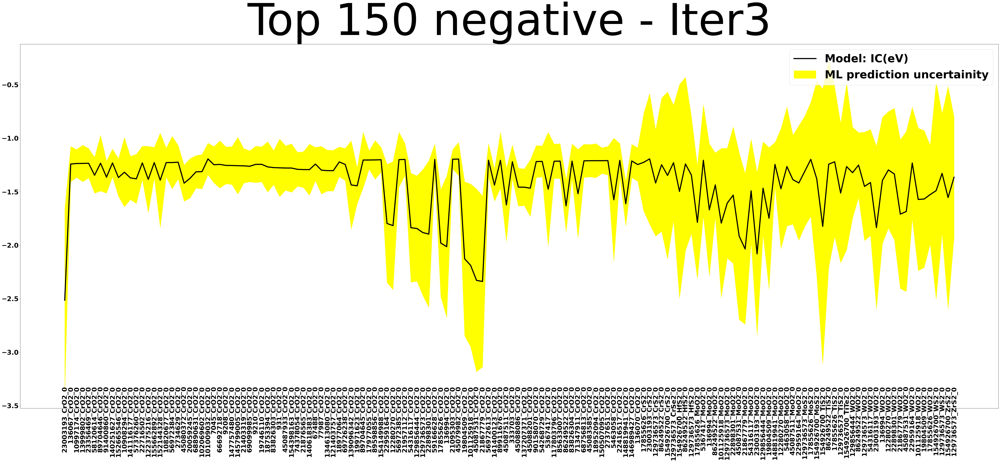

In [24]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 30}

mpl.rc('font', **font)

f, ax = plt.subplots(figsize=(80, 30))
ax.tick_params(axis="x",direction="in", pad=-100)
plt.plot(THN.System[:150], THN.Mean[:150], color = "black", label="Model: IC(eV)", linewidth=5)
plt.fill_between(THN.System[:150], THN.Mean[:150]-np.sqrt(THN.Variance[:150]), THN.Mean[:150]+np.sqrt(THN.Variance[:150]), color = "yellow",label="ML prediction uncertainity")

plt.legend(fontsize=50)
#plt.xlim([-3, 3])
#plt.ylim([-3, 3])
#plt.plot([-3, 3], [-3, 3], 'k--')
#plt.yticks(rotation = 45) 
plt.xticks(rotation = 90) 
plt.title("Top 150 negative - Iter3", fontsize = 200)
plt.show()

#f.savefig("Results_Code_3/THN_plot", dpi = 300, transparent = False, facecolor = 'white')

# Check overlap with previous iteration
### Comparing with top 150 predicted from previous interation

In [25]:
THN_combos_minus1 = pd.read_csv('Results_Code_2/Top_150_negative_combos', index_col = None, delimiter = ' ')
THN_combos_minus1

,CID,SMILES,Name
0,45088201,C1=CSC2=C3N1C=C3N=C2,CrO2
1,21095303,C1=CC2=CP=CC2=C1,CrO2
2,101410254,C=C1C=CC(=CC1=C)F,CrO2
3,129817334,C1=CC(=C2C(=C1)O2)C=O,CrO2
4,593866,C1=CC(=C(C=C1C=O)Cl)F,CrO2
...,...,...,...
145,736335,C1=CC(=C(C(=C1)Cl)F)C=O,CrO2
146,54459284,C1=CN=CC2=C1C(=O)N=C2,CrO2
147,12313811,C1=CC2=CC=COC2=C1,CrO2
148,11126234,C1=CC=C2C(=C1)C(=O)N2,CrO2


In [26]:
Overlap = pd.concat([THN_combos,THN_combos_minus1], axis=0).reset_index()

## Adding "System" column: 
Overlap = Overlap.astype({'CID' :'str'})
system = []
for i in Overlap.index:
    cid_name = Overlap.CID[i]+'_'+Overlap.Name[i]+'_0'
    system.append(cid_name)

Overlap['System'] = pd.DataFrame(system)
Overlap

,index,CID,SMILES,Name,System
0,70388,23003193,C1=CC2=CNC=CN2C=C1,CrO2,23003193_CrO2_0
1,7157,136067,C1=CN=CC2=C1C=NC=C2,CrO2,136067_CrO2_0
2,26267,10997174,C1=CN2C=CN=C2C(=C1)C=O,CrO2,10997174_CrO2_0
3,38027,13999802,C1=CC=C2C(=C1)NC=CO2,CrO2,13999802_CrO2_0
4,71984,23356469,C1=CN2C(=CC=C2C=O)C=N1,CrO2,23356469_CrO2_0
...,...,...,...,...,...
295,145,736335,C1=CC(=C(C(=C1)Cl)F)C=O,CrO2,736335_CrO2_0
296,146,54459284,C1=CN=CC2=C1C(=O)N=C2,CrO2,54459284_CrO2_0
297,147,12313811,C1=CC2=CC=COC2=C1,CrO2,12313811_CrO2_0
298,148,11126234,C1=CC=C2C(=C1)C(=O)N2,CrO2,11126234_CrO2_0


In [27]:
print('Number of materials predicted to be in top 150 again = ', Overlap.duplicated(subset=['CID', 'Name']).sum())

Number of materials predicted to be in top 150 again =  15


In [28]:
NonRepeating = Overlap.drop_duplicates(subset=['System'], keep=False)
Repeating = Overlap[~Overlap.System.isin(NonRepeating.System)].drop_duplicates(subset=['System'])
Repeating

,index,CID,SMILES,Name,System
0,70388,23003193,C1=CC2=CNC=CN2C=C1,CrO2,23003193_CrO2_0
12,92249,57376260,C1=COC=C2C1=COC=C2,CrO2,57376260_CrO2_0
15,211445,155662892,C1=CC2=C(OC=CC2=C1)C=O,CrO2,155662892_CrO2_0
43,5624,77987,C1=CC=C2C=CC2=C1,CrO2,77987_CrO2_0
51,45797,17977055,C1=CC2=CC=CNC2=C1,CrO2,17977055_CrO2_0
53,208526,154149988,C1=CC2=NC=NC(=S)C2=C1,CrO2,154149988_CrO2_0
60,158609,129736573,C1=CC2=C3C1=CC3=CC2=O,CrO2,129736573_CrO2_0
63,44936,17855626,B1=CC=C2C1=CC=C2,CrO2,17855626_CrO2_0
65,57914,21095303,C1=CC2=CP=CC2=C1,CrO2,21095303_CrO2_0
74,77024,45087511,C1=COC2=C3N1C=C3N=C2,CrO2,45087511_CrO2_0


In [29]:
## Adding "System" column: 
THN_combos = THN_combos.reset_index()
THN_combos = THN_combos.astype({'CID' :'str'})
system = []
for i in THN_combos.index:
    cid_name = THN_combos.CID[i]+'_'+THN_combos.Name[i]+'_0'
    system.append(cid_name)

THN_combos['System'] = pd.DataFrame(system)
THN_combos

,index,CID,SMILES,Name,System
0,70388,23003193,C1=CC2=CNC=CN2C=C1,CrO2,23003193_CrO2_0
1,7157,136067,C1=CN=CC2=C1C=NC=C2,CrO2,136067_CrO2_0
2,26267,10997174,C1=CN2C=CN=C2C(=C1)C=O,CrO2,10997174_CrO2_0
3,38027,13999802,C1=CC=C2C(=C1)NC=CO2,CrO2,13999802_CrO2_0
4,71984,23356469,C1=CN2C(=CC=C2C=O)C=N1,CrO2,23356469_CrO2_0
...,...,...,...,...,...
145,44926,17855626,B1=CC=C2C1=CC=C2,WO2,17855626_WO2_0
146,210613,154926700,C1=CC2=COC3=CC1=C23,WS2,154926700_WS2_0
147,158596,129736573,C1=CC2=C3C1=CC3=CC2=O,WS2,129736573_WS2_0
148,210627,154926700,C1=CC2=COC3=CC1=C23,ZrS2,154926700_ZrS2_0


In [30]:
NonRepeating_combos = THN_combos[~THN_combos.System.isin(Repeating.System)]
NonRepeating_combos = NonRepeating_combos[['CID', 'SMILES', 'Name']]
#NonRepeating_combos.to_csv('Results_Code_3/Top_150_negative_combos_minus_overlap', index=False, sep=' ')
NonRepeating_combos

,CID,SMILES,Name
1,136067,C1=CN=CC2=C1C=NC=C2,CrO2
2,10997174,C1=CN2C=CN=C2C(=C1)C=O,CrO2
3,13999802,C1=CC=C2C(=C1)NC=CO2,CrO2
4,23356469,C1=CN2C(=CC=C2C=O)C=N1,CrO2
5,58120614,B12C=CC=CN1C=CN2,CrO2
...,...,...,...
145,17855626,B1=CC=C2C1=CC=C2,WO2
146,154926700,C1=CC2=COC3=CC1=C23,WS2
147,129736573,C1=CC2=C3C1=CC3=CC2=O,WS2
148,154926700,C1=CC2=COC3=CC1=C23,ZrS2


In [31]:
NonRepeating_molecules = NonRepeating_combos[['CID','SMILES']].drop_duplicates()
#NonRepeating_molecules.to_csv('Results_Code_3/Top_150_negative_mols_minus_overlap', index=False, sep=' ')
NonRepeating_molecules

,CID,SMILES
1,136067,C1=CN=CC2=C1C=NC=C2
2,10997174,C1=CN2C=CN=C2C(=C1)C=O
3,13999802,C1=CC=C2C(=C1)NC=CO2
4,23356469,C1=CN2C(=CC=C2C=O)C=N1
5,58120614,B12C=CC=CN1C=CN2
...,...,...
99,129736573,C1=CC2=C3C1=CC3=CC2=O
100,86249522,C=C1C(=C)C2=C1C=C2
101,154926700,C1=CC2=COC3=CC1=C23
119,148819941,C1=CN2C=CN=CC2=C=C1


## 2) Top N uncertain - from Bootstrap

In [32]:
THU = ExploreSet.nlargest(150, ['Variance']).sort_values(by=['Name'])
THU_combos = THU[['CID', 'SMILES', 'Name']]
#THU_combos.to_csv('Results_Code_3/Top_150_uncertain_combos', index=False, sep=' ')
THU_combos

,CID,SMILES,Name
212432,5463058,CC=CC=CC=C,CrO2
7619,136994,B12C=CC=CN1C=CC=C2,CrO2
158609,129736573,C1=CC2=C3C1=CC3=CC2=O,CrO2
52076,19804509,C1=CC=C2C(=C1)NC=CN2,CrO2
70157,22959164,C=C1C=CNC(=C)N1,CrO2
...,...,...,...
5626,77987,C1=CC=C2C=CC2=C1,ZrSe2
210628,154926700,C1=CC2=COC3=CC1=C23,ZrSe2
130850,87361649,C1=CC2=C(O2)C3=CSC=C31,ZrTe2
210629,154926700,C1=CC2=COC3=CC1=C23,ZrTe2


In [33]:
THU_molecules = THU[['CID','SMILES']].drop_duplicates()
#THU_molecules.to_csv('Results_Code_3/Top_150_uncertain_mols', index=False, sep=' ')
THU_molecules

,CID,SMILES
212432,5463058,CC=CC=CC=C
7619,136994,B12C=CC=CN1C=CC=C2
158609,129736573,C1=CC2=C3C1=CC3=CC2=O
52076,19804509,C1=CC=C2C(=C1)NC=CN2
70157,22959164,C=C1C=CNC(=C)N1
70388,23003193,C1=CC2=CNC=CN2C=C1
77045,45087531,C1=CC=C2NC=CN2C=C1
30971,12280270,C1=CNC(=C1)C2=CNC=C2
69443,22898301,C=C1NC2=CC=CC=C2N1
212390,5367417,C=CC=CC=C


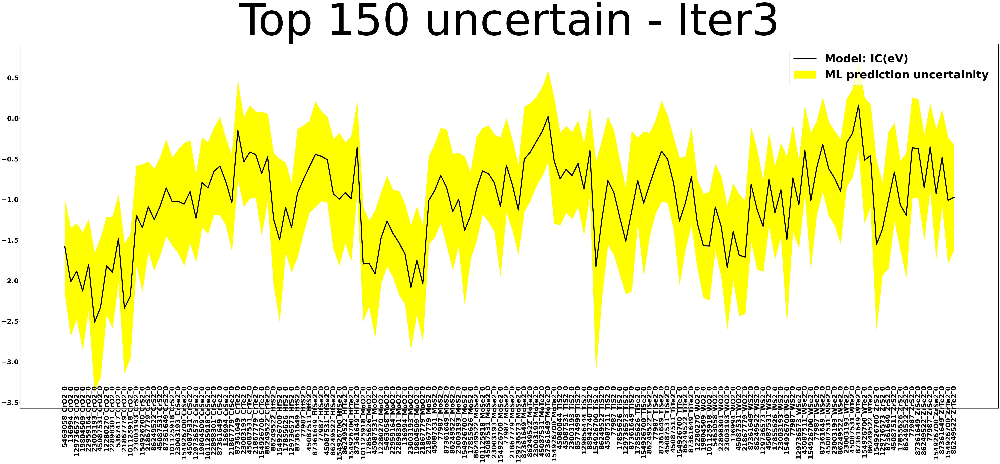

In [34]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 30}

mpl.rc('font', **font)

f, ax = plt.subplots(figsize=(80, 30))
ax.tick_params(axis="x",direction="in", pad=-105)
plt.plot(THU.System[:150], THU.Mean[:150], color = "black", label="Model: IC(eV)", linewidth=5)
plt.fill_between(THU.System[:150], THU.Mean[:150]-np.sqrt(THU.Variance[:150]), THU.Mean[:150]+np.sqrt(THU.Variance[:150]), color = "yellow",label="ML prediction uncertainity")

plt.legend(fontsize=50)
#plt.xlim([-3, 3])
#plt.ylim([-3, 3])
#plt.plot([-3, 3], [-3, 3], 'k--')
#plt.yticks(rotation = 45) 
plt.xticks(rotation = 90) 
plt.title("Top 150 uncertain - Iter3", fontsize = 200)
plt.show()

#f.savefig("Results_Code_3/THU_plot", dpi = 300, transparent = False, facecolor = 'white')

## Top N Negative: DFT vs Prediction

In [35]:
IC_7 = pd.read_csv('Results_Code_3/IC_THN_3.txt', delimiter =',')
Gas_7 = pd.read_csv('Results_Code_3/Gas_THN_3.txt', delimiter =',')
IC_7_previous = pd.read_csv('Results_Code_3/OverlapFromPreviousAttempt_THN', delimiter =',')
Gas_7_previous = pd.read_csv('Results_Code_3/OverlapFromPreviousAttempt_THN_gas', delimiter = ',')
#IC_7 = pd.concat([IC_7,IC_7_previous], axis=0).drop_duplicates()
#Gas_7 = pd.concat([Gas_7, Gas_7_previous], axis=0).drop_duplicates()
IC7_previous = IC_calculator.IC_calculator(IC_7_previous, Gas_7_previous, Bilayer)
IC7 = IC_calculator.IC_calculator(IC_7, Gas_7, Bilayer)
IC7 = pd.concat([IC7, IC7_previous], axis=0)
IC7 = IC7.merge(ExploitSet, on=["System"], how = "left")
IC7['Error'] = IC7['Mean'] - IC7['IC_ENERGY']
IC7 = IC7[['System', 'IC_ENERGY', 'Variance', 'Mean', 'Error']].sort_values(by = "Error").dropna()
#IC7 = IC7.drop_duplicates(subset=['System'])
IC7

,System,IC_ENERGY,Variance,Mean,Error
14,154926700_WS2_0,0.579935,1.031020,-1.490155,-2.070090
11,154926700_MoS2_0,0.487540,0.829921,-1.380268,-1.867808
56,17855626_MoO2_0,-0.090412,0.278137,-1.786840,-1.696428
9,154926700_CrS2_0,0.295058,0.609186,-1.347511,-1.642569
36,136994_CrO2_0,-0.578598,0.435682,-2.013791,-1.435193
...,...,...,...,...,...
7,145799005_CrO2_0,-2.849366,0.070131,-1.256852,1.592514
82,141116177_CrO2_0,-3.354502,0.041004,-1.370972,1.983530
26,56972384_CrO2_0,-3.334137,0.060510,-1.227342,2.106795
101,69099985_CrO2_0,-3.420009,0.021098,-1.262224,2.157785


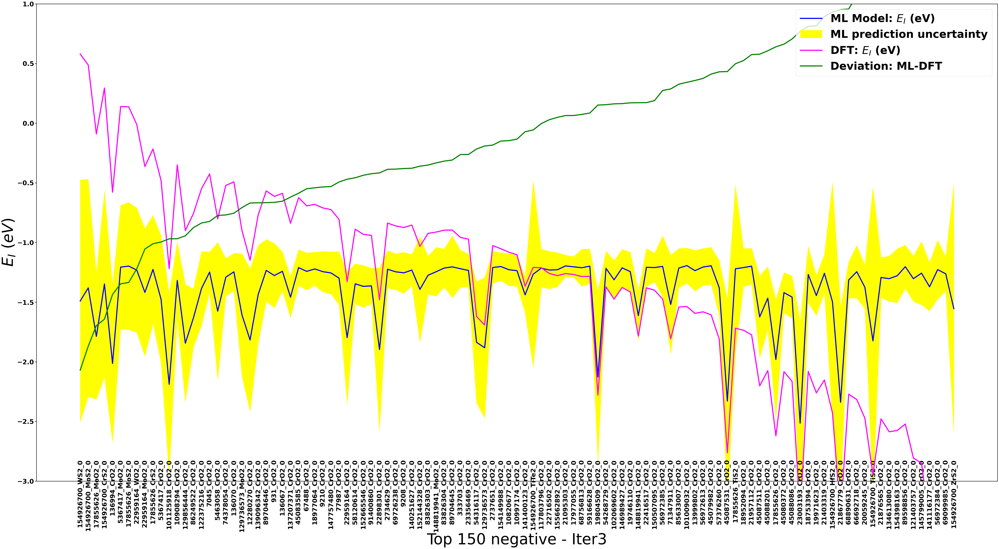

In [43]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 30}

mpl.rc('font', **font)

f, ax = plt.subplots(figsize=(80, 40))
ax.tick_params(axis="x",direction="in", pad=-100)
#label_mlr = "$R^2$ = %.2f" % r2_mean

# Increase axis font size
ax.tick_params(axis='both', labelsize=30)

# Increase axis linewidth
ax.spines['top'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['right'].set_linewidth(2)

# Increase tick mark thickness and length
ax.tick_params(which='both', width=2, length=8)

plt.plot(IC7.System[:150], IC7.Mean[:150], color = "blue",label="ML Model: $E_I$ (eV)",linewidth=5)
plt.fill_between(IC7.System[:150], IC7.Mean[:150]-np.sqrt(IC7.Variance[:150]), IC7.Mean[:150]+np.sqrt(IC7.Variance[:150]), color = "yellow", label="ML prediction uncertainty")
plt.plot(IC7.System[:150], IC7.IC_ENERGY[:150], color = "magenta", label="DFT: $E_I$ (eV)", linewidth=5)
plt.plot(IC7.System[:150], IC7.Error[:150], color = "green", label="Deviation: ML-DFT",linewidth=5)
plt.ylabel(r"$E_{I}$ ($eV$)", fontsize = 70)
plt.xlabel("Top 150 negative - Iter3", fontsize = 70)
plt.legend(fontsize=50, loc='upper right')
#plt.xlim([-3, 3])
plt.ylim([-3, 1])
#plt.yticks(rotation = 45) 
plt.xticks(rotation = 90) 
#plt.title("Top 150 negative - Iter3", fontsize = 200)
plt.show()
 
#f.savefig("Results_Code_3/THN_with_DFT_plot", dpi = 300, transparent = False, facecolor = 'white')

## Top N Uncertain: DFT vs Prediction

In [37]:
IC_8 = pd.read_csv('Results_Code_3/IC_THU_3.txt', delimiter =',')
Gas_8 = pd.read_csv('Results_Code_3/Gas_THU_3.txt', delimiter =',')
IC8 = IC_calculator.IC_calculator(IC_8, Gas_8, Bilayer)
IC8 = IC8.merge(ExploitSet, on=["System"], how = "left")
IC8['Error'] = IC8['Mean'] - IC8['IC_ENERGY']
IC8 = IC8[['System', 'IC_ENERGY', 'Variance', 'Mean', 'Error']].sort_values(by = "Error").dropna()
IC8

,System,IC_ENERGY,Variance,Mean,Error
34,154926700_WS2_0,0.579600,1.031020,-1.490155,-2.069755
127,86249522_WTe2_0,1.557706,0.394103,-0.458247,-2.015953
121,86249522_MoTe2_0,1.508603,0.361605,-0.414661,-1.923264
126,86249522_WSe2_0,1.002466,0.412791,-0.899481,-1.901947
28,154926700_MoS2_0,0.471107,0.829921,-1.380268,-1.851375
...,...,...,...,...,...
26,154926700_HfSe2_0,-2.485713,0.661853,-0.994083,1.491630
38,154926700_ZrSe2_0,-2.726863,0.624262,-0.924707,1.802156
17,129856444_TiS2_0,-3.171869,0.319909,-0.870008,2.301861
37,154926700_ZrS2_0,-3.934846,1.081644,-1.554536,2.380310


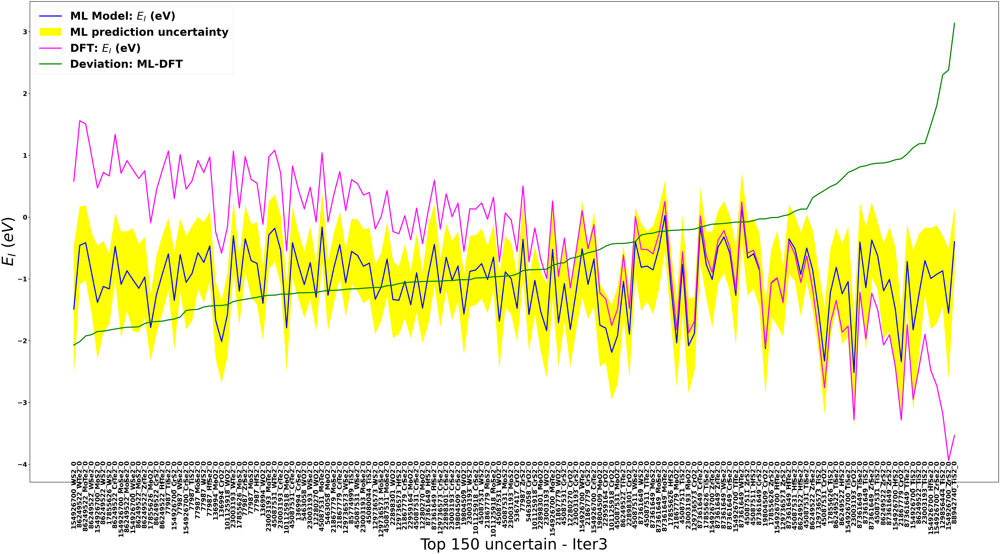

In [38]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 30}

mpl.rc('font', **font)

f, ax = plt.subplots(figsize=(80, 40))
ax.tick_params(axis="x",direction="in", pad=-100)

# Increase axis font size
ax.tick_params(axis='both', labelsize=30)

# Increase axis linewidth
ax.spines['top'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['right'].set_linewidth(2)

# Increase tick mark thickness and length
ax.tick_params(which='both', width=2, length=8)
#label_mlr = "$R^2$ = %.2f" % r2_mean

plt.plot(IC8.System[:150], IC8.Mean[:150], color = "blue",label="ML Model: $E_I$ (eV)",linewidth=5)
plt.fill_between(IC8.System[:150], IC8.Mean[:150]-np.sqrt(IC8.Variance[:150]), IC8.Mean[:150]+np.sqrt(IC8.Variance[:150]), color = "yellow", label="ML prediction uncertainty")
plt.plot(IC8.System[:150], IC8.IC_ENERGY[:150], color = "magenta", label="DFT: $E_I$ (eV)", linewidth=5)
plt.plot(IC8.System[:150], IC8.Error[:150], color = "green", label="Deviation: ML-DFT",linewidth=5)
plt.ylabel(r"$E_{I}$ ($eV$)", fontsize = 70)
plt.xlabel("Top 150 uncertain - Iter3", fontsize = 70)
plt.legend(fontsize=50)
#plt.xlim([-3, 3])
#plt.ylim([-3, 3])
#plt.yticks(rotation = 45) 
plt.xticks(rotation = 90) 
#plt.title("Top 150 uncertain - Iter3", fontsize = 200)
plt.show()
 
#f.savefig("Results_Code_3/THU_with_DFT_plot", dpi = 300, transparent = False, facecolor = 'white')

In [39]:
IC8.describe()

,IC_ENERGY,Variance,Mean,Error
count,150.000000,150.000000,150.000000,150.000000
mean,-0.422009,0.434600,-1.020864,-0.598856
std,1.123053,0.195401,0.519930,0.959339
min,-3.934846,0.276819,-2.514185,-2.069755
25%,-1.058442,0.307676,-1.333250,-1.236508
50%,-0.205179,0.362105,-0.979997,-0.935189
75%,0.438449,0.505810,-0.648064,-0.084131
max,1.557706,1.649829,0.164576,3.135763


In [40]:
#THN.to_csv('THN_3iter.txt', index=False)

In [41]:
#ExploitSet.to_csv('ExploitSet_3iter.txt', index=False)